In [2]:
#!jt -l

In [3]:
#!jt -t monokai

In [ ]:
#!jt -t monokai -f fira -fs 12 -nf ptsans -nfs 11 -N -kl -cursw 3 -cursc r -cellw 90% -T

In [64]:
import warnings;
warnings.simplefilter('ignore')

In [3]:
from jupyterthemes import jtplot

jtplot.style(theme='monokai')

In [4]:
import pandas as pd
import numpy as np
from numpy import percentile
import pickle

from math import sqrt
import statistics
import matplotlib.dates as mdates
import matplotlib.pyplot as plt

from fbprophet import Prophet
from fbprophet.diagnostics import cross_validation
import time

import seaborn as sns
import matplotlib.pyplot as plt
%matplotlib inline

import pymssql
import pandas.io.sql as psql

Importing plotly failed. Interactive plots will not work.


In [5]:
df1 = pd.read_parquet("/Users/NikhilDesktop/20201125072020.parquet.gzip")

In [6]:
df1

,UsageId,AccountNumber,Usagedate,Value,Consumed,MeterId,UsageType,TierTouName
0,2906848607,10970,2018-11-24 00:00:00,86.400,0.000,6153,TierTouDemand,F
1,2906848608,10970,2018-11-24 02:00:00,36.570,3.182,6153,Usage,F
2,2906848609,10970,2018-11-24 03:00:00,40.320,0.000,6153,TierTouDemand,F
3,2906848610,10970,2018-11-24 05:00:00,39.600,596.376,6153,MaxDemand,S
4,2906848611,10970,2018-11-24 05:00:00,34.140,2.972,6153,Usage,F
...,...,...,...,...,...,...,...,...
51567226,12204126885,20505,2020-11-22 07:00:00,0.054,0.011,13916,Usage,P
51567227,12204126886,20505,2020-11-22 10:00:00,0.036,0.008,13916,Usage,P
51567228,12204126887,20505,2020-11-22 17:00:00,0.063,0.012,13916,Usage,P
51567229,12204126888,20505,2020-11-22 20:00:00,0.037,0.008,13916,Usage,P


In [7]:
df1['Usagedate'] = pd.to_datetime(df1['Usagedate'], errors='coerce')
df1

,UsageId,AccountNumber,Usagedate,Value,Consumed,MeterId,UsageType,TierTouName
0,2906848607,10970,2018-11-24 00:00:00,86.400,0.000,6153,TierTouDemand,F
1,2906848608,10970,2018-11-24 02:00:00,36.570,3.182,6153,Usage,F
2,2906848609,10970,2018-11-24 03:00:00,40.320,0.000,6153,TierTouDemand,F
3,2906848610,10970,2018-11-24 05:00:00,39.600,596.376,6153,MaxDemand,S
4,2906848611,10970,2018-11-24 05:00:00,34.140,2.972,6153,Usage,F
...,...,...,...,...,...,...,...,...
51567226,12204126885,20505,2020-11-22 07:00:00,0.054,0.011,13916,Usage,P
51567227,12204126886,20505,2020-11-22 10:00:00,0.036,0.008,13916,Usage,P
51567228,12204126887,20505,2020-11-22 17:00:00,0.063,0.012,13916,Usage,P
51567229,12204126888,20505,2020-11-22 20:00:00,0.037,0.008,13916,Usage,P


In [8]:
print(df1.AccountNumber.nunique())
print(df1.MeterId.nunique())

3275
3275


In [9]:
null_columns=df1.columns[df1.isnull().any()]
df1[null_columns].isnull().sum()

Series([], dtype: float64)

In [10]:
uni_acc = df1.AccountNumber.unique()

### Hourly --> Daily

In [11]:
#Resampling hourly data to daily data to reduce the number of records and aggregating the required columns based on different criteria
df = []

for account in uni_acc[:]:
    x = df1.loc[df1['AccountNumber'] == account]
    y = x.resample('D', on = 'Usagedate').agg({'AccountNumber':'unique', 'Value':'sum', 'Consumed':'sum','MeterId':'unique'})
    df.append(y)
    
df = pd.concat(df)
df

,AccountNumber,Value,Consumed,MeterId
Usagedate,,,,
2018-11-24,[10970],3035.820,15710.461,[6153]
2018-11-25,[10970],3129.930,16159.871,[6153]
2018-11-26,[10970],6359.970,31799.432,[6153]
2018-11-27,[10970],7318.110,36563.028,[6153]
2018-11-28,[10970],6850.500,34242.672,[6153]
...,...,...,...,...
2020-11-18,[20505],1.214,0.252,[13916]
2020-11-19,[20505],1.263,0.258,[13916]
2020-11-20,[20505],1.189,0.244,[13916]


In [12]:
df_ = df.copy()

In [13]:
#unique returns np array
#using explode function to get account number and meter id as single elements
df_.reset_index(level=0, inplace=True)
df_ = df_.set_index(['Usagedate','Consumed','Value']).apply(pd.Series.explode).reset_index()
df_

,Usagedate,Consumed,Value,AccountNumber,MeterId
0,2018-11-24,15710.461,3035.820,10970,6153
1,2018-11-25,16159.871,3129.930,10970,6153
2,2018-11-26,31799.432,6359.970,10970,6153
3,2018-11-27,36563.028,7318.110,10970,6153
4,2018-11-28,34242.672,6850.500,10970,6153
...,...,...,...,...,...
2021660,2020-11-18,0.252,1.214,20505,13916
2021661,2020-11-19,0.258,1.263,20505,13916
2021662,2020-11-20,0.244,1.189,20505,13916
2021663,2020-11-21,0.253,1.235,20505,13916


In [14]:
#checking for null values
df_.isnull().any()

Usagedate        False
Consumed         False
Value            False
AccountNumber     True
MeterId           True
dtype: bool

In [15]:
#total number of null values in each column
df_.isnull().sum()

Usagedate            0
Consumed             0
Value                0
AccountNumber    54501
MeterId          54501
dtype: int64

In [16]:
null_columns=df_.columns[df_.isnull().any()]
print(df_[df_.isnull().any(axis=1)][null_columns].head())

    AccountNumber MeterId
88            NaN     NaN
311           NaN     NaN
312           NaN     NaN
313           NaN     NaN
314           NaN     NaN


In [17]:
#removing the rows with null values
df_ = df_[df_['AccountNumber'].notnull()]
df_

,Usagedate,Consumed,Value,AccountNumber,MeterId
0,2018-11-24,15710.461,3035.820,10970,6153
1,2018-11-25,16159.871,3129.930,10970,6153
2,2018-11-26,31799.432,6359.970,10970,6153
3,2018-11-27,36563.028,7318.110,10970,6153
4,2018-11-28,34242.672,6850.500,10970,6153
...,...,...,...,...,...
2021660,2020-11-18,0.252,1.214,20505,13916
2021661,2020-11-19,0.258,1.263,20505,13916
2021662,2020-11-20,0.244,1.189,20505,13916
2021663,2020-11-21,0.253,1.235,20505,13916


In [18]:
df_.isnull().any()

Usagedate        False
Consumed         False
Value            False
AccountNumber    False
MeterId          False
dtype: bool

In [19]:
#converting datatype to suitable datatypes for each required column
df_ = df_.astype({"AccountNumber": int, "MeterId": int, "Value": float, "Consumed": float})
df_

,Usagedate,Consumed,Value,AccountNumber,MeterId
0,2018-11-24,15710.461,3035.820,10970,6153
1,2018-11-25,16159.871,3129.930,10970,6153
2,2018-11-26,31799.432,6359.970,10970,6153
3,2018-11-27,36563.028,7318.110,10970,6153
4,2018-11-28,34242.672,6850.500,10970,6153
...,...,...,...,...,...
2021660,2020-11-18,0.252,1.214,20505,13916
2021661,2020-11-19,0.258,1.263,20505,13916
2021662,2020-11-20,0.244,1.189,20505,13916
2021663,2020-11-21,0.253,1.235,20505,13916


### Percentage of 0 data for an account; Removing accounts with 0 data > 90%

In [20]:
def percentof0(dataset,acc):
    met=[]
    percent=[]
    ano=[]
    df2=dataset[dataset.AccountNumber==acc]
    meterID_list = dataset[dataset.AccountNumber == acc].MeterId.unique()
    for i in meterID_list:
            ano.append(acc)
            met.append(i)
            meterID_df = df2[df2.MeterId == i]
            t=len(meterID_df)
            c=(meterID_df['Value']==0).sum()
            p=(c/t)*100
            percent.append(p)
    dfg=pd.DataFrame(list(zip(ano, met, percent)),
              columns=['AccountNumber','MeterId','Percent'])
    return dfg

In [21]:
percentof0(df_,20505)

,AccountNumber,MeterId,Percent
0,20505,13916,0.0


In [22]:
def allmeters(dataset):
    d = pd.DataFrame()
    f = []
    account_list = dataset.AccountNumber.unique()
    for i in account_list:
            d = percentof0(dataset,i)
            f.append(d)
    
    f = pd.concat(f)
    return f

In [23]:
am=allmeters(df_)
am

,AccountNumber,MeterId,Percent
0,10970,6153,0.218341
0,11050,6233,27.358491
0,11051,6234,17.647059
0,11052,6235,100.000000
0,11053,6236,15.566038
...,...,...,...
0,20497,13908,0.000000
0,20498,13909,0.000000
0,20499,13910,0.000000
0,20504,13915,0.000000


In [24]:
metr=am[am.Percent>=90]
metr0_list=metr['MeterId'].tolist()
print(metr0_list)

[6235, 12015, 6794, 7412, 9475, 11634, 6989, 6420, 6991, 7197, 7200, 7378, 7443, 7737, 7777, 9636, 9639, 9705, 7282, 7440, 7749, 8577, 8683, 9451, 9634, 12742, 7312, 7587, 8230, 11686, 8690, 12705, 6364, 7271, 7698, 7708, 8200, 8294, 10624, 7237, 7245, 7267, 7954, 8104, 9338, 9459, 6651, 7192, 7199, 7568, 7867, 7908, 8169, 8393, 8445, 12238, 9649, 12017, 12953, 12994, 7421, 8128, 9710, 13014, 8028, 8626, 9596, 7049, 7601, 7902, 9524, 8390, 8132, 8327, 8758, 13711, 13708, 13710, 10552, 8160, 6428, 7681, 8444, 8091, 8192, 8419, 12691, 13012, 13013, 13629]


In [25]:
for i in metr0_list:
    df_=df_[df_.MeterId!=i]
df_

,Usagedate,Consumed,Value,AccountNumber,MeterId
0,2018-11-24,15710.461,3035.820,10970,6153
1,2018-11-25,16159.871,3129.930,10970,6153
2,2018-11-26,31799.432,6359.970,10970,6153
3,2018-11-27,36563.028,7318.110,10970,6153
4,2018-11-28,34242.672,6850.500,10970,6153
...,...,...,...,...,...
2021660,2020-11-18,0.252,1.214,20505,13916
2021661,2020-11-19,0.258,1.263,20505,13916
2021662,2020-11-20,0.244,1.189,20505,13916
2021663,2020-11-21,0.253,1.235,20505,13916


In [26]:
df_.MeterId.nunique()

3185

In [27]:
#Mapping a given Meter ID to its Account Number
def meterIdtoAccount(meter):
    AccountDF = df[df.MeterId == meter]
    return AccountDF

In [28]:
#Mapping a given Meter ID to its Account Number
def meterIdtoAccountNumber(meter):
    Account = df_[df_.MeterId == meter].AccountNumber.unique()
    return Account

In [29]:
meterIdtoAccountNumber(9872)

array([15976])

In [30]:
meterIdtoAccountNumber(9501)

array([14318])

In [31]:
meterIdtoAccountNumber(9657)

array([14474])

In [32]:
meterIdtoAccountNumber(9583)

array([14400])

In [33]:
meterIdtoAccountNumber(9662)

array([14479])

In [34]:
meterIdtoAccountNumber(9693)

array([14510])

###  Replacing 0 values with 0.0001 (a value close to 0) to avoid infinte MAPE

In [35]:
df_['Value']=df_['Value'].replace(0,0.0001)
df_

,Usagedate,Consumed,Value,AccountNumber,MeterId
0,2018-11-24,15710.461,3035.820,10970,6153
1,2018-11-25,16159.871,3129.930,10970,6153
2,2018-11-26,31799.432,6359.970,10970,6153
3,2018-11-27,36563.028,7318.110,10970,6153
4,2018-11-28,34242.672,6850.500,10970,6153
...,...,...,...,...,...
2021660,2020-11-18,0.252,1.214,20505,13916
2021661,2020-11-19,0.258,1.263,20505,13916
2021662,2020-11-20,0.244,1.189,20505,13916
2021663,2020-11-21,0.253,1.235,20505,13916


### Moving Average

In [106]:
#moving average smoothing applied for a value at a given index
def mov_avg(meter_4_list,window=15):
    arr_len = len(meter_4_list)
    arr2=[]
    for i in range(arr_len):
        if i >= window:
            st = i-window
        else:
            st = 0
        if(arr_len-i-window>0):
            end = i+window+1
        else:
            end = arr_len
        arr2.append(sum(meter_4_list[st:end])/(end-st))
    return arr2

In [77]:
#smoothing all the meter ids in the dataset
df_['Moving_Average']=None
for Meter in df_.MeterId.unique():
    df_temp = df_[df_.MeterId==Meter]
    df_.loc[df_['MeterId']==Meter,'Moving_Average']=mov_avg(list(df_temp['Value']),15)

In [36]:
df_.head()

,Usagedate,Consumed,Value,AccountNumber,MeterId
0,2018-11-24,15710.461,3035.82,10970,6153
1,2018-11-25,16159.871,3129.93,10970,6153
2,2018-11-26,31799.432,6359.97,10970,6153
3,2018-11-27,36563.028,7318.11,10970,6153
4,2018-11-28,34242.672,6850.50,10970,6153


In [37]:
df_.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 1918671 entries, 0 to 2021664
Data columns (total 5 columns):
 #   Column         Dtype         
---  ------         -----         
 0   Usagedate      datetime64[ns]
 1   Consumed       float64       
 2   Value          float64       
 3   AccountNumber  int64         
 4   MeterId        int64         
dtypes: datetime64[ns](1), float64(2), int64(2)
memory usage: 87.8 MB


In [30]:
df_ = df_.astype({"Moving_Average": float})
df_.info()

KeyError: 'Only a column name can be used for the key in a dtype mappings argument.'

In [81]:
df_['Moving_Average']=df_['Moving_Average'].replace(0,0.0001)

In [38]:
df_.isnull().any()

Usagedate        False
Consumed         False
Value            False
AccountNumber    False
MeterId          False
dtype: bool

In [39]:
df_[df_.MeterId==9501]

,Usagedate,Consumed,Value,AccountNumber,MeterId
1716900,2018-11-24,0.292,3.9250,14318,9501
1716901,2018-11-25,0.256,3.4370,14318,9501
1716902,2018-11-26,0.000,0.0001,14318,9501
1716903,2018-11-27,0.000,0.0040,14318,9501
1716904,2018-11-28,0.000,0.0010,14318,9501
...,...,...,...,...,...
1717625,2020-11-18,0.000,0.1230,14318,9501
1717626,2020-11-19,0.000,0.1150,14318,9501
1717627,2020-11-20,0.000,0.1150,14318,9501
1717628,2020-11-21,0.000,0.1190,14318,9501


### Number of days of data for a given account; Selecting top 50 accounts with most data for analysis

In [40]:
def account_days(dataset,acc):
    met=[]
    days=[]
    ano=[]
    df2=dataset[dataset.AccountNumber==acc]
    meterID_list = dataset[dataset.AccountNumber == acc].MeterId.unique()
    for i in meterID_list:
        ano.append(acc)
        met.append(i)
        meterID_df = df2[df2.MeterId == i]
        
        days.append(meterID_df.shape[0])
                
    dfg=pd.DataFrame(list(zip(ano, met, days)),
              columns=['AccountNumber','MeterId','Days'])
    
    return dfg

In [41]:
account_days(df_,10970)

,AccountNumber,MeterId,Days
0,10970,6153,458


In [42]:
def total_days(dataset):
    d = pd.DataFrame()
    f = []
    account_list = dataset.AccountNumber.unique()
    for i in account_list:
            d = account_days(dataset,i)
            f.append(d)
    
    f = pd.concat(f)
    return f

In [43]:
td=total_days(df_)

In [44]:
td_sort=td.sort_values(by='Days', ascending=False)
td_sort

,AccountNumber,MeterId,Days
0,11277,6460,730
0,15976,9872,730
0,12536,7719,729
0,12218,7401,729
0,11864,7047,729
...,...,...,...
0,11427,6610,9
0,19841,13272,8
0,10897,6080,2
0,13203,8386,2


In [45]:
td_sort.head(50)

,AccountNumber,MeterId,Days
0,11277,6460,730
0,15976,9872,730
0,12536,7719,729
0,12218,7401,729
0,11864,7047,729
0,15991,9889,729
0,14370,9553,728
0,14371,9554,728
0,14271,9454,728
0,14502,9685,728


In [46]:
more_than_year = td_sort.loc[td_sort['Days'] >= 365, 'MeterId'].tolist()

In [47]:
more_than_year

[6460,
 9872,
 7719,
 7401,
 7047,
 9889,
 9553,
 9554,
 9454,
 9685,
 9622,
 10629,
 9550,
 9551,
 9676,
 9501,
 9671,
 9661,
 9657,
 9552,
 9640,
 9516,
 9696,
 9619,
 9618,
 9599,
 9583,
 9574,
 9571,
 9689,
 9566,
 9627,
 9691,
 9702,
 9715,
 9615,
 9483,
 9482,
 9481,
 9478,
 9477,
 9474,
 9471,
 9638,
 9662,
 9690,
 9693,
 11628,
 9456,
 9485,
 9534,
 9564,
 9585,
 9590,
 9626,
 9628,
 9678,
 9547,
 9549,
 9489,
 9546,
 9526,
 9486,
 9487,
 9502,
 9504,
 9506,
 9635,
 9519,
 9616,
 9541,
 9527,
 9539,
 9542,
 9633,
 9492,
 9463,
 9503,
 6404,
 6408,
 9706,
 9663,
 9652,
 6476,
 9462,
 9480,
 9660,
 9548,
 6435,
 9573,
 9572,
 9511,
 9366,
 9248,
 9558,
 9683,
 9346,
 9368,
 9357,
 8805,
 9363,
 9518,
 8861,
 9490,
 9587,
 9508,
 11755,
 9340,
 9369,
 9352,
 8854,
 9349,
 7713,
 6456,
 9509,
 11753,
 7897,
 6457,
 6453,
 6392,
 7787,
 9521,
 9341,
 9342,
 8834,
 6572,
 10475,
 6497,
 8853,
 11667,
 6541,
 6393,
 11986,
 10092,
 9793,
 9624,
 9791,
 10257,
 10258,
 9748,
 9788,
 10

In [48]:
len(more_than_year)

2749

In [49]:
more_than_year_acc = td_sort.loc[td_sort['Days'] >= 365, 'AccountNumber'].tolist()

In [50]:
more_than_year_acc

[11277,
 15976,
 12536,
 12218,
 11864,
 15991,
 14370,
 14371,
 14271,
 14502,
 14439,
 16786,
 14367,
 14368,
 14493,
 14318,
 14488,
 14478,
 14474,
 14369,
 14457,
 14333,
 14513,
 14436,
 14435,
 14416,
 14400,
 14391,
 14388,
 14506,
 14383,
 14444,
 14508,
 14519,
 14532,
 14432,
 14300,
 14299,
 14298,
 14295,
 14294,
 14291,
 14288,
 14455,
 14479,
 14507,
 14510,
 17794,
 14273,
 14302,
 14351,
 14381,
 14402,
 14407,
 14443,
 14445,
 14495,
 14364,
 14366,
 14306,
 14363,
 14343,
 14303,
 14304,
 14319,
 14321,
 14323,
 14452,
 14336,
 14433,
 14358,
 14344,
 14356,
 14359,
 14450,
 14309,
 14280,
 14320,
 11221,
 11225,
 14523,
 14480,
 14469,
 11293,
 14279,
 14297,
 14477,
 14365,
 11252,
 14390,
 14389,
 14328,
 14183,
 14065,
 14375,
 14500,
 14163,
 14185,
 14174,
 13622,
 14180,
 14335,
 13678,
 14307,
 14404,
 14325,
 18035,
 14157,
 14186,
 14169,
 13671,
 14166,
 12530,
 11273,
 14326,
 18033,
 12714,
 11274,
 11270,
 11209,
 12604,
 14338,
 14158,
 14159,
 13651,


In [51]:
top50meters = []

for i in td_sort['MeterId'][:50]:
    top50meters.append(i)

In [52]:
AllMeters = []

for i in td_sort['MeterId'][:]:
    AllMeters.append(i)

### Performance metric functions

In [53]:
#Minimum, Maximum and Median
def min_max_median(df):
    quartiles = percentile(df, [25, 50, 75])
    data_min, data_max = df.min(), df.max()
    return data_max,data_min,quartiles[1]

In [54]:
def median(df):
    return statistics.median(df)

In [55]:
from sklearn.metrics import mean_absolute_percentage_error
def mape(y_true, y_pred): 
    return mean_absolute_percentage_error(y_true,y_pred)

In [56]:
def mape_new(yTrue,yPredicted):
    return np.abs((yTrue - yPredicted) / yTrue) * 100

In [57]:
from sklearn.metrics import mean_squared_error
def rmse(y_true, y_pred):
    return sqrt(mean_squared_error(y_true, y_pred))

### Function to predict, calculate MAPE and flag meters with MAPE > 50

In [58]:
#Main function for prediction.
from fbprophet.diagnostics import cross_validation
from fbprophet.diagnostics import performance_metrics
from datetime import datetime
def account_and_days_billcycle_mapes(met, data):
    meterID_df = pd.DataFrame()
    final=pd.DataFrame()
    overall_sum = 0 
    predict_list=[]
    predict_date_list=[]
    mape_list = []
    met_list=[]
    acc_list=[]
    matrix_df=pd.DataFrame()
    met_list.append(met)
    acc=meterIdtoAccountNumber(met)
    #acc=acc_met['AccountNumber'].iloc[0]
    acc_list.append(acc)
    meterID_df = data[data.MeterId == met]
    meterID_df = meterID_df.drop(['AccountNumber','MeterId','Consumed'],axis=1)
    final = meterID_df.reset_index()[['Usagedate','Value']].rename({'Usagedate':'ds','Value':'y'}, axis='columns')
    final=final[:len(final)-100]
    for i in range(0,28,7):
        train = final[:len(final)-(28-i)]#Train changes throughout the loops as we should increase 1week for every training session to get the  next week predictions.
        actual=final[len(train):len(train)+7]
        sum_actual=actual['y'].sum()
        test=pd.DataFrame()
        if  (len(train)>=365):
            p = Prophet(daily_seasonality = False, weekly_seasonality = True, yearly_seasonality = True, uncertainty_samples=0,seasonality_mode='multiplicative').add_seasonality(name='quarterly',period=365.4,fourier_order=5)
        else:
            p = Prophet(daily_seasonality = False, weekly_seasonality = True, yearly_seasonality = False,uncertainty_samples=0)
        p.add_country_holidays(country_name='AUS')
        p.fit(train)
        prediction = p.make_future_dataframe(periods=7 , freq='D')
        fore = p.predict(prediction)
        test['Predictions'] = fore['yhat']
        sum_predictions = test['Predictions'][-7:].sum()
        sum_predictions_final = sum_predictions 
        MAPE_val = mape_new(sum_actual, sum_predictions_final)
        MAPE_new = round(MAPE_val, 3)
        mape_list.append(MAPE_new)
        overall_sum = overall_sum + sum_predictions
    matrix_df['mape_weekly'] = mape_list
    matrix_df['meterID'] = met
    matrix_df['type']=['flag' if x>=50 else 'unflag' for x in matrix_df['mape_weekly']]
    return matrix_df

In [59]:
account_and_days_billcycle_mapes(6460, df_)

Initial log joint probability = -10.3928
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       964.247   0.000140271       91.8289      0.5334      0.5334      121   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       966.995   8.94186e-05       90.8404      0.3116           1      234   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299        967.02   2.97746e-07       74.6237      0.4059      0.4059      357   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     313        967.02   6.64263e-08       70.7987           1           1      376   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probability = -10.0836
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
    

,mape_weekly,meterID,type
0,20.279,6460,unflag
1,32.770,6460,unflag
2,43.867,6460,unflag
3,24.844,6460,unflag


In [54]:
account_and_days_billcycle_mapes(9872, final_df_)

NameError: name 'final_df_' is not defined

In [56]:
meters=[]
z=[]
for a in more_than_year[:50]:
    b=account_and_days_billcycle_mapes(a, df_)
    z.append(b)
z=pd.concat(z)

Initial log joint probability = -10.3928
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       964.247   0.000140271       91.8289      0.5334      0.5334      121   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       966.995   8.94186e-05       90.8404      0.3116           1      234   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299        967.02   2.97746e-07       74.6237      0.4059      0.4059      357   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     313        967.02   6.64263e-08       70.7987           1           1      376   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probability = -10.0836
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
    

Initial log joint probability = -3.16056
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1730.98    0.00708273       131.314           1           1      114   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1733.99   7.86566e-06       85.0762      0.2148           1      238   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     228       1735.44   0.000649056       254.567   6.661e-06       0.001      319  LS failed, Hessian reset 
     299        1738.3    0.00220207       209.303      0.4877      0.4877      407   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399        1740.4    0.00197302       198.838      0.5333      0.5333      527   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1763.08    0.00860186    

Initial log joint probability = -8.62152
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1628.22    0.00719019       239.777           1           1      125   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1639.99     0.0114733        268.57           1           1      242   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     288       1645.07   0.000487708       250.997   9.302e-07       0.001      389  LS failed, Hessian reset 
     299       1646.69      0.010622       306.855           1           1      401   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1652.78   0.000243652       78.8706      0.6907      0.6907      519   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     483       1656.62   0.000393595    

Initial log joint probability = -8.55952
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      91        1180.4    0.00531767       151.279   5.838e-05       0.001      144  LS failed, Hessian reset 
      99       1180.64     0.0054073       100.987       2.709           1      155   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1181.36   1.92302e-05       73.5163      0.6542      0.6542      278   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     212        1181.4   5.22008e-05       83.9855   7.524e-07       0.001      332  LS failed, Hessian reset 
     299       1181.44   8.15337e-08       89.3645      0.3981      0.3981      437   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     378       1181.52    2.9773e-05       95.2123   3.874e-07       0.001      556  LS failed, Hessian rese

Initial log joint probability = -3.22175
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1522.52   3.57766e-05       58.6766           1           1      126   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     111       1522.52   2.64355e-05       54.5814   4.132e-07       0.001      176  LS failed, Hessian reset 
     197       1522.53   3.72766e-05       78.7421   5.743e-07       0.001      343  LS failed, Hessian reset 
     199       1522.53   7.59353e-06        56.539      0.5481      0.5481      345   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     225       1522.53   4.40014e-07       81.5509   8.522e-09       0.001      428  LS failed, Hessian reset 
     229       1522.53   9.33114e-08       47.0768           1           1      435   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is

Initial log joint probability = -4.5578
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1446.36   0.000514274        54.741           1           1      123   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1446.83    0.00012528       88.2366      0.1541      0.1541      257   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     267       1447.38   0.000289101       122.899   3.181e-06       0.001      380  LS failed, Hessian reset 
     299        1447.4   3.25673e-06       58.9968      0.9721      0.9721      418   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1447.61     0.0049443       88.7978       0.584       0.584      541   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     403       1447.68   0.000253679     

Initial log joint probability = -33.5962
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       990.959   6.19701e-05       55.2496      0.8031      0.8031      115   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     177       991.034   3.15141e-05       80.8541   3.776e-07       0.001      252  LS failed, Hessian reset 
     199       991.036   2.21721e-06       85.4251           1           1      277   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     273       991.042   2.50147e-08       79.0386      0.4353      0.4353      374   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probability = -33.0287
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      90       999.883   0.000922387       88.2032   1.674e-05       0.0

Initial log joint probability = -3.19397
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       2214.71    0.00509954       1668.24      0.2813      0.2813      117   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       2227.41    0.00207586        544.97           1           1      227   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       2233.97     0.0119501       241.663       4.796      0.4796      342   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     367       2236.67   0.000416304       220.938   3.563e-06       0.001      474  LS failed, Hessian reset 
     384       2237.77   0.000175342       155.479    1.79e-06       0.001      532  LS failed, Hessian reset 
     399       2238.42    0.00238663       514.379          10           1      550   
    Iter      log pro

Initial log joint probability = -40.2203
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1004.75    0.00595268       201.978      0.6783      0.6783      121   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1021.31    0.00292825       88.6336       0.846       0.846      241   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     298       1025.51    0.00135068       273.263   1.212e-05       0.001      394  LS failed, Hessian reset 
     299       1025.62      0.001286       237.009           1           1      395   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     347       1027.12   2.97515e-05       52.5662   6.212e-07       0.001      500  LS failed, Hessian reset 
     363       1027.12   1.95276e-06       41.0794   3.475e-08       0.001      559  LS failed, Hessian rese

Initial log joint probability = -9.68189
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1331.79   0.000959025       61.8915      0.3828           1      130   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     192       1331.84   3.09244e-05       78.6093   4.898e-07       0.001      322  LS failed, Hessian reset 
     199       1331.84   5.56451e-06       63.1148           1           1      330   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     262       1331.86   1.30958e-07       56.2338           1           1      419   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probability = -8.35777
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      97       1349.42   0.000167219       76.5406   2.264e-06       0.0

Initial log joint probability = -2.19836
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       2171.03    0.00248968        198.78      0.7836      0.7836      119   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     108       2171.41   0.000554612       352.073   5.883e-06       0.001      167  LS failed, Hessian reset 
     199       2172.59    0.00138563       230.888           1           1      275   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       2178.79    0.00254025       156.402      0.4506           1      383   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       2179.44   0.000550702       272.659      0.5733      0.5733      509   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     475       2180.78   9.29335e-05    

Initial log joint probability = -30.2697
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1206.74     0.0187633       117.932           1           1      122   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     164       1221.87   0.000341751       45.5216   2.885e-06       0.001      236  LS failed, Hessian reset 
     172       1222.69    0.00242662       150.643    2.48e-05       0.001      286  LS failed, Hessian reset 
     199        1223.5    0.00704685       149.009           1           1      328   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     226       1228.48   0.000827418       158.623   5.119e-06       0.001      397  LS failed, Hessian reset 
     299       1231.02    0.00274256       115.551      0.6494      0.6494      492   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Note

Initial log joint probability = -14.4485
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      91       1038.39     0.0007434        77.668   7.862e-06       0.001      153  LS failed, Hessian reset 
      99        1038.6   0.000590155       58.5548      0.4335           1      165   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     104       1038.63   8.21381e-05       55.4574   1.545e-06       0.001      213  LS failed, Hessian reset 
     199       1039.11   9.54145e-07       57.9352           1           1      348   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     208       1039.11   3.48468e-12       64.7333   2.297e-09           1      390   
Optimization terminated normally: 
  Convergence detected: absolute parameter change was below tolerance
Initial log joint probability = -14.5944
    Iter      log prob        ||dx||      ||grad||    

Initial log joint probability = -3.71378
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      90       1402.16   0.000424296       93.3953   4.284e-06       0.001      154  LS failed, Hessian reset 
      99       1402.21   4.59649e-05       53.0846      0.2161           1      167   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1402.29   5.48405e-06       83.4128         0.3         0.3      312   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     278       1402.33   0.000173308       56.1654   2.269e-06       0.001      442  LS failed, Hessian reset 
     299       1402.34   2.89342e-05        54.288           1           1      466   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1402.38   4.05877e-05       81.1642           1           1      590   
    Iter      log pro

Initial log joint probability = -2.65341
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1854.95     0.0161893       223.135           1           1      120   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1858.37     0.0190625        162.77           1           1      232   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299          1862    0.00419054       676.647      0.2213           1      343   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1865.31     0.0113284       204.559           1           1      459   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1881.24    0.00876013       209.994           1           1      571   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -13.4437
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1149.11   0.000932817       83.3249           1           1      119   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199        1149.8   0.000180896       81.5375           1           1      242   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1149.91   1.07516e-06       88.1144      0.3238           1      364   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     376       1149.92   4.90174e-08       89.5056      0.2795      0.2795      457   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probability = -13.7061
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
    

Initial log joint probability = -9.86962
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1666.88    0.00279844       352.818           1           1      130   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     142       1668.97    0.00325547       267.586   3.353e-05       0.001      217  LS failed, Hessian reset 
     199       1669.81   1.55723e-05       88.0511      0.3073           1      289   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     247       1670.34   0.000245911       152.664   1.609e-06       0.001      422  LS failed, Hessian reset 
     299       1671.07   0.000609209       139.951     0.09959           1      483   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     313        1671.1   2.49763e-05       85.5305   3.406e-07       0.001      531  LS failed, Hessian rese

Initial log joint probability = -27.6236
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       941.919     0.0175274       215.402           1           1      117   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     148       956.483    0.00105373       136.916   8.659e-06       0.001      213  LS failed, Hessian reset 
     199       961.584     0.0343395       158.215           1           1      286   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     207       962.968    0.00106279       125.524   5.087e-06       0.001      342  LS failed, Hessian reset 
     224       963.759   0.000891297       62.2706   1.547e-05       0.001      401  LS failed, Hessian reset 
     262       964.001   0.000539709       68.0973   7.415e-06       0.001      500  LS failed, Hessian reset 
     299       964.052   9.45097e-06       58.2737      0.5958   

Initial log joint probability = -3.32613
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      74       1532.25   0.000967702       121.348   1.124e-05       0.001      144  LS failed, Hessian reset 
      99       1532.35   1.34644e-05       79.6638      0.4439      0.4439      175   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     158       1532.96   0.000264494       115.119   2.193e-06       0.001      283  LS failed, Hessian reset 
     199       1533.21    0.00013043       72.6802      0.8866      0.8866      333   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     240       1533.22   4.04734e-08       85.4346     0.08215           1      381   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probability = -12.7066
    Iter      log prob        ||dx||      ||grad||   

Initial log joint probability = -14.2685
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1161.34   0.000152689       77.0972      0.1499      0.5952      136   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1161.48   0.000751263       75.7932     0.05742           1      272   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     236       1161.55   0.000251082       67.8448   3.638e-06       0.001      368  LS failed, Hessian reset 
     299       1161.57   1.09665e-06       79.9103      0.4838      0.4838      449   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     310       1161.57   1.47106e-05        70.927   1.886e-07       0.001      500  LS failed, Hessian reset 
     361       1161.57   4.10622e-06       72.3817   5.424e-08       0.001      606  LS failed, Hessian rese

Initial log joint probability = -7.3321
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       2700.88   0.000231628       218.783           1           1      120   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       2706.49   0.000348561       219.819           1           1      231   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     287       2709.05   4.54528e-05       380.818   2.666e-07       0.001      372  LS failed, Hessian reset 
     299       2709.31    0.00158123       836.199           1           1      384   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       2711.34    0.00211046       296.128      0.4382           1      508   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     457       2712.69   1.75143e-05     

Initial log joint probability = -4.39227
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1403.71   0.000557473       104.178      0.6296      0.6296      125   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     134       1403.74   4.39958e-05       63.5231   5.009e-07       0.001      214  LS failed, Hessian reset 
     167       1403.74   1.40422e-08       53.2264     0.04037       0.762      260   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probability = -4.65768
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      98       1421.78   0.000493711       142.103   3.455e-06       0.001      150  LS failed, Hessian reset 
      99       1421.81   0.000213371       114.436           1           1      151   
    Iter      log prob        ||dx||      ||grad||   

Initial log joint probability = -27.9808
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1048.13    0.00281547       87.7391           1           1      128   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     109       1048.52    0.00125235        139.07   1.236e-05       0.001      172  LS failed, Hessian reset 
     199       1048.75   8.02576e-08       89.9818      0.5997      0.5997      296   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     209       1048.75   2.45434e-08       74.9879      0.2575      0.2575      310   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probability = -26.3839
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1062.47    3.0355e-06       76.0884     0.01648          

Initial log joint probability = -8.45805
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1408.54    0.00784098       258.248           1           1      132   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1418.18     0.0029417       87.5492           1           1      257   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1420.32   2.17752e-05       56.6763      0.3571           1      371   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     379       1422.03   0.000368928       78.9505   5.438e-06       0.001      495  LS failed, Hessian reset 
     399        1422.2    0.00107736       79.7003       0.404      0.8687      520   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1423.01   0.000585242    

Initial log joint probability = -3.02798
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99          1834    0.00121707        455.26      0.2339      0.2339      122   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1841.99    0.00762379       142.771      0.9031      0.9031      238   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     280       1857.08   0.000390705       486.293   6.166e-07       0.001      368  LS failed, Hessian reset 
     299       1859.32    0.00059714       129.356      0.4495      0.4495      391   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1861.58   0.000276425       118.175      0.4444      0.4444      520   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1866.39    0.00791364    

Initial log joint probability = -7.40542
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1624.78    0.00109837       85.8425           1           1      122   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1630.67    0.00260478       210.418      0.1804           1      245   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1631.43   0.000125919       71.0446      0.6072      0.6072      365   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     305       1631.49   0.000253389       145.982   1.997e-06       0.001      408  LS failed, Hessian reset 
     399       1632.27      0.135334       267.047           1           1      530   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1636.02   0.000583885    

Initial log joint probability = -3.86997
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1618.84    0.00583945       95.1451           1           1      125   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199        1625.1    0.00429134       119.222           1           1      247   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1659.78    0.00637518       567.994      0.4778      0.4778      357   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1665.93    0.00137558       123.017      0.4162           1      478   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     425       1666.41   0.000166297       123.206   1.552e-06       0.001      557  LS failed, Hessian reset 
     499       1666.63   0.000157588    

Initial log joint probability = -3.80993
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1468.25   4.37234e-05       82.2936      0.4624           1      120   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     167       1468.26   8.01468e-08       97.7263           1           1      201   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probability = -3.84991
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1477.71   6.01718e-06       81.2731           1           1      126   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     160       1477.72   6.14589e-08       61.8722      0.3562           1      206   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below 

Initial log joint probability = -34.4897
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       955.261   0.000608615       86.4738      0.5483      0.5483      124   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       959.485    0.00204871       98.9691      0.1634           1      239   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     200       959.509   0.000627501       70.8724    6.34e-06       0.001      275  LS failed, Hessian reset 
     299       959.613   7.35668e-07       78.1744      0.9114      0.9114      407   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       959.627   0.000307816       94.2801           1           1      532   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     436       959.631   6.49164e-06    

Initial log joint probability = -4.95842
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1613.21    0.00344069       232.049       0.187      0.6413      118   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1618.84   0.000456115        66.286           1           1      238   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1625.86   0.000395789       78.9683      0.1855      0.1855      355   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1634.53     0.0249664       522.132           1           1      470   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1655.13     0.0492466       258.762           1           1      575   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -45.3361
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1551.38    0.00531797       379.314           1           1      114   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1578.07    0.00188694       178.663      0.3603      0.7536      231   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1589.75     0.0019325       89.4714        0.88        0.88      350   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     365       1593.59   0.000873711       452.288   3.349e-06       0.001      463  LS failed, Hessian reset 
     399       1595.75    0.00109619       84.1243      0.4711      0.7276      502   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     437       1595.92   0.000311867    

Initial log joint probability = -13.0744
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1579.46     0.0378272        1050.6           1           1      118   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1595.29    0.00297246       162.218      0.6038      0.6038      234   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     257       1599.79    0.00072729       250.454   6.115e-06       0.001      351  LS failed, Hessian reset 
     287       1601.08   0.000302715       182.029   1.416e-06       0.001      419  LS failed, Hessian reset 
     299        1601.4   0.000124528       75.6072      0.5617      0.5617      431   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1603.18     0.0325189        127.72           1           1      548   
    Iter      log pro

Initial log joint probability = -11.9331
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      58       1198.59    0.00178439       168.843   1.519e-05       0.001      107  LS failed, Hessian reset 
      99       1199.12   0.000639312       69.5712       0.489       0.489      159   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1201.27   1.92463e-05       60.8593      0.3738           1      278   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1201.29   5.53377e-05       51.8513           1           1      398   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1201.45   1.37826e-05       52.6843      0.3158      0.3158      516   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     449       1201.46   6.72527e-06    

In [57]:
z

,mape_weekly,meterID,type
0,20.279,6460,unflag
1,32.770,6460,unflag
2,43.867,6460,unflag
3,24.844,6460,unflag
0,72.226,9872,flag
...,...,...,...
3,7.814,9456,unflag
0,5.906,9485,unflag
1,5.838,9485,unflag
2,8.952,9485,unflag


In [58]:
with pd.option_context('display.max_rows', None, 'display.max_columns', None):
    display(z)

,mape_weekly,meterID,type
0,2.027900e+01,6460,unflag
1,3.277000e+01,6460,unflag
2,4.386700e+01,6460,unflag
3,2.484400e+01,6460,unflag
0,7.222600e+01,9872,flag
1,6.298400e+01,9872,flag
2,8.305000e+00,9872,unflag
3,6.212165e+08,9872,flag
0,1.585000e+00,7719,unflag
1,3.745000e+00,7719,unflag


In [59]:
flagged_meters = z[z['type']=='flag']
flagged_meters

,mape_weekly,meterID,type
0,7.222600e+01,9872,flag
1,6.298400e+01,9872,flag
3,6.212165e+08,9872,flag
0,1.946512e+04,9501,flag
1,3.167951e+03,9501,flag
2,4.531728e+04,9501,flag
3,1.392758e+05,9501,flag
3,5.662800e+01,9657,flag
0,2.507876e+03,9583,flag
1,2.004490e+02,9583,flag


In [60]:
flagged_list=flagged_meters['meterID'].unique()
flagged_list

array([9872, 9501, 9657, 9583, 9662, 9693])

In [61]:
flagged_list_acc=more_than_year_acc[more_than_year_acc['MeterId']=='flag'] flagged_meters['meterID'].unique()
flagged_list

SyntaxError: invalid syntax (1826770951.py, line 1)

In [62]:
df_[df_['MeterId']==9872].AccountNumber.unique().tolist()

[15976]

In [63]:
flagged_list_acc = []
for met in flagged_list:
    flagged_list_acc.append(df_[df_['MeterId']==met].AccountNumber.unique()[0])
    
flagged_list_acc

[15976, 14318, 14474, 14400, 14479, 14510]

In [103]:
meters=[]
z_next100=[]
for a in more_than_year[50:150]:
    b=account_and_days_billcycle_mapes(a, df_)
    z_next100.append(b)
z_next100=pd.concat(z_next100)

Initial log joint probability = -15.7665
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99        754.12    0.00159297       86.3322           1           1      116   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     161       754.222   1.53085e-08       94.6226      0.1863           1      193   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probability = -24.5794
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       758.337   1.63322e-05       107.243           1           1      116   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       766.085    0.00155591       72.1734           1           1      228   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
    

Initial log joint probability = -5.02228
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1184.07   1.17453e-05       80.4552      0.4622      0.4622      130   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1184.31   2.86786e-05       84.9401           1           1      266   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     236       1184.31   3.84242e-08       81.2518      0.4344      0.4344      313   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probability = -5.37338
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1200.81   3.63941e-05       94.4939           1           1      122   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
    

Initial log joint probability = -3.48593
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       2056.23    0.00273534       1007.52       0.554       0.554      115   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199        2085.5   0.000536616        247.22           1           1      220   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299        2100.1   0.000324879       254.414           1           1      333   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       2110.68     0.0188029       619.555      0.9445      0.9445      456   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       2129.56    0.00177803        383.21       0.375       0.375      572   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -3.50388
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       2076.98     0.0051105       753.143           1           1      117   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       2102.97    0.00121544       441.981           1           1      230   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       2127.17   0.000848947        144.97           1           1      347   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     342       2141.42   0.000104648       354.875   2.196e-07       0.001      434  LS failed, Hessian reset 
     399        2150.3     0.0190906       193.042           1           1      499   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       2174.25      0.012215    

Initial log joint probability = -2.07547
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       2561.82   0.000321247       229.005           1           1      118   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       2567.76   0.000124187       297.295           1           1      229   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       2570.09    0.00105431       218.159           1           1      341   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       2571.63   0.000129925       232.581      0.3647      0.9632      460   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       2573.95   0.000361803       88.8047           1           1      573   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -4.95146
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      82       1294.16   0.000245312       75.8573   3.161e-06       0.001      145  LS failed, Hessian reset 
      99       1294.17   1.50179e-05        70.412           1           1      168   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     124       1294.18   4.36765e-07       42.2409           1           1      208   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probability = -4.95469
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1312.43   0.000140687       59.3822           1           1      135   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     101       1312.43   9.14905e-05       65.4778   1.372e-06       0.0

Initial log joint probability = -9.89779
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      94       1061.27   0.000962601       168.389   1.159e-05       0.001      158  LS failed, Hessian reset 
      99       1061.38   0.000402001       71.8719      0.3133           1      165   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1061.59   1.83236e-05       80.5619      0.4032           1      290   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1061.74   1.57752e-06       95.6766           1           1      413   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1061.75   0.000248684       96.4675           1           1      536   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1062.06   0.000634636    

Initial log joint probability = -4.70944
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1205.07   0.000123458       58.5667           1           1      137   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     172        1205.1    3.2414e-06       62.4338    5.26e-08       0.001      270  LS failed, Hessian reset 
     186        1205.1   9.55367e-08       54.1949           1           1      289   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probability = -4.73063
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1222.51     1.722e-06       54.2584      0.2259           1      144   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     117       1222.51   3.84582e-05       57.5002   6.613e-07       0.0

Initial log joint probability = -5.60856
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1133.61   0.000615307       87.6047           1           1      124   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     110       1133.63   2.99167e-05        74.897   4.185e-07       0.001      177  LS failed, Hessian reset 
     180       1133.72   0.000125079       71.4032     1.8e-06       0.001      298  LS failed, Hessian reset 
     199       1133.73   2.30597e-05       72.4067           1           1      324   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1133.78   4.06174e-08       70.8642      0.5631      0.5631      445   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     311       1133.78   9.61571e-06       89.3379   1.017e-07       0.001      514  LS failed, Hessian rese

Initial log joint probability = -3.29279
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1405.26   7.76617e-05        74.934     0.02438      0.4521      130   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1406.97    0.00058627       89.1038        1.01      0.3866      266   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     272       1407.76   0.000271894       80.6948   4.027e-06       0.001      396  LS failed, Hessian reset 
     299       1407.78   5.32234e-05       70.2843     0.04229           1      438   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     350       1407.86   6.91854e-05       86.7634   9.698e-07       0.001      541  LS failed, Hessian reset 
     398       1407.87   3.05106e-05       82.3323    3.86e-07       0.001      639  LS failed, Hessian rese

Initial log joint probability = -5.27026
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1132.76   3.74252e-05       86.1445           1           1      122   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     129       1132.76   1.77659e-06       103.701   1.702e-08       0.001      199  LS failed, Hessian reset 
     144       1132.76   1.06538e-07       82.4868           1           1      217   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probability = -5.26298
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1149.01   1.54316e-05       86.0515      0.2052           1      129   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     111       1149.03   0.000150259       85.9967   1.639e-06       0.0

Initial log joint probability = -31.4477
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       899.918   0.000337518       81.4127      0.3506      0.3506      121   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       900.008   7.84991e-07       74.8881      0.2954           1      259   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     268       900.012   7.23806e-08       63.3547      0.3507           1      354   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probability = -29.9325
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       909.327    0.00260553       83.4737           1           1      121   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
    

Initial log joint probability = -3.30697
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1499.49   0.000707829       71.5372      0.4332           1      130   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     117       1499.49   1.10416e-06       52.2661      0.7435      0.7435      154   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probability = -9.97964
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      95       1054.98   0.000236725       97.6413   2.347e-06       0.001      156  LS failed, Hessian reset 
      99       1054.99   0.000103628       87.9302      0.2626           1      161   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     139          1055   4.91661e-08       86.7743      0.7477      0.74

Initial log joint probability = -54.766
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1112.94     0.0990714       120.684           1           1      124   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     167       1115.69   0.000774677       165.108   1.015e-05       0.001      251  LS failed, Hessian reset 
     199       1115.92   0.000288071       81.5058       3.285      0.3285      290   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     219       1116.05   0.000383001       88.8286   4.324e-06       0.001      353  LS failed, Hessian reset 
     299       1116.33   0.000627074       90.3499           1           1      450   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     366        1116.6   0.000333687       70.6815   4.801e-06       0.001      591  LS failed, Hessian reset

Initial log joint probability = -31.0666
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      67       571.992   0.000835918       85.4881   8.546e-06       0.001      123  LS failed, Hessian reset 
      99       572.029   7.09967e-07       82.5691           1           1      166   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     120        572.03   2.70146e-06       80.6429   2.914e-08       0.001      230  LS failed, Hessian reset 
     194       572.197   0.000661065       99.2455    6.38e-06       0.001      392  LS failed, Hessian reset 
     199       572.244   0.000275476       58.4969           1           1      397   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     268       572.267   1.73559e-05       74.4881   2.215e-07       0.001      523  LS failed, Hessian reset 
     299       572.268   1.43266e-07       65.8675      0.8336   

Initial log joint probability = -3.42768
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1439.78    0.00713951       98.9117      0.1465      0.6793      117   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1441.52   4.69998e-05       84.8736           1           1      253   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     209       1441.61   0.000805696       199.242   8.351e-06       0.001      299  LS failed, Hessian reset 
     282       1441.68   1.91484e-05       76.5166   2.928e-07       0.001      463  LS failed, Hessian reset 
     299       1441.68   6.93233e-05       84.3861           1           1      486   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     354       1441.69   2.65051e-05       83.9345   3.199e-07       0.001      596  LS failed, Hessian rese

Initial log joint probability = -7.60732
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1531.56    0.00912432       297.391       1.054      0.3441      128   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1535.65   4.99644e-05       82.8777      0.6618      0.6618      254   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1536.33    0.00135625       86.3415           1           1      371   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1537.58    0.00656463       97.0682      0.7881      0.7881      481   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     402       1537.62   0.000299399        132.24   3.173e-06       0.001      528  LS failed, Hessian reset 
     499       1537.85    0.00180725    

Initial log joint probability = -23.1262
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      96       902.065    0.00306887       103.593   2.867e-05       0.001      150  LS failed, Hessian reset 
      99       902.151   0.000897967       81.0823      0.4226           1      154   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       902.233   2.74831e-07        102.11           1           1      289   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     218       902.233   1.27937e-08        91.655      0.2549      0.2549      312   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probability = -23.3729
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      71       913.964    0.00468215       104.185   4.264e-05       0.0

Initial log joint probability = -8.89436
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1590.24     0.0680982       762.072           1           1      120   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1617.67      0.048098         690.8           1           1      231   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1638.97    0.00802095       267.813           1           1      345   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     336       1642.25    0.00675035       241.624   8.318e-05       0.001      422  LS failed, Hessian reset 
     381       1643.92     0.0003723       180.854    3.77e-06       0.001      518  LS failed, Hessian reset 
     399       1644.18   0.000304806       87.3253       3.196      0.3196      540   
    Iter      log pro

Initial log joint probability = -3.76819
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1442.77    0.00294448        99.989      0.5312           1      122   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1443.59   0.000465123       74.1802       4.762      0.4762      255   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1443.69   7.79003e-05       76.4203      0.3931           1      383   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     358        1443.7   3.24733e-08        69.643     0.05489           1      468   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probability = -3.77384
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
    

Initial log joint probability = -3.47917
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99          2031    0.00165354       514.059           1           1      121   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       2076.13    0.00869309       756.376      0.9613      0.9613      224   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       2090.31    0.00176402       122.749           1           1      349   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     341       2093.04    6.8929e-05       194.793   1.921e-07       0.001      438  LS failed, Hessian reset 
     399       2096.88   0.000815454       127.229           1           1      513   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     411       2097.69   0.000110214    

Initial log joint probability = -3.38396
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       2111.12    0.00427553       450.434           1           1      120   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       2126.47    0.00105212       476.011      0.9253      0.9253      228   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       2140.35    0.00689461       387.743           1           1      336   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     363       2147.19   4.98568e-05       134.103   1.724e-07       0.001      451  LS failed, Hessian reset 
     399       2151.28    0.00658207       200.027      0.4549           1      492   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     400       2151.29   7.74868e-05    

Initial log joint probability = -8.72458
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1087.55   3.31338e-06       70.5412        2.13       0.213      128   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1088.83   8.87152e-08       89.4495      0.3168           1      258   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     202       1088.83   7.58968e-08       80.9302      0.6827      0.6827      261   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probability = -14.5393
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99        1101.1   0.000939703       83.6959      0.9573      0.9573      123   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
    

Initial log joint probability = -5.13933
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99        1973.7   0.000616268       207.297        0.88        0.88      116   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1980.17     0.0261562       383.989           1           1      239   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1982.86   0.000469635       129.174           1           1      362   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1986.95    0.00883461       179.514           1           1      474   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1988.89     0.0110597       214.829           1           1      590   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -6.53742
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       2111.64    0.00155813       155.824      0.4729      0.4729      125   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     144       2113.15   4.54171e-05       135.687   2.511e-07       0.001      224  LS failed, Hessian reset 
     199       2114.29   5.61918e-05       154.394   2.138e-07       0.001      332  LS failed, Hessian reset 
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     274       2115.67   0.000454026       422.326   3.746e-06       0.001      461  LS failed, Hessian reset 
     299       2115.95   8.71639e-05       133.533      0.4199      0.4199      491   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     360          2116   9.19955e-07       65.6919    1.27e-08       0.001      622 

Initial log joint probability = -4.39109
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1686.72    0.00147405       78.4576           1           1      135   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     170       1687.18   0.000138576       85.0948   8.455e-07       0.001      258  LS failed, Hessian reset 
     199       1687.31   0.000263903       68.9342       0.745       0.745      293   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     260       1687.35   3.98439e-05       62.0626   7.736e-07       0.001      415  LS failed, Hessian reset 
     299       1687.41   2.76791e-06       56.5447      0.9252      0.9252      465   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1687.54    0.00107443       115.761           1           1      595   
    Iter      log pro

Initial log joint probability = -3.27654
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1671.98   0.000288509       99.7525      0.2842      0.2842      119   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1674.68   0.000356376       84.2858           1           1      240   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     241       1678.55   0.000252916       135.654   8.213e-07       0.001      334  LS failed, Hessian reset 
     299       1680.52   5.21604e-05       76.0666       0.765       0.765      398   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     385       1681.67    0.00015722       94.8883   1.748e-06       0.001      544  LS failed, Hessian reset 
     399       1682.39    0.00334097       115.774           1           1      559   
    Iter      log pro

Initial log joint probability = -14.9893
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99        1330.7    0.00289937        131.98      0.4607           1      120   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     140       1332.21   0.000511708       129.494   5.191e-06       0.001      204  LS failed, Hessian reset 
     199       1332.63      0.002355       66.0651           1           1      284   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     218       1333.01   0.000281447       51.4282   5.569e-06       0.001      343  LS failed, Hessian reset 
     267       1333.16   0.000226209       52.3156   3.468e-06       0.001      444  LS failed, Hessian reset 
     299       1333.17   4.07347e-06       52.1729           1           1      485   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Note

Initial log joint probability = -8.25854
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1105.72    0.00254619       88.5013      0.6041           1      113   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     100       1105.72   0.000957812        117.48   1.082e-05       0.001      144  LS failed, Hessian reset 
     175       1106.07    0.00162897       117.701   1.436e-05       0.001      263  LS failed, Hessian reset 
     199       1106.21   4.61386e-06       79.1531      0.3911      0.3911      289   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     266       1106.21   8.15174e-08       82.1124      0.3826           1      374   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probability = -9.51541
    Iter      log prob        ||dx||      ||grad||   

Initial log joint probability = -10.2416
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      48       996.787    0.00096571       91.2565   9.491e-06       0.001       94  LS failed, Hessian reset 
      99       996.983    0.00104214       84.4044           1           1      153   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199        1004.9   0.000467141       83.3487      0.1559           1      277   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     292       1005.49   0.000341242       88.1765   3.979e-06       0.001      427  LS failed, Hessian reset 
     299       1005.52   3.90957e-05       98.4041      0.5004      0.5004      436   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1005.61   5.19717e-05       88.8186           1           1      557   
    Iter      log pro

Initial log joint probability = -8.63991
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99        1277.1     0.0059925       126.842      0.9218      0.9218      123   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199        1281.3   0.000766446       72.8614      0.7377      0.7377      251   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     215       1282.21    0.00484015       225.073   5.015e-05       0.001      309  LS failed, Hessian reset 
     299        1283.2   9.26187e-05       82.0539      0.5292      0.5292      418   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     372       1286.41    0.00355924       349.462   3.452e-05       0.001      532  LS failed, Hessian reset 
     399       1288.11   0.000226673       77.7617           1           1      563   
    Iter      log pro

Initial log joint probability = -7.52006
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1304.24    0.00331355       108.134      0.7172      0.7172      120   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1307.46   0.000390484       84.7759      0.4112      0.4112      243   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1307.93    0.00051238       65.3366      0.7405      0.7405      362   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1310.81   4.46691e-05        57.973      0.3576           1      476   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     470       1310.83   1.91984e-05       96.9501   2.761e-07       0.001      635  LS failed, Hessian reset 
     499       1310.83    9.8392e-05    

Initial log joint probability = -8.09449
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99        1096.3   0.000661169       84.7804      0.1455           1      126   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     156       1096.35   1.55052e-05       83.5144   2.064e-07       0.001      233  LS failed, Hessian reset 
     198       1096.35    5.8993e-08       85.3764      0.7139      0.7139      293   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probability = -24.7606
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      80       1094.29    0.00183125       186.729   1.588e-05       0.001      138  LS failed, Hessian reset 
      99       1094.61    4.4268e-05       76.2315           1           1      161   
    Iter      log prob        ||dx||      ||grad||   

Initial log joint probability = -5.74492
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       2206.16     0.0142138       368.083           1           1      126   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       2212.86   0.000508152       148.957           1           1      248   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       2216.11   0.000140707       129.291      0.6561      0.6561      365   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     351       2216.91    6.1565e-05       213.821   1.604e-07       0.001      473  LS failed, Hessian reset 
     399        2217.4    0.00193689       252.227       0.854      0.0854      526   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     402       2217.42   2.73861e-05    

Initial log joint probability = -56.0883
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       896.011    0.00113737       95.9581      0.2684           1      117   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       897.479   0.000375987       75.9135      0.6717      0.6717      232   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     217       897.617   0.000238251       92.7428   2.909e-06       0.001      317  LS failed, Hessian reset 
     299       897.686   2.08082e-05       77.0788           1           1      421   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     350       897.688   4.03738e-08       86.3294      0.5805      0.5805      481   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probabil

Initial log joint probability = -4.02775
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1749.32    0.00827296       261.466           1           1      129   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1752.72   0.000198779       55.8901      0.3015      0.3015      253   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     215       1753.32   0.000359434       174.529   5.879e-06       0.001      303  LS failed, Hessian reset 
     299        1754.9    0.00512654       209.225           1           1      401   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399        1757.8   0.000363327       133.821           1           1      526   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1758.09   0.000181627    

Initial log joint probability = -3.46536
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1688.09    0.00526899       109.839           1           1      121   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     154       1688.75   0.000158343       111.851   2.356e-06       0.001      252  LS failed, Hessian reset 
     197       1688.77   1.40022e-05       76.7395   1.407e-07       0.001      348  LS failed, Hessian reset 
     199       1688.77   4.61736e-06        59.949      0.8815      0.8815      350   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     224       1688.77   8.58642e-08       64.8692      0.7909      0.7909      383   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probability = -5.446
    Iter      log prob        ||dx||      ||grad||     

Initial log joint probability = -10.3931
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99        968.21     4.099e-06       99.6444      0.3857           1      127   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     131       968.211   3.44647e-08       84.4211      0.1722           1      166   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probability = -9.38736
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       980.656   1.37565e-05       102.141       0.317           1      123   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     157       980.721   1.71206e-05       102.578   2.064e-07       0.001      237  LS failed, Hessian reset 
     199       980.737   0.000218852       109.346           1          

Initial log joint probability = -38.55
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99        952.72    0.00251049       75.5817           1           1      125   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     155       956.102     0.0016708       64.2889   2.764e-05       0.001      237  LS failed, Hessian reset 
     199       956.297   8.33447e-06       55.0362           1           1      301   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     233       956.299   3.18525e-08       67.3096      0.1502      0.4795      355   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probability = -8.01718
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99          1012     0.0252776       98.6702           1           1

Initial log joint probability = -40.2223
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      53       1071.82    0.00234839       127.387   5.683e-05       0.001       99  LS failed, Hessian reset 
      99       1076.25     0.0176274       114.629           1           1      158   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     159       1081.42    0.00144049       158.468   7.214e-06       0.001      259  LS failed, Hessian reset 
     170       1082.42   0.000454804       54.1268   7.511e-06       0.001      311  LS failed, Hessian reset 
     199       1082.65   0.000802178       66.8329      0.2814           1      349   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     217       1082.86   0.000776123       100.325   1.359e-05       0.001      412  LS failed, Hessian reset 
     299       1083.86     0.0209426       86.3685           1   

Initial log joint probability = -5.22764
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1599.58    0.00743006       252.619           1           1      121   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1618.02    0.00564636       363.957           1           1      239   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1627.06    0.00285861        128.23      0.9898      0.9898      362   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399        1635.5   0.000897317       106.724      0.8155      0.8155      484   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1639.95     0.0337416       326.497           1           1      606   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -19.2368
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1146.35    0.00154014        129.67           1           1      123   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1147.07    0.00937968       100.162           1           1      251   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1149.54   6.74434e-05        86.286       0.427           1      372   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     349       1149.54   6.40661e-07       63.4753       0.227           1      441   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probability = -19.1581
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
    

Initial log joint probability = -12.9366
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       956.237    0.00496251       104.011           1           1      122   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       971.583   0.000364788       115.619      0.8904      0.8904      255   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     237       971.908   0.000176286       62.6297   1.484e-06       0.001      337  LS failed, Hessian reset 
     288       972.167    0.00018931       89.9807   2.023e-06       0.001      451  LS failed, Hessian reset 
     299       972.183   2.52845e-06       80.1146       0.318       0.318      464   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     397       973.388   0.000244176       101.896   1.582e-06       0.001      619  LS failed, Hessian rese

Initial log joint probability = -23.6881
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       949.742   0.000308289        37.193           1           1      131   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     127       950.056    0.00036468       65.3683   7.257e-06       0.001      209  LS failed, Hessian reset 
     199       950.322   0.000396984       70.0024       0.982       0.982      303   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       952.156    0.00261795       69.6899      0.5556      0.5556      416   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       952.915   6.28934e-06       52.0509       2.715           1      567   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     400       952.915   1.28462e-06    

Initial log joint probability = -3.58904
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99        1399.6   0.000122891       85.2555      0.4166      0.4166      134   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     175       1399.67   0.000113911       85.5004   1.479e-06       0.001      285  LS failed, Hessian reset 
     199       1399.68   4.75588e-05       83.0419           1           1      316   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1399.95    0.00567283       98.9845           1           1      434   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     308       1400.29   0.000544816       158.237   6.229e-06       0.001      486  LS failed, Hessian reset 
     362       1400.51   3.44395e-05       74.7162   3.834e-07       0.001      588  LS failed, Hessian rese

Initial log joint probability = -8.69203
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      70       1049.68    0.00116494       107.896   1.195e-05       0.001      127  LS failed, Hessian reset 
      99       1049.79   4.34245e-05       88.0663      0.4318      0.4318      163   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     129       1050.21   0.000851636       85.6964   9.416e-06       0.001      232  LS failed, Hessian reset 
     199       1050.55   1.74995e-05       73.6354      0.3557           1      315   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1056.65   0.000694055        66.277      0.9122      0.9122      432   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1056.87   3.37854e-05       82.7958           1           1      556   
    Iter      log pro

Initial log joint probability = -3.65061
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1477.31    0.00026916       62.3078      0.2144           1      136   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1477.56   2.06229e-05       60.4582      0.7792      0.7792      255   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1477.65   8.56015e-05       67.5268           1           1      398   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1477.67   1.42168e-05       71.5752      0.8487      0.8487      521   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     448       1477.68   1.33763e-05       57.4601   2.756e-07       0.001      626  LS failed, Hessian reset 
     499       1477.69   2.90281e-06    

Initial log joint probability = -4.2909
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1317.66    0.00156343       58.8716      0.6175           1      120   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     141        1317.7   2.15954e-06       49.8132   4.422e-08       0.001      216  LS failed, Hessian reset 
     153        1317.7   1.11439e-08       51.3961    0.008271           1      240   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probability = -4.29664
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99        1334.7   3.43749e-06       50.6141   6.661e-08       0.001      164  LS failed, Hessian reset 
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     126        1334.7   4.70278e-06        48.13

Initial log joint probability = -38.3285
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       989.079    0.00426155       81.9166           1           1      120   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     135       989.642   0.000207515       81.5918   3.738e-06       0.001      198  LS failed, Hessian reset 
     199       989.708   0.000161003       65.8022      0.2889           1      284   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       989.977   0.000439732       65.6737           1           1      411   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     321       989.989   1.80736e-05       38.5776   2.852e-07       0.001      479  LS failed, Hessian reset 
     363       989.994   1.10965e-08       52.2848     0.04962           1      536   
Optimization terminat

Initial log joint probability = -11.3897
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      86       1109.31   0.000950021       60.6312   1.894e-05       0.001      146  LS failed, Hessian reset 
      99       1109.35   1.26342e-05       45.6012       1.153      0.1153      164   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1109.52   7.90841e-05       55.5007      0.2852           1      297   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     222       1109.52    8.3478e-06       72.5837    1.19e-07       0.001      371  LS failed, Hessian reset 
     235       1109.52   8.73783e-08       43.8998           1           1      390   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probability = -10.4786
    Iter      log prob        ||dx||      ||grad||   

Initial log joint probability = -6.67635
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1332.31    0.00136828       82.5853           1           1      129   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     107       1332.39   0.000252933       76.5616    3.04e-06       0.001      173  LS failed, Hessian reset 
     192       1332.65   0.000525575       120.665   4.498e-06       0.001      306  LS failed, Hessian reset 
     199       1332.74    0.00053369       74.3869           1           1      313   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1332.81    1.8189e-07       74.6799      0.3558      0.3558      453   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     322       1332.82   1.92511e-05       79.2307   2.211e-07       0.001      535  LS failed, Hessian rese

Initial log joint probability = -6.42141
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99        1141.4   0.000137209       90.3152      0.3846           1      121   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     141       1141.42    1.2532e-05       87.9895   1.594e-07       0.001      216  LS failed, Hessian reset 
     170       1141.42   2.84133e-08       68.2313      0.5181      0.5181      255   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probability = -6.78564
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1244.11   0.000318354       78.8987           1           1      133   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1248.81    0.00136851       90.0304      0.3467          

Initial log joint probability = -5.77119
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1079.39   1.46683e-06       58.1882      0.2247      0.2247      144   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     110       1079.39   8.96852e-09       54.0526     0.03672    0.003672      162   
Optimization terminated normally: 
  Convergence detected: absolute parameter change was below tolerance
Initial log joint probability = -5.81449
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1095.27   7.90188e-05       53.7871           1           1      135   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     120       1095.28   1.73658e-05       53.2628   3.175e-07       0.001      204  LS failed, Hessian reset 
     174        1095.4      8.87e-05       53.0614   1.409e-06       0.00

Initial log joint probability = -5.89441
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1175.58    0.00776613       58.9246       3.608      0.9437      123   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     128       1177.09   0.000268092       55.3821   3.623e-06       0.001      195  LS failed, Hessian reset 
     199       1177.24   6.10735e-05       48.6406       0.754       0.754      289   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     243       1177.24   5.56703e-06       62.1148   8.149e-08       0.001      426  LS failed, Hessian reset 
     299       1177.25   4.03276e-06       51.7547           1           1      503   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     301       1177.25   4.75128e-07       61.7795   9.152e-09       0.001      546  LS failed, Hessian rese

Initial log joint probability = -8.86495
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1119.88    0.00425854       94.7668      0.3701           1      128   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     109        1120.4   0.000737896       90.2412   8.619e-06       0.001      179  LS failed, Hessian reset 
     126       1120.57   0.000274414       66.5086   5.392e-06       0.001      232  LS failed, Hessian reset 
     199       1121.04    0.00310662       68.0646      0.2124           1      327   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299        1121.5    0.00763089       85.2913           1           1      447   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1121.69   0.000358652         62.59      0.4354      0.4354      571   
    Iter      log pro

Initial log joint probability = -5.47802
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1247.06    0.00388987       84.8345           1           1      121   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     172       1247.47   0.000313236       90.4745   3.366e-06       0.001      254  LS failed, Hessian reset 
     199        1247.5   3.92974e-06       93.4988      0.4767      0.4767      288   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     286        1247.7   0.000340098       64.7401   4.135e-06       0.001      428  LS failed, Hessian reset 
     299       1247.72   1.21017e-05       69.9323      0.3475           1      447   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     398       1247.73   3.30591e-08       68.0046     0.04629           1      582   
Optimization terminat

In [104]:
z_next100

,mape_weekly,meterID,type
0,5.476,9534,unflag
1,9.435,9534,unflag
2,1.199,9534,unflag
3,8.555,9534,unflag
0,1.275,9564,unflag
...,...,...,...
3,10.715,9790,unflag
0,4.981,10279,unflag
1,11.786,10279,unflag
2,17.394,10279,unflag


In [105]:
flagged_meters_next100 = z_next100[z_next100['type']=='flag']
flagged_meters_next100

,mape_weekly,meterID,type
0,67.215,9489,flag
3,72.546,9489,flag
0,233102.886,9504,flag
1,135463.247,9504,flag
2,237.152,9504,flag
3,268.114,9504,flag
1,51.646,9616,flag
0,231.970,9542,flag
1,211.779,9542,flag
2,183.560,9542,flag


In [106]:
flagged_list_next100=flagged_meters_next100['meterID'].unique()
flagged_list_next100

array([ 9489,  9504,  9616,  9542,  9633,  6408,  9663,  9652,  9462,
        9511,  9352,  9509,  6457,  6392,  9341,  9342, 10475,  9624,
       10279])

In [107]:
flagged_list_acc_next100 = []
for met in flagged_list_next100:
    flagged_list_acc_next100.append(df_[df_['MeterId']==met].AccountNumber.unique()[0])
    
flagged_list_acc_next100

[14306,
 14321,
 14433,
 14359,
 14450,
 11225,
 14480,
 14469,
 14279,
 14328,
 14169,
 14326,
 11274,
 11209,
 14158,
 14159,
 16530,
 14441,
 16381]

In [ ]:
 9489,  9504,  9616,  9542,  9633,  6408,  9663,  9652,  9462,
        9511,  9352,  9509,  6457,  6392,  9341,  9342,  9624, 10279

In [111]:
meters=[]
z_next200=[]
for a in more_than_year[150:350]:
    b=account_and_days_billcycle_mapes(a, df_)
    z_next200.append(b)
z_next200=pd.concat(z_next200)

Initial log joint probability = -4.83274
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1249.86   0.000869685       65.2686           1           1      135   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1250.07   5.29916e-07       47.9151      0.2495      0.2495      272   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     253       1250.07   1.58983e-07       51.9088       0.272           1      350   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probability = -6.77714
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      92       1266.41    0.00121413       79.0657   1.862e-05       0.001      157  LS failed, Hessian reset 
      99       1266.48   0.000331982       71.1492      0.3603          

Initial log joint probability = -11.9719
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1197.44   0.000471062       52.9807           1           1      127   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1199.05   5.80596e-05       60.4224      0.2577      0.2577      255   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     253        1199.1   8.72766e-07        61.657   1.852e-08       0.001      381  LS failed, Hessian reset 
     267        1199.1   7.41652e-08       51.0704     0.01473           1      408   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probability = -15.5376
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      79       1025.01     0.0019023       83.9509   2.658e-05       0.0

Initial log joint probability = -6.31705
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1186.37   0.000447396       80.4121           1           1      128   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     117       1186.65    0.00262915       78.4041    2.05e-05       0.001      206  LS failed, Hessian reset 
     199       1186.79   5.04921e-06       85.4192   5.291e-08       0.001      356  LS failed, Hessian reset 
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     224       1186.79   2.01291e-08       73.4703      0.3145      0.3145      390   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probability = -6.32277
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      57        1199.3    0.00134053       144.0

Initial log joint probability = -9.97667
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1240.51    0.00098249        87.639      0.8726      0.8726      117   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     167       1242.88    0.00035084       75.7034   4.263e-06       0.001      229  LS failed, Hessian reset 
     199       1243.04   2.13009e-05       84.0901           1           1      267   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     270       1243.06   1.64599e-05       79.7145   2.076e-07       0.001      385  LS failed, Hessian reset 
     299       1243.06   1.52687e-06       70.0048       0.292           1      421   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     345       1243.06   8.58715e-08       74.7812      0.2497           1      479   
Optimization terminat

Initial log joint probability = -7.64946
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99        973.97    0.00287847       72.9636           1           1      131   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       974.657   0.000143823       53.1708           1           1      266   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     203       974.657   5.85093e-06        48.134   1.105e-07       0.001      331  LS failed, Hessian reset 
     271       974.679   9.86398e-09       48.6939     0.01388           1      426   
Optimization terminated normally: 
  Convergence detected: absolute parameter change was below tolerance
Initial log joint probability = -7.6169
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      96       981.427   0.000127329       77.6069    1.77e-06       0.001

Initial log joint probability = -8.59521
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      67       1041.25   9.51662e-05       55.6235   1.459e-06       0.001      132  LS failed, Hessian reset 
      99       1041.39   3.15624e-05       60.6106       2.315      0.2315      173   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1044.68    0.00104289       76.5895      0.5404      0.5404      302   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     276        1045.1   0.000252604       65.1541   2.664e-06       0.001      440  LS failed, Hessian reset 
     299       1045.11   3.39331e-06        78.783       0.205           1      472   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1045.15   3.07708e-05       79.5362      0.2662           1      590   
    Iter      log pro

Initial log joint probability = -5.86489
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1289.11   0.000157895       50.4626      0.3395           1      126   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     191        1289.2    1.5679e-06       68.6813   1.976e-08       0.001      288  LS failed, Hessian reset 
     199        1289.2   2.78414e-07       38.4815           1           1      299   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     215        1289.2    9.4953e-08       67.5365      0.2268           1      324   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probability = -5.78704
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1303.93   1.80181e-05       73.1314      0.2923      0.97

Initial log joint probability = -17.1877
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1415.61     0.0170144       173.306           1           1      118   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     113       1418.25   0.000645306       183.494   3.435e-06       0.001      184  LS failed, Hessian reset 
     199       1425.38   0.000273343       78.0433      0.2253      0.2253      295   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     222       1426.46   0.000998556       78.8322   1.269e-05       0.001      354  LS failed, Hessian reset 
     262       1426.55   0.000316987        73.413   4.269e-06       0.001      443  LS failed, Hessian reset 
     299       1427.09    0.00390296       80.7561           1           1      487   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Note

Initial log joint probability = -10.6557
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       988.687    0.00200304       87.4285      0.4245           1      126   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       992.138   5.73682e-06       88.2436      0.9593      0.9593      252   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     225       992.139    2.9329e-08       79.5396       0.412       0.412      281   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probability = -8.8325
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       996.311   4.67405e-05       78.3073        0.36        0.36      124   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     

Initial log joint probability = -8.68381
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1067.21    0.00355216       86.9832      0.3868           1      137   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1068.99   1.46095e-05       55.7111       1.977      0.4465      269   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     257       1069.01   6.67074e-05       61.4948   1.131e-06       0.001      395  LS failed, Hessian reset 
     282       1069.02   5.89239e-08       63.9739      0.4497      0.4497      434   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probability = -8.8525
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      97       1080.38   0.000266649       75.2733   3.756e-06       0.00

Initial log joint probability = -10.0198
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       902.994   0.000386392       79.4202       0.763       0.763      134   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       905.833   0.000140428       62.2477      0.7949      0.7949      255   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       905.925   5.33998e-05        74.125           1           1      377   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       905.948   2.55182e-06       74.1152           1           1      499   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     494       905.969   3.37879e-06        78.107   5.822e-08       0.001      662  LS failed, Hessian reset 
     499       905.969   1.40671e-07    

Initial log joint probability = -14.5792
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      98       937.692   0.000142938       62.4445   2.012e-06       0.001      164  LS failed, Hessian reset 
      99       937.694   7.94401e-05        69.237           1           1      165   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       937.797   0.000238191       54.3887      0.3381           1      299   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     209       937.803   4.98033e-05       51.3198   8.433e-07       0.001      381  LS failed, Hessian reset 
     299       937.854   2.17765e-05       47.9339           1           1      496   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     324       937.855   8.86793e-08        61.093      0.7461      0.7461      536   
Optimization terminat

Initial log joint probability = -14.0752
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1100.06   3.49354e-05       64.1935      0.2822           1      132   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     148       1100.12   0.000132684       78.1188   1.495e-06       0.001      235  LS failed, Hessian reset 
     199       1100.14    2.0887e-06       63.4438      0.7541      0.7541      301   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     239       1100.17   6.61988e-05       66.4922   1.154e-06       0.001      391  LS failed, Hessian reset 
     299       1100.21   2.04884e-06       64.8859      0.2536      0.8103      474   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     313       1100.21   1.35704e-05       88.6616   2.055e-07       0.001      530  LS failed, Hessian rese

Initial log joint probability = -44.6996
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      82       1050.78   0.000902628       103.899   1.032e-05       0.001      138  LS failed, Hessian reset 
      99       1051.33     0.0035702       67.2226           1           1      157   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     168       1055.94    0.00306057       174.405   3.362e-05       0.001      291  LS failed, Hessian reset 
     198       1056.17   0.000372943       54.3979   5.763e-06       0.001      376  LS failed, Hessian reset 
     199       1056.17   0.000133663       54.2708           1           1      377   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     231       1056.23   0.000225387       47.0722   2.742e-06       0.001      462  LS failed, Hessian reset 
     299       1056.26   0.000295779       74.8807      0.5495   

Initial log joint probability = -15.9745
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1108.82   0.000850204       49.2771           1           1      131   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     102       1108.85    0.00021344       53.6181   3.856e-06       0.001      169  LS failed, Hessian reset 
     145       1109.02   0.000495096       63.1239   8.534e-06       0.001      256  LS failed, Hessian reset 
     188       1109.06   5.25048e-08       55.5069           1           1      328   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probability = -8.4637
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1123.31   2.79444e-05       47.4229       1.035      0.2896      144   
    Iter      log prob        ||dx||      ||grad||    

Initial log joint probability = -7.96554
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1035.47    0.00146887       70.1326           1           1      141   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1037.23   0.000241851       87.1408      0.2835      0.2835      267   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     213       1037.26   0.000910355       96.7619    1.03e-05       0.001      328  LS failed, Hessian reset 
     299       1037.42   0.000543277       100.212           1           1      443   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     304       1037.49   0.000328351       82.5437   3.574e-06       0.001      493  LS failed, Hessian reset 
     389       1037.52   5.19654e-08       64.0401      0.2759      0.6381      602   
Optimization terminat

Initial log joint probability = -11.2624
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1310.65     0.0076257       150.352      0.8422      0.8422      121   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     185       1312.84   1.27738e-05       48.9951       2e-07       0.001      275  LS failed, Hessian reset 
     199       1312.85   8.32767e-07       58.3805       2.438      0.2438      296   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     225       1312.85   1.02205e-05       57.5477   1.746e-07       0.001      384  LS failed, Hessian reset 
     258       1312.85   8.14683e-08       51.9359      0.2202           1      434   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probability = -11.3062
    Iter      log prob        ||dx||      ||grad||   

Initial log joint probability = -7.16244
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99          1021       0.01654       103.349           1           1      122   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1021.68   7.47329e-06       71.9807      0.6831      0.6831      244   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1021.69    2.1936e-05       73.6008      0.4464      0.4464      361   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     323       1021.69   4.16371e-08       47.5519     0.07677           1      394   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probability = -7.09141
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
    

Initial log joint probability = -8.53449
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1036.93    0.00132781       73.0414      0.4772      0.4772      129   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     110       1037.55     0.0019402       176.953   2.052e-05       0.001      180  LS failed, Hessian reset 
     199       1039.72    0.00502285       72.9204           1           1      284   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     213       1039.96   0.000774012       77.0401    9.85e-06       0.001      348  LS failed, Hessian reset 
     299       1040.28   5.10212e-05       84.3696           1           1      451   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1041.34    0.00277462       68.3953      0.4669      0.4669      567   
    Iter      log pro

Initial log joint probability = -17.5567
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1428.17     0.0216776       150.311           1           1      120   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1441.07     0.0233381       115.852      0.8993      0.8993      236   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     202       1441.42   0.000523977       171.114   4.343e-06       0.001      286  LS failed, Hessian reset 
     282       1446.19   0.000392662        98.105   1.259e-06       0.001      425  LS failed, Hessian reset 
     299       1447.94   0.000752246       143.256           1           1      446   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     312       1448.18   0.000499327       167.436   4.806e-06       0.001      492  LS failed, Hessian rese

Initial log joint probability = -13.2378
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       835.356   0.000609301       79.2422           1           1      122   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     164       835.646   0.000501427       84.7818   5.955e-06       0.001      259  LS failed, Hessian reset 
     199       835.729   3.77131e-06       69.5278      0.9345      0.9345      303   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       836.317    0.00635077       82.7385           1           1      419   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     390       836.928   3.05432e-05       101.321   3.756e-07       0.001      577  LS failed, Hessian reset 
     399       836.929   1.10849e-06        79.804      0.5938      0.5938      587   
    Iter      log pro

Initial log joint probability = -96.4758
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1240.56     0.0205924        97.115      0.7471      0.7471      130   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1246.06   0.000697591       115.424      0.4408           1      253   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1246.44    0.00185154       83.7131           1           1      366   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1249.75   0.000495657       88.0126       0.421       0.421      477   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1250.85    0.00704351       99.3593           1           1      586   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -13.8425
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99        1097.8   1.44106e-05       73.8982      0.3619           1      130   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     163       1097.82   1.01828e-05       75.3628    1.15e-07       0.001      253  LS failed, Hessian reset 
     199       1097.82   1.62795e-07       72.4614       0.498       0.498      300   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     286       1097.83   1.82819e-07       76.8294   2.577e-09       0.001      448  LS failed, Hessian reset 
     292       1097.83   3.01161e-08       70.2764      0.5031      0.5031      455   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probability = -18.3859
    Iter      log prob        ||dx||      ||grad||   

Initial log joint probability = -8.01282
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1156.07   0.000146618       78.0394      0.3303      0.3303      128   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1156.17   9.29853e-05       56.4966           1           1      266   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     229        1156.2   0.000181446       68.3286   2.327e-06       0.001      351  LS failed, Hessian reset 
     256        1156.2   4.78829e-08        54.212     0.04588     0.04588      398   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probability = -5.11137
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1174.04   0.000128221       93.2822           1          

Initial log joint probability = -6.50016
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1209.83   0.000912601       71.8718      0.1285      0.1285      140   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     101       1209.85   0.000568678       65.9949   7.888e-06       0.001      179  LS failed, Hessian reset 
     183        1209.9   2.15226e-05       50.9888   3.139e-07       0.001      334  LS failed, Hessian reset 
     199        1209.9   1.01626e-05        70.028      0.8378      0.8378      358   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     279       1209.92   9.59766e-06       54.7629   1.666e-07       0.001      509  LS failed, Hessian reset 
     299       1209.92   2.26471e-05        63.954      0.5971      0.5971      538   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Note

Initial log joint probability = -8.78582
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       993.606   0.000405317       77.2017     0.07628           1      134   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     129       993.977   0.000809093       87.0783   1.158e-05       0.001      216  LS failed, Hessian reset 
     160       994.097   2.59834e-05       55.4812   3.893e-07       0.001      297  LS failed, Hessian reset 
     190       994.098   1.06498e-06       55.4405   1.723e-08       0.001      385  LS failed, Hessian reset 
     199       994.098   1.57886e-07       57.4444      0.4193           1      397   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     201       994.098   4.06274e-09       54.8812     0.03149      0.2949      402   
Optimization terminated normally: 
  Convergence detected: absolute parameter change was 

Initial log joint probability = -6.38429
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1328.73    0.00119578       79.8103      0.4543      0.4543      128   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     112       1329.51   0.000499319       116.494   4.424e-06       0.001      192  LS failed, Hessian reset 
     199       1330.03    0.00366267       52.8518           1           1      296   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     240       1330.07   4.80763e-08       60.1682      0.2108           1      356   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probability = -5.11891
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1344.57    0.00175663       85.1669      0.2232          

Initial log joint probability = -9.17408
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1028.11     0.0812601       93.8467           1           1      115   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     172       1031.47   3.70548e-05       71.9387   5.664e-07       0.001      255  LS failed, Hessian reset 
     199       1031.47   1.38238e-06       57.1884           1           1      293   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     266       1031.48   6.07966e-08       60.8935        0.73        0.73      388   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probability = -5.8796
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99        1048.4    0.00140718       74.8482       0.304           

Initial log joint probability = -2.87238
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1916.18   0.000474013       124.792      0.2739           1      128   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1918.95   0.000997052       232.884      0.7504      0.7504      255   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     240       1919.43   0.000386314       117.558   3.975e-06       0.001      345  LS failed, Hessian reset 
     299       1919.68   0.000890542       87.8542           1           1      420   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1920.69   0.000259465        90.619      0.9249      0.9249      541   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     445       1920.93   7.10121e-05    

Initial log joint probability = -14.6079
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1013.54   8.62651e-06       58.3483           1           1      130   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     130       1013.62   0.000424416       94.5972   3.221e-06       0.001      207  LS failed, Hessian reset 
     193       1013.67   2.20081e-07       67.5292   2.417e-09       0.001      334  LS failed, Hessian reset 
     199       1013.67   7.89462e-08       78.9826           1           1      341   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     210       1013.67   5.17657e-08       80.8261           1           1      357   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probability = -12.4264
    Iter      log prob        ||dx||      ||grad||   

Initial log joint probability = -8.67049
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1069.92   4.94136e-05       71.0698       0.658       0.658      134   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1070.21   2.48834e-07       63.6397           1           1      267   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     214       1070.21   8.37172e-08       52.8873      0.1785      0.5479      290   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probability = -8.00507
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      83        1081.9      0.001615       62.9881   2.343e-05       0.001      139  LS failed, Hessian reset 
      99       1081.95   0.000116113       68.0877      0.7635      0.76

Initial log joint probability = -19.2436
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1422.85     0.0151757       619.139       0.833       0.833      118   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1482.72     0.0145076       186.004           1           1      231   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1499.75    0.00281714       71.6248           1           1      347   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     349        1504.4   0.000314308       146.639   1.191e-06       0.001      465  LS failed, Hessian reset 
     399       1510.08   0.000366218       86.9424       0.835       0.835      523   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     430       1510.91   0.000208627    

Initial log joint probability = -12.0818
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1073.45    1.8319e-05        75.436      0.5325      0.5325      121   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     126       1073.45   2.75023e-08       78.5873      0.3404           1      162   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probability = -8.63424
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1087.48   0.000199226        72.459      0.3103      0.3103      122   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199        1088.1   4.11137e-05        82.954       0.733       0.733      229   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
    

Initial log joint probability = -3.50261
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       2229.59    0.00015232       403.108      0.3805      0.3805      117   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       2234.58    0.00514407       423.275           1           1      234   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     297       2237.32   6.92125e-05       248.725    2.85e-07       0.001      394  LS failed, Hessian reset 
     299       2237.35   0.000293739       126.902           1           1      396   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       2238.16   0.000218813       110.024      0.9061      0.9061      526   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     444       2238.43     4.405e-05    

Initial log joint probability = -9.75641
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1815.04    0.00252328       714.742      0.5775      0.5775      120   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1832.37    0.00674925       638.541           1           1      229   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1850.09    0.00661676       400.725        5.38       0.538      340   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1872.58      0.152468        1395.8           1           1      453   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1890.32      0.013451       426.546           1           1      572   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -9.8455
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1861.07    0.00728302       288.987           1           1      122   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     178       1878.21   0.000144185       163.314   1.106e-06       0.001      258  LS failed, Hessian reset 
     199       1880.13   0.000158078       110.858       0.506       0.506      282   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     255       1888.97   0.000660172       276.165   4.972e-06       0.001      392  LS failed, Hessian reset 
     299       1894.34    0.00440941       220.851      0.3794           1      442   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1903.17    0.00640452       269.877      0.4884      0.4884      567   
    Iter      log prob

Initial log joint probability = -7.04803
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      86        1095.2    0.00019136       67.1522   3.301e-06       0.001      164  LS failed, Hessian reset 
      99       1095.21   1.09601e-05         47.64           1           1      186   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1095.28   4.95685e-05        67.362      0.5339      0.5339      319   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     212       1095.28   3.81931e-07       64.7777   7.528e-09       0.001      378  LS failed, Hessian reset 
     299       1095.34   9.54391e-06       59.4984      0.3773           1      501   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     318       1095.35   3.75808e-06       67.4321   5.949e-08       0.001      597  LS failed, Hessian rese

Initial log joint probability = -6.97876
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      71       1281.21   0.000539795        97.457   6.706e-06       0.001      125  LS failed, Hessian reset 
      99       1281.36   0.000242088       48.2574      0.7083      0.7083      159   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     146       1281.94    0.00225064       239.258    2.65e-05       0.001      251  LS failed, Hessian reset 
     199       1282.17   2.19882e-05       63.8139      0.6255      0.6255      322   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     262       1282.19   3.94798e-06       68.9862   8.674e-08       0.001      440  LS failed, Hessian reset 
     276       1282.19   4.91117e-09        52.226     0.01284           1      464   
Optimization terminated normally: 
  Convergence detected: absolute parameter change was 

Initial log joint probability = -6.81363
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99        1125.6     0.0616539       95.5788           1           1      127   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     105       1126.25    0.00284675       187.127   3.545e-05       0.001      174  LS failed, Hessian reset 
     199       1127.05    0.00291593       65.8568           1           1      287   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299        1127.7    0.00219289       85.8154           1           1      408   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1127.74   5.22884e-05       65.1084      0.7888      0.7888      542   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1127.78   0.000396173    

Initial log joint probability = -9.24605
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1095.99     0.0173701       163.837      0.5497      0.5497      123   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     177       1101.42    0.00163033       90.0315   1.837e-05       0.001      268  LS failed, Hessian reset 
     199       1101.55   6.33551e-05       72.9493      0.2006           1      294   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     252       1101.56    5.1563e-07       92.7255   5.865e-09       0.001      395  LS failed, Hessian reset 
     261       1101.56   1.77656e-08       65.9207       0.366       0.366      408   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probability = -9.29708
    Iter      log prob        ||dx||      ||grad||   

Initial log joint probability = -9.62477
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1100.37    0.00129923        93.106      0.9102      0.9102      123   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1101.98    1.2963e-07        92.025      0.4048      0.9334      252   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     204       1101.98   9.06847e-09       89.1137      0.2154      0.2154      259   
Optimization terminated normally: 
  Convergence detected: absolute parameter change was below tolerance
Initial log joint probability = -10.8084
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1113.47      0.001302       85.9367      0.2843           1      122   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     

Initial log joint probability = -11.2375
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1113.16    0.00550498       104.033           1           1      128   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1115.54   7.85336e-06       100.929      0.4605      0.4605      250   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1115.55   0.000106117       86.5239           1           1      368   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     320       1115.55   3.60888e-08       94.8219      0.3087      0.3087      393   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probability = -11.8208
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
    

Initial log joint probability = -8.2544
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       944.459    0.00027708       55.9717   4.196e-06       0.001      168  LS failed, Hessian reset 
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     134       944.471   4.97686e-05       72.5934   7.043e-07       0.001      267  LS failed, Hessian reset 
     154       944.473   3.05852e-06       46.7604   5.722e-08       0.001      340  LS failed, Hessian reset 
     183       944.473   1.53248e-08       62.6393      0.2732           1      398   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probability = -8.24307
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      84       958.511    0.00190288       144.527   2.006e-05       0.001      137  LS failed, Hessian reset 
      

Initial log joint probability = -15.4056
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      76       947.781   0.000681277       46.4866   1.253e-05       0.001      139  LS failed, Hessian reset 
      99       948.392    0.00259889       73.2218           1           1      176   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     106       948.566   0.000975002       85.1106   2.051e-05       0.001      218  LS failed, Hessian reset 
     194       950.493   0.000522999        72.399   8.244e-06       0.001      353  LS failed, Hessian reset 
     199       950.518    0.00039293        60.517           1           1      359   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       950.799   6.39548e-05       66.8215      0.2055           1      483   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Note

Initial log joint probability = -5.82697
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1210.17   3.94456e-05       97.6655      0.1448      0.1448      123   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     164       1210.25   4.90444e-08       78.5783      0.3322      0.3322      211   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probability = -17.2589
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       962.846   1.71383e-05       91.0671           1           1      128   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       963.155   1.89612e-07       95.1463      0.2913      0.2913      246   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
    

Initial log joint probability = -4.68434
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99        1203.4    0.00912693       104.432           1           1      125   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     147       1203.83   0.000100033        81.591   1.177e-06       0.001      236  LS failed, Hessian reset 
     173       1203.85   4.77152e-05       81.8224    6.35e-07       0.001      309  LS failed, Hessian reset 
     199       1203.85   5.75413e-08        85.353        0.67        0.67      343   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     201       1203.85   2.58713e-08       81.1049      0.2477      0.2477      346   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probability = -4.50967
    Iter      log prob        ||dx||      ||grad||   

Initial log joint probability = -6.3853
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1092.28     0.0229911       108.039           1           1      132   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199        1093.1   7.41187e-07       63.8329      0.3006    0.003006      286   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     207        1093.1   6.52625e-09       52.5305     0.01919      0.3283      298   
Optimization terminated normally: 
  Convergence detected: absolute parameter change was below tolerance
Initial log joint probability = -7.96212
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1105.79    0.00619414        146.07      0.4078      0.4078      120   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     1

Initial log joint probability = -9.02326
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       988.132    0.00104312       51.7741       2.447      0.2447      133   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     131       988.665    0.00126442       101.583   2.122e-05       0.001      204  LS failed, Hessian reset 
     199        988.89   0.000718046       55.9875           1           1      297   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     202       988.932   0.000618023       65.5476   8.591e-06       0.001      348  LS failed, Hessian reset 
     299       989.298   0.000366406       73.4257       0.773       0.773      470   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       989.487   1.30052e-05       66.1402           1           1      622   
    Iter      log pro

Initial log joint probability = -8.62113
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      53       939.389    0.00027755       86.3775   3.537e-06       0.001      105  LS failed, Hessian reset 
      94       939.427   0.000126829       76.0656   1.477e-06       0.001      191  LS failed, Hessian reset 
      99       939.432   2.30331e-05        66.215      0.5388      0.5388      198   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       939.662   0.000118276       99.9396       0.639       0.639      314   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     275         939.9   7.08888e-05       86.8692   1.361e-06       0.001      436  LS failed, Hessian reset 
     299       940.006   0.000378745        75.947      0.5874      0.5874      465   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Note

Initial log joint probability = -10.4474
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       915.641     0.0110298       59.8751           1           1      126   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     189       917.943   0.000703874       63.8112   8.799e-06       0.001      275  LS failed, Hessian reset 
     199       918.069    0.00080806        53.071           1           1      286   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       918.231   0.000106563       47.4543       2.836      0.2836      426   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     303       918.234   2.00227e-05       57.8173   3.323e-07       0.001      464  LS failed, Hessian reset 
     399        918.25   1.90274e-07       63.7524      0.8052      0.8052      589   
    Iter      log pro

Initial log joint probability = -16.0264
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1102.01    0.00184791       74.3918      0.5824      0.5824      133   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1107.02      0.021758       177.064           1           1      249   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     250       1110.93   0.000499363        75.354   6.966e-06       0.001      343  LS failed, Hessian reset 
     299       1111.06    0.00117669       79.2817           1           1      406   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     338       1111.07   5.51581e-06        62.746   7.347e-08       0.001      500  LS failed, Hessian reset 
     351       1111.07   1.89616e-08       53.5729      0.1083           1      521   
Optimization terminat

Initial log joint probability = -12.0975
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      59       920.233    0.00400379       177.539    4.72e-05       0.001      114  LS failed, Hessian reset 
      99       921.096   6.61105e-05       64.2315       0.302           1      175   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     115        921.69    0.00190262       66.1133   3.975e-05       0.001      231  LS failed, Hessian reset 
     199       927.446    0.00635178       44.0652           1           1      339   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     235       929.236    0.00167347       61.7926   2.674e-05       0.001      411  LS failed, Hessian reset 
     299       929.316   0.000119488       60.8268      0.7854      0.7854      498   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Note

Initial log joint probability = -16.6034
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1146.85   2.38261e-06        77.994      0.3863      0.3863      132   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     133       1146.86    2.1256e-05        67.859   2.971e-07       0.001      214  LS failed, Hessian reset 
     183       1146.86   5.88479e-08       56.4141      0.3634           1      277   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probability = -11.9327
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      75       913.939   0.000185743       95.1576   1.851e-06       0.001      133  LS failed, Hessian reset 
      99       913.975   6.50574e-06       66.5696      0.3198           1      160   
    Iter      log prob        ||dx||      ||grad||   

Initial log joint probability = -8.0584
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       943.655    0.00195058       79.7488      0.4772      0.4772      140   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       947.272   2.99758e-06       66.4156      0.2504           1      267   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     206       947.273   1.91344e-06       59.6497   3.475e-08       0.001      314  LS failed, Hessian reset 
     220       947.273   3.63832e-07       71.4017   5.054e-09       0.001      372  LS failed, Hessian reset 
     228       947.273   3.24077e-08       68.8649      0.1938           1      382   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probability = -7.90782
    Iter      log prob        ||dx||      ||grad||    

Initial log joint probability = -4.48318
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       2165.39     0.0104306       1662.22           1           1      111   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       2187.46     0.0088134       630.183      0.7896      0.7896      218   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       2199.43   0.000641325       315.344      0.4306      0.4306      337   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       2205.01    0.00117186       650.758      0.3703      0.3703      452   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       2214.85    0.00145479       256.014           1           1      571   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -8.0823
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1062.67   0.000568336       61.2289      0.4189      0.4189      127   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1062.79     0.0025267       47.5707           1           1      264   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     210       1062.88   0.000785677       72.0511   1.116e-05       0.001      326  LS failed, Hessian reset 
     299       1062.96   1.57892e-08       59.2453     0.06099           1      450   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probability = -7.97121
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1077.68    0.00421771       68.8081           1           

Initial log joint probability = -5.41202
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1230.63    0.00432364       140.179      0.2368           1      134   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199        1231.4   1.56877e-06       66.7605           1           1      264   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     216        1231.4    7.3805e-08       80.8882           1           1      288   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probability = -5.01302
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1247.16    0.00449595       87.4085           1           1      122   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
    

Initial log joint probability = -33.4289
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1107.16   0.000544746       49.0195       0.267           1      117   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     139        1107.5   3.21591e-05       48.4701   6.008e-07       0.001      243  LS failed, Hessian reset 
     199       1107.71   0.000252809       80.3286     0.04355           1      328   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     280       1108.88   0.000737524       103.963   8.649e-06       0.001      463  LS failed, Hessian reset 
     299       1109.03    0.00079964        68.653           1           1      487   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1109.24   0.000206884       50.6907      0.1917       0.549      621   
    Iter      log pro

Initial log joint probability = -12.2131
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       909.525    0.00387106       73.2268      0.3888           1      126   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     172       910.518   0.000435348       63.1312   5.616e-06       0.001      254  LS failed, Hessian reset 
     199       910.657   7.98299e-05       71.3295      0.2875      0.2875      287   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     260       910.706   8.67182e-05       73.7472    9.64e-07       0.001      414  LS failed, Hessian reset 
     299       910.709   8.05056e-07       51.1812      0.7846      0.7846      475   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     336        910.71   1.83388e-06       63.8139   2.178e-08       0.001      563  LS failed, Hessian rese

Initial log joint probability = -25.7692
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       873.322   3.27299e-05       49.0047           1           1      134   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     168       873.337   2.14204e-05        71.957   3.096e-07       0.001      277  LS failed, Hessian reset 
     199       873.338   6.68094e-08       62.9323      0.4403      0.4403      318   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     200       873.338   7.93304e-08       56.0604           1           1      319   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probability = -15.6158
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      59       876.251    0.00358646       58.4454   4.287e-05       0.0

Initial log joint probability = -8.59247
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1116.03   0.000135229       44.6634           1           1      141   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1116.12   1.66091e-07       46.9534       0.394       0.394      277   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     211       1116.12   1.97696e-07       71.4906      0.2046           1      296   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probability = -10.9909
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      89       1130.16   0.000479901       71.1384   7.999e-06       0.001      151  LS failed, Hessian reset 
      99       1130.18    0.00025069       47.9593           1          

Initial log joint probability = -8.02052
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1058.71    0.00357106       83.1318           1           1      140   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     102       1058.73    0.00035479       58.0924   3.602e-06       0.001      187  LS failed, Hessian reset 
     139       1058.76   2.18064e-08       47.8864      0.1476      0.3777      241   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probability = -7.60311
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1072.88    0.00807564        66.346      0.8568      0.8568      134   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     109        1073.2   0.000786849       61.3887   1.362e-05       0.0

Initial log joint probability = -7.32655
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1279.17    0.00169373       84.9826      0.9898      0.9898      117   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     121       1279.38   0.000353754       85.5543   4.437e-06       0.001      178  LS failed, Hessian reset 
     199       1279.67   1.54753e-06       79.0173       0.204           1      270   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     232       1279.77   0.000839588       96.9951   9.126e-06       0.001      351  LS failed, Hessian reset 
     299       1279.97   0.000301218       94.2411           1           1      432   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399          1280    3.4718e-06        83.698      0.7168      0.7168      558   
    Iter      log pro

Initial log joint probability = -9.47374
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1154.39     0.0733937       194.344      0.9812      0.9812      127   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     179       1162.64   0.000900118        101.57   1.003e-05       0.001      274  LS failed, Hessian reset 
     199       1162.69   8.19173e-06        51.314      0.2845      0.2845      305   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1162.84   0.000912682       78.3259           1           1      425   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     316       1163.33   0.000795448       138.107   7.661e-06       0.001      500  LS failed, Hessian reset 
     390       1163.57    5.9065e-06       53.1123   1.186e-07       0.001      648  LS failed, Hessian rese

Initial log joint probability = -6.08736
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99        1066.6    0.00340633       105.087      0.3707           1      129   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     105       1066.64    0.00025842       43.2052   4.702e-06       0.001      168  LS failed, Hessian reset 
     199        1066.8   2.54312e-06       47.3329           1           1      306   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1067.19   7.38293e-05       89.3194      0.4598      0.4598      439   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     358       1067.33    2.4047e-05       59.8122   3.985e-07       0.001      563  LS failed, Hessian reset 
     399       1067.35   2.29841e-05       77.9326           1           1      618   
    Iter      log pro

Initial log joint probability = -7.03475
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1448.88   0.000349034       109.417      0.4607      0.4607      126   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     108       1449.42   0.000678665       199.034   3.818e-06       0.001      174  LS failed, Hessian reset 
     159       1450.96   0.000335935       81.3553   1.961e-06       0.001      284  LS failed, Hessian reset 
     199       1451.31   2.63537e-06       56.0621      0.4211           1      338   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     215       1451.31   4.76747e-08       49.7087      0.5152      0.5152      364   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probability = -6.8053
    Iter      log prob        ||dx||      ||grad||    

Initial log joint probability = -11.1572
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       975.281     0.0228448       84.0469           1           1      127   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199        978.78   0.000675166       100.746     0.03884           1      252   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     200       978.789   0.000671751       112.242   6.668e-06       0.001      287  LS failed, Hessian reset 
     299       979.033   3.77404e-08       88.9858      0.6829      0.6829      408   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     300       979.033   6.23533e-08       99.2106       0.774       0.774      409   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probabil

Initial log joint probability = -17.9943
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       812.267   0.000219596        80.747      0.1708           1      120   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     186       812.367   0.000214704       91.3563    2.34e-06       0.001      273  LS failed, Hessian reset 
     199       812.372   1.03334e-05        56.246       2.783      0.2783      292   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     262       812.382   9.21335e-07       57.5749   1.179e-08       0.001      420  LS failed, Hessian reset 
     274       812.382   4.75692e-08       60.6554           1           1      435   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probability = -18.7277
    Iter      log prob        ||dx||      ||grad||   

Initial log joint probability = -11.3003
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       975.958    0.00729343       84.5254      0.2304           1      127   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     129       977.867    0.00311646       204.997   2.923e-05       0.001      206  LS failed, Hessian reset 
     199       979.425   0.000932979       106.709      0.2639           1      298   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     242       981.835    0.00131971       103.279   1.589e-05       0.001      388  LS failed, Hessian reset 
     299       984.291    0.00173912        98.185           1           1      450   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     314       984.461   0.000398032       80.5465   5.574e-06       0.001      506  LS failed, Hessian rese

Initial log joint probability = -3.60712
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1397.81   0.000981174       80.8965       0.287           1      123   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     112       1398.41   0.000518517       136.143   4.166e-06       0.001      191  LS failed, Hessian reset 
     199       1399.06   8.09907e-05       75.8889      0.4169      0.4169      298   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     243       1399.06   9.62618e-06       88.2763   1.055e-07       0.001      397  LS failed, Hessian reset 
     268       1399.06   5.58111e-08       60.6371      0.5887      0.5887      430   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probability = -10.3734
    Iter      log prob        ||dx||      ||grad||   

Initial log joint probability = -7.47684
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      62       1029.06    0.00177497       117.611   1.709e-05       0.001      111  LS failed, Hessian reset 
      99       1029.23     1.708e-06       102.752      0.8255      0.8255      160   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     118       1029.23   7.66837e-09       104.096       0.228       0.228      184   
Optimization terminated normally: 
  Convergence detected: absolute parameter change was below tolerance
Initial log joint probability = -7.55344
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      60       1043.51    0.00108438       110.373   9.774e-06       0.001      117  LS failed, Hessian reset 
      99       1043.63   1.09152e-05       99.6846      0.4723      0.4723      169   
    Iter      log prob        ||dx||      ||grad||    

Initial log joint probability = -9.77709
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1405.05    0.00149943       71.4033       1.773      0.1773      126   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     129       1406.13    0.00043553       111.066   1.755e-06       0.001      203  LS failed, Hessian reset 
     177       1407.87   0.000949078       190.919   1.037e-05       0.001      295  LS failed, Hessian reset 
     199       1408.53    0.00102886       88.6025      0.8445      0.8445      322   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     228       1408.75   0.000177785       64.5491   2.351e-06       0.001      399  LS failed, Hessian reset 
     299       1409.15   0.000488445       36.3764           1           1      489   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Note

Initial log joint probability = -13.4637
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      60       959.891   0.000532872       69.8324   7.565e-06       0.001      132  LS failed, Hessian reset 
      99       959.918   0.000102426       76.9686           1           1      185   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     102       959.921   2.90418e-05       73.3186     3.8e-07       0.001      224  LS failed, Hessian reset 
     116       959.922   2.29579e-08       55.2685     0.02665           1      251   
Optimization terminated normally: 
  Convergence detected: relative change in objective function was below tolerance
Initial log joint probability = -57.6526
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       963.875   2.93516e-05       74.4868       1.278      0.3035      139   
    Iter      log prob        ||dx||      

Initial log joint probability = -8.48552
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1008.23   1.96973e-05       73.4515       0.647       0.647      122   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     135       1008.23   2.60232e-08       77.1216      0.6724      0.6724      165   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probability = -14.005
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99        919.85   9.52879e-06       46.4746       0.966       0.966      133   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     122       919.853   2.61853e-06        53.916   4.921e-08       0.001      215  LS failed, Hessian reset 
     133       919.853   4.55237e-08       45.1111      0.0235           

Initial log joint probability = -7.134
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1643.13     0.0153011       278.597           1           1      116   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1676.76    0.00229992       499.137      0.8357      0.8357      232   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1695.87    0.00342501       244.223      0.3495           1      353   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1710.32     0.0377477       271.709           1           1      469   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1724.57      0.022985       342.551           1           1      591   
    Iter      log prob        ||dx||      ||grad||       alpha    

Initial log joint probability = -9.56237
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1025.05    0.00481879       77.9451           1           1      126   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     185       1028.75    0.00140351       88.6257   1.581e-05       0.001      255  LS failed, Hessian reset 
     199       1028.83    1.9301e-05       79.4417      0.5929      0.5929      273   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1029.01    0.00293223       93.8578           1           1      386   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     305       1029.16   0.000531381       81.6585   7.253e-06       0.001      454  LS failed, Hessian reset 
     398       1029.36   1.66823e-07       69.8904      0.8894      0.8894      570   
Optimization terminat

Initial log joint probability = -18.6798
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      85       1074.23   0.000135205       71.0405   2.639e-06       0.001      136  LS failed, Hessian reset 
      99       1074.24   1.22836e-05       78.0337           1           1      156   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     138       1074.32   7.46766e-05       65.8604   1.166e-06       0.001      244  LS failed, Hessian reset 
     199       1074.38    1.0814e-05       56.3377      0.4455      0.4455      326   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     216       1074.38   5.02609e-05       65.0065    7.32e-07       0.001      385  LS failed, Hessian reset 
     250       1074.39   1.84095e-08       63.2869     0.03885           1      433   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is

Initial log joint probability = -4.16488
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1323.31   0.000197459       78.0091      0.2586      0.2586      130   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1323.63    0.00345803       102.632           1           1      257   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     284       1323.76   8.93285e-08        66.962      0.2775           1      360   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probability = -4.73635
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1340.01    0.00020562        74.754           1           1      125   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
    

Initial log joint probability = -18.7037
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      71       879.015   0.000328928       41.7647   4.762e-06       0.001      126  LS failed, Hessian reset 
      99       879.028   2.92416e-07       42.5659      0.4358      0.4358      160   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199        879.09   0.000109936       88.2135      0.1152      0.6483      285   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     245       879.107   5.01035e-08       54.9477      0.2089      0.8919      350   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probability = -18.612
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1193.46     0.0025262        91.683      0.4911      0.491

Initial log joint probability = -4.05988
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1436.33   6.01466e-07       81.8242      0.5843      0.5843      133   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     110       1436.33    1.2632e-06       89.2443   1.395e-08       0.001      187  LS failed, Hessian reset 
     121       1436.33    3.5516e-08       83.9951      0.1998      0.7092      205   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probability = -4.20125
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99        1456.1   1.96428e-05       97.1372      0.2334      0.2334      126   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     145       1456.13    1.3429e-07       82.4769      0.3736          

Initial log joint probability = -9.51018
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1093.13    0.00161127       88.4909           1           1      118   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     152       1096.55    0.00256967       203.959   3.012e-05       0.001      227  LS failed, Hessian reset 
     199       1097.89   0.000525251       79.5808      0.9213      0.9213      282   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     267       1098.04   9.46335e-09       73.4283       0.131       0.131      375   
Optimization terminated normally: 
  Convergence detected: absolute parameter change was below tolerance
Initial log joint probability = -24.1553
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1102.59     0.0070721       108.431           1           

Initial log joint probability = -19.9137
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      90       776.502    0.00169305       71.9191   1.931e-05       0.001      156  LS failed, Hessian reset 
      99       776.593    0.00014623       83.4142      0.5278      0.5278      168   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     143       776.616   1.80952e-05       77.6448    1.89e-07       0.001      265  LS failed, Hessian reset 
     166       776.616   7.81392e-08       72.0887      0.3646           1      299   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probability = -34.1558
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      51       781.712   0.000765599       68.0393   1.035e-05       0.001      115  LS failed, Hessian reset 
      99       781.836   7.32

Initial log joint probability = -10.1545
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1130.72    0.00150203       108.691      0.5797      0.5797      128   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     127       1132.22   0.000688755       114.598   3.811e-06       0.001      196  LS failed, Hessian reset 
     199       1133.18     0.0163764       140.826           1           1      281   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     211       1134.05    0.00205177       237.043   2.301e-05       0.001      325  LS failed, Hessian reset 
     299       1134.75   1.81939e-07       69.7142      0.2737           1      438   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1136.05    0.00483976       81.2035      0.6414      0.6414      553   
    Iter      log pro

Initial log joint probability = -7.54047
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1057.11     0.0054882       81.7645       2.919      0.2919      133   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199          1067    0.00388088       71.2842      0.4645      0.4645      247   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1067.24   4.01406e-05       62.6254      0.3968           1      376   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     360       1067.26   5.46863e-08       55.5687      0.6366           1      460   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probability = -7.84564
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
    

Initial log joint probability = -38.4493
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       957.306   2.62812e-05       30.4382       0.538       0.538      140   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       957.707   0.000460562       73.5752     0.01459           1      269   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       957.992   0.000439118        55.543      0.3411           1      408   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       960.748    0.00457469       77.7599      0.3236           1      534   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       961.156   0.000421904       78.5205      0.1391       0.815      666   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -11.733
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       905.928     2.119e-07       93.2737      0.8523      0.8523      128   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     112       905.928   6.44434e-08       101.896           1           1      143   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probability = -11.035
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       918.499   0.000120004       96.9093           1           1      119   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       918.521   0.000701043       84.5238           1           1      238   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     2

Initial log joint probability = -5.82387
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1096.39   0.000517549       83.9417      0.3434           1      123   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     181       1097.01   8.55131e-06       81.4082   1.284e-07       0.001      267  LS failed, Hessian reset 
     199       1097.02   9.11401e-06       66.3066           1           1      289   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     217       1097.02   1.02394e-07       55.3587           1           1      317   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probability = -5.73303
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1111.96   0.000165416       66.3703      0.4336      0.43

Initial log joint probability = -4.28447
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       2060.44   0.000886353       232.981      0.7246      0.7246      121   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       2062.93   0.000664498       124.386      0.8434      0.8434      244   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       2064.11   0.000449362        93.616           1           1      359   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     383       2064.95   0.000320305       298.591   3.935e-06       0.001      511  LS failed, Hessian reset 
     399       2065.58   0.000689569       299.553      0.8784      0.8784      527   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       2067.09   0.000190725    

Initial log joint probability = -7.02899
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1145.81    0.00229327       68.4915       2.398      0.2398      122   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     184       1146.38   1.38379e-05       89.7092   1.939e-07       0.001      271  LS failed, Hessian reset 
     199       1146.38   1.06214e-06       80.3309      0.5005           1      291   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     208       1146.38     1.168e-07       67.7152      0.2411      0.8194      304   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probability = -13.037
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       990.526   0.000190882       71.7617      0.8817      0.881

Initial log joint probability = -8.0586
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      61       1233.81   0.000539125       85.7453   5.248e-06       0.001      105  LS failed, Hessian reset 
      99       1235.51    0.00190384       85.7953           1           1      152   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     105        1235.8   0.000655863       112.115   6.481e-06       0.001      193  LS failed, Hessian reset 
     150       1236.13   7.59503e-07       68.3614   1.006e-08       0.001      296  LS failed, Hessian reset 
     160       1236.13   1.70646e-08       57.8788      0.1703           1      310   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probability = -7.70213
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1246.31   0.000

Initial log joint probability = -20.7674
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1106.21    4.8761e-05       67.3956     0.05887     0.05887      120   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     106        1106.3   0.000586126       94.1951   6.671e-06       0.001      159  LS failed, Hessian reset 
     199       1106.56    0.00014978       60.3202           1           1      280   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1106.71    0.00152092       66.3022           1           1      396   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     339       1106.92   0.000610512       69.7295   7.879e-06       0.001      502  LS failed, Hessian reset 
     399       1107.01   4.32886e-05       77.4619           1           1      585   
    Iter      log pro

Initial log joint probability = -10.1231
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1357.12   0.000310517       55.3271      0.2936      0.2936      126   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1359.36   8.93488e-05       62.4288      0.8888      0.8888      245   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1359.61   0.000116318       49.0864           1           1      377   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1359.62   1.37317e-06       86.8792           1           1      495   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     484       1359.64   6.93919e-05        70.214   7.917e-07       0.001      635  LS failed, Hessian reset 
     499       1359.65   3.85792e-05    

Initial log joint probability = -13.4106
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1060.99     0.0036424       107.649      0.8039      0.8039      127   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     124       1061.44   0.000579929       60.5385   6.073e-06       0.001      196  LS failed, Hessian reset 
     199       1061.49   0.000249877        65.718      0.3336           1      295   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     263       1061.49   7.85411e-08       62.6492      0.4538           1      383   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probability = -10.6679
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1066.44   6.33539e-05       68.5427           1          

Initial log joint probability = -12.6115
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1438.05    0.00231739       76.7495           1           1      116   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199        1449.2    0.00201681       115.123      0.8959      0.8959      236   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     255       1452.12    0.00522695       196.467   3.835e-05       0.001      340  LS failed, Hessian reset 
     299       1452.71   1.26892e-05       67.6213      0.5121      0.5121      398   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1452.92   0.000116523       97.4692       2.008      0.4729      515   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1454.77   5.26798e-06    

Initial log joint probability = -16.8557
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      97       1103.41   0.000569244       80.6541   8.485e-06       0.001      151  LS failed, Hessian reset 
      99       1103.44   0.000745318       46.5929           1           1      153   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1104.02   6.04235e-05       58.3399           1           1      295   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     233       1104.03   6.81474e-06       70.1248   1.058e-07       0.001      373  LS failed, Hessian reset 
     251       1104.03   6.97583e-08       57.9423      0.2372           1      403   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probability = -27.8801
    Iter      log prob        ||dx||      ||grad||   

Initial log joint probability = -9.36097
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1117.31   7.09927e-08       58.0572      0.1912           1      137   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probability = -11.8548
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      63       1126.09    0.00403433       219.887   4.457e-05       0.001      106  LS failed, Hessian reset 
      99       1127.09    0.00381035        112.54      0.7092      0.7092      152   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1127.51   0.000783528       67.4982      0.3395           1      276   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     205       1127.53    0.00016319       76.4822   1.751e-06       0.0

Initial log joint probability = -4.99761
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1635.15    0.00438675       219.291           1           1      119   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1636.17    0.00169512       146.734           1           1      233   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1653.49    0.00608374       200.692      0.5809      0.5809      354   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     376       1659.81   0.000366164       237.757   1.616e-06       0.001      480  LS failed, Hessian reset 
     399       1661.73   0.000831663       122.949      0.3673           1      508   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1662.68    0.00011921    

Initial log joint probability = -9.11579
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1195.12   0.000860523         99.92           1           1      121   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1196.12   9.77971e-06       82.3374      0.8147      0.8147      244   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     208       1196.16   0.000278283       92.9487   1.894e-06       0.001      296  LS failed, Hessian reset 
     299       1196.18    0.00039142       94.4715           1           1      398   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     315       1196.26   0.000438535       97.8005   4.517e-06       0.001      484  LS failed, Hessian reset 
     390       1196.34   5.22371e-08       89.2008      0.1927           1      577   
Optimization terminat

Initial log joint probability = -8.85402
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       996.385   0.000520441       75.1119        0.42        0.42      118   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     146         996.4   4.24852e-08       75.5834      0.2868           1      177   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probability = -9.09652
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1009.85   3.06117e-05       75.7676      0.5022      0.5022      123   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     145        1009.9   1.20401e-05       68.2837   1.631e-07       0.001      222  LS failed, Hessian reset 
     199       1009.91   4.69831e-07       79.8038           1          

Initial log joint probability = -13.6556
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1008.68   2.77894e-06       55.3196     0.04059     0.04059      126   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     192       1008.84   0.000199569       57.7041   2.664e-06       0.001      293  LS failed, Hessian reset 
     199       1008.86   4.82635e-05       90.7729      0.3684      0.9617      301   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     228       1008.86   1.09472e-05       65.0167   1.627e-07       0.001      389  LS failed, Hessian reset 
     251       1008.86   4.36636e-08       49.7007      0.2591           1      426   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probability = -13.6195
    Iter      log prob        ||dx||      ||grad||   

In [112]:
z_next200

,mape_weekly,meterID,type
0,0.214,10091,unflag
1,3.994,10091,unflag
2,7.978,10091,unflag
3,2.338,10091,unflag
0,3.253,9837,unflag
...,...,...,...
3,109.343,9171,flag
0,15.526,6577,unflag
1,9.541,6577,unflag
2,9.217,6577,unflag


In [126]:
flagged_meters_next200 = z_next200[z_next200['type']=='flag']
flagged_meters_next200

,mape_weekly,meterID,type
2,86.872,9837,flag
0,189.190,7940,flag
1,181.792,7940,flag
2,171.503,7940,flag
3,175.635,7940,flag
2,50.860,9745,flag
3,62.980,9888,flag
3,116.600,12169,flag
2,125.768,12171,flag
0,246.722,6447,flag


In [130]:
dups_values = flagged_meters_next200.pivot_table(index=['meterID'], aggfunc='size')
print(dups_values)

meterID
6359     1
6378     1
6397     4
6447     4
6530     1
6594     2
6600     1
7940     4
8788     3
8789     1
8791     4
8797     1
8817     1
8828     1
8833     1
8835     2
8951     2
8982     4
9171     3
9186     1
9187     2
9225     2
9745     1
9837     1
9888     1
11635    1
11648    1
12169    1
12171    1
12467    1
12468    1
dtype: int64


In [114]:
flagged_list_next200=flagged_meters_next200['meterID'].unique()
flagged_list_next200

array([ 9837,  7940,  9745,  9888, 12169, 12171,  6447, 12467, 12468,
       11635, 11648,  8835,  8797,  8833,  8828,  8951,  8982,  8789,
        8788,  8791,  8817,  9225,  6397,  6378,  6359,  6530,  6600,
        6594,  9187,  9186,  9171])

In [ ]:
9837,  7940,  9745,  9888, 12169, 12171,  6447, 12467, 12468,
       11648,  8835,  8797,  8833,  8828,  8951,  8982,  8789,  8788,
        8791,  8817,  9225,  6397,  6378,  6359,  6530,  6600,  6594,
        9187,  9186,  9171

In [115]:
flagged_list_acc_next200 = []
for met in flagged_list_next200:
    flagged_list_acc_next200.append(df_[df_['MeterId']==met].AccountNumber.unique()[0])
    
flagged_list_acc_next200

[15927,
 12757,
 15802,
 15990,
 18552,
 18554,
 11264,
 19026,
 19027,
 17801,
 17814,
 13652,
 13614,
 13650,
 13645,
 13768,
 13799,
 13606,
 13605,
 13608,
 13634,
 14042,
 11214,
 11195,
 11176,
 11347,
 11417,
 11411,
 14004,
 14003,
 13988]

### Function to predict and plot graph

In [311]:
from fbprophet.diagnostics import cross_validation
from fbprophet.diagnostics import performance_metrics
from datetime import datetime
def account_and_days_billcycle_graphs(met, d):
    meterID_df = pd.DataFrame()
    final=pd.DataFrame()
    overall_sum = 0 
    predict_list=[]
    predict_date_list=[]
    mape_list = []
    met_list=[]
    acc_list=[]
    matrix_df=pd.DataFrame()
    met_list.append(met)
    acc=meterIdtoAccountNumber(met)
    #acc=acc_met['AccountNumber'].iloc[0]
    acc_list.append(acc)
    meterID_df = d[d.MeterId == met]
    meterID_df = meterID_df.drop(['AccountNumber','MeterId','Consumed'],axis=1)
    final = meterID_df.reset_index()[['Usagedate','Value']].rename({'Usagedate':'ds','Value':'y'}, axis='columns')
    #final=final[:len(final)-100]
    for i in range(0,28,7):
        train = final[:len(final)-(28-i)]#Train changes throughout the loops as we should increase 1week for every training session to get the  next week predictions.
        actual=final[len(train):len(train)+7]
        sum_actual=actual['y'].sum()
        test=pd.DataFrame()
        if  (len(train)>=365):
            p = Prophet(daily_seasonality = False, weekly_seasonality = True, yearly_seasonality = True, uncertainty_samples=0,seasonality_mode='multiplicative').add_seasonality(name='quarterly',period=365.4,fourier_order=5)
        else:
            p = Prophet(daily_seasonality = False, weekly_seasonality = True, yearly_seasonality = False,uncertainty_samples=0)
        p.add_country_holidays(country_name='AUS')
        p.fit(train)
        prediction = p.make_future_dataframe(periods=7 , freq='D')
        fore = p.predict(prediction)
        test['Predictions'] = fore['yhat']
        test['ds']=fore['ds']
        pred_df=pd.DataFrame()
        pred_df=test['Predictions']
        dff=pd.concat([prediction,pred_df],axis=1)
        sum_predictions = test['Predictions'][-7:].sum()
        sum_predictions_final = sum_predictions 
        MAPE_val = mape_new(sum_actual, sum_predictions_final)
        MAPE_new = round(MAPE_val, 3)
        mape_list.append(MAPE_new)
        overall_sum = overall_sum + sum_predictions
        plt.figure(figsize=(16,8))
        plt.title('Plot for the meter: ' +str(met))
        plt.plot(train['ds'],train['y'], label='train')
        plt.plot(actual['ds'],actual['y'], label='actual')
        plt.plot(test.ds[-7:],test.Predictions[-7:],label='Predictions')
        plt.legend()
        plt.show()
        print(actual)
        #print(train)
        #print(test)
        print(dff[-7:])
        print(MAPE_val)
    matrix_df['mape_weekly'] = mape_list
    matrix_df['meterID'] = met
    matrix_df['type']=['flag' if x>=50 else 'unflag' for x in matrix_df['mape_weekly']]
    print(matrix_df)

Initial log joint probability = -36.9564
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       716.348    0.00010376       56.3022           1           1      119   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     155       716.386   0.000100729       77.6394   1.081e-06       0.001      233  LS failed, Hessian reset 
     199        716.39   5.94048e-07       86.1661      0.6618      0.6618      290   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     204       716.391   3.17271e-06        75.299   3.905e-08       0.001      334  LS failed, Hessian reset 
     233       716.391   6.39863e-09       89.1221      0.1815      0.1815      372   
Optimization terminated normally: 
  Convergence detected: absolute parameter change was below tolerance


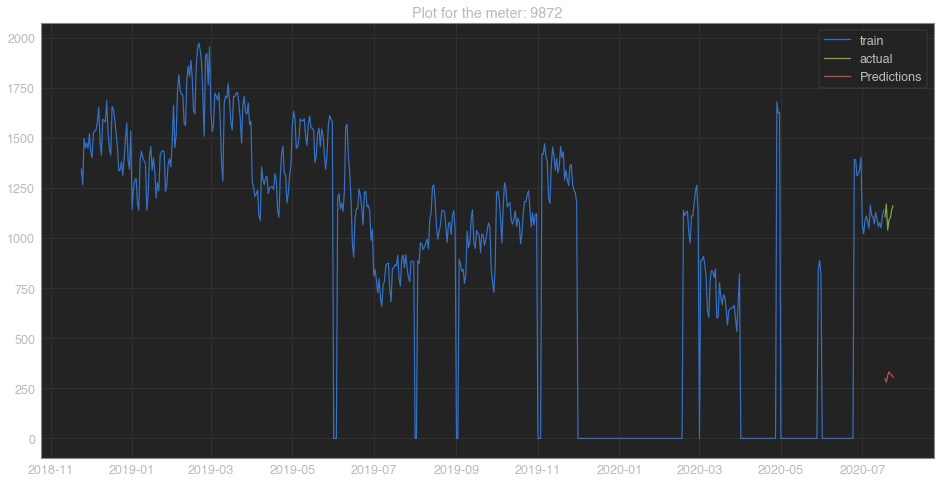

            ds         y
602 2020-07-18  1105.793
603 2020-07-19  1169.222
604 2020-07-20  1039.799
605 2020-07-21  1092.274
606 2020-07-22  1100.386
607 2020-07-23  1140.134
608 2020-07-24  1160.568
            ds  Predictions
602 2020-07-18   299.255177
603 2020-07-19   279.966558
604 2020-07-20   315.014384
605 2020-07-21   332.423246
606 2020-07-22   319.674522
607 2020-07-23   317.904976
608 2020-07-24   304.370606
72.22642691067074
Initial log joint probability = -37.9867
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      94       712.346    0.00331972       87.5236   3.311e-05       0.001      148  LS failed, Hessian reset 
      99       712.448   0.000398914       77.0535      0.7476      0.7476      153   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     143       712.494   4.14753e-06       81.4042   5.362e-08       0.001      245  LS failed, Hessian reset 
     182       712.495  

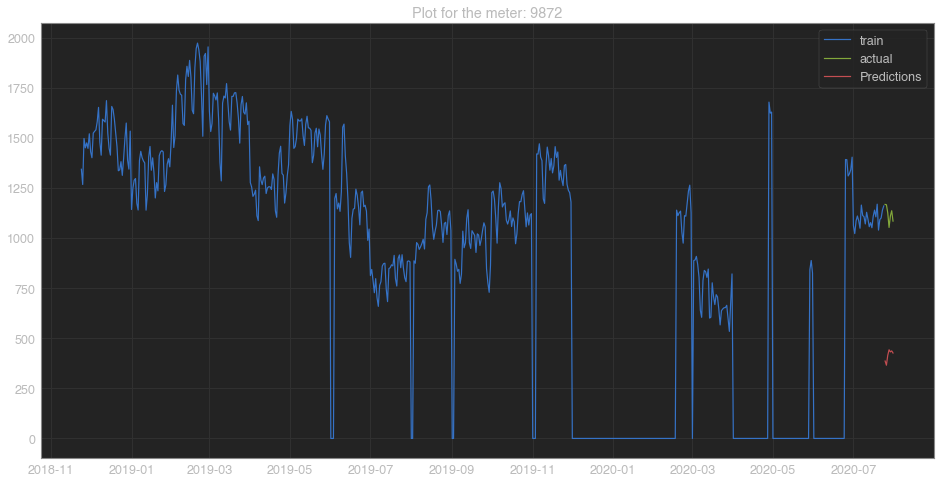

            ds         y
609 2020-07-25  1167.983
610 2020-07-26  1166.338
611 2020-07-27  1126.289
612 2020-07-28  1053.016
613 2020-07-29  1110.544
614 2020-07-30  1136.534
615 2020-07-31  1084.649
            ds  Predictions
609 2020-07-25   386.401662
610 2020-07-26   365.452536
611 2020-07-27   414.370264
612 2020-07-28   442.564883
613 2020-07-29   431.901831
614 2020-07-30   436.909114
615 2020-07-31   426.399475
62.98446015820842
Initial log joint probability = -34.8692
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       712.837   1.24734e-05       69.3043      0.3657      0.3657      129   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     183       712.899   0.000135263       66.3911   1.744e-06       0.001      275  LS failed, Hessian reset 
     199       712.911   4.08491e-06       66.2052      0.3519           1      296   
    Iter      log prob        ||dx||      ||grad

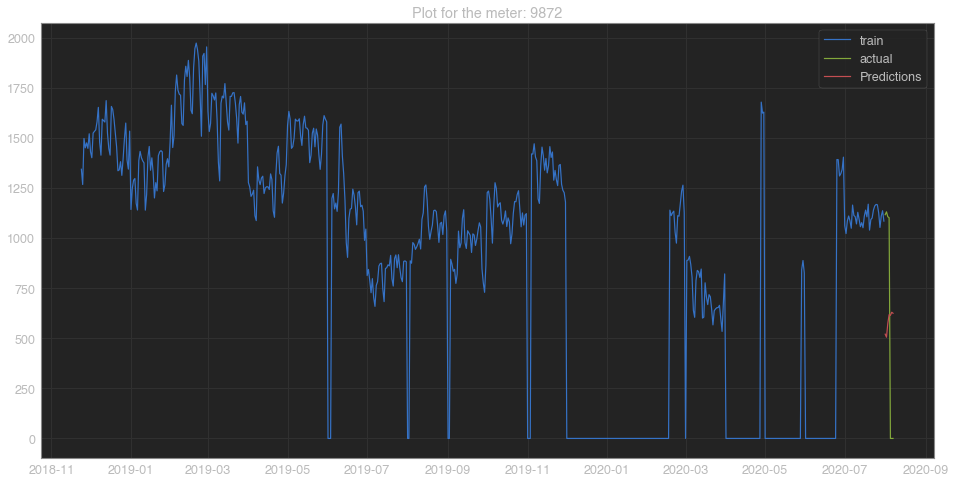

            ds          y
616 2020-08-01  1116.6180
617 2020-08-02  1130.9690
618 2020-08-03  1106.4800
619 2020-08-04  1101.7510
620 2020-08-05     0.0001
621 2020-08-06     0.0001
622 2020-08-07     0.0001
            ds  Predictions
616 2020-08-01   520.431082
617 2020-08-02   505.237232
618 2020-08-03   573.691759
619 2020-08-04   617.749500
620 2020-08-05   614.169721
621 2020-08-06   629.732393
622 2020-08-07   624.741374
8.305213883365049
Initial log joint probability = -22.5625
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      92       713.839   0.000355642       82.1208   4.123e-06       0.001      148  LS failed, Hessian reset 
      99       713.854   1.17028e-05       66.9097      0.3017      0.3017      159   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     153       713.857   1.43188e-05       93.8639   1.438e-07       0.001      276  LS failed, Hessian reset 
     188       7

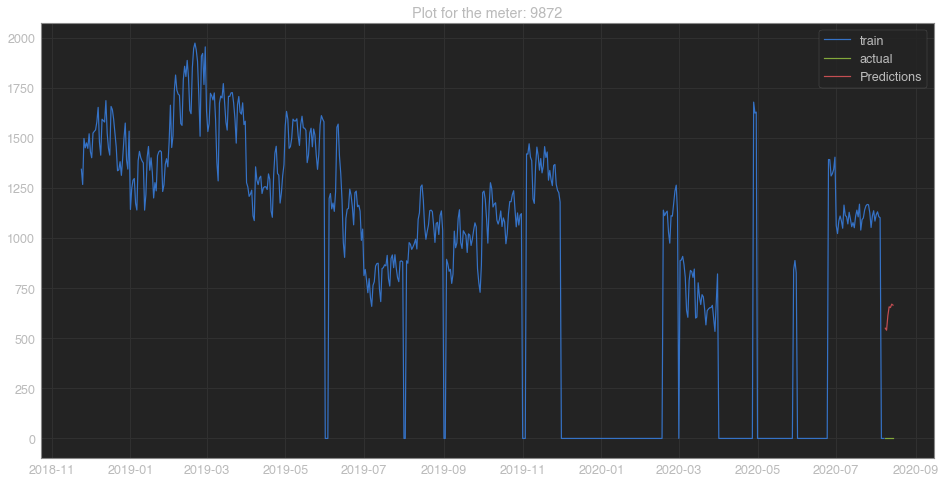

            ds       y
623 2020-08-08  0.0001
624 2020-08-09  0.0001
625 2020-08-10  0.0001
626 2020-08-11  0.0001
627 2020-08-12  0.0001
628 2020-08-13  0.0001
629 2020-08-14  0.0001
            ds  Predictions
623 2020-08-08   550.317999
624 2020-08-09   540.116616
625 2020-08-10   612.523231
626 2020-08-11   656.859068
627 2020-08-12   653.296837
628 2020-08-13   670.257344
629 2020-08-14   665.145137
621216504.6383893
    mape_weekly  meterID    type
0  7.222600e+01     9872    flag
1  6.298400e+01     9872    flag
2  8.305000e+00     9872  unflag
3  6.212165e+08     9872    flag
Initial log joint probability = -18.8069
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       896.295    0.00726554       83.5655           1           1      118   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     162       898.457    0.00472801       84.4073    5.07e-05       0.001      231  LS failed, H

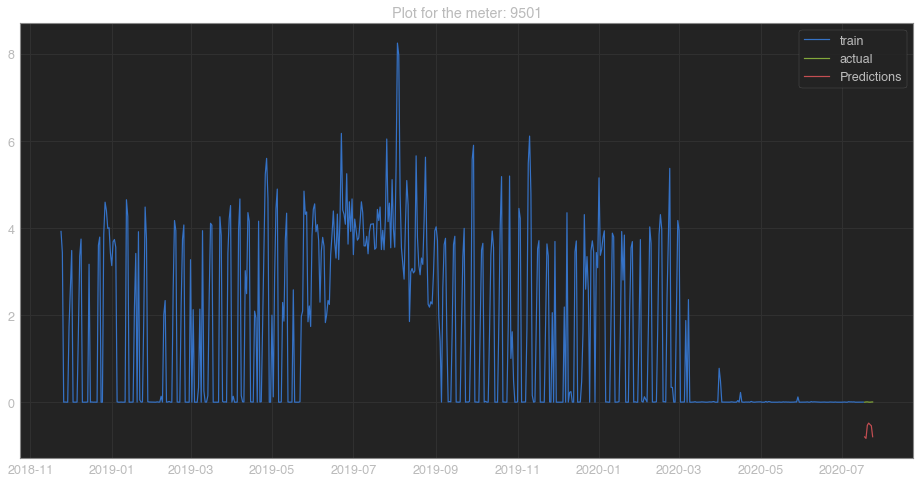

            ds       y
600 2020-07-18  0.0001
601 2020-07-19  0.0050
602 2020-07-20  0.0070
603 2020-07-21  0.0020
604 2020-07-22  0.0001
605 2020-07-23  0.0040
606 2020-07-24  0.0050
            ds  Predictions
600 2020-07-18    -0.797536
601 2020-07-19    -0.832791
602 2020-07-20    -0.532359
603 2020-07-21    -0.480428
604 2020-07-22    -0.513835
605 2020-07-23    -0.541868
606 2020-07-24    -0.793891
19465.121932771908
Initial log joint probability = -18.8235
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       910.056   0.000357352       82.3086      0.2365      0.2365      132   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       910.633    0.00421442       104.763      0.3818           1      256   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       921.645   0.000251802       75.4278      0.1871           1      37

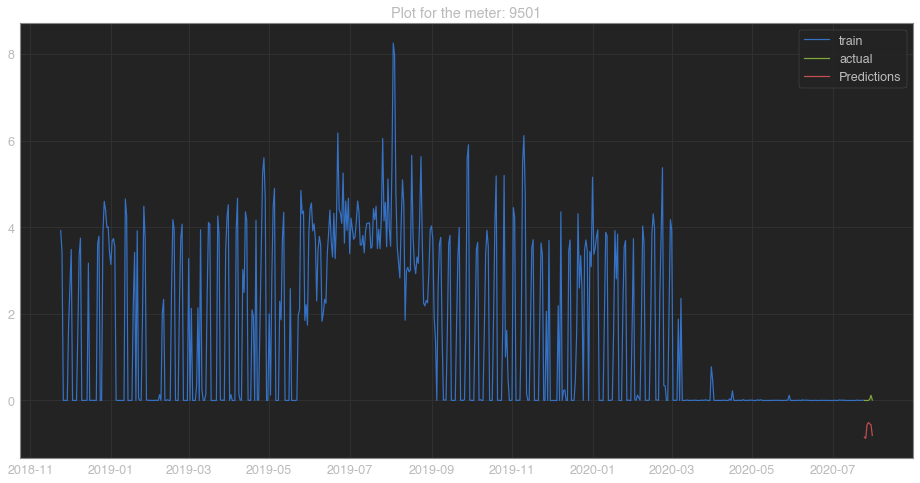

            ds       y
607 2020-07-25  0.0010
608 2020-07-26  0.0001
609 2020-07-27  0.0001
610 2020-07-28  0.0001
611 2020-07-29  0.0230
612 2020-07-30  0.1190
613 2020-07-31  0.0100
            ds  Predictions
607 2020-07-25    -0.843986
608 2020-07-26    -0.876532
609 2020-07-27    -0.565915
610 2020-07-28    -0.508997
611 2020-07-29    -0.538278
612 2020-07-30    -0.561460
613 2020-07-31    -0.808002
3167.9505973211326
Initial log joint probability = -18.8478
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       922.276    0.00569695       85.7899           1           1      127   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     123       922.712   0.000588923       87.2327   6.251e-06       0.001      187  LS failed, Hessian reset 
     177       922.819   5.78786e-08       85.5021           1           1      261   
Optimization terminated normally: 
  Convergence detected: rela

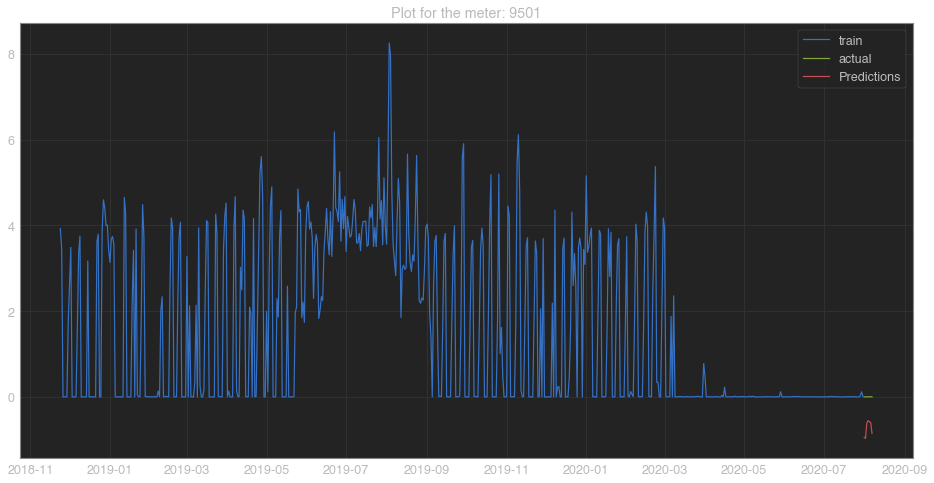

            ds       y
614 2020-08-01  0.0001
615 2020-08-02  0.0001
616 2020-08-03  0.0010
617 2020-08-04  0.0030
618 2020-08-05  0.0001
619 2020-08-06  0.0050
620 2020-08-07  0.0020
            ds  Predictions
614 2020-08-01    -0.942161
615 2020-08-02    -0.968870
616 2020-08-03    -0.616431
617 2020-08-04    -0.552404
618 2020-08-05    -0.581221
619 2020-08-06    -0.597073
620 2020-08-07    -0.851393
45317.27933278597
Initial log joint probability = -18.8699
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       935.239    0.00151357       91.9917      0.4474      0.9871      114   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       942.411     0.0032731       83.8765           1           1      231   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299        946.78     0.0139691       88.0779           1           1      346

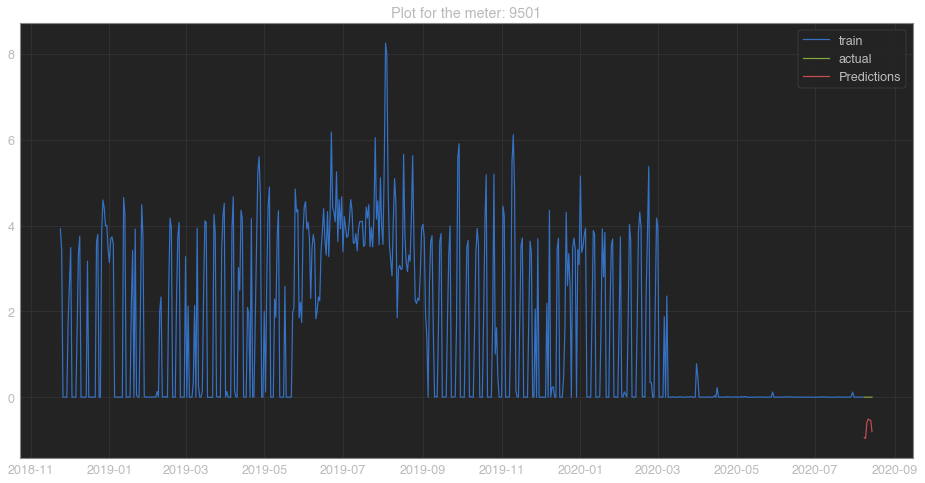

            ds       y
621 2020-08-08  0.0001
622 2020-08-09  0.0001
623 2020-08-10  0.0001
624 2020-08-11  0.0001
625 2020-08-12  0.0001
626 2020-08-13  0.0020
627 2020-08-14  0.0010
            ds  Predictions
621 2020-08-08    -0.940329
622 2020-08-09    -0.960930
623 2020-08-10    -0.589404
624 2020-08-11    -0.509570
625 2020-08-12    -0.528205
626 2020-08-13    -0.540076
627 2020-08-14    -0.802638
139275.76966252885
   mape_weekly  meterID  type
0    19465.122     9501  flag
1     3167.951     9501  flag
2    45317.279     9501  flag
3   139275.770     9501  flag
Initial log joint probability = -14.3388
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1022.86   0.000108988       65.2673      0.4162           1      118   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     112       1023.32   0.000779039       74.8091   5.752e-06       0.001      169  LS failed, Hessian reset 


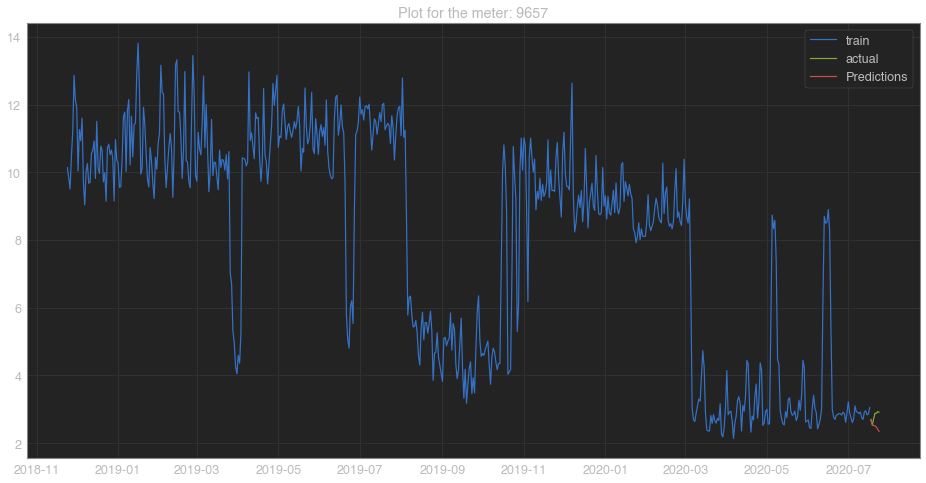

            ds      y
600 2020-07-18  2.701
601 2020-07-19  2.533
602 2020-07-20  2.729
603 2020-07-21  2.885
604 2020-07-22  2.882
605 2020-07-23  2.933
606 2020-07-24  2.915
            ds  Predictions
600 2020-07-18     2.662126
601 2020-07-19     2.560327
602 2020-07-20     2.516180
603 2020-07-21     2.510970
604 2020-07-22     2.477189
605 2020-07-23     2.419360
606 2020-07-24     2.347841
10.644635159996495
Initial log joint probability = -14.4485
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      91       1038.39     0.0007434        77.668   7.862e-06       0.001      153  LS failed, Hessian reset 
      99        1038.6   0.000590155       58.5548      0.4335           1      165   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     104       1038.63   8.21381e-05       55.4574   1.545e-06       0.001      213  LS failed, Hessian reset 
     199       1039.11   9.54145e-07       57.9

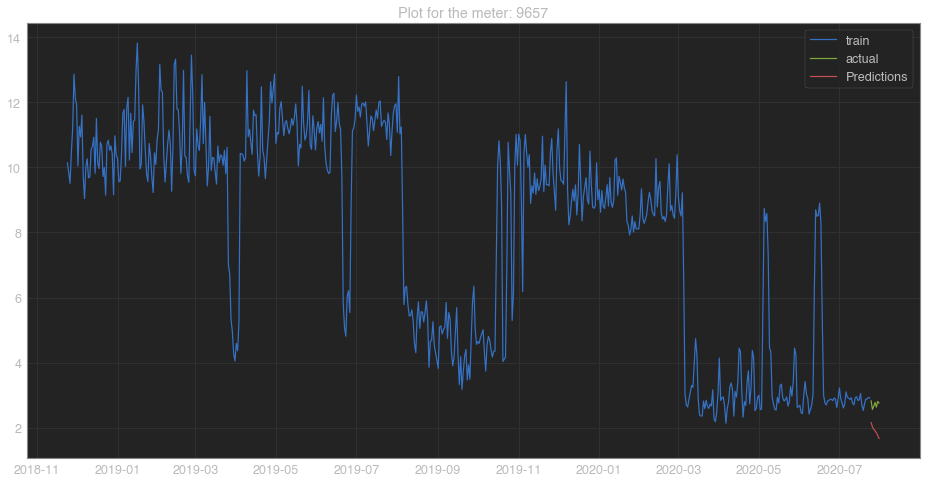

            ds      y
607 2020-07-25  2.827
608 2020-07-26  2.563
609 2020-07-27  2.661
610 2020-07-28  2.778
611 2020-07-29  2.635
612 2020-07-30  2.811
613 2020-07-31  2.759
            ds  Predictions
607 2020-07-25     2.161004
608 2020-07-26     2.031738
609 2020-07-27     1.951770
610 2020-07-28     1.909238
611 2020-07-29     1.844652
612 2020-07-30     1.762279
613 2020-07-31     1.672327
29.951620073326378
Initial log joint probability = -14.5944
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      87        1052.1    0.00993692       171.301   0.0001255       0.001      153  LS failed, Hessian reset 
      99       1052.47   0.000181423       47.6542      0.6074      0.6074      171   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     166       1053.82    0.00116051        146.36   1.561e-05       0.001      302  LS failed, Hessian reset 
     198       1054.63   7.18461e-05        60.

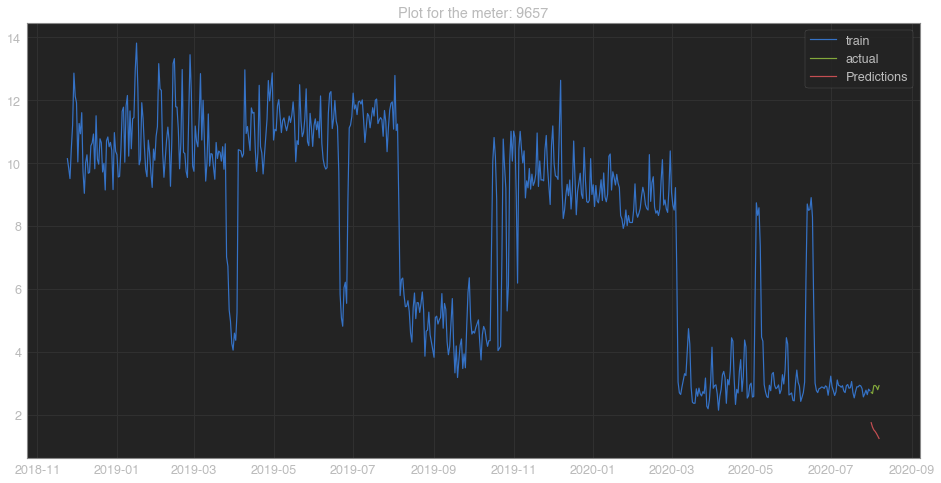

            ds      y
614 2020-08-01  2.713
615 2020-08-02  2.670
616 2020-08-03  2.919
617 2020-08-04  2.929
618 2020-08-05  2.890
619 2020-08-06  2.794
620 2020-08-07  2.920
            ds  Predictions
614 2020-08-01     1.743387
615 2020-08-02     1.602420
616 2020-08-03     1.514565
617 2020-08-04     1.467225
618 2020-08-05     1.402278
619 2020-08-06     1.324414
620 2020-08-07     1.242695
48.086800411442354
Initial log joint probability = -14.1338
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1064.76     0.0030055       86.0077           1           1      129   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     102       1064.94     0.0014648       152.039   1.857e-05       0.001      168  LS failed, Hessian reset 
     128       1065.15   0.000168453       59.7787   3.145e-06       0.001      232  LS failed, Hessian reset 
     183       1065.88    0.00100687       105.

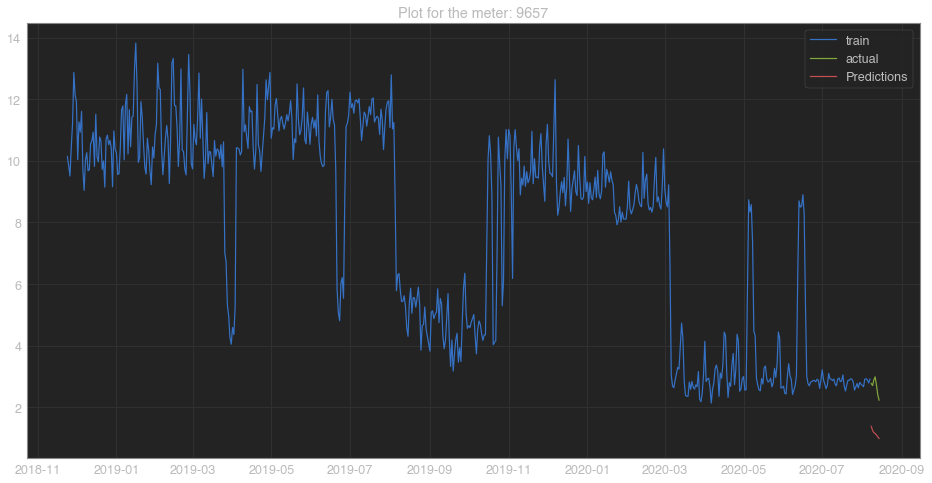

            ds      y
621 2020-08-08  2.778
622 2020-08-09  2.708
623 2020-08-10  2.891
624 2020-08-11  2.992
625 2020-08-12  2.729
626 2020-08-13  2.422
627 2020-08-14  2.238
            ds  Predictions
621 2020-08-08     1.387755
622 2020-08-09     1.255041
623 2020-08-10     1.182845
624 2020-08-11     1.153242
625 2020-08-12     1.108600
626 2020-08-13     1.053268
627 2020-08-14     0.994959
56.628048909955474
   mape_weekly  meterID    type
0       10.645     9657  unflag
1       29.952     9657  unflag
2       48.087     9657  unflag
3       56.628     9657    flag
Initial log joint probability = -27.3549
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       902.443    0.00450528       95.3881           1           1      116   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     128       907.094   0.000630692       75.3847   5.253e-06       0.001      185  LS failed, Hessian reset

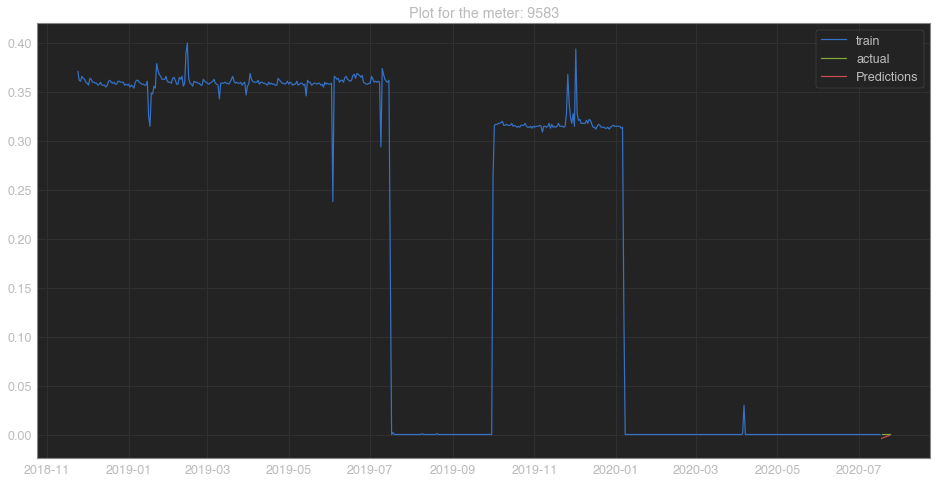

            ds       y
600 2020-07-18  0.0001
601 2020-07-19  0.0001
602 2020-07-20  0.0001
603 2020-07-21  0.0001
604 2020-07-22  0.0001
605 2020-07-23  0.0001
606 2020-07-24  0.0001
            ds  Predictions
600 2020-07-18    -0.003944
601 2020-07-19    -0.003427
602 2020-07-20    -0.002856
603 2020-07-21    -0.002443
604 2020-07-22    -0.001844
605 2020-07-23    -0.001382
606 2020-07-24    -0.000959
2507.8764880818976
Initial log joint probability = -27.4235
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       924.532     0.0204817       92.1885      0.5767      0.5767      119   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       933.639     0.0023262         127.7      0.4298      0.4298      242   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299        936.84    0.00107251       51.2919           1           1      36

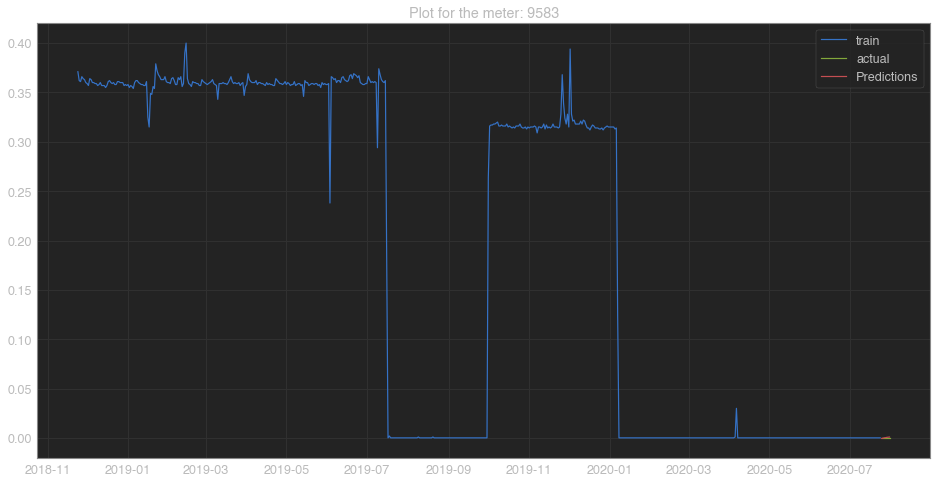

            ds       y
607 2020-07-25  0.0001
608 2020-07-26  0.0001
609 2020-07-27  0.0001
610 2020-07-28  0.0001
611 2020-07-29  0.0001
612 2020-07-30  0.0001
613 2020-07-31  0.0001
            ds  Predictions
607 2020-07-25    -0.000484
608 2020-07-26    -0.000180
609 2020-07-27     0.000148
610 2020-07-28     0.000298
611 2020-07-29     0.000617
612 2020-07-30     0.000789
613 2020-07-31     0.000914
200.4488090988799
Initial log joint probability = -27.5133
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      98        929.72    0.00240708       198.044   2.166e-05       0.001      144  LS failed, Hessian reset 
      99       929.893    0.00208161       143.797           1           1      145   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       948.303   0.000508429       81.8634      0.2287       0.896      265   
    Iter      log prob        ||dx||      ||grad||       alpha  

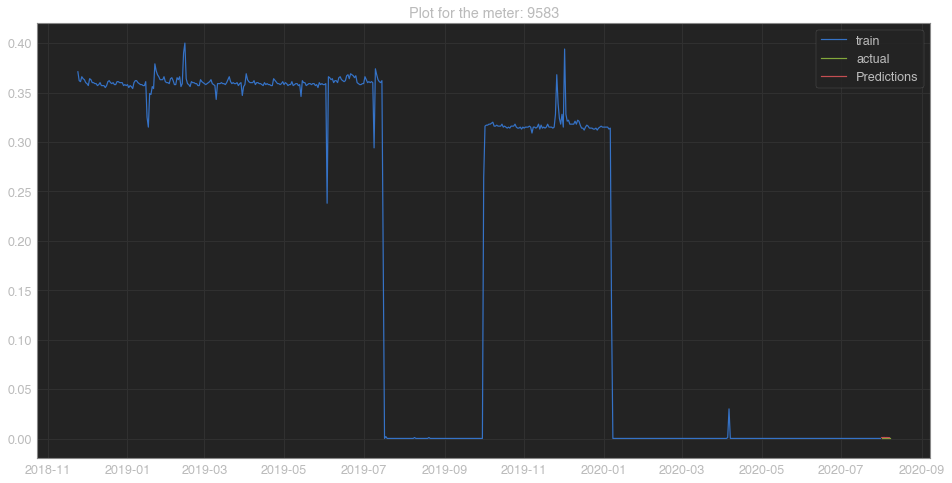

            ds       y
614 2020-08-01  0.0001
615 2020-08-02  0.0001
616 2020-08-03  0.0001
617 2020-08-04  0.0001
618 2020-08-05  0.0001
619 2020-08-06  0.0001
620 2020-08-07  0.0001
            ds  Predictions
614 2020-08-01     0.000980
615 2020-08-02     0.001012
616 2020-08-03     0.001070
617 2020-08-04     0.000959
618 2020-08-05     0.001031
619 2020-08-06     0.000968
620 2020-08-07     0.000875
884.9347416071472
Initial log joint probability = -27.6236
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       941.919     0.0175274       215.402           1           1      117   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     148       956.483    0.00105373       136.916   8.659e-06       0.001      213  LS failed, Hessian reset 
     199       961.584     0.0343395       158.215           1           1      286   
    Iter      log prob        ||dx||      ||grad||       alpha  

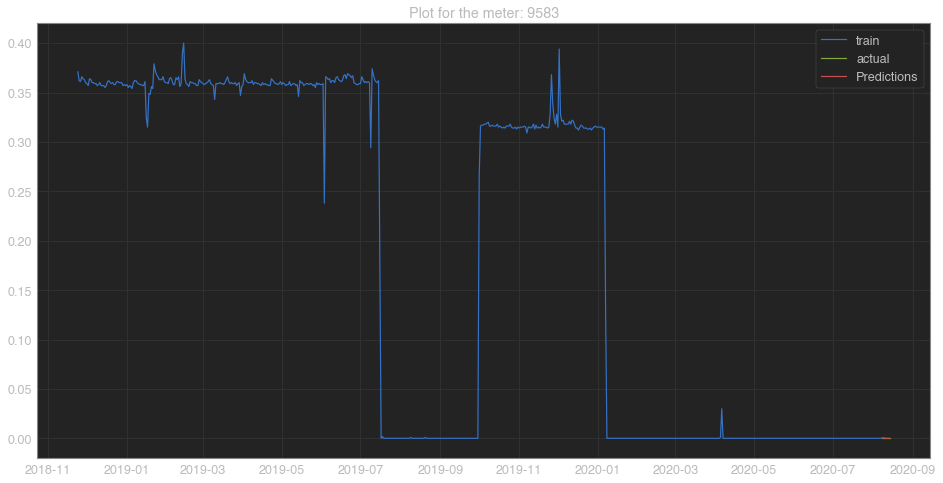

            ds       y
621 2020-08-08  0.0001
622 2020-08-09  0.0001
623 2020-08-10  0.0001
624 2020-08-11  0.0001
625 2020-08-12  0.0001
626 2020-08-13  0.0001
627 2020-08-14  0.0001
            ds  Predictions
621 2020-08-08     0.000539
622 2020-08-09     0.000442
623 2020-08-10     0.000376
624 2020-08-11     0.000210
625 2020-08-12     0.000187
626 2020-08-13     0.000088
627 2020-08-14    -0.000014
160.96436364227088
   mape_weekly  meterID  type
0     2507.876     9583  flag
1      200.449     9583  flag
2      884.935     9583  flag
3      160.964     9583  flag
Initial log joint probability = -36.0918
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       921.914    0.00122653        82.738      0.8663      0.8663      118   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     169       924.966    0.00109484       75.4998   1.331e-05       0.001      242  LS failed, Hessian reset 


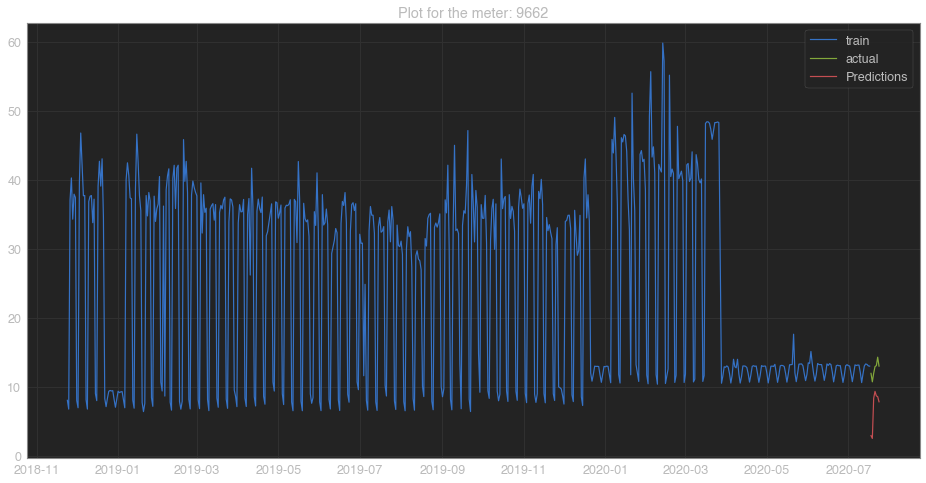

            ds       y
600 2020-07-18  11.968
601 2020-07-19  10.740
602 2020-07-20  11.974
603 2020-07-21  12.957
604 2020-07-22  13.088
605 2020-07-23  14.314
606 2020-07-24  13.019
            ds  Predictions
600 2020-07-18     2.938832
601 2020-07-19     2.534216
602 2020-07-20     8.372109
603 2020-07-21     9.354143
604 2020-07-22     8.701068
605 2020-07-23     8.592149
606 2020-07-24     7.848102
45.10490702026983
Initial log joint probability = -36.1435
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       935.363    0.00204869       83.5915      0.6907      0.6907      136   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       935.895    0.00211506       74.2656           1           1      264   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       936.869    0.00326558       106.831      0.6958      0.6958      377

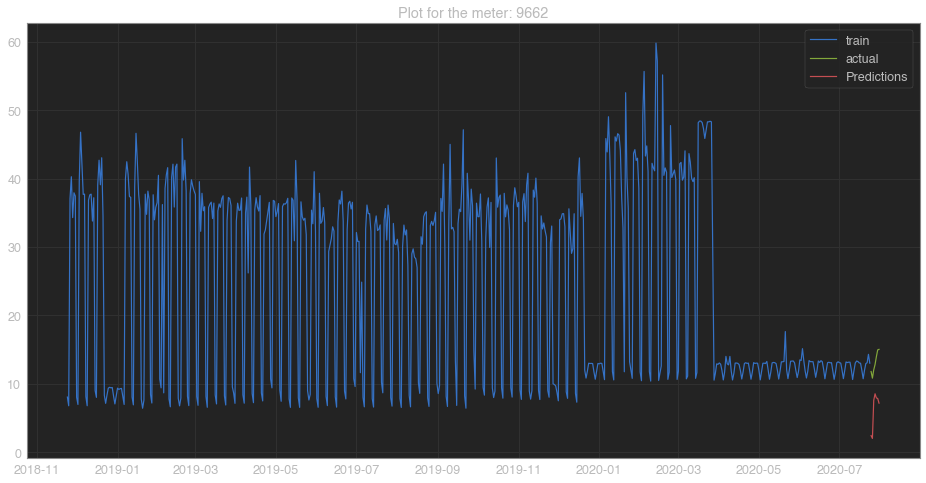

            ds       y
607 2020-07-25  11.799
608 2020-07-26  10.828
609 2020-07-27  12.042
610 2020-07-28  12.831
611 2020-07-29  13.965
612 2020-07-30  14.964
613 2020-07-31  15.039
            ds  Predictions
607 2020-07-25     2.417394
608 2020-07-26     2.007863
609 2020-07-27     7.594352
610 2020-07-28     8.541117
611 2020-07-29     7.933042
612 2020-07-30     7.852787
613 2020-07-31     7.171466
52.422682334311666
Initial log joint probability = -34.3611
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       945.223    0.00392257       87.3321      0.2357           1      120   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     110       946.125    0.00401323       202.962   4.722e-05       0.001      175  LS failed, Hessian reset 
     165       947.409   0.000886277       101.983    9.32e-06       0.001      274  LS failed, Hessian reset 
     199       947.476   2.60894e-06   

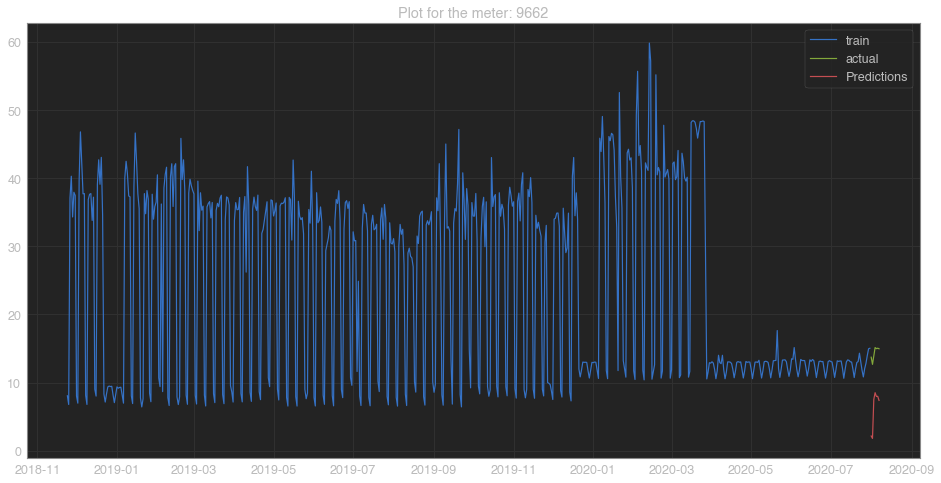

            ds       y
614 2020-08-01  13.728
615 2020-08-02  12.674
616 2020-08-03  13.909
617 2020-08-04  15.143
618 2020-08-05  14.982
619 2020-08-06  15.046
620 2020-08-07  14.968
            ds  Predictions
614 2020-08-01     2.155908
615 2020-08-02     1.798926
616 2020-08-03     7.528355
617 2020-08-04     8.519740
618 2020-08-05     7.959891
619 2020-08-06     7.985777
620 2020-08-07     7.382158
56.86335937987093
Initial log joint probability = -34.4897
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       955.261   0.000608615       86.4738      0.5483      0.5483      124   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       959.485    0.00204871       98.9691      0.1634           1      239   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     200       959.509   0.000627501       70.8724    6.34e-06       0.001      275

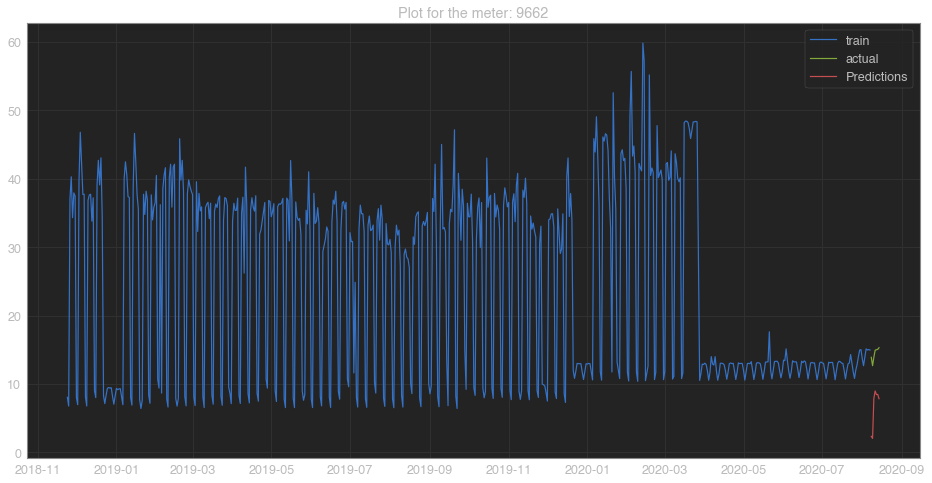

            ds       y
621 2020-08-08  13.911
622 2020-08-09  12.682
623 2020-08-10  13.920
624 2020-08-11  14.948
625 2020-08-12  15.022
626 2020-08-13  15.067
627 2020-08-14  15.308
            ds  Predictions
621 2020-08-08     2.359822
622 2020-08-09     2.048127
623 2020-08-10     7.904943
624 2020-08-11     8.988079
625 2020-08-12     8.460650
626 2020-08-13     8.479808
627 2020-08-14     7.855704
54.295016134835926
   mape_weekly  meterID    type
0       45.105     9662  unflag
1       52.423     9662    flag
2       56.863     9662    flag
3       54.295     9662    flag
Initial log joint probability = -35.2266
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       949.047   3.36422e-05       60.4289      0.3453      0.3453      122   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     142       949.085   5.49236e-05       75.7318   6.857e-07       0.001      214  LS failed, Hessi

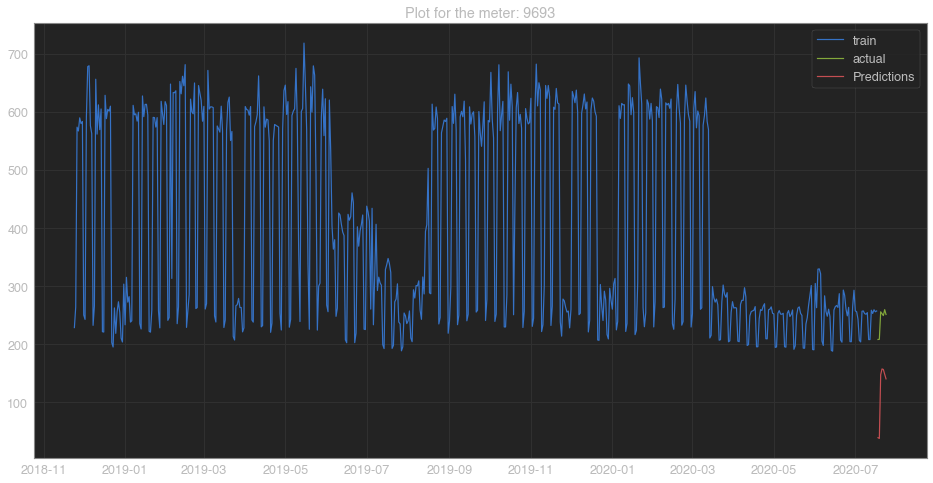

            ds       y
600 2020-07-18  208.32
601 2020-07-19  208.64
602 2020-07-20  256.00
603 2020-07-21  252.80
604 2020-07-22  249.44
605 2020-07-23  259.68
606 2020-07-24  251.36
            ds  Predictions
600 2020-07-18    39.208739
601 2020-07-19    37.925270
602 2020-07-20   147.573616
603 2020-07-21   157.630004
604 2020-07-22   156.616506
605 2020-07-23   148.436508
606 2020-07-24   140.479814
50.90435186393197
Initial log joint probability = -35.6979
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      97       957.263   0.000134348       60.1875   1.786e-06       0.001      152  LS failed, Hessian reset 
      99       957.264   1.87528e-05       44.0308      0.4951      0.4951      154   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     169       957.338   9.50798e-05       74.2278    1.18e-06       0.001      313  LS failed, Hessian reset 
     199       957.367   0.000299518    

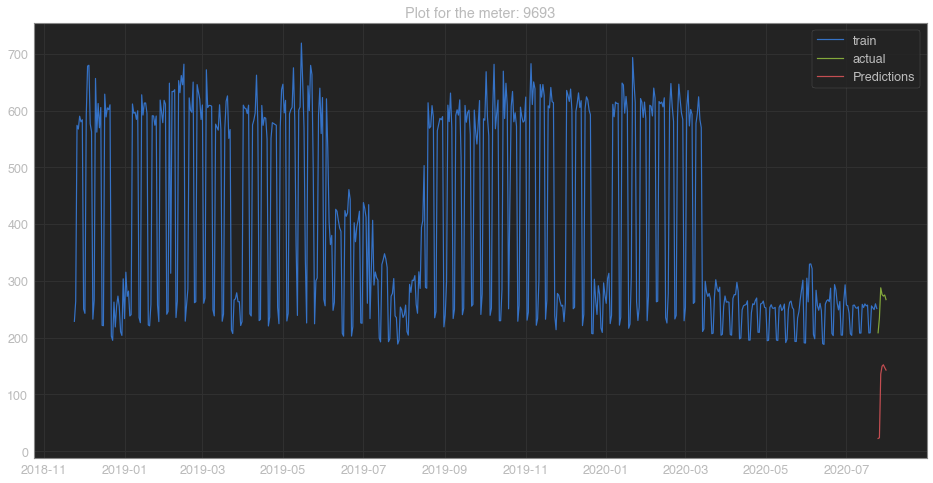

            ds       y
607 2020-07-25  208.64
608 2020-07-26  234.72
609 2020-07-27  287.84
610 2020-07-28  276.00
611 2020-07-29  273.28
612 2020-07-30  275.20
613 2020-07-31  267.04
            ds  Predictions
607 2020-07-25    22.641734
608 2020-07-26    23.766940
609 2020-07-27   136.036667
610 2020-07-28   149.757893
611 2020-07-29   152.283472
612 2020-07-30   147.327388
613 2020-07-31   143.023599
57.490031712170506
Initial log joint probability = -34.6203
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       962.288   0.000286268       87.1904      0.6062      0.6062      119   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       962.423   1.55622e-05       84.2346       0.255           1      261   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     222       962.448   8.35373e-05       71.1726    1.01e-06       0.001      32

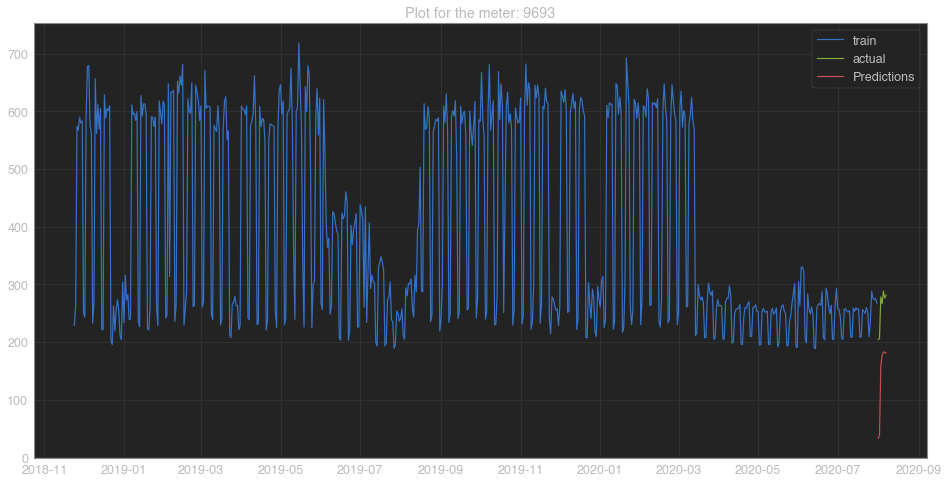

            ds       y
614 2020-08-01  204.00
615 2020-08-02  206.08
616 2020-08-03  278.08
617 2020-08-04  266.48
618 2020-08-05  288.32
619 2020-08-06  276.16
620 2020-08-07  281.12
            ds  Predictions
614 2020-08-01    32.441617
615 2020-08-02    37.803343
616 2020-08-03   158.056429
617 2020-08-04   176.280783
618 2020-08-05   182.859072
619 2020-08-06   181.499003
620 2020-08-07   180.490498
47.2608793778242
Initial log joint probability = -33.7619
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99        970.42   5.64938e-05       61.0894           1           1      125   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     129       970.594   0.000794333       93.9926   1.009e-05       0.001      213  LS failed, Hessian reset 
     199       970.749   0.000212893       38.4689           1           1      297   
    Iter      log prob        ||dx||      ||grad||       alpha   

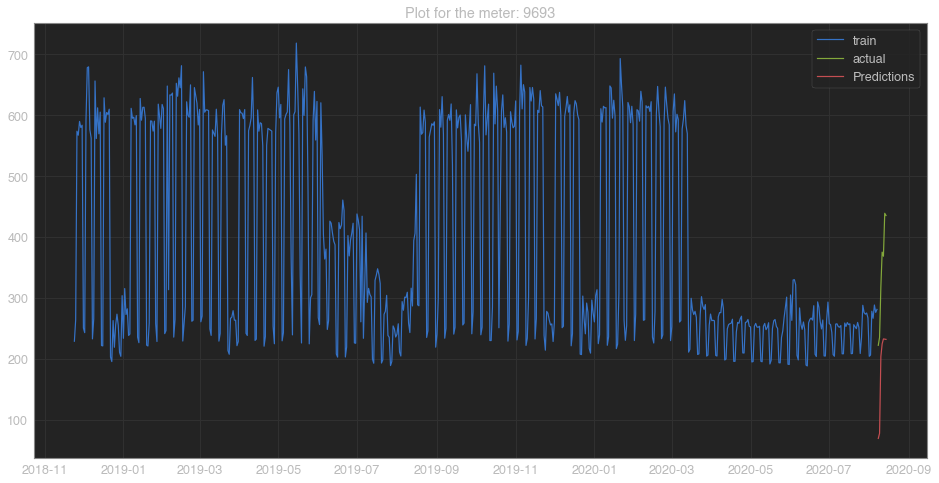

            ds       y
621 2020-08-08  222.08
622 2020-08-09  235.20
623 2020-08-10  317.76
624 2020-08-11  375.20
625 2020-08-12  368.48
626 2020-08-13  439.04
627 2020-08-14  435.36
            ds  Predictions
621 2020-08-08    69.065004
622 2020-08-09    77.459801
623 2020-08-10   203.669377
624 2020-08-11   224.357940
625 2020-08-12   232.618269
626 2020-08-13   232.219256
627 2020-08-14   231.810496
46.88105304279585
   mape_weekly  meterID    type
0       50.904     9693    flag
1       57.490     9693    flag
2       47.261     9693  unflag
3       46.881     9693  unflag


In [59]:
for i in flagged_list:
    account_and_days_billcycle11(i)

In [72]:
def gaps_checking(acc):
    dff_acc=df_[df_.AccountNumber==acc]
    meterIDs = dff_acc[dff_acc.AccountNumber == acc].MeterId.unique()
    acc_list=[]
    met_list=[]
    for x in meterIDs:
        dff_met=dff_acc[dff_acc.MeterId==x]
        dff_met.Usagedate = pd.to_datetime(dff_met.Usagedate)
        dff_met = dff_met.set_index('Usagedate')
        missing_met = dff_met.resample('D').min().notnull() 
        missing_met=missing_met['Value']
        
        missing_met_df=pd.DataFrame({'Usagedate':missing_met.index, 'Value':missing_met.values})
        if (not(missing_met_df['Value'].all())):
            ind_chg=missing_met_df.ne(missing_met_df.shift()).apply(lambda x: x.index[x].tolist())[1]
            ind_chg.pop(0)
            gap_startdate=[]
            gap_enddate=[]
            gap_duration=[]
            gaps=(len(ind_chg)//2)
            for i in range(0,len(ind_chg)-1,2):
                gap=missing_met_df[ind_chg[i]:ind_chg[i+1]]
                gap_startdate.append(gap['Usagedate'].iloc[0])
                gap_enddate.append(gap['Usagedate'].iloc[-1])
                gap_duration.append(ind_chg[i+1]-ind_chg[i])
                met_list.append(x)
                acc_list.append(acc)
            gap_df=pd.DataFrame(list(zip(acc_list,met_list,gap_startdate, gap_enddate,gap_duration)),columns=['AccountNumber','MeterId','startdate','endadate','duration'])
            plt.figure(figsize=(10,5)) 
            plt.bar(missing_met.index, np.ones(len(missing_met)), color = [['y','b'][idx] for idx in missing_met], width = 10)
            #print(gap_df)
        else:
            description=[]
            description.append('no gaps')
            met_list.append(x)
            acc_list.append(acc)
            gap_df=pd.DataFrame(list(zip(acc_list,met_list,description)),columns=['AccountNumber','MeterId','description'])
            plt.figure(figsize=(10,5)) 
            plt.bar(missing_met.index, np.ones(len(missing_met)), color = [['y','b'][idx] for idx in missing_met], width = 10)
            #print(gap_df)
    print(gap_df)

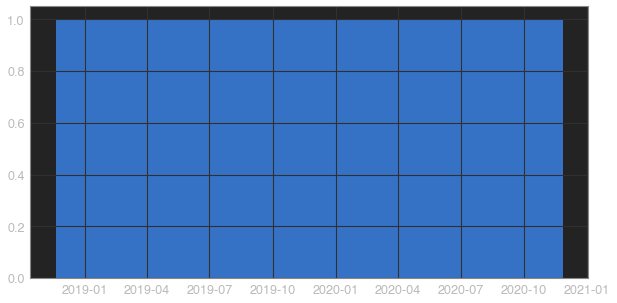

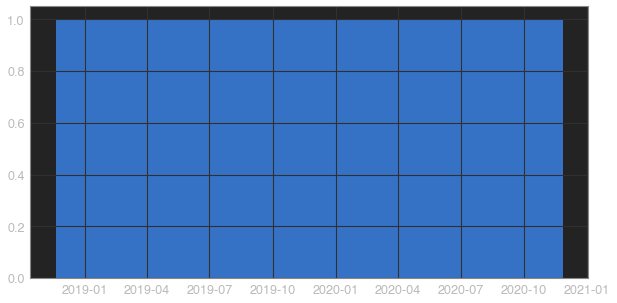

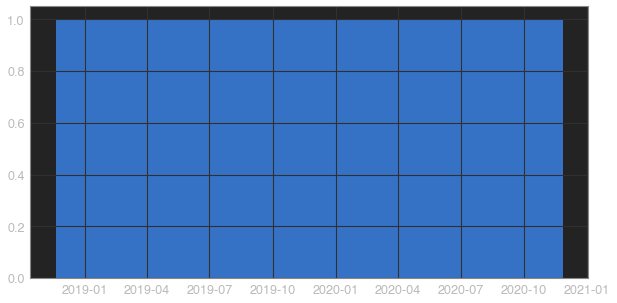

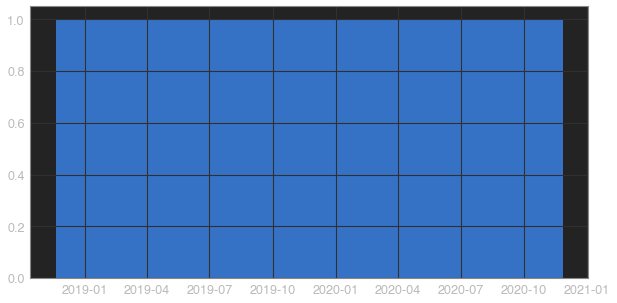

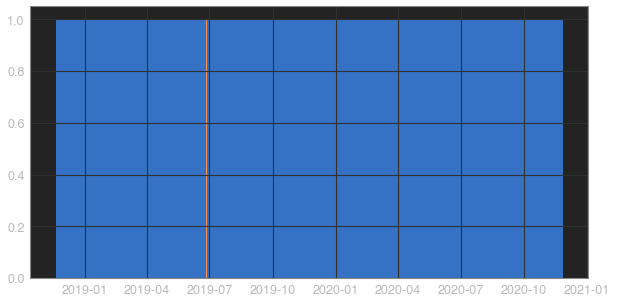

...

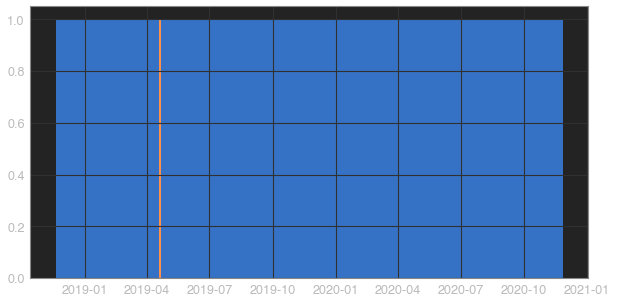

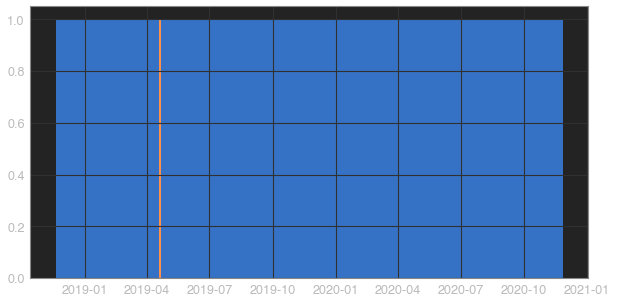

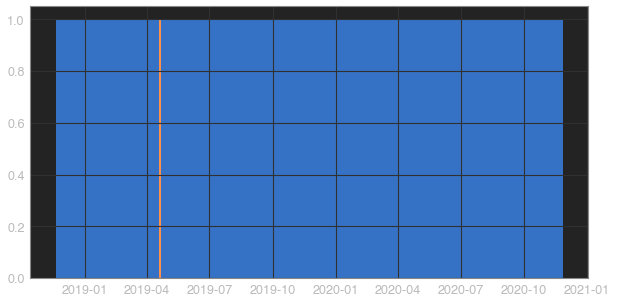

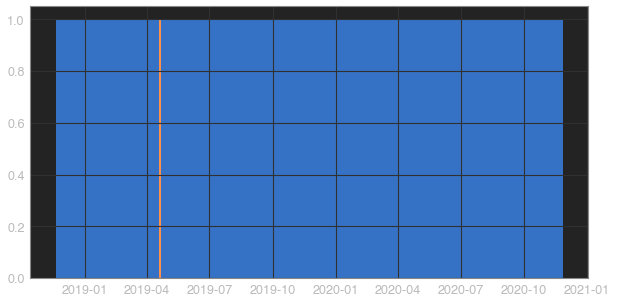

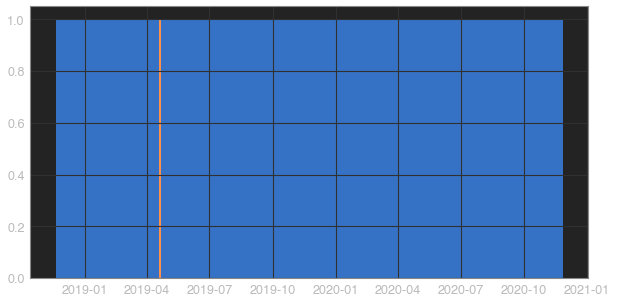

In [219]:
for i in more_than_year_acc[:50]:
    gaps_checking(i)

,AccountNumber,MeterId,description
0,15976,9872,no gaps


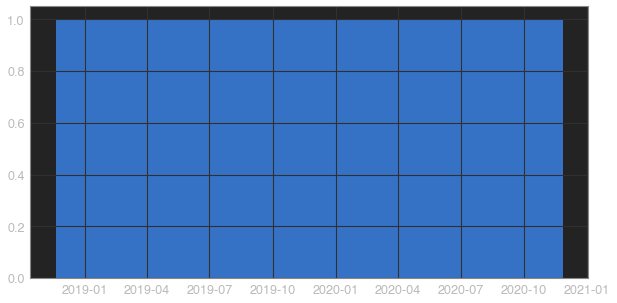

In [103]:
gaps_checking(15976)

,AccountNumber,MeterId,startdate,endadate,duration
0,14318,9501,2019-04-24,2019-04-25,2


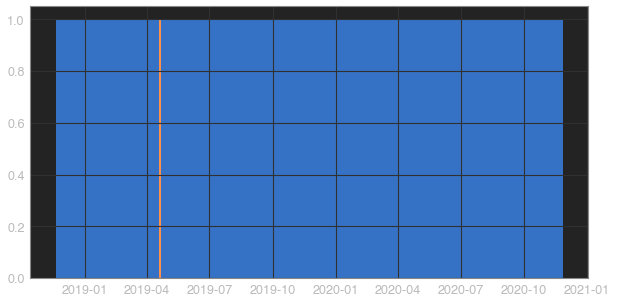

In [104]:
gaps_checking(14318)

,AccountNumber,MeterId,startdate,endadate,duration
0,14474,9657,2019-04-24,2019-04-25,2


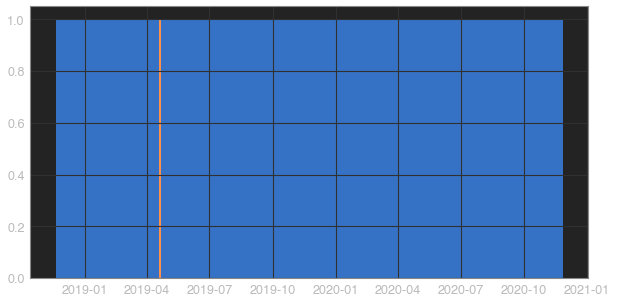

In [106]:
gaps_checking(14474)

,AccountNumber,MeterId,startdate,endadate,duration
0,14400,9583,2019-04-24,2019-04-25,2


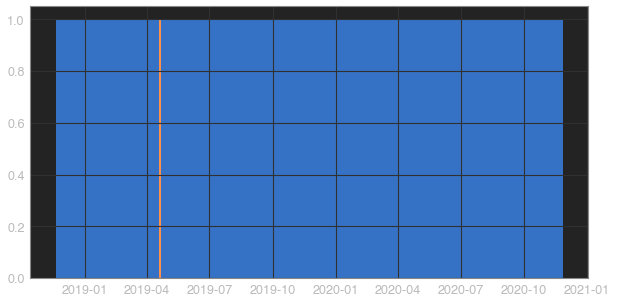

In [108]:
gaps_checking(14400)

,AccountNumber,MeterId,startdate,endadate,duration
0,14479,9662,2019-04-24,2019-04-25,2


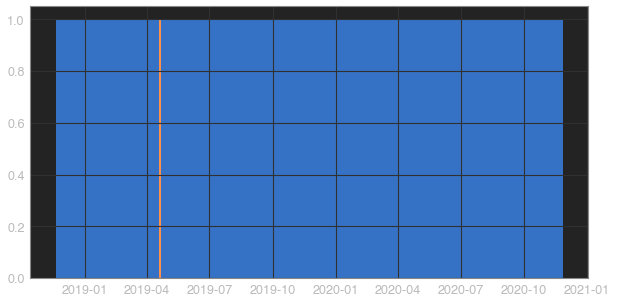

In [110]:
gaps_checking(14479)

   AccountNumber  MeterId  startdate   endadate  duration
0          14510     9693 2019-04-24 2019-04-25         2


,AccountNumber,MeterId,startdate,endadate,duration
0,14510,9693,2019-04-24,2019-04-25,2


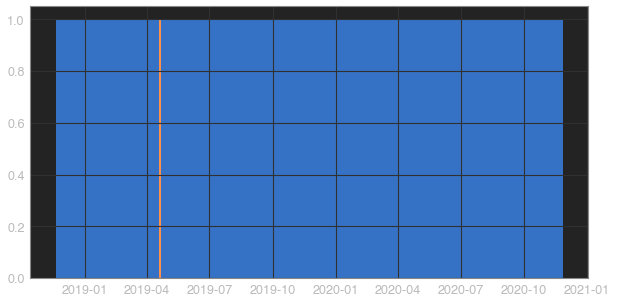

In [212]:
gaps_checking(14510)

   AccountNumber  MeterId  startdate   endadate  duration
0          14306     9489 2019-04-24 2019-04-25         2
   AccountNumber  MeterId  startdate   endadate  duration
0          14321     9504 2019-04-24 2019-04-25         2
   AccountNumber  MeterId  startdate   endadate  duration
0          14433     9616 2019-04-24 2019-04-25         2
   AccountNumber  MeterId  startdate   endadate  duration
0          14359     9542 2019-04-24 2019-04-25         2
   AccountNumber  MeterId  startdate   endadate  duration
0          14450     9633 2019-04-24 2019-04-25         2
1          14450     9633 2019-12-28 2019-12-28         1
   AccountNumber  MeterId  startdate   endadate  duration
0          11225     6408 2019-04-25 2019-04-25         1
1          11225     6408 2019-07-05 2019-07-05         1
2          11225     6408 2019-07-29 2019-07-29         1
   AccountNumber  MeterId  startdate   endadate  duration
0          14480     9663 2019-04-24 2019-04-25         2
1          144

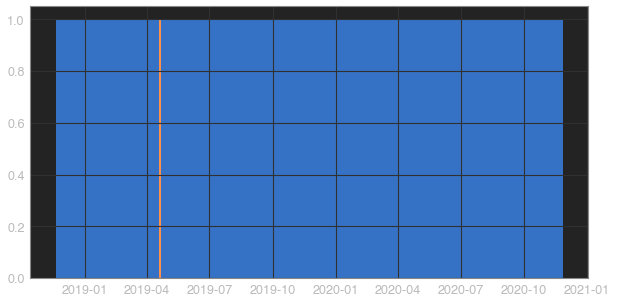

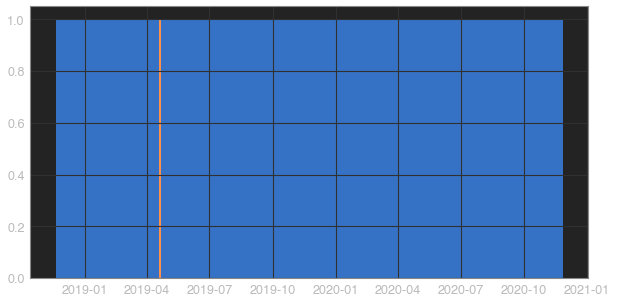

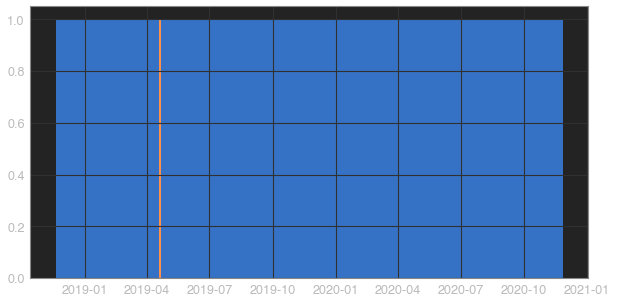

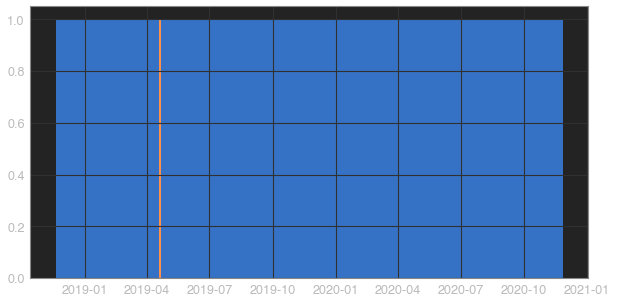

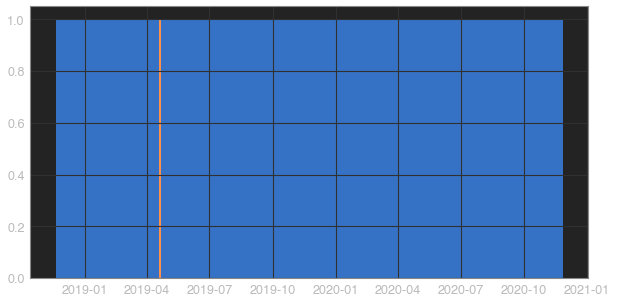

...

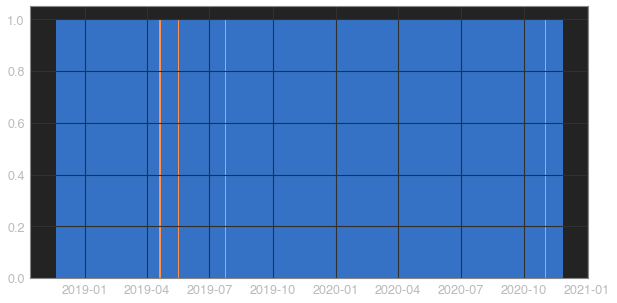

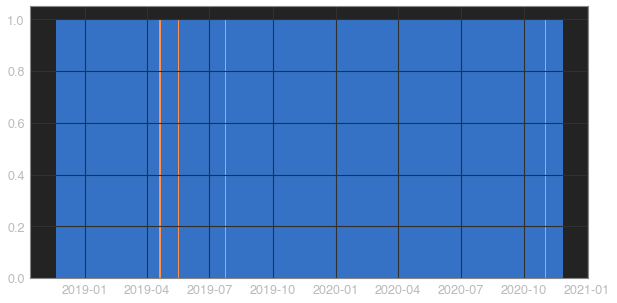

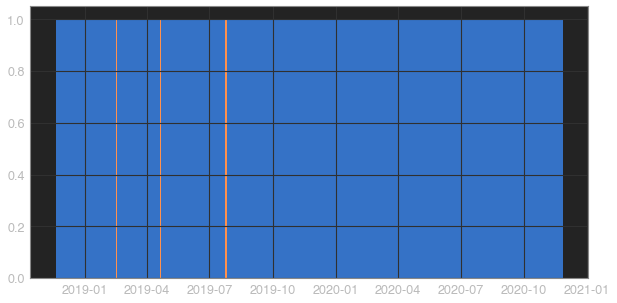

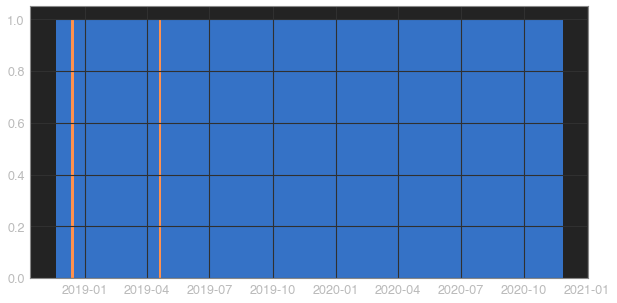

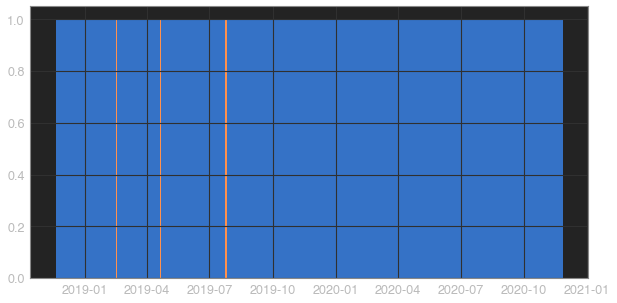

In [108]:
for acc in flagged_list_acc_next100:
    gaps_checking(acc)

   AccountNumber  MeterId  startdate   endadate  duration
0          15927     9837 2019-02-20 2019-02-20         1
1          15927     9837 2019-04-25 2019-04-26         2
2          15927     9837 2019-07-05 2019-07-05         1
3          15927     9837 2019-07-29 2019-07-30         2
4          15927     9837 2019-11-13 2019-11-13         1
   AccountNumber  MeterId  startdate   endadate  duration
0          12757     7940 2019-04-24 2019-04-25         2
1          12757     7940 2019-07-04 2019-07-04         1
2          12757     7940 2019-07-28 2019-07-29         2
3          12757     7940 2019-11-11 2019-11-12         2
   AccountNumber  MeterId  startdate   endadate  duration
0          15802     9745 2019-02-20 2019-02-20         1
1          15802     9745 2019-04-25 2019-04-26         2
2          15802     9745 2019-07-05 2019-07-05         1
3          15802     9745 2019-07-29 2019-07-30         2
4          15802     9745 2019-11-13 2019-11-13         1
   AccountNumb

   AccountNumber  MeterId  startdate   endadate  duration
0          11347     6530 2019-02-20 2019-02-20         1
1          11347     6530 2019-04-25 2019-04-26         2
2          11347     6530 2019-10-01 2019-10-04         4
3          11347     6530 2020-10-23 2020-10-23         1
   AccountNumber  MeterId  startdate   endadate  duration
0          11417     6600 2019-04-25 2019-04-26         2
1          11417     6600 2019-07-05 2019-07-05         1
2          11417     6600 2019-07-29 2019-07-30         2
3          11417     6600 2019-11-12 2019-11-13         2
4          11417     6600 2020-10-23 2020-10-23         1
   AccountNumber  MeterId  startdate   endadate  duration
0          11411     6594 2019-04-25 2019-04-26         2
1          11411     6594 2019-07-05 2019-07-05         1
2          11411     6594 2019-07-29 2019-07-30         2
3          11411     6594 2019-11-12 2019-11-13         2
4          11411     6594 2020-10-23 2020-10-23         1
   AccountNumb

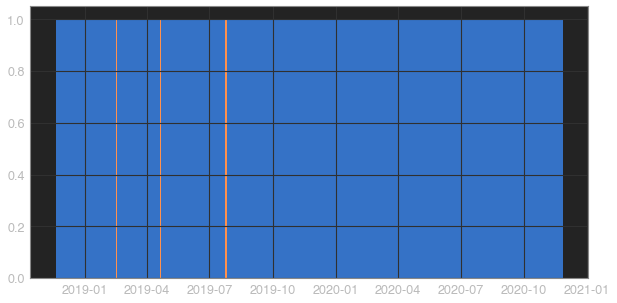

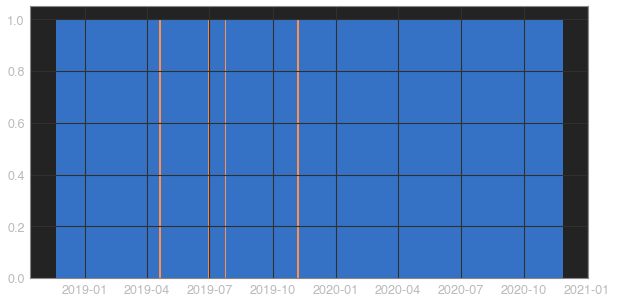

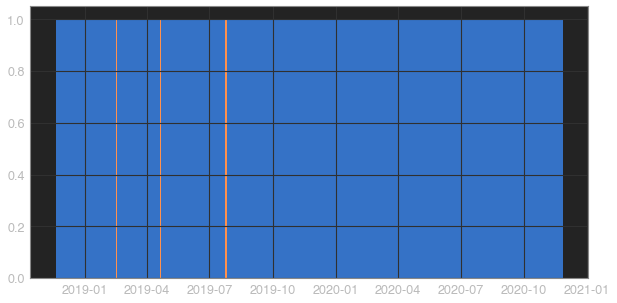

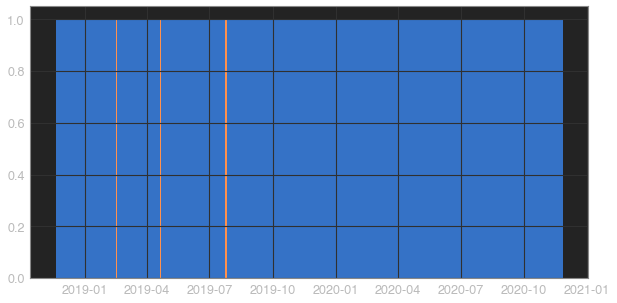

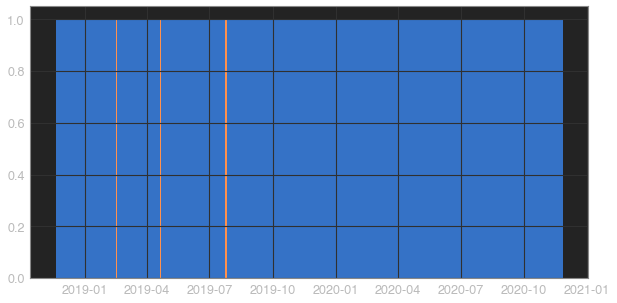

...

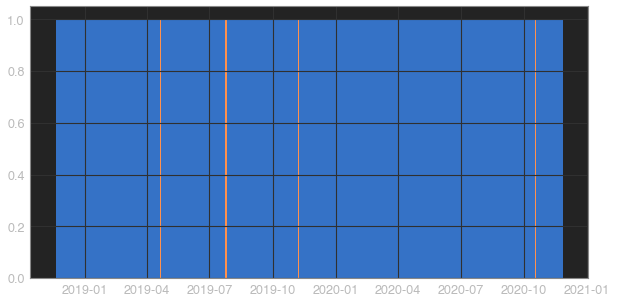

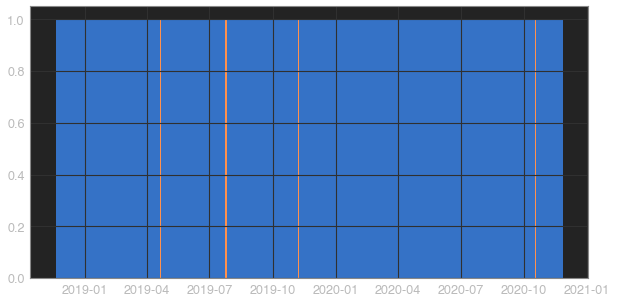

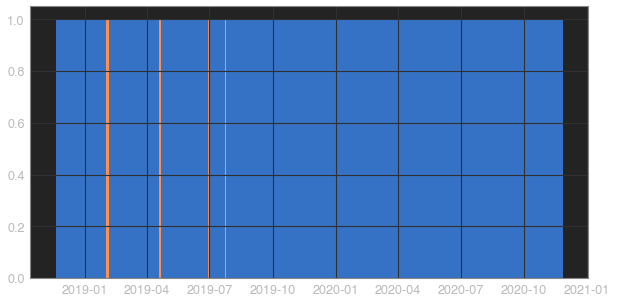

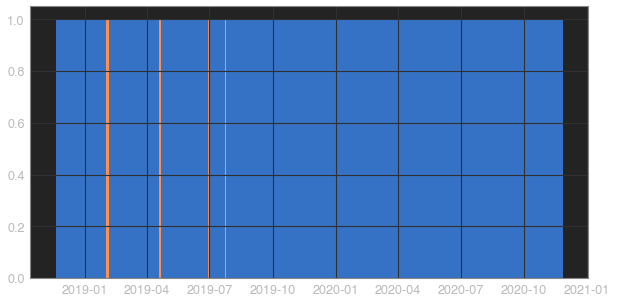

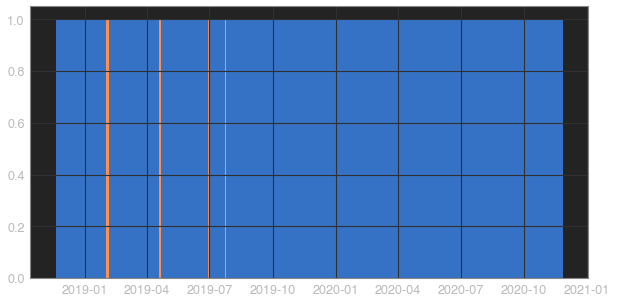

In [117]:
for acc in flagged_list_acc_next200:
    gaps_checking(acc)

In [179]:
def gaps_checking_and_interpolation(acc):
        dff_acc=df_[df_.AccountNumber==acc]
        meterIDs = dff_acc[dff_acc.AccountNumber == acc].MeterId.unique()
        acc_list=[]
        met_list=[]
        for x in meterIDs:
                dff_met=dff_acc[dff_acc.MeterId==x]
                dff_met.Usagedate = pd.to_datetime(dff_met.Usagedate)
                dff_met = dff_met.set_index('Usagedate')
                missing_met = dff_met.resample('D').min().notnull() 
                missing_met=missing_met['Value']
                #plt.figure(figsize=(20,10)) 
                #plt.bar(missing_met.index, np.ones(len(missing_met)), color = [['y','b'][idx] for idx in missing_met], width = 10)
                missing_met_df=pd.DataFrame({'Usagedate':missing_met.index, 'Value':missing_met.values})
                if (not(missing_met_df['Value'].all())):
                    ind_chg=missing_met_df.ne(missing_met_df.shift()).apply(lambda m: m.index[m].tolist())[1]
                    ind_chg.pop(0)
                    gap_startdate=[]
                    gap_enddate=[]
                    gap_duration=[]
                    gaps=(len(ind_chg)//2)
                    for i in range(0,len(ind_chg)-1,2):
                                    gap=missing_met_df[ind_chg[i]:ind_chg[i+1]]
                                    gap_startdate.append(gap['Usagedate'].iloc[0])
                                    gap_enddate.append(gap['Usagedate'].iloc[-1])
                                    gap_duration.append(ind_chg[i+1]-ind_chg[i])
                                    met_list.append(x)
                                    acc_list.append(acc)
                    gap_df=pd.DataFrame(list(zip(acc_list,met_list,gap_startdate, gap_enddate,gap_duration)),columns=['AccountNumber','MeterId','startdate','endadate','duration'])
                    #print(gap_df)
                    for y in gap_df['duration'].values:
                                    if y>=14:
                                        print('Notifying the customer')
                                        if x in flagged_list_next200:
                                                df_met=df_[df_.MeterId==x]
                                        #elif x in Toulist:
                                                #df_met=df_TOU_pivot[df_TOU_pivot.MeterId==x]
                                    else:
                                        dates_df=[]
                                        for h,k in  zip(gap_df['startdate'].values,gap_df['endadate'].values):
                                                    dates = pd.date_range(start=h, end=k).to_frame()
                                                    dates_df.append(dates)
                                        dates_df=pd.concat(dates_df)
                                        if x in flagged_list_next200:
                                                df_met=df_[df_.MeterId==x]
                                                df_met=pd.merge(df_met, dates_df, left_on='Usagedate', right_on=0,how='outer').sort_values(by=['Usagedate']).drop(columns=0)
                                                df_met['AccountNumber']=df_met['AccountNumber'].fillna(acc)
                                                df_met['MeterId']=df_met['MeterId'].fillna(x)
                                                df_met['Value']=df_met['Value'].interpolate(method="linear")
                                        #elif x in Toulist:
                                                #df_met=df_TOU_pivot[df_TOU_pivot.MeterId==x]
                                                #df_met=pd.merge(df_met, dates_df, left_on='Usagedate', right_on=0,how='outer').sort_values(by=['Usagedate']).drop(columns=0)
                                                #df_met['AccountNumber']=df_met['AccountNumber'].fillna(acc)
                                                #df_met['MeterId']=df_met['MeterId'].fillna(x)
                                                #df_met['off peak']=df_met['off peak'].interpolate(method="linear")
                                                #df_met['peak']=df_met['peak'].interpolate(method="linear")
                                                #df_met['shoulder']=df_met['shoulder'].interpolate(method="linear")
                                        
                                        
                else:
                    description=[]
                    description.append('no gaps')
                    met_list.append(x)
                    acc_list.append(acc)
                    gap_df=pd.DataFrame(list(zip(acc_list,met_list,description)),columns=['AccountNumber','MeterId','description'])
                    #print(gap_df)
                    if x in flagged_list_next200:
                            df_met=df_[df_.MeterId==x]
                    #elif x in Toulist:
                            #df_met=df_TOU_pivot[df_TOU_pivot.MeterId==x]
        return df_met

In [75]:
df_14318=gaps_checking_and_interpolation(14318)
df_14318

,Usagedate,Consumed,Value,AccountNumber,MeterId
0,2018-11-24,0.292,3.9250,14318.0,9501.0
1,2018-11-25,0.256,3.4370,14318.0,9501.0
2,2018-11-26,0.000,0.0001,14318.0,9501.0
3,2018-11-27,0.000,0.0040,14318.0,9501.0
4,2018-11-28,0.000,0.0010,14318.0,9501.0
...,...,...,...,...,...
723,2020-11-18,0.000,0.1230,14318.0,9501.0
724,2020-11-19,0.000,0.1150,14318.0,9501.0
725,2020-11-20,0.000,0.1150,14318.0,9501.0
726,2020-11-21,0.000,0.1190,14318.0,9501.0


In [76]:
filtered_df = df_14318.loc[(df_14318['Usagedate'] >= '2019-04-24')
                     & (df_14318['Usagedate'] <= '2019-04-25')]
filtered_df

,Usagedate,Consumed,Value,AccountNumber,MeterId
728,2019-04-24,NaN,1.752667,14318.0,9501.0
729,2019-04-25,NaN,3.495333,14318.0,9501.0


In [77]:
final_df_=[]
for f in flagged_list_acc:
    modified_df_=gaps_checking_and_interpolation(f)
    final_df_.append(modified_df_)
final_df_=pd.concat(final_df_)
final_df_

,Usagedate,Consumed,Value,AccountNumber,MeterId
1799300,2018-11-24,0.000,1343.537,15976.0,9872.0
1799301,2018-11-25,0.000,1267.451,15976.0,9872.0
1799302,2018-11-26,0.000,1497.265,15976.0,9872.0
1799303,2018-11-27,0.000,1450.309,15976.0,9872.0
1799304,2018-11-28,0.000,1475.071,15976.0,9872.0
...,...,...,...,...,...
723,2020-11-18,27.260,307.200,14510.0,9693.0
724,2020-11-19,25.229,284.320,14510.0,9693.0
725,2020-11-20,26.336,296.800,14510.0,9693.0
726,2020-11-21,19.833,223.680,14510.0,9693.0


In [170]:
meters=[]
z_after_interpolation=[]
for a in flagged_list:
    b=account_and_days_billcycle_mapes(a, final_df_)
    z_after_interpolation.append(b)
z_after_interpolation=pd.concat(z_after_interpolation)

Initial log joint probability = -36.9564
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       716.348    0.00010376       56.3022           1           1      119   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     155       716.386   0.000100729       77.6394   1.081e-06       0.001      233  LS failed, Hessian reset 
     199        716.39   5.94048e-07       86.1661      0.6618      0.6618      290   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     204       716.391   3.17271e-06        75.299   3.905e-08       0.001      334  LS failed, Hessian reset 
     233       716.391   6.39863e-09       89.1221      0.1815      0.1815      372   
Optimization terminated normally: 
  Convergence detected: absolute parameter change was below tolerance
Initial log joint probability = -37.9867
    Iter      log prob        ||dx||      ||grad||    

Initial log joint probability = -14.3639
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      79       1026.94    0.00150787        121.86   1.865e-05       0.001      126  LS failed, Hessian reset 
      99       1027.41   0.000110444       52.0509      0.8635      0.8635      151   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     120       1027.42   2.53743e-05        56.926   4.502e-07       0.001      226  LS failed, Hessian reset 
     146       1027.42   3.97232e-07        54.336   6.352e-09       0.001      308  LS failed, Hessian reset 
     151       1027.42   2.55676e-08       46.1939      0.2464      0.6099      318   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probability = -14.474
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      86       1042.47   0.000

Initial log joint probability = -27.5551
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      82        930.88     0.0017718       191.047   1.433e-05       0.001      132  LS failed, Hessian reset 
      99       939.254     0.0864036       238.547           1           1      151   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     107       941.222    0.00643023       74.8703   0.0001238       0.001      208  LS failed, Hessian reset 
     124       944.336    0.00179961       177.943   1.666e-05       0.001      259  LS failed, Hessian reset 
     140       946.159      0.001891        126.24   3.553e-05       0.001      307  LS failed, Hessian reset 
     199       953.843    0.00288063       62.1399           1           1      386   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     204       953.984   0.000650123       88.7423   1.007e-05   

Initial log joint probability = -34.8416
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       966.587    0.00102118       76.7921           1           1      114   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       966.679   0.000656526       71.2581       0.541       0.541      242   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     203       966.684   1.94184e-05       59.8225   2.967e-07       0.001      297  LS failed, Hessian reset 
     224       966.692   2.56771e-05       46.4444   4.073e-07       0.001      361  LS failed, Hessian reset 
     299       966.712   1.67766e-05       63.1389      0.3788      0.3788      459   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     338       966.713   1.11621e-06       67.8515   1.253e-08       0.001      545  LS failed, Hessian rese

In [171]:
z_after_interpolation

,mape_weekly,meterID,type
0,7.222600e+01,9872,flag
1,6.298400e+01,9872,flag
2,8.305000e+00,9872,unflag
3,6.212165e+08,9872,flag
0,2.018054e+04,9501,flag
1,3.373377e+03,9501,flag
2,4.366319e+04,9501,flag
3,1.357868e+05,9501,flag
0,1.934300e+01,9657,unflag
1,3.134600e+01,9657,unflag


In [172]:
flagged_meters_after_interpolation = z_after_interpolation[z_after_interpolation['type']=='flag']
flagged_meters_after_interpolation

,mape_weekly,meterID,type
0,7.222600e+01,9872,flag
1,6.298400e+01,9872,flag
3,6.212165e+08,9872,flag
0,2.018054e+04,9501,flag
1,3.373377e+03,9501,flag
2,4.366319e+04,9501,flag
3,1.357868e+05,9501,flag
3,5.782800e+01,9657,flag
0,2.062135e+03,9583,flag
1,9.951800e+01,9583,flag


In [173]:
flagged_list_after_interpolation=flagged_meters_after_interpolation['meterID'].unique()
flagged_list_after_interpolation

array([9872, 9501, 9657, 9583, 9662, 9693])

In [109]:
flagged_list_acc_next100

[14306,
 14321,
 14433,
 14359,
 14450,
 11225,
 14480,
 14469,
 14279,
 14328,
 14169,
 14326,
 11274,
 11209,
 14158,
 14159,
 16530,
 14441,
 16381]

In [110]:
final_df_next100 = []
for f in flagged_list_acc_next100:
    modified_df_=gaps_checking_and_interpolation(f)
    final_df_next100.append(modified_df_)
final_df_next100=pd.concat(final_df_next100)
final_df_next100

,Usagedate,Consumed,Value,AccountNumber,MeterId
0,2018-11-24,0.263,3.422,14306.0,9489.0
1,2018-11-25,0.234,3.035,14306.0,9489.0
2,2018-11-26,0.150,1.924,14306.0,9489.0
3,2018-11-27,0.207,2.636,14306.0,9489.0
4,2018-11-28,0.244,3.150,14306.0,9489.0
...,...,...,...,...,...
718,2020-11-18,0.391,2.545,16381.0,10279.0
719,2020-11-19,0.394,2.565,16381.0,10279.0
720,2020-11-20,0.424,2.756,16381.0,10279.0
721,2020-11-21,0.392,2.575,16381.0,10279.0


In [90]:
meters=[]
z_after_interpolation_next100=[]
for a in flagged_list_next100:
    b=account_and_days_billcycle_mapes(a, final_df_next100)
    z_after_interpolation_next100.append(b)
z_after_interpolation_next100=pd.concat(z_after_interpolation_next100)

Initial log joint probability = -9.90102
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1065.64   0.000265163       66.0448      0.7201      0.7201      123   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     166       1065.85   3.02007e-05       72.1263   4.704e-07       0.001      282  LS failed, Hessian reset 
     199       1065.92   0.000193848       66.3194      0.6433      0.6433      317   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     288       1066.02   4.94073e-08       66.7961      0.2231           1      429   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probability = -9.12974
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1080.98   0.000363899        87.644       1.623      0.46

Initial log joint probability = -31.6462
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       903.842    0.00303244       68.4826      0.1442           1      124   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       903.976   5.37003e-08       61.4684           1           1      264   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     201       903.976   4.60989e-08       82.7609      0.5919      0.5919      267   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probability = -30.121
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       913.269   3.51736e-05       54.7958           1           1      118   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     

Initial log joint probability = -55.0276
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      79       1129.96   0.000529751        102.33   2.885e-06       0.001      139  LS failed, Hessian reset 
      99       1132.32    0.00114135       65.8509           1           1      166   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1137.52    0.00332653       88.0452           1           1      287   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     218        1138.1    0.00223216       89.1244   3.163e-05       0.001      404  LS failed, Hessian reset 
     275       1138.49   0.000232893        84.004   2.647e-06       0.001      511  LS failed, Hessian reset 
     299       1138.51   6.32029e-06       70.9546      0.1623           1      544   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Note

Initial log joint probability = -10.3181
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1246.35     0.0010304       158.113      0.4305           1      139   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     156       1246.66   0.000435224       90.7802   8.829e-06       0.001      250  LS failed, Hessian reset 
     199       1246.88     0.0013178       55.9891      0.3924      0.8513      311   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     252       1248.52   0.000469699        100.43   2.621e-06       0.001      431  LS failed, Hessian reset 
     296       1248.87   0.000435502       118.197   4.804e-06       0.001      532  LS failed, Hessian reset 
     299       1248.88   0.000123234       55.9862           1           1      535   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Note

Initial log joint probability = -21.4495
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       999.915    0.00224097       61.0598      0.5742      0.5742      119   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     164       1000.61   0.000678145         74.63   1.021e-05       0.001      259  LS failed, Hessian reset 
     199       1000.67   0.000181252       61.2086           1           1      301   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     229       1000.67   2.00393e-08        46.025       0.291       0.291      341   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probability = -21.2231
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1014.89    0.00105339        50.102       1.856      0.18

Initial log joint probability = -18.5718
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       729.799   8.02209e-06       79.4159           1           1      132   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     147       729.802   9.36218e-09        78.639     0.05816           1      198   
Optimization terminated normally: 
  Convergence detected: absolute parameter change was below tolerance
Initial log joint probability = -17.975
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      92       734.427    7.3962e-05       77.7735   8.095e-07       0.001      147  LS failed, Hessian reset 
      99        734.43   1.28235e-05       81.7485      0.3507           1      158   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       734.513   2.70934e-07       76.1544           1           1

Initial log joint probability = -37.7953
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      92        1082.8    0.00163605       152.652   1.329e-05       0.001      151  LS failed, Hessian reset 
      99       1083.96    0.00723153       67.7363      0.7793      0.7793      158   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     172       1087.51   0.000667329       84.9495   7.857e-06       0.001      304  LS failed, Hessian reset 
     199       1089.15     0.0050964        97.835           1           1      335   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     281       1090.15   0.000425086       55.1846   7.117e-06       0.001      487  LS failed, Hessian reset 
     299        1090.2    0.00011411       56.6546      0.9469      0.9469      516   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Note

Initial log joint probability = -19.0038
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1211.16   0.000293725       48.8769      0.5867      0.5867      126   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     148       1211.25   2.77489e-05       58.2187   4.589e-07       0.001      245  LS failed, Hessian reset 
     199       1211.29   0.000176384        64.269           1           1      312   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1214.39   0.000181573       77.6029      0.6401      0.6401      433   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399        1214.4   1.07244e-06          64.2       1.899      0.1899      573   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     413        1214.4   8.06763e-09    

Initial log joint probability = -3.60123
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      70       1377.14    0.00134158       239.964   1.529e-05       0.001      123  LS failed, Hessian reset 
      99       1377.38   0.000320207       82.3112           1           1      159   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1378.79    0.00254317       103.742           1           1      274   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     201        1378.8   0.000319473       108.025   3.217e-06       0.001      309  LS failed, Hessian reset 
     246       1378.83   6.99135e-08       73.9289      0.2015      0.2015      369   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probability = -3.6065
    Iter      log prob        ||dx||      ||grad||    

Initial log joint probability = -4.85316
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      77        1247.2    0.00110699       58.5411   1.475e-05       0.001      142  LS failed, Hessian reset 
      99       1247.24   5.08418e-06        48.486       0.173           1      175   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     163        1247.3    0.00013436       67.6672   1.801e-06       0.001      299  LS failed, Hessian reset 
     199       1247.32   0.000113342       49.4938           1           1      348   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     271       1247.67   1.55812e-05       58.6452   3.077e-07       0.001      479  LS failed, Hessian reset 
     278       1247.67   2.76992e-07       47.5939   6.014e-09       0.001      521  LS failed, Hessian reset 
     280       1247.67   1.32215e-07       50.2704      0.2527   

In [91]:
z_after_interpolation_next100

,mape_weekly,meterID,type
0,75.243,9489,flag
1,24.666,9489,unflag
2,27.040,9489,unflag
3,69.929,9489,flag
0,158516.932,9504,flag
...,...,...,...
3,26.378,9624,unflag
0,4.030,10279,unflag
1,10.353,10279,unflag
2,17.254,10279,unflag


In [92]:
flagged_meters_after_interpolation_next100 = z_after_interpolation_next100[z_after_interpolation_next100['type']=='flag']
flagged_meters_after_interpolation_next100

,mape_weekly,meterID,type
0,75.243,9489,flag
3,69.929,9489,flag
0,158516.932,9504,flag
1,123718.684,9504,flag
2,231.824,9504,flag
3,249.636,9504,flag
1,51.241,9616,flag
0,231.600,9542,flag
1,211.621,9542,flag
2,183.499,9542,flag


In [93]:
flagged_list_after_interpolation_next100=flagged_meters_after_interpolation_next100['meterID'].unique()
flagged_list_after_interpolation_next100

array([ 9489,  9504,  9616,  9542,  9633,  6408,  9663,  9652,  9462,
        9511,  9352,  9509,  6457,  6392,  9341,  9342,  9624, 10279])

In [119]:
final_df_next200 = []
for f in flagged_list_acc_next200:
    modified_df_=gaps_checking_and_interpolation(f)
    final_df_next200.append(modified_df_)
final_df_next200=pd.concat(final_df_next200)
final_df_next200

,Usagedate,Consumed,Value,AccountNumber,MeterId
0,2018-11-24,0.697,4.762,15927.0,9837.0
1,2018-11-25,0.671,4.560,15927.0,9837.0
2,2018-11-26,0.897,6.072,15927.0,9837.0
3,2018-11-27,0.695,4.728,15927.0,9837.0
4,2018-11-28,0.772,5.267,15927.0,9837.0
...,...,...,...,...,...
717,2020-11-18,0.000,2.778,13988.0,9171.0
718,2020-11-19,0.000,1.374,13988.0,9171.0
719,2020-11-20,0.000,1.363,13988.0,9171.0
720,2020-11-21,0.000,1.269,13988.0,9171.0


In [120]:
meters=[]
z_after_interpolation_next200=[]
for a in flagged_list_next200:
    b=account_and_days_billcycle_mapes(a, final_df_next200)
    z_after_interpolation_next200.append(b)
z_after_interpolation_next200=pd.concat(z_after_interpolation_next200)

Initial log joint probability = -7.29422
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99        998.67   0.000705274       79.1716           1           1      124   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       998.717   2.93337e-05       42.4794       1.291      0.1291      259   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     245       998.719   1.90233e-06       74.6728   3.234e-08       0.001      362  LS failed, Hessian reset 
     263       998.719   6.46022e-10       47.7589    0.003736      0.3565      388   
Optimization terminated normally: 
  Convergence detected: absolute parameter change was below tolerance
Initial log joint probability = -7.1135
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      98       1006.97   2.08864e-05       49.2053   2.673e-07       0.001

Initial log joint probability = -17.4862
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1427.01      0.015411       171.138           1           1      120   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     165       1433.22   0.000379044       105.422   6.751e-06       0.001      231  LS failed, Hessian reset 
     199        1434.5    0.00207321       76.3724           1           1      272   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     225       1437.97    0.00030776         111.3   3.166e-06       0.001      334  LS failed, Hessian reset 
     299       1439.62    0.00318519       80.2658      0.4293      0.6901      431   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     300       1439.63    0.00150295       79.2102   1.872e-05       0.001      462  LS failed, Hessian rese

Initial log joint probability = -10.7492
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1000.75    0.00769621       97.6528         0.8         0.8      120   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1002.22   0.000181417        81.124      0.6426      0.6426      232   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     226       1002.26   5.17143e-05       88.1844   5.824e-07       0.001      319  LS failed, Hessian reset 
     299       1002.32   1.64904e-07       72.9625      0.3883      0.3883      407   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1002.35    1.4226e-06       76.7933      0.3364      0.3364      528   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     424       1002.35   2.74493e-08    

Initial log joint probability = -7.89677
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1096.45    0.00175768        76.066           1           1      135   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     104       1096.59     0.0020442       62.0571   2.973e-05       0.001      173  LS failed, Hessian reset 
     199       1097.26   0.000699035       67.6997      0.1993           1      294   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     219       1097.35   7.20062e-05       51.7383   1.164e-06       0.001      353  LS failed, Hessian reset 
     299       1097.41   1.79925e-05        76.838      0.4264      0.4264      453   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     323       1097.45   8.71353e-05       61.8554   1.737e-06       0.001      521  LS failed, Hessian rese

Initial log joint probability = -43.6657
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1071.46     0.0264413       155.248           1           1      127   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     128       1074.44    0.00122178       133.251   1.233e-05       0.001      202  LS failed, Hessian reset 
     177       1075.44    0.00116193       94.2818   2.141e-05       0.001      299  LS failed, Hessian reset 
     199       1075.69    0.00157542       48.8649           1           1      329   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1076.03   0.000137802       59.9755           1           1      475   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     379       1077.88   0.000745932       83.7358   7.811e-06       0.001      618  LS failed, Hessian rese

Initial log joint probability = -13.6538
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1008.31    0.00136496       62.7873           1           1      126   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     136       1008.34   2.65415e-05        63.132   4.801e-07       0.001      219  LS failed, Hessian reset 
     199       1008.41    0.00014545       69.2064           1           1      292   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     232       1008.41   6.31548e-08       57.1961      0.2171           1      338   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probability = -8.73032
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1049.65   0.000561022       71.5158           1          

Initial log joint probability = -15.9675
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       945.795     0.0227896       67.6411      0.4201           1      124   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       950.617    0.00222443       72.8096           1           1      255   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     289       950.701   7.38252e-08       45.5303      0.3989           1      395   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probability = -16.5426
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       963.867    0.00668373       70.5835      0.4262      0.4262      122   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
    

Initial log joint probability = -9.16461
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1000.42    0.00125012       65.3486           1           1      124   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1001.77   0.000514278       68.9078           1           1      252   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299        1002.2   9.36292e-05       53.5236           1           1      378   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1002.61   0.000486917       51.9638       3.234           1      506   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499        1002.7   6.03625e-05       81.0344           1           1      632   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -5.28542
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1159.29   0.000119382       82.1963           1           1      133   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1159.38   3.50305e-05       68.9334           1           1      256   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     278       1159.39   5.45841e-08        74.289       0.265           1      358   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probability = -5.29996
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1174.68   0.000181865       75.5745           1           1      126   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
    

Initial log joint probability = -14.0847
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       793.898   2.29707e-05       79.9171      0.0941           1      141   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     157       793.955   3.78566e-05       52.6553   5.247e-07       0.001      277  LS failed, Hessian reset 
     183       793.956   1.92278e-06       39.2316   2.851e-08       0.001      352  LS failed, Hessian reset 
     199       793.956   4.04765e-08       49.4801      0.2579           1      373   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probability = -14.1082
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       806.397   1.15619e-05       51.8234      0.3316      0.8924      140   
    Iter      log prob        ||dx||      ||grad||   

Initial log joint probability = -25.842
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       885.949   0.000293874       93.4725      0.2132       0.434      124   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     143       885.998   0.000169528       59.3072   1.909e-06       0.001      215  LS failed, Hessian reset 
     199       886.012   2.64504e-06       51.5646      0.1828           1      285   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     250       886.025   5.51306e-07       86.3486   8.075e-09       0.001      391  LS failed, Hessian reset 
     259       886.025   1.87514e-08       58.7331      0.1209      0.3078      402   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probability = -15.6503
    Iter      log prob        ||dx||      ||grad||    

Initial log joint probability = -25.4987
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       978.052     0.0340007       94.0982      0.6187      0.6187      113   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     169       980.019   0.000406602       97.1976   3.519e-06       0.001      242  LS failed, Hessian reset 
     199       980.053   1.57557e-05       79.0581      0.5163      0.5163      280   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     274       980.065   1.09719e-08       86.6892      0.1821      0.1821      378   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probability = -25.3594
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99        990.17     0.0190267       78.4279           1          

Initial log joint probability = -9.83524
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1097.02    0.00198059       86.2068           1           1      129   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1099.22   7.97824e-08       86.7344      0.2745           1      256   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     202       1099.22      6.19e-08       74.6383      0.2199           1      261   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probability = -11.1212
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      39       1099.97    0.00144342       102.049   2.017e-05       0.001       91  LS failed, Hessian reset 
      99       1100.27   3.59585e-05       85.9188      0.4683      0.46

Initial log joint probability = -10.4546
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      86       963.454    0.00144845       79.7108   1.925e-05       0.001      146  LS failed, Hessian reset 
      99        963.52   6.03955e-05       64.3537           1           1      166   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       963.937     0.0048378       52.8197       0.205           1      291   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     200       963.962    0.00186726       64.1872   3.535e-05       0.001      339  LS failed, Hessian reset 
     299       964.281     0.0013323       58.9235      0.1644           1      462   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     333       964.338   5.32852e-05       60.2965   9.209e-07       0.001      550  LS failed, Hessian rese

Initial log joint probability = -28.7049
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      93       1235.19   0.000672715       116.095   4.235e-06       0.001      159  LS failed, Hessian reset 
      99       1235.46    0.00380802       88.7174           1           1      165   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     123       1235.97   0.000521629       95.3045   5.502e-06       0.001      236  LS failed, Hessian reset 
     199       1236.05   4.36878e-08       84.5193      0.4362      0.4362      332   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     200       1236.05   2.62734e-08       82.5408     0.05433      0.8003      335   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probability = -20.7673
    Iter      log prob        ||dx||      ||grad||   

Initial log joint probability = -13.9475
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1061.96    0.00040987       72.3346      0.5839      0.5839      147   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1063.88   7.53719e-05       68.0225      0.3653           1      277   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     277        1063.9   3.20617e-06        66.795   4.733e-08       0.001      412  LS failed, Hessian reset 
     299        1063.9   6.83283e-06       73.5653      0.3982      0.3982      436   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     328        1063.9   6.40532e-08       61.3876           1           1      473   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probabil

Initial log joint probability = -44.3659
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       933.155    0.00285171       76.5875      0.2849      0.2849      123   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     169       936.111   0.000597752       97.1187   9.143e-06       0.001      236  LS failed, Hessian reset 
     199       936.273   7.37427e-05        62.867           1           1      274   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       936.312   2.31262e-05       75.4306      0.8981      0.8981      403   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     375       936.323   1.61343e-07       71.8943      0.7026      0.7026      498   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probabil

In [121]:
flagged_meters_after_interpolation_next200 = z_after_interpolation_next200[z_after_interpolation_next200['type']=='flag']
flagged_meters_after_interpolation_next200

,mape_weekly,meterID,type
2,86.483,9837,flag
0,171.879,7940,flag
1,184.149,7940,flag
2,174.096,7940,flag
3,170.605,7940,flag
2,50.595,9745,flag
3,63.403,9888,flag
3,114.360,12169,flag
2,126.946,12171,flag
0,245.379,6447,flag


In [131]:
dups_values_after_interpolation = flagged_meters_after_interpolation_next200.pivot_table(index=['meterID'], aggfunc='size')
print(dups_values_after_interpolation)

meterID
6359     1
6378     1
6397     4
6447     4
6530     1
6594     2
6600     1
7940     4
8788     3
8789     1
8791     4
8797     1
8817     1
8828     2
8833     1
8835     2
8951     2
8982     4
9171     3
9186     1
9187     2
9225     2
9745     1
9837     1
9888     1
11648    1
12169    1
12171    1
12467    1
12468    1
dtype: int64


In [122]:
flagged_list_after_interpolation_next200=flagged_meters_after_interpolation_next200['meterID'].unique()
flagged_list_after_interpolation_next200

array([ 9837,  7940,  9745,  9888, 12169, 12171,  6447, 12467, 12468,
       11648,  8835,  8797,  8833,  8828,  8951,  8982,  8789,  8788,
        8791,  8817,  9225,  6397,  6378,  6359,  6530,  6600,  6594,
        9187,  9186,  9171])

### Prediction after smoothing ONLY training data

In [98]:
#Main function for prediction.
from fbprophet.diagnostics import cross_validation
from fbprophet.diagnostics import performance_metrics
from datetime import datetime
def account_and_days_billcycle_mapes_smooth(met, data):
    meterID_df = pd.DataFrame()
    final=pd.DataFrame()
    overall_sum = 0 
    predict_list=[]
    predict_date_list=[]
    mape_list = []
    met_list=[]
    acc_list=[]
    matrix_df=pd.DataFrame()
    met_list.append(met)
    acc=meterIdtoAccountNumber(met)
    #acc=acc_met['AccountNumber'].iloc[0]
    acc_list.append(acc)
    meterID_df = data[data.MeterId == met]
    meterID_df = meterID_df.drop(['AccountNumber','MeterId','Consumed'],axis=1)
    final = meterID_df.reset_index()[['Usagedate','Value']].rename({'Usagedate':'ds','Value':'y'}, axis='columns')
    final=final[:len(final)-100]
    for i in range(0,28,7):
        train = final[:len(final)-(28-i)]#Train changes throughout the loops as we should increase 1week for every training session to get the  next week predictions.
        #To only smooth train data, do this ->
        train['y'] = mov_avg(train['y'])
        actual=final[len(train):len(train)+7]
        sum_actual=actual['y'].sum()
        test=pd.DataFrame()
        if  (len(train)>=365):
            p = Prophet(daily_seasonality = False, weekly_seasonality = True, yearly_seasonality = True, uncertainty_samples=0,seasonality_mode='multiplicative').add_seasonality(name='quarterly',period=365.4,fourier_order=5)
        else:
            p = Prophet(daily_seasonality = False, weekly_seasonality = True, yearly_seasonality = False,uncertainty_samples=0)
        p.add_country_holidays(country_name='AUS')
        p.fit(train)
        prediction = p.make_future_dataframe(periods=7 , freq='D')
        fore = p.predict(prediction)
        test['Predictions'] = fore['yhat']
        sum_predictions = test['Predictions'][-7:].sum()
        sum_predictions_final = sum_predictions 
        MAPE_val = mape_new(sum_actual, sum_predictions_final)
        MAPE_new = round(MAPE_val, 3)
        mape_list.append(MAPE_new)
        overall_sum = overall_sum + sum_predictions
    matrix_df['mape_weekly'] = mape_list
    matrix_df['meterID'] = met
    matrix_df['type']=['flag' if x>=50 else 'unflag' for x in matrix_df['mape_weekly']]
    return matrix_df

In [200]:
account_and_days_billcycle_mapes_smooth(9872, final_df_)

FINAL:             ds          y
580 2020-06-26  1391.2030
581 2020-06-27  1309.9690
582 2020-06-28  1321.4270
583 2020-06-29  1342.0440
584 2020-06-30  1403.8680
585 2020-07-01  1061.9720
586 2020-07-02  1022.4370
587 2020-07-03  1085.6700
588 2020-07-04  1110.2220
589 2020-07-05  1086.2630
590 2020-07-06  1049.0280
591 2020-07-07  1164.7160
592 2020-07-08  1113.0880
593 2020-07-09  1106.7310
594 2020-07-10  1070.5170
595 2020-07-11  1128.6980
596 2020-07-12  1094.6590
597 2020-07-13  1056.7810
598 2020-07-14  1077.1750
599 2020-07-15  1051.5380
600 2020-07-16  1109.0220
601 2020-07-17  1139.6000
602 2020-07-18  1105.7930
603 2020-07-19  1169.2220
604 2020-07-20  1039.7990
605 2020-07-21  1092.2740
606 2020-07-22  1100.3860
607 2020-07-23  1140.1340
608 2020-07-24  1160.5680
609 2020-07-25  1167.9830
610 2020-07-26  1166.3380
611 2020-07-27  1126.2890
612 2020-07-28  1053.0160
613 2020-07-29  1110.5440
614 2020-07-30  1136.5340
615 2020-07-31  1084.6490
616 2020-08-01  1116.6180
617 2

,mape_weekly,meterID,type
0,6.137200e+01,9872,flag
1,4.843300e+01,9872,unflag
2,1.510800e+01,9872,unflag
3,8.004948e+08,9872,flag


In [188]:
meters=[]
z_after_interpolation_and_smoothing=[]
for a in flagged_list:
    b=account_and_days_billcycle_mapes_smooth(a, final_df_)
    z_after_interpolation_and_smoothing.append(b)
z_after_interpolation_and_smoothing=pd.concat(z_after_interpolation_and_smoothing)

Initial log joint probability = -36.4772
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      92       951.059    0.00206327       147.632   1.578e-05       0.001      145  LS failed, Hessian reset 
      99       953.054     0.0125377       192.856      0.9941      0.9941      153   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       960.541   3.20135e-05       83.7786      0.2972           1      274   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     269       960.559   2.12748e-05       86.7101   2.487e-07       0.001      399  LS failed, Hessian reset 
     299        960.56    6.3193e-08       82.8322        1.13       0.113      440   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     300        960.56   1.91172e-08       82.3674      0.2345           1      442   
Optimization terminat

Initial log joint probability = -35.9371
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1741.84     0.0369567        3310.8      0.9685      0.9685      113   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       2244.42   0.000736949       3004.45           1           1      228   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       2332.97   0.000755806       2616.83           1           1      344   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       2437.45     0.0021974       5491.22       0.352           1      457   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       2463.26    0.00100132       525.655      0.9806      0.9806      566   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -34.5653
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       2147.31     0.0397572       16428.2      0.6873      0.6873      117   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       2469.95     0.0215515        5449.3      0.2155           1      231   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299        2658.2    0.00821052       3645.06      0.7335      0.7335      341   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399        2704.5    0.00852871       8701.47           1           1      458   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       2756.98   0.000271701       2745.04           1           1      570   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -33.6836
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1781.79      0.556862       21452.1      0.6765      0.6765      116   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       2687.67     0.0103106       4499.09           1           1      227   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       2795.41    0.00200758       4502.29       0.369           1      341   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       2835.98     0.0135095       5904.95           1           1      463   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       2897.82   0.000189894       1993.32           1           1      573   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -13.11
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1574.84     0.0137866       344.815       0.773       0.773      121   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1662.81    0.00407327       249.289           1           1      229   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299        1697.6    0.00689494       270.612       1.339      0.1339      350   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     306       1698.97   0.000500426       671.685   9.183e-07       0.001      406  LS failed, Hessian reset 
     381       1711.72   0.000113714       118.238   2.902e-07       0.001      530  LS failed, Hessian reset 
     399        1712.4    7.0062e-05       80.4627      0.2303      0.2303      553   
    Iter      log prob 

Initial log joint probability = -12.7772
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1915.07     0.0489388       1117.65       2.568      0.2568      114   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       2083.76     0.0402143       3455.53           1           1      227   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       2123.62     0.0916969       5866.45           1           1      340   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399        2198.1    0.00277828        893.96      0.4087      0.4087      448   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       2211.36    0.00490789       1293.23           1           1      553   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -12.2182
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       2112.25    0.00810203       1678.93           1           1      122   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       2305.26     0.0101266       657.736           1           1      227   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       2391.95     0.0776774       11433.7           1           1      335   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       2508.63      0.035886        8021.9           1           1      447   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       2618.05    0.00130665       2085.23           1           1      559   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -11.5981
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1873.36      0.216805       9610.92           1           1      115   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199        2527.2    0.00638073       3172.13           1           1      224   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       2618.68     0.0351226       6420.64           1           1      333   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       2656.97    0.00412149       2003.21           1           1      444   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       2687.61    0.00216751       815.312           1           1      552   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -26.8703
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1360.54      0.139232       733.254      0.4265      0.4265      115   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1415.46     0.0622767       513.339           1           1      227   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1487.03     0.0143354       338.826           1           1      340   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1518.42    0.00148622       226.667           1           1      449   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1555.07     0.0453419        690.62           1           1      561   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -24.7382
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1483.71     0.0724081       1109.19           1           1      115   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1669.79    0.00494775       430.774       0.432      0.9823      230   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1922.41     0.0298594       2016.68           1           1      337   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       2062.79     0.0118927       4437.37      0.4913      0.4913      454   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       2247.29     0.0114115       1866.41           1           1      563   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -22.993
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1626.89    0.00741527       683.402      0.4762      0.4762      118   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1996.13    0.00349973        2254.1           1           1      226   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       2163.36     0.0396035       13156.6           1           1      339   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       2439.09      0.018907       5507.04           1           1      450   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       2669.96    0.00317991       5398.41      0.4654      0.4654      563   
    Iter      log prob        ||dx||      ||grad||       alpha   

Initial log joint probability = -21.5082
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1743.06     0.0191813        462.69           1           1      121   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199        2008.4      0.013914       7988.67      0.2625      0.2625      228   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       2307.74     0.0385156          6355           1           1      340   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       2399.95     0.0175186       7479.85      0.2934           1      449   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       2759.47     0.0101551       5847.66      0.4601      0.9968      558   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -14.3405
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99        1315.5    0.00270908       227.421      0.4517      0.8366      120   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     188       1361.53     0.0011706       307.878   7.164e-06       0.001      269  LS failed, Hessian reset 
     199       1369.83    0.00267925       115.935           1           1      280   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1401.74    0.00182339       209.461           1           1      401   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1437.01    0.00276031       435.111      0.2453      0.2453      522   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     488       1449.98   0.000196506    

Initial log joint probability = -14.3507
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1483.52     0.0372109       362.418      0.6721      0.6721      114   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1628.88     0.0887462       1484.64           1           1      224   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1876.08     0.0192233       572.449           1           1      333   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1966.95    0.00222397       275.676           1           1      439   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       2143.23    0.00943877        1133.5           1           1      545   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -13.7848
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1651.39      0.047387       3154.38      0.4926           1      117   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1755.62     0.0317446       1191.11           1           1      231   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       2057.05    0.00526357       1121.22      0.9127      0.9127      342   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       2128.86    0.00116624       1893.17      0.6501      0.6501      448   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       2249.26     0.0117759        1629.3      0.9682      0.9682      559   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -11.5911
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1414.85     0.0178728        351.68           1           1      125   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1528.29     0.0418735       1409.62      0.7458      0.7458      240   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1595.45    0.00321886       289.065           1           1      354   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1660.74     0.0216469       3163.77        0.75        0.75      462   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1733.17    0.00383742       784.845      0.5068      0.5068      570   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -10.5216
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1463.48     0.0640887       162.036           1           1      120   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199        1575.7   0.000726993       607.806      0.3279     0.03279      237   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1751.21     0.0236863       1352.75           1           1      345   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1835.87    0.00371354       2061.71      0.2983      0.2983      453   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       2144.56     0.0143185       2103.19           1           1      559   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -10.1378
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1674.69    0.00209108       783.135      0.9113      0.9113      117   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1841.52     0.0105391        1620.3      0.9017      0.9017      227   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1996.47     0.0308756       2029.78           1           1      335   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       2084.23    0.00425455       918.094           1           1      440   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       2407.36    0.00197132       1327.14           1           1      550   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -10.0033
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1699.79     0.0123003       1452.81      0.8322      0.8322      118   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1880.79    0.00508464       395.879      0.6471      0.6471      227   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1951.43    0.00387565       850.768      0.2261      0.2261      335   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       2103.98     0.0198415       3329.13           1           1      442   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       2274.93     0.0109837       2168.41           1           1      549   
    Iter      log prob        ||dx||      ||grad||       alpha  

In [189]:
z_after_interpolation_and_smoothing

,mape_weekly,meterID,type
0,6.137200e+01,9872,flag
1,4.843300e+01,9872,unflag
2,1.510800e+01,9872,unflag
3,8.004948e+08,9872,flag
0,2.165921e+03,9501,flag
1,2.171790e+02,9501,flag
2,1.293175e+03,9501,flag
3,3.274109e+03,9501,flag
0,1.057500e+01,9657,unflag
1,1.168400e+01,9657,unflag


In [190]:
flagged_meters_after_interpolation_and_smoothing = z_after_interpolation_and_smoothing[z_after_interpolation_and_smoothing['type']=='flag']
flagged_meters_after_interpolation_and_smoothing

,mape_weekly,meterID,type
0,6.137200e+01,9872,flag
3,8.004948e+08,9872,flag
0,2.165921e+03,9501,flag
1,2.171790e+02,9501,flag
2,1.293175e+03,9501,flag
3,3.274109e+03,9501,flag
1,1.276540e+02,9583,flag
2,1.230630e+02,9583,flag
3,1.179550e+02,9583,flag


In [191]:
flagged_list_after_interpolation_and_smoothing=flagged_meters_after_interpolation_and_smoothing['meterID'].unique()
flagged_list_after_interpolation_and_smoothing

array([9872, 9501, 9583])

### ^Flagged meters reduced by 50% when predicted with smooth training data

In [99]:
meters=[]
z_after_interpolation_and_smoothing_next100=[]
for a in flagged_list_next100:
    b=account_and_days_billcycle_mapes_smooth(a, final_df_next100)
    z_after_interpolation_and_smoothing_next100.append(b)
z_after_interpolation_and_smoothing_next100=pd.concat(z_after_interpolation_and_smoothing_next100)

Initial log joint probability = -15.2819
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1529.35     0.0676042       317.585           1           1      120   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     179       1551.78   9.86493e-05       156.597   3.935e-07       0.001      245  LS failed, Hessian reset 
     199        1554.5     0.0147008       217.521           1           1      268   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1568.68   0.000887779       216.226      0.5508     0.05508      404   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     355       1576.77   0.000347063        452.84   1.345e-06       0.001      517  LS failed, Hessian reset 
     399       1581.02   0.000555925       212.327      0.3261     0.03261      570   
    Iter      log pro

Initial log joint probability = -16.8196
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1796.47      0.100508       1985.34           1           1      136   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1959.09     0.0177139       1062.85           1           1      249   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       2020.98    0.00918739       340.648           1           1      362   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399        2042.8     0.0584268       2670.22           1           1      489   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       2087.48      0.017455       3988.43           1           1      610   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -17.2054
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1755.03     0.0134637          1144           1           1      121   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1959.82    0.00610351       782.005           1           1      237   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       2061.63    0.00231493       1749.32           1           1      361   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       2100.23     0.0028206          1077           1           1      481   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       2128.46    0.00137309       1821.24      0.7462      0.7462      600   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -12.5211
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1343.69     0.0060135        168.82           1           1      124   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1354.68    0.00318099       114.539           1           1      234   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     214       1356.43   0.000462059       235.145   3.294e-06       0.001      289  LS failed, Hessian reset 
     299       1362.77    0.00887964       147.586      0.2751      0.7721      383   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1370.13   0.000588159       220.915      0.6148      0.6148      497   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1371.42   0.000737234    

Initial log joint probability = -18.0492
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1558.13     0.0615142       1484.59       0.277           1      115   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1634.61   0.000964345       214.647      0.5308      0.5308      226   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1651.18   0.000687105       232.887      0.9436     0.09436      352   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1658.95    0.00142385       146.705           1           1      471   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1663.99    0.00264277       161.024      0.9078      0.9078      585   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -17.8405
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1592.57     0.0456255       1309.69           1           1      116   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1695.51     0.0044883       192.424      0.3293           1      234   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1706.09    0.00217207       191.004       0.679       0.679      351   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     351       1711.34   0.000150079       179.359   3.123e-07       0.001      458  LS failed, Hessian reset 
     399       1717.17    0.00315621       99.5217           1           1      512   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1723.63     0.0004256    

Initial log joint probability = -10.5958
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1191.03     0.0407171        133.72      0.3436           1      122   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     139       1196.97    0.00201884       200.851   2.112e-05       0.001      204  LS failed, Hessian reset 
     199       1200.61    0.00616656       87.9966           1           1      280   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299        1210.2    0.00899981       107.629           1           1      397   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     301       1210.34    0.00166048       126.915   1.477e-05       0.001      433  LS failed, Hessian reset 
     399       1210.72   0.000386311       121.645      0.2575           1      559   
    Iter      log pro

Initial log joint probability = -9.84194
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      79       1226.12   0.000757873       127.526   4.045e-06       0.001      131  LS failed, Hessian reset 
      99        1231.4    0.00303754       124.182      0.9691      0.9691      156   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     130       1233.34   0.000795665       150.113   4.504e-06       0.001      232  LS failed, Hessian reset 
     199       1245.16     0.0459056       134.628           1           1      318   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     206       1247.56   0.000971239        183.31   8.529e-06       0.001      364  LS failed, Hessian reset 
     278       1257.53    0.00152152       195.728   1.037e-05       0.001      483  LS failed, Hessian reset 
     299       1258.75    0.00215654       113.255      0.2969   

Initial log joint probability = -9.58472
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1283.76    0.00426201       129.436      0.3083      0.3083      115   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1336.45     0.0325811       383.379           1           1      229   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1448.35     0.0042872       414.685           1           1      337   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1503.62     0.0144068       1267.59      0.8364      0.8364      442   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1583.24       0.19958       1726.57      0.4444           1      561   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -9.09039
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1383.01     0.0431357       649.841           1           1      122   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1526.98     0.0187623       902.023           1           1      231   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1603.64    0.00382341       196.355      0.4297      0.4297      340   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1650.29     0.0155669       1707.97           1           1      454   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1751.82     0.0133557        361.43      0.7326      0.7326      566   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -25.5812
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99        1801.9    0.00451688       172.658           1           1      119   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1816.73   0.000403563       78.5687           1           1      238   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     255       1829.15   0.000111074       194.931   4.374e-07       0.001      339  LS failed, Hessian reset 
     299       1837.04     0.0012316       90.5306           1           1      394   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     306       1837.35   0.000496219       332.143   2.977e-06       0.001      440  LS failed, Hessian reset 
     399       1845.81     0.0118584       398.029      0.3065      0.3065      558   
    Iter      log pro

Initial log joint probability = -20.6761
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1954.75     0.0440937       2251.25           1           1      122   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       2308.36    0.00209264       763.334      0.9089      0.9089      240   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       2326.01     0.0118893       1839.86           1           1      353   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399          2354   0.000250259       1154.79      0.2981      0.2981      466   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       2389.39     0.0011153       635.179           1           1      577   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -22.4127
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       2057.01     0.0016057       1638.98      0.8665      0.8665      116   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       2417.26    0.00279198       2535.13           1           1      231   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       2513.23   0.000449656       790.756           1           1      343   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       2566.82    0.00211415       4063.96           1           1      455   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       2625.13   0.000675744        1282.1           1           1      566   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -88.8447
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1422.49     0.0274203       2474.61           1           1      119   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1618.55     0.0291545       1454.02           1           1      234   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1687.42    0.00161939       772.628           1           1      346   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399        1761.6    0.00493098       2036.34      0.4614           1      463   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1788.63     0.0313717         789.1      0.4309      0.4309      582   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -86.4321
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1458.07       0.53627       1200.09           1           1      114   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199        1831.9     0.0272435       2023.19           1           1      226   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1916.51    0.00788026        2706.2           1           1      342   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       2076.98     0.0910805       6518.07           1           1      458   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       2172.12    0.00109489        1161.8           1           1      575   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -84.5264
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99        1556.4    0.00278409       857.523           1           1      117   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1942.63     0.0333161       4230.83           1           1      232   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       2107.96   0.000411943       1222.41           1           1      342   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399        2221.3     0.0341078       4598.75      0.3878           1      459   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       2340.64    0.00284632        2003.5           1           1      580   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -82.9568
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1753.58      0.127469       3029.99           1           1      121   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       2235.27    0.00306057       3412.21           1           1      240   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       2344.16    0.00312765       1526.34       1.837      0.1837      354   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       2481.54     0.0186458       2628.09           1           1      469   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       2523.47   0.000569933       4470.73      0.5613      0.5613      584   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -13.6034
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1303.96     0.0104185       190.289           1           1      124   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1334.96      0.388331       841.595           1           1      243   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1402.63     0.0317012       260.201           1           1      369   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1424.39      0.154863        744.77          10           1      489   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     488       1479.25    0.00016271       128.553   6.982e-07       0.001      625  LS failed, Hessian reset 
     499       1482.68    0.00903609    

Initial log joint probability = -12.8888
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1355.28    0.00400984        288.77      0.1976      0.1976      126   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1409.21      0.174161       630.049           1           1      242   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1536.64    0.00594805       503.551           1           1      350   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     353       1572.55   0.000903032       830.659   1.251e-06       0.001      444  LS failed, Hessian reset 
     399       1606.28    0.00753929       281.831           1           1      493   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1708.77     0.0109786    

Initial log joint probability = -13.0836
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1451.67     0.0518097         242.4      0.6718      0.6718      112   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1588.59    0.00372141       632.095           1           1      216   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1654.12     0.0301557       669.614           1           1      327   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1817.85     0.0077713       563.211           1           1      430   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       2008.07     0.0288892       2133.59      0.4508           1      542   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -12.8521
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1523.82     0.0089916       589.773      0.6526      0.6526      117   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1807.89     0.0019486       484.484      0.6464      0.6464      227   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1908.49      0.027366       794.615           1           1      331   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       2033.67   0.000685666       826.322           1           1      444   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       2076.88    0.00190202       1493.23           1           1      546   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -20.5322
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1629.32     0.0156148       434.831           1           1      119   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1720.54      0.002196       296.545           1           1      230   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1763.76    0.00867643        589.91           1           1      347   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1775.35    0.00265808       889.738      0.2537      0.2537      467   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1801.39    0.00312874       315.626           1           1      588   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -23.7328
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1859.97     0.0240429       4841.27           1           1      116   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1978.79     0.0674883       3729.49           1           1      227   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       2133.01     0.0488996       3096.34      0.9884      0.9884      352   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       2219.84   0.000989584       1976.11           1           1      468   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       2263.75    0.00226321       2404.69      0.4875      0.4875      588   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -24.9417
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1887.63      0.236988       5023.58      0.5676           1      118   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       2110.08     0.0321404       1877.74           1           1      229   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       2321.23     0.0856605        3112.9           1           1      346   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       2496.87      0.019645        7464.9           1           1      459   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       2566.43    0.00216251       1120.81           1           1      572   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -13.2733
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1114.63     0.0170901       131.026       0.175           1      116   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     197       1117.17    0.00199682       102.334   1.717e-05       0.001      272  LS failed, Hessian reset 
     199       1117.23   0.000523768       86.1905      0.9028      0.9028      274   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1121.64     0.0406225       180.052           1           1      385   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1155.29    0.00780754       185.753      0.2408      0.2408      499   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1177.66    0.00169474    

Initial log joint probability = -10.9424
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1359.78     0.0200203       134.917           1           1      123   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     112       1366.14    0.00107797       247.294   2.837e-06       0.001      169  LS failed, Hessian reset 
     199       1382.08    0.00413706       382.071      0.5918      0.5918      272   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1423.41     0.0126966       143.385           1           1      398   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     374       1438.39   0.000690253       189.813    1.86e-06       0.001      525  LS failed, Hessian reset 
     399       1449.72     0.0255445        423.73      0.5876           1      555   
    Iter      log pro

Initial log joint probability = -9.52483
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1399.65    0.00947839       192.091      0.9328      0.9328      116   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1424.14    0.00940011       395.464     0.05427      0.3929      233   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1623.83    0.00856712       441.329           1           1      348   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1751.78    0.00102367       445.219           1           1      458   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1874.18     0.0011159       882.974      0.2598           1      571   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -39.7115
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1257.24    0.00746823       175.903           1           1      131   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1259.17     0.0315414       213.222           1           1      248   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1295.78      0.112773       752.334           1           1      362   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1342.42     0.0198799       162.127           1           1      478   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1365.86     0.0440541       280.135           1           1      601   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -56.0463
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1424.48    0.00436209       87.5701           1           1      119   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1513.76     0.0394879       636.121      0.3052           1      244   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1549.84   0.000864025       154.815           1           1      367   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1562.01     0.0166411       293.941           1           1      487   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1573.94     0.0165548       323.283           1           1      606   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -53.9983
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1519.63      0.108747       682.385           1           1      127   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1677.73     0.0101625       638.996           1           1      247   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1726.64     0.0147711       396.078           1           1      368   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399        1864.8    0.00363229       710.023           1           1      488   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1942.43     0.0553096       5472.18      0.4006           1      602   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -15.9935
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1582.84     0.0142627       580.825      0.9709      0.9709      126   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1607.44     0.0205785       202.997           1           1      241   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1630.38    0.00159147       207.801      0.1493      0.4767      360   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1646.18     0.0840523       251.936           1           1      472   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1698.62    0.00392028       838.537      0.3789           1      580   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -16.0201
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1722.03     0.0687157       422.348           1           1      119   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1765.03    0.00369409       333.232      0.7469      0.7469      238   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1787.57    0.00220076       184.979           1           1      364   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1831.44    0.00747407        800.26           1           1      489   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1928.76     0.0154683       594.201           1           1      602   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -16.3048
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1838.48    0.00640094       215.866      0.1763      0.3642      117   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1893.49     0.0162278       705.867      0.3855      0.3855      242   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299        2169.7     0.0017711       1055.83           1           1      354   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       2283.71    0.00371097       9621.86      0.5629      0.5629      466   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       2358.66     0.0182555       1142.72           1           1      573   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -16.2121
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1931.88    0.00415399       421.442           1           1      123   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       2040.43     0.0225987       1142.61       2.078      0.2078      238   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       2155.48      0.014728       2939.11           1           1      348   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       2288.79    0.00306698       709.051           1           1      462   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       2363.67    0.00632595       2365.37           1           1      574   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -19.5325
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1391.29    0.00371722       113.331      0.5252      0.5252      120   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     191       1428.12    0.00227886        389.12   1.734e-05       0.001      264  LS failed, Hessian reset 
     199       1430.14    0.00684679       332.573           1           1      274   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1467.93      0.342189       1004.48           1           1      389   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399        1530.4    0.00747968       433.629           1           1      507   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     423        1533.7   0.000336211    

Initial log joint probability = -18.2916
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1456.49      0.011044       540.102      0.5038      0.5038      121   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199        1518.4      0.153177       578.879           1           1      235   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1590.39    0.00457496       482.706       0.332       0.332      359   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1640.53    0.00359064       249.767      0.9339      0.9339      478   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1767.52    0.00222847        495.97      0.9031      0.9031      586   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -18.7815
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1538.51     0.0113304       520.227           1           1      113   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1633.69      0.126686       894.336           1           1      221   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1722.44     0.0158193        901.39           1           1      335   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1764.35      0.186771          1846           1           1      445   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1877.37    0.00320224       440.005           1           1      552   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -18.46
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99        1687.3     0.0574853       812.774           1           1      112   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1808.13     0.0820659       1439.74           1           1      218   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1966.83     0.0593103       4470.98      0.4599      0.4599      327   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       2110.47    0.00874545       1241.05           1           1      439   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       2233.47    0.00308852       2427.18      0.7601      0.7601      546   
    Iter      log prob        ||dx||      ||grad||       alpha    

Initial log joint probability = -15.28
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      77       896.233     0.0158662       163.587   0.0001328       0.001      119  LS failed, Hessian reset 
      99       897.966    0.00548618       105.302      0.4113      0.4113      146   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     130       899.345    0.00244383       104.957   2.313e-05       0.001      214  LS failed, Hessian reset 
     199       899.649   0.000413494       102.092      0.6727      0.6727      297   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     249       903.298    0.00092192        74.616   9.644e-06       0.001      387  LS failed, Hessian reset 
     299        903.35   6.96409e-06       85.7316      0.6401      0.6401      447   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 

Initial log joint probability = -13.833
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1091.47     0.0631373       435.899           1           1      116   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1210.42     0.0408516       1032.46        0.39           1      226   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1411.05     0.0398807       2012.83           1           1      331   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1495.16   0.000866611       916.118      0.4858      0.4858      438   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1592.64    0.00515976       780.585           1           1      549   
    Iter      log prob        ||dx||      ||grad||       alpha   

Initial log joint probability = -13.435
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1142.63    0.00580827       169.943       1.887      0.1887      116   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1391.46     0.0896379       3545.48      0.1218           1      226   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1653.97    0.00835916       1420.21           1           1      339   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1722.83    0.00490188       975.202           1           1      447   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1968.55     0.0276161       3794.91           1           1      561   
    Iter      log prob        ||dx||      ||grad||       alpha   

Initial log joint probability = -42.9047
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1237.07     0.0867233       277.904           1           1      120   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199        1309.8     0.0224174       146.261           1           1      237   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     274       1321.61   0.000251118       127.017   1.069e-06       0.001      370  LS failed, Hessian reset 
     299       1323.05   0.000924228       105.119           1           1      400   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1336.64    0.00861303       187.201      0.3902           1      521   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1342.22   0.000504921    

Initial log joint probability = -42.3519
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1356.74    0.00780075       307.084       0.695       0.695      119   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1412.87     0.0013995       466.484      0.3567      0.3567      235   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1475.89     0.0150607        413.77      0.5656      0.5656      349   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1504.37    0.00795308       231.935      0.8509      0.8509      461   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499        1543.3     0.0146339       371.738           1           1      569   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -44.1596
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1469.42     0.0109693       366.012           1           1      115   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1572.33     0.0107207       445.142           1           1      228   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1626.48    0.00630167       195.274      0.6348      0.6348      344   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399        1677.8    0.00760018       444.683           1           1      459   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1731.78    0.00181625       419.725           1           1      574   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -45.3762
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1507.23     0.0088769       521.214           1           1      117   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199        1692.7      0.105274       3316.94           1           1      230   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1765.42    0.00906498       481.598      0.7805      0.7805      345   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1812.37     0.0157997       1466.28           1           1      452   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499        1877.4     0.0285318       5167.01      0.8576      0.8576      561   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -35.6662
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1193.33     0.0162895       129.013           1           1      124   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     180       1217.95   0.000332135       79.5965   4.307e-06       0.001      283  LS failed, Hessian reset 
     199       1219.12     0.0025078       81.6022       1.416           1      310   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1321.44    0.00262447       174.506           1           1      428   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1363.78     0.0997501       434.507      0.5793           1      540   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     401       1364.09   0.000378499    

Initial log joint probability = -33.5766
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1260.33      0.116453       1071.83           1           1      120   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199        1350.2    0.00165767       226.417       0.899       0.899      241   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1440.33     0.0144836       328.313           1           1      352   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1538.12      0.073452       1443.49      0.5701      0.5701      459   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499          1650    0.00148711       530.698       0.376           1      563   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -31.1913
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99        1351.3    0.00735526       183.592      0.2799           1      111   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1505.55     0.0301796       2359.02      0.5165           1      223   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299        1658.6     0.0391372       2237.81           1           1      334   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1801.35     0.0118832       749.158      0.5702      0.5702      444   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1861.58    0.00866043       932.727           1           1      557   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -30.4394
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99        1506.8       0.03811       1419.89           1           1      120   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1785.14      0.346069       3255.36           1           1      233   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1952.62     0.0176937       2728.12           1           1      344   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       2080.11     0.0028279       2872.87      0.5702      0.5702      451   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       2150.64    0.00631527       2115.66      0.1821       0.939      558   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -36.9269
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1696.17    0.00138187       189.054      0.8669      0.8669      119   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199        1709.6    0.00149233       118.426      0.8499      0.8499      240   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1722.42    0.00159198       102.554      0.3264           1      362   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1731.21    0.00300692       385.013     0.02847           1      493   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1767.42    0.00449011       343.992       2.727      0.2727      618   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -38.9945
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1925.67    0.00940764       513.419           1           1      131   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       2065.06     0.0315319       932.202           1           1      245   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       2105.33     0.0466877       2113.87           1           1      361   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       2190.81    0.00418596       1370.75           1           1      479   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       2238.29    0.00997812       1617.56           1           1      592   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -40.5375
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       2126.57     0.0084165       1711.63      0.3979           1      119   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199          2252     0.0111642       557.371           1           1      226   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       2329.22    0.00810144       1811.49           1           1      339   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       2364.26    0.00026525       563.728      0.3801           1      450   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       2399.21     0.0019358       670.102           1           1      565   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -41.0471
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99        2271.4    0.00867984       669.992      0.9502      0.9502      120   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       2395.41    0.00125476         440.4      0.8745      0.8745      237   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       2450.42     0.0173098       5549.36           1           1      348   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       2632.79     0.0151028       3993.62           1           1      463   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       2704.91     0.0132792       2019.29           1           1      575   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -18.5962
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1237.31      0.037942       532.782           1           1      120   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1296.33     0.0017763       308.419           1           1      245   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1340.08    0.00295325       236.816           1           1      356   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1356.43    0.00145167       184.545           1           1      483   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1366.89    0.00788014       213.506      0.3797           1      596   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -23.3297
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99          1438      0.086337       2215.76           1           1      125   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1527.65     0.0152161       715.461      0.2177      0.2177      236   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1567.56     0.0051162       1422.23      0.5417      0.5417      358   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1604.55     0.0182742       960.424       0.148      0.7151      482   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1618.41    0.00327901       1275.12      0.2288      0.2288      596   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -21.0459
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1517.27    0.00988912       1347.86           1           1      123   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1635.61     0.0006791       702.855      0.3323      0.3323      241   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1694.63    0.00704783       668.466      0.5836      0.5836      350   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1736.36    0.00469988       420.901      0.4472           1      466   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1765.13    0.00257872       1106.78      0.3256      0.3256      582   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -6.70714
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1637.45     0.0018019        234.96       0.709       0.709      126   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1689.58    0.00756149       534.801      0.8567      0.8567      247   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     268       1697.84   0.000311056       313.827   5.731e-07       0.001      361  LS failed, Hessian reset 
     299       1705.13    0.00468213       277.007           1           1      394   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1711.34   0.000878059       126.584           1           1      508   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1723.14    0.00186776    

Initial log joint probability = -4.43187
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       2114.12    0.00318774       519.699           1           1      113   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       2256.96    0.00616536       924.535           1           1      225   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299        2318.1     0.0201394        2575.5           1           1      332   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       2413.09     0.0200955       2783.05           1           1      441   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499        2450.3    0.00130812       2262.82           1           1      549   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -4.11071
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       2202.86    0.00477519       809.882       0.887       0.887      115   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       2301.52     0.0936371       1309.23           1           1      226   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       2442.58    0.00191716        1728.5           1           1      337   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399        2485.2    0.00532121       2245.52           1           1      445   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       2525.79    0.00452016       4245.13           1           1      551   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -11.3699
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1598.84    0.00464312       123.789      0.8242      0.8242      114   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1686.64     0.0059018       383.747           1           1      222   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299        1787.9    0.00213893       440.377      0.5771      0.5771      330   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1862.87     0.0272635       1699.88           1           1      439   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1908.91   0.000499924       355.078           1           1      547   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -9.38155
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1764.58     0.0130215       2432.81      0.8252      0.8252      118   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1936.88     0.0534224       4349.42           1           1      228   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       2153.99     0.0108526       2356.13           1           1      335   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       2343.52     0.0120245       7697.32           1           1      438   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       2471.51     0.0014681       4050.18           1           1      547   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -10.546
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1940.13      0.175646          4215           1           1      114   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       2183.55     0.0032902       3755.63        0.28        0.28      224   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       2427.75      0.002943       2583.04      0.6482      0.6482      332   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399        2602.3    0.00175055       3792.95      0.3906      0.3906      442   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       2760.45     0.0351472       13196.4           1           1      551   
    Iter      log prob        ||dx||      ||grad||       alpha   

Initial log joint probability = -12.4656
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       2100.74     0.0105924       1543.75           1           1      121   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       2394.07    0.00115677        1888.7      0.4349      0.4349      230   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299        2554.6    0.00301329       3294.67           1           1      337   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       2696.42    0.00399466       5365.25      0.2168      0.2168      446   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       2781.08    0.00206151       3297.19           1           1      551   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -3.48157
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1810.22     0.0346414       542.913       1.775      0.1775      120   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1972.99    0.00138249       1176.34      0.6066      0.6066      228   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       2059.36    0.00719731       1040.11           1           1      336   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       2148.07    0.00135317       663.456           1           1      444   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       2194.81     0.0218206       2523.21           1           1      550   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -3.34982
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1970.25     0.0795962       2153.74      0.6917      0.6917      116   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       2111.99    0.00339324       335.639      0.3589      0.9801      223   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299          2285      0.016282       3936.86      0.5279      0.5279      332   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       2471.46   0.000923948        3117.7      0.2358      0.2358      438   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       2520.11    0.00249042       2947.38           1           1      544   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -3.45912
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       2087.42     0.0320592        1805.9           1           1      118   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       2321.05     0.0157603       4486.32           1           1      224   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       2433.97      0.016979       2673.19           1           1      331   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       2576.75    0.00745504       3122.94      0.4871      0.4871      441   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       2763.71    0.00238957       9424.61      0.2549      0.2549      548   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -3.68029
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       2219.84     0.0545669       1848.67           1           1      116   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       2394.88     0.0192794       2513.58           1           1      228   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       2591.66    0.00586491       2929.01      0.9826      0.9826      341   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       2909.12    0.00403965       1698.19           1           1      449   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499        3052.7    0.00468335       3414.27      0.8264      0.8264      555   
    Iter      log prob        ||dx||      ||grad||       alpha  

In [100]:
z_after_interpolation_and_smoothing_next100

,mape_weekly,meterID,type
0,50.325,9489,flag
1,6.409,9489,unflag
2,5.509,9489,unflag
3,23.387,9489,unflag
0,459090.990,9504,flag
...,...,...,...
3,20.398,9624,unflag
0,8.702,10279,unflag
1,8.439,10279,unflag
2,8.003,10279,unflag


In [101]:
flagged_meters_after_interpolation_and_smoothing_next100 = z_after_interpolation_and_smoothing_next100[z_after_interpolation_and_smoothing_next100['type']=='flag']
flagged_meters_after_interpolation_and_smoothing_next100

,mape_weekly,meterID,type
0,50.325,9489,flag
0,459090.990,9504,flag
1,34619.475,9504,flag
2,68.115,9504,flag
3,171.434,9504,flag
0,203.975,9542,flag
1,103.641,9542,flag
2,54.833,9542,flag
0,763.696,9633,flag
1,818.495,9633,flag


In [102]:
flagged_list_after_interpolation_and_smoothing_next100=flagged_meters_after_interpolation_and_smoothing_next100['meterID'].unique()
flagged_list_after_interpolation_and_smoothing_next100

array([ 9489,  9504,  9542,  9633,  9663,  9652,  9462,  6457,  9341,
        9342, 10279])

### ^Flagged meters reduced by 38.88% when predicted with smooth training data

In [123]:
meters=[]
z_after_interpolation_and_smoothing_next200=[]
for a in flagged_list_next200:
    b=account_and_days_billcycle_mapes_smooth(a, final_df_next200)
    z_after_interpolation_and_smoothing_next200.append(b)
z_after_interpolation_and_smoothing_next200=pd.concat(z_after_interpolation_and_smoothing_next200)

Initial log joint probability = -3.47599
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1744.36     0.0379935       920.758      0.7401      0.7401      115   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1808.65     0.0225622        208.94           1           1      227   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1854.09      0.010512       885.483           1           1      338   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1901.79      0.066888       1442.27           1           1      444   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1934.69    0.00924415       678.276      0.4809      0.4809      555   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -3.15088
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1984.17   0.000809396       406.356           1           1      112   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199          2114    0.00631493       443.688           1           1      221   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299        2181.2     0.0118452       1483.05           1           1      329   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       2236.12   0.000565332       414.634           1           1      434   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       2317.59     0.0631996       5010.32           1           1      544   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -3.0279
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99        2180.8    0.00169379         384.2      0.6418      0.6418      116   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       2365.28     0.0317114       7397.96      0.2657      0.2657      226   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       2619.82     0.0110265       7422.62           1           1      341   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       2674.94   0.000151088       710.774           1           1      448   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       2718.34       0.01064       5795.93           1           1      554   
    Iter      log prob        ||dx||      ||grad||       alpha   

Initial log joint probability = -4.97262
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99        2343.1    0.00306653       2629.65      0.2325      0.2325      115   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       2386.68     0.0235213       1424.26           1           1      226   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       2497.24    0.00669786        2069.3           1           1      336   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       2528.55     0.0267319       3796.93           1           1      443   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       2571.81   0.000738528       2435.77           1           1      552   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -18.2447
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1606.38    0.00090524       132.228     0.08358           1      116   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     179       1626.83   0.000255995       208.311   1.134e-06       0.001      253  LS failed, Hessian reset 
     199       1627.95    0.00126962       119.241      0.7276      0.7276      276   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1642.93     0.0127737       117.636           1           1      401   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1681.11    0.00421095       183.713           1           1      516   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     473       1687.66   0.000143826    

Initial log joint probability = -17.5743
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99        1670.1     0.0211837       714.578      0.1426           1      117   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1708.57     0.0121708       827.351       0.779       0.779      226   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1749.53     0.0269528       567.732           1           1      339   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1776.46    0.00529481       438.799      0.3619           1      465   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1802.42      0.011655       469.232           1           1      581   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -16.99
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1697.66     0.0168055       271.494           1           1      117   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1762.45      0.058277        588.35           1           1      234   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1826.65     0.0681821       1300.66           1           1      347   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1881.53      0.022214       386.287           1           1      464   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1912.75    0.00126511       307.892           1           1      578   
    Iter      log prob        ||dx||      ||grad||       alpha    

Initial log joint probability = -16.4599
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1734.42     0.0245713       392.386      0.9184      0.9184      118   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1818.49     0.0505692        1844.1           1           1      227   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1886.86    0.00613522       897.545      0.3182     0.03182      342   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     324       1896.81   9.96725e-05       231.286   3.528e-07       0.001      414  LS failed, Hessian reset 
     399       1926.61    0.00339861       201.562           1           1      500   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1975.14    0.00892004    

Initial log joint probability = -4.87424
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1849.76    0.00930618       457.752           1           1      120   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1942.86     0.0127472       892.436       1.921      0.1921      235   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1997.99     0.0125758       2754.09           1           1      349   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       2036.03     0.0114192       499.716      0.8838      0.8838      462   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       2069.55    0.00146963       626.134           1           1      585   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -5.80008
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       2093.75      0.032136        2183.7           1           1      130   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       2319.58   0.000386701       723.211      0.8889      0.8889      242   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       2453.87     0.0115436       1832.81      0.8051      0.8051      360   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       2639.29      0.012291       11691.4      0.4201      0.4201      479   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       2686.54    0.00519338       1649.96           1           1      590   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -5.25906
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       2116.62     0.0546644       6256.98       0.488           1      123   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       2349.39     0.0696613       5151.15           1           1      233   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       2429.05    0.00046581       1721.87      0.3757      0.3757      347   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       2647.99      0.023015       4446.44           1           1      460   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       2815.57    0.00202786       2979.31           1           1      568   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -6.86835
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       2289.14     0.0410792       2011.21           1           1      118   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       2554.89    0.00124532       1037.06           1           1      228   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       2660.69    0.00278233       3430.24      0.8766      0.8766      343   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       2947.92    0.00573364       3862.91           1           1      463   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       3122.31    0.00345218       8890.78           1           1      578   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -7.52951
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1887.35     0.0788294        6942.6           1           1      120   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       2018.36       0.01847       1516.54           1           1      225   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       2079.89    0.00531625       404.878           1           1      332   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       2099.02   0.000309088       305.426      0.8001      0.8001      443   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499        2131.8     0.0233004       3090.61      0.5246           1      549   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -8.10456
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       2104.84      0.214443       3493.73           1           1      118   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       2323.41     0.0108259       1791.21           1           1      228   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       2460.57     0.0291346       7944.35      0.9473      0.9473      329   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       2659.67    0.00203562        2179.6           1           1      438   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       2692.46   0.000118625       1348.53      0.6217      0.6217      544   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -8.00887
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       2103.59       0.20126       7454.48           1           1      111   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       2332.22    0.00914907       2003.24           1           1      219   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       2498.19     0.0131087       4048.96           1           1      326   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       2582.03    0.00820465       1445.95           1           1      434   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       2631.62     0.0108445       5932.03           1           1      540   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -8.31071
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       2302.89    0.00121976       2302.92      0.8432      0.8432      121   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       2598.97    0.00195973       2132.82      0.9811      0.9811      232   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       2713.35     0.0162235       5515.06           1           1      336   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       2912.91    0.00876779       8613.38           1           1      443   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       3098.74    0.00244385       5595.47           1           1      548   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -5.58838
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1603.59    0.00140368       205.251      0.5788      0.5788      118   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1671.85     0.0165018       1000.16           1           1      232   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1751.63     0.0306183       682.712           1           1      340   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1787.46     0.0725043       554.191           1           1      451   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1814.29      0.024179       352.507           1           1      559   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -6.35698
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1809.64     0.0845304       3074.26           1           1      115   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       2044.85   0.000192242       510.124           1           1      221   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       2155.36    0.00172795       852.489      0.4945      0.4945      331   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       2236.06    0.00357915       6812.02       0.586       0.586      440   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       2402.88    0.00122823       1711.11           1           1      548   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -6.74297
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1930.47    0.00900933       659.889      0.8777      0.8777      117   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       2200.93    0.00995976       2260.96      0.8483      0.8483      229   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       2329.44   0.000816661       2309.02      0.5063      0.5063      340   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       2516.79    0.00340275       1857.78      0.8163      0.8163      448   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       2625.38    0.00253758       5362.47      0.4986           1      559   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -6.72856
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       2317.78     0.0568745         10824      0.8458      0.8458      114   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199        2557.2     0.0244685        3559.4           1           1      221   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       2758.13   0.000539016        2866.1           1           1      330   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399        2899.8     0.0022562       4931.98           1           1      436   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       3031.34    0.00748924       7241.84           1           1      544   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -5.65075
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1648.38      0.120202       1243.55           1           1      123   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1714.52     0.0369531       687.497           1           1      239   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1854.35     0.0112736       706.106           1           1      353   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1875.36    0.00225687       430.844           1           1      466   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1905.29    0.00324208       1204.29      0.9022      0.9022      574   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -5.21663
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1967.71     0.0110252       508.625      0.8774      0.8774      121   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       2203.93    0.00927509       983.528           1           1      232   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       2414.62    0.00294718       2866.17      0.1914           1      342   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       2541.43     0.0027543       1474.61      0.1952           1      452   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       2666.19    0.00824233       3114.89           1           1      557   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -10.2493
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       2030.78     0.0397041        1962.3           1           1      126   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       2274.79     0.0287459       1906.08           1           1      239   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       2396.84    0.00902564       1555.27           1           1      347   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       2499.63   0.000654934       5778.78      0.5625      0.5625      456   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499          2544    0.00468612       1842.06           1           1      568   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -35.43
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1156.48     0.0309282       374.678      0.3314           1      118   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1169.56    0.00308539        133.99           1           1      245   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     264        1177.2     0.0019168       162.694    1.29e-05       0.001      366  LS failed, Hessian reset 
     299       1177.65    0.00181902       76.9555           1           1      416   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     335       1179.69   0.000829257       152.997   4.371e-06       0.001      492  LS failed, Hessian reset 
     382       1181.54   0.000342628       77.7511   3.718e-06       0.001      577  LS failed, Hessian reset 

Initial log joint probability = -33.8183
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1209.61     0.0392314       370.441      0.2561           1      117   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     162        1222.2    0.00188119       96.7038   1.777e-05       0.001      228  LS failed, Hessian reset 
     199       1224.16   0.000275564       73.5704      0.3154           1      276   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1252.09      0.074225       623.893      0.1336           1      392   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1308.16     0.0496152       412.742           1           1      506   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     455       1316.86   0.000461878    

Initial log joint probability = -33.1297
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      86       1246.82    0.00132902       180.987   1.133e-05       0.001      136  LS failed, Hessian reset 
      99       1250.69    0.00393165       278.098      0.3719      0.3719      151   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1280.27     0.0111521       296.046      0.2146      0.2146      280   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1349.47     0.0133545       274.265           1           1      400   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1394.68    0.00731679       176.265           1           1      518   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1437.38    0.00507476    

Initial log joint probability = -32.7565
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1332.19     0.0238272       415.517      0.5603      0.5603      110   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1447.87    0.00377603       262.049           1           1      225   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1542.86    0.00200593       618.548      0.4143      0.4143      338   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1601.56      0.067436       874.593           1           1      451   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1635.46     0.0222444       1188.34      0.4339           1      560   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -27.0151
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1467.14    0.00684456       205.886           1           1      122   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1482.01    0.00564787       299.009      0.9383      0.9383      242   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     245        1483.6   0.000401807       206.486   3.384e-06       0.001      335  LS failed, Hessian reset 
     299       1484.33   0.000272844       86.7753      0.3714           1      398   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     321       1484.46   0.000155835        105.87   1.271e-06       0.001      468  LS failed, Hessian reset 
     399       1484.89   0.000982422       87.6964      0.8794      0.8794      552   
    Iter      log pro

Initial log joint probability = -27.2248
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1825.67     0.0153143       759.744      0.4794           1      121   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1870.66     0.0399584       1051.71      0.4512      0.4512      232   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1920.95     0.0126044       1053.84           1           1      341   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1956.54    0.00439936       609.264           1           1      451   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       2008.38      0.006273       4759.54           1           1      564   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -27.4706
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1887.85    0.00415385       451.343           1           1      123   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1969.44      0.221338       2126.55           1           1      234   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       2066.28     0.0035728       709.592           1           1      343   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399        2129.2     0.0047915       1673.81           1           1      449   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       2160.86    0.00121326       1603.68      0.2815      0.2815      559   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -17.3313
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1261.95     0.0356519       266.622      0.9772      0.9772      121   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1402.17     0.0110376        313.81           1           1      234   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1487.31    0.00446809       1143.96      0.5133      0.5133      349   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1566.72     0.0178546       679.322           1           1      462   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1647.84    0.00405073       338.222           1           1      580   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -13.2901
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1531.48     0.0393882       2084.75      0.8926      0.8926      112   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1815.76     0.0386887        4284.3           1           1      219   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1965.56     0.0253815       5312.05      0.4603           1      329   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399        2045.4   0.000920973       268.457           1           1      436   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       2389.92    0.00158428       2990.76           1           1      548   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -13.6535
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1649.41     0.0150992       998.333           1           1      113   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       2020.28     0.0213323       1979.72           1           1      224   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299        2211.8    0.00406098       1733.04           1           1      330   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       2407.88      0.007478       1934.07           1           1      443   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       2587.72    0.00717469       4905.41           1           1      554   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -11.067
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1260.03     0.0234239       165.956           1           1      124   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1287.01    0.00120112       82.0292      0.3274           1      249   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299        1293.5    0.00731314       108.665           1           1      368   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1315.58    0.00128703        84.881      0.5636      0.5636      492   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1384.64    0.00794877       185.683           1           1      603   
    Iter      log prob        ||dx||      ||grad||       alpha   

Initial log joint probability = -14.6301
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1453.51      0.015837       256.176           1           1      115   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1485.33     0.0183709        160.62           1           1      232   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1532.25    0.00457635       210.205           1           1      347   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399        1693.3    0.00854007       1046.49           1           1      462   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499        1798.9     0.0294585       1209.26           1           1      576   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -15.4533
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1578.76     0.0617273       728.453           1           1      118   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1609.23     0.0145148       415.606      0.4319      0.4319      233   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1651.88      0.010003        144.22           1           1      350   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1897.52    0.00402552        885.28           1           1      464   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499        2071.9    0.00336503       1040.76      0.4672           1      571   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -11.8641
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1453.02     0.0209668       654.285           1           1      109   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1505.96    0.00140046       260.186           1           1      211   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1551.11     0.0208889       1156.15           1           1      320   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399        1602.6    0.00715824       830.332           1           1      423   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1652.13    0.00522337        475.43       0.328           1      531   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -11.5408
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1512.25      0.111775       4323.02           1           1      109   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1657.86     0.0127057       1012.07           1           1      213   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1920.24     0.0426749       2795.49           1           1      321   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       2014.25   0.000841109       1891.31      0.6106      0.6106      428   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       2126.08    0.00439303        1972.3           1           1      537   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -11.4216
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1509.92     0.0089187        563.85           1           1      116   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1802.04     0.0231226       4339.32           1           1      222   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       2057.61    0.00341975       573.032      0.7932      0.7932      329   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       2265.75    0.00454293       6103.17      0.6299      0.6299      433   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       2466.78    0.00206403       2734.54      0.2906           1      548   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -11.4047
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1681.92       0.11134       2219.79      0.5326      0.9357      114   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       2069.98     0.0218675       4214.81           1           1      223   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       2368.76     0.0593153       13127.4           1           1      331   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       2582.51    0.00177035       2312.01           1           1      435   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       2720.12    0.00759979       3561.41      0.7603      0.7603      551   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -15.1333
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1956.69     0.0778495       1018.54           1           1      124   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       2048.04   0.000829703        1158.2      0.3299      0.3299      241   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       2091.36    0.00880207       1653.14           1           1      359   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       2100.39    0.00244403       1135.53           1           1      477   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       2110.92    0.00210332        144.27       1.276      0.1276      596   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -15.2765
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       2228.21     0.0747823       5220.37      0.3678           1      128   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       2463.31    0.00464846       2378.63           1           1      241   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       2682.23     0.0289527        6637.5           1           1      354   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       2817.82    0.00302608       1805.15           1           1      466   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       2841.81   0.000206207       1331.94      0.2913      0.2913      584   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -16.8314
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       2313.46     0.0919905       8501.74           1           1      125   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       2528.49    0.00258167       1253.18           1           1      237   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       2769.24     0.0122195       42398.2     0.07126           1      344   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       2972.55    0.00306178       960.371           1           1      463   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499        3061.4    0.00282967       2654.81           1           1      574   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -12.3911
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1307.16      0.002818       227.424      0.5966      0.5966      113   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     148       1321.76    0.00164809       272.618   1.539e-05       0.001      207  LS failed, Hessian reset 
     199       1353.77     0.0222664       574.681           1           1      269   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1428.06      0.160535       1410.28           1           1      374   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1547.49      0.156289        488.34           1           1      480   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1568.07    0.00171854    

Initial log joint probability = -12.6153
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1468.29    0.00915497       297.989           1           1      114   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1606.64     0.0494832       1148.03           1           1      227   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1695.85      0.026337       1992.89      0.9311      0.9311      336   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1753.22     0.0199661       1462.49      0.9065      0.9065      442   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499        1862.2      0.018643        1064.2           1           1      551   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -13.3141
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1532.19     0.0772854       1039.23           1           1      117   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1684.43     0.0468636       812.882           1           1      226   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1865.87     0.0273035       2314.79           1           1      337   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1992.49     0.0214576       1844.21           1           1      444   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       2159.85    0.00814322       1529.12      0.8193      0.8193      555   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -13.4726
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1551.78      0.022569       590.364           1           1      117   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1725.85    0.00626056       1333.75           1           1      228   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299        1854.6     0.0113807       484.091      0.9303      0.9303      336   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       2009.08     0.0167966       3623.19       0.972       0.972      445   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       2144.47    0.00109003       2443.56      0.4089      0.4089      552   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -11.8928
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1519.86    0.00976969       298.506           1           1      129   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1542.86      0.133541       326.795           1           1      247   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1573.31     0.0155861       126.136           1           1      362   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1587.79      0.249959        434.19           1           1      478   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1667.75     0.0480475       530.792           1           1      593   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -12.8081
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1763.02    0.00624639       1331.73      0.6637      0.6637      119   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1864.65      0.029568       783.142      0.3681      0.3681      225   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1980.34    0.00160808       1030.03      0.2668      0.2668      334   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       2198.79    0.00818147       2065.59      0.3454      0.3454      441   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       2420.41    0.00424964       7302.44      0.3824      0.3824      555   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -12.483
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1876.77    0.00578503       1338.18           1           1      116   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199        2078.7     0.0129546       836.623           1           1      223   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       2200.95     0.0123916       4241.45      0.2963      0.2963      335   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       2379.41     0.0128669       5890.65           1           1      442   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       2658.88    0.00121496        4465.1      0.4024      0.4024      554   
    Iter      log prob        ||dx||      ||grad||       alpha   

Initial log joint probability = -20.9458
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1378.99    0.00496679       68.1201           1           1      122   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     162       1389.76   0.000732965       270.268   3.932e-06       0.001      240  LS failed, Hessian reset 
     199       1392.55     0.0021197       139.404           1           1      285   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1403.21    0.00704031       132.895           1           1      404   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1414.02    0.00152829       97.3165           1           1      531   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1450.45     0.0842494    

Initial log joint probability = -23.4834
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1623.97    0.00245237       310.279      0.2796      0.2796      116   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1658.32    0.00086545       139.052       1.775      0.1775      244   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1675.37    0.00349833       180.371           1           1      367   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1694.22     0.0740576       457.426           1           1      487   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     403        1695.1   0.000188989       211.561     6.4e-07       0.001      528  LS failed, Hessian reset 
     499       1713.57      0.172088    

Initial log joint probability = -23.7144
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1752.28      0.190052        1308.2           1           1      121   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199        1772.2     0.0107712       476.377      0.9286      0.9286      241   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299        1813.1    0.00177929       198.183      0.7226      0.7226      359   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399        1839.5      0.244915       1526.16           1           1      479   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1930.99     0.0459378       603.992           1           1      589   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -39.3361
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1429.99    0.00695929        196.34      0.5379      0.5379      131   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     144       1435.91   0.000267262       100.548   1.398e-06       0.001      222  LS failed, Hessian reset 
     199       1437.89    0.00300319        68.313      0.1556           1      293   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     202       1437.92   0.000300422       128.016   3.652e-06       0.001      340  LS failed, Hessian reset 
     299       1438.55    0.00430828       93.3696           1           1      475   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     355       1445.98   0.000401592         148.7   1.254e-06       0.001      573  LS failed, Hessian rese

Initial log joint probability = -41.8424
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1890.19     0.0217845       917.439      0.9288      0.9288      116   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     166       1916.68   0.000170011       299.677   2.672e-07       0.001      250  LS failed, Hessian reset 
     199       1928.24     0.0254459       243.356           1           1      290   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1970.79     0.0505292       412.239           1           1      405   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       2036.38     0.0225716       914.788      0.6256      0.6256      517   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499        2109.1      0.023945    

Initial log joint probability = -39.9457
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       2017.54    0.00186297       167.014           1           1      121   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       2044.38   0.000519086       230.095      0.6926      0.6926      237   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       2115.52     0.0202809       337.185           1           1      350   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       2237.62    0.00266655       511.326           1           1      458   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       2308.57    0.00161945       370.812           1           1      579   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -39.8258
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1251.65    0.00971179       257.305     0.01438           1      133   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     111       1256.21    0.00325299       118.984   3.013e-05       0.001      181  LS failed, Hessian reset 
     142       1261.83   0.000808684       201.844   4.224e-06       0.001      249  LS failed, Hessian reset 
     199       1266.66     0.0170223       102.599           1           1      320   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     244       1271.42      0.005563        246.68   8.685e-05       0.001      405  LS failed, Hessian reset 
     299       1274.29      0.011956       122.009           1           1      480   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Note

Initial log joint probability = -39.2577
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1367.75    0.00229429       166.123           1           1      115   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1448.89     0.0044908       1328.87      0.6077      0.6077      221   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1518.77    0.00247209       227.809           1           1      329   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1539.58     0.0918323       532.654           1           1      445   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499        1617.2    0.00872514       760.563           1           1      559   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -38.8884
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99        1450.1    0.00928175       652.861      0.8122      0.8122      113   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1645.39    0.00810381       649.317           1           1      218   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1724.21     0.0483675       583.456           1           1      324   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1773.09     0.0187557        669.95           1           1      430   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1827.58    0.00295308       1040.33           1           1      543   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -14.558
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1314.72   1.11084e-05       65.5683       0.309       0.309      132   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     122       1314.94    0.00083281       97.8365   1.086e-05       0.001      198  LS failed, Hessian reset 
     189       1315.01   4.72611e-05       62.4634   8.416e-07       0.001      324  LS failed, Hessian reset 
     199       1315.02   2.91456e-05       70.8902       1.627      0.3797      338   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1315.67    0.00310072       150.078           1           1      464   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1426.53       1.14626       879.495           1           1      573   
    Iter      log prob

Initial log joint probability = -20.2328
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1444.63     0.0731875       349.827           1           1      111   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1580.19    0.00197788       308.576           1           1      218   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1645.64    0.00438265       416.611      0.8607      0.8607      326   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1758.41      0.106618       1631.35           1           1      431   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1836.23     0.0117923       999.781           1           1      540   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -20.8713
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1635.81     0.0096354       853.653           1           1      114   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1790.17     0.0277106       1894.63           1           1      220   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1892.62    0.00469425       680.604           1           1      329   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1994.19     0.0175202       1004.47      0.4822           1      450   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       2143.05     0.0512826       10009.7      0.4345           1      560   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -8.16102
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1260.58     0.0273109       215.023      0.9734      0.9734      127   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1288.17      0.046034       230.825           1           1      251   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     281       1300.14   0.000452652        120.67   2.546e-06       0.001      394  LS failed, Hessian reset 
     299       1301.42    0.00043941         126.2       0.442       0.442      414   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1307.06   0.000874769       147.634      0.3245      0.3245      546   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1311.12       0.14517    

Initial log joint probability = -7.48679
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1560.07     0.0314498       656.567           1           1      118   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1725.53     0.0874312       4565.45           1           1      226   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1836.29    0.00647148       752.679           1           1      335   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1947.94     0.0450741       2120.41           1           1      437   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499        1996.8   0.000612482        1220.7      0.5195      0.5195      549   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -9.37396
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1658.31    0.00904997       539.531      0.2184           1      120   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1868.79     0.0637496       1597.78           1           1      232   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1954.77    0.00562035       674.674           1           1      342   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       2073.31     0.0183549       1713.43           1           1      450   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499        2107.5     0.0174124       550.739           1           1      560   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -33.0741
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1745.16    0.00140006        197.59           1           1      125   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1746.08   0.000585732       119.385      0.6535      0.6535      239   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     230       1746.36   9.30193e-05       127.909   6.294e-07       0.001      321  LS failed, Hessian reset 
     299       1746.56   0.000501413         78.01           1           1      396   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     370        1746.6   1.35141e-05       106.046   1.435e-07       0.001      524  LS failed, Hessian reset 
     399        1746.6   5.22758e-08        93.825      0.4131      0.4131      556   
Optimization terminat

Initial log joint probability = -37.7379
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99        2039.8    0.00220078       254.909           1           1      118   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       2043.41   0.000601266       215.926        7.44       0.744      238   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       2044.28    0.00846524       116.791           1           1      360   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       2047.52    0.00224011       224.065           1           1      474   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       2114.54    0.00725694         178.7           1           1      590   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -35.4864
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       2100.84    0.00765667       264.131           1           1      125   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       2105.51    0.00170318       132.639           1           1      244   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       2110.02   0.000280179       219.243       0.485       0.485      364   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       2165.26     0.0135439       474.471           1           1      479   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499        2189.6     0.0036488       1363.65           1           1      591   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -5.67526
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1482.83    0.00669423       266.455      0.2242      0.2242      127   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1520.83     0.0079572       363.681           1           1      246   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1530.93    0.00173518       81.9588      0.3409           1      373   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399        1574.7      0.011238       457.263           1           1      485   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1604.26     0.0531522       2215.47           1           1      603   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -5.06184
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1951.11     0.0609322          2704           1           1      123   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       2011.73    0.00238004       1282.89      0.5715      0.5715      235   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       2086.53   0.000755395       1261.55      0.5498      0.5498      341   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       2125.61    0.00189125       1188.68           1           1      457   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499        2245.3     0.0476666       1387.48           1           1      570   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -5.50131
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       2252.96     0.0107345       2223.42           1           1      118   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       2470.55    0.00069375       1223.11           1           1      226   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       2518.57      0.018243       1601.85      0.7249      0.7249      339   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       2592.36   0.000811086       1040.47           1           1      457   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       2663.69    0.00806279       9056.14      0.5181           1      573   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -6.53021
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       2184.11      0.018096       884.124           1           1      115   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       2197.55     0.0053443       354.291           1           1      230   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299        2211.1    0.00092423       338.768           1           1      343   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399        2217.1     0.0135779       439.295           1           1      461   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     416       2217.74    3.6287e-05        179.64   1.004e-07       0.001      524  LS failed, Hessian reset 
     499       2219.73   3.94434e-05    

Initial log joint probability = -7.11215
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       2687.45     0.0109073       9262.49           1           1      120   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       3119.44   0.000655232        2659.8           1           1      229   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       3244.02    0.00322421       4510.15           1           1      342   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       3368.65   0.000950844       3849.57      0.3621      0.3621      452   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       3413.43    0.00174325       2899.29           1           1      567   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -7.43842
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       2762.55    0.00102616        2842.1      0.7002      0.7002      124   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       3354.96   0.000830051       17816.4           1           1      244   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       3508.15    0.00873432       20908.1           1           1      360   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       3532.43   0.000479741       1330.31      0.1679           1      481   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499        3548.9    0.00114579       4141.81           1           1      596   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -38.6896
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1225.81      0.026933       86.4071           1           1      122   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     169       1238.54   0.000480726       105.777   5.578e-06       0.001      239  LS failed, Hessian reset 
     199       1240.71    0.00843227       114.779           1           1      279   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     277       1251.55   0.000402416       95.9655   3.421e-06       0.001      423  LS failed, Hessian reset 
     299       1253.16   0.000501997       39.6452      0.1626           1      452   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1259.66     0.0295746        190.03      0.2927           1      584   
    Iter      log pro

Initial log joint probability = -37.8511
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1286.88     0.0180782       184.022           1           1      124   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1322.86      0.311586       434.743           1           1      241   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     221       1329.98   0.000453375        169.67    2.29e-06       0.001      311  LS failed, Hessian reset 
     299       1342.02      0.158512       386.275           1           1      401   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399        1393.3     0.0163432       432.739           1           1      525   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1409.92     0.0038894    

Initial log joint probability = -38.2661
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1311.01     0.0127646       458.009           1           1      120   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     119       1326.12   0.000932248       201.404   4.677e-06       0.001      180  LS failed, Hessian reset 
     199       1358.11      0.124933       231.465      0.6106           1      278   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1423.58     0.0100053       372.887           1           1      391   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1447.58    0.00744209       237.896           1           1      515   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1462.97    0.00158901    

Initial log joint probability = -38.3224
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1361.51       1.04581       1109.56           1           1      110   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1469.43     0.0112099       560.372           1           1      223   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     215        1480.7   0.000311184       231.928   6.375e-07       0.001      277  LS failed, Hessian reset 
     299       1543.35    0.00885097       608.836       0.415       0.415      378   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1616.52    0.00494732        338.23           1           1      500   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1646.11    0.00693997    

Initial log joint probability = -10.2849
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1538.95     0.0114373         208.2           1           1      120   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1568.25    0.00208242       345.002      0.3447      0.3447      231   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1639.38     0.0327529       308.603      0.7373      0.7373      342   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1717.46    0.00429543       191.581      0.7214      0.7214      452   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1732.89    0.00250716       329.137      0.2229      0.7792      564   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -12.1362
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1910.89    0.00177506       218.509      0.8007      0.8007      117   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       2074.54     0.0168284       1782.45           1           1      221   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       2278.34     0.0153372       956.374           1           1      327   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       2460.51     0.0129735       1966.11      0.2332           1      440   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       2535.09   0.000179463       1051.02           1           1      545   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -9.97436
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1977.47      0.017534       1532.17           1           1      122   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       2123.35      0.035662          2438           1           1      228   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       2249.09    0.00759853       1557.26           1           1      336   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       2387.68    0.00223017       2158.31           1           1      443   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       2465.22     0.0143074        811.16           1           1      554   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -11.0815
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99        1662.9     0.0636123       1396.09           1           1      117   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1726.48    0.00802187       278.508           1           1      222   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1761.19    0.00726345       418.015           1           1      345   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1779.78    0.00618467       214.646           1           1      452   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1811.33      0.010388       265.357           1           1      564   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -10.4467
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       2065.47     0.0211703       489.693           1           1      116   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       2245.13     0.0064893       2174.33      0.7027      0.7027      227   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       2342.99    0.00798849       857.124           1           1      331   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       2611.94    0.00389637       6422.56           1           1      440   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       2695.12     0.0114203       8578.64           1           1      547   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -8.17802
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       2203.46      0.002421       1168.11           1           1      113   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       2395.37    0.00632939       2293.41           1           1      220   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       2670.09      0.031339       11942.9      0.8231      0.8231      321   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       2825.38     0.0227117       11175.8           1           1      431   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       2924.22   0.000477444       1855.82      0.9073      0.9073      539   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -12.0398
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99          1703    0.00467041       179.497           1           1      118   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1781.31     0.0811197       2277.59           1           1      231   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1898.69      0.001311       607.824           1           1      341   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1971.87     0.0178801       781.933           1           1      455   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       2044.81    0.00395588       810.026           1           1      567   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -16.2819
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1941.76     0.0168773       494.003           1           1      120   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       2042.23     0.0223277       5209.38      0.1722           1      236   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       2209.87      0.276425       2635.75           1           1      344   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       2316.56      0.019296       2214.12           1           1      455   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       2404.72    0.00933724       1465.46           1           1      566   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -18.2033
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1991.74     0.0033955       447.119           1           1      115   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       2185.46    0.00565092       358.774           1           1      231   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       2390.56     0.0424059       794.325           1           1      347   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       2637.24   0.000138265       3750.67       0.165       0.165      461   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       2689.95      0.010387       5616.02           1           1      568   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -5.68653
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1500.73    0.00267049       267.784      0.1028           1      121   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1526.48     0.0881471       336.554           1           1      245   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1562.08     0.0144852        519.04           1           1      372   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1631.42     0.0240752       277.964           1           1      484   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499        1688.4   0.000552022       302.454      0.5491      0.5491      596   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -35.8661
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1998.44     0.0182804       591.275      0.8492      0.8492      122   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       2051.64     0.0088852       319.241           1           1      235   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       2108.19     0.0173502       1117.22           1           1      353   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399        2161.3    0.00455373       1357.39      0.4736      0.4736      462   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       2195.84     0.0108305        679.82           1           1      580   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -24.6293
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       2104.28    0.00535324       578.817      0.2473           1      126   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       2166.52       0.01765        3271.7      0.6458      0.6458      237   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       2337.83     0.0156898       7272.65           1           1      348   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       2402.42    0.00302578       804.212           1           1      458   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       2458.18     0.0582144       5333.35           1           1      565   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -28.0712
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1341.88    0.00674348       188.857      0.9471      0.9471      113   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     172       1365.19   0.000352018       107.444   1.641e-06       0.001      229  LS failed, Hessian reset 
     199       1366.94    0.00365815       100.849           1           1      262   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299          1408    0.00350839       134.512      0.3795           1      374   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1423.91    0.00675251       292.739      0.5339           1      495   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1581.99      0.062962    

Initial log joint probability = -35.3558
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1521.74    0.00747404       200.725           1           1      121   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     165       1562.22   0.000652146       388.425   1.134e-06       0.001      242  LS failed, Hessian reset 
     199       1575.97    0.00543476       79.7982           1           1      283   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1768.42       1.12166       2331.28           1           1      393   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1882.77    0.00770741       841.403           1           1      506   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1977.41     0.0182657    

Initial log joint probability = -35.7199
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1648.56    0.00783462       470.947      0.8934      0.8934      118   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1758.03     0.0824673       787.156           1           1      228   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       2012.13    0.00376481       531.545      0.3315      0.3315      340   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       2066.12    0.00800765       1815.29           1           1      455   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       2113.63    0.00211081       710.577           1           1      568   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -12.849
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1592.77    0.00208131       155.461      0.6536      0.6536      119   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1641.99      0.338622        866.46           1           1      233   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1736.24     0.0133032       487.567           1           1      339   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1777.85    0.00544831        315.67      0.7356           1      450   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1792.96     0.0149464       380.609           1           1      560   
    Iter      log prob        ||dx||      ||grad||       alpha   

Initial log joint probability = -12.4214
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1666.15     0.0707049       807.707      0.4967           1      123   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1756.78     0.0986939       2924.67           1           1      236   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1843.46    0.00147728       541.048           1           1      342   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1882.39    0.00244472       333.077           1           1      449   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1933.68     0.0321243       2107.27      0.3592           1      556   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -11.3915
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1710.11     0.0339955       1029.08           1           1      120   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1849.29     0.0092162       727.659           1           1      232   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299        1955.1    0.00679756       422.704           1           1      347   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       2008.94     0.0460605       2013.01          10           1      456   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       2067.77    0.00436096        1161.4           1           1      562   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -10.4853
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1783.66      0.158732        2002.8           1           1      123   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1998.11     0.0177396        2359.9      0.6471      0.6471      234   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299        2107.9    0.00330432       2045.42      0.2287           1      343   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       2201.77     0.0298683       4636.52       3.711      0.3711      454   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       2237.43    0.00116182       1745.44           1           1      562   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -13.1735
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1667.31     0.0958265       426.411           1           1      119   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1688.81    0.00818069       427.155           1           1      235   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1705.03     0.0357486       249.511      0.5944      0.5944      345   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1769.58     0.0141596       186.845      0.3076      0.3076      465   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1813.49    0.00719776       492.813      0.3659           1      579   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -14.0502
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       2069.34     0.0492718       2132.88           1           1      117   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       2149.69     0.0127056       1125.31      0.3461      0.3461      227   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       2344.17     0.0300468       3683.13           1           1      338   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       2486.32     0.0139774       2578.48      0.7637      0.7637      451   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       2639.45     0.0167859       2659.65           1           1      563   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -17.9089
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       2184.76    0.00191541       317.751           1           1      119   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       2337.83     0.0605196       3408.13           1           1      231   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       2513.89     0.0267714       1581.63           1           1      342   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       2667.46     0.0118543       2121.19           1           1      454   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       2753.96    0.00124851       1817.01           1           1      567   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -19.0978
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1469.39    0.00410519       279.559           1           1      115   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1570.26      0.012906       1457.99      0.3365      0.3365      223   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1615.33     0.0153915       606.993      0.4615      0.4615      332   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1643.63     0.0019153       459.511      0.5117      0.5117      448   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1695.59    0.00372158       676.717      0.5216      0.5216      560   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -24.5326
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1596.54     0.0120478          1102           1           1      113   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1742.36    0.00595552       1907.67      0.5841      0.5841      224   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1906.81     0.0503104       1963.78      0.7679      0.7679      335   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1982.41    0.00422968       644.363           1           1      450   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       2088.06    0.00205586       1042.21      0.4553      0.4553      560   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -29.4594
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1578.26    0.00722692       1215.24      0.3537           1      113   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1695.61    0.00985199       762.105      0.9717      0.9717      218   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1822.67     0.0232958       2523.88           1           1      332   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1938.69     0.0691341        2511.6           1           1      450   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       2029.31   0.000797054       526.305           1           1      560   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -30.361
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1567.95    0.00320704       329.715           1           1      110   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1865.45      0.063719        4208.3      0.7343      0.7343      219   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1943.86     0.0133928       1118.03           1           1      330   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       2002.35      0.015128       1847.06           1           1      446   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       2208.73   0.000471829       866.388           1           1      557   
    Iter      log prob        ||dx||      ||grad||       alpha   

In [124]:
flagged_meters_after_interpolation_and_smoothing_next200 = z_after_interpolation_and_smoothing_next200[z_after_interpolation_and_smoothing_next200['type']=='flag']
flagged_meters_after_interpolation_and_smoothing_next200

,mape_weekly,meterID,type
2,74.833,9837,flag
0,76.100,7940,flag
3,93.497,12169,flag
2,116.373,12171,flag
0,108.528,6447,flag
3,54.849,12467,flag
0,77.727,12468,flag
0,59.209,8828,flag
0,416.305,8982,flag
1,184.790,8982,flag


In [125]:
flagged_list_after_interpolation_and_smoothing_next200=flagged_meters_after_interpolation_and_smoothing_next200['meterID'].unique()
flagged_list_after_interpolation_and_smoothing_next200

array([ 9837,  7940, 12169, 12171,  6447, 12467, 12468,  8828,  8982,
        8788,  8791,  8817,  6397,  6378,  6359,  6530,  6600,  9186,
        9171])

### ^Flagged meters reduced by 38.70% when predicted with smooth training data 

### Function to predict, calculate MAPE and flag meters with MAPE > 50 for yearly seasonality turned off

In [133]:
#Main function for prediction.
from fbprophet.diagnostics import cross_validation
from fbprophet.diagnostics import performance_metrics
from datetime import datetime
def account_and_days_billcycle_mapes_new(met, data):
    meterID_df = pd.DataFrame()
    final=pd.DataFrame()
    overall_sum = 0 
    predict_list=[]
    predict_date_list=[]
    mape_list = []
    met_list=[]
    acc_list=[]
    matrix_df=pd.DataFrame()
    met_list.append(met)
    acc=meterIdtoAccountNumber(met)
    #acc=acc_met['AccountNumber'].iloc[0]
    acc_list.append(acc)
    meterID_df = data[data.MeterId == met]
    meterID_df = meterID_df.drop(['AccountNumber','MeterId','Consumed'],axis=1)
    final = meterID_df.reset_index()[['Usagedate','Value']].rename({'Usagedate':'ds','Value':'y'}, axis='columns')
    final=final[:len(final)-100]
    for i in range(0,28,7):
        train = final[:len(final)-(28-i)]#Train changes throughout the loops as we should increase 1week for every training session to get the  next week predictions.
        actual=final[len(train):len(train)+7]
        sum_actual=actual['y'].sum()
        test=pd.DataFrame()
        if  (len(train)>=365):
            p = Prophet(daily_seasonality = False, weekly_seasonality = True, yearly_seasonality = False, uncertainty_samples=0,seasonality_mode='multiplicative').add_seasonality(name='quarterly',period=365.4,fourier_order=5)
        else:
            p = Prophet(daily_seasonality = False, weekly_seasonality = True, yearly_seasonality = False,uncertainty_samples=0)
        p.add_country_holidays(country_name='AUS')
        p.fit(train)
        prediction = p.make_future_dataframe(periods=7 , freq='D')
        fore = p.predict(prediction)
        test['Predictions'] = fore['yhat']
        sum_predictions = test['Predictions'][-7:].sum()
        sum_predictions_final = sum_predictions 
        MAPE_val = mape_new(sum_actual, sum_predictions_final)
        MAPE_new = round(MAPE_val, 3)
        mape_list.append(MAPE_new)
        overall_sum = overall_sum + sum_predictions
    matrix_df['mape_weekly'] = mape_list
    matrix_df['meterID'] = met
    matrix_df['type']=['flag' if x>=50 else 'unflag' for x in matrix_df['mape_weekly']]
    return matrix_df

In [138]:
meters=[]
z_ysOff=[]
for a in more_than_year[:350]:
    b=account_and_days_billcycle_mapes_new(a, df_)
    z_ysOff.append(b)
z_ysOff = pd.concat(z_ysOff)

Initial log joint probability = -10.3928
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       921.645     0.0156451       101.409           1           1      122   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     181       924.587   9.76504e-05       66.8936   1.311e-06       0.001      263  LS failed, Hessian reset 
     199       924.594   1.28521e-05        69.335      0.1884           1      293   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       924.645   1.36781e-05       94.4725           1           1      417   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     304       924.648   3.63683e-05       65.4467   3.685e-07       0.001      460  LS failed, Hessian reset 
     328       924.649   1.85188e-08       43.0883     0.08292           1      496   
Optimization terminat

Initial log joint probability = -3.19811
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1706.11    0.00840657        116.75      0.4265           1      117   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     124       1706.51     0.0002653       199.956   2.175e-06       0.001      182  LS failed, Hessian reset 
     194       1706.61   1.60398e-07       76.4492      0.7916      0.7916      268   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probability = -8.87926
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1544.04    0.00290102       94.0697      0.7407      0.7407      117   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     188       1550.52   0.000330862        161.68   2.285e-06       0.0

Initial log joint probability = -8.78936
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1209.32    0.00120537       82.5481           1           1      120   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     192       1209.83   0.000279621       94.8584   2.756e-06       0.001      270  LS failed, Hessian reset 
     199       1209.87   9.39663e-05       90.3506      0.4751      0.4751      277   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     265       1209.98   8.78622e-08        76.549           1           1      359   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probability = -5.72007
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      68       1278.01   0.000166839       50.8807   2.561e-06       0.0

Initial log joint probability = -4.45081
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1363.31   0.000465519       53.5395     0.07035           1      122   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     134       1363.43   0.000118402       79.4974   1.771e-06       0.001      209  LS failed, Hessian reset 
     199       1363.45   5.70354e-06       76.6079       1.967      0.6246      296   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     251       1363.46   4.33258e-08       45.0137   8.082e-10       0.001      419  LS failed, Hessian reset 
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probability = -5.21999
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1380.93    0.00125327       121.6

Initial log joint probability = -6.75451
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1144.87    0.00100654       77.2583           1           1      120   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     189       1144.93   2.30476e-06       67.7071   3.024e-08       0.001      293  LS failed, Hessian reset 
     199       1144.93   9.87549e-08       61.2297           1           1      307   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     202       1144.93   2.32834e-08       57.3089      0.2078           1      312   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probability = -6.26867
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99        1157.7    0.00624097        82.903           1          

Initial log joint probability = -3.19397
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       2138.52     0.0122572       396.002           1           1      128   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       2144.25   0.000729522         397.1      0.3599           1      253   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     286       2149.04   4.79712e-05       157.597    2.39e-07       0.001      404  LS failed, Hessian reset 
     299       2149.37    0.00025445       168.483      0.3907        0.93      420   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       2151.26   0.000154217       166.126           1           1      540   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       2151.96   0.000713308    

Initial log joint probability = -39.6568
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       925.643      0.117716       78.5917       5.958      0.9885      124   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     148       932.384    0.00501741       165.828   6.751e-05       0.001      235  LS failed, Hessian reset 
     199       933.571   4.51334e-05       59.8468      0.2164      0.2164      320   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     252       934.834   0.000629406       95.7208   3.525e-06       0.001      441  LS failed, Hessian reset 
     298       935.266   0.000300682       47.0754   3.489e-06       0.001      538  LS failed, Hessian reset 
     299       935.268   8.52613e-05       50.7879           1           1      539   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Note

Initial log joint probability = -18.8069
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       874.275    0.00111715       92.7805      0.4098      0.4098      121   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       886.958     0.0170371       68.2441      0.5813      0.5813      233   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     277       887.621   3.09542e-05       85.1491   3.615e-07       0.001      412  LS failed, Hessian reset 
     299       887.665   4.41037e-05        71.923      0.8943      0.8943      437   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     353       887.669   3.40999e-08       67.6483      0.3543      0.3543      512   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probabil

Initial log joint probability = -30.278
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1180.03    0.00307761        111.97      0.6053      0.6053      128   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     176       1186.17   0.000449587       70.6591   6.196e-06       0.001      265  LS failed, Hessian reset 
     199       1186.51   0.000415388       52.4829       0.426       0.426      293   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     204       1186.52   6.06275e-05       47.3692   1.611e-06       0.001      374  LS failed, Hessian reset 
     218       1186.52   0.000125951       54.2644   1.893e-06       0.001      429  LS failed, Hessian reset 
     231       1186.53   8.65302e-06        30.997   1.278e-07       0.001      492  LS failed, Hessian reset 
     299       1186.78   0.000981602       86.8423      0.2258    

Initial log joint probability = -4.0215
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1254.89   2.12487e-05       68.4357           1           1      131   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     183       1254.95   4.97077e-07        64.478      0.6179      0.6179      242   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probability = -4.02199
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1270.81   2.67821e-08        62.319     0.09437      0.3723      142   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probability = -4.02136
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1286.81   4.85514e-05 

Initial log joint probability = -18.789
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1212.67     0.0109067       112.178           1           1      116   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     126        1215.7    0.00197034       204.775    1.76e-05       0.001      184  LS failed, Hessian reset 
     199       1216.75   9.83026e-05       93.5338           1           1      269   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1216.76   5.96019e-06       98.3402           1           1      388   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     315       1216.82   0.000263636       93.3596   2.669e-06       0.001      442  LS failed, Hessian reset 
     347       1216.84   9.37676e-08          77.2      0.3104           1      488   
Optimization terminate

Initial log joint probability = -5.22313
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1200.42    0.00123189        55.085      0.2221           1      124   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     100       1200.42   9.99885e-05       64.4792   1.815e-06       0.001      172  LS failed, Hessian reset 
     199       1200.53   1.40482e-06       63.0316           1           1      298   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     242       1200.54   1.14083e-05       78.8583   1.915e-07       0.001      397  LS failed, Hessian reset 
     273       1200.54   6.65605e-06       63.9153   9.688e-08       0.001      483  LS failed, Hessian reset 
     289       1200.54   4.75181e-08       58.3646      0.5991      0.5991      506   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is

Initial log joint probability = -9.78961
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1641.44   0.000678334       64.9697           1           1      132   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1643.02   3.63982e-05       68.3146      0.8327      0.8327      256   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     235       1643.65   0.000281395       141.858     1.6e-06       0.001      334  LS failed, Hessian reset 
     273       1643.91    0.00051684        116.63   5.246e-06       0.001      417  LS failed, Hessian reset 
     299       1643.93   6.91335e-06       61.3685      0.4875      0.4875      449   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     342       1643.93   1.84565e-05       69.3639   2.055e-07       0.001      534  LS failed, Hessian rese

Initial log joint probability = -15.9298
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       799.288    0.00170306       84.8787           1           1      119   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       810.928   0.000278014       91.4256     0.06544           1      238   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     266       811.022    3.9939e-06       102.005   4.657e-08       0.001      353  LS failed, Hessian reset 
     299       811.022   1.32193e-08       71.2039      0.4127      0.4127      394   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     303       811.022   2.34903e-08        83.419        0.73        0.73      399   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probabil

Initial log joint probability = -13.0878
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99        980.99    0.00018296       69.7842      0.4099           1      125   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     163       981.006   4.84887e-06       68.9375   6.811e-08       0.001      247  LS failed, Hessian reset 
     182       981.006    9.1171e-08       61.7506           1           1      275   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probability = -13.1009
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       981.825   8.76411e-05        73.443      0.4771      0.4771      124   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     122       982.017    0.00149361       99.3319   1.705e-05       0.0

Initial log joint probability = -7.39987
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       2659.21    0.00163317       300.017           1           1      133   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       2662.07   0.000162389       246.001           1           1      253   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299        2663.2    8.6802e-05       129.978      0.7828      0.2038      375   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     356       2663.42   0.000115895       276.402   1.039e-06       0.001      494  LS failed, Hessian reset 
     399       2663.55   1.17741e-05       59.5912           1           1      546   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     461       2663.73   2.61328e-05    

Initial log joint probability = -5.11647
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1371.67   0.000473666       109.396     0.02936           1      133   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     131       1372.06    0.00211953       274.315   1.818e-05       0.001      211  LS failed, Hessian reset 
     176       1372.35   5.14693e-05       93.4507   5.039e-07       0.001      295  LS failed, Hessian reset 
     199       1372.36   5.63362e-06       88.2247           1           1      321   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     248       1372.45   0.000296309       93.5583   2.906e-06       0.001      423  LS failed, Hessian reset 
     299       1372.47   5.53142e-06       66.3999      0.6773      0.6773      488   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Note

Initial log joint probability = -21.5472
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99          1309    0.00615305       191.076      0.9102      0.9102      121   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     135       1310.92     0.0012988       244.652   8.614e-06       0.001      202  LS failed, Hessian reset 
     199       1313.91     0.0128073       208.025           1           1      279   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1318.96     0.0023668       80.3512           1           1      405   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1319.21    0.00416042       106.095      0.1319           1      540   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     400       1319.24    0.00107577    

Initial log joint probability = -8.5067
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99        1181.5   0.000134667       82.7998           1           1      137   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     146       1181.52   4.01276e-08       64.6972     0.07166      0.3666      203   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probability = -9.41482
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1366.19     0.0120724       199.146           1           1      129   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     135       1369.86    0.00036906       94.8652    2.23e-06       0.001      210  LS failed, Hessian reset 
     199       1371.57    0.00029827       66.4066     0.02761           

Initial log joint probability = -3.10713
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1783.52   0.000195489       72.6483      0.3871           1      139   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1787.07    0.00181388       114.785           1           1      262   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1791.58    0.00164465       127.948           1           1      385   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     347       1792.21   0.000105454       99.6547   4.889e-07       0.001      483  LS failed, Hessian reset 
     399       1792.37   0.000875982       87.4593           1           1      549   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     411       1792.98   0.000206338    

Initial log joint probability = -6.23027
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1651.61    0.00612306       136.266      0.2207           1      128   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1658.15    0.00518326       191.372           1           1      252   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     204       1658.49   0.000356074       196.161   2.723e-06       0.001      298  LS failed, Hessian reset 
     299       1658.87   4.11522e-05       61.8546      0.9342      0.9342      433   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     305       1658.87   2.35768e-05       56.6691   3.717e-07       0.001      482  LS failed, Hessian reset 
     399       1658.97   8.97378e-05       68.3003      0.6188      0.6188      599   
    Iter      log pro

Initial log joint probability = -3.80993
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1424.85   0.000186756       105.178      0.3065           1      117   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1424.88   0.000106512       102.531       0.365           1      235   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     263       1424.89   1.09097e-07        92.698   1.179e-09       0.001      353  LS failed, Hessian reset 
     266       1424.89    3.6643e-08       85.2213      0.6401      0.6401      356   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probability = -3.84991
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99        1440.3   9.21681e-08       67.0638           1          

Initial log joint probability = -34.3611
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       918.252    0.00935386        83.451           1           1      118   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       923.748     0.0019586       71.2088           1           1      235   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     227         923.9    0.00029605        78.321   3.427e-06       0.001      317  LS failed, Hessian reset 
     299       924.004   0.000112259       84.3095       2.111      0.6807      406   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     344       924.007   1.11739e-07       76.8367      0.1283      0.7519      466   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probabil

Initial log joint probability = -35.2266
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      88       913.544   0.000120274       58.1867   2.871e-06       0.001      142  LS failed, Hessian reset 
      99       913.558   3.29845e-05       67.3976      0.5016      0.5016      154   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     133       913.607   2.33458e-05       50.2828   5.221e-07       0.001      246  LS failed, Hessian reset 
     195       913.627   7.09104e-05       88.4056   8.511e-07       0.001      375  LS failed, Hessian reset 
     199       913.629   1.33882e-05       59.5814           1           1      382   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     250        913.63    3.8139e-06       62.8754   5.257e-08       0.001      491  LS failed, Hessian reset 
     273        913.63   4.54154e-08       63.8605      0.2742   

Initial log joint probability = -45.3361
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1493.71     0.0162017       238.697           1           1      127   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1507.82   0.000986488       98.6825           1           1      260   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     237       1511.05   0.000421576        206.19   2.135e-06       0.001      339  LS failed, Hessian reset 
     299       1513.68   0.000119436       89.6504      0.8899      0.8899      408   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     332       1516.73    0.00875744       509.284   5.346e-05       0.001      488  LS failed, Hessian reset 
     399       1518.99   0.000400259       81.3319      0.7193      0.7193      579   
    Iter      log pro

Initial log joint probability = -13.0744
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1565.03    0.00692613       135.813           1           1      127   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     161       1571.85    0.00288362       147.656   2.275e-05       0.001      241  LS failed, Hessian reset 
     199       1574.76    0.00287736       98.4155      0.3108           1      288   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1576.91   0.000701664        86.101           1           1      410   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     310       1577.83   0.000724123       328.093   3.333e-06       0.001      485  LS failed, Hessian reset 
     359       1578.92    0.00052553       122.752   5.989e-06       0.001      577  LS failed, Hessian rese

Initial log joint probability = -21.7467
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       772.014   1.10695e-05       96.2497      0.3851           1      123   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       772.554   0.000573787       94.7068      0.2184        0.95      239   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       780.116   4.94383e-05       104.954      0.3766           1      358   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       780.342   9.22793e-05       87.8094      0.5383      0.5383      476   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     468       780.374   2.03216e-08       77.3632      0.3416           1      558   
Optimization terminated normally: 
  Convergence detected: relat

Initial log joint probability = -5.05961
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1209.37   1.00498e-05       71.4672      0.5162      0.5162      130   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1209.66   8.33444e-05       85.9276           1           1      261   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     237        1209.8   0.000444975       80.3079    7.76e-06       0.001      348  LS failed, Hessian reset 
     299       1209.88   6.36649e-07       80.0997      0.2249      0.9546      423   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     307       1209.88    4.8656e-08       77.7125     0.04308           1      435   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probabil

Initial log joint probability = -3.49967
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       2026.72     0.0762559       1209.63           1           1      123   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       2041.43     0.0111283       592.738           1           1      239   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       2044.18    0.00152514       155.838      0.4627           1      362   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     357       2044.75    4.5768e-05       124.857   4.589e-07       0.001      480  LS failed, Hessian reset 
     399       2045.11    9.3781e-05       56.7831           1           1      535   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       2045.61   5.07253e-05    

Initial log joint probability = -2.08423
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       2523.95    0.00392413       429.642           1           1      119   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199          2527   0.000436557       157.732      0.4503      0.4503      242   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       2528.49   0.000136674       239.382       0.931       0.931      371   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     339       2528.71   1.42623e-05       171.382    8.29e-08       0.001      472  LS failed, Hessian reset 
     399       2528.91    0.00325836       134.418           1           1      548   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       2529.65   0.000334768    

Initial log joint probability = -4.9544
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      79       1181.11   2.97143e-05       77.0114   4.161e-07       0.001      147  LS failed, Hessian reset 
      99       1181.11   1.91789e-06       68.3588           1           1      174   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     190       1181.11   6.57068e-08       69.5827      0.2518           1      313   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probability = -4.95146
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      33       1198.16    0.00105699       124.711    1.36e-05       0.001       84  LS failed, Hessian reset 
      78       1198.28   0.000172385       60.3227   2.225e-06       0.001      187  LS failed, Hessian reset 
      99       1198.29    9.59

Initial log joint probability = -7.31038
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1164.42    0.00414522       66.4166       1.841      0.1841      128   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     178       1165.38    0.00163906       192.666   1.928e-05       0.001      285  LS failed, Hessian reset 
     199        1165.6   0.000122669       78.2013      0.5056      0.5056      309   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     260       1165.66   1.23606e-07       64.2065       0.271           1      391   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probability = -7.27674
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1180.87   0.000159019       69.3374       1.102       0.2

Initial log joint probability = -5.44458
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1200.85   4.02694e-05       68.9024           1           1      144   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     180       1200.87   8.21768e-08       69.9622           1           1      254   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probability = -4.70944
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1180.74   5.96626e-05       76.9155      0.4827      0.4827      133   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     126       1180.75   1.61214e-07       56.4408           1           1      178   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below 

Initial log joint probability = -5.60521
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1076.38    0.00016873       114.666      0.9402      0.9402      129   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     105        1076.4   0.000235274       104.898   2.532e-06       0.001      175  LS failed, Hessian reset 
     179       1076.42    1.6437e-06       95.8113    2.14e-08       0.001      307  LS failed, Hessian reset 
     198       1076.42     2.135e-08       75.8087      0.3292      0.3292      331   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probability = -5.58429
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1092.41   6.12282e-05       53.6205      0.9695      0.9695      129   
    Iter      log prob        ||dx||      ||grad||   

Initial log joint probability = -3.2942
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1379.46   3.33551e-05       72.2608           1           1      132   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     127       1379.77    0.00051474       79.0379   6.624e-06       0.001      206  LS failed, Hessian reset 
     199       1379.94   4.92307e-06        62.964       2.251      0.6945      298   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     227       1379.94    1.7825e-06       59.7602   3.055e-08       0.001      369  LS failed, Hessian reset 
     292       1379.94   8.00705e-06       63.1438    1.25e-07       0.001      488  LS failed, Hessian reset 
     299       1379.94   6.23207e-07       45.0396      0.1081           1      498   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes

Initial log joint probability = -5.26298
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      98       1141.65   0.000120364       86.5021   1.159e-06       0.001      158  LS failed, Hessian reset 
      99       1141.65     4.264e-05       73.6654           1           1      159   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     196       1141.67   3.75035e-05       98.9835    5.14e-07       0.001      322  LS failed, Hessian reset 
     199       1141.67   8.85539e-06       58.1334       0.745       0.745      325   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     279       1141.68    3.9813e-07       85.2406        0.84        0.84      419   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probability = -5.25844
    Iter      log prob        ||dx||      ||grad||   

Initial log joint probability = -28.7329
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       900.408   0.000294542       83.6885           1           1      132   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     111       900.468   0.000281452       73.9657   3.066e-06       0.001      179  LS failed, Hessian reset 
     146       900.478   3.05031e-08       67.2256      0.3301           1      232   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probability = -6.18651
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1163.51   1.17618e-05       95.2758           1           1      121   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     118       1163.51   1.49821e-05       100.806    1.55e-07       0.0

Initial log joint probability = -27.5829
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       780.595   0.000898129       61.8482           1           1      126   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     118       780.653   0.000476029       66.6931   1.066e-05       0.001      195  LS failed, Hessian reset 
     186       780.793   5.91359e-05       95.0139   6.252e-07       0.001      307  LS failed, Hessian reset 
     199       780.801    7.0164e-06       93.9571      0.2386           1      324   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       780.811   1.36543e-06       83.7255           1           1      455   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     357       780.812   2.04114e-07       93.5881   2.137e-09       0.001      574  LS failed, Hessian rese

Initial log joint probability = -7.81443
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1497.76    0.00603956        126.87      0.7282      0.7282      128   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1501.56    0.00152824       66.7356           1           1      253   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     235       1501.66    9.2943e-09       48.9241     0.06525     0.06525      320   
Optimization terminated normally: 
  Convergence detected: absolute parameter change was below tolerance
Initial log joint probability = -6.68688
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1513.33    0.00390523       77.4081           1           1      130   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     

Initial log joint probability = -4.17802
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1536.81    0.00013655       63.5915      0.2348           1      135   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     114       1536.89   0.000195883       104.261   2.525e-06       0.001      195  LS failed, Hessian reset 
     191       1536.92   4.69443e-05       72.2862   7.231e-07       0.001      334  LS failed, Hessian reset 
     199       1536.92   2.07892e-06       56.6698      0.2153      0.2153      344   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     212       1536.92   4.97533e-08       52.4257      0.5821      0.5821      369   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probability = -4.23633
    Iter      log prob        ||dx||      ||grad||   

Initial log joint probability = -41.4825
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       940.151   8.28046e-06       77.1959      0.8667      0.8667      126   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199        940.19   5.34334e-05       80.4518      0.5424      0.5424      248   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     236       940.194   5.71742e-08       71.8833           1           1      296   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probability = -7.61525
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1435.93    0.00351628       167.393           1           1      126   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
    

Initial log joint probability = -10.3102
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1212.85   0.000417306       37.2483           1           1      126   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1215.13     0.0001191       57.2961   2.461e-06       0.001      293  LS failed, Hessian reset 
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     251       1215.53   0.000662131       79.9473    8.76e-06       0.001      395  LS failed, Hessian reset 
     299       1215.73    0.00138081       48.1061           1           1      463   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     336       1215.83   0.000445533       47.9641   6.549e-06       0.001      552  LS failed, Hessian reset 
     399       1215.97   1.28526e-05       59.2791      0.4607     0.04607      635 

Initial log joint probability = -6.25514
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1547.23   0.000656866       73.7528      0.6823      0.6823      128   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1557.53    0.00438988       78.2682      0.3818           1      251   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1573.92   0.000733455        163.55      0.6075      0.6075      372   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     372        1575.6   0.000327247       183.927   3.259e-06       0.001      498  LS failed, Hessian reset 
     399       1575.72   0.000756959       85.5609      0.6435      0.6435      528   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     467       1575.88   2.72783e-05    

Initial log joint probability = -2.93509
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1538.62   5.57129e-06       78.3849      0.7209      0.7209      130   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1539.53    0.00995705       97.5804           1           1      241   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     275       1539.98   7.17593e-08       75.2973      0.4056           1      340   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probability = -2.91158
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1559.77   0.000842372       99.9472           1           1      127   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
    

Initial log joint probability = -6.65188
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      47       1064.97    0.00624878       95.4103   6.514e-05       0.001       93  LS failed, Hessian reset 
      99       1065.44   0.000194109       55.7848      0.8995      0.8995      169   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1070.09   0.000131167        40.753           1           1      292   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     222       1070.12   0.000124983       47.5388   2.249e-06       0.001      369  LS failed, Hessian reset 
     295       1070.18    4.0696e-05       47.0137   6.103e-07       0.001      508  LS failed, Hessian reset 
     299       1070.19   2.16369e-05        69.555           1           1      515   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Note

Initial log joint probability = -3.38396
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       2074.78    0.00277585       344.238           1           1      125   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199        2088.6    0.00116653       218.633           1           1      238   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       2100.95     0.0128047       454.144           1           1      349   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       2106.07   0.000633049        132.95           1           1      474   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     489       2107.93   9.49098e-05       266.986   2.329e-07       0.001      624  LS failed, Hessian reset 
     499       2108.15    0.00147618    

Initial log joint probability = -8.72458
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1074.12   3.65996e-05       90.8654           1           1      131   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     158       1075.02    0.00163445        93.023    1.81e-05       0.001      243  LS failed, Hessian reset 
     192       1075.18   0.000677325       93.6276   8.071e-06       0.001      322  LS failed, Hessian reset 
     199       1075.22   0.000169724       84.6585           1           1      332   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1075.44   0.000131547       90.3224           1           1      458   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     314       1075.46    6.9283e-05       81.3375   7.632e-07       0.001      515  LS failed, Hessian rese

Initial log joint probability = -5.13933
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1943.64    0.00117802       240.548      0.4599      0.4599      125   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1947.31   0.000466734       120.256           1           1      249   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     266       1948.34   7.28906e-05       85.2535   3.273e-07       0.001      370  LS failed, Hessian reset 
     299       1948.46   5.93963e-05       75.3772      0.9516      0.9516      414   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     389       1948.69   0.000325203       117.041   3.956e-06       0.001      569  LS failed, Hessian reset 
     399        1948.7   4.51298e-05       62.3158      0.9064      0.9064      582   
    Iter      log pro

Initial log joint probability = -4.25267
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1605.94   1.72268e-05       57.9818           1           1      130   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1606.15   1.88305e-05       66.4523      0.1977      0.1977      265   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     237       1606.18   0.000201308       82.5475   2.154e-06       0.001      369  LS failed, Hessian reset 
     272       1606.19   6.88357e-08       45.1563      0.4585      0.4585      417   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probability = -4.29248
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1626.57   0.000327583       81.5896     0.07236      0.28

Initial log joint probability = -3.27654
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      95       1641.11   0.000808162       233.307   6.622e-06       0.001      176  LS failed, Hessian reset 
      99       1641.16   0.000391925       77.9437           1           1      181   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     160       1641.24   3.32309e-08       72.8445      0.2951           1      268   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probability = -3.31307
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1658.11     0.0167167        199.78      0.4061           1      122   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     177       1658.61   5.66152e-08        79.064      0.3868      0.38

Initial log joint probability = -7.38268
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1110.23   9.57523e-05       73.3609       1.238      0.2886      137   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     174       1110.31   0.000581737       60.3401   8.905e-06       0.001      275  LS failed, Hessian reset 
     199       1110.36     6.373e-05       66.7275           1           1      312   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1110.42   1.93303e-05       69.9916      0.5123      0.5123      448   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     368       1110.62   0.000844701       80.9742   1.454e-05       0.001      605  LS failed, Hessian reset 
     399       1110.69   7.86845e-05       64.4336      0.9276      0.9276      648   
    Iter      log pro

Initial log joint probability = -4.15067
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1222.95    0.00377325       99.7109           1           1      126   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     165       1223.47   0.000152215       62.0048   2.143e-06       0.001      250  LS failed, Hessian reset 
     193       1223.47   5.14593e-08       58.9606      0.5511      0.5511      293   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probability = -4.19328
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1239.09    0.00378843         41.98           1           1      126   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     152       1239.21   3.78218e-05       92.7171    4.46e-07       0.0

Initial log joint probability = -7.79595
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      74       1171.42   0.000705451       97.4789    9.03e-06       0.001      131  LS failed, Hessian reset 
      99       1171.53   3.45419e-06       50.5326           1           1      167   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     104       1171.53   2.14861e-05        58.817   4.011e-07       0.001      209  LS failed, Hessian reset 
     114       1171.53   4.10435e-09       52.8347   0.0006061      0.3603      230   
Optimization terminated normally: 
  Convergence detected: absolute parameter change was below tolerance
Initial log joint probability = -7.73584
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1187.91   9.03322e-05       45.0987      0.3058           1      135   
    Iter      log prob        ||dx||      ||grad||    

Initial log joint probability = -14.6038
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1103.21    0.00319372       103.366      0.9446      0.9446      117   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     172       1103.33   0.000242389       114.255   2.164e-06       0.001      253  LS failed, Hessian reset 
     199       1103.35   1.02433e-06       76.2384      0.3267      0.9384      288   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     230       1103.35   5.37444e-08       102.582      0.6803      0.6803      329   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probability = -13.5724
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1116.62   9.65356e-05       96.0189       0.768       0.7

Initial log joint probability = -7.76038
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1200.53   0.000304167       60.9969      0.3151      0.6711      126   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     134       1201.83   0.000894747       138.067   7.449e-06       0.001      200  LS failed, Hessian reset 
     199       1202.79   0.000831827       77.7354           1           1      280   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     206       1202.79   1.12193e-05        63.035   1.791e-07       0.001      326  LS failed, Hessian reset 
     217        1202.8    2.4208e-05       74.6445   3.639e-07       0.001      377  LS failed, Hessian reset 
     236        1202.8   8.39155e-08       60.9097      0.6617      0.6617      409   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is

Initial log joint probability = -55.4946
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       839.556   0.000642886       69.3942      0.7109      0.7109      130   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     182        839.79   5.69775e-06       98.4668   7.083e-08       0.001      269  LS failed, Hessian reset 
     199       839.791   2.44735e-08       76.7768       0.259      0.9934      294   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     202       839.791   3.23665e-08       79.9748      0.3698           1      298   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probability = -56.1029
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       849.435    0.00195739       70.4076      0.8884      0.88

Initial log joint probability = -10.4493
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       911.688    0.00224706       69.0566           1           1      130   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       913.489    0.00313365       67.8858           1           1      250   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       922.942    0.00660696       75.7246           1           1      368   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       923.375   0.000120693       58.6888      0.4607      0.4607      498   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     466       923.391   3.80066e-06       43.5049   6.387e-08       0.001      629  LS failed, Hessian reset 
     471       923.392   5.69236e-08    

Initial log joint probability = -3.46536
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1651.14    0.00100497       64.5049           1           1      127   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     166       1651.79   9.35944e-05       48.8807   1.532e-06       0.001      248  LS failed, Hessian reset 
     199       1651.79   2.85825e-06       94.8821      0.3163           1      305   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     220        1651.8   1.05917e-05       68.8484   1.722e-07       0.001      364  LS failed, Hessian reset 
     289       1651.81   5.25821e-05       91.2314   7.642e-07       0.001      494  LS failed, Hessian reset 
     299       1651.81   1.08878e-05       81.7218      0.5314           1      507   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Note

Initial log joint probability = -3.03686
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1510.05   1.86604e-05       73.1023      0.4104           1      137   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     164       1510.07   1.33589e-05       75.9169   1.401e-07       0.001      259  LS failed, Hessian reset 
     179       1510.07   5.21392e-08       52.8401      0.1451       0.407      279   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probability = -3.1934
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1529.98   0.000382632       83.4769      0.6966      0.6966      127   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     144       1530.02   2.07708e-05       65.3117   2.464e-07       0.00

Initial log joint probability = -7.70183
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       998.834    0.00410971       94.0925     0.06283           1      122   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       999.908    1.5846e-07       94.5898      0.8724      0.8724      249   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     204       999.908   7.15442e-07       102.751    7.45e-09       0.001      295  LS failed, Hessian reset 
     216       999.908     3.894e-08       87.3196      0.2268       0.908      312   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probability = -7.74752
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1011.31    0.00444758       117.359      0.4812      0.48

Initial log joint probability = -3.3224
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1716.16   0.000883798       68.1596      0.7141      0.7141      133   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     145       1717.54   0.000150124       121.048   9.538e-07       0.001      222  LS failed, Hessian reset 
     199       1717.82   2.10641e-06       63.3396      0.9615      0.9615      296   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     266       1717.83   2.64267e-05       81.4638   4.143e-07       0.001      414  LS failed, Hessian reset 
     299       1717.83   4.01113e-07       86.4823      0.2226           1      462   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     313       1717.83   6.57044e-07       77.4336   9.536e-09       0.001      515  LS failed, Hessian reset

Initial log joint probability = -19.2368
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1107.25   0.000216564       93.2026      0.5364      0.5364      129   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     136       1108.01    0.00166529       95.7111   2.314e-05       0.001      214  LS failed, Hessian reset 
     199       1109.32     0.0392175        114.75           1           1      293   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     272       1114.16   4.84854e-05       59.5853   1.131e-06       0.001      409  LS failed, Hessian reset 
     299       1114.16   3.73173e-05       76.3044       0.192           1      453   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     309       1114.17   2.40079e-05       53.7013   3.854e-07       0.001      507  LS failed, Hessian rese

Initial log joint probability = -29.434
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       811.639   3.62724e-05       82.9792           1           1      129   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       812.178   0.000307512       95.7195           1           1      247   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     229       812.272   0.000373701        76.191   5.298e-06       0.001      317  LS failed, Hessian reset 
     299       812.329   3.16505e-05       59.6119      0.3368           1      399   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       818.277    0.00138269        97.655      0.7476      0.7476      509   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       818.488   3.38649e-05     

Initial log joint probability = -3.59571
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1306.46    0.00134516       99.8772      0.9988      0.9988      125   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     190       1306.58   7.01829e-06       68.9631   8.329e-08       0.001      265  LS failed, Hessian reset 
     199       1306.58   2.97453e-07       70.7622      0.3137      0.9581      279   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     206       1306.58   3.54476e-08       75.3202      0.2667       0.719      291   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probability = -3.60107
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1323.67   8.65036e-06       67.4102           1          

Initial log joint probability = -8.2347
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1011.79    0.00510141       106.488           1           1      124   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1018.53    0.00879569       89.6552           1           1      240   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     265       1018.71   4.43276e-08       84.2807      0.3452           1      323   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probability = -8.19542
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1027.01    0.00898325       93.9833           1           1      119   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     

Initial log joint probability = -3.65061
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1427.46   5.13478e-05        79.422           1           1      130   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1427.74   8.36982e-05       83.5444      0.1013           1      252   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     215       1427.75   3.20949e-05       87.1716   3.673e-07       0.001      325  LS failed, Hessian reset 
     275       1427.75   3.11325e-08       86.1795      0.2545           1      413   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probability = -3.65955
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      81       1445.95   0.000570453       99.5243   6.851e-06       0.0

Initial log joint probability = -4.29128
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1294.73      0.000387       52.9437      0.7757      0.7757      131   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     167       1294.92     0.0010638       84.7147   1.519e-05       0.001      290  LS failed, Hessian reset 
     199       1294.99   7.32715e-05         57.88           1           1      329   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299          1295   0.000271833        54.174      0.5999      0.5999      471   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     372       1295.13    0.00135819        65.438   2.174e-05       0.001      618  LS failed, Hessian reset 
     396       1295.18   2.74912e-05       66.1037   4.862e-07       0.001      685  LS failed, Hessian rese

Initial log joint probability = -38.3285
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      89       967.652   0.000333695       54.7455   6.683e-06       0.001      153  LS failed, Hessian reset 
      99       967.687   5.39979e-05       53.8254      0.4971     0.04971      171   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     138       968.047    0.00021135         52.62   4.952e-06       0.001      296  LS failed, Hessian reset 
     199         968.3   4.01165e-05       55.9002      0.3118      0.3118      374   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     279       968.838   0.000169018        57.491   2.736e-06       0.001      512  LS failed, Hessian reset 
     299       968.858   6.98249e-05       62.8326      0.6666      0.6666      541   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Note

Initial log joint probability = -11.3897
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99        1079.1   0.000370216       55.1872           1           1      126   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     123       1079.11   1.52433e-05       57.6684    2.67e-07       0.001      197  LS failed, Hessian reset 
     143       1079.11   4.16377e-08       63.8792     0.07474           1      226   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probability = -10.4786
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1093.52   2.11222e-07       59.8625     0.08007     0.08007      143   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     194       1093.59   3.08903e-05       46.6453   4.816e-07       0.0

Initial log joint probability = -6.24827
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1330.17    0.00161032       107.343      0.4222           1      135   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     148       1330.58    0.00050091       91.1308    5.03e-06       0.001      225  LS failed, Hessian reset 
     199       1330.61   8.46976e-06       92.0753      0.6846      0.6846      287   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     264       1330.63   3.97676e-06       86.9845   4.013e-08       0.001      406  LS failed, Hessian reset 
     270       1330.63   6.04459e-08       66.6102    0.008681           1      416   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probability = -8.25608
    Iter      log prob        ||dx||      ||grad||   

Initial log joint probability = -6.42141
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      90       1117.25    0.00273136       100.809    3.32e-05       0.001      147  LS failed, Hessian reset 
      99       1117.48   0.000239419       70.6906      0.3473      0.3473      159   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1117.61   1.01514e-06       79.1548           1           1      276   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1117.96   1.49862e-06        81.001      0.2901      0.8833      400   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     339       1117.96   1.36262e-08       84.5786     0.02384      0.5866      452   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probabil

Initial log joint probability = -15.3929
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1100.58   0.000115384       42.4299       3.794           1      134   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     174          1101   0.000837584       89.4782   7.978e-06       0.001      263  LS failed, Hessian reset 
     199       1101.07   1.28856e-05       65.6763      0.5599      0.5599      292   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     270       1101.12   0.000120021       89.3026   2.542e-06       0.001      426  LS failed, Hessian reset 
     299       1101.13   1.82333e-05       88.5374           1           1      465   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     353       1101.13   8.84017e-09       90.4767     0.07251     0.07251      533   
Optimization terminat

Initial log joint probability = -7.12488
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99          1058     0.0015796       64.1925       0.393           1      123   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     122       1058.09   0.000349977       80.5361    4.65e-06       0.001      183  LS failed, Hessian reset 
     198       1058.11   2.26603e-05       60.9815    3.02e-07       0.001      328  LS failed, Hessian reset 
     199       1058.11   5.48564e-06        62.079      0.7254      0.7254      329   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     226       1058.11   4.12867e-07       61.2052    5.26e-09       0.001      409  LS failed, Hessian reset 
     230       1058.11   9.08246e-08       44.8494           1           1      413   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is

Initial log joint probability = -9.00584
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1079.98   0.000154198       56.2917      0.5937      0.5937      134   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     143       1080.27    0.00267536       80.4328   3.038e-05       0.001      235  LS failed, Hessian reset 
     199       1080.65    0.00426713        90.002      0.6002      0.6002      311   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     201       1080.66   0.000871206       77.3401   1.127e-05       0.001      359  LS failed, Hessian reset 
     296       1080.92   2.12099e-06       82.6206   2.941e-08       0.001      521  LS failed, Hessian reset 
     299       1080.92    9.4277e-07       44.3478           1           1      525   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Note

Initial log joint probability = -7.28426
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       976.151    0.00219424       81.3072           1           1      127   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     130       976.658    0.00109224        71.587   1.748e-05       0.001      202  LS failed, Hessian reset 
     199       976.789   7.15734e-05       69.0533      0.1992      0.8604      306   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     234       976.946   0.000231428        56.403   2.739e-06       0.001      393  LS failed, Hessian reset 
     286       976.969   2.10166e-05       76.0952   3.051e-07       0.001      497  LS failed, Hessian reset 
     299       976.969   2.37368e-07       64.9391      0.5733      0.5733      520   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Note

Initial log joint probability = -17.3136
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      45       1034.21    0.00115537       127.591   1.119e-05       0.001       97  LS failed, Hessian reset 
      92       1034.69    0.00040237       78.9659   5.705e-06       0.001      189  LS failed, Hessian reset 
      99       1034.71   3.31824e-05        65.076      0.9388      0.9388      198   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     147       1034.72   4.05472e-08       65.9631      0.3579      0.9166      267   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probability = -12.4766
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      93       1045.48    0.00102176       75.7243   1.303e-05       0.001      169  LS failed, Hessian reset 
      99       1045.53   0.00

Initial log joint probability = -3.7998
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1371.87   0.000369714       87.6709           1           1      133   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1372.06     0.0063443       88.9286           1           1      249   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1372.25   1.28419e-05       86.1935      0.6854      0.6854      368   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1372.27     1.161e-05       81.5764      0.5468      0.5468      487   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     405       1372.27   2.67837e-05        102.66   2.766e-07       0.001      532  LS failed, Hessian reset 
     439       1372.27   4.60419e-08     

Initial log joint probability = -6.93354
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99        1043.2   3.31294e-05       54.8375      0.8089     0.08089      138   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1044.64   1.69501e-05       70.5005      0.7471      0.7471      278   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     203       1044.64   2.45287e-05       68.2337   4.321e-07       0.001      315  LS failed, Hessian reset 
     233       1044.64   1.78295e-07       49.9855       1.412      0.1412      374   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probability = -6.77327
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1058.37     0.0448758       92.6396           1          

Initial log joint probability = -10.7044
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1164.14   0.000961011       76.3681           1           1      118   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1164.48   0.000576753        52.667     0.03573      0.5325      250   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     200       1164.48     0.0002069       63.8817   3.928e-06       0.001      324  LS failed, Hessian reset 
     260       1164.54   1.32048e-06       51.3638   2.207e-08       0.001      451  LS failed, Hessian reset 
     290       1164.54   5.08257e-08       58.5896      0.7011      0.7011      495   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probability = -8.08157
    Iter      log prob        ||dx||      ||grad||   

Initial log joint probability = -11.8213
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1052.13    0.00265774       89.1724      0.3048           1      117   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     190       1053.83   4.09917e-08       90.6013       0.401           1      234   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probability = -5.69994
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1253.47   4.57751e-05       66.9839           1           1      133   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1253.57   1.31697e-05       76.2494      0.4695      0.4695      262   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
    

Initial log joint probability = -17.1877
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1391.74    0.00581963       141.307           1           1      118   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     157       1394.96   0.000375245       115.815   3.346e-06       0.001      242  LS failed, Hessian reset 
     199       1395.67    0.00207277       53.5478           1           1      297   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1399.82   0.000917796       73.1603       0.356       0.356      412   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     310       1400.23    0.00103474       187.524   1.261e-05       0.001      466  LS failed, Hessian reset 
     390       1400.39   1.29682e-07        43.165           1           1      588   
Optimization terminat

Initial log joint probability = -13.39
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      79        1011.9   0.000442908       91.9792   4.711e-06       0.001      136  LS failed, Hessian reset 
      99       1012.02    1.2309e-05       77.2908      0.5775      0.5775      162   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     133       1012.03    2.9925e-08        84.416      0.2775           1      208   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probability = -7.53459
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1037.24   1.23072e-05       91.0858      0.2455      0.2455      126   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     145       1037.54   0.000777622       100.264   8.301e-06       0.001

Initial log joint probability = -8.94442
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      82       1052.68    0.00150311       67.3286   2.706e-05       0.001      143  LS failed, Hessian reset 
      99       1052.91   0.000503382       62.4188      0.4277           1      166   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     175       1053.21   9.23533e-05       53.5011   1.487e-06       0.001      306  LS failed, Hessian reset 
     199       1053.23   2.47467e-05        49.056      0.5778      0.5778      333   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1053.26   0.000158462       59.2046           1           1      465   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     330        1053.3   0.000126977       89.4338   2.174e-06       0.001      550  LS failed, Hessian rese

Initial log joint probability = -4.5129
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      89       1293.68   0.000829121       126.155   1.085e-05       0.001      153  LS failed, Hessian reset 
      99        1293.8    3.9552e-05       62.5518      0.2515      0.2515      165   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     143       1293.88   5.34591e-05       73.9037   7.998e-07       0.001      264  LS failed, Hessian reset 
     199       1293.89   3.88179e-05       75.0186           1           1      335   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1293.91   7.78778e-05       47.7494      0.3375      0.8879      472   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     309       1293.91   7.05484e-06       61.0016   1.048e-07       0.001      525  LS failed, Hessian reset

Initial log joint probability = -13.2503
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1025.49    0.00019594       54.1495      0.2807           1      123   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     144       1026.26    0.00268697       92.8488   2.614e-05       0.001      210  LS failed, Hessian reset 
     199       1026.41   5.93783e-05        49.148      0.8925      0.8925      280   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1026.88   1.18201e-05       91.1166           1           1      406   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1026.92   3.10312e-06        85.451     0.06661           1      526   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     425       1026.92   4.16555e-08    

Initial log joint probability = -11.2812
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       967.948     0.0150756       79.1635           1           1      120   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       970.484   1.16147e-05        75.273      0.3937      0.3937      255   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     237       970.494   1.37392e-06       48.7456   2.301e-08       0.001      359  LS failed, Hessian reset 
     247       970.494   4.72901e-09       47.0463     0.04087     0.04087      376   
Optimization terminated normally: 
  Convergence detected: absolute parameter change was below tolerance
Initial log joint probability = -31.0349
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      96       974.978   0.000686462       53.7705   1.023e-05       0.00

Initial log joint probability = -6.66718
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1114.84    5.1409e-06       89.3622     0.08516     0.08516      131   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     126       1114.84   3.14314e-08       82.6277     0.04169           1      170   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probability = -6.28983
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1129.64   0.000228957        92.102           1           1      132   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     127       1129.73   0.000648304       92.5622   6.021e-06       0.001      206  LS failed, Hessian reset 
     199       1129.79    0.00023615       94.2254           1          

Initial log joint probability = -8.03806
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1010.51     0.0121311       93.7865       3.863      0.3863      138   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     125       1011.25    0.00212547       91.3839   3.337e-05       0.001      210  LS failed, Hessian reset 
     176       1011.44   8.00461e-05       69.2722    1.04e-06       0.001      339  LS failed, Hessian reset 
     199       1011.44   1.31332e-07       50.4622      0.6318     0.06318      378   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     201       1011.44   3.77737e-08       51.5616      0.2159     0.05723      384   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probability = -7.96554
    Iter      log prob        ||dx||      ||grad||   

Initial log joint probability = -11.1899
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1272.19    0.00167186       72.5463      0.4433           1      123   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1273.27   4.33762e-07       79.7654      0.1797      0.1797      247   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     211       1273.27   9.44461e-06       57.1392   1.583e-07       0.001      303  LS failed, Hessian reset 
     223       1273.27   1.56165e-07       55.7605      0.3714           1      320   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probability = -11.2624
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1288.62     0.0037558       83.9079      0.5019      0.50

Initial log joint probability = -8.51781
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       994.806    0.00207129       73.0702           1           1      120   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       994.973   3.22191e-06       87.1646      0.1661           1      249   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     234       994.974   3.56747e-08       62.9836      0.5485      0.5485      291   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probability = -7.16244
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1005.19   0.000628457       85.3639       1.247      0.2983      133   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
    

Initial log joint probability = -8.53449
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1028.37    0.00222704       91.5766      0.2411       0.853      126   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     129       1029.59     0.0011138       116.367   8.371e-06       0.001      194  LS failed, Hessian reset 
     199        1030.2   0.000211306       81.7941           1           1      283   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1030.24   1.22163e-05       74.8385      0.8581      0.8581      406   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     332       1030.24    5.4259e-08       64.3463      0.7005      0.7005      449   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probabil

Initial log joint probability = -13.2378
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99        805.81   1.11341e-06       60.8624           1           1      130   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     134       805.944   0.000135214       94.2653   2.348e-06       0.001      203  LS failed, Hessian reset 
     178        805.97   4.11965e-05        56.902   5.999e-07       0.001      309  LS failed, Hessian reset 
     199       805.972    3.6487e-06       61.9134           1           1      340   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     259        805.98   4.41318e-06       76.1803   5.654e-08       0.001      456  LS failed, Hessian reset 
     274        805.98   5.31737e-08        56.181      0.1917           1      482   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is

Initial log joint probability = -103.401
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1170.05    0.00558987       68.2472           1           1      125   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     191       1171.87    1.0911e-05       56.8509   1.952e-07       0.001      307  LS failed, Hessian reset 
     199       1171.87   8.45031e-07       66.4334      0.3629      0.3629      318   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     214       1171.87   1.48857e-07       59.4731   3.121e-09       0.001      384  LS failed, Hessian reset 
     215       1171.87   4.98171e-08       43.4187           1           1      385   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probability = -95.2151
    Iter      log prob        ||dx||      ||grad||   

Initial log joint probability = -12.5695
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1077.67   0.000330871       84.5863           1           1      121   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     105       1077.84   0.000606534       85.3702   6.715e-06       0.001      167  LS failed, Hessian reset 
     199       1077.91   5.52547e-06       82.4391           1           1      282   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     204       1077.91   4.43818e-05       89.9113   6.604e-07       0.001      336  LS failed, Hessian reset 
     246       1077.91   3.63644e-08       71.7366      0.5234       0.116      389   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probability = -12.233
    Iter      log prob        ||dx||      ||grad||    

Initial log joint probability = -8.35715
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      81       1131.12   0.000201328       51.9075   2.669e-06       0.001      154  LS failed, Hessian reset 
      99       1131.13   0.000170686       52.9083     0.06667           1      180   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     125       1131.15     1.318e-05       64.9967   2.499e-07       0.001      256  LS failed, Hessian reset 
     193       1131.16    1.8572e-05        69.863   4.093e-07       0.001      432  LS failed, Hessian reset 
     199       1131.16   0.000103284       47.8324           1           1      440   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     243       1131.17   7.15473e-08       52.5388     0.03896           1      499   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is

Initial log joint probability = -23.3437
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1203.61     0.0250945       255.816           1           1      135   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     173       1204.88   0.000642925       75.0887   1.165e-05       0.001      277  LS failed, Hessian reset 
     199       1205.22   8.30817e-05       53.4801      0.2139           1      313   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     240       1205.27   0.000319322       79.8385   5.203e-06       0.001      409  LS failed, Hessian reset 
     299       1205.32   1.76949e-06       74.0712      0.1305      0.1305      500   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1205.92   0.000132775       54.8097       1.472      0.4403      624   
    Iter      log pro

Initial log joint probability = -8.6275
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       960.834   8.28204e-05       52.8572      0.3057      0.3057      130   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     137       961.095     0.0019888       68.3806    3.01e-05       0.001      218  LS failed, Hessian reset 
     171       961.304   0.000208411       69.0021   2.967e-06       0.001      303  LS failed, Hessian reset 
     199       961.312   4.74976e-06       60.4721      0.6192      0.6192      344   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     217       961.318    5.7636e-05       46.7207   9.572e-07       0.001      401  LS failed, Hessian reset 
     299       961.786    0.00022244       62.6809      0.3556      0.3556      511   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes

Initial log joint probability = -4.47873
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      80       1324.76   0.000408651       103.057   4.677e-06       0.001      125  LS failed, Hessian reset 
      99          1325   4.17409e-05       71.0601      0.4203           1      150   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1325.16   0.000326163       94.1937      0.6923      0.6923      268   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     249        1325.4    0.00040202       85.2127   4.348e-06       0.001      386  LS failed, Hessian reset 
     299       1325.48   2.67912e-05         83.12       0.446       0.446      455   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     333       1325.48   2.39553e-08       73.8232      0.1869           1      504   
Optimization terminat

Initial log joint probability = -9.17408
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1019.98    0.00412829       89.9321           1           1      116   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     150       1021.27    0.00293058       93.9193   3.371e-05       0.001      221  LS failed, Hessian reset 
     199       1021.52   0.000452993       79.9945           1           1      282   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1022.05   0.000797716       75.4691      0.7218      0.7218      402   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     395       1022.15   5.61843e-08       68.7762      0.3261      0.3261      539   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probabil

Initial log joint probability = -10.5877
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1072.71   0.000178504       55.0327      0.5727      0.5727      134   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     176       1072.85   6.47849e-05       73.1667   9.768e-07       0.001      276  LS failed, Hessian reset 
     199       1072.85   6.43592e-08       56.3506      0.3348      0.3348      310   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     207       1072.85   7.67035e-08       52.2649      0.7488      0.7488      320   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probability = -2.87238
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1885.09   0.000199552       282.529      0.1433      0.14

Initial log joint probability = -16.5116
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       929.078   5.41683e-05       58.3753      0.5016      0.5016      140   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     128       929.835    0.00103706       56.8591   1.599e-05       0.001      209  LS failed, Hessian reset 
     199        930.49   0.000947008       74.9347           1           1      302   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     293       930.641   9.63634e-06       78.9724   1.237e-07       0.001      465  LS failed, Hessian reset 
     299       930.642    1.3038e-06       63.3959        0.66        0.66      476   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     333       930.645   2.77247e-08       45.1895      0.0449      0.6773      524   
Optimization terminat

Initial log joint probability = -8.67049
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      87       1061.49   8.29961e-05       56.4645   1.181e-06       0.001      148  LS failed, Hessian reset 
      99        1061.5   8.33957e-06       53.5041      0.2245      0.9743      164   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1061.55   0.000163633       44.8333      0.6017      0.6017      295   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     202       1061.55   5.25247e-05       44.9505   7.532e-07       0.001      358  LS failed, Hessian reset 
     241       1061.57   1.01018e-07       49.0224      0.1264      0.4755      423   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probability = -8.00507
    Iter      log prob        ||dx||      ||grad||   

Initial log joint probability = -2.91151
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1677.99   8.52564e-05        82.418           1           1      127   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     198       1678.97   0.000133318       88.3999    1.33e-06       0.001      284  LS failed, Hessian reset 
     199       1678.97   9.95447e-05       84.7489           1           1      285   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299        1679.1   0.000166387       100.108           1           1      402   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     359       1679.46   0.000135514       87.5127   1.626e-06       0.001      516  LS failed, Hessian reset 
     377       1679.49   0.000134036        99.384   1.539e-06       0.001      574  LS failed, Hessian rese

Initial log joint probability = -19.0693
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1462.99     0.0204927        303.05           1           1      121   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199          1493    0.00401717       221.845      0.6107      0.6107      241   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     207       1493.75   0.000267119       118.927   1.778e-06       0.001      290  LS failed, Hessian reset 
     299       1505.98    0.00261302       175.432      0.3229      0.3229      411   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     314       1507.45   0.000393658       154.027   4.201e-06       0.001      472  LS failed, Hessian reset 
     399       1510.44     0.0007769       156.627           1           1      581   
    Iter      log pro

Initial log joint probability = -3.50098
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       2189.15    0.00154363       153.391           1           1      126   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199        2191.7    0.00131719       348.502           1           1      253   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       2192.84   2.67535e-05       73.3723           1           1      381   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       2193.29   0.000245911       109.859      0.5599      0.5599      505   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     443       2193.68   2.75074e-05       88.0025   1.759e-07       0.001      600  LS failed, Hessian reset 
     499       2193.87   5.93119e-06    

Initial log joint probability = -10.1281
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1764.55    0.00279359       109.954      0.6698      0.6698      123   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     131       1767.25   0.000211135       198.863   7.664e-07       0.001      200  LS failed, Hessian reset 
     199       1769.58     0.0265592       234.015      0.2166           1      288   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     227       1770.97   0.000611133       237.838   4.068e-06       0.001      362  LS failed, Hessian reset 
     299       1771.91   8.15549e-05       72.7172           1           1      447   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1772.81   0.000617741       78.6138           1           1      573   
    Iter      log pro

Initial log joint probability = -7.04803
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      56       1081.46    0.00260691       57.2404   3.715e-05       0.001       97  LS failed, Hessian reset 
      99       1081.68   0.000605308       59.1132      0.1352      0.1352      152   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     102       1081.69   0.000104224       39.1414   1.656e-06       0.001      227  LS failed, Hessian reset 
     199       1081.78   4.22135e-07       52.1332      0.5026      0.5026      371   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     214       1081.78   7.46978e-06       59.3954   1.334e-07       0.001      440  LS failed, Hessian reset 
     226       1081.78   3.04983e-08       46.4459      0.3231           1      459   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is

Initial log joint probability = -6.97876
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1236.12    0.00511538       60.8649           1           1      128   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     154       1236.38    0.00102683       66.2227   1.481e-05       0.001      249  LS failed, Hessian reset 
     199       1236.44   3.80155e-06       62.5159     0.05501      0.4668      318   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     220       1236.44   1.39528e-07       62.0694    2.69e-09       0.001      387  LS failed, Hessian reset 
     221       1236.44    5.9347e-08       50.0425           1           1      388   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probability = -7.35785
    Iter      log prob        ||dx||      ||grad||   

Initial log joint probability = -8.63994
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1084.64    0.00274715       72.7379       6.747      0.6747      140   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     135       1084.77   2.68546e-05       54.9497   4.319e-07       0.001      232  LS failed, Hessian reset 
     178       1084.77   8.38652e-08       69.8411   1.626e-09       0.001      323  LS failed, Hessian reset 
     183       1084.77   1.13983e-08       55.7815      0.1424      0.1424      330   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probability = -7.89888
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1098.91   9.50089e-05       74.7729      0.3775           1      127   
    Iter      log prob        ||dx||      ||grad||   

Initial log joint probability = -6.49558
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       980.226    7.7795e-06       68.5518      0.2244      0.2244      125   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199        983.65    0.00150547       64.7473           1           1      242   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     261       983.712   3.18955e-06       81.8148    4.61e-08       0.001      372  LS failed, Hessian reset 
     280       983.712     9.198e-08       77.4934           1           1      403   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probability = -7.2955
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99        993.54   8.19239e-05       65.7859      0.3749      0.374

Initial log joint probability = -9.00446
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      67       1106.06   0.000267415       62.7448   4.265e-06       0.001      133  LS failed, Hessian reset 
      99       1106.08   6.14104e-05       79.2012      0.7009      0.7009      179   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1106.24   0.000429463       56.6689           1           1      310   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     206       1106.25   3.59038e-05       57.1544   5.528e-07       0.001      360  LS failed, Hessian reset 
     266       1106.26    4.5135e-08       56.6462      0.4438      0.4438      442   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probability = -11.351
    Iter      log prob        ||dx||      ||grad||    

Initial log joint probability = -6.48144
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1171.79   2.91596e-05       62.4646       0.273       0.273      140   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     168       1171.86   3.44596e-06       53.4204   6.608e-08       0.001      301  LS failed, Hessian reset 
     199       1171.87   3.23602e-05       48.5179      0.8319      0.8319      348   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     231       1171.87   3.03303e-07       57.0981       0.184       0.184      395   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probability = -6.87442
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1182.22   0.000726339       84.7644      0.3455          

Initial log joint probability = -8.30002
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99        1059.3    0.00324199       157.123      0.3928           1      130   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1059.71    7.6321e-06       94.9965           1           1      259   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     229       1059.72   0.000187241       106.916   1.952e-06       0.001      339  LS failed, Hessian reset 
     295       1059.74    1.7538e-07       74.6333      0.3984      0.3984      421   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probability = -8.31277
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1074.04   7.98116e-05       87.4749      0.5537      0.55

Initial log joint probability = -8.32435
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      81        998.82    0.00299427       194.029   2.786e-05       0.001      135  LS failed, Hessian reset 
      99       1000.23    0.00248973       83.3083           1           1      156   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1004.38     0.0532823       116.159           1           1      274   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     278       1005.87   3.56582e-06        50.269   6.318e-08       0.001      408  LS failed, Hessian reset 
     288       1005.87   2.86937e-08       45.6545    0.003775           1      425   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probability = -10.891
    Iter      log prob        ||dx||      ||grad||    

Initial log joint probability = -18.5349
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       981.044   0.000279249       81.3137      0.8568      0.8568      126   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     142       981.137   0.000637529       106.944   5.807e-06       0.001      225  LS failed, Hessian reset 
     195       981.177    2.8407e-08       80.9865      0.3876           1      291   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probability = -16.9826
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      98        992.98   0.000457043       70.8003    5.05e-06       0.001      159  LS failed, Hessian reset 
      99       992.984   0.000194983       50.4543           1           1      160   
    Iter      log prob        ||dx||      ||grad||   

Initial log joint probability = -5.03378
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      58       1205.54   0.000241812       87.1265   2.721e-06       0.001      118  LS failed, Hessian reset 
      99       1205.57   0.000134419       75.3797           1           1      172   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     170       1205.62   3.89297e-06       89.4817    5.19e-08       0.001      294  LS failed, Hessian reset 
     193       1205.62   6.18441e-08        55.185           1           1      329   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probability = -25.1945
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       885.264    0.00753042       118.281      0.7798      0.7798      120   
    Iter      log prob        ||dx||      ||grad||   

Initial log joint probability = -15.2213
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99        955.67   3.74791e-06       93.1514           1           1      129   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     118       955.672   4.10617e-06       79.3882   3.924e-08       0.001      191  LS failed, Hessian reset 
     141       955.672   3.64935e-08       78.2029      0.2118      0.8279      221   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probability = -13.5516
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      80       970.082   0.000192297       80.6594   1.932e-06       0.001      138  LS failed, Hessian reset 
      99       970.098   8.29475e-06       76.4538           1           1      160   
    Iter      log prob        ||dx||      ||grad||   

Initial log joint probability = -9.02326
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       970.354    0.00149458       62.2448           1           1      132   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     125       970.974   0.000589479       62.4979   8.697e-06       0.001      196  LS failed, Hessian reset 
     181       971.023    2.3334e-05       72.6482   3.082e-07       0.001      309  LS failed, Hessian reset 
     199       971.027   1.05345e-05       61.4634           1           1      333   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     240       971.027   5.44662e-06       77.7398   7.654e-08       0.001      437  LS failed, Hessian reset 
     279       971.029   1.05743e-05       65.9806   1.811e-07       0.001      536  LS failed, Hessian reset 
     288       971.029   6.63806e-08       52.8953     0.07542   

Initial log joint probability = -8.62113
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       935.242   0.000230193       91.1127      0.4296      0.4296      124   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     143       935.461   0.000344673       67.0985   5.421e-06       0.001      206  LS failed, Hessian reset 
     199       935.527   2.48761e-05       76.0606           1           1      273   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       935.623   0.000310044         80.08           1           1      393   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399        939.13    0.00136391       89.2766           1           1      520   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       939.303   2.48601e-05    

Initial log joint probability = -10.4474
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      47       910.271   0.000164205       60.9614   3.268e-06       0.001      102  LS failed, Hessian reset 
      67       910.294   3.24072e-05       73.2363   5.856e-07       0.001      171  LS failed, Hessian reset 
      89       910.295   1.59751e-07       54.4163           1           1      210   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probability = -9.53427
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      81       916.662   6.89724e-05       53.6446   1.043e-06       0.001      147  LS failed, Hessian reset 
      99       916.665   5.10418e-07       66.0672      0.1944           1      177   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     138       916.676   0.00

Initial log joint probability = -14.3572
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      84       1069.51    0.00112325       94.4209   1.396e-05       0.001      157  LS failed, Hessian reset 
      99       1070.24    0.00318584       66.7283      0.9313      0.9313      172   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199        1072.4     0.0121465       71.1792      0.8934      0.8934      299   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1078.64   6.60821e-05       50.2178      0.5262      0.5262      425   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1079.31   0.000154098        50.057      0.3504           1      553   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     425       1079.32   1.80602e-06    

Initial log joint probability = -12.1115
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1052.68   0.000314788       68.8729           1           1      122   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     162       1052.75    2.2079e-08       81.5546      0.4814      0.4814      210   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probability = -13.9111
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      56       887.579     0.0131155       71.5812   0.0002253       0.001      104  LS failed, Hessian reset 
      81       888.227   0.000400958       45.8698   6.742e-06       0.001      171  LS failed, Hessian reset 
      99        888.24   8.93828e-07        47.038      0.1587      0.4588      195   
    Iter      log prob        ||dx||      ||grad||   

Initial log joint probability = -20.5204
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      69       1087.31   0.000241332       83.1746   3.378e-06       0.001      122  LS failed, Hessian reset 
      99       1087.34    1.5525e-06       86.2665      0.4329      0.4329      160   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     117       1087.37   0.000231061       71.0067   2.938e-06       0.001      211  LS failed, Hessian reset 
     162       1087.38   7.29057e-06       101.466    1.04e-07       0.001      306  LS failed, Hessian reset 
     187       1087.38   3.63214e-08       71.9863      0.3161      0.9575      337   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probability = -16.7262
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99        1099.8   3.26

Initial log joint probability = -7.65815
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       936.573    0.00111965        84.694      0.5945      0.5945      136   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     155       938.482   0.000289169       64.3716     4.9e-06       0.001      272  LS failed, Hessian reset 
     199       938.516   2.09141e-05       53.9143           1           1      329   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     275        938.56   3.58672e-05        70.886   5.335e-07       0.001      472  LS failed, Hessian reset 
     299       938.561   6.76511e-07       69.5867           1           1      510   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     304       938.561   2.93954e-07        50.776   4.577e-09       0.001      562  LS failed, Hessian rese

Initial log joint probability = -4.82672
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       2100.81    0.00135303       630.757      0.3698      0.3698      125   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       2108.42    0.00194755       275.334      0.7875     0.07875      246   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299        2111.7   0.000353247       166.268      0.5864      0.5864      372   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       2115.05   7.07379e-05       250.203      0.1209      0.8458      501   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     451       2115.93   8.19476e-05        176.56   1.961e-07       0.001      608  LS failed, Hessian reset 
     499       2116.17   0.000281049    

Initial log joint probability = -3.96403
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1355.03   0.000367707       82.4092           1           1      118   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     151       1355.11   0.000493582       90.1094   6.965e-06       0.001      230  LS failed, Hessian reset 
     199       1355.16   3.21676e-05       84.7034      0.6567      0.6567      291   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     202       1355.17   1.98101e-05       79.6218   2.594e-07       0.001      335  LS failed, Hessian reset 
     276       1355.17   1.95914e-05        84.087   2.365e-07       0.001      466  LS failed, Hessian reset 
     299       1355.17   3.19256e-07       89.5132      0.5995      0.5995      497   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Note

Initial log joint probability = -17.1599
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99        792.78   1.13039e-06       101.228      0.7675      0.7675      122   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     127       792.781   4.75775e-08        99.738           1           1      159   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probability = -27.4513
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      82       795.044   0.000293305       101.015   2.911e-06       0.001      133  LS failed, Hessian reset 
      99       795.072   5.56768e-06       100.204      0.2522           1      155   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     121       795.072   2.21215e-08       103.274      0.3103          

Initial log joint probability = -16.404
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       902.037    0.00256378       66.5704       1.934      0.4201      130   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     165       902.738    0.00271327       61.5734   3.937e-05       0.001      247  LS failed, Hessian reset 
     199       903.015   2.88189e-05        86.315      0.4564      0.4564      291   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     257       903.059   4.35286e-05       74.9647   7.931e-07       0.001      422  LS failed, Hessian reset 
     299       903.084   1.44769e-05       66.5635           1           1      476   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     343       903.092   5.99539e-06       76.1538   7.602e-08       0.001      567  LS failed, Hessian reset

Initial log joint probability = -25.7692
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      96       866.364   0.000201694       61.1513   2.781e-06       0.001      158  LS failed, Hessian reset 
      99       866.369   2.92013e-05       63.6238      0.4853      0.4853      161   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     132       866.371   5.00205e-09         61.37      0.1003      0.1003      207   
Optimization terminated normally: 
  Convergence detected: absolute parameter change was below tolerance
Initial log joint probability = -15.6158
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      97       870.101   2.92482e-06       57.1856   4.682e-08       0.001      172  LS failed, Hessian reset 
      99       870.101   1.29703e-06       60.0558      0.2674           1      175   
    Iter      log prob        ||dx||      ||grad||    

Initial log joint probability = -9.37265
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1116.46   0.000733696       65.5216           1           1      126   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     150       1116.73    0.00128063       77.1028   1.641e-05       0.001      240  LS failed, Hessian reset 
     199       1116.78   5.05238e-05       57.3876      0.3625      0.3625      307   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1116.81   1.60323e-05       75.7362           1           1      449   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     344       1116.81   2.47108e-05       74.8652   2.709e-07       0.001      583  LS failed, Hessian reset 
     391       1116.82   1.28159e-06        60.867   1.331e-08       0.001      689  LS failed, Hessian rese

Initial log joint probability = -10.4061
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99        1415.7   0.000530537       84.7584           1           1      126   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     161       1415.77   8.37892e-06       63.9362   1.667e-07       0.001      276  LS failed, Hessian reset 
     199       1415.78   0.000116641       55.8412      0.9578      0.9578      328   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     265       1415.82    4.6251e-08         55.63      0.2659           1      404   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probability = -4.59059
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1430.04      4.39e-06       57.4591      0.2683      0.26

Initial log joint probability = -9.35547
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1063.57     0.0184756       114.646      0.9116      0.9116      128   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     105       1064.46     0.0083331       287.196   8.693e-05       0.001      169  LS failed, Hessian reset 
     199       1066.75     0.0026553       108.911      0.3755      0.6555      288   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     267       1069.62   0.000569548       56.1078   7.887e-06       0.001      408  LS failed, Hessian reset 
     299       1070.23   0.000133966       49.9164           1           1      453   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     345        1070.3   0.000105279       50.5684   1.733e-06       0.001      558  LS failed, Hessian rese

Initial log joint probability = -7.80473
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99        1233.4    0.00191526        72.635      0.7678      0.7678      130   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     142       1233.59   0.000990597       66.4245   8.673e-06       0.001      223  LS failed, Hessian reset 
     199       1233.63   7.85072e-06        67.384      0.1942           1      301   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1233.71   9.51591e-06       57.5225      0.3457           1      422   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     393       1233.81    1.1154e-05       76.8275   2.114e-07       0.001      582  LS failed, Hessian reset 
     399       1233.81   2.09323e-06       49.8004           1           1      588   
    Iter      log pro

Initial log joint probability = -6.81284
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      61       1401.93    0.00388292       142.435   3.501e-05       0.001      117  LS failed, Hessian reset 
      99       1403.63   0.000389201       58.9614       0.381       0.381      170   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     163       1403.85   0.000256655        83.192   3.189e-06       0.001      292  LS failed, Hessian reset 
     187        1403.9   9.59315e-05        51.984   1.026e-06       0.001      368  LS failed, Hessian reset 
     199       1403.91   4.78736e-05       53.5858      0.9764      0.9764      384   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     236       1403.92   5.50049e-06       63.7814   1.137e-07       0.001      473  LS failed, Hessian reset 
     266       1403.92    3.8075e-08       60.3968      0.1861   

Initial log joint probability = -11.2179
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       902.788    0.00636613       74.0088       0.443       0.443      122   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     171        903.47   0.000130791       78.5445   1.747e-06       0.001      266  LS failed, Hessian reset 
     199       903.477   1.16867e-07        66.572      0.3894           1      305   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     240       903.478   1.69704e-06       56.3514   2.377e-08       0.001      405  LS failed, Hessian reset 
     251       903.478   5.35191e-08       58.3608      0.2444      0.2444      430   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probability = -11.1572
    Iter      log prob        ||dx||      ||grad||   

Initial log joint probability = -14.9191
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1079.22   0.000503367       46.8204           1           1      146   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     111       1079.29   0.000403887       65.4032   6.171e-06       0.001      207  LS failed, Hessian reset 
     169       1079.36   6.52569e-08       54.7825      0.3023           1      296   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probability = -16.2865
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      73       1094.91   0.000731895       81.7615    1.02e-05       0.001      128  LS failed, Hessian reset 
      99       1094.99    0.00345608       117.563           1           1      163   
    Iter      log prob        ||dx||      ||grad||   

Initial log joint probability = -11.8845
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       947.761   0.000263725       86.3055      0.5526      0.5526      122   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     166       949.492    0.00955597       184.934   9.849e-05       0.001      236  LS failed, Hessian reset 
     199       949.977    0.00112043       89.6386           1           1      280   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       950.111   9.54213e-05       89.3025           1           1      409   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     376       950.747     0.0001492       72.2353   1.616e-06       0.001      538  LS failed, Hessian reset 
     399       950.756   2.10272e-05        78.268      0.3049           1      569   
    Iter      log pro

Initial log joint probability = -3.65089
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1347.11     0.0030404       81.5842           1           1      116   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1350.45    0.00117931        86.639           1           1      241   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     284       1350.69   9.52227e-06       79.1347   1.128e-07       0.001      394  LS failed, Hessian reset 
     299       1350.69   2.22843e-07       76.3889      0.7427      0.7427      414   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1350.72    1.3032e-06       90.2078      0.7495      0.7495      532   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     413       1350.72   3.93348e-06    

Initial log joint probability = -3.5287
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1353.47   8.32773e-05       96.1553           1           1      128   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1353.54   1.23513e-06       90.4587           1           1      253   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     205       1353.54   1.59451e-06       74.6962   1.756e-08       0.001      300  LS failed, Hessian reset 
     222       1353.54    3.4109e-08       52.9538      0.2767           1      322   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probability = -3.50662
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1371.58   0.000236201       77.0256           1           

Initial log joint probability = -20.0683
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1459.17    0.00371171       271.119           1           1      134   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     155       1459.98    0.00152006       80.9283   1.918e-05       0.001      239  LS failed, Hessian reset 
     199       1460.04   3.21414e-06       65.1619        0.12      0.4129      297   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     232       1460.09   0.000428403       97.0844   5.041e-06       0.001      385  LS failed, Hessian reset 
     282       1460.13   7.07566e-06         62.14   1.163e-07       0.001      521  LS failed, Hessian reset 
     299       1460.13   5.29579e-06       72.0586           1           1      545   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Note

Initial log joint probability = -14.0487
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       938.789   0.000599203       66.3434      0.5159      0.5159      130   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     156       939.282   0.000316589       53.7069   4.877e-06       0.001      235  LS failed, Hessian reset 
     199       939.325   3.37954e-05       72.5373           1           1      294   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     213        939.35   0.000203125       44.0642   3.912e-06       0.001      342  LS failed, Hessian reset 
     299       939.375   0.000261669       72.1118           1           1      462   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     339       939.409   0.000156778        66.195   1.709e-06       0.001      555  LS failed, Hessian rese

Initial log joint probability = -9.02435
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       974.624     0.0007126       95.4729           1           1      119   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       975.061     0.0169667       99.5693           1           1      236   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       979.432   8.54833e-07       77.9195      0.2635      0.6753      360   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     313       979.433   1.36853e-06       97.7884    1.68e-08       0.001      417  LS failed, Hessian reset 
     335       979.433   6.50967e-08       84.4589      0.8646      0.8646      443   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probabil

Initial log joint probability = -7.134
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1620.69    0.00917655       322.043           1           1      128   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199        1633.6   0.000614649       130.935      0.8604      0.8604      249   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     253       1641.51   0.000216086        163.06   1.806e-06       0.001      356  LS failed, Hessian reset 
     286       1643.61    0.00129958       248.209   1.148e-05       0.001      427  LS failed, Hessian reset 
     299       1644.26      0.002186       215.743      0.5022           1      447   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     359       1646.32    0.00017234       102.417   6.769e-07       0.001      558  LS failed, Hessian reset 

Initial log joint probability = -7.34842
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      74       1037.68    0.00187361        84.882   2.395e-05       0.001      128  LS failed, Hessian reset 
      99       1037.76   0.000153733       87.3822      0.5436      0.5436      164   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1039.13    0.00302336       88.5739      0.2838           1      288   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1041.75   0.000177582       59.2326      0.3354           1      407   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     389       1041.87   2.29621e-06       69.0666   3.698e-08       0.001      586  LS failed, Hessian reset 
     399       1041.87   3.83367e-06       61.1199           1           1      598   
    Iter      log pro

Initial log joint probability = -5.59035
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1593.97    0.00415158       80.7247           1           1      121   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1595.06   0.000210771       75.8829      0.2974           1      245   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299        1595.1   2.84903e-05       66.0299           1           1      380   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     322        1595.1   1.55991e-07       64.8888           1           1      413   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probability = -5.64196
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
    

Initial log joint probability = -13.4622
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1421.69    0.00218261       97.6616           1           1      129   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     107       1422.07   0.000378198       135.398   2.398e-06       0.001      171  LS failed, Hessian reset 
     199       1422.44   0.000295088       97.3231      0.3711           1      289   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     209       1422.57   0.000443554       157.644   3.916e-06       0.001      332  LS failed, Hessian reset 
     276       1422.66   4.13294e-08       82.5714      0.2866      0.2866      429   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probability = -13.4255
    Iter      log prob        ||dx||      ||grad||   

Initial log joint probability = -26.6046
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1203.89    0.00706314       199.572      0.3664           1      130   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1205.29    0.00157989       100.828           1           1      249   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     288       1205.51    4.2195e-05       84.7308   5.219e-07       0.001      392  LS failed, Hessian reset 
     299       1205.52   3.72501e-06       77.1941      0.3267           1      406   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     319       1205.52    1.5056e-06       88.4056   1.699e-08       0.001      471  LS failed, Hessian reset 
     341       1205.52   4.74704e-08       79.9396      0.1672           1      497   
Optimization terminat

Initial log joint probability = -11.1021
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      80       904.279    0.00173668       100.048   3.592e-05       0.001      145  LS failed, Hessian reset 
      99       904.432   3.23833e-05       68.7509       0.396           1      172   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     111       904.435   8.00642e-06       61.2521   1.566e-07       0.001      226  LS failed, Hessian reset 
     132       904.436   3.42013e-08       52.1659      0.2043           1      256   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probability = -10.4299
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      64       917.813    0.00203554       108.269   2.736e-05       0.001      112  LS failed, Hessian reset 
      86        917.97   0.00

Initial log joint probability = -10.4101
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1099.76   0.000903576        88.129      0.6001      0.6001      129   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     122       1100.86    0.00120391       148.819   1.315e-05       0.001      189  LS failed, Hessian reset 
     199       1101.19   0.000104703       62.6225      0.5945      0.5945      288   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     232       1102.46   0.000866941       106.108   6.205e-06       0.001      375  LS failed, Hessian reset 
     299       1103.38     4.191e-06       94.7978      0.3966      0.3966      458   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     357        1103.4   7.91989e-08       79.2104           1           1      535   
Optimization terminat

Initial log joint probability = -62.2355
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       788.055   0.000285264       66.6861      0.3105      0.3105      122   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     115       788.257    0.00200545       66.5242    3.06e-05       0.001      177  LS failed, Hessian reset 
     199       788.511    6.1961e-06       61.6492      0.3708           1      290   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     207       788.533   0.000398692       83.2455   5.619e-06       0.001      335  LS failed, Hessian reset 
     271       788.569   1.35375e-05       67.6879   1.641e-07       0.001      456  LS failed, Hessian reset 
     288       788.569    2.6258e-08       54.9779      0.2758      0.2758      483   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is

Initial log joint probability = -11.0173
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1490.58   0.000653436       82.2919      0.2699           1      139   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     161       1491.47   0.000286199       123.781   2.326e-06       0.001      265  LS failed, Hessian reset 
     199       1491.88   0.000887623       55.1809      0.8616      0.8616      305   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     294        1492.1   0.000123131       69.9939   1.997e-06       0.001      464  LS failed, Hessian reset 
     299       1492.11   9.90056e-05       74.3798           1           1      469   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     345       1492.12   8.61953e-07       87.4228    1.21e-08       0.001      569  LS failed, Hessian rese

Initial log joint probability = -10.9019
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99        1567.1    0.00115256        189.09       0.298       0.298      130   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     136       1567.55   0.000324643       83.4575   3.777e-06       0.001      223  LS failed, Hessian reset 
     199       1567.57   8.75222e-05       83.4864      0.1006           1      307   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     202       1567.57   3.24395e-05       89.4815   3.727e-07       0.001      366  LS failed, Hessian reset 
     226       1567.58   3.27187e-08       78.8616      0.1858           1      400   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probability = -10.1256
    Iter      log prob        ||dx||      ||grad||   

Initial log joint probability = -13.2188
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      80       996.087    0.00174385       72.2621   2.039e-05       0.001      141  LS failed, Hessian reset 
      99        996.14    4.6252e-06       68.5195      0.3614      0.3614      165   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     153       996.143   4.85366e-09       68.7905    0.001692      0.3802      242   
Optimization terminated normally: 
  Convergence detected: absolute parameter change was below tolerance
Initial log joint probability = -13.5335
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1011.03   8.45692e-06       72.7001           1           1      153   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     118       1011.03   5.09436e-08       58.5706      0.6391      0.639

Initial log joint probability = -5.73303
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1104.22    0.00208439       80.9932           1           1      130   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     118        1104.4   0.000152171       48.0351   2.098e-06       0.001      188  LS failed, Hessian reset 
     151       1104.43   8.54515e-06       58.5979    1.68e-07       0.001      269  LS failed, Hessian reset 
     199       1104.44   7.78304e-05        66.984           1           1      334   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     253       1104.55   4.67271e-06       54.4276   7.536e-08       0.001      438  LS failed, Hessian reset 
     290       1104.56   1.34469e-05       46.1961   2.737e-07       0.001      532  LS failed, Hessian reset 
     299       1104.56   1.80427e-07       41.8805      0.1156   

Initial log joint probability = -27.9153
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       977.886    0.00568199       69.4278       1.365      0.1365      124   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     100         977.9   0.000618863         85.31   8.914e-06       0.001      170  LS failed, Hessian reset 
     148        977.96   6.48745e-05       60.7342   9.837e-07       0.001      263  LS failed, Hessian reset 
     199       977.967   2.66339e-05        63.903           1           1      326   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     225       977.969   7.77982e-06       80.9995   9.723e-08       0.001      397  LS failed, Hessian reset 
     277       977.971   4.63946e-08       66.0844    0.007858           1      471   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is

Initial log joint probability = -11.997
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      91       998.813   0.000798724       88.4282   8.593e-06       0.001      142  LS failed, Hessian reset 
      99       998.841   3.56258e-05       82.6107           1           1      151   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       999.397   3.23356e-05       77.0914       0.273           1      271   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     251       999.402   2.21474e-05       84.1515   2.093e-07       0.001      376  LS failed, Hessian reset 
     276       999.403   6.18807e-09       97.7622     0.01767           1      412   
Optimization terminated normally: 
  Convergence detected: absolute parameter change was below tolerance
Initial log joint probability = -14.0132
    Iter      log prob        ||dx||      ||grad||     

Initial log joint probability = -6.24617
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1178.15   2.90817e-06       46.6402       2.405      0.2405      143   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     125       1178.15   1.94374e-07       44.9654      0.2588      0.7159      186   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probability = -8.0486
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99          1193    0.00100672       50.9661           1           1      134   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     116       1193.11   0.000419599       71.2449   5.812e-06       0.001      200  LS failed, Hessian reset 
     164       1193.15   4.36695e-08       62.1798      0.2553           

Initial log joint probability = -8.89922
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99        977.81    0.00104865       72.1651      0.3096      0.3096      119   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     177       978.295   2.74827e-08       78.6595      0.4628      0.4628      230   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probability = -10.8913
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       995.404    0.00201152       76.6322      0.6695      0.6695      132   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     174       999.314   0.000231964       51.0378   3.691e-06       0.001      260  LS failed, Hessian reset 
     199       999.333   6.08382e-06       56.5112      0.2699          

Initial log joint probability = -10.1567
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1356.46   0.000486443       64.2237           1           1      134   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1359.24    0.00211384       70.9319       2.429      0.2429      265   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     236       1359.48    0.00062893       90.4082   8.536e-06       0.001      343  LS failed, Hessian reset 
     299       1359.52   8.42162e-05       51.7614      0.5981      0.5981      422   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     302       1359.52   9.70786e-06       55.2077   2.126e-07       0.001      461  LS failed, Hessian reset 
     399       1359.54   3.15998e-06       61.0424      0.6948      0.6948      588   
    Iter      log pro

Initial log joint probability = -12.4955
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1339.25    0.00290614       112.238      0.6893      0.6893      130   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1344.24   0.000756201       109.196           1           1      253   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     213       1345.86   0.000445618       119.596   3.433e-06       0.001      297  LS failed, Hessian reset 
     299       1347.41   0.000670507       91.3628           1           1      398   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     384       1347.44   6.62506e-08       62.8656      0.2906           1      505   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probabil

Initial log joint probability = -26.3062
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      83       1081.54   0.000784546       63.4549   6.528e-06       0.001      148  LS failed, Hessian reset 
      98       1081.66   0.000176613       67.5487   2.894e-06       0.001      198  LS failed, Hessian reset 
      99       1081.66   0.000127948       65.0614           1           1      199   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     120       1081.67   1.49512e-05       63.2002   2.712e-07       0.001      267  LS failed, Hessian reset 
     178       1081.81    0.00032917       53.3257   4.966e-06       0.001      390  LS failed, Hessian reset 
     199       1081.85   1.93312e-05       50.4719           1           1      419   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     224       1081.85   4.86859e-08       59.2941      0.2007   

Initial log joint probability = -7.17997
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      85       1145.84   0.000413199       68.6777   6.866e-06       0.001      145  LS failed, Hessian reset 
      99       1145.86   1.08745e-05       70.6713      0.2716           1      169   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     114       1145.87   1.99968e-05       59.9568   3.106e-07       0.001      234  LS failed, Hessian reset 
     158       1145.88   5.15862e-05       67.1662   8.086e-07       0.001      337  LS failed, Hessian reset 
     199       1145.88   3.50569e-06       60.8199      0.3173      0.3173      388   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1146.01   2.60485e-05       61.6122      0.2424      0.2424      524   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Note

Initial log joint probability = -8.25353
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1132.38     0.0337314       98.1576      0.3928           1      122   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1139.33     0.0005244       98.2767           1           1      251   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     283       1139.57    1.3515e-06        82.159   1.256e-08       0.001      397  LS failed, Hessian reset 
     299       1139.57   3.61166e-08       78.3368      0.3149       0.833      417   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probability = -9.00626
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1149.85    0.00079392       102.366      0.3728      0.37

Initial log joint probability = -6.2755
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99        1110.2   0.000547394        108.92     0.05225           1      122   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     120       1110.36    3.5051e-05       64.1873   4.671e-07       0.001      179  LS failed, Hessian reset 
     199       1119.25      0.107739       230.917           1           1      264   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     296       1128.57    0.00103991          93.4   1.195e-05       0.001      434  LS failed, Hessian reset 
     299       1128.62   0.000535634       92.4501           1           1      438   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1129.05   1.17618e-06       74.0978      0.3237      0.3237      557   
    Iter      log prob

Initial log joint probability = -43.7371
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       864.863   0.000308493       52.3122      0.4253           1      123   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     109       865.303    0.00411141       72.3583   6.154e-05       0.001      177  LS failed, Hessian reset 
     174       866.538    0.00280716       83.9003   3.897e-05       0.001      297  LS failed, Hessian reset 
     196       866.754   0.000148296       50.3726   2.614e-06       0.001      360  LS failed, Hessian reset 
     199       866.756   2.53316e-05       63.1999      0.4684      0.4684      363   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     278       866.853   5.20979e-05       50.1431   9.587e-07       0.001      515  LS failed, Hessian reset 
     299       866.872   9.93839e-05        66.181      0.2028   

In [139]:
flagged_meters_ysOff = z_ysOff[z_ysOff['type']=='flag']
flagged_meters_ysOff

,mape_weekly,meterID,type
0,7.441500e+01,9872,flag
1,5.654900e+01,9872,flag
3,6.120488e+08,9872,flag
0,1.934885e+04,9501,flag
1,3.068178e+03,9501,flag
...,...,...,...
2,6.454500e+01,9165,flag
2,7.825600e+01,9186,flag
3,6.601600e+01,9186,flag
0,3.574430e+02,9171,flag


In [141]:
flagged_list_ysOff=flagged_meters_ysOff['meterID'].unique()
flagged_list_ysOff

array([ 9872,  9501,  9657,  9583,  9662,  9489,  9504,  9541,  9542,
        9633,  9663,  9652,  9462,  9511,  9352,  6457,  6392,  9341,
        9342,  9624,  9789, 10279,  9837,  7940,  9888, 12169, 12171,
        6447, 12467, 12468,  8835,  8797,  8833,  8828,  8951,  8982,
        8788,  8791,  9225,  6397,  6378,  6359,  6530,  6607,  6600,
        6594,  9165,  9186,  9171])

# ------------------------------------------ 

In [67]:
df_with_days = pd.merge(df_,td, on=['MeterId','AccountNumber'])

In [68]:
df_with_days

,Usagedate,Consumed,Value,AccountNumber,MeterId,Days
0,2018-11-24,15710.461,3035.820,10970,6153,458
1,2018-11-25,16159.871,3129.930,10970,6153,458
2,2018-11-26,31799.432,6359.970,10970,6153,458
3,2018-11-27,36563.028,7318.110,10970,6153,458
4,2018-11-28,34242.672,6850.500,10970,6153,458
...,...,...,...,...,...,...
1918666,2020-11-18,0.252,1.214,20505,13916,15
1918667,2020-11-19,0.258,1.263,20505,13916,15
1918668,2020-11-20,0.244,1.189,20505,13916,15
1918669,2020-11-21,0.253,1.235,20505,13916,15


In [69]:
df_above_450 = df_with_days[df_with_days['Days']>450]

In [70]:
df_above_450

,Usagedate,Consumed,Value,AccountNumber,MeterId,Days
0,2018-11-24,15710.461,3035.820,10970,6153,458
1,2018-11-25,16159.871,3129.930,10970,6153,458
2,2018-11-26,31799.432,6359.970,10970,6153,458
3,2018-11-27,36563.028,7318.110,10970,6153,458
4,2018-11-28,34242.672,6850.500,10970,6153,458
...,...,...,...,...,...,...
1916463,2020-11-18,0.000,6.710,19753,13185,579
1916464,2020-11-19,0.000,6.673,19753,13185,579
1916465,2020-11-20,0.000,6.652,19753,13185,579
1916466,2020-11-21,0.000,6.656,19753,13185,579


In [71]:
df_above_450.nunique()

Usagedate           730
Consumed         258148
Value            284644
AccountNumber      2595
MeterId            2595
Days                216
dtype: int64

In [72]:
top1000acc = []

for i in td_sort['AccountNumber'][:1000]:
    top1000acc.append(i)

In [73]:
len(top1000acc)

1000

In [74]:
checking_data = []
for a in top1000acc:
    x = df_above_450[(df_above_450['AccountNumber'] == a)]
    checking_data.append(x)
checking_data=pd.concat(checking_data)

In [75]:
checking_data

,Usagedate,Consumed,Value,AccountNumber,MeterId,Days
1185061,2018-11-24,580852.561,93507.920,11277,6460,730
1185062,2018-11-25,508536.823,81936.430,11277,6460,730
1185063,2018-11-26,483002.983,79895.424,11277,6460,730
1185064,2018-11-27,451582.451,75185.042,11277,6460,730
1185065,2018-11-28,280754.527,46431.568,11277,6460,730
...,...,...,...,...,...,...
1484886,2020-11-18,23.982,98.760,12069,7252,711
1484887,2020-11-19,21.012,86.520,12069,7252,711
1484888,2020-11-20,20.477,84.480,12069,7252,711
1484889,2020-11-21,18.423,79.560,12069,7252,711


In [76]:
checking_data.nunique()

Usagedate           730
Consumed         171880
Value            193926
AccountNumber      1000
MeterId            1000
Days                 20
dtype: int64

In [77]:
checking_data['Usagedate'] = pd.to_datetime(checking_data['Usagedate'])

In [78]:
meter_list = checking_data['MeterId'].unique()

In [79]:
account_list = checking_data['AccountNumber'].unique()

In [190]:
def gaps_checking_and_interpolation_new(acc):
        dff_acc=checking_data[checking_data.AccountNumber==acc]
        meterIDs = dff_acc[dff_acc.AccountNumber == acc].MeterId.unique()
        final_df=[]
        for x in meterIDs:
                dff_met=dff_acc[dff_acc.MeterId==x]
                dff_met.Usagedate = pd.to_datetime(dff_met.Usagedate)
                dff_met = dff_met.set_index('Usagedate')
                missing_met = dff_met.resample('D').min().notnull() 
                missing_met=missing_met['Value']
                #plt.figure(figsize=(20,10)) 
                #plt.bar(missing_met.index, np.ones(len(missing_met)), color = [['y','b'][idx] for idx in missing_met], width = 10)
                missing_met_df=pd.DataFrame({'Usagedate':missing_met.index, 'Value':missing_met.values})
                acc_list=[]
                met_list=[]
                if (not(missing_met_df['Value'].all())):
                    ind_chg=missing_met_df.ne(missing_met_df.shift()).apply(lambda m: m.index[m].tolist())[1]
                    ind_chg.pop(0)
                    gap_startdate=[]
                    gap_enddate=[]
                    gap_duration=[]
                    gaps=(len(ind_chg)//2)
                    for i in range(0,len(ind_chg)-1,2):
                                    gap=missing_met_df[ind_chg[i]:ind_chg[i+1]]
                                    gap_startdate.append(gap['Usagedate'].iloc[0])
                                    gap_enddate.append(gap['Usagedate'].iloc[-1])
                                    gap_duration.append(ind_chg[i+1]-ind_chg[i])
                                    met_list.append(x)
                                    acc_list.append(acc)
                    gap_df=pd.DataFrame(list(zip(acc_list,met_list,gap_startdate, gap_enddate,gap_duration)),columns=['AccountNumber','MeterId','startdate','endadate','duration'])
                    print(gap_df)
                    gap_df_highthreshold=gap_df[gap_df.duration>=14]
                    #print(gap_df_highthreshold)
                    gap_df=gap_df[gap_df.duration<=14]
                    dates_df=[]
                    for h,k in zip(gap_df['startdate'].values,gap_df['endadate'].values):
                                dates = pd.date_range(start=h, end=k).to_frame()
                                dates_df.append(dates)
                    dates_df=pd.concat(dates_df)
                    df_met=checking_data[checking_data.MeterId==x]
                    df_met=pd.merge(df_met, dates_df, left_on='Usagedate', right_on=0,how='outer').sort_values(by=['Usagedate']).drop(columns=0)
                    df_met['AccountNumber']=df_met['AccountNumber'].fillna(acc)
                    df_met['MeterId']=df_met['MeterId'].fillna(x)
                    df_met['Value']=df_met['Value'].interpolate(method="linear")
                    final_df.append(df_met)
                    
                
                else:
                    description=[]
                    description.append('no gaps')
                    met_list.append(x)
                    acc_list.append(acc)
                    gap_df=pd.DataFrame(list(zip(acc_list,met_list,description)),columns=['AccountNumber','MeterId','description'])
                    df_met=checking_data[checking_data.MeterId==x]
                    final_df.append(df_met)
        final_df=pd.concat(final_df)                        
                                        
                
        return final_df

In [191]:
gaps_checking_and_interpolation1(15927)

   AccountNumber  MeterId  startdate   endadate  duration
0          15927     9837 2019-02-20 2019-02-20         1
1          15927     9837 2019-04-25 2019-04-26         2
2          15927     9837 2019-07-05 2019-07-05         1
3          15927     9837 2019-07-29 2019-07-30         2
4          15927     9837 2019-11-13 2019-11-13         1


,Usagedate,Consumed,Value,AccountNumber,MeterId,Days
0,2018-11-24,0.697,4.762,15927.0,9837.0,723.0
1,2018-11-25,0.671,4.560,15927.0,9837.0,723.0
2,2018-11-26,0.897,6.072,15927.0,9837.0,723.0
3,2018-11-27,0.695,4.728,15927.0,9837.0,723.0
4,2018-11-28,0.772,5.267,15927.0,9837.0,723.0
...,...,...,...,...,...,...
718,2020-11-18,0.769,5.039,15927.0,9837.0,723.0
719,2020-11-19,0.839,5.448,15927.0,9837.0,723.0
720,2020-11-20,0.863,5.611,15927.0,9837.0,723.0
721,2020-11-21,1.037,6.718,15927.0,9837.0,723.0


In [193]:
final_df_flat=[]
for f in account_list:
    modified_df_flat=gaps_checking_and_interpolation_new(f)
    final_df_flat.append(modified_df_flat)
final_df_flat=pd.concat(final_df_flat)
final_df_flat

   AccountNumber  MeterId  startdate   endadate  duration
0          12536     7719 2020-10-22 2020-10-22         1
   AccountNumber  MeterId  startdate   endadate  duration
0          12218     7401 2020-10-22 2020-10-22         1
   AccountNumber  MeterId  startdate   endadate  duration
0          11864     7047 2019-07-01 2019-07-01         1
   AccountNumber  MeterId  startdate   endadate  duration
0          15991     9889 2019-02-20 2019-02-20         1
   AccountNumber  MeterId  startdate   endadate  duration
0          14370     9553 2019-04-24 2019-04-25         2
   AccountNumber  MeterId  startdate   endadate  duration
0          14371     9554 2019-04-24 2019-04-25         2
   AccountNumber  MeterId  startdate   endadate  duration
0          14271     9454 2019-04-24 2019-04-25         2
   AccountNumber  MeterId  startdate   endadate  duration
0          14502     9685 2019-04-24 2019-04-25         2
   AccountNumber  MeterId  startdate   endadate  duration
0          144

   AccountNumber  MeterId  startdate   endadate  duration
0          14359     9542 2019-04-24 2019-04-25         2
   AccountNumber  MeterId  startdate   endadate  duration
0          14450     9633 2019-04-24 2019-04-25         2
1          14450     9633 2019-12-28 2019-12-28         1
   AccountNumber  MeterId  startdate   endadate  duration
0          14309     9492 2019-04-24 2019-04-25         2
   AccountNumber  MeterId  startdate   endadate  duration
0          14280     9463 2019-04-24 2019-04-25         2
1          14280     9463 2020-03-26 2020-03-26         1
   AccountNumber  MeterId  startdate   endadate  duration
0          14320     9503 2019-04-24 2019-04-25         2
1          14320     9503 2020-10-21 2020-10-21         1
   AccountNumber  MeterId  startdate   endadate  duration
0          11221     6404 2019-02-20 2019-02-20         1
1          11221     6404 2019-07-29 2019-07-30         2
   AccountNumber  MeterId  startdate   endadate  duration
0          112

   AccountNumber  MeterId  startdate   endadate  duration
0          11270     6453 2019-04-25 2019-04-26         2
1          11270     6453 2019-07-05 2019-07-05         1
2          11270     6453 2019-07-29 2019-07-30         2
3          11270     6453 2020-10-23 2020-10-23         1
   AccountNumber  MeterId  startdate   endadate  duration
0          11209     6392 2019-02-20 2019-02-20         1
1          11209     6392 2019-04-25 2019-04-25         1
2          11209     6392 2019-07-29 2019-07-30         2
3          11209     6392 2019-11-12 2019-11-13         2
   AccountNumber  MeterId  startdate   endadate  duration
0          12604     7787 2019-07-01 2019-07-01         1
1          12604     7787 2019-10-01 2019-10-01         1
2          12604     7787 2019-11-01 2019-11-01         1
3          12604     7787 2019-12-01 2019-12-01         1
4          12604     7787 2020-01-01 2020-01-01         1
5          12604     7787 2020-10-22 2020-10-22         1
   AccountNumb

   AccountNumber  MeterId  startdate   endadate  duration
0          16380    10278 2019-02-20 2019-02-20         1
1          16380    10278 2019-04-25 2019-04-26         2
2          16380    10278 2019-07-05 2019-07-05         1
3          16380    10278 2019-07-29 2019-07-30         2
4          16380    10278 2019-11-13 2019-11-13         1
   AccountNumber  MeterId  startdate   endadate  duration
0          15888     9790 2019-02-20 2019-02-20         1
1          15888     9790 2019-04-25 2019-04-26         2
2          15888     9790 2019-07-05 2019-07-05         1
3          15888     9790 2019-07-29 2019-07-30         2
4          15888     9790 2019-11-13 2019-11-13         1
   AccountNumber  MeterId  startdate   endadate  duration
0          16381    10279 2019-02-20 2019-02-20         1
1          16381    10279 2019-04-25 2019-04-26         2
2          16381    10279 2019-07-05 2019-07-05         1
3          16381    10279 2019-07-29 2019-07-30         2
4          163

   AccountNumber  MeterId  startdate   endadate  duration
0          18508    12157 2019-02-20 2019-02-20         1
1          18508    12157 2019-04-25 2019-04-26         2
2          18508    12157 2019-07-05 2019-07-05         1
3          18508    12157 2019-07-29 2019-07-30         2
4          18508    12157 2019-11-13 2019-11-13         1
   AccountNumber  MeterId  startdate   endadate  duration
0          18509    12158 2019-02-20 2019-02-20         1
1          18509    12158 2019-04-25 2019-04-26         2
2          18509    12158 2019-07-05 2019-07-05         1
3          18509    12158 2019-07-29 2019-07-30         2
4          18509    12158 2019-11-13 2019-11-13         1
   AccountNumber  MeterId  startdate   endadate  duration
0          18552    12169 2019-02-20 2019-02-20         1
1          18552    12169 2019-04-25 2019-04-26         2
2          18552    12169 2019-07-05 2019-07-05         1
3          18552    12169 2019-07-29 2019-07-30         2
4          185

   AccountNumber  MeterId  startdate   endadate  duration
0          18316    11999 2019-02-20 2019-02-20         1
1          18316    11999 2019-04-25 2019-04-26         2
2          18316    11999 2019-07-05 2019-07-05         1
3          18316    11999 2019-07-29 2019-07-30         2
4          18316    11999 2019-11-13 2019-11-13         1
   AccountNumber  MeterId  startdate   endadate  duration
0          16528    10473 2019-02-20 2019-02-20         1
1          16528    10473 2019-04-25 2019-04-26         2
2          16528    10473 2019-07-05 2019-07-05         1
3          16528    10473 2019-07-29 2019-07-30         2
4          16528    10473 2019-11-13 2019-11-13         1
   AccountNumber  MeterId  startdate   endadate  duration
0          18313    11996 2019-02-20 2019-02-20         1
1          18313    11996 2019-04-25 2019-04-26         2
2          18313    11996 2019-07-05 2019-07-05         1
3          18313    11996 2019-07-29 2019-07-30         2
4          183

   AccountNumber  MeterId  startdate   endadate  duration
0          18091    11810 2019-02-20 2019-02-20         1
1          18091    11810 2019-04-25 2019-04-26         2
2          18091    11810 2019-07-05 2019-07-05         1
3          18091    11810 2019-07-29 2019-07-30         2
4          18091    11810 2019-11-13 2019-11-13         1
   AccountNumber  MeterId  startdate   endadate  duration
0          18092    11811 2019-02-20 2019-02-20         1
1          18092    11811 2019-04-25 2019-04-26         2
2          18092    11811 2019-07-05 2019-07-05         1
3          18092    11811 2019-07-29 2019-07-30         2
4          18092    11811 2019-11-13 2019-11-13         1
   AccountNumber  MeterId  startdate   endadate  duration
0          18094    11813 2019-02-20 2019-02-20         1
1          18094    11813 2019-04-25 2019-04-26         2
2          18094    11813 2019-07-05 2019-07-05         1
3          18094    11813 2019-07-29 2019-07-30         2
4          180

   AccountNumber  MeterId  startdate   endadate  duration
0          13628     8811 2019-02-20 2019-02-20         1
1          13628     8811 2019-04-25 2019-04-26         2
2          13628     8811 2019-07-05 2019-07-05         1
3          13628     8811 2019-07-29 2019-07-30         2
4          13628     8811 2019-11-13 2019-11-13         1
   AccountNumber  MeterId  startdate   endadate  duration
0          13630     8813 2019-02-20 2019-02-20         1
1          13630     8813 2019-04-25 2019-04-26         2
2          13630     8813 2019-07-05 2019-07-05         1
3          13630     8813 2019-07-29 2019-07-30         2
4          13630     8813 2019-11-13 2019-11-13         1
   AccountNumber  MeterId  startdate   endadate  duration
0          13631     8814 2019-02-20 2019-02-20         1
1          13631     8814 2019-04-25 2019-04-26         2
2          13631     8814 2019-07-05 2019-07-05         1
3          13631     8814 2019-07-29 2019-07-30         2
4          136

   AccountNumber  MeterId  startdate   endadate  duration
0          14041     9224 2019-02-06 2019-02-08         3
1          14041     9224 2019-04-24 2019-04-25         2
2          14041     9224 2019-07-04 2019-07-04         1
3          14041     9224 2019-07-28 2019-07-29         2
   AccountNumber  MeterId  startdate   endadate  duration
0          11194     6377 2019-04-25 2019-04-26         2
1          11194     6377 2019-07-05 2019-07-05         1
2          11194     6377 2019-07-29 2019-07-30         2
3          11194     6377 2019-11-12 2019-11-13         2
4          11194     6377 2020-10-23 2020-10-23         1
   AccountNumber  MeterId  startdate   endadate  duration
0          12670     7853 2019-02-20 2019-02-20         1
1          12670     7853 2019-04-25 2019-04-26         2
2          12670     7853 2019-07-05 2019-07-05         1
3          12670     7853 2019-07-29 2019-07-30         2
4          12670     7853 2019-11-12 2019-11-13         2
   AccountNumb

   AccountNumber  MeterId  startdate   endadate  duration
0          11259     6442 2019-04-25 2019-04-26         2
1          11259     6442 2019-07-05 2019-07-05         1
2          11259     6442 2019-07-29 2019-07-30         2
3          11259     6442 2019-11-12 2019-11-13         2
4          11259     6442 2020-10-23 2020-10-23         1
   AccountNumber  MeterId  startdate   endadate  duration
0          11442     6625 2019-02-20 2019-02-20         1
1          11442     6625 2019-04-25 2019-04-26         2
2          11442     6625 2019-07-29 2019-07-30         2
3          11442     6625 2019-11-12 2019-11-13         2
4          11442     6625 2020-10-23 2020-10-23         1
   AccountNumber  MeterId  startdate   endadate  duration
0          19375    12819 2019-04-25 2019-04-26         2
1          19375    12819 2019-07-05 2019-07-05         1
2          19375    12819 2019-07-29 2019-07-30         2
3          19375    12819 2019-11-12 2019-11-13         2
4          193

   AccountNumber  MeterId  startdate   endadate  duration
0          13978     9161 2019-02-06 2019-02-08         3
1          13978     9161 2019-04-24 2019-04-25         2
2          13978     9161 2019-07-04 2019-07-04         1
3          13978     9161 2019-07-28 2019-07-29         2
   AccountNumber  MeterId  startdate   endadate  duration
0          13974     9157 2019-02-06 2019-02-08         3
1          13974     9157 2019-04-24 2019-04-25         2
2          13974     9157 2019-07-04 2019-07-04         1
3          13974     9157 2019-07-28 2019-07-29         2
   AccountNumber  MeterId  startdate   endadate  duration
0          13399     8582 2019-02-20 2019-02-20         1
1          13399     8582 2019-04-25 2019-04-26         2
2          13399     8582 2019-07-05 2019-07-05         1
3          13399     8582 2019-07-29 2019-07-30         2
4          13399     8582 2019-11-12 2019-11-13         2
   AccountNumber  MeterId  startdate   endadate  duration
0          140

   AccountNumber  MeterId  startdate   endadate  duration
0          11183     6366 2019-02-20 2019-02-20         1
1          11183     6366 2019-04-25 2019-04-26         2
2          11183     6366 2019-07-05 2019-07-05         1
3          11183     6366 2019-07-29 2019-07-30         2
4          11183     6366 2019-11-12 2019-11-13         2
5          11183     6366 2020-10-23 2020-10-23         1
   AccountNumber  MeterId  startdate   endadate  duration
0          11279     6462 2019-02-20 2019-02-20         1
1          11279     6462 2019-04-25 2019-04-26         2
2          11279     6462 2019-07-05 2019-07-05         1
3          11279     6462 2019-07-29 2019-07-30         2
4          11279     6462 2019-11-12 2019-11-13         2
5          11279     6462 2020-10-23 2020-10-23         1
   AccountNumber  MeterId  startdate   endadate  duration
0          11045     6228 2019-02-20 2019-02-20         1
1          11045     6228 2019-04-25 2019-04-26         2
2          110

   AccountNumber  MeterId  startdate   endadate  duration
0          11266     6449 2019-02-20 2019-02-20         1
1          11266     6449 2019-04-25 2019-04-26         2
2          11266     6449 2019-07-05 2019-07-05         1
3          11266     6449 2019-07-29 2019-07-30         2
4          11266     6449 2019-10-03 2019-10-04         2
5          11266     6449 2020-10-23 2020-10-23         1
   AccountNumber  MeterId  startdate   endadate  duration
0          11267     6450 2019-02-20 2019-02-20         1
1          11267     6450 2019-04-25 2019-04-26         2
2          11267     6450 2019-07-05 2019-07-05         1
3          11267     6450 2019-07-29 2019-07-30         2
4          11267     6450 2019-11-12 2019-11-13         2
5          11267     6450 2020-10-23 2020-10-23         1
   AccountNumber  MeterId  startdate   endadate  duration
0          11182     6365 2019-02-20 2019-02-20         1
1          11182     6365 2019-04-24 2019-04-26         3
2          111

   AccountNumber  MeterId  startdate   endadate  duration
0          14040     9223 2019-02-06 2019-02-08         3
1          14040     9223 2019-04-24 2019-04-25         2
2          14040     9223 2019-07-04 2019-07-04         1
3          14040     9223 2019-07-28 2019-07-29         2
4          14040     9223 2020-10-21 2020-10-21         1
   AccountNumber  MeterId  startdate   endadate  duration
0          14039     9222 2019-02-06 2019-02-08         3
1          14039     9222 2019-04-24 2019-04-25         2
2          14039     9222 2019-07-04 2019-07-04         1
3          14039     9222 2019-07-28 2019-07-29         2
4          14039     9222 2019-11-24 2019-11-24         1
   AccountNumber  MeterId  startdate   endadate  duration
0          14005     9188 2019-02-06 2019-02-08         3
1          14005     9188 2019-04-24 2019-04-25         2
2          14005     9188 2019-07-04 2019-07-04         1
3          14005     9188 2019-07-28 2019-07-29         2
4          140

   AccountNumber  MeterId  startdate   endadate  duration
0          11378     6561 2019-02-20 2019-02-20         1
1          11378     6561 2019-04-25 2019-04-26         2
2          11378     6561 2019-07-05 2019-07-05         1
3          11378     6561 2019-07-29 2019-07-30         2
4          11378     6561 2019-11-12 2019-11-13         2
5          11378     6561 2020-10-23 2020-10-23         1
   AccountNumber  MeterId  startdate   endadate  duration
0          11030     6213 2019-02-20 2019-02-20         1
1          11030     6213 2019-04-25 2019-04-26         2
2          11030     6213 2019-07-05 2019-07-05         1
3          11030     6213 2019-07-29 2019-07-30         2
4          11030     6213 2019-11-12 2019-11-13         2
5          11030     6213 2020-10-23 2020-10-23         1
   AccountNumber  MeterId  startdate   endadate  duration
0          11229     6412 2019-02-20 2019-02-20         1
1          11229     6412 2019-04-25 2019-04-26         2
2          112

   AccountNumber  MeterId  startdate   endadate  duration
0          18669    12183 2019-02-20 2019-02-20         1
1          18669    12183 2019-04-25 2019-04-26         2
2          18669    12183 2019-07-05 2019-07-05         1
3          18669    12183 2019-07-29 2019-07-30         2
4          18669    12183 2019-11-12 2019-11-13         2
5          18669    12183 2020-10-23 2020-10-23         1
   AccountNumber  MeterId  startdate   endadate  duration
0          11306     6489 2019-02-20 2019-02-20         1
1          11306     6489 2019-04-25 2019-04-26         2
2          11306     6489 2019-07-05 2019-07-05         1
3          11306     6489 2019-07-29 2019-07-30         2
4          11306     6489 2019-11-12 2019-11-13         2
5          11306     6489 2020-10-23 2020-10-23         1
   AccountNumber  MeterId  startdate   endadate  duration
0          11048     6231 2019-02-20 2019-02-20         1
1          11048     6231 2019-04-25 2019-04-26         2
2          110

   AccountNumber  MeterId  startdate   endadate  duration
0          11303     6486 2019-02-20 2019-02-20         1
1          11303     6486 2019-04-25 2019-04-26         2
2          11303     6486 2019-07-05 2019-07-05         1
3          11303     6486 2019-07-29 2019-07-30         2
4          11303     6486 2019-11-12 2019-11-13         2
5          11303     6486 2020-10-23 2020-10-23         1
   AccountNumber  MeterId  startdate   endadate  duration
0          10889     6072 2019-02-20 2019-02-20         1
1          10889     6072 2019-04-25 2019-04-26         2
2          10889     6072 2019-07-05 2019-07-05         1
3          10889     6072 2019-07-29 2019-07-30         2
4          10889     6072 2019-11-12 2019-11-13         2
5          10889     6072 2020-10-23 2020-10-23         1
   AccountNumber  MeterId  startdate   endadate  duration
0          11206     6389 2019-02-20 2019-02-20         1
1          11206     6389 2019-04-25 2019-04-26         2
2          112

   AccountNumber  MeterId  startdate   endadate  duration
0          11212     6395 2019-02-20 2019-02-20         1
1          11212     6395 2019-04-25 2019-04-26         2
2          11212     6395 2019-07-05 2019-07-05         1
3          11212     6395 2019-07-29 2019-07-30         2
4          11212     6395 2019-11-12 2019-11-13         2
5          11212     6395 2020-10-23 2020-10-23         1
   AccountNumber  MeterId  startdate   endadate  duration
0          13044     8227 2019-02-14 2019-02-16         3
1          13044     8227 2019-04-24 2019-04-25         2
2          13044     8227 2019-07-04 2019-07-04         1
3          13044     8227 2019-07-28 2019-07-29         2
4          13044     8227 2019-11-11 2019-11-12         2
   AccountNumber  MeterId  startdate   endadate  duration
0          11203     6386 2019-02-20 2019-02-20         1
1          11203     6386 2019-04-25 2019-04-26         2
2          11203     6386 2019-07-05 2019-07-05         1
3          112

   AccountNumber  MeterId  startdate   endadate  duration
0          11449     6632 2019-02-20 2019-02-20         1
1          11449     6632 2019-04-25 2019-04-26         2
2          11449     6632 2019-07-05 2019-07-05         1
3          11449     6632 2019-07-29 2019-07-30         2
4          11449     6632 2019-11-12 2019-11-13         2
5          11449     6632 2020-02-29 2020-03-01         2
6          11449     6632 2020-10-23 2020-10-23         1
   AccountNumber  MeterId  startdate   endadate  duration
0          19359    12806 2019-02-14 2019-02-19         6
1          19359    12806 2019-04-24 2019-04-25         2
2          19359    12806 2019-07-04 2019-07-04         1
3          19359    12806 2019-12-27 2019-12-28         2
   AccountNumber  MeterId  startdate   endadate  duration
0          12582     7765 2019-02-14 2019-02-19         6
1          12582     7765 2019-04-24 2019-04-25         2
2          12582     7765 2019-07-28 2019-07-29         2
3          125

   AccountNumber  MeterId  startdate   endadate  duration
0          14033     9216 2019-02-06 2019-02-12         7
1          14033     9216 2019-04-24 2019-04-25         2
2          14033     9216 2019-07-04 2019-07-04         1
3          14033     9216 2019-07-28 2019-07-29         2
   AccountNumber  MeterId  startdate   endadate  duration
0          13828     9011 2019-02-14 2019-02-19         6
1          13828     9011 2019-04-24 2019-04-25         2
2          13828     9011 2019-07-28 2019-07-29         2
3          13828     9011 2019-11-12 2019-11-12         1
4          13828     9011 2019-11-26 2019-11-26         1
   AccountNumber  MeterId  startdate   endadate  duration
0          13487     8670 2019-02-14 2019-02-19         6
1          13487     8670 2019-04-24 2019-04-25         2
2          13487     8670 2019-07-04 2019-07-04         1
3          13487     8670 2019-07-28 2019-07-29         2
4          13487     8670 2019-10-31 2019-10-31         1
   AccountNumb

   AccountNumber  MeterId  startdate   endadate  duration
0          14264     9447 2019-04-25 2019-04-27         3
1          14264     9447 2019-07-06 2019-07-06         1
2          14264     9447 2020-03-03 2020-03-03         1
3          14264     9447 2020-05-10 2020-05-10         1
4          14264     9447 2020-07-04 2020-07-04         1
5          14264     9447 2020-07-11 2020-07-11         1
6          14264     9447 2020-07-22 2020-07-22         1
7          14264     9447 2020-07-26 2020-07-26         1
8          14264     9447 2020-08-12 2020-08-12         1
9          14264     9447 2020-08-22 2020-08-22         1
   AccountNumber  MeterId  startdate   endadate  duration
0          13021     8204 2019-02-14 2019-02-19         6
1          13021     8204 2019-04-24 2019-04-25         2
2          13021     8204 2019-07-28 2019-07-29         2
3          13021     8204 2019-11-11 2019-11-12         2
   AccountNumber  MeterId  startdate   endadate  duration
0          113

   AccountNumber  MeterId  startdate   endadate  duration
0          14265     9448 2019-04-25 2019-04-27         3
1          14265     9448 2019-07-06 2019-07-06         1
2          14265     9448 2020-03-03 2020-03-03         1
3          14265     9448 2020-05-10 2020-05-10         1
4          14265     9448 2020-07-04 2020-07-04         1
5          14265     9448 2020-07-11 2020-07-11         1
6          14265     9448 2020-07-22 2020-07-22         1
7          14265     9448 2020-07-26 2020-07-26         1
8          14265     9448 2020-08-12 2020-08-12         1
9          14265     9448 2020-08-22 2020-08-22         1
   AccountNumber  MeterId  startdate   endadate  duration
0          14263     9446 2019-04-25 2019-04-27         3
1          14263     9446 2019-07-06 2019-07-06         1
2          14263     9446 2020-03-03 2020-03-03         1
3          14263     9446 2020-05-10 2020-05-10         1
4          14263     9446 2020-07-04 2020-07-04         1
5          142

    AccountNumber  MeterId  startdate   endadate  duration
0           14257     9440 2019-02-28 2019-02-28         1
1           14257     9440 2019-04-25 2019-04-27         3
2           14257     9440 2019-07-06 2019-07-06         1
3           14257     9440 2020-03-03 2020-03-03         1
4           14257     9440 2020-05-10 2020-05-10         1
5           14257     9440 2020-07-04 2020-07-04         1
6           14257     9440 2020-07-11 2020-07-11         1
7           14257     9440 2020-07-22 2020-07-22         1
8           14257     9440 2020-07-26 2020-07-26         1
9           14257     9440 2020-08-12 2020-08-12         1
10          14257     9440 2020-08-22 2020-08-22         1
    AccountNumber  MeterId  startdate   endadate  duration
0           14256     9439 2019-02-28 2019-02-28         1
1           14256     9439 2019-04-25 2019-04-27         3
2           14256     9439 2019-07-06 2019-07-06         1
3           14256     9439 2020-03-03 2020-03-03        

   AccountNumber  MeterId  startdate   endadate  duration
0          12918     8101 2019-02-14 2019-02-19         6
1          12918     8101 2019-04-24 2019-04-25         2
2          12918     8101 2019-07-04 2019-07-04         1
3          12918     8101 2019-07-28 2019-07-29         2
4          12918     8101 2019-11-11 2019-11-12         2
   AccountNumber  MeterId  startdate   endadate  duration
0          12115     7298 2019-02-14 2019-02-19         6
1          12115     7298 2019-04-24 2019-04-24         1
2          12115     7298 2019-07-28 2019-07-29         2
3          12115     7298 2019-11-11 2019-11-12         2
4          12115     7298 2020-09-19 2020-09-19         1
5          12115     7298 2020-10-22 2020-10-22         1
   AccountNumber  MeterId  startdate   endadate  duration
0          13316     8499 2019-02-14 2019-02-19         6
1          13316     8499 2019-04-24 2019-04-25         2
2          13316     8499 2019-07-04 2019-07-04         1
3          133

   AccountNumber  MeterId  startdate   endadate  duration
0          12886     8069 2019-02-14 2019-02-19         6
1          12886     8069 2019-04-24 2019-04-25         2
2          12886     8069 2019-07-04 2019-07-04         1
3          12886     8069 2019-07-28 2019-07-29         2
4          12886     8069 2019-11-11 2019-11-12         2
   AccountNumber  MeterId  startdate   endadate  duration
0          12906     8089 2019-02-14 2019-02-19         6
1          12906     8089 2019-04-24 2019-04-25         2
2          12906     8089 2019-05-30 2019-05-30         1
3          12906     8089 2019-07-04 2019-07-04         1
4          12906     8089 2019-07-28 2019-07-29         2
5          12906     8089 2019-10-31 2019-10-31         1
   AccountNumber  MeterId  startdate   endadate  duration
0          12789     7972 2019-02-14 2019-02-19         6
1          12789     7972 2019-04-24 2019-04-25         2
2          12789     7972 2019-07-04 2019-07-04         1
3          127

   AccountNumber  MeterId  startdate   endadate  duration
0          14049     9232 2019-02-06 2019-02-08         3
1          14049     9232 2019-04-24 2019-04-25         2
2          14049     9232 2019-06-23 2019-06-28         6
3          14049     9232 2019-07-28 2019-07-29         2
    AccountNumber  MeterId  startdate   endadate  duration
0           18839    12319 2019-02-28 2019-02-28         1
1           18839    12319 2019-04-25 2019-04-27         3
2           18839    12319 2019-07-06 2019-07-06         1
3           18839    12319 2020-03-03 2020-03-03         1
4           18839    12319 2020-05-10 2020-05-10         1
5           18839    12319 2020-07-04 2020-07-04         1
6           18839    12319 2020-07-11 2020-07-11         1
7           18839    12319 2020-07-22 2020-07-22         1
8           18839    12319 2020-07-26 2020-07-26         1
9           18839    12319 2020-08-12 2020-08-12         1
10          18839    12319 2020-08-22 2020-08-22         1
  

    AccountNumber  MeterId  startdate   endadate  duration
0           14250     9433 2019-02-28 2019-02-28         1
1           14250     9433 2019-04-25 2019-04-27         3
2           14250     9433 2019-07-06 2019-07-06         1
3           14250     9433 2020-03-03 2020-03-03         1
4           14250     9433 2020-05-10 2020-05-10         1
5           14250     9433 2020-07-04 2020-07-04         1
6           14250     9433 2020-07-11 2020-07-11         1
7           14250     9433 2020-07-22 2020-07-22         1
8           14250     9433 2020-07-26 2020-07-26         1
9           14250     9433 2020-08-12 2020-08-12         1
10          14250     9433 2020-08-22 2020-08-22         1
   AccountNumber  MeterId  startdate   endadate  duration
0          13935     9118 2019-02-06 2019-02-12         7
1          13935     9118 2019-04-24 2019-04-25         2
2          13935     9118 2019-07-04 2019-07-04         1
3          13935     9118 2019-07-28 2019-07-29         2
4 

   AccountNumber  MeterId  startdate   endadate  duration
0          12927     8110 2019-02-14 2019-02-19         6
1          12927     8110 2019-04-24 2019-04-25         2
2          12927     8110 2019-07-04 2019-07-04         1
3          12927     8110 2019-07-28 2019-07-29         2
4          12927     8110 2019-11-11 2019-11-12         2
5          12927     8110 2020-01-23 2020-01-23         1
   AccountNumber  MeterId  startdate   endadate  duration
0          12572     7755 2019-02-14 2019-02-19         6
1          12572     7755 2019-04-24 2019-04-25         2
2          12572     7755 2019-07-04 2019-07-04         1
3          12572     7755 2019-07-28 2019-07-29         2
4          12572     7755 2019-11-11 2019-11-12         2
5          12572     7755 2020-10-22 2020-10-22         1
   AccountNumber  MeterId  startdate   endadate  duration
0          12601     7784 2019-02-14 2019-02-19         6
1          12601     7784 2019-04-24 2019-04-25         2
2          126

   AccountNumber  MeterId  startdate   endadate  duration
0          13890     9073 2019-02-06 2019-02-12         7
1          13890     9073 2019-04-24 2019-04-25         2
2          13890     9073 2019-07-04 2019-07-04         1
3          13890     9073 2019-07-28 2019-07-29         2
4          13890     9073 2019-11-22 2019-11-22         1
5          13890     9073 2020-10-23 2020-10-23         1
   AccountNumber  MeterId  startdate   endadate  duration
0          13372     8555 2019-02-14 2019-02-19         6
1          13372     8555 2019-04-24 2019-04-25         2
2          13372     8555 2019-07-04 2019-07-04         1
3          13372     8555 2019-07-28 2019-07-29         2
4          13372     8555 2019-11-11 2019-11-12         2
5          13372     8555 2020-02-23 2020-02-23         1
   AccountNumber  MeterId  startdate   endadate  duration
0          13367     8550 2019-02-14 2019-02-19         6
1          13367     8550 2019-04-24 2019-04-25         2
2          133

   AccountNumber  MeterId  startdate   endadate  duration
0          11646     6829 2019-02-14 2019-02-19         6
1          11646     6829 2019-04-24 2019-04-25         2
2          11646     6829 2019-07-04 2019-07-04         1
3          11646     6829 2019-07-28 2019-07-29         2
4          11646     6829 2019-11-11 2019-11-12         2
5          11646     6829 2020-10-22 2020-10-22         1
   AccountNumber  MeterId  startdate   endadate  duration
0          12180     7363 2019-02-14 2019-02-19         6
1          12180     7363 2019-04-24 2019-04-25         2
2          12180     7363 2019-07-04 2019-07-04         1
3          12180     7363 2019-07-28 2019-07-29         2
4          12180     7363 2019-11-11 2019-11-12         2
5          12180     7363 2020-10-22 2020-10-22         1
   AccountNumber  MeterId  startdate   endadate  duration
0          12077     7260 2019-02-14 2019-02-19         6
1          12077     7260 2019-04-24 2019-04-25         2
2          120

   AccountNumber  MeterId  startdate   endadate  duration
0          12318     7501 2019-02-14 2019-02-19         6
1          12318     7501 2019-04-24 2019-04-25         2
2          12318     7501 2019-07-04 2019-07-04         1
3          12318     7501 2019-07-28 2019-07-29         2
4          12318     7501 2019-11-11 2019-11-12         2
5          12318     7501 2020-10-22 2020-10-22         1
   AccountNumber  MeterId  startdate   endadate  duration
0          12319     7502 2019-02-14 2019-02-19         6
1          12319     7502 2019-04-24 2019-04-25         2
2          12319     7502 2019-07-04 2019-07-04         1
3          12319     7502 2019-07-28 2019-07-29         2
4          12319     7502 2019-11-11 2019-11-12         2
5          12319     7502 2020-10-22 2020-10-22         1
   AccountNumber  MeterId  startdate   endadate  duration
0          11881     7064 2019-02-14 2019-02-19         6
1          11881     7064 2019-04-24 2019-04-25         2
2          118

   AccountNumber  MeterId  startdate   endadate  duration
0          11968     7151 2019-02-14 2019-02-19         6
1          11968     7151 2019-04-24 2019-04-25         2
2          11968     7151 2019-07-04 2019-07-04         1
3          11968     7151 2019-07-28 2019-07-29         2
4          11968     7151 2019-11-11 2019-11-12         2
5          11968     7151 2020-09-20 2020-09-20         1
6          11968     7151 2020-10-22 2020-10-22         1
   AccountNumber  MeterId  startdate   endadate  duration
0          11811     6994 2019-02-14 2019-02-19         6
1          11811     6994 2019-04-24 2019-04-25         2
2          11811     6994 2019-07-04 2019-07-04         1
3          11811     6994 2019-07-28 2019-07-29         2
4          11811     6994 2019-09-23 2019-09-23         1
5          11811     6994 2019-11-11 2019-11-12         2
6          11811     6994 2020-10-22 2020-10-22         1
   AccountNumber  MeterId  startdate   endadate  duration
0          116

   AccountNumber  MeterId  startdate   endadate  duration
0          12905     8088 2019-01-07 2019-01-09         3
1          12905     8088 2019-02-14 2019-02-19         6
2          12905     8088 2019-04-24 2019-04-25         2
3          12905     8088 2019-07-04 2019-07-04         1
4          12905     8088 2019-07-28 2019-07-29         2
5          12905     8088 2020-10-26 2020-10-27         2
   AccountNumber  MeterId  startdate   endadate  duration
0          12251     7434 2019-02-14 2019-02-19         6
1          12251     7434 2019-04-24 2019-04-25         2
2          12251     7434 2019-07-04 2019-07-04         1
3          12251     7434 2019-07-28 2019-07-29         2
4          12251     7434 2019-11-11 2019-11-12         2
5          12251     7434 2020-02-23 2020-02-23         1
6          12251     7434 2020-10-22 2020-10-22         1
   AccountNumber  MeterId  startdate   endadate  duration
0          13092     8275 2019-02-14 2019-02-19         6
1          130

    AccountNumber  MeterId  startdate   endadate  duration
0           14223     9406 2019-02-28 2019-02-28         1
1           14223     9406 2019-04-25 2019-04-27         3
2           14223     9406 2019-07-06 2019-07-06         1
3           14223     9406 2019-07-29 2019-07-31         3
4           14223     9406 2019-08-21 2019-08-21         1
5           14223     9406 2020-03-03 2020-03-03         1
6           14223     9406 2020-05-10 2020-05-10         1
7           14223     9406 2020-07-04 2020-07-04         1
8           14223     9406 2020-07-11 2020-07-11         1
9           14223     9406 2020-07-22 2020-07-22         1
10          14223     9406 2020-07-26 2020-07-26         1
11          14223     9406 2020-08-12 2020-08-12         1
12          14223     9406 2020-08-22 2020-08-22         1
    AccountNumber  MeterId  startdate   endadate  duration
0           14222     9405 2019-02-28 2019-02-28         1
1           14222     9405 2019-04-25 2019-04-27        

    AccountNumber  MeterId  startdate   endadate  duration
0           19267    12708 2019-02-28 2019-02-28         1
1           19267    12708 2019-04-25 2019-04-27         3
2           19267    12708 2019-07-06 2019-07-06         1
3           19267    12708 2019-07-29 2019-07-31         3
4           19267    12708 2019-08-21 2019-08-21         1
5           19267    12708 2020-03-03 2020-03-03         1
6           19267    12708 2020-05-10 2020-05-10         1
7           19267    12708 2020-07-04 2020-07-04         1
8           19267    12708 2020-07-11 2020-07-11         1
9           19267    12708 2020-07-22 2020-07-22         1
10          19267    12708 2020-07-26 2020-07-26         1
11          19267    12708 2020-08-12 2020-08-12         1
12          19267    12708 2020-08-22 2020-08-22         1
    AccountNumber  MeterId  startdate   endadate  duration
0           19270    12711 2019-02-28 2019-02-28         1
1           19270    12711 2019-04-25 2019-04-27        

    AccountNumber  MeterId  startdate   endadate  duration
0           14201     9384 2019-02-28 2019-02-28         1
1           14201     9384 2019-04-25 2019-04-27         3
2           14201     9384 2019-07-06 2019-07-06         1
3           14201     9384 2019-07-29 2019-07-31         3
4           14201     9384 2019-08-21 2019-08-21         1
5           14201     9384 2020-03-03 2020-03-03         1
6           14201     9384 2020-05-10 2020-05-10         1
7           14201     9384 2020-07-04 2020-07-04         1
8           14201     9384 2020-07-11 2020-07-11         1
9           14201     9384 2020-07-22 2020-07-22         1
10          14201     9384 2020-07-26 2020-07-26         1
11          14201     9384 2020-08-12 2020-08-12         1
12          14201     9384 2020-08-22 2020-08-22         1
    AccountNumber  MeterId  startdate   endadate  duration
0           14202     9385 2019-02-28 2019-02-28         1
1           14202     9385 2019-04-25 2019-04-27        

    AccountNumber  MeterId  startdate   endadate  duration
0           14209     9392 2019-02-28 2019-02-28         1
1           14209     9392 2019-04-25 2019-04-27         3
2           14209     9392 2019-07-06 2019-07-06         1
3           14209     9392 2019-07-29 2019-07-31         3
4           14209     9392 2019-08-21 2019-08-21         1
5           14209     9392 2020-03-03 2020-03-03         1
6           14209     9392 2020-05-10 2020-05-10         1
7           14209     9392 2020-07-04 2020-07-04         1
8           14209     9392 2020-07-11 2020-07-11         1
9           14209     9392 2020-07-22 2020-07-22         1
10          14209     9392 2020-07-26 2020-07-26         1
11          14209     9392 2020-08-12 2020-08-12         1
12          14209     9392 2020-08-22 2020-08-22         1
    AccountNumber  MeterId  startdate   endadate  duration
0           14210     9393 2019-02-28 2019-02-28         1
1           14210     9393 2019-04-25 2019-04-27        

    AccountNumber  MeterId  startdate   endadate  duration
0           19338    12787 2019-02-28 2019-02-28         1
1           19338    12787 2019-04-25 2019-04-27         3
2           19338    12787 2019-07-06 2019-07-06         1
3           19338    12787 2019-07-29 2019-07-31         3
4           19338    12787 2019-08-21 2019-08-21         1
5           19338    12787 2020-03-03 2020-03-03         1
6           19338    12787 2020-05-10 2020-05-10         1
7           19338    12787 2020-07-04 2020-07-04         1
8           19338    12787 2020-07-11 2020-07-11         1
9           19338    12787 2020-07-22 2020-07-22         1
10          19338    12787 2020-07-26 2020-07-26         1
11          19338    12787 2020-08-12 2020-08-12         1
12          19338    12787 2020-08-22 2020-08-22         1
    AccountNumber  MeterId  startdate   endadate  duration
0           14216     9399 2019-02-28 2019-02-28         1
1           14216     9399 2019-04-25 2019-04-27        

    AccountNumber  MeterId  startdate   endadate  duration
0           18814    12294 2019-02-28 2019-02-28         1
1           18814    12294 2019-04-25 2019-04-27         3
2           18814    12294 2019-07-06 2019-07-06         1
3           18814    12294 2019-07-29 2019-07-31         3
4           18814    12294 2019-08-21 2019-08-21         1
5           18814    12294 2020-03-03 2020-03-03         1
6           18814    12294 2020-05-10 2020-05-10         1
7           18814    12294 2020-07-04 2020-07-04         1
8           18814    12294 2020-07-11 2020-07-11         1
9           18814    12294 2020-07-22 2020-07-22         1
10          18814    12294 2020-07-26 2020-07-26         1
11          18814    12294 2020-08-12 2020-08-12         1
12          18814    12294 2020-08-22 2020-08-22         1
    AccountNumber  MeterId  startdate   endadate  duration
0           19115    12556 2019-02-28 2019-02-28         1
1           19115    12556 2019-04-25 2019-04-27        

    AccountNumber  MeterId  startdate   endadate  duration
0           18822    12302 2019-02-28 2019-02-28         1
1           18822    12302 2019-04-25 2019-04-27         3
2           18822    12302 2019-07-06 2019-07-06         1
3           18822    12302 2019-07-29 2019-07-31         3
4           18822    12302 2019-08-21 2019-08-21         1
5           18822    12302 2020-03-03 2020-03-03         1
6           18822    12302 2020-05-10 2020-05-10         1
7           18822    12302 2020-07-04 2020-07-04         1
8           18822    12302 2020-07-11 2020-07-11         1
9           18822    12302 2020-07-22 2020-07-22         1
10          18822    12302 2020-07-26 2020-07-26         1
11          18822    12302 2020-08-12 2020-08-12         1
12          18822    12302 2020-08-22 2020-08-22         1
    AccountNumber  MeterId  startdate   endadate  duration
0           18823    12303 2019-02-28 2019-02-28         1
1           18823    12303 2019-04-25 2019-04-27        

    AccountNumber  MeterId  startdate   endadate  duration
0           18834    12314 2019-02-28 2019-02-28         1
1           18834    12314 2019-04-25 2019-04-27         3
2           18834    12314 2019-07-06 2019-07-06         1
3           18834    12314 2019-07-29 2019-07-31         3
4           18834    12314 2019-08-21 2019-08-21         1
5           18834    12314 2020-03-03 2020-03-03         1
6           18834    12314 2020-05-10 2020-05-10         1
7           18834    12314 2020-07-04 2020-07-04         1
8           18834    12314 2020-07-11 2020-07-11         1
9           18834    12314 2020-07-22 2020-07-22         1
10          18834    12314 2020-07-26 2020-07-26         1
11          18834    12314 2020-08-12 2020-08-12         1
12          18834    12314 2020-08-22 2020-08-22         1
    AccountNumber  MeterId  startdate   endadate  duration
0           18835    12315 2019-02-28 2019-02-28         1
1           18835    12315 2019-04-25 2019-04-27        

    AccountNumber  MeterId  startdate   endadate  duration
0           19118    12559 2019-02-28 2019-02-28         1
1           19118    12559 2019-04-25 2019-04-27         3
2           19118    12559 2019-07-06 2019-07-06         1
3           19118    12559 2019-07-29 2019-07-31         3
4           19118    12559 2019-08-21 2019-08-21         1
5           19118    12559 2020-03-03 2020-03-03         1
6           19118    12559 2020-05-10 2020-05-10         1
7           19118    12559 2020-07-04 2020-07-04         1
8           19118    12559 2020-07-11 2020-07-11         1
9           19118    12559 2020-07-22 2020-07-22         1
10          19118    12559 2020-07-26 2020-07-26         1
11          19118    12559 2020-08-12 2020-08-12         1
12          19118    12559 2020-08-22 2020-08-22         1
    AccountNumber  MeterId  startdate   endadate  duration
0           19343    12792 2019-02-28 2019-02-28         1
1           19343    12792 2019-04-25 2019-04-27        

    AccountNumber  MeterId  startdate   endadate  duration
0           19126    12567 2019-02-28 2019-02-28         1
1           19126    12567 2019-04-25 2019-04-27         3
2           19126    12567 2019-07-06 2019-07-06         1
3           19126    12567 2019-07-29 2019-07-31         3
4           19126    12567 2019-08-21 2019-08-21         1
5           19126    12567 2020-03-03 2020-03-03         1
6           19126    12567 2020-05-10 2020-05-10         1
7           19126    12567 2020-07-04 2020-07-04         1
8           19126    12567 2020-07-11 2020-07-11         1
9           19126    12567 2020-07-22 2020-07-22         1
10          19126    12567 2020-07-26 2020-07-26         1
11          19126    12567 2020-08-12 2020-08-12         1
12          19126    12567 2020-08-22 2020-08-22         1
   AccountNumber  MeterId  startdate   endadate  duration
0          13594     8777 2019-02-13 2019-02-19         7
1          13594     8777 2019-04-24 2019-04-25         2


    AccountNumber  MeterId  startdate   endadate  duration
0           14213     9396 2019-02-28 2019-02-28         1
1           14213     9396 2019-04-25 2019-04-27         3
2           14213     9396 2019-07-06 2019-07-06         1
3           14213     9396 2019-07-29 2019-07-31         3
4           14213     9396 2019-08-21 2019-08-21         1
5           14213     9396 2020-03-03 2020-03-03         1
6           14213     9396 2020-05-10 2020-05-10         1
7           14213     9396 2020-07-04 2020-07-04         1
8           14213     9396 2020-07-11 2020-07-11         1
9           14213     9396 2020-07-22 2020-07-22         1
10          14213     9396 2020-07-26 2020-07-26         1
11          14213     9396 2020-08-12 2020-08-12         1
12          14213     9396 2020-08-22 2020-08-22         1
    AccountNumber  MeterId  startdate   endadate  duration
0           19269    12710 2019-02-28 2019-02-28         1
1           19269    12710 2019-04-25 2019-04-27        

   AccountNumber  MeterId  startdate   endadate  duration
0          12987     8170 2019-02-14 2019-02-19         6
1          12987     8170 2019-06-23 2019-07-01         9
2          12987     8170 2019-07-28 2019-07-29         2
3          12987     8170 2019-11-11 2019-11-12         2
   AccountNumber  MeterId  startdate   endadate  duration
0          13973     9156 2019-02-06 2019-02-08         3
1          13973     9156 2019-04-24 2019-04-25         2
2          13973     9156 2019-06-23 2019-07-04        12
3          13973     9156 2019-07-28 2019-07-29         2
   AccountNumber  MeterId  startdate   endadate  duration
0          12222     7405 2018-12-08 2018-12-12         5
1          12222     7405 2019-02-14 2019-02-19         6
2          12222     7405 2019-04-24 2019-04-25         2
3          12222     7405 2019-06-23 2019-06-27         5
4          12222     7405 2020-10-22 2020-10-22         1
   AccountNumber  MeterId  startdate   endadate  duration
0          139

,Usagedate,Consumed,Value,AccountNumber,MeterId,Days
1185061,2018-11-24,580852.561,93507.920,11277.0,6460.0,730.0
1185062,2018-11-25,508536.823,81936.430,11277.0,6460.0,730.0
1185063,2018-11-26,483002.983,79895.424,11277.0,6460.0,730.0
1185064,2018-11-27,451582.451,75185.042,11277.0,6460.0,730.0
1185065,2018-11-28,280754.527,46431.568,11277.0,6460.0,730.0
...,...,...,...,...,...,...
706,2020-11-18,23.982,98.760,12069.0,7252.0,711.0
707,2020-11-19,21.012,86.520,12069.0,7252.0,711.0
708,2020-11-20,20.477,84.480,12069.0,7252.0,711.0
709,2020-11-21,18.423,79.560,12069.0,7252.0,711.0


In [290]:
#Main function for prediction.
from fbprophet.diagnostics import cross_validation
from fbprophet.diagnostics import performance_metrics
from datetime import datetime
def account_and_days_billcycle_mapes_withgaps(met):
    meterID_df = pd.DataFrame()
    final=pd.DataFrame()
    overall_sum = 0 
    predict_list=[]
    predict_date_list=[]
    mape_list = []
    met_list=[]
    acc_list=[]
    matrix_df=pd.DataFrame()
    met_list.append(met)
    acc=meterIdtoAccountNumber(met)
    #acc=acc_met['AccountNumber'].iloc[0]
    acc_list.append(acc)
    meterID_df = checking_data[checking_data.MeterId == met]
    meterID_df = meterID_df.drop(['AccountNumber','MeterId','Consumed'],axis=1)
    final = meterID_df.reset_index()[['Usagedate','Value']].rename({'Usagedate':'ds','Value':'y'}, axis='columns')
    #final=final[:len(final)-100]
    for i in range(0,28,7):
        train = final[:len(final)-(28-i)]#Train changes throughout the loops as we should increase 1week for every training session to get the  next week predictions.
        actual=final[len(train):len(train)+7]
        sum_actual=actual['y'].sum()
        test=pd.DataFrame()
        if  (len(train)>=365):
            p = Prophet(daily_seasonality = False, weekly_seasonality = True, yearly_seasonality = True, uncertainty_samples=0,seasonality_mode='multiplicative').add_seasonality(name='quarterly',period=365.4,fourier_order=5)
        else:
            p = Prophet(daily_seasonality = False, weekly_seasonality = True, yearly_seasonality = False,uncertainty_samples=0)
        p.add_country_holidays(country_name='AUS')
        p.fit(train)
        prediction = p.make_future_dataframe(periods=7 , freq='D')
        fore = p.predict(prediction)
        test['Predictions'] = fore['yhat']
        sum_predictions = test['Predictions'][-7:].sum()
        sum_predictions_final = sum_predictions 
        MAPE_val = mape_new(sum_actual, sum_predictions_final)
        MAPE_new = round(MAPE_val, 3)
        mape_list.append(MAPE_new)
        overall_sum = overall_sum + sum_predictions
    matrix_df = pd.DataFrame([mape_list], columns=['1st week','2nd week','3rd week','4th week'])
    larger_elements = [element for element in mape_list if element > 50]
    number_of_elements = len(larger_elements)
    
    matrix_df['meterID'] = met
    matrix_df['type']=['flag' if number_of_elements>=3 else 'unflag']
    return matrix_df

In [291]:
account_and_days_billcycle_mapes_withgaps(9542)

Initial log joint probability = -29.7304
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       866.713   8.39492e-08       60.0193      0.2064           1      135   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     100       866.713   9.26338e-08       62.0142   1.543e-09       0.001      176  LS failed, Hessian reset 
     102       866.713   3.96564e-08       59.7162      0.3673           1      179   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probability = -29.7345
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       878.544   4.24541e-07       63.4307           1           1      135   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     105       878.544   1.35332e-08       65.4975     0.06033      0.19

,1st week,2nd week,3rd week,4th week,meterID,type
0,27.166,40.581,61.709,74.619,9542,unflag


In [292]:
meters0=[]
z0=[]
for a in meter_list:
    b0=account_and_days_billcycle_mapes_withgaps(a)
    z0.append(b0)
z0=pd.concat(z0)
z0

Initial log joint probability = -10.369
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1161.84    0.00225846       86.2902      0.4065      0.4065      115   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     168       1162.51   4.76943e-05       76.6082   6.736e-07       0.001      231  LS failed, Hessian reset 
     199       1162.51    2.7288e-06       72.6014      0.9146      0.9146      277   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     219       1162.51   5.65861e-06       90.0866   7.342e-08       0.001      343  LS failed, Hessian reset 
     233       1162.51     1.121e-07       60.5025           1           1      370   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probability = -11.2737
    Iter      log prob        ||dx||      ||grad||    

Initial log joint probability = -3.08204
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       2004.79    0.00450668       163.656           1           1      119   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       2013.34    0.00281323       173.442           1           1      234   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     270       2018.17   0.000153097       157.165   9.696e-07       0.001      362  LS failed, Hessian reset 
     299       2019.08    0.00129033       189.357           1           1      396   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     340       2020.51   0.000185378        160.07   1.225e-06       0.001      489  LS failed, Hessian reset 
     399        2023.4   0.000130286       77.8065           1           1      559   
    Iter      log pro

Initial log joint probability = -7.28418
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1848.93     0.0111249       150.941      0.9087      0.9087      117   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     137       1853.87   0.000149913        99.171   1.109e-06       0.001      198  LS failed, Hessian reset 
     199       1862.43    0.00939501       328.836           1           1      272   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     294       1869.39   0.000264642       180.695   1.195e-06       0.001      434  LS failed, Hessian reset 
     299       1869.52   0.000331245       79.0355      0.8886      0.8886      439   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1891.29     0.0105565       872.517           1           1      554   
    Iter      log pro

Initial log joint probability = -8.21253
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1419.06    0.00226143       94.1522           1           1      122   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1419.92     0.0002041       82.9671           1           1      250   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     291       1419.99   6.54605e-08       88.3789      0.2952      0.9792      367   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probability = -8.31169
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1436.16     0.0377612       124.462       2.531      0.2531      122   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
    

Initial log joint probability = -3.31367
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1842.79   1.56777e-05        70.907      0.4772      0.4772      137   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     130        1842.8   1.06857e-07       61.5624           1           1      178   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probability = -3.31732
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1864.28   0.000347099       71.5827       1.779      0.3905      135   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     152       1864.33   2.79125e-05       91.2808   2.672e-07       0.001      251  LS failed, Hessian reset 
     199       1864.33    3.5865e-06       87.7997      0.6115      0.61

Initial log joint probability = -7.27737
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1627.89    0.00713121       134.872      0.9447      0.9447      120   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1629.64   0.000849236       79.2167           1           1      242   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     254       1629.71   6.97118e-08        63.928      0.1188      0.4896      313   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probability = -6.68219
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1327.96   2.85888e-05       64.7681      0.2614           1      120   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
    

Initial log joint probability = -3.08582
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99        2549.1    0.00124923       274.736           1           1      120   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       2569.75    0.00409301       486.115      0.9068      0.9068      230   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       2586.94    0.00224126       286.001           1           1      344   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       2591.67     0.0160041       627.273           1           1      461   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     461        2601.1   0.000188665       456.811   7.197e-07       0.001      572  LS failed, Hessian reset 
     499       2603.41    0.00113387    

Initial log joint probability = -3.10126
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       2603.56     0.0058524       678.909           1           1      118   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       2618.45     0.0167589       1143.85           1           1      228   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       2640.29     0.0030758       609.251      0.3093      0.6306      341   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       2651.37    0.00486148       413.243           1           1      455   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       2656.31    0.00976377        331.25           1           1      568   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -38.7029
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1166.65     0.0474849       310.102      0.3895      0.8798      116   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     184       1205.95   0.000409789       128.163   3.986e-06       0.001      262  LS failed, Hessian reset 
     199       1206.46   0.000427211       72.9444       1.296      0.4137      286   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1208.62   9.97162e-05       83.0869       0.583       0.583      407   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     345       1212.08   0.000398835       136.437   3.962e-06       0.001      494  LS failed, Hessian reset 
     399       1214.04    0.00261729       85.9448      0.3974      0.8985      558   
    Iter      log pro

Initial log joint probability = -2.22332
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       2455.37    0.00030225       111.389           1           1      128   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       2462.21     0.0121584       593.847           1           1      240   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       2470.16   0.000852497       207.137           1           1      361   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       2471.27   0.000508993       117.582           1           1      485   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     480       2472.48   0.000156728        345.95   7.461e-07       0.001      635  LS failed, Hessian reset 
     499       2472.89   0.000219518    

Initial log joint probability = -19.4925
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1087.83   0.000651156       77.0643      0.7657      0.7657      125   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1091.39    0.00402172       92.7886           1           1      247   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     251       1092.41   0.000668063       94.4461   8.332e-06       0.001      340  LS failed, Hessian reset 
     299       1092.66   2.23734e-06       75.7364      0.2215           1      399   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     320       1092.66   2.46338e-08        73.278      0.2086      0.2086      425   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probabil

Initial log joint probability = -30.3209
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1446.83     0.0151431       103.377           1           1      118   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1463.89    0.00999324        108.58      0.9063      0.9063      240   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     291       1467.84    0.00108447       172.524   1.248e-05       0.001      400  LS failed, Hessian reset 
     299       1468.34    0.00206148       94.7138           1           1      408   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     391       1470.39    0.00094452       138.924   8.786e-06       0.001      576  LS failed, Hessian reset 
     399       1470.47   0.000113909       70.2135      0.2746           1      588   
    Iter      log pro

Initial log joint probability = -44.7573
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1658.24    0.00893389       331.045      0.4332      0.4332      117   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199        1661.8    0.00122977       90.2999      0.9252      0.9252      234   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     280       1661.96   0.000417807       92.8058   5.336e-06       0.001      373  LS failed, Hessian reset 
     299       1661.98   8.17928e-07       87.8012      0.3532           1      400   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     309       1661.98   3.79461e-08       73.6615      0.0833           1      414   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probabil

Initial log joint probability = -4.03115
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1574.97   9.42345e-06       85.9142      0.2129      0.2129      128   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     129        1575.3   0.000940208       217.263     8.3e-06       0.001      210  LS failed, Hessian reset 
     199       1575.84   0.000127087       94.8311      0.6932      0.6932      292   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     217       1576.08   0.000387992       159.837   2.648e-06       0.001      353  LS failed, Hessian reset 
     283       1576.31   8.23167e-06       97.8091   8.462e-08       0.001      481  LS failed, Hessian reset 
     299       1576.31   1.70196e-07       90.2655      0.7232      0.7232      502   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Note

Initial log joint probability = -18.4895
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1410.26      0.016861       84.1532           1           1      129   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     177       1415.74   0.000627342       98.5248     5.6e-06       0.001      256  LS failed, Hessian reset 
     199       1415.86   1.36138e-05       74.8316      0.1036           1      286   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     229       1415.86   4.97916e-08       73.3236     0.07566           1      330   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probability = -25.6094
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1423.59     0.0164302       87.5607           1          

Initial log joint probability = -2.71921
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       2123.36    0.00755736       119.015           1           1      117   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       2130.29    0.00542674       114.867      0.8604      0.8604      235   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       2143.92    0.00442115       117.145           1           1      348   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       2149.04   0.000617002       107.219      0.9435      0.9435      471   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       2151.51    0.00198352       80.7022           1           1      591   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -16.8053
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1373.36    0.00605848       72.7446           1           1      129   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     189       1375.14   0.000647243       81.8322   8.974e-06       0.001      280  LS failed, Hessian reset 
     199       1375.29     0.0022646       72.4156           1           1      290   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     225       1375.46   0.000185531       79.9204   2.294e-06       0.001      362  LS failed, Hessian reset 
     295       1375.48   1.01932e-05       67.3332   1.371e-07       0.001      508  LS failed, Hessian reset 
     299       1375.48   1.94176e-06       47.6302      0.9099      0.9099      512   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Note

Initial log joint probability = -11.9293
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1930.39    0.00891254       367.133           1           1      120   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1934.74    9.6257e-05       78.0852           1           1      247   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     219       1934.78   0.000127802       72.4407   2.068e-06       0.001      306  LS failed, Hessian reset 
     281       1934.93   0.000146995       102.194   1.741e-06       0.001      417  LS failed, Hessian reset 
     299       1934.97   8.88692e-05       66.5939           1           1      437   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1935.03   6.88303e-05       63.1332      0.3038      0.3038      562   
    Iter      log pro

Initial log joint probability = -18.3458
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       964.776   0.000469886       102.921           1           1      119   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       972.613    0.00909769       101.557      0.5732      0.5732      225   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     295       975.281    0.00079652       71.4131   9.403e-06       0.001      375  LS failed, Hessian reset 
     299        975.35    0.00181542       90.2372           1           1      379   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     368       975.481   5.54514e-05       104.438    6.69e-07       0.001      510  LS failed, Hessian reset 
     399       975.485   1.20748e-05       92.1027           1           1      550   
    Iter      log pro

Initial log joint probability = -15.9158
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1152.37   0.000647479       76.6142       0.354           1      129   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     149       1152.39   4.47955e-06        77.132   8.555e-08       0.001      244  LS failed, Hessian reset 
     161       1152.39   5.05096e-08        68.294     0.06959           1      268   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probability = -14.997
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1161.43   5.34494e-05       63.6082      0.5879      0.5879      130   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     118       1161.44   2.00488e-05       67.7071   3.591e-07       0.00

Initial log joint probability = -12.3086
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       2740.41    0.00223998       412.097           1           1      118   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       2742.73   3.66144e-05       191.301      0.2172      0.2172      239   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       2743.43   0.000823019       116.441      0.2766           1      356   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       2746.53    0.00933968       283.647           1           1      468   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       2749.35   0.000589721       132.016           1           1      585   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -14.3652
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       2831.09    0.00270127       199.642       2.079      0.2079      119   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       2833.38   0.000384969        139.39           1           1      232   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       2834.26   0.000944994        265.97           1           1      355   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     347       2834.64    3.5605e-05       271.594   9.837e-08       0.001      456  LS failed, Hessian reset 
     385       2835.01   5.54995e-05       200.883   4.925e-07       0.001      537  LS failed, Hessian reset 
     399       2835.07   0.000105072       87.6741           1           1      552   
    Iter      log pro

Initial log joint probability = -12.5843
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1394.68    0.00799097       103.905      0.7558           1      125   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     125       1395.99   0.000482169       100.836   9.283e-06       0.001      191  LS failed, Hessian reset 
     175       1397.06    0.00173146       198.398   1.931e-05       0.001      294  LS failed, Hessian reset 
     199        1397.4   0.000648961       81.1629      0.4395      0.4395      326   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1398.86   0.000442377        81.946      0.3785           1      451   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     339        1398.9   0.000248171       82.8561   3.327e-06       0.001      538  LS failed, Hessian rese

Initial log joint probability = -10.4314
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1376.53   6.39071e-05       61.6731       0.709       0.709      132   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1377.02   0.000584848       100.759           1           1      254   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     255       1377.17   0.000194648       94.5438   2.533e-06       0.001      385  LS failed, Hessian reset 
     299       1377.21   7.08108e-06       89.5918      0.9441      0.9441      437   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     338       1377.21   3.43231e-07       64.9251           1           1      485   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probabil

Initial log joint probability = -10.7232
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1237.48   0.000336831         87.01      0.6329      0.6329      114   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1237.57    0.00040358       55.2964      0.5962      0.5962      234   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1237.71   9.94623e-05       68.4413      0.4392      0.4392      351   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     350       1237.71   2.68493e-08       51.1351      0.1062           1      429   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probability = -10.2954
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
    

Initial log joint probability = -2.81307
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       2140.62    0.00252012       121.958       0.794       0.794      115   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     180        2157.1   8.31953e-05       135.798   6.483e-07       0.001      261  LS failed, Hessian reset 
     199       2159.13     0.0194544       475.432           1           1      281   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299        2169.8    0.00379562       143.846      0.8815      0.8815      410   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       2173.68   0.000372075       92.4094           1           1      538   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499        2180.7   6.01676e-05    

Initial log joint probability = -2.91658
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       2180.14    0.00307908       112.822           1           1      122   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199        2199.6    0.00296462       408.849           1           1      237   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       2209.01      0.119362       301.365           1           1      351   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       2227.71    0.00560975       206.805      0.5881           1      470   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     414       2228.41   0.000251526       156.485   2.345e-06       0.001      526  LS failed, Hessian reset 
     478       2229.75   0.000195941    

Initial log joint probability = -6.91069
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1887.71      0.004264       313.016           1           1      121   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199        1895.4   0.000197647       87.2184      0.3107      0.3107      242   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1897.03    0.00414524       148.694      0.2628      0.2628      365   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1899.32   0.000613039       82.5541      0.9921      0.9921      484   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     435       1899.75    0.00025304       155.255   2.136e-06       0.001      566  LS failed, Hessian reset 
     499       1900.33   0.000169086    

Initial log joint probability = -3.33307
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1914.55     0.0113741       124.993           1           1      119   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1923.28     0.0100212       367.239           1           1      241   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299        1963.5      0.139835        157.05      0.9228      0.9228      358   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399        1979.2    0.00179872       62.7673           1           1      477   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     454        1985.8   0.000247739       176.388   7.964e-07       0.001      604  LS failed, Hessian reset 
     499       1987.28   0.000121243    

Initial log joint probability = -4.17587
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1666.79    0.00281291       79.2677      0.8284      0.8284      125   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1674.32      0.141598       241.695           1           1      232   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1719.72    0.00234973       184.254           1           1      351   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1729.39   1.71497e-05       81.7567      0.2214      0.2214      474   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     450       1729.39   7.87363e-09       68.8619     0.05186     0.05186      543   
Optimization terminated normally: 
  Convergence detected: absol

Initial log joint probability = -17.3374
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1489.78    0.00856979       76.0994           1           1      125   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     127       1493.93   0.000682112        137.84   7.312e-06       0.001      198  LS failed, Hessian reset 
     199       1497.24     0.0144345       73.2852      0.1026           1      289   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     202       1497.29   0.000331918       92.3426   5.217e-06       0.001      333  LS failed, Hessian reset 
     299       1500.63    0.00230659       142.148      0.7155      0.7155      448   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     302       1500.82    0.00171992       178.807   2.484e-05       0.001      501  LS failed, Hessian rese

Initial log joint probability = -9.00553
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1870.98     0.0258766       201.045           1           1      123   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1876.14    0.00393432       92.1448       0.997       0.997      255   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1880.97   5.87842e-05       78.0015      0.2533      0.2533      366   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     393       1884.81   0.000190161       94.9679   7.515e-07       0.001      531  LS failed, Hessian reset 
     399       1885.12     0.0044795       269.726           1           1      539   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1887.95     0.0123133    

Initial log joint probability = -39.0097
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1131.34   0.000360194       79.3885     0.04562           1      124   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     105       1131.39   0.000405685       72.3037   5.872e-06       0.001      168  LS failed, Hessian reset 
     183       1131.44   2.59695e-05       57.8055   3.602e-07       0.001      308  LS failed, Hessian reset 
     199       1131.45   8.31048e-06       56.9257      0.5584      0.5584      328   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     239       1131.45      1.49e-07       73.6938      0.3854           1      388   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probability = -38.638
    Iter      log prob        ||dx||      ||grad||    

Initial log joint probability = -54.7712
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1838.44     0.0319824       484.929           1           1      126   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1871.51    0.00699208       278.163           1           1      237   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     220       1878.32   0.000242339       193.612   7.122e-07       0.001      299  LS failed, Hessian reset 
     299       1889.97    0.00631044       106.377           1           1      398   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1900.05    0.00363826       226.416           1           1      514   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1905.78   0.000133452    

Initial log joint probability = -10.1502
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       2037.29    0.00229243       225.575      0.8876      0.8876      117   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       2050.83    0.00033161        65.972      0.3807      0.3807      237   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     239       2052.37   0.000814751       350.796   6.539e-06       0.001      344  LS failed, Hessian reset 
     299       2054.56   0.000761991       230.557           1           1      420   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     302       2054.58    0.00016148       95.1351   2.651e-06       0.001      466  LS failed, Hessian reset 
     337       2056.35    0.00023651       317.399   7.811e-07       0.001      550  LS failed, Hessian rese

Initial log joint probability = -9.51337
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1405.77   1.83376e-05       58.9758      0.1511      0.1511      126   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     140       1405.87   0.000407928       62.0522   4.866e-06       0.001      205  LS failed, Hessian reset 
     199        1405.9    9.2675e-06       60.4231      0.3778           1      279   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     290       1406.21   0.000645497       136.518    5.81e-06       0.001      447  LS failed, Hessian reset 
     299        1406.3   0.000338085       61.8386           1           1      457   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1406.37   0.000280252       64.7333           1           1      587   
    Iter      log pro

Initial log joint probability = -3.40661
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1839.92    0.00947049       233.959           1           1      132   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     191       1841.48   2.46371e-05       73.9343   4.058e-07       0.001      305  LS failed, Hessian reset 
     199       1841.48   9.92605e-06       70.0478           1           1      314   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     229       1841.48   1.01345e-07       76.9855     0.07311           1      353   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probability = -3.09136
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1861.55   0.000429922       97.6929      0.9465      0.94

Initial log joint probability = -3.74437
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1717.63   0.000604005       69.6857      0.4268      0.4268      117   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1718.78   4.00641e-06       60.4763      0.6263      0.6263      242   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299        1720.5   0.000457979       60.8404       0.949       0.949      362   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1720.63    0.00035553       64.2405      0.7323      0.7323      479   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     496       1720.64   3.77026e-05       93.3549   4.656e-07       0.001      632  LS failed, Hessian reset 
     499       1720.64   1.81304e-05    

Initial log joint probability = -6.14823
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       2354.89    0.00568876       470.838           1           1      115   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       2387.99     0.0088776       189.665      0.4441           1      236   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       2403.73      0.018443       959.018      0.2213           1      354   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       2415.46    0.00925083       423.261           1           1      471   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       2420.27     0.0010553       167.641           1           1      592   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -7.11637
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99          2379     0.0108356       415.318           1           1      120   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       2417.74     0.0211465       420.214           1           1      240   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       2439.59   0.000618839        165.42      0.5211     0.05211      365   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     368       2442.93   4.44279e-05       132.041   5.036e-07       0.001      481  LS failed, Hessian reset 
     399       2443.45   8.14681e-05       72.2942      0.5872      0.5872      520   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     436        2444.5   0.000173901    

Initial log joint probability = -2.08098
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       3026.65     0.0037638       1698.49           1           1      120   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       3033.09   0.000226198       299.992      0.6486      0.6486      225   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299        3035.7    0.00101223       535.804           1           1      334   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       3039.56    0.00111026       651.263      0.1653           1      447   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499        3042.4   0.000339798       182.353           1           1      565   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -4.93464
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      75       1545.03   0.000260318       71.6849   3.183e-06       0.001      153  LS failed, Hessian reset 
      99       1545.05    2.6852e-06       41.5867      0.3902      0.2645      187   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1545.09   1.17306e-06       59.2122           1           1      323   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     266        1545.1   5.12613e-07       52.5114   5.626e-09       0.001      451  LS failed, Hessian reset 
     285        1545.1   5.44084e-08       79.1474      0.1577           1      478   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probability = -4.28007
    Iter      log prob        ||dx||      ||grad||   

Initial log joint probability = -9.61653
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1199.23    0.00026403       76.6955           1           1      128   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     192       1203.14   2.73124e-05       94.7096   2.853e-07       0.001      271  LS failed, Hessian reset 
     199       1203.15   1.74747e-06       82.0229           1           1      279   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     216       1203.15   5.42457e-08       87.0518      0.5012      0.5012      302   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probability = -9.35604
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      93       1215.88    0.00118492       182.285   1.161e-05       0.0

Initial log joint probability = -4.10679
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1646.57   0.000733101       75.1914           1           1      118   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     161       1646.64   2.60764e-05        68.064   2.719e-07       0.001      233  LS failed, Hessian reset 
     187       1646.64   6.87095e-08       76.0453       0.354       0.354      264   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probability = -4.11325
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      93       1665.74   0.000368168       149.475   3.126e-06       0.001      163  LS failed, Hessian reset 
      99       1666.03    0.00196615       138.482           1           1      170   
    Iter      log prob        ||dx||      ||grad||   

Initial log joint probability = -3.28447
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1646.48    0.00605687        88.741           1           1      127   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     147       1647.54   0.000271171       119.886   3.248e-06       0.001      222  LS failed, Hessian reset 
     199       1647.63   2.93212e-05       46.0348           1           1      299   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1649.22   0.000841605       93.4006      0.6926      0.6926      417   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     374       1649.96    8.7285e-05       51.6406   1.871e-06       0.001      542  LS failed, Hessian reset 
     399       1650.08   0.000647526       68.7653      0.3767           1      572   
    Iter      log pro

Initial log joint probability = -18.0349
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1334.09    0.00600307        82.018           1           1      135   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     168       1334.29   0.000271965       65.6417    3.24e-06       0.001      262  LS failed, Hessian reset 
     199       1334.31   0.000530339       73.4619          10           1      306   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1334.49   7.75807e-06       49.1681      0.4552      0.4552      435   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     315       1334.49   2.65318e-07       55.0993   3.493e-09       0.001      495  LS failed, Hessian reset 
     317       1334.49   6.45729e-08       51.7873      0.2702           1      498   
Optimization terminat

Initial log joint probability = -9.70344
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99          1720      0.106132       807.886           1           1      122   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1737.83    0.00109003       543.843      0.6644      0.6644      242   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1751.65    0.00200576       132.382      0.6023      0.6023      366   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     309       1752.07   0.000195282       127.807   1.875e-06       0.001      427  LS failed, Hessian reset 
     399       1754.59   0.000565099       73.5978      0.6395      0.6395      541   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1755.46    0.00120789    

Initial log joint probability = -39.2241
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1072.05   0.000115084       50.2268           1           1      125   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     122       1072.22   0.000717704       49.3285   1.187e-05       0.001      195  LS failed, Hessian reset 
     176       1072.29   2.94214e-05       64.9789    4.74e-07       0.001      339  LS failed, Hessian reset 
     199        1072.3   3.98311e-05       85.1351           1           1      368   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1072.33    0.00364193       75.8696           1           1      498   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1072.54    3.5097e-05       69.1516      0.3576      0.3576      637   
    Iter      log pro

Initial log joint probability = -3.82872
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      84       1631.32   0.000336638       124.025   3.719e-06       0.001      156  LS failed, Hessian reset 
      99       1631.38   0.000156986       61.7581      0.8453      0.8453      174   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     115       1631.39   1.68661e-05       80.4629   2.341e-07       0.001      229  LS failed, Hessian reset 
     199        1631.4   1.54741e-05       72.4754      0.2979           1      336   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     211        1631.4    4.7571e-07       64.7992           1           1      356   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probability = -3.83069
    Iter      log prob        ||dx||      ||grad||   

Initial log joint probability = -53.8678
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1320.26    0.00369323       102.943      0.7612      0.7612      117   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1328.15   0.000504958       77.8993           1           1      236   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     208        1328.3   0.000703667       94.7245   7.866e-06       0.001      282  LS failed, Hessian reset 
     291       1328.41   5.69852e-05       80.1952   5.532e-07       0.001      424  LS failed, Hessian reset 
     299       1328.41   1.63169e-06       63.5854           1           1      434   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     349       1328.41   7.06645e-08       71.1842      0.4945      0.4945      497   
Optimization terminat

Initial log joint probability = -23.449
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      65       802.273    0.00239177       97.4837   2.673e-05       0.001      124  LS failed, Hessian reset 
      99        802.92   0.000378394       74.6069           1           1      170   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       804.356   0.000930818       76.1667           1           1      305   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       805.695    0.00345172       82.4451           1           1      428   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       807.095   0.000226606       72.3273           1           1      550   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       807.209   1.52265e-05     

Initial log joint probability = -4.42201
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1823.66    0.00107124       112.849      0.2841           1      127   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1826.53   0.000335219        121.55           1           1      250   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299        1827.3    0.00242048       121.075      0.7184      0.7184      365   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     305       1827.35    0.00035565       107.212   4.363e-06       0.001      428  LS failed, Hessian reset 
     364       1827.57   9.01883e-05       74.8115   1.099e-06       0.001      545  LS failed, Hessian reset 
     399       1827.59   6.57062e-07       78.3214           1           1      588   
    Iter      log pro

Initial log joint probability = -44.489
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1153.32     0.0105554       47.6004      0.4407      0.4407      125   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1153.49   8.82385e-05       46.7648       3.422      0.3422      261   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     266       1153.56    5.6495e-05       66.9128   1.013e-06       0.001      393  LS failed, Hessian reset 
     299       1153.58   2.57408e-06       70.6895     0.03635      0.6124      435   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1153.61   3.13578e-05       79.6388           1           1      559   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     469       1153.62   6.52385e-08     

Initial log joint probability = -10.4751
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99        1457.2    0.00101745       87.1179      0.6654      0.6654      124   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     173       1459.74   0.000351311       65.0935   4.987e-06       0.001      266  LS failed, Hessian reset 
     199       1459.95   0.000371461        68.566       5.485      0.5485      297   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     292       1461.88   0.000713819       128.443    8.48e-06       0.001      466  LS failed, Hessian reset 
     299          1462    0.00183429       94.1268       2.117      0.5195      475   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     354       1462.23   5.01532e-08        49.779      0.3311           1      551   
Optimization terminat

Initial log joint probability = -8.91135
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1838.92     0.0203121       391.439           1           1      119   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1869.58    0.00661404       250.434      0.5853      0.5853      238   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1881.12     0.0455327       399.857      0.9228           1      362   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     300       1881.17    0.00026983       168.186   6.748e-07       0.001      419  LS failed, Hessian reset 
     399       1889.88      0.148464       558.043           1           1      531   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     464       1904.58   0.000251397    

Initial log joint probability = -9.91724
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1862.82     0.0965604       672.896           1           1      117   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1886.14    0.00634438       233.421       2.425      0.2425      240   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     245       1897.27   0.000221447       180.893   1.537e-06       0.001      342  LS failed, Hessian reset 
     299       1905.08    0.00249288       185.083      0.9598      0.9598      404   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1915.56    0.00193734       180.188           1           1      520   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1931.68     0.0101891    

Initial log joint probability = -28.4875
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1007.05    0.00182992       83.5275           1           1      130   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1007.12   1.06686e-05       87.9982      0.3439           1      259   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     211       1007.21   0.000527782       89.9036    5.21e-06       0.001      324  LS failed, Hessian reset 
     285       1007.23   4.40918e-06       88.8806   7.211e-08       0.001      455  LS failed, Hessian reset 
     299       1007.23   4.80443e-07       80.7408           1           1      475   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     329       1007.23   7.04971e-08       82.2877      0.2052           1      514   
Optimization terminat

Initial log joint probability = -8.66104
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1170.45   0.000381108       74.6363      0.8601      0.8601      123   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     123        1170.7   0.000629321       103.165   6.974e-06       0.001      195  LS failed, Hessian reset 
     199       1171.14   0.000198277        67.569      0.4228           1      290   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     235       1171.33   0.000132436       65.5027   1.835e-06       0.001      374  LS failed, Hessian reset 
     299       1171.48   3.11504e-05       63.0129      0.6319      0.6319      450   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1171.59   4.25129e-05       78.2964      0.2849           1      578   
    Iter      log pro

Initial log joint probability = -4.66369
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99        2382.1     0.0374638       1417.73           1           1      120   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       2400.42     0.0227397       1186.13           1           1      231   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       2418.38    0.00044288       279.293       0.656       0.656      352   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       2426.62     0.0153244       476.886           1           1      465   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       2434.71    0.00122353       134.397           1           1      578   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -5.25205
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1626.17    0.00551543       144.822       0.297           1      122   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1628.86     0.0112316       117.161           1           1      250   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     202       1629.01    0.00094931       215.069   1.013e-05       0.001      292  LS failed, Hessian reset 
     256       1629.39   0.000233223       61.9233    3.19e-06       0.001      397  LS failed, Hessian reset 
     299       1629.43    6.2102e-05       81.6293           1           1      453   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     320       1629.44   3.60324e-05       78.0431   3.967e-07       0.001      526  LS failed, Hessian rese

Initial log joint probability = -6.82636
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1462.51   0.000499764       71.2411      0.7095      0.7095      126   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     188       1465.09   4.90621e-05        64.211   6.596e-07       0.001      263  LS failed, Hessian reset 
     199       1465.09   6.37877e-06       85.7674      0.4541      0.4541      277   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1465.34   0.000341847       79.3003           1           1      390   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     392       1465.36   7.25352e-08        68.978      0.6881      0.6881      503   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probabil

Initial log joint probability = -7.57414
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       2237.24    0.00400828       208.519           1           1      131   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       2238.76   0.000581434       102.896      0.3155           1      261   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     238       2239.02   0.000138408       214.753   9.443e-07       0.001      358  LS failed, Hessian reset 
     299       2239.29   9.88899e-05        76.183      0.6161      0.6161      435   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     340       2239.32   5.24353e-08       58.7556      0.1523           1      498   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probabil

Initial log joint probability = -5.59384
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1866.72   0.000496065       81.2316           1           1      129   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     146       1867.75   0.000335183       199.394   2.414e-06       0.001      223  LS failed, Hessian reset 
     199          1868   0.000221858       115.762           1           1      285   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     220        1868.4   0.000215432       131.719   2.835e-06       0.001      350  LS failed, Hessian reset 
     299       1868.72   8.66589e-07       85.0851      0.7658      0.1907      451   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     309       1868.72   3.35521e-08       85.0423      0.3134           1      465   
Optimization terminat

Initial log joint probability = -3.53406
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      87       1889.12   0.000548481        225.28    6.42e-06       0.001      156  LS failed, Hessian reset 
      99        1889.4   0.000194364       64.0065      0.5086      0.5086      168   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     159       1890.89   0.000242447       161.529   9.084e-07       0.001      275  LS failed, Hessian reset 
     199       1891.42   3.38782e-05       76.6567           1           1      325   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     204       1891.43    3.8083e-05       83.8874   4.806e-07       0.001      367  LS failed, Hessian reset 
     236       1891.44   6.83795e-05       78.7842   7.877e-07       0.001      457  LS failed, Hessian reset 
     299       1891.88   0.000171455       109.569   8.139e-07   

Initial log joint probability = -15.1664
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1808.21    0.00076077       81.2416           1           1      123   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     192        1808.7   0.000436286       92.9287   4.955e-06       0.001      273  LS failed, Hessian reset 
     199       1808.73   4.24006e-05       81.0221           1           1      281   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     229       1808.73   7.87081e-06       102.512   9.804e-08       0.001      354  LS failed, Hessian reset 
     258       1808.73   4.37868e-08       70.0481      0.3612           1      395   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probability = -15.5293
    Iter      log prob        ||dx||      ||grad||   

Initial log joint probability = -6.36351
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1376.48   3.72227e-06       71.9104      0.4728      0.4728      134   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     142       1376.68    0.00139334       117.094   1.146e-05       0.001      230  LS failed, Hessian reset 
     199        1376.8    3.3244e-06       90.4167           1           1      299   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     207       1376.81   4.23491e-06        89.086   5.586e-08       0.001      346  LS failed, Hessian reset 
     237       1376.81   5.55349e-08        82.614      0.9194      0.9194      383   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probability = -6.85379
    Iter      log prob        ||dx||      ||grad||   

Initial log joint probability = -4.36857
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1541.36   2.97257e-05       83.9304           1           1      138   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     100       1541.36   4.78969e-06       88.3134   5.707e-08       0.001      173  LS failed, Hessian reset 
     124       1541.36   1.53856e-06       86.2194   1.848e-08       0.001      236  LS failed, Hessian reset 
     137       1541.36   4.55354e-08       83.4008      0.3801      0.3801      253   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probability = -11.1153
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1191.95     0.0113507       112.065           1           1      120   
    Iter      log prob        ||dx||      ||grad||   

Initial log joint probability = -8.33942
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1435.46   0.000674672       62.2122      0.6188      0.6188      130   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     154       1436.26    0.00122186       71.6559   1.958e-05       0.001      243  LS failed, Hessian reset 
     196       1436.52    0.00016087       44.4425    2.03e-06       0.001      341  LS failed, Hessian reset 
     199       1436.53   7.16661e-05       52.0956       2.233      0.2233      346   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     255       1436.74    0.00143687       78.0056   2.199e-05       0.001      458  LS failed, Hessian reset 
     299       1436.89     3.891e-05       76.0661      0.1795      0.1795      522   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Note

Initial log joint probability = -7.20468
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1523.69     0.0105992       95.7367           1           1      126   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     181       1529.87      0.003814       310.384   2.544e-05       0.001      248  LS failed, Hessian reset 
     199       1532.04    0.00300913       99.3425           1           1      266   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1536.76    0.00157314       178.779      0.3915      0.3915      392   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1546.64    0.00216684       80.8893           1           1      518   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     429       1547.61    0.00159313    

Initial log joint probability = -15.1763
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99        1344.3   6.22316e-05        74.811      0.6966      0.6966      124   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     194       1344.37   5.78833e-05       95.3548   6.478e-07       0.001      305  LS failed, Hessian reset 
     199       1344.38   3.19746e-05       96.9368       0.768       0.768      310   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     251        1344.4   7.42568e-08       72.8169      0.4001      0.4001      374   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probability = -25.7853
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1232.17   0.000864575       77.6411           1          

Initial log joint probability = -8.10539
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1406.05     0.0035962       90.1624           1           1      125   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     135        1406.6   0.000619649       93.2507    6.75e-06       0.001      205  LS failed, Hessian reset 
     199       1407.09     0.0020857       90.9985           1           1      283   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     208       1407.69     0.0008115       127.321   8.104e-06       0.001      342  LS failed, Hessian reset 
     268        1408.7   0.000103117       90.1081   1.299e-06       0.001      460  LS failed, Hessian reset 
     299        1408.7   9.19451e-07       80.5143           1           1      500   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Note

Initial log joint probability = -54.71
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1039.98    0.00085149       73.2861           1           1      119   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     119       1040.13   0.000585045       82.3993   7.323e-06       0.001      180  LS failed, Hessian reset 
     175       1040.21    7.4606e-08       65.7549      0.1571           1      257   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probability = -54.8001
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1052.13   0.000803039       73.8171           1           1      135   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     184        1052.2   3.62532e-08       61.1458      0.2145           1

Initial log joint probability = -10.8241
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1943.83    0.00547186       338.218           1           1      120   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1948.97    0.00108477       140.886           1           1      247   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1950.97     0.0224655       137.739           1           1      371   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1956.93    0.00129804       232.079           1           1      487   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     463       1958.26    0.00032499        221.17   3.137e-06       0.001      600  LS failed, Hessian reset 
     499       1958.47   0.000294659    

Initial log joint probability = -16.4339
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1876.65    0.00809901       139.958      0.5056      0.5056      131   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1886.01     0.0274567       183.188     0.08797           1      249   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     200       1886.03   0.000209047       159.474   1.141e-06       0.001      286  LS failed, Hessian reset 
     248       1893.17   0.000156934       120.123   1.527e-06       0.001      383  LS failed, Hessian reset 
     272       1894.23   0.000296997        190.63   1.892e-06       0.001      443  LS failed, Hessian reset 
     299       1894.87   0.000470164       67.1546      0.7608      0.7608      477   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Note

Initial log joint probability = -3.80267
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1945.94   0.000889315       100.518           1           1      126   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     146       1946.37   0.000151156       84.2426   2.086e-06       0.001      230  LS failed, Hessian reset 
     199       1946.61    0.00063318       86.4986      0.2193           1      293   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1946.75   5.06866e-05       57.7314      0.7277      0.7277      426   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     395       1946.95   0.000570548       86.4736   5.891e-06       0.001      577  LS failed, Hessian reset 
     399       1946.96   7.51039e-05       48.1121      0.7672      0.7672      582   
    Iter      log pro

Initial log joint probability = -23.5285
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       834.655    0.00173797       61.9461           1           1      127   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     141       835.442   0.000376531       71.5903   5.718e-06       0.001      214  LS failed, Hessian reset 
     199       835.549   8.97897e-05       78.9214      0.3065           1      282   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     218        835.55   2.64564e-06        62.392   3.636e-08       0.001      352  LS failed, Hessian reset 
     235        835.55   4.29205e-08        65.617           1           1      378   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probability = -18.8301
    Iter      log prob        ||dx||      ||grad||   

Initial log joint probability = -34.374
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      97       1078.51    0.00145565       119.377   2.045e-05       0.001      153  LS failed, Hessian reset 
      99       1078.76    0.00561171       89.3653           1           1      155   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     124       1079.72   0.000425357       55.5158   7.928e-06       0.001      235  LS failed, Hessian reset 
     173       1081.07    0.00687681       235.757   7.243e-05       0.001      332  LS failed, Hessian reset 
     198       1081.98   5.38168e-05       37.2964   1.132e-06       0.001      403  LS failed, Hessian reset 
     199       1081.98    1.6849e-05       40.1209      0.9468      0.9468      404   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     231       1082.14   0.000717562       62.5509   1.088e-05    

Initial log joint probability = -23.0285
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1224.46    0.00644034       111.768      0.4643      0.4643      123   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     125       1226.05    0.00174295       96.2688   2.302e-05       0.001      189  LS failed, Hessian reset 
     199       1226.36   8.14863e-08       83.5905      0.2946      0.2946      285   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     207       1226.36   5.43104e-08       90.3245      0.2997           1      296   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probability = -10.7069
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1235.55    0.00349135       90.0592      0.7645      0.76

Initial log joint probability = -29.9345
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1173.51     0.0753967       108.733           1           1      121   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     178       1196.45   0.000616322       89.1032   4.457e-06       0.001      253  LS failed, Hessian reset 
     199       1197.15    0.00097474       77.9582           1           1      283   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1204.45     0.0024056       135.512       0.335       0.335      400   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1207.81    0.00438726       90.4292           1           1      530   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1239.07     0.0233961    

Initial log joint probability = -3.01667
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       2065.73   0.000920724       161.053      0.4805      0.4805      121   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       2066.63   6.58384e-05       69.2684           1           1      250   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     216       2066.65   0.000163074       137.162   1.917e-06       0.001      308  LS failed, Hessian reset 
     299       2066.76   0.000465615       68.4544           1           1      408   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     334       2066.83   2.75385e-05       83.0829   4.168e-07       0.001      500  LS failed, Hessian reset 
     399       2066.94   0.000284487       56.0389           1           1      573   
    Iter      log pro

Initial log joint probability = -5.76772
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1935.25    0.00077162        115.82      0.3576      0.3576      123   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     157       1944.11   0.000410061       306.955   1.051e-06       0.001      230  LS failed, Hessian reset 
     175       1947.97   0.000138135       115.234   9.858e-07       0.001      288  LS failed, Hessian reset 
     199       1950.38    0.00369023       397.617           1           1      313   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1964.68     0.0793239       175.974           1           1      436   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     307       1966.33   0.000179959       132.496   6.994e-07       0.001      482  LS failed, Hessian rese

Initial log joint probability = -15.0378
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1055.55    0.00184327       61.4749      0.6578      0.6578      129   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     142       1058.04   0.000278214       104.277   2.674e-06       0.001      245  LS failed, Hessian reset 
     178        1058.8   7.32994e-05       55.7421   1.066e-06       0.001      325  LS failed, Hessian reset 
     199        1058.9     0.0011958       130.934      0.4971      0.4971      350   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1060.26    0.00187179       104.607           1           1      484   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1060.88   2.49733e-05       76.6787      0.8816      0.8816      607   
    Iter      log pro

Initial log joint probability = -23.928
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1012.23     0.0010582       111.105      0.2664      0.2664      129   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     194       1014.91   6.09553e-06       84.9038   6.184e-08       0.001      286  LS failed, Hessian reset 
     199       1014.91   1.01476e-06       76.9004      0.5533      0.5533      291   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     210       1014.91   7.36259e-08        75.745      0.3302           1      305   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probability = -24.9535
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1023.13      0.020416       109.389           1           

Initial log joint probability = -4.69194
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1446.04    0.00267618       86.8241           1           1      132   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     148       1446.34   0.000438217       84.4935   6.439e-06       0.001      228  LS failed, Hessian reset 
     189       1446.44   5.75619e-05       80.7977   8.432e-07       0.001      313  LS failed, Hessian reset 
     199       1446.44   9.37532e-06       73.2944           1           1      325   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     252       1446.44   1.07298e-05       80.1253   1.181e-07       0.001      431  LS failed, Hessian reset 
     299       1446.45   4.39181e-07       78.5719      0.2984           1      491   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Note

Initial log joint probability = -8.98783
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1218.65   0.000650476       73.2021      0.4629           1      131   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1223.36    0.00274917       61.6259      0.5305      0.5305      252   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299        1223.9   3.37362e-05       69.0512      0.3446           1      376   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     383       1224.04   0.000169603       62.7227    1.56e-06       0.001      537  LS failed, Hessian reset 
     399       1224.05   8.37471e-06       83.6561      0.2891      0.8925      559   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     426       1224.05   6.22115e-06    

Initial log joint probability = -5.39921
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1713.47    0.00277375       150.121      0.4082           1      125   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     131       1713.54   5.60584e-05       68.8231   6.376e-07       0.001      215  LS failed, Hessian reset 
     199       1713.56   0.000152099       82.3401           1           1      309   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     209       1713.58   0.000167049       74.1773   2.023e-06       0.001      362  LS failed, Hessian reset 
     299       1713.61   1.79349e-06       89.2134           1           1      477   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     305       1713.62   2.41111e-05       72.0839   3.088e-07       0.001      529  LS failed, Hessian rese

Initial log joint probability = -6.50658
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1225.56    0.00142205       77.4358           1           1      123   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     102       1225.56   7.64131e-05       72.6338   1.529e-06       0.001      169  LS failed, Hessian reset 
     134       1225.61   7.37135e-05       64.3215   9.168e-07       0.001      246  LS failed, Hessian reset 
     169       1225.61   3.52915e-08       57.5338      0.4277      0.4277      291   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probability = -6.59366
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1233.51    0.00950119       91.2589      0.3881           1      126   
    Iter      log prob        ||dx||      ||grad||   

Initial log joint probability = -4.82015
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      92       1417.86   0.000683525        82.134   7.755e-06       0.001      151  LS failed, Hessian reset 
      99       1417.88   2.08382e-05       76.7165      0.2045           1      162   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1418.05   0.000454482       86.2698           1           1      288   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     261       1418.14   2.99563e-05       80.2545   3.456e-07       0.001      403  LS failed, Hessian reset 
     292       1418.14   4.78933e-08       58.5679     0.08121           1      453   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probability = -4.90698
    Iter      log prob        ||dx||      ||grad||   

Initial log joint probability = -11.8174
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      80        1240.9    0.00434844       233.557   2.687e-05       0.001      130  LS failed, Hessian reset 
      99       1242.24    0.00268264       85.7521           1           1      155   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1242.68   2.42014e-05       60.1942       0.431           1      293   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     285       1242.72   7.09824e-09       60.8931     0.01479     0.01479      410   
Optimization terminated normally: 
  Convergence detected: absolute parameter change was below tolerance
Initial log joint probability = -7.19799
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1460.29    0.00250809       83.9959           1           

Initial log joint probability = -6.23434
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1558.42   4.95398e-05       69.0199      0.8914      0.8914      122   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     137       1558.44   2.66732e-05       77.4563   2.915e-07       0.001      206  LS failed, Hessian reset 
     199       1558.44   4.70205e-06       61.6299           1           1      282   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     230       1558.49   0.000852458       81.0713   9.805e-06       0.001      346  LS failed, Hessian reset 
     278       1558.54   2.05573e-07       63.3419      0.2407      0.6061      410   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probability = -5.89446
    Iter      log prob        ||dx||      ||grad||   

Initial log joint probability = -9.7401
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1254.09   0.000133502        66.948      0.4582      0.6876      128   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     160       1254.11    7.4968e-08       69.4129      0.3952      0.3952      211   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probability = -7.24916
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1267.61    0.00294379       115.842      0.4746      0.4746      125   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     182       1267.86   3.43069e-05       87.4078   3.799e-07       0.001      281  LS failed, Hessian reset 
     199       1267.87   4.91146e-07        81.202      0.3984      0.398

Initial log joint probability = -10.9212
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1263.27    0.00572307       142.971           1           1      130   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     159       1264.06   0.000213806       69.2357   3.063e-06       0.001      242  LS failed, Hessian reset 
     199        1264.4   1.06879e-05       66.7975      0.2468      0.2468      289   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1264.43   4.94655e-05       81.7778      0.8733      0.8733      418   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     359       1264.83   0.000704121       121.922   8.935e-06       0.001      550  LS failed, Hessian reset 
     399       1265.16   7.14604e-05       59.5561      0.7186      0.7186      594   
    Iter      log pro

Initial log joint probability = -7.40342
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1275.27   4.30223e-06       80.4142        2.68       0.268      130   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     118       1275.27    3.1906e-06       84.7967   4.283e-08       0.001      195  LS failed, Hessian reset 
     134       1275.27   3.35803e-09       62.0014     0.03939     0.03939      218   
Optimization terminated normally: 
  Convergence detected: absolute parameter change was below tolerance
Initial log joint probability = -11.0042
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1279.92    0.00848644       143.995           1           1      120   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1280.62   1.34694e-05       76.6415           1           

Initial log joint probability = -46.2703
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1250.86    0.00159847        87.513      0.5782      0.5782      115   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     150       1251.32   1.34362e-05       84.6486   2.041e-07       0.001      225  LS failed, Hessian reset 
     199       1251.32   1.14116e-06       90.3112           1           1      294   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     223       1251.33   7.76047e-05       75.6609   8.525e-07       0.001      362  LS failed, Hessian reset 
     274       1251.34   1.61436e-05       73.4139   2.034e-07       0.001      464  LS failed, Hessian reset 
     299       1251.34   2.15257e-07       58.0491      0.3832           1      498   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Note

Initial log joint probability = -15.7257
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1391.02    0.00302939        92.377           1           1      129   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     128       1392.94    0.00171864       80.4379   2.012e-05       0.001      200  LS failed, Hessian reset 
     199       1393.22   8.14572e-05       63.1297      0.4533       0.617      291   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     240       1393.22   8.18239e-08       65.0078      0.2208           1      354   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probability = -4.95506
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1478.95   0.000109307       81.3455      0.6082      0.60

Initial log joint probability = -11.5304
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99        1377.3     0.0731825       135.832           1           1      117   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1381.57   3.24249e-05       82.0387           1           1      266   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1383.23     0.0194395       118.058           1           1      382   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     302       1383.31   0.000836825       130.841   8.435e-06       0.001      439  LS failed, Hessian reset 
     362        1383.5    6.3786e-06       63.4132   7.378e-08       0.001      558  LS failed, Hessian reset 
     378        1383.5   4.37891e-08       65.0709      0.3545           1      581   
Optimization terminat

Initial log joint probability = -12.0452
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      71       1119.21    0.00156025       89.1167    2.13e-05       0.001      122  LS failed, Hessian reset 
      99       1119.35    0.00159162       65.4696           1           1      160   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     165       1120.47   0.000270037       71.2476   2.645e-06       0.001      280  LS failed, Hessian reset 
     199        1120.5   1.45513e-05       76.8273           1           1      328   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1120.54   6.62588e-06       81.4118      0.5011      0.5011      450   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399        1120.6   2.67557e-05        57.682      0.3551           1      573   
    Iter      log pro

Initial log joint probability = -4.5971
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1570.42   0.000945512       94.2158           1           1      128   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     106       1570.47   1.70719e-05       41.5791   2.781e-07       0.001      173  LS failed, Hessian reset 
     137        1570.6    0.00106162       70.0971   9.345e-06       0.001      245  LS failed, Hessian reset 
     199       1571.09     0.0306124       142.079           1           1      323   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1572.73   2.14484e-06       64.7423      0.2407           1      449   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     324       1572.79   0.000283208       79.8713   4.062e-06       0.001      516  LS failed, Hessian reset

Initial log joint probability = -6.91497
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1249.21   0.000110453       64.6854      0.2628           1      142   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     117       1249.42   0.000494992        70.246    7.41e-06       0.001      200  LS failed, Hessian reset 
     159       1249.45   6.19304e-05       69.3954   8.743e-07       0.001      292  LS failed, Hessian reset 
     193       1249.45   1.30301e-07       58.1054      0.4177      0.4177      335   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probability = -7.13361
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1256.72   9.81276e-05       79.5003           1           1      133   
    Iter      log prob        ||dx||      ||grad||   

Initial log joint probability = -24.9962
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1345.98     0.0719095        201.26      0.7847      0.7847      128   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     169       1347.12    0.00015865       62.1351   1.913e-06       0.001      282  LS failed, Hessian reset 
     199       1347.13   3.57592e-06       50.7081       4.374      0.4374      330   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     224       1347.13   1.11144e-06       60.8619   1.507e-08       0.001      403  LS failed, Hessian reset 
     236       1347.13   1.29236e-07       60.9012           1           1      419   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probability = -12.3742
    Iter      log prob        ||dx||      ||grad||   

Initial log joint probability = -12.7151
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      96       1249.98    0.00149497       160.642   1.347e-05       0.001      155  LS failed, Hessian reset 
      99       1250.08   0.000349149        83.995      0.6519      0.6519      158   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     158       1250.35   6.54057e-08       86.3956      0.3275           1      237   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probability = -15.9653
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1259.96   0.000319957       81.0907           1           1      128   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     146       1260.01   0.000233411       88.5146   2.725e-06       0.0

Initial log joint probability = -29.1019
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1473.78     0.0269105        397.57           1           1      118   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1518.16     0.0110229        218.23      0.9259      0.9259      234   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     215       1521.83   0.000411527       123.278    1.33e-06       0.001      314  LS failed, Hessian reset 
     299       1528.92    0.00678945       102.255      0.1846      0.1846      414   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     303       1529.13   0.000190357       78.4884   2.723e-06       0.001      453  LS failed, Hessian reset 
     399       1533.79     0.0193802       164.429      0.2984           1      573   
    Iter      log pro

Initial log joint probability = -18.6148
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1193.72    0.00340001       94.5706        1.62      0.3035      114   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     173       1195.08   0.000896488       81.1748   1.395e-05       0.001      263  LS failed, Hessian reset 
     199       1195.25   0.000230723       64.9095           1           1      296   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     280       1195.37   2.13417e-06       63.6696   3.091e-08       0.001      440  LS failed, Hessian reset 
     298       1195.37   2.42104e-08       67.6399     0.04542           1      467   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probability = -16.4791
    Iter      log prob        ||dx||      ||grad||   

Initial log joint probability = -7.5389
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1288.45   1.68173e-05       88.0183      0.2958      0.7101      125   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1291.06   6.74662e-05       101.487      0.9195      0.9195      243   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     237       1291.32    0.00012936       96.5997   1.163e-06       0.001      326  LS failed, Hessian reset 
     287       1291.33   5.28986e-08       71.2428      0.2186           1      386   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probability = -7.87292
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1302.64     0.0130928       109.692      0.5765      0.576

Initial log joint probability = -17.9068
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1007.77    0.00572147       106.793       4.076      0.4076      133   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     139       1008.89     0.0024056       131.953   3.282e-05       0.001      222  LS failed, Hessian reset 
     180       1009.17   0.000172892       71.8797    2.08e-06       0.001      312  LS failed, Hessian reset 
     199       1009.19   1.86017e-06       59.0357      0.1889           1      336   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     231       1009.19   7.13216e-08       64.9733      0.3407      0.9209      382   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probability = -18.6127
    Iter      log prob        ||dx||      ||grad||   

Initial log joint probability = -12.7803
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1319.12   0.000363788       88.3655           1           1      120   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     113       1319.36    0.00103964       156.151    7.23e-06       0.001      181  LS failed, Hessian reset 
     199        1319.6   5.22353e-06       90.0409       1.188      0.1188      281   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     220        1319.6   1.31938e-07       68.8193      0.3286           1      309   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probability = -8.01755
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1326.85   0.000125259       70.3865           1          

Initial log joint probability = -17.6575
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1063.78    0.00217814       66.1804           1           1      119   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1064.82   8.36261e-05       64.6448      0.4197      0.4197      247   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1064.84   2.23217e-07       55.1273           1           1      388   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     302       1064.84   1.05611e-07       57.5183      0.2203           1      393   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probability = -21.9533
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
    

Initial log joint probability = -41.265
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1251.22     0.0207807         233.9           1           1      119   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1276.52     0.0013383       115.606      0.1824      0.1824      247   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1290.08      0.261106       325.878           1           1      367   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     393       1303.52   0.000673128       143.352   2.859e-06       0.001      551  LS failed, Hessian reset 
     399       1305.21    0.00320886        76.437           1           1      559   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1308.52      0.015828     

Initial log joint probability = -9.67816
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1278.24    0.00174699       88.1215           1           1      122   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     148       1278.36   3.87271e-06       72.6593   4.942e-08       0.001      220  LS failed, Hessian reset 
     165       1278.36   5.13531e-08       78.9148           1           1      240   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probability = -11.2748
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1289.82    0.00217517       82.3225           1           1      131   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199        1290.1   6.92848e-06       78.5806      0.6666      0.66

Initial log joint probability = -14.4702
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1258.76     0.0161091       76.7497       1.709      0.1709      127   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     176       1260.96   0.000298037       81.0649   4.893e-06       0.001      277  LS failed, Hessian reset 
     199       1261.09   1.76065e-05       68.0315      0.3565      0.3565      306   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     269       1261.13   7.11825e-06       56.3612   1.124e-07       0.001      433  LS failed, Hessian reset 
     299       1261.14   3.05372e-05       66.6708       2.333      0.2333      479   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     335       1261.15   3.28023e-05       81.9838   3.949e-07       0.001      568  LS failed, Hessian rese

Initial log joint probability = -7.14863
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1364.89   0.000392128       60.2707      0.2629           1      134   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1365.24   0.000117825       76.3417      0.2991      0.9473      258   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     222       1365.28   8.24297e-05       84.0791   1.093e-06       0.001      325  LS failed, Hessian reset 
     299        1365.3   1.09323e-05        65.295      0.4418      0.4418      419   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     314       1365.33    0.00018265       66.1776    1.97e-06       0.001      473  LS failed, Hessian reset 
     399       1365.37   2.37501e-06       80.4882           1           1      584   
    Iter      log pro

Initial log joint probability = -28.2188
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1165.13    0.00139343       116.101   1.594e-05       0.001      153  LS failed, Hessian reset 
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     186       1165.22   5.71984e-05       60.6836   8.814e-07       0.001      310  LS failed, Hessian reset 
     199       1165.22   3.20692e-06       63.9314      0.2862      0.8933      329   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     227       1165.22   3.30973e-08        73.383      0.3109           1      366   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probability = -17.2249
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1177.36    0.00128039       99.08

Initial log joint probability = -4.83026
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      90       1502.82   3.07743e-05       70.1955   4.614e-07       0.001      159  LS failed, Hessian reset 
      99       1502.82   4.92738e-06       47.9018           1           1      172   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     124       1502.85   8.14262e-05       74.3943   1.209e-06       0.001      246  LS failed, Hessian reset 
     199       1502.86   1.14284e-06       58.7334           1           1      350   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     201       1502.86   2.07898e-07       66.3531      0.2749      0.8143      353   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probability = -5.13228
    Iter      log prob        ||dx||      ||grad||   

Initial log joint probability = -8.83233
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1223.93     0.0172144       109.809      0.8324      0.8324      123   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     170       1228.59   0.000436427        84.112   5.435e-06       0.001      257  LS failed, Hessian reset 
     199       1228.61   9.83145e-07       68.4138      0.5411      0.5411      294   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1228.66    0.00155193       82.5096           1           1      413   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     324       1230.18   0.000974004       140.321   9.089e-06       0.001      484  LS failed, Hessian reset 
     399       1230.83   5.78032e-06       98.7588      0.8073      0.8073      573   
    Iter      log pro

Initial log joint probability = -13.4092
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1502.97     0.0326231       108.631           1           1      121   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     100       1503.03     0.0011101       240.954   1.022e-05       0.001      163  LS failed, Hessian reset 
     199        1522.8    0.00389225       210.915      0.5293      0.5293      281   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     208       1527.19    0.00294222       129.313   8.435e-06       0.001      325  LS failed, Hessian reset 
     299        1533.1    0.00141186       108.972      0.6714      0.6714      430   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399        1539.6    0.00215237       89.3222           1           1      578   
    Iter      log pro

Initial log joint probability = -18.3364
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99          1039   0.000870691       74.8762           1           1      116   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     106       1039.22    0.00108578       88.1054   1.123e-05       0.001      154  LS failed, Hessian reset 
     163       1039.32   1.25307e-07       55.9616           1           1      240   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probability = -21.9491
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1046.81    0.00623255       77.8819      0.7367      0.7367      119   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1048.77     0.0127332       64.8436           1          

Initial log joint probability = -110.736
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1452.86     0.0102295       133.488           1           1      116   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199        1457.1   0.000511069        94.519           1           1      238   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     232       1457.25   3.00789e-05       65.3207   5.161e-07       0.001      319  LS failed, Hessian reset 
     250       1457.26   3.37094e-05       62.8225   4.637e-07       0.001      384  LS failed, Hessian reset 
     271       1457.27   2.08506e-08       61.9514      0.1403      0.4588      419   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probability = -97.816
    Iter      log prob        ||dx||      ||grad||    

Initial log joint probability = -13.4508
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1268.76    0.00803369        84.241      0.7617      0.7617      114   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1275.87   0.000524477       69.6828           1           1      231   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     211       1276.24    0.00128129       70.4202   1.475e-05       0.001      287  LS failed, Hessian reset 
     299       1276.51   9.44425e-06       59.0642      0.2874           1      406   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     390       1276.54   9.19052e-05       62.1024   1.324e-06       0.001      551  LS failed, Hessian reset 
     399       1276.54   0.000116321       77.9576           1           1      561   
    Iter      log pro

Initial log joint probability = -9.922
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1378.12    0.00025092       90.2367        0.48        0.48      126   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1381.87   7.55782e-06       100.984      0.1896           1      245   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1382.74   1.99421e-06       94.3616      0.1596      0.5442      370   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     331       1382.74   7.43765e-08       98.6005      0.6621      0.6621      407   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probability = -6.40678
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      

Initial log joint probability = -21.6095
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1314.59    0.00448804        101.59      0.9227      0.9227      132   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     177       1321.92   0.000564657       73.7613   3.373e-06       0.001      260  LS failed, Hessian reset 
     199       1323.52    0.00232995       76.3168      0.3305           1      289   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     234       1324.12    0.00138466       115.321   1.723e-05       0.001      367  LS failed, Hessian reset 
     299       1324.37   0.000924373        72.631      0.8652      0.8652      449   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     330        1325.9    0.00412442       305.517   3.308e-05       0.001      522  LS failed, Hessian rese

Initial log joint probability = -22.0227
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1411.31     0.0111589        98.502           1           1      123   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     102       1411.36   0.000782854        113.63   8.686e-06       0.001      160  LS failed, Hessian reset 
     148       1411.42   4.13797e-08       71.3491      0.5329      0.5329      223   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probability = -17.1406
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1419.13   2.23052e-05       71.2805      0.1971      0.4041      138   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     119       1419.13   6.30662e-08       65.1864      0.2325          

Initial log joint probability = -32.375
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1151.01     0.0164564       98.5345      0.6969           1      119   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     100       1151.14    0.00258409       118.578   2.623e-05       0.001      154  LS failed, Hessian reset 
     198       1151.61   0.000931166       72.0768   1.189e-05       0.001      320  LS failed, Hessian reset 
     199       1151.62   0.000433054         64.57      0.9842      0.9842      321   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     254       1151.66   6.89047e-05       76.8486   7.271e-07       0.001      439  LS failed, Hessian reset 
     281       1151.67   9.37914e-08       68.0774           1           1      474   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is 

Initial log joint probability = -6.4825
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1463.83   0.000644144       68.7361      0.3862           1      129   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1464.41   2.41928e-07       77.5539           1           1      256   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1464.56   4.29467e-05       75.7568      0.3113      0.3113      369   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     348       1464.89   0.000171154       81.7256   2.136e-06       0.001      477  LS failed, Hessian reset 
     399       1465.05   0.000961727       105.466           1           1      537   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1465.07   3.68622e-06     

Initial log joint probability = -39.7032
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1202.59    0.00144655       48.6904      0.3831           1      126   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1208.27   0.000306822       64.8875           1           1      257   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1208.84   5.32832e-05       71.1914      0.4764      0.4764      384   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1208.86   8.59344e-05       74.6804      0.9859      0.9859      510   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     463       1208.88   5.61152e-07       59.7871   7.482e-09       0.001      628  LS failed, Hessian reset 
     465       1208.88   1.07095e-07    

Initial log joint probability = -2.88958
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       2086.41    0.00162774       344.162           1           1      130   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     157       2087.39   0.000169401       156.601   1.333e-06       0.001      242  LS failed, Hessian reset 
     199       2087.56   4.98317e-05       94.7989      0.8166      0.1713      295   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     219        2087.6   0.000168312       77.9906   1.958e-06       0.001      354  LS failed, Hessian reset 
     297       2087.77   0.000307063       133.569   4.141e-06       0.001      501  LS failed, Hessian reset 
     299       2087.78   3.34406e-05       93.1212      0.7916      0.7916      503   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Note

Initial log joint probability = -12.1275
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1219.93    0.00237387       111.064           1           1      131   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1221.03    0.00270601       97.7584      0.7428      0.7428      247   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1224.92    0.00113268       106.412      0.6003      0.6003      364   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     302       1224.95   0.000508741       101.027   5.418e-06       0.001      406  LS failed, Hessian reset 
     350       1224.98   2.63863e-06        84.659   3.435e-08       0.001      504  LS failed, Hessian reset 
     369       1224.98   6.32647e-08       62.4776       0.731       0.731      530   
Optimization terminat

Initial log joint probability = -12.7237
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1219.29    0.00460725       91.6479      0.5178      0.5178      125   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     153       1220.42   0.000647284       79.5002   7.347e-06       0.001      229  LS failed, Hessian reset 
     199       1220.58    6.1033e-06        76.774      0.5679      0.5679      285   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     294       1220.65   1.63711e-05       69.5296   2.223e-07       0.001      443  LS failed, Hessian reset 
     299       1220.65   1.64551e-06        60.785      0.6351      0.6351      448   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     321       1220.65   4.06721e-06       85.9617   5.153e-08       0.001      514  LS failed, Hessian rese

Initial log joint probability = -10.9484
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1160.24   1.11862e-05       65.9756      0.2802           1      139   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     123       1160.24   3.92834e-08       62.8953      0.4041      0.4041      173   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probability = -3.10827
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1916.02     0.0013826        160.18      0.7911      0.7911      126   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1923.33     0.0020172       217.535           1           1      235   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
    

Initial log joint probability = -22.5343
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1412.12   0.000772105       347.246      0.5137      0.5137      119   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1435.68      0.114455       191.971      0.9407      0.9407      235   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     202       1436.45   0.000851406       135.613   2.665e-06       0.001      279  LS failed, Hessian reset 
     299       1443.78     0.0038913       112.713           1           1      392   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1453.73    0.00505454       101.448           1           1      502   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     407       1455.15   0.000653311    

Initial log joint probability = -11.756
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1221.19   3.83261e-05       86.1686           1           1      127   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199        1224.4   0.000173529       83.5649      0.5533      0.5533      255   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1224.63   1.38393e-06       83.4713      0.9185      0.9185      375   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     382       1224.71    0.00039152       93.3555   4.843e-06       0.001      539  LS failed, Hessian reset 
     399       1224.75   0.000418273       85.7993           1           1      558   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     446       1224.77   5.05015e-08     

Initial log joint probability = -16.3161
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1109.11   1.05213e-05       91.5632       0.979       0.979      120   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     108       1109.13   6.21331e-05       104.769   6.446e-07       0.001      172  LS failed, Hessian reset 
     178       1109.14   2.86412e-08       98.8035      0.3468           1      257   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probability = -15.4581
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      57        1112.3      0.002251       96.6958   2.268e-05       0.001      101  LS failed, Hessian reset 
      99       1112.58    0.00559336       98.1989           1           1      151   
    Iter      log prob        ||dx||      ||grad||   

Initial log joint probability = -11.3779
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       2133.15     0.0067515       577.837      0.7114      0.7114      119   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       2147.42    0.00190298       215.747      0.3507      0.7343      244   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     289       2157.37   0.000109173       163.589   1.017e-06       0.001      406  LS failed, Hessian reset 
     299       2158.01    0.00131551       156.231           1           1      420   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       2166.72     0.0118693       535.925           1           1      534   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     468        2172.5   8.88263e-05    

Initial log joint probability = -12.1678
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       2184.66     0.0146848       371.922           1           1      117   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     134       2191.59   8.89718e-05       148.272     6.1e-07       0.001      207  LS failed, Hessian reset 
     195       2197.64   0.000137808       216.043   4.377e-07       0.001      324  LS failed, Hessian reset 
     199       2197.82    0.00191121       178.717           1           1      328   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       2212.19     0.0104691          1012           1           1      456   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       2252.18    0.00944874       465.256           1           1      585   
    Iter      log pro

Initial log joint probability = -6.83361
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      92        1303.8   6.39277e-05        75.652   8.536e-07       0.001      156  LS failed, Hessian reset 
      99        1303.8   3.51183e-06       62.1364      0.5039      0.5039      164   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     127        1303.8   1.54453e-05        76.927   1.946e-07       0.001      240  LS failed, Hessian reset 
     146        1303.8   1.48516e-07       62.2601           1           1      272   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probability = -7.93184
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1317.83   3.50304e-06       76.2516      0.2122      0.2122      123   
    Iter      log prob        ||dx||      ||grad||   

Initial log joint probability = -12.1067
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1513.01   0.000828888        131.81      0.6556      0.6556      122   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     155       1513.65   2.67646e-05       59.5713   4.564e-07       0.001      234  LS failed, Hessian reset 
     180       1513.65   4.09694e-08       61.1517      0.1438      0.7606      273   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probability = -21.6781
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1527.37    0.00252101       69.7873      0.2392           1      125   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1527.86   2.02652e-05       59.4369      0.2737      0.27

Initial log joint probability = -8.54953
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      86       1309.92    0.00194699       184.604   2.252e-05       0.001      140  LS failed, Hessian reset 
      99       1310.34   0.000259026       77.3177           1           1      155   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     161       1310.61     0.0017044         62.45   2.446e-05       0.001      263  LS failed, Hessian reset 
     199       1310.66   4.18993e-05        56.028           1           1      318   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     221       1310.69   3.63606e-05       65.5188   5.746e-07       0.001      385  LS failed, Hessian reset 
     299       1311.28    0.00265546       213.129   2.626e-05       0.001      556  LS failed, Hessian reset 
    Iter      log prob        ||dx||      ||grad||       alpha   

Initial log joint probability = -6.92843
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1176.43   3.14583e-05       91.4748      0.3193      0.3193      130   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1181.84   0.000189313       98.9951           1           1      236   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     240       1181.85   4.27178e-08       94.4843      0.3707      0.9576      289   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probability = -11.0211
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1189.39   1.68578e-06       90.9588           1           1      120   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
    

Initial log joint probability = -15.5041
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1309.29   2.30266e-05       56.1761       2.454      0.2454      129   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     120       1309.29   9.58147e-05         64.55   1.156e-06       0.001      189  LS failed, Hessian reset 
     156       1309.29   2.70658e-08       61.6958     0.03808           1      239   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probability = -16.8515
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1323.34   1.52234e-05       70.8845      0.4138      0.4138      129   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1323.46   0.000174951       67.7716           1          

Initial log joint probability = -6.84035
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1381.74   0.000325485       60.3488      0.3143           1      130   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     149       1382.09   0.000447185       84.6889   5.805e-06       0.001      234  LS failed, Hessian reset 
     199       1382.14   0.000103668       65.1063      0.6531           1      305   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     264       1382.15   7.49874e-08       72.0609     0.07137      0.4259      391   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probability = -7.63662
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1397.64    0.00170487        58.729           1          

Initial log joint probability = -9.2123
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1267.46    0.00174461       78.3727       1.116       0.278      127   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     175       1270.67   0.000447875       96.7179   4.498e-06       0.001      257  LS failed, Hessian reset 
     199       1270.73   7.07595e-06       100.683      0.5536      0.5536      288   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     223       1270.74    1.9709e-05       94.9092   2.256e-07       0.001      346  LS failed, Hessian reset 
     299       1270.75   6.90397e-07          90.8           1           1      440   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     309       1270.75   5.73791e-08       96.4242      0.3542           1      453   
Optimization terminate

Initial log joint probability = -23.7644
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99        1104.8    0.00151052       77.0408      0.2924      0.2924      122   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1106.46   6.04988e-05       88.5691           1           1      240   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     220       1106.46   3.42486e-05       79.4302       4e-07       0.001      303  LS failed, Hessian reset 
     266       1106.47   5.32812e-08       76.9782           1           1      365   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probability = -15.7553
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1179.33    0.00387349       83.1933           1          

Initial log joint probability = -5.95294
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1436.99     0.0003495       88.0702      0.2389           1      134   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1438.62   0.000403085       92.9441           1           1      268   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     246       1438.69   6.60417e-05       79.4897   6.575e-07       0.001      381  LS failed, Hessian reset 
     278        1438.7   4.12939e-08       70.7394      0.7311      0.7311      423   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probability = -20.697
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1133.55   0.000139463       75.2054           1           

Initial log joint probability = -4.73614
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1383.72   0.000143746       78.8372      0.2609      0.2609      125   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199        1383.9   8.92306e-05        90.605      0.4714      0.4714      251   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     296       1383.94   6.62363e-08       80.3279      0.6297      0.6297      383   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probability = -17.6071
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      68        1391.1       0.00145         174.6   1.938e-05       0.001      120  LS failed, Hessian reset 
      99       1391.33    0.00240826       90.7031           1          

Initial log joint probability = -6.69846
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1271.39    0.00428872       71.8256           1           1      122   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     152        1271.6   2.00045e-08       62.2468      0.1795      0.1795      209   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probability = -6.94224
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1278.99     0.0262677       85.7397           1           1      119   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     178       1279.83   6.57403e-07        61.992      0.2531           1      223   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below 

Initial log joint probability = -11.5561
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1274.37    0.00542995       75.8258      0.3473           1      124   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     120       1275.55   0.000622477       79.8053   6.279e-06       0.001      183  LS failed, Hessian reset 
     183       1276.37    0.00032178       76.6988   5.381e-06       0.001      294  LS failed, Hessian reset 
     199       1276.38   1.49786e-05       64.3385           1           1      319   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1276.43   4.50375e-05       65.3761      0.4183     0.04183      454   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     377       1276.44   3.84341e-06        69.181   5.381e-08       0.001      612  LS failed, Hessian rese

Initial log joint probability = -6.04322
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99        1325.6   3.55371e-05       83.3612           1           1      130   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1325.63   2.62971e-06       76.3357      0.4103      0.4103      264   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     215       1325.63   1.09679e-07        63.975     0.07911           1      287   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probability = -5.40938
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1341.53   1.56363e-05       69.9396      0.9983      0.9983      136   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
    

Initial log joint probability = -12.1746
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1204.84    0.00517129       105.143           1           1      118   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     167        1205.6   0.000678461       94.3905    6.85e-06       0.001      239  LS failed, Hessian reset 
     199       1205.68   3.88162e-05       98.4344           1           1      276   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1205.71   2.21506e-06       75.7351      0.6345      0.6345      392   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     334       1205.71   3.17765e-05        83.698   3.226e-07       0.001      468  LS failed, Hessian reset 
     371       1205.71   1.31091e-07       87.7785           1           1      514   
Optimization terminat

Initial log joint probability = -5.51013
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1427.75    0.00765566       111.965      0.7008      0.7008      121   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     124       1428.36   0.000472283       89.9272   5.044e-06       0.001      182  LS failed, Hessian reset 
     199       1428.74   0.000195274       64.0143       0.715       0.715      266   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     239       1428.78   6.60302e-06        58.398    9.06e-08       0.001      356  LS failed, Hessian reset 
     299       1428.81   1.63588e-05       63.8048      0.1273           1      440   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     323       1428.81   3.55298e-08       61.6344      0.2252           1      473   
Optimization terminat

Initial log joint probability = -13.5493
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1133.56     0.0796812       148.367           1           1      124   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199        1136.7   7.38958e-05       81.4511      0.9408      0.9408      252   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1137.88   1.52483e-05       60.1381        1.75      0.6024      381   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     344       1137.89    0.00010518       101.672    1.13e-06       0.001      472  LS failed, Hessian reset 
     399       1137.89   5.68818e-08       73.2249       0.414       0.414      543   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     421       1137.89   4.44201e-09    

Initial log joint probability = -14.4838
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1070.09    0.00083319       94.3908      0.7827      0.7827      124   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1076.87    0.00950605       76.6861      0.8715      0.8715      236   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     279       1077.73   0.000371917       104.417   3.484e-06       0.001      366  LS failed, Hessian reset 
     299       1077.76   1.57188e-06       88.8606      0.4103      0.4103      387   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     323       1077.76   8.47896e-09       97.8907      0.2806      0.2806      418   
Optimization terminated normally: 
  Convergence detected: absolute parameter change was below tolerance
Initial log joint probabili

Initial log joint probability = -8.94828
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      66       1112.73    0.00171834       120.429   1.649e-05       0.001      142  LS failed, Hessian reset 
      99       1112.99    0.00165547       74.4492           1           1      180   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     138       1113.65    0.00254741       69.5885   3.111e-05       0.001      262  LS failed, Hessian reset 
     199       1114.15   3.23928e-05       71.2886      0.4459      0.4459      335   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     223       1114.24   0.000498213       80.5828   4.787e-06       0.001      395  LS failed, Hessian reset 
     299       1114.35   8.28937e-06       81.4709      0.3412           1      499   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Note

Initial log joint probability = -3.81742
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       2520.32    0.00333598       1224.95           1           1      118   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       2542.57    0.00338539       543.266           1           1      231   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       2572.07     0.0330058        1848.7           1           1      344   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     376       2590.26   2.69983e-05       108.525   1.294e-07       0.001      483  LS failed, Hessian reset 
     399       2592.13     0.0022857       404.838           1           1      509   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       2597.59    0.00308823    

Initial log joint probability = -4.2766
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1577.11   0.000371593       66.1807      0.4815      0.4815      125   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     191       1577.32   0.000236684       86.5581    3.31e-06       0.001      331  LS failed, Hessian reset 
     199       1577.35   0.000408146       84.8462      0.3377           1      341   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     256       1577.37   1.63946e-07       66.0299      0.2988           1      423   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probability = -4.35563
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1593.64   0.000645261       82.3051      0.5572      0.557

Initial log joint probability = -15.1363
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99        976.63   0.000346578       67.3853      0.8519      0.8519      132   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       977.042    0.00123251       61.9775       0.305           1      255   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     202       977.054    0.00026408       66.9483   3.837e-06       0.001      325  LS failed, Hessian reset 
     292       977.221   3.53619e-05       65.9972   4.158e-07       0.001      480  LS failed, Hessian reset 
     299       977.224    1.2825e-06       71.4819      0.3181      0.3181      489   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     338       977.224   1.97109e-08       67.7611      0.1914      0.1914      542   
Optimization terminat

Initial log joint probability = -30.7975
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1339.32     0.0117057       195.131           1           1      108   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199        1354.5   0.000932346       80.3444      0.6764      0.6764      238   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     272        1356.7    0.00595016       257.945   6.097e-05       0.001      367  LS failed, Hessian reset 
     299       1357.72    0.00107341       83.3014      0.7973      0.7973      399   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     332       1358.71    0.00330651       82.9951    3.42e-05       0.001      475  LS failed, Hessian reset 
     399          1359    0.00209114       107.814           1           1      556   
    Iter      log pro

Initial log joint probability = -13.4336
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1088.94   1.56133e-05       73.6184      0.4174      0.4174      125   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     128       1089.13    0.00045997       68.8806   5.549e-06       0.001      206  LS failed, Hessian reset 
     186       1089.24   5.39502e-08        70.395      0.2938           1      284   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probability = -6.93702
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1286.64   0.000113488       64.4487           1           1      132   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     157       1286.68   4.27715e-05        63.502    4.82e-07       0.0

Initial log joint probability = -14.001
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      84       1268.31   2.80495e-05       71.3139     3.4e-07       0.001      149  LS failed, Hessian reset 
      99       1268.31   7.84112e-07        72.181      0.3721           1      172   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     133       1268.32   0.000136509         90.05   1.646e-06       0.001      252  LS failed, Hessian reset 
     194       1268.33   1.48194e-06       96.3131   2.145e-08       0.001      371  LS failed, Hessian reset 
     199       1268.33   6.11612e-07        58.088           1           1      376   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     208       1268.33   4.82299e-08       65.9876      0.7788      0.7788      388   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is 

Initial log joint probability = -15.7139
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99        1190.8    0.00291936       56.6033           1           1      125   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     124       1191.03   0.000603956       82.1537   7.623e-06       0.001      189  LS failed, Hessian reset 
     161       1191.07   1.28481e-05       82.6784   1.503e-07       0.001      273  LS failed, Hessian reset 
     180       1191.08   5.18375e-08       70.5633      0.3872      0.3872      300   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probability = -14.3442
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1203.89    0.00219458       90.4444      0.6709      0.6709      116   
    Iter      log prob        ||dx||      ||grad||   

Initial log joint probability = -9.15695
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      94        1205.6    0.00326488       107.476   2.933e-05       0.001      158  LS failed, Hessian reset 
      99        1205.8   0.000485742       80.6796      0.7381      0.7381      163   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1205.98   1.76478e-06       86.8367           1           1      283   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     225       1205.98   2.17629e-07       95.4059   1.834e-09       0.001      354  LS failed, Hessian reset 
     232       1205.98   3.05601e-08       81.4563      0.6373      0.6373      362   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probability = -11.2748
    Iter      log prob        ||dx||      ||grad||   

Initial log joint probability = -8.33116
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1410.96     0.0319803       208.765           1           1      116   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     176       1420.75   0.000610666       118.018   5.038e-06       0.001      248  LS failed, Hessian reset 
     199       1420.97   2.51033e-05       59.0095      0.2407      0.2407      281   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     229       1421.04   0.000671261       112.681   8.682e-06       0.001      360  LS failed, Hessian reset 
     299       1421.09   2.43306e-06       68.9107      0.3162      0.3162      460   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     320       1421.09   5.82611e-08       72.3505      0.2078           1      490   
Optimization terminat

Initial log joint probability = -17.8768
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       917.515    7.4568e-07       103.414           1           1      123   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     130       917.516   6.69621e-08       101.091      0.5662      0.5662      160   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probability = -16.2687
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      81       928.419   0.000293303       104.622   2.857e-06       0.001      140  LS failed, Hessian reset 
      99        928.44   2.00761e-06       102.705      0.5472      0.5472      160   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     114        928.44   3.30143e-06       103.786   3.025e-08       0.0

Initial log joint probability = -13.2275
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1220.76    0.00884471       98.6775           1           1      135   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     198        1222.2   0.000165683       41.1634   2.578e-06       0.001      356  LS failed, Hessian reset 
     199        1222.2   0.000169702       74.7768       2.498      0.5918      359   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     297       1222.33   2.43959e-05        48.517   3.077e-07       0.001      537  LS failed, Hessian reset 
     299       1222.33   1.45332e-06       59.6364      0.3524      0.3524      540   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     327       1222.33   8.62782e-07       40.0835    1.37e-08       0.001      615  LS failed, Hessian rese

Initial log joint probability = -10.1822
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      83       1241.52   0.000926325       96.1294   5.546e-06       0.001      145  LS failed, Hessian reset 
      99       1241.88   0.000257514       78.5762           1           1      166   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1242.14   0.000324866       87.9994           1           1      303   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     237        1242.5   0.000878052       72.6594   1.313e-05       0.001      384  LS failed, Hessian reset 
     299       1242.63   2.42722e-05       89.7366      0.2724      0.2724      470   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     303       1242.63    5.2513e-05       59.3856   7.273e-07       0.001      508  LS failed, Hessian rese

Initial log joint probability = -15.289
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       958.209    3.1615e-05       86.2943      0.3243           1      124   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     141       958.224   9.60907e-09       74.2754      0.1828      0.1828      182   
Optimization terminated normally: 
  Convergence detected: absolute parameter change was below tolerance
Initial log joint probability = -13.9594
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       968.407   0.000441749       111.753           1           1      127   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       968.561   4.33105e-05       86.3565      0.8434      0.8434      247   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     2

Initial log joint probability = -9.20607
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1314.63     0.0139783       96.5318      0.7095           1      126   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1316.82   0.000832132       109.121           1           1      240   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1317.38   0.000334875       94.0116      0.1213       0.597      355   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1317.45   6.96015e-07       63.2614      0.8505      0.8505      490   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     445       1317.46    1.9618e-05       71.9193   2.374e-07       0.001      588  LS failed, Hessian reset 
     484       1317.46   9.81443e-08    

Initial log joint probability = -9.1942
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      86       1161.59   0.000321765       105.325   3.234e-06       0.001      130  LS failed, Hessian reset 
      99       1161.63   6.14461e-05        98.895           1           1      145   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1161.91    0.00102536       116.617           1           1      258   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1163.34   1.72001e-06       101.401           1           1      374   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     378       1163.45   8.44971e-06       101.813   8.629e-08       0.001      507  LS failed, Hessian reset 
     399       1163.45   9.23556e-08       83.3804           1           1      533   
    Iter      log prob

Initial log joint probability = -8.86686
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1226.34   1.58702e-06        90.489      0.2611      0.2611      122   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1229.33     0.0119315       89.7492           1           1      233   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299        1229.7   8.89836e-06       71.2469           1           1      362   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1229.73   4.77167e-06       89.0151       0.438       0.438      483   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     436       1229.73   2.91365e-05       99.3058   3.319e-07       0.001      574  LS failed, Hessian reset 
     485       1229.73   3.94975e-08    

Initial log joint probability = -7.07577
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1620.18     0.0156467       626.254           1           1      115   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1635.51    0.00428477       173.057      0.3197           1      243   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1639.74   0.000320228       53.6362       0.374           1      370   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1641.42     0.0259248       80.2989           1           1      495   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1642.14   0.000262836       79.0511           1           1      633   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -10.5473
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1032.76   0.000161748       80.7987           1           1      129   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     108       1032.79   0.000120696       83.6779   1.447e-06       0.001      178  LS failed, Hessian reset 
     154        1032.8   7.83707e-08       69.9787      0.6227      0.6227      242   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probability = -9.00345
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      82       1134.79    0.00154812       89.1635   2.105e-05       0.001      138  LS failed, Hessian reset 
      99       1134.88   1.50132e-05        60.149      0.7059      0.7059      159   
    Iter      log prob        ||dx||      ||grad||   

Initial log joint probability = -8.37387
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1939.38     0.0562205       177.684           1           1      120   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1973.43    0.00139077       290.711      0.3647           1      235   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1985.22     0.0102579       302.461           1           1      354   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       2009.13      0.002645       148.101           1           1      469   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       2020.97   0.000341242        94.062           1           1      576   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -7.71161
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99        1983.9     0.0332297       859.776           1           1      117   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       2025.83     0.0239743       710.288      0.2083           1      236   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       2042.61    0.00831642       261.636           1           1      358   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       2094.67    0.00127062       184.087      0.9624      0.9624      473   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     447       2106.74   0.000140836       133.903   3.069e-07       0.001      585  LS failed, Hessian reset 
     499        2111.9   0.000561778    

Initial log joint probability = -14.6065
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1096.63    0.00631754       77.6084      0.5768      0.5768      121   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     139       1098.54    0.00571253       198.097   6.142e-05       0.001      199  LS failed, Hessian reset 
     199       1098.95   5.98543e-05       62.4572      0.2669      0.2669      273   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1099.13    0.00142833       69.6228           1           1      393   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1099.24   6.79717e-05       77.2654      0.5539      0.5539      524   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     434       1099.25   4.47123e-08    

Initial log joint probability = -6.15627
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1931.81    0.00573854       159.664      0.2381           1      123   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1933.52   6.73701e-05        80.761      0.6951      0.6951      249   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     216       1933.84   0.000192981       125.858   2.211e-06       0.001      323  LS failed, Hessian reset 
     266        1934.2   0.000117223       101.424   1.151e-06       0.001      421  LS failed, Hessian reset 
     299       1934.21   3.22032e-06       88.5711      0.8962      0.8962      467   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     310       1934.21   1.74678e-05       79.3498   1.836e-07       0.001      520  LS failed, Hessian rese

Initial log joint probability = -31.4579
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1583.78    0.00112355       111.148       0.385           1      126   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     136       1584.42   0.000273226       103.633   3.121e-06       0.001      220  LS failed, Hessian reset 
     184       1584.53   0.000226862        85.399   2.697e-06       0.001      326  LS failed, Hessian reset 
     199       1584.56     2.714e-05       66.4696       0.457           1      344   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     250       1584.56   6.47245e-06       67.4616   1.185e-07       0.001      448  LS failed, Hessian reset 
     267       1584.56   2.63085e-08       66.3886      0.1505      0.4958      473   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is

Initial log joint probability = -22.6801
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1362.26     0.0438869       201.611           1           1      116   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     133       1364.48   0.000587574       61.8839   8.491e-06       0.001      213  LS failed, Hessian reset 
     199       1364.59   0.000177383       77.4585           1           1      293   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     212       1364.65    0.00105929       66.4102   1.451e-05       0.001      359  LS failed, Hessian reset 
     244       1364.68   1.69156e-05       58.0842    2.31e-07       0.001      444  LS failed, Hessian reset 
     291       1364.68   3.25908e-06       71.9618   4.205e-08       0.001      550  LS failed, Hessian reset 
     299       1364.68   5.26645e-07       78.5549      0.3679   

Initial log joint probability = -5.37061
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1687.56   0.000206068       115.775      0.4206      0.4206      126   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     111       1687.79   0.000422393       156.982   3.755e-06       0.001      181  LS failed, Hessian reset 
     170       1687.99   0.000215387       88.2862   2.651e-06       0.001      291  LS failed, Hessian reset 
     199       1688.01   1.45003e-06       84.2031           1           1      330   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     255       1688.01   7.90583e-07       83.8884   9.709e-09       0.001      441  LS failed, Hessian reset 
     258       1688.01   1.25133e-07       62.1808      0.2405           1      446   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is

Initial log joint probability = -12.111
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99        983.67   6.28735e-06       109.382      0.5552      0.5552      117   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       991.151   0.000279994       97.9101      0.9378      0.9378      231   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     247       991.204   2.79782e-08       100.905      0.5266      0.5266      294   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probability = -10.8545
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1256.76    0.00335843       95.2971           1           1      132   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     

Initial log joint probability = -8.55802
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1323.43   1.02337e-05       72.8541      0.6857      0.6857      136   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     181       1323.45   3.22659e-05       74.4899    3.84e-07       0.001      280  LS failed, Hessian reset 
     199       1323.45   1.10686e-05       84.4143           1           1      299   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     229       1323.45   1.01689e-06       87.4851   1.273e-08       0.001      383  LS failed, Hessian reset 
     246       1323.45   9.62233e-08       80.2307      0.7298      0.7298      404   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probability = -36.0663
    Iter      log prob        ||dx||      ||grad||   

Initial log joint probability = -11.726
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1356.17   0.000649981       93.5966      0.4121      0.4121      118   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1364.78    0.00970054       247.909      0.6205      0.6205      243   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1368.81   0.000129739       57.2191      0.9737      0.9737      375   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1368.85   5.24465e-06       71.2226           1           1      501   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     413       1368.85   1.46276e-05       81.2744   1.576e-07       0.001      557  LS failed, Hessian reset 
     471       1368.86   1.22891e-07     

Initial log joint probability = -14.7666
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1266.42     0.0261298       120.009           1           1      123   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1274.13    0.00116988       90.9187           1           1      234   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     246       1274.18   4.99348e-08       79.3026      0.3248           1      294   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probability = -7.60948
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1825.68   0.000266253       73.8853      0.5882      0.5882      125   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
    

Initial log joint probability = -7.40475
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1432.21   0.000274836       80.3226      0.3496           1      122   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199        1432.5    2.5611e-07       73.7032      0.2052      0.2052      254   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     209        1432.5    5.0939e-08       70.2183      0.4827      0.4827      270   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probability = -11.4701
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      88       1148.75   0.000524856       79.0068   6.845e-06       0.001      145  LS failed, Hessian reset 
      99       1148.82   3.67107e-05       70.7291           1          

Initial log joint probability = -10.1451
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1083.28   3.31016e-06       78.9136     0.07635           1      128   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     162       1083.29   6.87818e-08       78.7041      0.2803      0.7295      204   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probability = -7.97773
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1304.18   0.000332805       75.2947      0.1088      0.1088      120   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     175       1304.87    0.00292647       115.096   3.049e-05       0.001      256  LS failed, Hessian reset 
     199       1305.07   0.000226658       65.9741      0.8057      0.80

Initial log joint probability = -5.7491
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       2300.88   0.000405882       77.1269           1           1      123   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     111       2300.92    6.0797e-05       137.917   4.025e-07       0.001      175  LS failed, Hessian reset 
     199       2301.95   0.000746919       102.539           1           1      276   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     214       2302.25   6.08967e-05        104.41   2.807e-07       0.001      329  LS failed, Hessian reset 
     299       2302.72   0.000795022       103.443           1           1      439   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       2311.45   0.000105587       184.258      0.2713      0.2713      553   
    Iter      log prob

Initial log joint probability = -6.5418
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1312.11   0.000572573        66.928      0.6868      0.6868      128   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     173       1312.53   5.98274e-06       58.7833   7.182e-08       0.001      274  LS failed, Hessian reset 
     187       1312.53    8.2263e-08       65.5152      0.1909      0.5695      300   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probability = -7.23659
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1325.02   0.000193408       73.4211      0.5479      0.5479      122   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1325.26   2.07001e-05       51.4689      0.9015      0.901

Initial log joint probability = -8.00901
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1399.81   0.000240829       64.0269      0.7066      0.7066      126   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1401.21    0.00319968       93.5663           1           1      250   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1401.78   0.000536274        78.563           1           1      364   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1402.06   1.02405e-05       83.4175     0.06787           1      487   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     494       1402.07   8.77218e-07       75.0298      0.8611      0.8611      599   
Optimization terminated normally: 
  Convergence detected: relat

Initial log joint probability = -28.9784
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1050.02   0.000364022       90.6793      0.8106      0.8106      128   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     162       1050.83   2.20011e-08       90.1611      0.3162           1      212   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probability = -27.535
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1036.72    0.00209747       87.6914           1           1      129   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     124       1036.87   0.000180615       92.9759   2.182e-06       0.001      191  LS failed, Hessian reset 
     172       1036.89   3.75074e-08       79.2267      0.2374      0.854

Initial log joint probability = -14.2834
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1629.39    0.00232745       102.535           1           1      129   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     167       1630.83    0.00119898         225.8   1.112e-05       0.001      239  LS failed, Hessian reset 
     199       1631.72   1.18398e-05       62.8538      0.4232           1      283   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     223       1631.72   3.90331e-08       58.3511      0.2764      0.2764      312   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probability = -18.6477
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1643.11     0.0083656       265.578      0.8505      0.85

Initial log joint probability = -14.5369
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1632.55    0.00357838       268.911      0.5327      0.5327      120   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1641.98    0.00148325       80.2146           1           1      239   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     221       1644.03   0.000234543       121.412   1.979e-06       0.001      305  LS failed, Hessian reset 
     299       1644.93    0.00297833       72.8669           1           1      410   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     304       1645.08   0.000779208       261.469   8.217e-06       0.001      452  LS failed, Hessian reset 
     399        1645.4   3.58824e-05       44.8471       1.155      0.4198      572   
    Iter      log pro

Initial log joint probability = -10.9964
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1411.09     0.0215118       99.4531           1           1      122   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     168       1412.91   0.000451153       61.6588   7.187e-06       0.001      245  LS failed, Hessian reset 
     198       1412.97   0.000173333       56.9466   3.677e-06       0.001      322  LS failed, Hessian reset 
     199       1412.97   0.000169021       62.5222           1           1      323   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     296       1413.44    0.00126998       171.445    9.65e-06       0.001      502  LS failed, Hessian reset 
     299       1413.56   0.000992255       97.2596           1           1      505   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Note

Initial log joint probability = -20.0391
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1292.66    0.00167297       81.1004      0.3823      0.3823      123   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     117       1293.73    0.00187817       141.281   1.562e-05       0.001      186  LS failed, Hessian reset 
     199       1294.21    0.00592446       75.8218           1           1      289   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     273       1295.02   0.000779086       69.5899   1.031e-05       0.001      447  LS failed, Hessian reset 
     299       1295.43   8.86929e-05       87.1868      0.2636      0.2636      477   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     347       1295.75    3.5376e-05       77.3773   4.599e-07       0.001      569  LS failed, Hessian rese

Initial log joint probability = -17.307
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1323.01   0.000367524       68.6582           1           1      131   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1323.79   6.74348e-05       60.1703           1           1      251   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     296       1323.81   7.14466e-05        65.072   7.895e-07       0.001      422  LS failed, Hessian reset 
     299       1323.81   2.39754e-05       63.3792           1           1      425   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1323.93   1.02566e-06       77.2393      0.6294      0.6294      551   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1323.96   9.35245e-07     

Initial log joint probability = -6.5852
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1832.06   0.000119062       93.7963      0.2942      0.2942      121   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     140       1832.34    0.00017942        136.37    1.99e-06       0.001      211  LS failed, Hessian reset 
     199       1832.54   3.64266e-05       73.0729           1           1      281   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1832.57   1.13772e-05       75.7835      0.9916      0.9916      399   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     380       1832.58   9.50782e-08        88.734      0.3953           1      504   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probabili

Initial log joint probability = -7.29237
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1528.71   6.18815e-05       84.9122      0.4109      0.4109      132   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     110       1528.81    0.00158172       79.8697   1.732e-05       0.001      186  LS failed, Hessian reset 
     182       1528.89   1.02842e-07       89.5682      0.1966           1      276   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probability = -11.0795
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1543.76     0.0021622        86.084           1           1      121   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     128       1544.21   0.000332461       102.612   3.048e-06       0.0

Initial log joint probability = -9.16087
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99        1166.6   0.000677478       95.1048           1           1      132   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     164       1166.76   1.65625e-05       94.2067   2.149e-07       0.001      255  LS failed, Hessian reset 
     199       1166.76   4.81009e-08       83.2452      0.6696      0.6696      299   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     226       1166.76   5.24964e-07       69.6357   5.684e-09       0.001      377  LS failed, Hessian reset 
     238       1166.76    7.5787e-09       93.3855      0.1643      0.1643      391   
Optimization terminated normally: 
  Convergence detected: absolute parameter change was below tolerance
Initial log joint probability = -11.6589
    Iter      log prob        ||dx||      ||grad||    

Initial log joint probability = -14.3146
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1203.06   0.000985113       76.7591      0.4095      0.4095      130   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1203.42   2.30601e-05       83.7919       2.233      0.2233      280   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     234       1203.42   5.52908e-07       71.9733   8.436e-09       0.001      369  LS failed, Hessian reset 
     246       1203.42   1.11773e-08       53.7826     0.06309           1      387   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probability = -14.3639
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      98       1213.21    0.00113252       135.322   1.235e-05       0.0

Initial log joint probability = -8.42646
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1318.58    0.00050904        78.933           1           1      123   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     123        1318.8    0.00057668       76.8291   5.727e-06       0.001      180  LS failed, Hessian reset 
     199       1318.94     0.0123906       112.805           1           1      269   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     278       1321.31   2.14377e-05       63.4151   3.888e-07       0.001      419  LS failed, Hessian reset 
     299       1321.33   2.86684e-05       65.7758      0.3062      0.3062      446   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     328       1321.34   3.76802e-08       57.9664      0.2535      0.7005      487   
Optimization terminat

Initial log joint probability = -12.3305
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1212.64   3.66751e-05       69.7553      0.4365      0.4365      116   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1215.48    0.00256853       92.3688           1           1      225   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1215.96   2.25726e-06       98.9648           1           1      343   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     351       1215.98   4.56076e-08       96.4655      0.3652           1      407   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probability = -11.3717
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
    

Initial log joint probability = -33.3226
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99        1611.6     0.0112105       100.717           1           1      116   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     161       1616.01   0.000601132       162.646   6.213e-06       0.001      230  LS failed, Hessian reset 
     199       1616.31   1.17943e-05       70.3083      0.6861      0.6861      279   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     238       1616.73   0.000360753       105.421   2.099e-06       0.001      358  LS failed, Hessian reset 
     299       1616.97   0.000368664       77.1731           1           1      438   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     304       1617.02   0.000326141       113.656    2.83e-06       0.001      483  LS failed, Hessian rese

Initial log joint probability = -17.8066
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      94       1254.01   0.000881313       137.563   1.311e-05       0.001      161  LS failed, Hessian reset 
      99        1254.1   0.000535464        64.955           1           1      166   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     156        1254.3   2.49552e-05       99.5134   2.716e-07       0.001      276  LS failed, Hessian reset 
     190        1254.3   1.00175e-07       77.8269           1           1      322   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probability = -9.4763
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1268.65     0.0016288        70.094      0.6399      0.6399      124   
    Iter      log prob        ||dx||      ||grad||    

Initial log joint probability = -33.3722
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1217.87     0.0490562       106.381           1           1      124   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     114       1220.35    0.00111268       142.821   9.439e-06       0.001      173  LS failed, Hessian reset 
     140        1222.4   0.000607053       76.6083   4.673e-06       0.001      240  LS failed, Hessian reset 
     199       1223.77   0.000815613       50.3571           1           1      325   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     250       1224.81   0.000495461       84.5175   5.332e-06       0.001      431  LS failed, Hessian reset 
     299        1225.1      0.002859        74.659       3.625      0.3625      500   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Note

Initial log joint probability = -17.2935
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1250.43     0.0420822       166.981       1.569      0.1569      126   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1296.93    0.00659866       90.3928      0.2072           1      240   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     265       1301.52   0.000953775       199.186   5.669e-06       0.001      355  LS failed, Hessian reset 
     299       1303.54   0.000754719       75.1403      0.7175      0.7175      394   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     377       1304.08   0.000102088        82.731   1.279e-06       0.001      527  LS failed, Hessian reset 
     399       1304.09   1.50176e-06       65.8788       1.177      0.1177      554   
    Iter      log pro

Initial log joint probability = -18.7012
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1308.75     0.0142038       194.541           1           1      124   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     171       1317.15    0.00525876       142.806   5.466e-05       0.001      237  LS failed, Hessian reset 
     199       1317.98    0.00152346       64.8018      0.6704      0.6704      273   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     250       1319.07   0.000195616       61.5363   2.955e-06       0.001      377  LS failed, Hessian reset 
     291        1319.1   0.000101603       63.2864   1.259e-06       0.001      477  LS failed, Hessian reset 
     299       1319.11   0.000161152       63.7569           1           1      485   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Note

Initial log joint probability = -22.2031
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1393.72     0.0207975       114.942       6.562      0.6562      122   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     192       1398.01   0.000105501       44.3834   1.249e-06       0.001      322  LS failed, Hessian reset 
     199       1398.04   0.000487712       78.2975      0.1507           1      333   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     215       1398.11   0.000166394       55.9164   3.536e-06       0.001      383  LS failed, Hessian reset 
     250       1398.24     0.0003462       78.0547   4.245e-06       0.001      455  LS failed, Hessian reset 
     299       1398.34   3.86766e-05       42.6143      0.8275      0.8275      523   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Note

Initial log joint probability = -45.4897
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1184.43    0.00554418       83.5241           1           1      120   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1200.48    0.00538962       157.809           1           1      239   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1205.22     0.0105688       74.9493      0.8354      0.8354      359   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     384       1205.82     0.0017174       93.8782   1.992e-05       0.001      509  LS failed, Hessian reset 
     399       1205.94   3.91631e-05       52.9508           1           1      530   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     422       1205.95   3.47904e-05    

Initial log joint probability = -8.57461
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1571.94     0.0188513        170.97      0.7296      0.7296      123   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     159        1585.5   0.000349023       113.648    1.82e-06       0.001      225  LS failed, Hessian reset 
     199       1591.09     0.0015217       88.2115      0.2668           1      275   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     235       1591.62   0.000319751       123.873   2.415e-06       0.001      362  LS failed, Hessian reset 
     299       1591.93   6.44592e-05       76.0896           1           1      446   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1603.13     0.0147508         100.5      0.5482           1      564   
    Iter      log pro

Initial log joint probability = -8.70426
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1500.83   2.57494e-05        75.314           1           1      129   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1500.95   0.000213291       76.4118           1           1      244   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     205       1500.96   0.000113403       76.6724   1.463e-06       0.001      293  LS failed, Hessian reset 
     246       1500.97   9.10677e-08       61.4276      0.4885      0.4885      345   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probability = -12.367
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1517.17   5.74786e-06       67.4553           1           

Initial log joint probability = -5.24776
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       2260.18    0.00572714       189.433           1           1      124   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       2268.35    0.00198311       181.199           1           1      241   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299        2271.6   0.000349811       306.847      0.6426      0.6426      355   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       2274.96     0.0351545       920.893           1           1      491   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       2286.36     0.0039396       480.308      0.5168      0.5168      609   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -2.8848
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      92       2162.29   0.000123367       156.237   9.411e-07       0.001      154  LS failed, Hessian reset 
      99       2162.51    0.00152592       525.653      0.6934      0.6934      161   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     166       2165.03    0.00019604        254.09   9.326e-07       0.001      286  LS failed, Hessian reset 
     199        2166.8   0.000146867       148.252      0.3344      0.3344      325   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     244       2167.97     0.0001128        158.31   4.351e-07       0.001      418  LS failed, Hessian reset 
     299       2169.45   0.000248558       117.016      0.2474      0.2474      482   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes

Initial log joint probability = -4.25559
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99        1731.8   1.27043e-05       71.1143           1           1      127   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     126        1731.8   6.38134e-08       79.6657      0.4277      0.4277      160   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probability = -4.31213
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      90          1752   0.000820028       157.647   7.595e-06       0.001      153  LS failed, Hessian reset 
      99       1752.06   7.20773e-06       77.1604       0.238       0.238      165   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     145       1752.08   1.22707e-07       78.3935     0.06004          

Initial log joint probability = -3.43678
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       2090.12     0.0300561       397.148           1           1      129   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       2092.56    0.00227219        107.61           1           1      245   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     201       2092.61   0.000370838       110.363   4.625e-06       0.001      285  LS failed, Hessian reset 
     267       2092.78   0.000237849        213.44   2.103e-06       0.001      409  LS failed, Hessian reset 
     299       2092.89   0.000264187        90.303           1           1      446   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     320        2092.9   1.92923e-05        67.598   2.177e-07       0.001      511  LS failed, Hessian rese

Initial log joint probability = -21.0668
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99        1498.4     0.0142346       247.433      0.3411      0.3411      114   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1522.61     0.0135815       190.297           1           1      226   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1532.97   0.000912845       71.7937      0.9002      0.9002      348   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1541.64      0.015635         127.7           1           1      464   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     432       1545.56   0.000325333       133.936   1.996e-06       0.001      571  LS failed, Hessian reset 
     482       1548.88   0.000412233    

Initial log joint probability = -15.4388
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1413.86     0.0523601        495.16           1           1      113   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1451.38     0.0225721       129.206           1           1      240   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     276       1456.41   0.000197094       87.1632   2.191e-06       0.001      377  LS failed, Hessian reset 
     299        1456.7   0.000280637        81.841      0.7008      0.7008      403   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     352       1458.07   0.000183021       63.9007   1.804e-06       0.001      514  LS failed, Hessian reset 
     399       1459.19   0.000635339       70.7725       0.763           1      569   
    Iter      log pro

Initial log joint probability = -7.05504
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1808.45   0.000122545       72.8567      0.7143      0.7143      132   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     122       1808.74   0.000116845       80.0633   1.292e-06       0.001      192  LS failed, Hessian reset 
     199       1808.84   9.16129e-06       90.8834      0.5558      0.5558      289   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     236       1808.87   0.000311025       108.644    2.77e-06       0.001      364  LS failed, Hessian reset 
     299       1808.89   8.05482e-07       88.3574           1           1      455   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     318       1808.89   8.34144e-08       63.5241           1           1      480   
Optimization terminat

Initial log joint probability = -20.32
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1482.51     0.0144087       70.7881           1           1      113   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1500.82     0.0144583       116.115       2.244      0.5977      242   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1506.11     0.0111166       170.986           1           1      369   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     385       1515.08   0.000267972       81.8776   2.965e-06       0.001      541  LS failed, Hessian reset 
     399       1515.16   0.000252239       79.6662           1           1      560   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     426       1515.24    5.0236e-05      

Initial log joint probability = -5.31508
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       2142.95    0.00663629       308.636           1           1      116   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199          2151     0.0132497        386.85           1           1      235   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     254       2155.74   6.87305e-05       110.837   5.455e-07       0.001      346  LS failed, Hessian reset 
     299       2157.24   0.000738292       231.264      0.4462      0.4462      400   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     304       2157.29     7.384e-05       113.684   6.892e-07       0.001      444  LS failed, Hessian reset 
     329       2157.56   6.47445e-05       111.024   5.707e-07       0.001      517  LS failed, Hessian rese

Initial log joint probability = -4.00275
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1873.19   0.000489125       81.9384      0.4282           1      127   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1874.49   1.62475e-07        78.878       0.286       0.286      254   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     229        1874.5   1.30032e-05       73.6184   1.557e-07       0.001      324  LS failed, Hessian reset 
     257        1874.5   1.09476e-07       80.9162      0.3504           1      363   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probability = -5.92065
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1894.45   0.000972717       125.238      0.8534      0.85

Initial log joint probability = -36.359
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1170.29    0.00876051       108.842           1           1      120   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1194.13    0.00822825       105.348           1           1      238   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     203        1194.4    0.00399048        327.23   3.376e-05       0.001      284  LS failed, Hessian reset 
     299       1195.41    0.00110821       136.593    0.008699           1      415   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     388       1196.88   0.000688603       65.7565   8.732e-06       0.001      559  LS failed, Hessian reset 
     399       1196.95   0.000277427       56.5692           1           1      573   
    Iter      log prob

Initial log joint probability = -38.8419
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1278.15     0.0324549       148.757           1           1      109   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1307.86     0.0165931       268.518      0.3561      0.8615      238   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1320.96    0.00352318       78.6127      0.7644      0.7644      359   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     319       1325.21    0.00474776       102.264   3.259e-05       0.001      419  LS failed, Hessian reset 
     399       1330.48     0.0053078       159.244           1           1      515   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1338.17     0.0127517    

Initial log joint probability = -2.81634
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1977.78    0.00157723         66.55           1           1      131   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1979.39    0.00857138       84.4349           1           1      252   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     200        1979.4   0.000242106       174.308   2.867e-06       0.001      288  LS failed, Hessian reset 
     278       1979.67    0.00027286       102.487   3.959e-06       0.001      420  LS failed, Hessian reset 
     299       1979.72   0.000409808       95.8239           1           1      442   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     325       1979.73   3.15654e-05       85.0649   5.174e-07       0.001      507  LS failed, Hessian rese

Initial log joint probability = -2.85457
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       2102.39    0.00735128       93.3626           1           1      120   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       2106.31    0.00267738       71.8083           1           1      244   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       2109.18    0.00288945       158.698           1           1      363   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     306       2109.28   9.19019e-05       91.8103    4.57e-07       0.001      408  LS failed, Hessian reset 
     399        2110.5   0.000708153       78.0135      0.7535      0.7535      515   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     407       2110.76   9.30988e-05    

Initial log joint probability = -10.6323
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1619.45    0.00109116         221.8      0.8498      0.8498      126   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1623.85   0.000963354       117.877      0.1684       0.644      250   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     283       1624.14   6.28728e-08       66.6931      0.2885           1      360   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probability = -17.659
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1229.77    0.00383547       187.543      0.2835      0.2835      126   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     

Initial log joint probability = -9.09376
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1852.42    0.00326948       123.556      0.6009      0.6009      121   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1861.88    0.00188031       149.959      0.9934      0.9934      247   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1864.24   7.27787e-07       77.5938      0.5414      0.5414      383   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     309       1864.24   5.44338e-08       69.6858      0.2923           1      397   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probability = -9.22679
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
    

Initial log joint probability = -21.4907
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       2504.09     0.0474421       4677.67      0.5548      0.5548      121   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       2595.46    0.00270495        1215.8      0.8808      0.8808      231   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       2662.73   0.000360244       347.765      0.4811      0.4811      347   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399        2693.7     0.0695934       4243.35           1           1      464   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       2714.14   0.000386951       1385.09      0.2638      0.2638      583   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -22.27
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       2527.58     0.0130827       780.026      0.8867      0.8867      120   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       2667.01     0.0527653       1442.16           1           1      233   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       2692.68    0.00237734       938.804           1           1      349   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       2726.68    0.00288889       890.288           1           1      466   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       2748.06    0.00249732        618.76           1           1      577   
    Iter      log prob        ||dx||      ||grad||       alpha    

Initial log joint probability = -4.82199
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1837.58    0.00380172       207.739           1           1      121   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199        1844.2   0.000282094       72.7407           1           1      254   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     245       1850.64    0.00034076       225.315    1.28e-06       0.001      345  LS failed, Hessian reset 
     299       1852.59     0.0132667       272.259      0.5356           1      408   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     378       1854.65   0.000235304        148.97   2.102e-06       0.001      586  LS failed, Hessian reset 
     399       1855.84    0.00230287       144.319           1           1      609   
    Iter      log pro

Initial log joint probability = -15.9058
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1193.34   0.000107327       77.7226           1           1      125   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     102       1193.35    7.9923e-05       84.8233   9.063e-07       0.001      166  LS failed, Hessian reset 
     132       1193.35   4.81384e-08       72.7514      0.5887      0.5887      218   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probability = -3.24539
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       2046.38    0.00123192       106.643           1           1      126   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     156       2049.99   0.000410451       356.173   2.224e-06       0.0

Initial log joint probability = -7.06951
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       2080.01    0.00681902       274.653           1           1      128   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       2086.64    0.00119615       97.7497           1           1      238   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       2090.08     0.0559495       289.755           1           1      354   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       2097.59    0.00431881       166.546           1           1      471   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       2101.43    0.00507128       114.996           1           1      595   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -8.25223
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1458.51    0.00132517       80.3063      0.2321           1      119   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     165       1459.69    0.00295403       271.514   2.759e-05       0.001      242  LS failed, Hessian reset 
     199       1460.06   0.000217952       87.9093           1           1      282   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     257       1460.34   0.000282095       91.3058   3.583e-06       0.001      389  LS failed, Hessian reset 
     299       1460.36    2.1208e-05       74.8621      0.3728           1      445   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     342       1460.36   5.39806e-07       78.0791   7.661e-09       0.001      542  LS failed, Hessian rese

Initial log joint probability = -26.2835
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1242.78     0.0504456       106.106      0.3994      0.3994      118   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1272.93      0.107666        168.37           1           1      243   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1300.41   0.000473146        85.669           1           1      358   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     370       1303.05    0.00464055       130.541   3.091e-05       0.001      480  LS failed, Hessian reset 
     399       1303.88   0.000737708       78.4336           1           1      513   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1304.76    0.00167852    

Initial log joint probability = -6.64539
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1210.41   5.55016e-05       85.7395           1           1      132   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     197       1210.56   5.77856e-05       69.5907   7.499e-07       0.001      299  LS failed, Hessian reset 
     199       1210.56   2.44525e-05       43.3039       1.263      0.4377      303   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     226       1210.56   1.59364e-08       55.5396     0.04404      0.9323      350   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probability = -6.3159
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1225.63   5.58924e-05       64.7319           1           

Initial log joint probability = -44.47
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      93       1102.33   3.31988e-08       65.7175      0.2712           1      131   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probability = -49.2048
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99          1117   2.80436e-05       73.9775      0.3455           1      132   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199          1118    0.00124381       67.6593           1           1      250   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     271       1118.16   1.11493e-07       63.2913           1           1      337   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below to

Initial log joint probability = -2.46972
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       2034.85    0.00011612        64.387           1           1      126   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     191       2034.89   3.73579e-09       72.9786     0.02017           1      247   
Optimization terminated normally: 
  Convergence detected: absolute parameter change was below tolerance
Initial log joint probability = -2.86465
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1760.54    0.00482359       86.0098           1           1      122   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1761.16   0.000487069       75.2454      0.1009           1      247   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     

Initial log joint probability = -2.41282
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       2422.53    0.00147415       277.138           1           1      115   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       2426.54   0.000135754       102.174      0.3249      0.7841      238   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     285       2427.93    4.6271e-05       125.792   2.111e-07       0.001      392  LS failed, Hessian reset 
     299       2428.15   0.000158308        160.71      0.3013      0.3013      409   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       2431.21   0.000113868        264.59      0.3301      0.3301      526   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       2432.69   0.000372274    

Initial log joint probability = -12.1053
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99        1182.3    0.00259303       123.665           1           1      123   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1192.96   0.000143716        83.052       1.081      0.1081      247   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     242       1192.98   3.44268e-05       87.0578   3.833e-07       0.001      338  LS failed, Hessian reset 
     299       1192.98    3.0411e-07       69.8789     0.06238           1      415   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     319       1192.98   7.51514e-07        83.848    8.07e-09       0.001      479  LS failed, Hessian reset 
     325       1192.98   2.61101e-08       72.4724      0.3435           1      490   
Optimization terminat

Initial log joint probability = -8.76502
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1304.88    0.00160907       150.379           1           1      127   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     157       1309.63    0.00125345       193.208   5.859e-06       0.001      238  LS failed, Hessian reset 
     199       1313.01   0.000392833       87.7686           1           1      290   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     241       1313.05    5.4833e-08       83.8918      0.5779      0.5779      346   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probability = -8.64284
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1315.95    0.00113022       106.487           1          

Initial log joint probability = -9.30808
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1142.22   0.000361172       91.6161      0.4991      0.4991      122   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     183       1142.39   4.74216e-05       97.1238   5.092e-07       0.001      263  LS failed, Hessian reset 
     199        1142.4   7.32098e-07       78.8127      0.1826      0.4987      284   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     211        1142.4     4.847e-08        73.445      0.3416           1      303   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probability = -9.4596
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1155.58    0.00918351       102.011           1           

Initial log joint probability = -5.32661
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      89       1362.72    0.00431605        279.27   4.862e-05       0.001      142  LS failed, Hessian reset 
      99       1363.21   0.000523067       67.7197           1           1      154   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     166       1363.63    0.00175053       93.9573   2.046e-05       0.001      281  LS failed, Hessian reset 
     199       1363.71   7.63418e-06       52.5321       0.865       0.865      320   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     263       1363.97    0.00102067       86.2075   1.255e-05       0.001      434  LS failed, Hessian reset 
     299       1364.06   0.000124975       64.6796        1.95      0.6186      478   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Note

Initial log joint probability = -9.51667
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       2842.76   0.000902746       269.092           1           1      120   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       2853.14    0.00390351       811.037      0.3295           1      231   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       2859.91    0.00232184       794.475      0.7308      0.7308      337   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       2866.36   1.17486e-05       115.182     0.04252     0.04252      453   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       2868.29   0.000578948       754.049           1           1      572   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -6.04878
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1466.45    4.8679e-05       78.3401      0.5629      0.5629      133   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1467.36   9.66821e-05       63.2748           1           1      271   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     278       1467.37   1.19674e-07       81.0614      0.5171      0.5171      376   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probability = -6.64604
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      92       1473.48    0.00114444       176.762   1.448e-05       0.001      159  LS failed, Hessian reset 
      99       1473.58   0.000778552       100.214           1          

Initial log joint probability = -3.28068
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1792.97    0.00161552        94.298           1           1      128   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     123       1793.33   0.000488144       79.1743   5.199e-06       0.001      188  LS failed, Hessian reset 
     167       1793.45   8.75939e-05       78.0872    1.43e-06       0.001      283  LS failed, Hessian reset 
     199       1793.46   1.22779e-05       83.0711           1           1      321   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     235       1793.46   1.28508e-06       80.2602   2.027e-08       0.001      427  LS failed, Hessian reset 
     299       1793.47   0.000129382       86.4766           1           1      504   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Note

Initial log joint probability = -42.9837
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1433.58    0.00155031       71.8316   1.844e-05       0.001      166  LS failed, Hessian reset 
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     139       1433.91   0.000144882        55.064   3.274e-06       0.001      243  LS failed, Hessian reset 
     199       1434.07   0.000453671       65.0817           1           1      325   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     222       1434.15   7.77688e-05       40.3234   1.446e-06       0.001      402  LS failed, Hessian reset 
     299        1434.2   1.30166e-05       80.8821      0.7123      0.7123      505   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     379       1434.26   8.11507e-08       73.6029      0.8909      0.8909      627 

Initial log joint probability = -14.4793
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99        1705.6   6.15858e-05       86.2688           1           1      124   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1705.74   0.000191715       98.8088      0.9275      0.9275      246   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     235       1705.75    1.1039e-07       82.6564      0.8616      0.8616      293   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probability = -14.5028
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1726.22   0.000254068       111.092           1           1      128   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
    

Initial log joint probability = -23.6856
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1768.65    0.00303127       90.1057           1           1      120   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1771.91   8.54234e-05       64.9794      0.4572      0.4572      254   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     220       1772.57   0.000172842       87.5526   1.376e-06       0.001      328  LS failed, Hessian reset 
     299       1773.71   4.74584e-05       71.3038      0.7156      0.7156      434   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1776.79   2.17904e-05       94.9961     0.02319     0.02319      559   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     479       1777.54   0.000692151    

Initial log joint probability = -16.5747
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1865.02   0.000634184       88.0057           1           1      123   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     195       1865.89   0.000102917       96.3632   1.127e-06       0.001      283  LS failed, Hessian reset 
     199        1865.9   4.82359e-05       55.5719           1           1      287   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299        1866.4   0.000215274       74.0292      0.7918      0.7918      397   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1867.75   0.000318507       68.1368           1           1      519   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1868.22    0.00198709    

Initial log joint probability = -8.7866
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1973.99     0.0226435       544.166           1           1      119   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199          1990     0.0195639       271.415           1           1      233   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     286       1995.59    0.00014701       161.062   1.165e-06       0.001      389  LS failed, Hessian reset 
     299       1996.37   0.000890396       183.106      0.9284      0.9284      403   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     380       1998.49    0.00017736        176.66   7.443e-07       0.001      541  LS failed, Hessian reset 
     399       1998.98   0.000381872       151.239           1           1      561   
    Iter      log prob

Initial log joint probability = -7.41199
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       2014.56     0.0208798       691.521       3.868      0.3868      127   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       2025.96     0.0023689       394.859     0.02167           1      264   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       2032.94    0.00227464       212.305      0.7657      0.7657      383   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       2039.01   9.67627e-05       99.1245      0.2797      0.2797      509   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     429       2039.32     0.0001417       146.457   6.608e-07       0.001      595  LS failed, Hessian reset 
     499        2040.8    0.00892178    

Initial log joint probability = -4.02642
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       2065.62    0.00180673       98.3632           1           1      115   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     137          2069   0.000141921       159.927   6.097e-07       0.001      199  LS failed, Hessian reset 
     199       2072.26    0.00233517       274.467           1           1      274   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     234       2075.08   0.000117193       131.066   6.225e-07       0.001      360  LS failed, Hessian reset 
     299       2076.87    0.00023593       75.3758      0.7779      0.7779      438   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     329       2078.14   0.000148974       144.974   1.392e-06       0.001      508  LS failed, Hessian rese

Initial log joint probability = -9.25391
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1732.09    0.00116418       72.8465      0.5849      0.5849      134   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     104       1732.14   0.000153493       70.5682   2.014e-06       0.001      180  LS failed, Hessian reset 
     175       1732.27   3.48874e-05       59.7223   5.119e-07       0.001      312  LS failed, Hessian reset 
     199       1732.28   8.09779e-07       63.9344      0.9088      0.9088      349   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     222       1732.28   2.83696e-05       70.1663   4.011e-07       0.001      411  LS failed, Hessian reset 
     250       1732.28   1.63244e-07       72.5814           1           1      453   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is

Initial log joint probability = -3.4442
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1947.54   0.000937547       106.877           1           1      130   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1948.19   0.000435534       92.4738           1           1      254   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1963.42     0.0203018       216.996           1           1      362   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1966.35   1.43639e-06       80.3576      0.6318      0.6318      483   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     467       1966.36   6.27624e-05       77.3038   7.241e-07       0.001      619  LS failed, Hessian reset 
     499       1966.36   1.44251e-07     

Initial log joint probability = -6.76322
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      89       1553.96   0.000121046       60.9014   1.642e-06       0.001      151  LS failed, Hessian reset 
      99       1553.97    6.7647e-06       58.4685      0.2002      0.2002      166   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     140       1553.97   1.54259e-05       67.9416   2.168e-07       0.001      265  LS failed, Hessian reset 
     199       1553.98   1.85845e-06       66.0504           1           1      341   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     225       1553.98   1.84674e-05       64.4671   2.397e-07       0.001      410  LS failed, Hessian reset 
     253       1553.98   7.24148e-08        55.637     0.05085           1      450   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is

Initial log joint probability = -9.11604
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1430.93    0.00050174       80.8488      0.4369      0.4369      118   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     189       1431.43   8.15752e-05       77.6392    9.54e-07       0.001      276  LS failed, Hessian reset 
     199       1431.43   1.07302e-05       69.4953       2.435      0.2435      289   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     230       1431.43   2.98808e-08       76.0075      0.2908      0.2908      332   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probability = -10.3043
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99        1433.2    0.00660658       110.408      0.3234          

Initial log joint probability = -3.74879
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       2251.44     0.0295628       196.636       2.792      0.2792      123   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       2261.84   0.000275418       128.439      0.5018           1      241   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       2267.09   0.000199267       195.263      0.4983      0.4983      364   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       2269.27   0.000223927       293.241   1.179e-06       0.001      528  LS failed, Hessian reset 
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       2272.46    0.00642605       654.666           1           1      655   
    Iter      log prob        ||dx||    

Initial log joint probability = -5.68129
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1551.46   0.000150828       88.8504      0.4654      0.4654      122   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     114        1551.6   0.000282493       67.8677   3.263e-06       0.001      177  LS failed, Hessian reset 
     142       1551.68   6.68457e-05       74.2655   9.661e-07       0.001      253  LS failed, Hessian reset 
     199        1551.7   0.000127986       73.8245           1           1      319   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1552.07   0.000120291       78.9596           1           1      442   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1552.11   5.50374e-07       70.7478      0.1785           1      563   
    Iter      log pro

Initial log joint probability = -36.1933
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1147.14    0.00213063       91.2833      0.2615      0.2615      132   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     100       1147.15   0.000582902       75.2517   6.386e-06       0.001      188  LS failed, Hessian reset 
     199       1147.26    2.2271e-05       75.7155      0.2463           1      301   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     266       1147.27   2.79803e-05        81.473   3.047e-07       0.001      429  LS failed, Hessian reset 
     299       1147.27   4.15946e-08       73.8615      0.6236      0.6236      471   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     301       1147.27   8.67237e-08       79.7548           1           1      475   
Optimization terminat

Initial log joint probability = -24.8287
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1350.32    0.00703937       99.7152           1           1      135   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     121        1350.6    0.00111546       59.9892   1.655e-05       0.001      214  LS failed, Hessian reset 
     196        1351.4   2.27837e-05       62.9674   4.111e-07       0.001      362  LS failed, Hessian reset 
     199        1351.4   1.30687e-05       56.3737      0.4299      0.4299      365   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     203        1351.4   8.70341e-06       45.8958   1.947e-07       0.001      403  LS failed, Hessian reset 
     299       1351.44   1.04121e-05       58.1694           1           1      534   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Note

Initial log joint probability = -36.1645
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1335.16   0.000352286       99.3086      0.2707      0.2707      124   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     167       1336.24    0.00148853        157.86   1.551e-05       0.001      242  LS failed, Hessian reset 
     199       1336.52   4.45114e-06       64.4543      0.2307      0.2307      284   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     289       1337.36   0.000597784        111.25   4.212e-06       0.001      431  LS failed, Hessian reset 
     299       1337.54    0.00077173       77.9406           1           1      442   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     375       1337.76   6.89036e-06       83.0789   9.047e-08       0.001      573  LS failed, Hessian rese

Initial log joint probability = -38.2423
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1210.39   0.000799018       62.3574      0.5982      0.5982      120   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     150       1210.67   0.000686806       114.238   7.526e-06       0.001      222  LS failed, Hessian reset 
     199       1210.75   3.30147e-05       65.0024           1           1      289   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1210.94   0.000753609        74.245           1           1      411   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     308       1211.05   0.000631883       84.8791   8.898e-06       0.001      487  LS failed, Hessian reset 
     399       1211.22    1.9136e-07       60.6482      0.5032      0.5032      601   
    Iter      log pro

Initial log joint probability = -83.2432
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1213.77    0.00253028       107.685           1           1      121   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1215.95   2.48127e-05       65.3008      0.6385      0.6385      239   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     252       1215.96   1.72039e-08         72.74      0.1455           1      311   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probability = -83.1719
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1226.25    0.00247526       98.6826      0.4549      0.4549      121   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
    

Initial log joint probability = -19.0257
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1390.46   0.000767727       88.7606      0.7068      0.7068      119   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     131       1390.54   0.000553989       74.4713   7.175e-06       0.001      197  LS failed, Hessian reset 
     190        1390.6   6.00051e-05       81.5783   1.156e-06       0.001      311  LS failed, Hessian reset 
     199        1390.6   3.36752e-06       62.1353      0.1849      0.1849      323   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     226       1390.61   1.79771e-06       61.5781   2.478e-08       0.001      397  LS failed, Hessian reset 
     235       1390.61   4.29793e-08       67.5053      0.2293      0.2293      410   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is

Initial log joint probability = -22.9712
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1336.42   8.28883e-05         86.65     0.02166           1      131   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1337.23   0.000154636       86.1861           1           1      255   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     213       1337.31   0.000624077       68.1563   9.522e-06       0.001      321  LS failed, Hessian reset 
     256       1337.39   2.70287e-05       83.0303   3.908e-07       0.001      408  LS failed, Hessian reset 
     298       1337.39   1.06717e-07       70.8869       0.205           1      474   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probability = -23.6654
    Iter      log prob        ||dx||      ||grad||   

Initial log joint probability = -57.976
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1329.65   0.000185927        92.491      0.1079      0.1079      135   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     161       1330.78    0.00363555       274.993   3.342e-05       0.001      246  LS failed, Hessian reset 
     199        1331.1   4.16761e-05       67.2411           1           1      297   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     202        1331.1    2.8841e-05       84.0285    4.36e-07       0.001      331  LS failed, Hessian reset 
     299       1331.21   0.000131514       72.6959       0.405       0.405      452   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1331.43   1.77894e-05       88.3432           1           1      589   
    Iter      log prob

Initial log joint probability = -67.831
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99        1579.5   0.000925502         396.5      0.5053      0.5053      120   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1598.22    0.00718242       288.189           1           1      249   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     246       1602.47   0.000937317       192.639   1.042e-05       0.001      349  LS failed, Hessian reset 
     299       1603.23    0.00279067       133.525      0.4293           1      417   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     352       1603.84   0.000176185       106.728   1.078e-06       0.001      514  LS failed, Hessian reset 
     399       1604.04   2.20374e-05        55.938      0.8258      0.8258      573   
    Iter      log prob

Initial log joint probability = -3.87973
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       2011.91    0.00384333       149.687      0.5445      0.5445      124   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       2026.03    0.00665957       331.738           1           1      245   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299        2038.4    0.00274751       99.1859           1           1      369   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       2044.25     0.0194131       386.812        0.11      0.3719      500   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       2066.21    0.00198497       198.095      0.7889      0.7889      614   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -32.2171
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      77       1284.19    0.00180343       183.537   2.113e-05       0.001      136  LS failed, Hessian reset 
      99       1284.74   0.000454655       64.2318      0.3034           1      161   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     125       1285.01   0.000488916       86.7845   6.843e-06       0.001      228  LS failed, Hessian reset 
     185       1285.13   0.000265612       61.7366   3.545e-06       0.001      349  LS failed, Hessian reset 
     199       1285.16   0.000124197       60.0448      0.2731      0.8474      365   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     216       1285.17   3.46077e-05       65.8634   4.376e-07       0.001      419  LS failed, Hessian reset 
     258       1285.17   1.41898e-05       60.9388   2.119e-07   

Initial log joint probability = -3.32849
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       2060.72    0.00227952       652.841      0.5088      0.5088      121   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       2066.61   0.000733988       113.358      0.6535      0.6535      242   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     235       2067.53   0.000280343       233.204   1.781e-06       0.001      319  LS failed, Hessian reset 
     299       2068.28   0.000349723       107.717           1           1      391   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     309       2068.31   0.000117792       149.324   1.057e-06       0.001      445  LS failed, Hessian reset 
     399       2074.35     0.0039362       111.521           1           1      550   
    Iter      log pro

Initial log joint probability = -29.9686
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1042.58    0.00473955       104.201      0.2368           1      121   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1043.63   0.000593175       81.4502      0.8551      0.8551      248   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     252       1043.85   7.97231e-05       88.3472   8.931e-07       0.001      354  LS failed, Hessian reset 
     292       1043.87    4.4323e-08       84.2087      0.2835           1      411   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probability = -30.1655
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      79       1053.73    0.00632803       176.114   4.644e-05       0.0

Initial log joint probability = -10.2388
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1636.01     0.0158881       147.925           1           1      121   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     147       1647.13   0.000595897       231.149   4.218e-06       0.001      216  LS failed, Hessian reset 
     199       1652.03    0.00696119       177.183           1           1      276   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1653.72   0.000196758       77.5566      0.5761      0.5761      391   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1654.38      0.011802       104.827           1           1      508   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     410       1655.16    0.00141119    

Initial log joint probability = -4.1824
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1637.42   0.000480852       81.7034      0.3066           1      128   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     145       1638.96     0.0005827       137.642    7.93e-06       0.001      224  LS failed, Hessian reset 
     187       1639.18   0.000212876       76.0454   2.419e-06       0.001      313  LS failed, Hessian reset 
     199       1639.19   4.32408e-06       61.4298      0.2191      0.2191      329   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     292       1639.37   0.000176164       84.9335   2.093e-06       0.001      485  LS failed, Hessian reset 
     299       1639.39   8.20948e-05       80.4595           1           1      492   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes

Initial log joint probability = -24.4825
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1634.05    0.00139336       91.2361      0.9394      0.9394      125   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     141       1634.45    0.00125356       197.745   1.279e-05       0.001      212  LS failed, Hessian reset 
     169       1634.61   0.000390648       141.669   4.145e-06       0.001      284  LS failed, Hessian reset 
     199       1634.64   0.000476443       63.7789           1           1      326   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1636.08   0.000246427       79.5425      0.1532           1      466   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     314       1636.09   0.000110648       57.8924   1.274e-06       0.001      524  LS failed, Hessian rese

Initial log joint probability = -4.99492
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1659.14    0.00823489       189.821           1           1      132   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1667.08    0.00380026       113.863      0.8801      0.8801      253   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     206        1667.3   0.000279132       100.203   1.531e-06       0.001      294  LS failed, Hessian reset 
     299        1669.6    0.00862115       146.193           1           1      413   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     380       1672.23   0.000454984       130.228   1.251e-06       0.001      557  LS failed, Hessian reset 
     399        1673.6     0.0027639       81.0691      0.2494           1      582   
    Iter      log pro

Initial log joint probability = -3.90355
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1938.79    0.00325468       190.041           1           1      119   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1944.99   0.000901512       161.344           1           1      253   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     247        1947.5   0.000268857       212.542   2.078e-06       0.001      355  LS failed, Hessian reset 
     299       1949.11   0.000859072       95.2829           1           1      419   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     325       1949.25   0.000262012       104.998   3.336e-06       0.001      512  LS failed, Hessian reset 
     399       1949.52    0.00128872       100.545      0.3183      0.8148      599   
    Iter      log pro

Initial log joint probability = -15.3986
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1428.56       0.10366       213.051       2.214      0.2214      119   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     110       1433.28   0.000370191       72.1802   2.047e-06       0.001      163  LS failed, Hessian reset 
     199       1444.52    0.00185904         84.79           1           1      275   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     269       1454.98   0.000288922       90.1167   2.465e-06       0.001      391  LS failed, Hessian reset 
     299       1457.15    0.00043064       129.753   4.108e-06       0.001      463  LS failed, Hessian reset 
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1460.27    0.00306763       128.163           1           1      582 

Initial log joint probability = -14.6986
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1469.85     0.0222579       494.047           1           1      123   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1491.05   0.000248951       58.1347      0.4918      0.4918      239   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1500.39   0.000552993       86.8216      0.4747      0.4747      361   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1502.78    0.00601849       60.4574           1           1      479   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     419       1505.28    0.00056651       164.673   1.975e-06       0.001      543  LS failed, Hessian reset 
     499       1510.14    0.00714576    

Initial log joint probability = -6.14101
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      52       1265.61    0.00128037         79.98   2.263e-05       0.001       95  LS failed, Hessian reset 
      99       1266.02    0.00158355       94.0859      0.6707      0.6707      150   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     184       1269.28   0.000309985        91.513   3.888e-06       0.001      292  LS failed, Hessian reset 
     199        1269.3    9.6699e-06       52.0419           1           1      317   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     248        1269.3    6.1928e-08       44.6406      0.2502           1      382   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probability = -6.13134
    Iter      log prob        ||dx||      ||grad||   

Initial log joint probability = -33.962
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1473.74    0.00601546       256.409      0.7212      0.7212      116   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     161       1478.34   0.000638857       169.338    5.38e-06       0.001      250  LS failed, Hessian reset 
     199       1479.84    0.00143254       68.0246           1           1      299   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1483.65    0.00657866       69.8441           1           1      426   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1484.41   1.10457e-05       56.9695      0.7743      0.7743      559   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     497       1486.24    0.00136262     

Initial log joint probability = -6.52529
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99        1509.9    0.00437345       179.188      0.1993      0.1993      117   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     198       1515.79   0.000908531       180.247   1.241e-05       0.001      279  LS failed, Hessian reset 
     199       1515.83   0.000283431       105.114           1           1      280   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1517.45    0.00634159       132.105           1           1      404   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     314       1517.65   0.000424809       93.0702   4.975e-06       0.001      461  LS failed, Hessian reset 
     399       1517.79   2.93645e-06       68.2018           1           1      573   
    Iter      log pro

Initial log joint probability = -3.44926
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99        1953.4    0.00325094       107.897           1           1      128   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     125       1954.27   0.000159074       108.231   7.876e-07       0.001      190  LS failed, Hessian reset 
     199        1955.1    0.00120042       124.363           1           1      278   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     279       1955.44   0.000712931       243.248   7.394e-06       0.001      408  LS failed, Hessian reset 
     299       1955.77    0.00021184       65.7039      0.1946           1      432   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1955.97   6.64484e-05       73.6203           1           1      561   
    Iter      log pro

Initial log joint probability = -2.84422
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       2034.17   0.000975448       122.722      0.3257      0.3257      125   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       2035.73   0.000108717       79.0497      0.7304      0.7304      251   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       2036.33   0.000247157       65.0138      0.9608      0.9608      393   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     390       2036.66   9.18533e-05        88.768   1.168e-06       0.001      541  LS failed, Hessian reset 
     399       2036.67   9.70757e-05        95.169      0.3691           1      553   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     476       2036.87   5.20947e-08    

Initial log joint probability = -31.4064
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1244.37     0.0012438       77.2153       0.492       0.492      125   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     142       1245.46    0.00112686       132.414   6.318e-06       0.001      217  LS failed, Hessian reset 
     199       1246.28   6.36019e-05       49.8314      0.5359      0.5359      295   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     223       1246.78    0.00583431       140.055   6.035e-05       0.001      356  LS failed, Hessian reset 
     279       1247.05   0.000129108       54.7281   1.966e-06       0.001      475  LS failed, Hessian reset 
     299       1247.05   3.42135e-06       63.5894      0.3735      0.3735      502   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Note

Initial log joint probability = -5.02055
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       2191.44     0.0126877       210.884      0.4615           1      124   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       2213.37    0.00734312       142.139           1           1      242   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       2224.62    0.00252538       221.464           1           1      364   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       2228.81    0.00199489       189.039           1           1      489   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     451       2230.54   7.92743e-05       153.804   5.539e-07       0.001      587  LS failed, Hessian reset 
     499       2231.95    0.00108327    

Initial log joint probability = -4.40439
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1815.28     0.0040972       254.523      0.5981      0.5981      125   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1833.41     0.0683583       336.307           1           1      234   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1849.52    0.00635708       106.649      0.3948           1      349   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     365       1859.95   0.000174187       113.585   9.389e-07       0.001      474  LS failed, Hessian reset 
     399       1864.73    0.00191498       159.887      0.6521      0.6521      514   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     450       1867.91   0.000171194    

Initial log joint probability = -4.64016
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1865.61   0.000281557       89.9789      0.5568      0.5568      117   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     114       1866.26   0.000390611       175.227   3.007e-06       0.001      168  LS failed, Hessian reset 
     199       1878.03     0.0467672       131.034           1           1      264   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1896.19     0.0158496       272.526           1           1      376   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1907.08    0.00321268       147.613      0.9315      0.9315      498   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1912.23    0.00155654    

Initial log joint probability = -11.4693
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1650.18    0.00209393       146.119           1           1      119   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1653.64   0.000154803       61.1015      0.2806           1      260   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     239       1653.94   0.000272174        114.47   2.857e-06       0.001      351  LS failed, Hessian reset 
     299        1654.3   6.25519e-05       71.5832       3.343      0.3343      440   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     378       1657.43   0.000160769       76.8303   2.821e-06       0.001      584  LS failed, Hessian reset 
     399       1657.46   0.000113665       56.5944           1           1      614   
    Iter      log pro

Initial log joint probability = -4.26879
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1727.87   0.000451199       74.3258      0.2673      0.9527      128   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     142       1728.75   0.000102541         65.97    1.26e-06       0.001      210  LS failed, Hessian reset 
     166        1728.9   0.000301641       113.904    3.11e-06       0.001      271  LS failed, Hessian reset 
     199       1728.96   7.98823e-07       55.9004           1           1      320   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     227       1728.97   7.58471e-05       76.0661   7.489e-07       0.001      395  LS failed, Hessian reset 
     272       1728.97   8.69858e-09        98.602     0.03705     0.03705      453   
Optimization terminated normally: 
  Convergence detected: absolute parameter change was 

Initial log joint probability = -23.8242
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99        1324.3    0.00349339        93.944      0.7731      0.7731      127   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     107       1325.06    0.00092715       105.558    4.01e-06       0.001      171  LS failed, Hessian reset 
     168       1326.47    0.00136918       123.914   1.889e-05       0.001      292  LS failed, Hessian reset 
     199       1326.58   3.20401e-06        68.415           1           1      334   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     216       1326.58   4.00115e-08        62.808      0.2169           1      359   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probability = -19.663
    Iter      log prob        ||dx||      ||grad||    

Initial log joint probability = -15.8032
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1925.02   1.18221e-05       73.5107      0.1325      0.3696      116   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     138       1925.11   0.000213021       101.641     2.3e-06       0.001      197  LS failed, Hessian reset 
     191       1925.14   4.87149e-08       84.9504      0.5472      0.5472      267   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probability = -15.8313
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1931.62   0.000145919       96.3709      0.3215           1      121   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     115       1931.65   9.65233e-05       73.9891   1.033e-06       0.0

Initial log joint probability = -27.0707
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99        1405.2    0.00485298       57.1818           1           1      125   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     127       1405.56    0.00069515       132.602   7.061e-06       0.001      188  LS failed, Hessian reset 
     199       1407.34    0.00195031       57.3844      0.3042      0.3042      284   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     211       1407.55   0.000391455       81.5208    6.04e-06       0.001      335  LS failed, Hessian reset 
     246       1407.62   0.000142205       42.7718   1.632e-06       0.001      417  LS failed, Hessian reset 
     299       1407.64   1.03031e-05       52.8242      0.2884      0.2884      497   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Note

Initial log joint probability = -5.78259
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       2128.91    0.00217744       140.565       9.116      0.9116      128   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       2140.64     0.0677818       291.843           1           1      247   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       2153.19     0.0399617       157.591           1           1      358   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399        2165.9    0.00188332       381.302      0.9408      0.9408      479   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     463       2169.82   0.000117436       155.419   4.353e-07       0.001      601  LS failed, Hessian reset 
     499       2171.17   0.000435303    

Initial log joint probability = -20.3906
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1600.91     0.0153294       84.0454      0.3393           1      115   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1619.96     0.0203187       65.9933      0.1564           1      240   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     285        1626.3    0.00031308       105.275   1.404e-06       0.001      378  LS failed, Hessian reset 
     299       1627.18   0.000874393       97.0931           1           1      393   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     357       1628.76   0.000322268       104.806   3.944e-06       0.001      506  LS failed, Hessian reset 
     399       1629.21   0.000921611       72.7905           1           1      559   
    Iter      log pro

Initial log joint probability = -3.93214
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1848.61     0.0184324       145.263           1           1      113   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1857.69    0.00233169       73.6237      0.8524      0.8524      255   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1863.41    0.00217085       186.822           1           1      376   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1865.62    0.00765672       179.875           1           1      495   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     425       1866.69   0.000132355       102.386    1.02e-06       0.001      563  LS failed, Hessian reset 
     499       1869.35   0.000828465    

Initial log joint probability = -10.9799
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1903.91    0.00203248       155.461           1           1      117   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     116       1909.99    0.00029425       112.059   4.759e-07       0.001      172  LS failed, Hessian reset 
     194       1919.85   0.000305893       216.678   2.751e-06       0.001      306  LS failed, Hessian reset 
     199        1920.1    0.00230865       185.166           1           1      311   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     288       1926.71   0.000501835       410.656   2.108e-06       0.001      459  LS failed, Hessian reset 
     299       1928.34      0.012856       417.728           1           1      470   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Note

Initial log joint probability = -10.9874
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1947.06      0.035432       1223.04           1           1      122   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1963.04    0.00266807       626.827      0.9191      0.9191      246   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     251        1964.9     0.0007594       212.704    5.15e-06       0.001      339  LS failed, Hessian reset 
     299       1966.58   0.000594464       84.1141      0.9122      0.9122      400   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1974.44    0.00508547       78.6846           1           1      519   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1978.48    0.00363847    

Initial log joint probability = -5.97126
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      67       1529.86   0.000212929       64.8345   2.443e-06       0.001      129  LS failed, Hessian reset 
      94       1529.89   6.24544e-05       75.0124   7.732e-07       0.001      197  LS failed, Hessian reset 
      99       1529.89   2.91865e-05       70.6095      0.2482           1      204   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1529.91   0.000106931       70.6568      0.4964      0.4964      342   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1530.12   8.08934e-06       46.2938      0.3752           1      460   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     326       1530.12   9.48041e-06       84.0968   1.326e-07       0.001      535  LS failed, Hessian rese

Initial log joint probability = -21.734
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1398.84   0.000185971       63.0667      0.4932      0.4932      124   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     140       1399.31    7.8412e-05       49.1317    1.17e-06       0.001      214  LS failed, Hessian reset 
     199       1399.31    2.3956e-06       76.1355           1           1      303   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     209       1399.31   2.51366e-06       75.9182   3.755e-08       0.001      354  LS failed, Hessian reset 
     224       1399.31   6.71333e-08       48.9763      0.6776      0.6776      376   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probability = -21.9123
    Iter      log prob        ||dx||      ||grad||    

Initial log joint probability = -15.1299
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1805.17    0.00515832       200.118       0.463       0.463      119   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     107       1805.68    0.00036406       174.785   2.025e-06       0.001      164  LS failed, Hessian reset 
     160       1806.35   0.000105663       88.4151   9.725e-07       0.001      277  LS failed, Hessian reset 
     199       1806.37   2.13449e-05       70.2273      0.4163      0.4163      323   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     267       1807.12   0.000226888        120.57    1.87e-06       0.001      441  LS failed, Hessian reset 
     299       1807.53   6.70858e-05       85.8459      0.7139      0.7139      476   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Note

Initial log joint probability = -15.9432
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1458.05    0.00187799       75.8878      0.1979           1      127   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199        1464.1   7.69685e-05       77.6491      0.6353      0.6353      254   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     236       1464.59    0.00134193       133.211   1.793e-05       0.001      336  LS failed, Hessian reset 
     299       1464.88   8.11293e-06       68.7856      0.6289      0.6289      417   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     354          1465   0.000774737       160.534   1.034e-05       0.001      515  LS failed, Hessian reset 
     399       1465.08   2.34767e-05       68.7184      0.7288      0.7288      576   
    Iter      log pro

Initial log joint probability = -25.9475
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1602.42    0.00144427       64.9297           1           1      128   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     191       1603.75   0.000157834        57.523   2.382e-06       0.001      292  LS failed, Hessian reset 
     199       1603.79   0.000441964       80.7408           1           1      301   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     276       1603.98   2.55348e-06       47.0797   5.116e-08       0.001      457  LS failed, Hessian reset 
     294       1603.98   5.69264e-08        58.468      0.2419           1      488   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probability = -27.3138
    Iter      log prob        ||dx||      ||grad||   

Initial log joint probability = -16.5194
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1573.02    0.00300537       95.0869           1           1      117   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1603.97     0.0379563       188.027           1           1      232   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     226       1611.14   0.000391593       163.509   1.903e-06       0.001      295  LS failed, Hessian reset 
     279       1617.54   0.000408151        143.41    4.11e-06       0.001      399  LS failed, Hessian reset 
     299       1618.26    0.00237054       100.464           1           1      422   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399        1627.9    0.00652769       167.175           1           1      540   
    Iter      log pro

Initial log joint probability = -32.4953
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1297.05      0.101979       150.157           1           1      128   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1308.16    0.00496284       111.335      0.4421           1      252   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     226       1308.84    0.00133939       180.096   1.484e-05       0.001      322  LS failed, Hessian reset 
     255        1309.2   0.000275294       50.0598   3.901e-06       0.001      410  LS failed, Hessian reset 
     299       1309.24   2.25707e-05       74.7331      0.1263           1      472   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     300       1309.24   1.14788e-05       72.3802   1.536e-07       0.001      510  LS failed, Hessian rese

Initial log joint probability = -7.04781
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99        1304.9    0.00961606       137.412       3.744      0.3744      124   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     192       1306.12   0.000452286       94.3332   4.336e-06       0.001      272  LS failed, Hessian reset 
     199       1306.14   8.66208e-06       64.4216      0.3495      0.3495      280   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1306.25   0.000150857       86.1623      0.6829      0.6829      406   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1306.64   0.000108053        82.701           1           1      531   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     408       1306.66   0.000103393    

Initial log joint probability = -6.91138
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1301.29     0.0225687       128.647           1           1      130   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1306.17    0.00194249       80.3005           1           1      250   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     236       1306.81   8.32503e-05       63.8452   1.389e-06       0.001      338  LS failed, Hessian reset 
     263       1306.82   1.70078e-05       63.4358   2.701e-07       0.001      407  LS failed, Hessian reset 
     299       1306.83   0.000381159       84.6638      0.8379      0.8379      451   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     329       1307.02   0.000101536       65.7038   1.816e-06       0.001      527  LS failed, Hessian rese

Initial log joint probability = -8.04665
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1580.52   0.000942798       85.3947           1           1      122   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     133       1583.41    0.00175781       230.799   1.694e-05       0.001      206  LS failed, Hessian reset 
     199       1587.69    0.00791532       66.8047      0.3046           1      295   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     259       1588.96   0.000291244       93.2101   2.079e-06       0.001      433  LS failed, Hessian reset 
     299       1589.12   0.000209979       70.0035           1           1      485   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     348       1589.14   1.28193e-05       50.8266   1.515e-07       0.001      589  LS failed, Hessian rese

Initial log joint probability = -6.27475
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1811.24   0.000962665         76.43      0.4259      0.4259      136   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1817.89    0.00195664       153.946      0.3613      0.7859      255   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1821.34   0.000158914       78.7381      0.9095      0.9095      385   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     342       1821.41   0.000177978       143.097    1.53e-06       0.001      479  LS failed, Hessian reset 
     399       1821.45   5.93308e-07       93.9981      0.1643           1      553   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     415       1821.45   1.44601e-07    

Initial log joint probability = -11.9157
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1744.02   0.000386705       71.9982      0.3792           1      122   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199        1744.5   1.75082e-06       56.7462           1           1      243   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     231        1744.5   3.06857e-08       58.0736      0.2489      0.2489      290   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probability = -11.0416
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1762.33    0.00201805       106.036           1           1      136   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
    

Initial log joint probability = -38.9944
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      89       1008.26    0.00939931       178.442   0.0001144       0.001      146  LS failed, Hessian reset 
      99       1008.58   0.000310117       59.6169      0.4751      0.4751      159   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     152       1009.04   0.000344389        51.573   4.346e-06       0.001      257  LS failed, Hessian reset 
     199       1009.17   4.49285e-05       76.5671      0.6271      0.6271      311   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299        1009.2   2.04462e-05       84.9029           1           1      430   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1009.27   0.000130191       109.734      0.3816      0.3816      550   
    Iter      log pro

Initial log joint probability = -98.2198
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      61       684.111    0.00494092       147.826    4.31e-05       0.001      104  LS failed, Hessian reset 
      99       685.961     0.0172072        82.939           1           1      151   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     127       687.904     0.0037163       112.785   3.836e-05       0.001      228  LS failed, Hessian reset 
     199        689.26    0.00780517       77.9471      0.9582      0.9582      315   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     238       690.655   6.78983e-05       61.8036    1.19e-06       0.001      419  LS failed, Hessian reset 
     299       690.882    0.00693695       67.8035           1           1      488   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Note

Initial log joint probability = -40.4033
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1439.72   0.000388566       56.5871           1           1      126   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     152       1440.48   0.000906638       76.1735    1.48e-05       0.001      227  LS failed, Hessian reset 
     199       1440.61   5.60458e-06       56.0162      0.4348      0.4348      292   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     283       1441.01    0.00072635       162.407   6.832e-06       0.001      431  LS failed, Hessian reset 
     299       1441.09   5.23516e-05       70.5414      0.4955      0.4955      449   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1441.15   6.75721e-07       55.3865      0.6754      0.6754      595   
    Iter      log pro

Initial log joint probability = -5.43209
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1916.33    0.00101231       126.747           1           1      133   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1918.06   0.000155524       101.582      0.4779      0.4779      249   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299        1923.6   0.000328237       71.8635           1           1      377   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     325       1923.63   0.000219931       114.352    2.73e-06       0.001      438  LS failed, Hessian reset 
     399       1924.12    0.00133465       121.539           1           1      532   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1925.86    0.00169454    

Initial log joint probability = -4.12263
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1608.77    0.00315197       70.2178        2.06      0.6101      134   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1609.82   0.000769241       94.2857           1           1      260   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     249       1609.86   9.77487e-08       74.1738      0.1406      0.5188      322   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probability = -4.12405
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1628.57    0.00152476       131.855      0.4358      0.9746      131   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
    

Initial log joint probability = -26.7845
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99        1264.7   0.000309394        54.962      0.4625      0.4625      133   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1267.03    0.00118854       91.3622           1           1      256   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1268.14   0.000652718       90.9799           1           1      388   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     352        1268.7     0.0013062       98.6475   1.812e-05       0.001      484  LS failed, Hessian reset 
     399       1269.07   4.32969e-05       81.4156           1           1      539   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     446        1269.1    4.1885e-05    

Initial log joint probability = -5.2264
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       2288.94     0.0271868       820.918           1           1      120   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       2303.77   0.000208067       372.176      0.6704      0.6704      238   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       2314.08    0.00171694       403.196      0.4312      0.9949      351   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     319       2314.74   9.32348e-05       182.788   8.707e-07       0.001      411  LS failed, Hessian reset 
     399        2318.7    0.00745064        495.55           1           1      501   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       2337.54    0.00111478     

Initial log joint probability = -4.94208
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1666.85     0.0118984       505.687           1           1      117   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1715.47     0.0505903       214.745       0.779       0.779      245   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     274       1734.38   0.000493073       139.118   5.335e-06       0.001      362  LS failed, Hessian reset 
     299       1736.33    0.00957695       476.445           1           1      397   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     324       1737.49   0.000356005        160.22   4.584e-06       0.001      470  LS failed, Hessian reset 
     399       1748.41    0.00292414       215.842      0.9378      0.9378      562   
    Iter      log pro

Initial log joint probability = -4.89267
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99        1723.5     0.0198588       592.277      0.2851      0.2851      113   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1766.18      0.019465       553.641           1           1      232   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1797.67    0.00645156       171.149           1           1      352   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399        1807.9    0.00269038       145.568           1           1      479   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1821.94     0.0755992       242.407      0.9159           1      601   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -15.6696
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1605.06   0.000891709       112.475     0.08775           1      125   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     183       1608.33     0.0002556       92.3901   2.242e-06       0.001      280  LS failed, Hessian reset 
     199       1608.41   9.80398e-05       76.0426      0.8908      0.8908      302   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     257       1608.95   0.000598162       112.632   6.616e-06       0.001      401  LS failed, Hessian reset 
     299       1609.09   0.000345733       63.8249      0.4025           1      452   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     369        1610.3   0.000513569       177.719   4.038e-06       0.001      573  LS failed, Hessian rese

Initial log joint probability = -6.94826
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1310.84    0.00992706        102.54       2.512      0.2512      120   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     186       1311.06   5.50657e-05       92.9429   6.425e-07       0.001      283  LS failed, Hessian reset 
     199       1311.07   7.28108e-05       78.4743      0.4995      0.4995      297   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1311.08   0.000230469       88.8797           1           1      428   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     362       1311.37   9.31399e-05        88.737   1.029e-06       0.001      542  LS failed, Hessian reset 
     399       1311.41   6.98256e-05       67.3983      0.6272      0.6272      587   
    Iter      log pro

Initial log joint probability = -24.1648
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99        1580.6    0.00172755       213.146      0.7182      0.7182      117   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1595.08    0.00130308       68.5592           1           1      233   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     263       1596.67   0.000235747       84.0564   1.418e-06       0.001      368  LS failed, Hessian reset 
     299       1597.05   7.41865e-05       44.9836           1           1      417   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     363       1599.86   0.000419998       175.381   3.771e-06       0.001      530  LS failed, Hessian reset 
     399       1601.46     0.0112248       129.013      0.2994           1      575   
    Iter      log pro

Initial log joint probability = -5.44925
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1982.18     0.0453532       390.261           1           1      129   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     164       1986.98   0.000478165       275.336   3.148e-06       0.001      237  LS failed, Hessian reset 
     199       1988.42    0.00164121       147.078      0.6887      0.6887      280   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1990.95    0.00284429       197.438           1           1      410   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1993.73    0.00102337       79.5121      0.2572           1      533   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     405       1993.78   8.57816e-05    

Initial log joint probability = -46.003
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99        785.88   3.90072e-06       72.3405      0.4331      0.4331      127   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     132       785.911   0.000241765       88.9645   3.163e-06       0.001      211  LS failed, Hessian reset 
     195       785.929   3.02891e-08        61.972      0.6075      0.6075      294   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probability = -49.1106
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99        791.89   0.000559736        88.977      0.5087      0.5087      123   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     147       791.949   6.79922e-07       79.1407   8.521e-09       0.00

Initial log joint probability = -4.56145
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99        1627.1    0.00399219       107.976      0.1875           1      127   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     191       1628.48   0.000287191       74.4948   3.477e-06       0.001      305  LS failed, Hessian reset 
     199       1628.49   2.91699e-05       64.5443      0.4782           1      317   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1628.52   3.20616e-05       64.2643      0.4134           1      455   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1628.53    9.0331e-08       46.3292      0.2156           1      579   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probabil

Initial log joint probability = -9.33727
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1959.85    0.00861282       192.612           1           1      124   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1968.28   7.78261e-05       59.3544      0.2555      0.2555      251   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     251       1969.98    0.00120033       115.492   6.855e-06       0.001      370  LS failed, Hessian reset 
     299       1972.22    0.00726662       154.465           1           1      424   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399        1974.6   0.000722963       109.748      0.4834      0.4834      544   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1975.66    0.00202584    

Initial log joint probability = -2.02174
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      87       3891.13   2.14857e-07       94.9664      0.9672      0.9672      112   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probability = -2.02174
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      70       3934.04   2.20881e-07       94.8798           1           1       96   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probability = -2.02174
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      90       3976.98   6.57824e-08       95.7589      0.2846           1      111   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint prob

Initial log joint probability = -4.68753
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       2051.22    0.00595275       291.097           1           1      117   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       2108.43    0.00584074       792.451           1           1      225   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       2130.42   3.41164e-05       122.981    0.008253           1      339   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       2137.33    0.00277723       168.173      0.6272      0.6272      454   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499        2144.3   0.000321095       148.103           1           1      573   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -32.3055
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1166.01   6.62766e-05       67.1216      0.1847      0.1847      134   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     138       1166.19   0.000138848       77.5755   1.818e-06       0.001      234  LS failed, Hessian reset 
     199       1166.23   3.64594e-06       71.9777           1           1      312   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     242       1166.24   1.23526e-07       68.3726           1           1      372   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probability = -33.0525
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1180.12    0.00165714       56.6841      0.2192          

Initial log joint probability = -3.30571
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       2010.26   0.000498649       111.245      0.7512      0.7512      130   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       2015.84    0.00892611       188.856           1           1      253   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299        2027.3    0.00931895       306.266           1           1      361   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       2064.88     0.0213896       362.865           1           1      472   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       2073.84   0.000526888       69.6738           1           1      598   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -63.8928
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       941.169     0.0273491       140.905           1           1      115   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     139       956.908     0.0026212       115.243   8.373e-06       0.001      206  LS failed, Hessian reset 
     151       960.812    0.00282692        174.77   2.451e-05       0.001      250  LS failed, Hessian reset 
     199       964.123     0.0117275       73.2024      0.3711           1      311   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     285       970.903    0.00860948       100.846   7.126e-05       0.001      467  LS failed, Hessian reset 
     299       971.691   0.000250698       53.1341       0.341           1      490   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Note

Initial log joint probability = -2.02174
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      87       3891.13   2.14857e-07       94.9664      0.9672      0.9672      112   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probability = -2.02174
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      70       3934.04   2.20881e-07       94.8798           1           1       96   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probability = -2.02174
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      90       3976.98   6.57824e-08       95.7589      0.2846           1      111   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint prob

Initial log joint probability = -2.99237
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1942.98    0.00961847       374.627           1           1      116   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     157       1947.19   0.000179741       105.362   7.472e-07       0.001      237  LS failed, Hessian reset 
     199       1947.72    0.00012195       106.924       0.214       0.565      294   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     229       1947.79   0.000164475       89.3554   1.968e-06       0.001      367  LS failed, Hessian reset 
     299       1947.81   1.79349e-07       60.5294           1           1      454   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     342       1947.81   1.08384e-07       58.1242      0.6075      0.6075      513   
Optimization terminat

Initial log joint probability = -15.6175
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1755.58     0.0141361        502.66           1           1      117   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1767.16   0.000370455       76.4813      0.6439      0.6439      241   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1769.26   0.000568373       103.328           1           1      364   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1769.61   1.09328e-05       75.7431      0.3756      0.8318      497   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1769.69   0.000903592       71.5926           1           1      624   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -11.1458
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1207.68     0.0049287       61.8894           1           1      121   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     159       1209.29   0.000136666       83.3714   1.443e-06       0.001      232  LS failed, Hessian reset 
     193        1209.3   3.29988e-08       61.6609      0.2426           1      279   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probability = -7.14805
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1220.98   0.000360072       74.5352      0.5087      0.5087      131   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1221.07   1.86446e-07       58.8663       0.568       0.5

Initial log joint probability = -24.3067
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1162.63     0.0107316       101.708           1           1      130   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1165.97    0.00272615       88.4888           1           1      248   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     202       1166.07   0.000766985       92.5323   7.087e-06       0.001      287  LS failed, Hessian reset 
     299       1166.27     3.752e-07       58.6059      0.7062      0.7062      417   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     394       1166.27   7.29241e-07       86.4274   7.925e-09       0.001      573  LS failed, Hessian reset 
     399       1166.27   1.48472e-07       60.1807           1           1      579   
    Iter      log pro

Initial log joint probability = -8.79236
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1438.51    0.00872021        73.615       0.724       0.724      125   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1447.62     0.0108367       119.432       4.944      0.4944      252   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     253       1448.43   4.52247e-08       63.4527      0.1538           1      330   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probability = -11.2067
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      91       1280.15    0.00429386       287.368   4.439e-05       0.001      143  LS failed, Hessian reset 
      99       1280.74    0.00169389       66.1863       2.022      0.72

Initial log joint probability = -6.03107
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1773.47    0.00528275       101.673      0.5265      0.5265      126   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     133       1774.86   0.000157507        81.734   2.293e-06       0.001      216  LS failed, Hessian reset 
     191        1775.5   0.000209568       93.1034   1.404e-06       0.001      331  LS failed, Hessian reset 
     199       1775.78   0.000623513       116.487      0.5846      0.5846      341   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1776.44    0.00192818       86.5854           1           1      478   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     302       1776.48   0.000591903       114.748   8.386e-06       0.001      513  LS failed, Hessian rese

Initial log joint probability = -6.99752
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1422.07   5.68856e-05       79.8033           1           1      126   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1422.16   3.31315e-05       77.2882      0.5699      0.5699      244   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     244       1422.19   7.34665e-08       70.5833      0.3419           1      304   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probability = -7.79886
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1278.18   0.000757377       52.7085           1           1      122   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
    

Initial log joint probability = -9.32742
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1223.38   2.42031e-05       57.0035     0.01143      0.9496      131   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     148       1223.38   4.14185e-08       52.6414      0.4684      0.4684      210   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probability = -7.89271
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1306.03    0.00077011       101.558           1           1      121   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     111       1306.17    0.00172297       80.8721   2.235e-05       0.001      183  LS failed, Hessian reset 
     199       1306.26   0.000110032       71.6021           1          

Initial log joint probability = -11.8402
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99        1246.4    1.8354e-05       59.6604           1           1      135   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     119        1246.4   1.68346e-08       63.0458     0.08884           1      165   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probability = -13.0038
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1249.63   5.79583e-06       65.5894     0.05837     0.05837      139   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     132       1249.63   6.95557e-08       57.9515      0.6895      0.6895      186   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below 

Initial log joint probability = -12.0112
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1305.05   0.000156722        62.368      0.3772      0.3772      126   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1305.17   5.30246e-06       70.2801           1           1      254   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     217       1305.19   9.02264e-05       69.5174   1.236e-06       0.001      360  LS failed, Hessian reset 
     297       1305.34   1.77377e-05       73.9822   2.687e-07       0.001      495  LS failed, Hessian reset 
     299       1305.34   1.15717e-05         54.99           1           1      497   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     344       1305.34    3.4791e-06       67.4647   5.103e-08       0.001      597  LS failed, Hessian rese

Initial log joint probability = -6.17896
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1342.22    0.00121507       92.7358      0.2115      0.5286      131   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1342.53   0.000162647       95.1631      0.2027           1      248   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1342.81   2.73578e-05       61.1229      0.5709      0.5709      375   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     339       1342.81   1.80184e-07       65.3967           1           1      434   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probability = -6.20888
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
    

Initial log joint probability = -3.1321
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1782.16    0.00448348       92.1119           1           1      134   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     159       1782.83   7.70063e-05       67.5096    9.75e-07       0.001      244  LS failed, Hessian reset 
     199       1782.85    4.1299e-05       83.7261      0.7594      0.7594      294   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     298       1782.98   0.000246701        77.755   3.298e-06       0.001      458  LS failed, Hessian reset 
     299       1782.98   0.000196932       78.2921           1           1      459   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     365       1783.03   3.81139e-05       89.1503   4.141e-07       0.001      590  LS failed, Hessian reset

Initial log joint probability = -12.0924
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1258.63    0.00127168       88.5324      0.0849           1      125   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     106        1258.9    0.00130959       80.7352   1.798e-05       0.001      169  LS failed, Hessian reset 
     160       1258.99   2.36783e-05       75.0013   3.082e-07       0.001      272  LS failed, Hessian reset 
     199          1259   6.15906e-07       66.5085           1           1      330   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     222          1259   0.000330344       83.5251   4.005e-06       0.001      396  LS failed, Hessian reset 
     289       1259.02   4.12608e-08        64.444      0.2173           1      494   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is

Initial log joint probability = -6.78937
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1332.01     0.0014483        95.754      0.2865           1      124   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     174       1332.39   6.26051e-05       70.9062   8.013e-07       0.001      257  LS failed, Hessian reset 
     199        1332.4   2.56839e-06       66.1529           1           1      293   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     246        1332.4   2.02492e-07       73.9643     0.03362           1      359   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probability = -6.66002
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1334.61   0.000188196       88.9995      0.5007      0.50

Initial log joint probability = -19.111
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1271.43    0.00157087       92.8665      0.2737      0.2737      116   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     154       1272.29   4.65037e-05       56.2287   8.051e-07       0.001      222  LS failed, Hessian reset 
     199        1272.3   1.56378e-07       77.5952      0.5253      0.5253      283   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1272.35   9.30245e-05       75.7724      0.8526      0.8526      405   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399        1272.5    0.00211584       62.2338           1           1      530   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1273.66   0.000251184     

Initial log joint probability = -21.677
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1923.22   0.000802764       103.971      0.7947      0.7947      120   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     183       1924.94   0.000100573       92.5462    9.12e-07       0.001      260  LS failed, Hessian reset 
     199       1924.97   5.56665e-05       63.6122           1           1      281   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     238       1925.12   0.000216238       152.374   2.221e-06       0.001      362  LS failed, Hessian reset 
     299       1925.26   0.000922352       86.9671           1           1      437   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     364       1926.65   0.000126196       102.302   2.233e-06       0.001      550  LS failed, Hessian reset

Initial log joint probability = -16.7879
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      77       997.898    0.00266979       110.383   2.619e-05       0.001      150  LS failed, Hessian reset 
      99       998.289   0.000454547        105.53      0.8657      0.8657      178   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     165       998.349   2.40849e-05       106.872   2.479e-07       0.001      306  LS failed, Hessian reset 
     198       998.354   2.38808e-08          97.1        0.43           1      348   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probability = -15.5209
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99        1010.2    0.00030399       112.221           1           1      121   
    Iter      log prob        ||dx||      ||grad||   

Initial log joint probability = -4.33412
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1976.12    0.00651253       337.451           1           1      121   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     112       1978.94   0.000124781       104.253   6.752e-07       0.001      181  LS failed, Hessian reset 
     160       1984.51   0.000183804       146.809    6.05e-07       0.001      286  LS failed, Hessian reset 
     199       1989.98    0.00298862       98.3583           1           1      345   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       2003.85     0.0114024       130.096           1           1      463   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       2011.83    0.00241711       169.778           1           1      585   
    Iter      log pro

Initial log joint probability = -2.02174
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      70       3934.04   2.20881e-07       94.8798           1           1       96   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probability = -2.02174
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      90       3976.98   6.57824e-08       95.7589      0.2846           1      111   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probability = -2.02174
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      66       4019.96   1.33349e-07       82.0168      0.3907           1       90   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint prob

Initial log joint probability = -7.20294
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1573.53     0.0412467       329.906           1           1      110   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     167       1579.09   0.000323546        109.95   2.283e-06       0.001      238  LS failed, Hessian reset 
     199       1580.26   0.000264428       91.2176           1           1      284   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     237       1583.29    0.00430068        300.34   1.814e-05       0.001      357  LS failed, Hessian reset 
     299       1586.14    0.00111081       106.763      0.5475     0.05475      440   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     363       1587.19    0.00168639       117.813   1.822e-05       0.001      553  LS failed, Hessian rese

Initial log joint probability = -2.02174
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      90       3976.98   6.57824e-08       95.7589      0.2846           1      111   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probability = -2.02174
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      66       4019.96   1.33349e-07       82.0168      0.3907           1       90   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probability = -2.02174
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      87       3891.13   2.14857e-07       94.9664      0.9672      0.9672      112   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint prob

Initial log joint probability = -2.02174
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      87       3891.13   2.14857e-07       94.9664      0.9672      0.9672      112   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probability = -2.02174
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      70       3934.04   2.20881e-07       94.8798           1           1       96   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probability = -2.02174
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      90       3976.98   6.57824e-08       95.7589      0.2846           1      111   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint prob

Initial log joint probability = -2.02174
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      90       3976.98   6.57824e-08       95.7589      0.2846           1      111   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probability = -2.02174
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      66       4019.96   1.33349e-07       82.0168      0.3907           1       90   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probability = -3.40481
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1843.69   0.000169853       82.9711           1           1      130   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     161       1844.01   0.000166691

Initial log joint probability = -10.1267
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1416.32    0.00301737        100.47      0.1993           1      127   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     195       1424.21   0.000244662       64.2475   3.531e-06       0.001      273  LS failed, Hessian reset 
     199       1424.23   0.000285991       76.6173           1           1      278   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1426.14      0.047033       74.9058           1           1      391   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     336       1428.63   0.000963246       185.985   7.877e-06       0.001      466  LS failed, Hessian reset 
     399       1429.46   5.06487e-06       59.0739      0.7477      0.7477      545   
    Iter      log pro

Initial log joint probability = -2.02174
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      87       3891.13   2.14857e-07       94.9664      0.9672      0.9672      112   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probability = -2.02174
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      70       3934.04   2.20881e-07       94.8798           1           1       96   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probability = -2.02174
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      90       3976.98   6.57824e-08       95.7589      0.2846           1      111   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint prob

Initial log joint probability = -7.43869
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1665.85     0.0193833       234.677      0.2731           1      117   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     144       1668.56    0.00418132       201.989   4.483e-05       0.001      201  LS failed, Hessian reset 
     199       1668.93   1.46405e-05       81.9223      0.4561      0.4561      268   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     285       1668.97   1.50836e-07        100.37           1           1      372   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probability = -4.2758
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1692.86    0.00658456       144.513           1           

Initial log joint probability = -4.4593
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1723.92    0.00264097       127.413           1           1      127   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1736.03    0.00325711       103.644      0.8339      0.8339      241   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1744.01    0.00263802       111.103           1           1      356   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     353       1755.31   0.000687759       195.447   5.832e-06       0.001      457  LS failed, Hessian reset 
     399       1757.04   0.000635473       95.7917      0.4321      0.4321      511   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     425       1757.83   0.000284586     

Initial log joint probability = -15.3515
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1506.95   0.000521627       55.8929           1           1      119   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     154        1507.6   0.000138628       59.8593   2.218e-06       0.001      228  LS failed, Hessian reset 
     199       1507.73   0.000319256       61.1474      0.3932           1      284   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     222       1507.75   1.42004e-05        56.905   2.073e-07       0.001      354  LS failed, Hessian reset 
     299       1507.84   9.45261e-05       67.4687           1           1      458   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1508.44   0.000287596       75.4809           1           1      587   
    Iter      log pro

Initial log joint probability = -2.02174
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      76        3928.1   1.62469e-07       66.5499           1           1      103   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probability = -2.02174
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      58       3971.04    3.7966e-07       70.3135      0.3731           1       80   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probability = -2.02174
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      90       4014.02   1.78867e-07       63.8002      0.1748      0.5867      116   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint prob

Initial log joint probability = -6.90656
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99        1554.3   7.29342e-05       74.9441      0.2996      0.2996      128   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     105       1554.46   0.000466474       138.986   3.681e-06       0.001      176  LS failed, Hessian reset 
     199       1554.84   0.000773811       93.1664           1           1      296   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     207          1555   0.000781004       107.229   8.076e-06       0.001      339  LS failed, Hessian reset 
     297       1555.09   9.53915e-08       63.5087           1           1      463   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probability = -8.46199
    Iter      log prob        ||dx||      ||grad||   

Initial log joint probability = -59.1272
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      97       1082.85    0.00135881       144.335   5.925e-06       0.001      154  LS failed, Hessian reset 
      99       1083.19    0.00435496       65.7374           1           1      156   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     193        1100.8    0.00139906       144.895   1.085e-05       0.001      317  LS failed, Hessian reset 
     199       1101.36     0.0160762       215.111           1           1      323   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     285       1105.35    0.00474451       169.943   7.482e-05       0.001      484  LS failed, Hessian reset 
     299       1106.02      0.011899       77.5629           1           1      498   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Note

Initial log joint probability = -4.00461
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1567.17    0.00111563       87.7929           1           1      120   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     140       1567.43   0.000754632        96.095   8.903e-06       0.001      214  LS failed, Hessian reset 
     199       1567.48   1.34535e-05       70.2302      0.5766      0.5766      289   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     234       1567.49   4.62215e-06       73.4387   5.166e-08       0.001      373  LS failed, Hessian reset 
     254       1567.49   1.28487e-08        64.871     0.04816           1      406   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probability = -10.1987
    Iter      log prob        ||dx||      ||grad||   

Initial log joint probability = -3.94286
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1782.71   0.000865985        121.79      0.3244      0.9046      130   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     194       1783.37    1.3768e-05       70.9903   1.791e-07       0.001      284  LS failed, Hessian reset 
     199       1783.37   2.83976e-06        66.775      0.3095      0.7688      291   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1783.42   0.000113543        66.632      0.9363      0.9363      418   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     339       1783.91    0.00033573       168.893   2.698e-06       0.001      515  LS failed, Hessian reset 
     399       1784.21   3.57218e-06       91.3602           1           1      586   
    Iter      log pro

Initial log joint probability = -2.02174
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      76        3928.1   1.62469e-07       66.5499           1           1      103   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probability = -2.02174
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      58       3971.04    3.7966e-07       70.3135      0.3731           1       80   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probability = -2.02174
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      90       4014.02   1.78867e-07       63.8002      0.1748      0.5867      116   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint prob

Initial log joint probability = -5.63154
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1322.76     0.0137468       94.6593      0.3882           1      123   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1323.06    0.00106658       56.0606           1           1      255   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     225       1323.07   8.57883e-08       61.0016           1           1      299   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probability = -5.6336
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1339.72    0.00069822       65.3212      0.3423      0.9612      124   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     

Initial log joint probability = -7.17201
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1411.94   0.000512001       72.5123           1           1      134   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1412.77    0.00191113       67.6082      0.4436      0.4436      257   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1412.99   2.43564e-05       57.7357           1           1      383   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     377          1413   1.03315e-06       62.1266   1.255e-08       0.001      555  LS failed, Hessian reset 
     385          1413   8.54715e-08       66.1844           1           1      566   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probabil

Initial log joint probability = -8.15173
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1447.47    0.00804714       101.537           1           1      127   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     134       1448.32    0.00124138        82.883    1.68e-05       0.001      211  LS failed, Hessian reset 
     199       1448.45   0.000709745       95.6413           1           1      294   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1448.47   0.000218249       54.3236       0.809       0.809      421   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1448.68   0.000105979       59.8852      0.9385      0.9385      547   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1448.74    0.00082497    

Initial log joint probability = -11.4381
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1427.45    0.00894564       132.723           1           1      121   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     167       1430.16   0.000244654       95.6396   2.766e-06       0.001      264  LS failed, Hessian reset 
     199       1430.18   2.75902e-06       82.2046           1           1      306   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     204       1430.18   1.00141e-05       69.9905   1.193e-07       0.001      347  LS failed, Hessian reset 
     234       1430.18   5.13436e-06       96.3072     6.6e-08       0.001      417  LS failed, Hessian reset 
     255       1430.18   7.00436e-08       55.6536      0.2554           1      443   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is

Initial log joint probability = -9.15388
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       2035.56    0.00273324       427.318      0.7558      0.7558      126   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       2054.27    0.00460098       121.753           1           1      242   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       2077.19    0.00257795       142.364       0.614       0.614      368   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       2087.36     0.0225396       451.276           1           1      486   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       2092.44    0.00444365       321.111           1           1      612   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -7.81515
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1275.39     0.0020195       136.379      0.3565     0.03565      130   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     183       1284.98   0.000180052       109.742    1.56e-06       0.001      269  LS failed, Hessian reset 
     199       1286.71    0.00174657       197.737           1           1      291   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     279       1290.18   0.000225342       142.821   1.293e-06       0.001      422  LS failed, Hessian reset 
     299       1291.14      0.001309       100.048      0.7637      0.7637      448   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     388        1292.1   5.49149e-05       72.6053   7.442e-07       0.001      597  LS failed, Hessian rese

Initial log joint probability = -5.89406
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1462.67   6.12045e-05       89.8949           1           1      129   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     168       1463.09   0.000539096       94.5596   5.442e-06       0.001      253  LS failed, Hessian reset 
     199       1463.15   1.49612e-06       94.2782      0.2626           1      293   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299        1463.3   1.37342e-08       82.6276      0.1717      0.1717      422   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     303        1463.3   3.69243e-08       85.8581      0.3896           1      427   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probabil

Initial log joint probability = -22.7316
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      87       963.758     0.0041317       109.642   4.387e-05       0.001      145  LS failed, Hessian reset 
      99       964.212    0.00077916       83.5988       1.303      0.3291      161   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       964.377   2.27171e-06       84.0168      0.6453      0.6453      281   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     240       964.819    0.00298754       144.596     2.2e-05       0.001      397  LS failed, Hessian reset 
     299       965.411   3.67243e-05       69.0185           1           1      469   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     388       965.533    8.7444e-05       86.8597   8.918e-07       0.001      631  LS failed, Hessian rese

Initial log joint probability = -23.878
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1203.85   0.000131209       84.4735      0.3049      0.3049      127   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1205.52   2.33838e-05       79.4584           1           1      251   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     223       1205.55   0.000173605       90.1199   2.641e-06       0.001      340  LS failed, Hessian reset 
     263       1205.57      1.02e-05       62.2634   1.111e-07       0.001      425  LS failed, Hessian reset 
     286       1205.57   7.51251e-08       74.4091      0.2807      0.2807      457   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probability = -24.2753
    Iter      log prob        ||dx||      ||grad||    

Initial log joint probability = -2.89278
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1886.68   0.000229731       73.7369      0.2856           1      135   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     115       1886.75   0.000450272       204.226    4.04e-06       0.001      192  LS failed, Hessian reset 
     171        1886.8   2.26804e-05       72.3593   3.212e-07       0.001      323  LS failed, Hessian reset 
     199       1886.81   4.26586e-07       64.5998      0.2209           1      359   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     218       1886.81   5.71903e-08       57.7368      0.2761           1      385   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probability = -2.91552
    Iter      log prob        ||dx||      ||grad||   

Initial log joint probability = -18.6498
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      71        1049.5    0.00148776       144.772   1.383e-05       0.001      126  LS failed, Hessian reset 
      99       1050.54    0.00170468       71.2759      0.6269      0.6269      161   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     107       1050.81   0.000843642       92.1054   1.278e-05       0.001      211  LS failed, Hessian reset 
     178       1052.26   0.000633768       64.5289   6.312e-06       0.001      336  LS failed, Hessian reset 
     199       1052.32   0.000224301       83.8802           1           1      361   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1052.97     0.0158719       91.1406           1           1      488   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Note

Initial log joint probability = -6.9425
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1491.87   0.000999834        102.44      0.5341      0.5341      127   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1499.73     0.0394704       196.028           1           1      255   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1510.55     0.0156089       91.1659          10           1      380   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     353       1511.28   0.000338363        102.37   5.702e-06       0.001      477  LS failed, Hessian reset 
     399       1511.45    0.00601729       72.1913      0.4693           1      542   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     445       1511.51   0.000181908     

Initial log joint probability = -13.1493
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1131.29   0.000925931       68.9638           1           1      127   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     133       1131.78   0.000470047        68.626    6.49e-06       0.001      216  LS failed, Hessian reset 
     199       1131.96   3.70265e-06       72.6136           1           1      298   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     258       1131.98   3.49461e-05       89.0223   4.237e-07       0.001      411  LS failed, Hessian reset 
     299       1131.99   2.91119e-06       56.1527      0.3019           1      469   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     356          1132   3.61334e-08       75.9942      0.1878           1      550   
Optimization terminat

Initial log joint probability = -15.6738
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1629.81    0.00229367       182.257           1           1      114   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1646.45   0.000888635       76.4041           1           1      243   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     204       1646.67   0.000344229       137.494   3.319e-06       0.001      285  LS failed, Hessian reset 
     299       1647.82   0.000567514       82.9008           1           1      400   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     350       1658.11   0.000795455       288.079   4.327e-06       0.001      492  LS failed, Hessian reset 
     399       1664.77   0.000835649       119.969           1           1      551   
    Iter      log pro

Initial log joint probability = -7.08259
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1372.88    0.00033322        91.453      0.7053      0.7053      121   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1374.41   0.000527414        71.257      0.4675           1      238   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1374.44    2.4154e-05       93.6779           1           1      364   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     306       1374.47    0.00031158       86.5941    2.98e-06       0.001      412  LS failed, Hessian reset 
     362        1374.5   9.83807e-08        88.902           1           1      490   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probabil

Initial log joint probability = -16.663
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1268.94    0.00803369         120.6      0.4119           1      123   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     134       1269.97   0.000353936       92.2761   4.483e-06       0.001      210  LS failed, Hessian reset 
     199       1270.02   1.56826e-06       78.5373      0.3913      0.3913      291   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     291       1270.06    4.0885e-09       75.5008     0.05323     0.05323      407   
Optimization terminated normally: 
  Convergence detected: absolute parameter change was below tolerance
Initial log joint probability = -15.8632
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1650.25    0.00539112       181.732           1           1

Initial log joint probability = -13.4885
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1340.86    0.00336367       57.9516           1           1      118   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     152       1342.86    0.00107862        62.367   2.043e-05       0.001      219  LS failed, Hessian reset 
     199       1344.05   0.000883118       144.812   6.799e-06       0.001      332  LS failed, Hessian reset 
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     236       1344.63   0.000202638       49.5543   4.047e-06       0.001      419  LS failed, Hessian reset 
     299       1344.91     0.0106766       59.0897      0.4078           1      502   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     308       1346.48    0.00513122       280.982   3.852e-05       0.001      537 

Initial log joint probability = -5.66973
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1415.86    0.00497154       78.3062      0.7574      0.7574      129   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1417.58   0.000426731       87.1943      0.2613           1      255   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     261       1417.71   3.12019e-05       67.3955   3.999e-07       0.001      360  LS failed, Hessian reset 
     299       1417.71   9.13275e-06       84.8965      0.3735           1      408   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1417.81    0.00026815       63.3035           1           1      524   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1418.02   0.000157652    

Initial log joint probability = -8.1227
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1288.68     0.0005122       97.1151      0.5681      0.5681      116   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     185       1288.78   0.000444772       83.6745   4.936e-06       0.001      297  LS failed, Hessian reset 
     199       1288.83   2.90432e-05       91.2286           1           1      318   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     229       1288.83   2.59411e-06        93.145    2.99e-08       0.001      393  LS failed, Hessian reset 
     249       1288.83   1.04022e-07       82.3221      0.3034           1      418   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probability = -7.39746
    Iter      log prob        ||dx||      ||grad||    

Initial log joint probability = -7.13782
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1410.37    0.00070979       100.327      0.8252      0.8252      122   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1410.47    0.00161899        95.143      0.1771           1      246   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     201       1410.49   0.000358437        92.981   3.552e-06       0.001      297  LS failed, Hessian reset 
     289       1410.51   4.38934e-08        63.115       0.341           1      418   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probability = -6.38016
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1919.09    0.00657854       105.037      0.1961          

Initial log joint probability = -7.52922
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1986.06     0.0041882       188.298      0.7335           1      119   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1990.66    0.00561883       411.969      0.1684           1      249   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1992.74   7.24692e-05       71.8553      0.3213      0.3213      382   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1998.24    0.00506465       159.504           1           1      505   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       2003.08    0.00233992        388.79           1           1      622   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -22.5954
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1084.08   0.000155186       65.9782           1           1      124   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1084.16   0.000291864        64.462           1           1      255   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     285       1084.17     4.853e-08       61.7086      0.2799           1      378   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probability = -14.5891
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1094.97    0.00336387       75.7751      0.6146      0.6146      116   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
    

Initial log joint probability = -2.02174
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      64       3885.19   1.01123e-07       77.7916      0.2438           1       85   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probability = -2.02174
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      76        3928.1   1.62469e-07       66.5499           1           1      103   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probability = -2.02174
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      58       3971.04    3.7966e-07       70.3135      0.3731           1       80   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint prob

Initial log joint probability = -7.09725
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1374.63   6.90766e-06        87.019      0.2847      0.2847      132   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1374.94    0.00043609       68.6351           1           1      244   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1375.01   1.30801e-06       68.8088           1           1      365   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     374       1375.01   7.38228e-08       74.4885      0.4413           1      473   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probability = -10.452
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     

Initial log joint probability = -15.6084
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1732.63     0.0084928       277.335           1           1      123   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     158       1734.07   0.000631538        169.13   1.029e-05       0.001      237  LS failed, Hessian reset 
     199       1734.28    0.00093905       66.5642      0.7351      0.7351      289   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     248       1734.65   0.000234233       109.079   1.845e-06       0.001      382  LS failed, Hessian reset 
     299       1735.22   0.000720496       74.9499           1           1      442   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1736.93    0.00300948       85.9159      0.7454      0.7454      554   
    Iter      log pro

Initial log joint probability = -15.3748
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1245.31    0.00486315       55.1327           1           1      118   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     137       1249.13   0.000805323       106.821   5.102e-06       0.001      194  LS failed, Hessian reset 
     199       1251.04      0.006328        107.63           1           1      272   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     270       1253.28   0.000894577       64.4152   1.123e-05       0.001      406  LS failed, Hessian reset 
     299        1253.6   0.000165065       61.5926      0.5106      0.5106      444   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1254.34   0.000539482       72.7197      0.3836           1      561   
    Iter      log pro

Initial log joint probability = -11.1624
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99          1426    0.00162684        84.546           1           1      123   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     158       1426.54   0.000379406       68.1803   5.903e-06       0.001      236  LS failed, Hessian reset 
     199       1426.58   1.94862e-06       50.0657      0.1604        0.49      301   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     242       1426.59   9.23456e-07       60.0983    1.92e-08       0.001      400  LS failed, Hessian reset 
     291        1426.6    1.0458e-07       57.8681      0.2513           1      464   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probability = -11.1516
    Iter      log prob        ||dx||      ||grad||   

Initial log joint probability = -6.34754
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1598.73     0.0134223       343.961           1           1      130   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     180       1604.04   0.000684319       257.186   2.715e-06       0.001      272  LS failed, Hessian reset 
     199       1605.52    0.00211462       83.7555       1.106      0.3586      297   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299        1605.9   0.000236624       91.8881           1           1      429   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     308       1605.99   0.000665523       219.846   5.585e-06       0.001      473  LS failed, Hessian reset 
     356       1606.07   7.55615e-08       63.6482      0.1719           1      538   
Optimization terminat

Initial log joint probability = -8.04935
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1445.32     0.0191914       110.399           1           1      131   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     170       1448.91   0.000371547        86.573   4.411e-06       0.001      261  LS failed, Hessian reset 
     177       1449.08   0.000460351       67.8791   8.165e-06       0.001      304  LS failed, Hessian reset 
     199       1449.27   0.000925787       61.4995           1           1      336   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     288       1451.45   0.000776126       166.537   6.112e-06       0.001      481  LS failed, Hessian reset 
     299       1451.84   0.000515081       74.5933      0.8287      0.8287      493   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Note

Initial log joint probability = -2.02174
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      90       4014.02   1.78867e-07       63.8002      0.1748      0.5867      116   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probability = -14.7006
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1373.72   2.44987e-05       65.8281      0.5694      0.5694      115   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     140       1374.31   0.000432608       100.371   4.833e-06       0.001      196  LS failed, Hessian reset 
     199       1374.45   0.000155289       77.2102      0.8921      0.8921      268   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     221       1374.47   9.32236e-05       79.2784   9.514e-07       0.0

Initial log joint probability = -3.74324
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1653.32   0.000129421       105.501      0.8657      0.8657      126   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     140       1653.45   0.000652935       116.765   6.622e-06       0.001      210  LS failed, Hessian reset 
     199       1653.51   3.75886e-05       83.4238       0.337           1      277   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     225       1653.52   6.34075e-05       92.6786   6.583e-07       0.001      342  LS failed, Hessian reset 
     299       1653.53   5.85023e-07        85.598           1           1      433   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     368       1653.54   7.51418e-08        86.535      0.4121           1      519   
Optimization terminat

Initial log joint probability = -2.02174
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      64       3885.19   1.01123e-07       77.7916      0.2438           1       85   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probability = -2.02174
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      76        3928.1   1.62469e-07       66.5499           1           1      103   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probability = -2.02174
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      58       3971.04    3.7966e-07       70.3135      0.3731           1       80   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint prob

Initial log joint probability = -25.9662
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1203.82     0.0050363       108.778           1           1      124   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1205.49   0.000256817       72.7053      0.8717      0.8717      265   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     254       1206.02   0.000608343       89.7919   1.215e-05       0.001      380  LS failed, Hessian reset 
     299       1206.47   1.87736e-05       61.5297      0.9296      0.9296      436   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     320       1206.49   0.000235296       72.2452   2.987e-06       0.001      508  LS failed, Hessian reset 
     370       1206.51   6.17329e-05       70.8992   8.574e-07       0.001      616  LS failed, Hessian rese

Initial log joint probability = -12.3356
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1355.64    0.00143333       70.3679       0.721       0.721      127   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1357.62   0.000561192       69.8903      0.8418      0.8418      252   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     265       1357.72   6.97882e-06       95.3424   7.171e-08       0.001      372  LS failed, Hessian reset 
     289       1357.72   6.44636e-08       70.1153      0.2316           1      408   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probability = -12.1993
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1369.37    0.00425232       89.7981           1          

Initial log joint probability = -49.799
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99        1250.1    0.00391379       101.016           1           1      111   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     187       1270.72   0.000666217       107.212   8.581e-06       0.001      249  LS failed, Hessian reset 
     199       1271.72   0.000438045       47.0404      0.2398      0.2398      265   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1279.46   0.000310448       56.2936           1           1      400   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     352       1283.11   0.000594572       81.3221   5.171e-06       0.001      544  LS failed, Hessian reset 
     399       1285.44     0.0050533        65.063           1           1      597   
    Iter      log prob

Initial log joint probability = -31.0657
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1124.25   0.000658835       45.9276           1           1      123   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     108       1124.32   0.000496563       67.5459   6.841e-06       0.001      168  LS failed, Hessian reset 
     141       1124.45   0.000750332       84.2048   8.922e-06       0.001      248  LS failed, Hessian reset 
     199       1125.58     0.0152024        115.96           1           1      320   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     205       1127.21     0.0010503       110.817   9.301e-06       0.001      363  LS failed, Hessian reset 
     299       1128.56   0.000816614        84.332           1           1      486   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Note

Initial log joint probability = -2.02174
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      64       3885.19   1.01123e-07       77.7916      0.2438           1       85   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probability = -2.02174
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      76        3928.1   1.62469e-07       66.5499           1           1      103   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probability = -2.02174
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      58       3971.04    3.7966e-07       70.3135      0.3731           1       80   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint prob

Initial log joint probability = -33.2298
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1166.39   5.66762e-05       83.5784      0.1809      0.4472      124   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     122       1166.83    0.00138557       123.957   1.631e-05       0.001      187  LS failed, Hessian reset 
     166       1167.35   0.000440856       52.2424    5.34e-06       0.001      280  LS failed, Hessian reset 
     199       1167.38   7.49519e-07       61.4615     0.02803      0.5076      329   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     207       1167.38   1.07939e-07       52.1891      0.3574           1      342   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probability = -34.6526
    Iter      log prob        ||dx||      ||grad||   

Initial log joint probability = -5.28872
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1315.19    0.00020244       91.6868           1           1      131   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1315.24   9.71816e-06       85.4935      0.3094           1      262   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1316.29   1.44957e-05       69.1914      0.5462      0.5462      375   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1316.32   7.70128e-06       74.8232      0.5599      0.5599      492   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     422       1316.32   4.80587e-08       86.6053     0.06582           1      524   
Optimization terminated normally: 
  Convergence detected: relat

Initial log joint probability = -8.66152
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1574.52    0.00409799       88.0432      0.4218           1      120   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     190       1575.45   3.95875e-05       62.5094   6.412e-07       0.001      280  LS failed, Hessian reset 
     199       1575.45   6.80573e-06        61.479      0.2235      0.7037      293   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     217       1575.46   9.76748e-08       60.6377      0.7762      0.2863      319   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probability = -2.02174
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      64       3885.19   1.01123e-07       77.7916      0.2438          

Initial log joint probability = -2.02174
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      64       3885.19   1.01123e-07       77.7916      0.2438           1       85   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probability = -2.02174
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      76        3928.1   1.62469e-07       66.5499           1           1      103   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probability = -2.02174
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      58       3971.04    3.7966e-07       70.3135      0.3731           1       80   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint prob

Initial log joint probability = -14.0175
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1022.12   0.000177251       71.8018           1           1      134   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     104       1022.12   5.81461e-05       57.9579   7.647e-07       0.001      179  LS failed, Hessian reset 
     142       1022.13   1.12792e-08       60.1187     0.05316           1      237   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probability = -11.5263
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1034.54   0.000460704       59.7415           1           1      129   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1035.24   1.08222e-06       79.3765      0.5601     0.056

Initial log joint probability = -43.003
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       992.307   0.000796083       91.2064   7.824e-06       0.001      159  LS failed, Hessian reset 
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     138        992.43   1.04261e-05       83.4992   1.763e-07       0.001      250  LS failed, Hessian reset 
     168       992.431   3.25187e-08        75.974      0.1167      0.4092      292   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probability = -42.5609
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1001.49   0.000216601       76.5475       1.728       0.499      133   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     135       1001.91   0.000305412       70.831

Initial log joint probability = -4.37737
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1528.11   0.000828154       75.1244      0.2919           1      125   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     164       1528.52   0.000124236         85.23   1.305e-06       0.001      249  LS failed, Hessian reset 
     199       1528.53   4.05386e-06       85.5988      0.6597      0.6597      295   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     209       1528.53   1.79599e-05        94.623   1.884e-07       0.001      348  LS failed, Hessian reset 
     237       1528.53   1.02401e-07       85.8811      0.4831      0.4831      381   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probability = -4.72691
    Iter      log prob        ||dx||      ||grad||   

Initial log joint probability = -5.94399
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       2290.06    0.00131389       191.951      0.1813           1      128   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       2291.72   7.41402e-05       112.442      0.9475      0.9475      253   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       2292.22   4.15995e-05       92.4286       0.344           1      380   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     390       2292.68   0.000336689       546.604    6.53e-07       0.001      551  LS failed, Hessian reset 
     399          2293   0.000777522       80.0653           1           1      561   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     469       2293.11   2.27296e-07    

Initial log joint probability = -10.0501
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1335.37     0.0127707       145.422      0.6284      0.6284      120   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     153       1339.86   0.000708871       124.746    3.63e-06       0.001      229  LS failed, Hessian reset 
     199       1341.77    0.00708333       94.9087           1           1      286   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     219          1342   0.000265416        79.232   3.422e-06       0.001      348  LS failed, Hessian reset 
     299       1342.27   0.000840668       83.8569      0.7702      0.7702      443   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     333       1342.75    0.00076607       116.802   8.848e-06       0.001      522  LS failed, Hessian rese

Initial log joint probability = -27.9157
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1636.04    0.00972861       98.4311           1           1      119   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     136       1638.47   0.000336464       150.175   1.983e-06       0.001      200  LS failed, Hessian reset 
     199       1641.19    0.00152863          92.3      0.2301      0.9536      276   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     207       1641.62   0.000192233       74.5085   1.389e-06       0.001      325  LS failed, Hessian reset 
     299       1643.65     0.0084906        124.74           1           1      430   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1646.46    0.00158163       151.525           1           1      548   
    Iter      log pro

Initial log joint probability = -4.58143
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1548.81   2.37875e-06       102.701      0.7954      0.7954      126   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1549.02    3.1344e-07       93.1301      0.7558      0.7558      247   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     222       1549.02   4.57365e-08       82.7689      0.4337      0.4337      275   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probability = -4.56064
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      87       1542.55   4.10344e-05       61.0153   6.171e-07       0.001      152  LS failed, Hessian reset 
      99       1542.56   3.73852e-06       61.1841      0.2256          

Initial log joint probability = -36.0132
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1575.98     0.0115294       173.852           1           1      127   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199        1588.5    0.00597935       240.907       3.821      0.3821      256   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     290       1591.91   0.000962969        243.87   8.857e-06       0.001      406  LS failed, Hessian reset 
     299       1592.12   0.000946332       62.6029           1           1      417   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     384        1593.5   0.000390569       154.861   3.911e-06       0.001      617  LS failed, Hessian reset 
     399       1594.28    0.00165909       167.132           1           1      634   
    Iter      log pro

Initial log joint probability = -16.2323
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1639.35    0.00478242       180.424      0.2606           1      120   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1649.63     0.0104651        148.33      0.5831      0.5831      236   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1656.02     0.0785483       153.203           1           1      356   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1660.17   0.000130495        71.891      0.7621      0.7621      474   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     426       1661.08   0.000624144       246.027   5.259e-06       0.001      550  LS failed, Hessian reset 
     499       1662.82   0.000251043    

Initial log joint probability = -2.7289
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      97       1914.47   0.000101849       81.6428   8.531e-07       0.001      161  LS failed, Hessian reset 
      99       1914.47   9.07112e-05       60.4914           1           1      163   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     130       1914.48    1.0422e-06       65.0806   2.129e-08       0.001      246  LS failed, Hessian reset 
     141       1914.48   2.27508e-07       48.4222      0.9278      0.9278      260   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probability = -2.68684
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      82       1925.32   8.73519e-05       76.1941   1.126e-06       0.001      141  LS failed, Hessian reset 
      99       1925.35   2.168

Initial log joint probability = -11.7076
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1357.53    0.00823175       103.652           1           1      120   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     107       1359.02   0.000772031       104.662   4.011e-06       0.001      163  LS failed, Hessian reset 
     199       1363.87     0.0489482        201.69           1           1      278   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     216       1370.41    0.00101813        170.56   7.158e-06       0.001      334  LS failed, Hessian reset 
     299        1375.4    0.00610306       164.779      0.9305      0.9305      433   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     313       1376.55    0.00443537       164.457   5.813e-05       0.001      483  LS failed, Hessian rese

Initial log joint probability = -9.24114
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1507.61    0.00463563       226.865      0.1608           1      119   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1521.76    7.5196e-05       82.0466      0.3004      0.3004      250   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     261       1525.33   0.000507297        112.01   2.344e-06       0.001      364  LS failed, Hessian reset 
     299       1526.73   0.000483256       84.4436           1           1      406   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     366       1527.53    0.00237294       179.712   2.478e-05       0.001      525  LS failed, Hessian reset 
     399       1527.74   0.000956577       84.7179           1           1      570   
    Iter      log pro

Initial log joint probability = -14.5211
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1365.91     0.0223665       139.866           1           1      127   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1369.24    0.00377904       69.6171      0.7846      0.7846      252   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     211       1369.63    0.00291101       235.124   3.045e-05       0.001      297  LS failed, Hessian reset 
     251       1370.37   0.000331495       76.4868   4.596e-06       0.001      376  LS failed, Hessian reset 
     283       1370.38   7.60801e-08       72.3366      0.2551           1      434   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probability = -11.4453
    Iter      log prob        ||dx||      ||grad||   

Initial log joint probability = -3.41805
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       2458.86    0.00386447       529.712           1           1      111   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       2477.37    0.00179884       308.898           1           1      222   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       2487.15    0.00122701       603.041      0.2579      0.2579      334   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       2491.83    0.00168334       194.823           1           1      454   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       2497.04   0.000880258       502.731      0.3657           1      568   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -3.423
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       2513.67     0.0193976       1696.33      0.3694           1      124   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       2533.36    0.00367787       430.909       0.499           1      247   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299        2543.7    0.00197157       246.517           1           1      364   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       2551.21    0.00246829       540.503           1           1      480   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       2553.75    0.00769172       274.542           1           1      608   
    Iter      log prob        ||dx||      ||grad||       alpha    

Initial log joint probability = -17.5241
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1318.09     0.0605574       171.986      0.6008           1      116   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     102       1318.48   0.000654467       100.358   4.751e-06       0.001      154  LS failed, Hessian reset 
     155       1325.97    0.00060183        99.525   4.071e-06       0.001      250  LS failed, Hessian reset 
     199       1328.44    0.00312971       92.3132           1           1      304   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1332.09    0.00580412       98.5277     0.08187           1      422   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     300       1332.22    0.00375443       209.522   3.811e-05       0.001      473  LS failed, Hessian rese

Initial log joint probability = -15.2021
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1138.97    0.00162628       80.6676      0.5797      0.5797      124   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     137       1140.37    0.00105042        114.75   1.159e-05       0.001      210  LS failed, Hessian reset 
     174       1140.67   0.000214969       72.0515    3.74e-06       0.001      297  LS failed, Hessian reset 
     199       1140.68   2.51373e-06        76.132      0.5154      0.5154      331   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     215        1140.7   0.000119993       79.7178   1.518e-06       0.001      391  LS failed, Hessian reset 
     299       1140.77    0.00203204       92.6017           1           1      496   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Note

Initial log joint probability = -12.5448
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      84        1101.4    0.00090744       78.8383   8.394e-06       0.001      134  LS failed, Hessian reset 
      99       1102.21    0.00224031       72.2396           1           1      156   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     149        1105.8    0.00143735       126.992   1.596e-05       0.001      268  LS failed, Hessian reset 
     199        1106.2    0.00379131       58.6489           1           1      340   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     207       1106.72    0.00104762        107.08   1.165e-05       0.001      388  LS failed, Hessian reset 
     287       1107.13   1.72275e-05       67.1639   2.392e-07       0.001      522  LS failed, Hessian reset 
     299       1107.13    4.7901e-07       45.0681      0.2012   

Initial log joint probability = -9.782
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1235.05   0.000914298       73.0068      0.7929      0.7929      113   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199        1236.3   0.000136815       89.4021           1           1      229   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     237       1236.34   9.05239e-05       96.4848   9.502e-07       0.001      314  LS failed, Hessian reset 
     299       1236.34   1.68677e-05       70.1488      0.6861      0.6861      394   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     396       1236.39   4.19447e-08       70.8082      0.4549      0.4549      514   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probabilit

Initial log joint probability = -20.7318
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1669.26    0.00236925       131.294      0.8978      0.8978      118   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1682.57    0.00286943       193.178           1           1      235   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1703.13    0.00236107        179.86      0.1877           1      352   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     391       1712.54    0.00138077       353.075   7.573e-06       0.001      495  LS failed, Hessian reset 
     399       1713.27   0.000978746       176.777       0.466           1      506   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     486       1715.66   0.000259649    

Initial log joint probability = -7.18756
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99        1376.3    0.00304372       107.254      0.3513      0.3513      124   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     150       1377.62    0.00178851       100.125   1.594e-05       0.001      221  LS failed, Hessian reset 
     199       1377.75   5.64179e-05       88.1468      0.2182           1      282   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1377.93   9.07882e-05       86.6679           1           1      402   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1377.98   2.31547e-05       82.0578      0.3152           1      520   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499        1378.5    0.00153566    

Initial log joint probability = -4.76275
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1562.39    0.00565745       232.686      0.7103      0.7103      118   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1563.61   0.000191186       68.2426       1.394      0.4045      245   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     252       1564.57   0.000545849       146.449   4.257e-06       0.001      349  LS failed, Hessian reset 
     299       1564.98   6.71207e-06       84.5299           1           1      406   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     353       1565.09   0.000223517       81.7145   2.465e-06       0.001      512  LS failed, Hessian reset 
     399       1565.11   2.12151e-06       84.3389      0.2676      0.9034      569   
    Iter      log pro

Initial log joint probability = -21.3623
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1184.13    0.00788609       112.916        0.68        0.68      122   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     151       1185.78    0.00107502       77.3611   1.165e-05       0.001      220  LS failed, Hessian reset 
     199       1185.95    0.00116169       62.4756           1           1      279   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1186.11   0.000634776       74.7609           1           1      401   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1186.32   1.80614e-06       60.2323     0.04395      0.8773      525   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     432       1186.32   2.51597e-07    

Initial log joint probability = -7.00854
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1482.54    0.00133676       116.518           1           1      120   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     171       1485.15   0.000617908       103.963   6.414e-06       0.001      260  LS failed, Hessian reset 
     199       1485.26   5.57503e-06        74.852      0.5881      0.5881      292   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1485.28   3.60553e-07       87.5134       1.506      0.1506      414   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     324       1485.29   4.21589e-05       82.4509   4.627e-07       0.001      482  LS failed, Hessian reset 
     361       1485.29   7.48806e-07       81.0087    7.84e-09       0.001      563  LS failed, Hessian rese

Initial log joint probability = -30.406
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      80       1196.27   0.000678984        100.89   7.412e-06       0.001      134  LS failed, Hessian reset 
      99       1197.12    0.00312716       134.748           1           1      160   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     127       1198.95     0.0025471        215.84    2.84e-05       0.001      232  LS failed, Hessian reset 
     174        1200.3     0.0005932       70.1216   7.413e-06       0.001      329  LS failed, Hessian reset 
     199       1200.42   0.000571388       57.3497      0.6248           1      357   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     255       1201.17    0.00325907       93.5182   3.582e-05       0.001      467  LS failed, Hessian reset 
     299       1201.62   0.000802137       62.6839      0.3188    

Initial log joint probability = -33.8866
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1185.35     0.0573658       309.641           1           1      117   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     186       1194.68   0.000718983       120.434   4.838e-06       0.001      268  LS failed, Hessian reset 
     199       1195.15   0.000648144       68.5592           1           1      284   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1196.01   4.96069e-07         59.82      0.9471      0.1574      420   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     308       1196.01   2.88287e-08       67.2231       0.217      0.5625      435   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probabil

Initial log joint probability = -12.4065
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1425.93    0.00512596       153.541           1           1      112   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1439.88   0.000781472       79.8845      0.7729      0.7729      233   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     245       1439.95   5.17992e-08        64.522       0.465           1      304   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probability = -13.6611
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1755.55   0.000126872       65.4089      0.8025      0.8025      125   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
    

Initial log joint probability = -13.3218
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      87       1599.82   0.000367239       150.175   2.381e-06       0.001      146  LS failed, Hessian reset 
      99       1600.85   0.000339973       62.5185      0.5067      0.5067      161   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     124        1601.8   0.000364137       72.7612   1.304e-06       0.001      228  LS failed, Hessian reset 
     199       1607.85    0.00221949       176.533           1           1      334   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1610.58    0.00688597       180.728           1           1      462   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1612.07    0.00172145       84.9993           1           1      587   
    Iter      log pro

Initial log joint probability = -3.98649
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       2108.99   0.000109826       76.2093      0.1784           1      126   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       2111.02    0.00753897       358.572      0.1927      0.1927      243   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       2113.59   1.82327e-05       77.4906      0.2294      0.2294      368   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       2114.96   7.67106e-05       112.094       0.807       0.807      486   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     482       2115.88   0.000104972       140.831   9.089e-07       0.001      622  LS failed, Hessian reset 
     494       2115.99   0.000163301    

Initial log joint probability = -2.30803
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      48       2091.19   6.12722e-05       76.5998   4.837e-07       0.001      113  LS failed, Hessian reset 
      99       2091.39   2.59301e-05       65.5042           1           1      186   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     186       2091.59   6.20934e-06       56.4613   1.023e-07       0.001      327  LS failed, Hessian reset 
     199       2091.59   8.06794e-08       59.8301      0.2978      0.2978      348   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     201       2091.59   8.91214e-09       59.5821     0.05623           1      353   
Optimization terminated normally: 
  Convergence detected: absolute parameter change was below tolerance
Initial log joint probability = -2.30825
    Iter      log prob        ||dx||      ||grad||    

Initial log joint probability = -4.32911
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1854.47     0.0113038       104.257           1           1      124   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1871.44    0.00195384       150.754           1           1      238   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1893.88    0.00809595       178.049           1           1      361   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1905.08     0.0275025        169.61           1           1      472   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     403       1905.67   0.000206043       165.515   1.361e-06       0.001      522  LS failed, Hessian reset 
     418       1907.34   0.000378674    

Initial log joint probability = -9.24236
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1423.38   0.000201949       85.0405      0.1366      0.4683      129   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1423.89   1.46981e-06       75.5605           1           1      264   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     216       1423.89   3.22809e-08       63.8928       0.278           1      292   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probability = -7.15354
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1435.94     0.0187003       120.895      0.7339           1      124   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
    

Initial log joint probability = -64.7125
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1179.43   7.92484e-07       63.6136           1           1      131   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     105       1179.43    4.9284e-08       59.7661      0.2774           1      143   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probability = -62.2009
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1042.93    0.00299667       96.5972           1           1      127   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     133       1043.46    0.00051958       56.1014   6.098e-06       0.001      203  LS failed, Hessian reset 
     157       1043.48   1.30522e-05       75.3962   2.367e-07       0.0

Initial log joint probability = -3.62906
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       2243.82    0.00177736       424.906      0.7263      0.7263      122   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       2258.91     0.0072772       1360.56      0.5683      0.5683      233   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       2279.39    0.00256169       361.775           1           1      358   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399        2290.1    0.00297163       535.063           1           1      481   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       2294.01    0.00303456       119.933       0.889       0.889      613   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -17.5339
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1433.75   4.00453e-05       88.4797     0.07796    0.007796      139   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     149       1433.88    0.00031111       85.4055   3.354e-06       0.001      236  LS failed, Hessian reset 
     199       1433.92   7.89675e-05       76.9055      0.4173           1      295   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     216       1434.12   0.000641447       140.762   3.587e-06       0.001      361  LS failed, Hessian reset 
     299       1434.27   2.88084e-06       75.8689      0.2199           1      478   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     325       1434.28   4.21616e-05       86.3094   4.977e-07       0.001      565  LS failed, Hessian rese

Initial log joint probability = -11.767
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1279.58   1.52965e-06       61.3947      0.2994      0.2994      131   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     141       1279.61   5.81049e-05       67.3185   8.572e-07       0.001      219  LS failed, Hessian reset 
     181       1279.64   2.67279e-05       87.2478   4.513e-07       0.001      308  LS failed, Hessian reset 
     193       1279.64   1.43633e-09        60.179   0.0007574           1      331   
Optimization terminated normally: 
  Convergence detected: absolute parameter change was below tolerance
Initial log joint probability = -11.4776
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1296.42   0.000133736       70.0689      0.4001      0.4001      129   
    Iter      log prob        ||dx||      ||grad||     

Initial log joint probability = -48.9333
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1278.18   0.000596306       53.2026           1           1      117   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1278.56   2.56082e-05       64.1284        0.32           1      242   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     236       1278.57   1.02797e-05       97.2694   1.317e-07       0.001      328  LS failed, Hessian reset 
     259       1278.57   7.87454e-08       63.2677      0.2034           1      362   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probability = -14.0972
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1216.45    0.00132522       103.324      0.6053      0.60

Initial log joint probability = -23.7812
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99        1508.8    0.00197934       160.457      0.4936      0.4936      126   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1519.11   0.000612504       78.3467           1           1      257   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1519.75    0.00339606       96.3424           1           1      376   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     389       1519.81   8.13881e-09       80.5273     0.04694      0.2105      499   
Optimization terminated normally: 
  Convergence detected: absolute parameter change was below tolerance
Initial log joint probability = -24.7899
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     

Initial log joint probability = -19.7113
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1246.14     0.0127088       134.932           1           1      118   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     188        1248.7    0.00171012       172.331   1.533e-05       0.001      282  LS failed, Hessian reset 
     199       1249.01    0.00120299       67.1406      0.3878           1      295   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1250.47   9.54341e-07       43.8761      0.1835           1      456   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     362       1251.34    0.00033049       47.9445   5.715e-06       0.001      566  LS failed, Hessian reset 
     399       1251.54   9.18275e-06       58.6247      0.6943      0.6943      615   
    Iter      log pro

Initial log joint probability = -7.50971
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       2880.94    0.00170546       1175.29      0.2672           1      120   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       2888.27    0.00235007       592.824      0.4117      0.4117      231   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299        2895.2    0.00717245        2961.9           1           1      353   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       2899.52    0.00169457       589.126           1           1      463   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       2901.14   0.000142613       450.881           1           1      590   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -8.16138
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       2945.09    0.00762388       979.281           1           1      118   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       2952.58    0.00182284        1140.4      0.6144      0.6144      232   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       2956.62   0.000294733       189.891           1           1      344   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       2959.06   0.000723636       316.675      0.4314     0.04314      455   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       2962.86     0.0016565       449.737      0.9566      0.9566      574   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -11.7373
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1131.61   0.000515292       82.0366           1           1      133   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199        1132.2   1.75511e-06       60.5794      0.7546      0.7546      260   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     216       1132.21   5.77889e-05       71.4899   7.965e-07       0.001      322  LS failed, Hessian reset 
     299       1132.29   6.05537e-05       91.1616      0.2303           1      424   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1132.33   1.87249e-05       79.8076      0.5965      0.5965      545   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     415       1132.38   0.000539249    

Initial log joint probability = -8.79573
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      60        1403.4    0.00256356        223.87   2.139e-05       0.001      106  LS failed, Hessian reset 
      99       1404.28   8.88105e-06       63.6715      0.2725       0.944      155   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     127       1404.31   8.78268e-05       67.4219   1.343e-06       0.001      232  LS failed, Hessian reset 
     167       1404.31   9.26167e-07        83.262   1.173e-08       0.001      322  LS failed, Hessian reset 
     175       1404.31   4.99968e-08       70.0883       0.517       0.517      334   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probability = -8.85558
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      85       1285.85     0.

Initial log joint probability = -26.2027
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1077.34    0.00112739       63.2402      0.5485      0.5485      120   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     110        1077.5   0.000762746       45.2452   1.089e-05       0.001      165  LS failed, Hessian reset 
     198       1077.57   6.62114e-05        60.317   1.009e-06       0.001      323  LS failed, Hessian reset 
     199       1077.57   2.19564e-05       60.2273           1           1      324   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1077.59   2.80803e-06       61.1623           1           1      461   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     309       1077.59    3.5056e-08       49.1006     0.08288           1      476   
Optimization terminat

Initial log joint probability = -31.1216
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1158.88   0.000605083       74.1021      0.4518           1      120   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     138       1159.15   0.000613349       86.3663   6.335e-06       0.001      211  LS failed, Hessian reset 
     199        1159.2    1.3681e-06       60.3517       0.378           1      297   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     212        1159.2   3.55493e-08       72.1505      0.2574      0.2574      316   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probability = -30.7738
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      96       1173.28    0.00208893        131.65   2.189e-05       0.0

Initial log joint probability = -56.3092
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99        1410.6   0.000824588       229.622           1           1      119   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     134       1414.11   0.000213632       182.824   8.375e-07       0.001      201  LS failed, Hessian reset 
     199        1418.4    0.00291077       187.589           1           1      284   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     256       1420.68    0.00121271       163.808   1.694e-05       0.001      392  LS failed, Hessian reset 
     299       1420.93     0.0011677       114.777           1           1      442   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399        1424.4    0.00109492       108.605           1           1      578   
    Iter      log pro

Initial log joint probability = -11.5486
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1361.85      0.026602        110.69           1           1      122   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     149       1364.93    0.00193302       132.932   2.021e-05       0.001      248  LS failed, Hessian reset 
     199       1365.42   7.57005e-05       98.5841           1           1      309   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1366.12     0.0001858       77.9265      0.6407      0.6407      419   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     367       1366.19   4.52057e-05       75.9012   5.321e-07       0.001      545  LS failed, Hessian reset 
     399        1366.2   7.32725e-05       72.1851       0.806       0.806      583   
    Iter      log pro

Initial log joint probability = -8.0267
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1813.93      0.010309       419.854      0.7841      0.7841      113   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1889.41    0.00191206       244.843       0.987       0.987      218   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1930.16    0.00157884       695.594      0.6736      0.6736      334   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399        1940.5    0.00145622       307.819      0.5795      0.5795      451   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499        1949.8    0.00110624       101.317      0.7388      0.7388      572   
    Iter      log prob        ||dx||      ||grad||       alpha   

Initial log joint probability = -8.00003
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1844.92     0.0229606       475.075           1           1      118   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1945.71     0.0345032       331.003           1           1      229   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1968.23    0.00748753       530.936           1           1      344   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1979.55    0.00211148       195.779           1           1      456   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1986.94    0.00115051       90.8232      0.9447      0.9447      575   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -5.96375
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1376.31   0.000565195       60.7724           1           1      135   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1377.74   0.000768404       64.4845           1           1      278   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     222       1377.78   9.43075e-05       58.5306   1.344e-06       0.001      340  LS failed, Hessian reset 
     299       1377.95   0.000693208       79.7109           1           1      442   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1380.97      0.021461       101.598      0.3408           1      559   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     474       1381.43   0.000160941    

Initial log joint probability = -4.99235
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       2126.34    0.00228685       358.819      0.9771      0.9771      121   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     147        2133.8   0.000107139       89.7172   3.209e-07       0.001      235  LS failed, Hessian reset 
     199       2136.79      0.001585        327.77      0.4184      0.4184      306   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       2139.97   0.000372961       90.2742      0.9142      0.9142      426   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       2143.31   0.000657504       98.3078           1           1      561   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     427       2144.79   0.000245372    

Initial log joint probability = -13.1221
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1843.06   0.000670166       191.768      0.4153      0.4153      118   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1845.06   4.06068e-05       79.0805           1           1      249   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1846.18     0.0222894       113.489           1           1      370   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1861.19    0.00811798       185.512           1           1      478   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1864.34    0.00632463       84.3982       2.685      0.6824      601   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -7.17189
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       2130.51    0.00193924       220.966           1           1      126   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       2135.23   0.000979804       322.688       0.471       0.471      254   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       2138.19   0.000876503       122.196           1           1      372   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       2144.75    0.00959968       303.078           1           1      484   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       2147.67    0.00106135        217.61      0.4549      0.4549      601   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -11.2607
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1492.09    0.00330814       86.0496       3.328      0.3328      128   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     134        1492.6    0.00039875       89.1526    5.02e-06       0.001      209  LS failed, Hessian reset 
     177       1492.65   4.92607e-08       75.1936      0.1882           1      271   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probability = -11.6742
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1386.05    0.00148797        89.312           1           1      125   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     142       1386.53   0.000432728       93.4145   3.634e-06       0.0

Initial log joint probability = -8.37584
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       2977.75     0.0230409       3799.51           1           1      122   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       2997.97   0.000248795        182.06           1           1      231   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       3007.62   0.000826703       417.498           1           1      342   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       3012.17    0.00043978       545.803      0.9937      0.9937      463   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       3015.17    0.00287576       1033.55           1           1      578   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -9.3978
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       3038.95   0.000519422       1032.02           1           1      121   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       3060.33     0.0012854       551.189           1           1      230   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       3067.76   0.000523307       265.948           1           1      338   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       3077.22     0.0058969       1317.24           1           1      448   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       3081.98   0.000216766       1099.02      0.7274      0.7274      560   
    Iter      log prob        ||dx||      ||grad||       alpha   

Initial log joint probability = -22.9527
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1305.71   2.66289e-06       80.8945      0.2476      0.2476      136   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1306.06   0.000114459       82.6336      0.6015      0.6015      254   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1307.22   3.55197e-06       72.8045           1           1      374   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1307.33   1.39547e-05       77.9668      0.5868      0.5868      501   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     456       1307.34   3.56171e-08       75.3477      0.2923      0.7173      573   
Optimization terminated normally: 
  Convergence detected: relat

Initial log joint probability = -24.6295
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       939.831    0.00130906       80.8959       5.283      0.5283      128   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     176       940.357    2.5782e-05       73.7692   3.963e-07       0.001      248  LS failed, Hessian reset 
     199        940.36   1.31015e-06       64.7227      0.3475           1      277   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       940.632   0.000523877       75.2115      0.9889      0.9889      402   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     370        940.76   3.74232e-06         72.03   4.962e-08       0.001      527  LS failed, Hessian reset 
     399        940.76   8.98853e-07       74.7858           1           1      567   
    Iter      log pro

Initial log joint probability = -35.8754
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1249.86     0.0444586       133.224           1           1      127   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1266.75    0.00136358       127.621      0.5896      0.5896      243   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     297        1269.2    0.00039165       84.2612   5.973e-06       0.001      418  LS failed, Hessian reset 
     299       1269.21    0.00010439       57.0426      0.3067           1      421   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     363       1269.24    1.7971e-05       55.5008   2.758e-07       0.001      538  LS failed, Hessian reset 
     399       1269.25   3.93581e-06       76.9652      0.8423      0.8423      579   
    Iter      log pro

Initial log joint probability = -16.2776
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      78       1592.66   0.000356588       144.388   2.042e-06       0.001      128  LS failed, Hessian reset 
      99       1594.78   0.000755156       210.041     0.03108           1      154   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1600.98    0.00483805        117.43           1           1      278   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     243       1601.97   0.000306455       133.619   2.389e-06       0.001      383  LS failed, Hessian reset 
     299       1602.31    0.00186193       87.4524           1           1      450   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     342       1602.73   0.000456122        182.63   4.032e-06       0.001      542  LS failed, Hessian rese

Initial log joint probability = -6.44089
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       2652.93     0.0197836       632.876           1           1      122   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       2672.91   0.000916954       167.348      0.6759      0.6759      235   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299        2682.7    0.00426721       435.716           1           1      359   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       2689.61    0.00101179       395.139           1           1      479   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       2693.45    0.00250547       805.508      0.4402      0.4402      596   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -7.06459
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       2717.94    0.00421892        265.95           1           1      123   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199        2740.3   0.000894623       341.401           1           1      233   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       2744.94    0.00071878        171.96      0.9523      0.9523      344   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     354       2751.47   3.90172e-05       235.898   7.039e-08       0.001      449  LS failed, Hessian reset 
     399       2754.21    0.00153319       268.251           1           1      498   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     478       2755.89   1.99739e-05    

Initial log joint probability = -16.3477
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1711.02    0.00739823       462.064      0.4262      0.4262      114   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1727.92     0.0117652       106.654      0.7084      0.7084      235   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1732.97     0.0036508       69.0177           1           1      353   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     378       1734.62   0.000347133       196.877   2.559e-06       0.001      492  LS failed, Hessian reset 
     399        1735.3   0.000512828       84.1574           1           1      514   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     452       1735.45   1.37684e-07    

Initial log joint probability = -8.0454
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1702.97    0.00637028       84.1485      0.1145           1      121   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     163       1707.31     0.0005575       267.863   4.184e-06       0.001      238  LS failed, Hessian reset 
     194       1708.48   0.000170072       120.677   1.392e-06       0.001      313  LS failed, Hessian reset 
     199       1708.55   0.000255217       56.5795      0.6951      0.6951      318   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1711.55    0.00167916       146.993           1           1      445   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     344       1712.59   0.000230252       158.448   2.622e-06       0.001      536  LS failed, Hessian reset

Initial log joint probability = -16.0927
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1117.45      0.028294       75.5542           1           1      116   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     101       1118.35    0.00214676       151.511   2.273e-05       0.001      149  LS failed, Hessian reset 
     199       1121.01    0.00413728       73.6743      0.2441           1      276   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1121.24   2.52281e-07       68.3576      0.3833      0.3833      420   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     330       1121.24   3.49206e-08       58.9509      0.4352           1      468   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probabil

Initial log joint probability = -5.33811
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       2603.84    0.00177454       198.584      0.3795           1      122   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       2604.87   5.96499e-05       67.8357           1           1      239   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       2606.45    0.00240905       313.325           1           1      346   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       2607.47    0.00349109       209.613      0.7195      0.7195      465   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     453       2608.13    1.4381e-05       84.5535   1.333e-07       0.001      574  LS failed, Hessian reset 
     499       2608.45    0.00188129    

Initial log joint probability = -5.63025
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       2670.99   0.000468141       142.681           1           1      121   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       2672.57    0.00049646       207.153       0.264      0.8945      238   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     273       2673.45   4.87443e-05       275.759   2.248e-07       0.001      366  LS failed, Hessian reset 
     299       2673.71   9.28744e-05       78.8942      0.6844      0.6844      396   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     353       2674.17   4.59711e-05        214.23    3.14e-07       0.001      495  LS failed, Hessian reset 
     392       2674.25   8.48559e-05       95.9413   1.037e-06       0.001      573  LS failed, Hessian rese

Initial log joint probability = -5.84184
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       2197.06    0.00492635       598.095           1           1      121   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       2204.46    0.00111738       133.432        2.38       0.238      240   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     236        2205.9   0.000139965       195.608   1.139e-06       0.001      327  LS failed, Hessian reset 
     299       2206.79    4.7984e-05       65.3285      0.4304      0.4304      403   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       2209.06      0.008129       145.382           1           1      534   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     478       2209.99   0.000734558    

Initial log joint probability = -12.5096
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1269.35     0.0191539       102.225           1           1      126   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     175       1274.64    0.00130651       90.6774   1.679e-05       0.001      270  LS failed, Hessian reset 
     199       1274.85   0.000261056       71.2322       1.481      0.1481      302   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     210       1274.86   7.40007e-05       59.1473   1.039e-06       0.001      350  LS failed, Hessian reset 
     232       1274.87   2.30434e-08       60.0465      0.1349      0.1349      382   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probability = -14.0841
    Iter      log prob        ||dx||      ||grad||   

Initial log joint probability = -13.1868
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99        2123.1    0.00384638       1718.42      0.6371      0.6371      113   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       2137.41     0.0122856       415.304           1           1      237   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       2144.64    0.00205191       117.604           1           1      355   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     356       2150.71   0.000253377       372.831   4.289e-07       0.001      466  LS failed, Hessian reset 
     399       2157.01    0.00288518       286.498           1           1      517   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     459       2160.28   7.71279e-05    

Initial log joint probability = -10.0783
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      59       1174.65   0.000205817       79.6969   2.832e-06       0.001      119  LS failed, Hessian reset 
      97       1174.67   7.49659e-08       56.1899      0.6505      0.6505      168   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probability = -10.0702
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      74        1189.6   0.000348815       73.3304   4.606e-06       0.001      133  LS failed, Hessian reset 
      99       1189.61   2.39895e-06       78.8548           1           1      168   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     122       1189.61   9.03384e-06       62.6858   1.114e-07       0.001      233  LS failed, Hessian reset 
     157       1189.61   4.66

Initial log joint probability = -7.03672
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1563.97    0.00464623       77.5463           1           1      127   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1568.47   0.000123324       71.0821           1           1      254   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1570.92   6.97695e-05       94.5534           1           1      381   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     364       1572.09       0.00143       271.475   1.336e-05       0.001      501  LS failed, Hessian reset 
     399       1572.78    2.8173e-05       79.7539      0.2532       0.797      549   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499        1573.2     0.0151634    

Initial log joint probability = -41.1599
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      80       714.964    0.00346441        101.25   3.764e-05       0.001      131  LS failed, Hessian reset 
      99        715.24   3.84982e-05       86.7805      0.5057      0.5057      154   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       715.322   5.42719e-08       90.3852      0.6062      0.6062      294   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     217       715.322   1.91779e-08       87.5527      0.3106           1      314   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probability = -18.2812
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1211.21    0.00267508       69.0498           1          

Initial log joint probability = -7.03331
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       2348.14     0.0391905       1661.38           1           1      114   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       2373.05   0.000371561       186.348      0.3855      0.3855      230   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     213       2375.72   0.000374628       208.377   3.562e-06       0.001      283  LS failed, Hessian reset 
     299        2382.7   0.000389404       124.445           1           1      381   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     348       2386.66   0.000316099       250.655   1.276e-06       0.001      474  LS failed, Hessian reset 
     399       2390.61     0.0016333       375.018      0.5619      0.5619      531   
    Iter      log pro

Initial log joint probability = -3.63063
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       2233.24    0.00742824       543.265           1           1      117   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       2237.39    0.00275182       210.289           1           1      237   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     201        2237.6   0.000111541       215.693   3.272e-07       0.001      281  LS failed, Hessian reset 
     299       2238.72   6.14079e-05       65.3142       0.385       0.385      402   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       2240.97     0.0026718       243.871           1           1      522   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       2241.73   5.85523e-05    

Initial log joint probability = -11.284
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1507.79    0.00240019       119.912      0.3936      0.3936      123   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1512.78    0.00613411       143.002           1           1      240   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1514.69   1.03121e-05       91.2039      0.6856      0.6856      368   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1519.07     0.0365227       129.307           1           1      481   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1581.34     0.0289746       229.945      0.5159      0.5159      592   
    Iter      log prob        ||dx||      ||grad||       alpha   

Initial log joint probability = -11.1785
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99        1555.2    0.00272333       113.323           1           1      128   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     157       1560.51     0.0015261       278.641   1.186e-05       0.001      243  LS failed, Hessian reset 
     199       1561.58   0.000219487       93.4743           1           1      294   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     231       1561.76   0.000789306       107.883   8.248e-06       0.001      374  LS failed, Hessian reset 
     299       1561.84    1.5639e-07       95.7155      0.6057      0.6057      457   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     306       1561.84   7.43267e-08       93.5553           1           1      468   
Optimization terminat

Initial log joint probability = -10.2263
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1178.07   9.89823e-05       62.3234       0.347           1      127   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1178.71   1.69021e-06       86.3214           1           1      244   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1178.77   0.000366415       81.4342           1           1      384   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1179.21     0.0181971       96.8508           1           1      513   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     483       1179.46   1.84077e-06       61.7999   2.552e-08       0.001      674  LS failed, Hessian reset 
     494       1179.46   2.38528e-08    

Initial log joint probability = -51.7276
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1491.55    0.00479539       68.3395      0.8055      0.8055      127   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     141       1498.01    0.00369204       133.166   2.481e-05       0.001      209  LS failed, Hessian reset 
     199       1501.69    0.00147859        87.699           1           1      280   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     214       1502.85    0.00521903       268.714   6.105e-05       0.001      344  LS failed, Hessian reset 
     299        1504.4    0.00022922       61.8005      0.4934      0.4934      449   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     342        1506.4    0.00123306       254.159   1.139e-05       0.001      531  LS failed, Hessian rese

Initial log joint probability = -5.33185
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1537.13   0.000969964       149.586           1           1      122   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     183       1538.73   0.000548772       136.103   7.757e-06       0.001      276  LS failed, Hessian reset 
     199       1538.93   0.000204277       61.3731           1           1      298   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     296       1539.31   0.000334667       110.567   2.852e-06       0.001      461  LS failed, Hessian reset 
     299       1539.34   0.000156763       75.4067      0.3045           1      465   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     387       1539.62   2.49279e-06       82.8182   3.185e-08       0.001      623  LS failed, Hessian rese

Initial log joint probability = -19.2188
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1553.86    0.00104725       169.525     0.06829     0.06829      122   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1565.17    0.00365051       104.534      0.3784           1      241   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     240       1566.83   0.000846401       209.024    7.18e-06       0.001      333  LS failed, Hessian reset 
     299       1567.92    0.00097532       139.316      0.5296      0.5296      413   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     345       1568.95    0.00022719       80.8983   3.127e-06       0.001      515  LS failed, Hessian reset 
     399       1569.12    0.00103067       65.1543           1           1      581   
    Iter      log pro

Initial log joint probability = -9.15147
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1583.78    0.00592791       111.255       3.124      0.3124      127   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1585.22   0.000183952        86.974           1           1      260   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1587.56   0.000353877       85.5025      0.2853      0.2853      392   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     343       1587.81    0.00141427       103.574   1.472e-05       0.001      493  LS failed, Hessian reset 
     388       1587.92   4.36919e-07       65.2089   5.556e-09       0.001      599  LS failed, Hessian reset 
     393       1587.92    4.6044e-08        76.064      0.3167           1      609   
Optimization terminat

Initial log joint probability = -17.8856
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1221.42   0.000830028       70.2548           1           1      131   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     187       1230.78    0.00288092       235.482   3.002e-05       0.001      275  LS failed, Hessian reset 
     199       1231.36   0.000321486       82.2976      0.6808      0.6808      288   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     282       1231.73   0.000499092       74.1735   6.778e-06       0.001      458  LS failed, Hessian reset 
     299        1231.8   1.26501e-05         63.03      0.7844      0.7844      482   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     345       1231.92    1.8578e-05       75.4308   2.864e-07       0.001      589  LS failed, Hessian rese

Initial log joint probability = -62.3879
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1281.82     0.0115682       106.717      0.5703      0.5703      118   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1318.71     0.0118467       219.573      0.3385           1      238   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1324.34   5.35597e-06       74.1273      0.1829           1      372   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     330       1324.35   1.45196e-05       77.5651   1.701e-07       0.001      449  LS failed, Hessian reset 
     359       1324.35   3.24982e-07       65.0798      0.6387      0.6387      486   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probabil

Initial log joint probability = -41.7949
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      81        978.31   0.000411788       60.9156   5.267e-06       0.001      143  LS failed, Hessian reset 
      99       978.382   0.000372998       77.7906           1           1      165   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     117       978.398   7.16104e-05       77.7231   8.691e-07       0.001      221  LS failed, Hessian reset 
     199       978.513     0.0016235       56.7442           1           1      315   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     232       978.613   0.000172997       59.6685   2.318e-06       0.001      392  LS failed, Hessian reset 
     278       978.658   8.04629e-06       62.9556   1.019e-07       0.001      498  LS failed, Hessian reset 
     291       978.658   6.23256e-08       59.8375      0.0272   

Initial log joint probability = -2.02174
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      75       3995.56   3.40754e-07       66.6132      0.5804      0.5804       99   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probability = -2.02174
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      74       3860.65   6.17703e-07       78.0687           1           1       97   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probability = -2.02174
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       3903.54    0.00015638       159.953           1           1      121   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     147       3903.54   1.70315e-07

Initial log joint probability = -2.02174
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       3946.46   1.65108e-06       90.5077           1           1      125   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     106       3946.46   1.98864e-07       60.7107      0.3254           1      137   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probability = -2.02174
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       3989.41   6.34623e-07       80.5767      0.2212           1      131   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     118       3989.41   4.19358e-07       90.3447      0.2828           1      154   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below 

Initial log joint probability = -18.6096
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1138.83    2.7186e-05       72.7917           1           1      125   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     119       1138.96    0.00119457       82.1143   1.789e-05       0.001      179  LS failed, Hessian reset 
     178       1139.56    0.00154411       103.612   1.392e-05       0.001      287  LS failed, Hessian reset 
     199        1139.7   3.24305e-05       78.0222      0.2776      0.8086      316   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     224       1139.71   4.12795e-05       84.1814   4.461e-07       0.001      385  LS failed, Hessian reset 
     247       1139.71   2.44985e-08       75.9751     0.09677     0.09677      420   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is

Initial log joint probability = -2.02174
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       3946.46   1.65108e-06       90.5077           1           1      125   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     106       3946.46   1.98864e-07       60.7107      0.3254           1      137   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probability = -2.02174
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       3989.41   6.34623e-07       80.5767      0.2212           1      131   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     118       3989.41   4.19358e-07       90.3447      0.2828           1      154   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below 

Initial log joint probability = -2.02174
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      74       3860.65   6.17703e-07       78.0687           1           1       97   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probability = -2.02174
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       3903.54    0.00015638       159.953           1           1      121   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     147       3903.54   1.70315e-07       73.5539      0.1877           1      179   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probability = -2.02174
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       3946.46   1.65108e-06

Initial log joint probability = -2.02174
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       3946.46   1.65108e-06       90.5077           1           1      125   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     106       3946.46   1.98864e-07       60.7107      0.3254           1      137   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probability = -2.02174
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       3989.41   6.34623e-07       80.5767      0.2212           1      131   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     118       3989.41   4.19358e-07       90.3447      0.2828           1      154   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below 

Initial log joint probability = -2.02174
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      74       3860.65   6.17703e-07       78.0687           1           1       97   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probability = -2.02174
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       3903.54    0.00015638       159.953           1           1      121   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     147       3903.54   1.70315e-07       73.5539      0.1877           1      179   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probability = -2.02174
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       3946.46   1.65108e-06

Initial log joint probability = -2.02174
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       3946.46   1.65108e-06       90.5077           1           1      125   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     106       3946.46   1.98864e-07       60.7107      0.3254           1      137   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probability = -2.02174
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       3989.41   6.34623e-07       80.5767      0.2212           1      131   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     118       3989.41   4.19358e-07       90.3447      0.2828           1      154   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below 

Initial log joint probability = -2.02174
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      74       3860.65   6.17703e-07       78.0687           1           1       97   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probability = -2.02174
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       3903.54    0.00015638       159.953           1           1      121   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     147       3903.54   1.70315e-07       73.5539      0.1877           1      179   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probability = -2.02174
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       3946.46   1.65108e-06

Initial log joint probability = -2.02174
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       3946.46   1.65108e-06       90.5077           1           1      125   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     106       3946.46   1.98864e-07       60.7107      0.3254           1      137   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probability = -2.02174
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       3989.41   6.34623e-07       80.5767      0.2212           1      131   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     118       3989.41   4.19358e-07       90.3447      0.2828           1      154   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below 

Initial log joint probability = -2.02174
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      74       3860.65   6.17703e-07       78.0687           1           1       97   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probability = -2.02174
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       3903.54    0.00015638       159.953           1           1      121   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     147       3903.54   1.70315e-07       73.5539      0.1877           1      179   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probability = -2.02174
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       3946.46   1.65108e-06

Initial log joint probability = -2.02174
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       3946.46   1.65108e-06       90.5077           1           1      125   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     106       3946.46   1.98864e-07       60.7107      0.3254           1      137   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probability = -2.02174
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       3989.41   6.34623e-07       80.5767      0.2212           1      131   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     118       3989.41   4.19358e-07       90.3447      0.2828           1      154   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below 

Initial log joint probability = -2.02174
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      74       3860.65   6.17703e-07       78.0687           1           1       97   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probability = -2.02174
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       3903.54    0.00015638       159.953           1           1      121   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     147       3903.54   1.70315e-07       73.5539      0.1877           1      179   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probability = -2.02174
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       3946.46   1.65108e-06

Initial log joint probability = -11.4328
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1765.31   8.41599e-05          86.8           1           1      126   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199        1765.7   0.000196156       85.1201      0.8989      0.8989      247   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     267       1765.77   1.76891e-05       101.733   2.219e-07       0.001      392  LS failed, Hessian reset 
     296       1765.77   1.08087e-07         72.47           1           1      432   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probability = -11.3931
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1783.27   0.000223788       99.3896           1          

Initial log joint probability = -2.02174
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       3946.46   1.65108e-06       90.5077           1           1      125   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     106       3946.46   1.98864e-07       60.7107      0.3254           1      137   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probability = -2.02174
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       3989.41   6.34623e-07       80.5767      0.2212           1      131   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     118       3989.41   4.19358e-07       90.3447      0.2828           1      154   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below 

Initial log joint probability = -2.02174
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      74       3860.65   6.17703e-07       78.0687           1           1       97   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probability = -2.02174
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       3903.54    0.00015638       159.953           1           1      121   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     147       3903.54   1.70315e-07       73.5539      0.1877           1      179   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probability = -2.02174
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       3946.46   1.65108e-06

Initial log joint probability = -2.02174
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       3946.46   1.65108e-06       90.5077           1           1      125   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     106       3946.46   1.98864e-07       60.7107      0.3254           1      137   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probability = -2.02174
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       3989.41   6.34623e-07       80.5767      0.2212           1      131   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     118       3989.41   4.19358e-07       90.3447      0.2828           1      154   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below 

Initial log joint probability = -2.02174
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      74       3860.65   6.17703e-07       78.0687           1           1       97   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probability = -2.02174
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       3903.54    0.00015638       159.953           1           1      121   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     147       3903.54   1.70315e-07       73.5539      0.1877           1      179   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probability = -2.02174
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       3946.46   1.65108e-06

Initial log joint probability = -2.02174
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       3946.46   1.65108e-06       90.5077           1           1      125   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     106       3946.46   1.98864e-07       60.7107      0.3254           1      137   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probability = -2.02174
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       3989.41   6.34623e-07       80.5767      0.2212           1      131   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     118       3989.41   4.19358e-07       90.3447      0.2828           1      154   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below 

Initial log joint probability = -2.02174
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      74       3860.65   6.17703e-07       78.0687           1           1       97   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probability = -2.02174
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       3903.54    0.00015638       159.953           1           1      121   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     147       3903.54   1.70315e-07       73.5539      0.1877           1      179   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probability = -2.02174
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       3946.46   1.65108e-06

Initial log joint probability = -2.02174
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       3946.46   1.65108e-06       90.5077           1           1      125   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     106       3946.46   1.98864e-07       60.7107      0.3254           1      137   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probability = -2.02174
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       3989.41   6.34623e-07       80.5767      0.2212           1      131   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     118       3989.41   4.19358e-07       90.3447      0.2828           1      154   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below 

Initial log joint probability = -2.02174
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      74       3860.65   6.17703e-07       78.0687           1           1       97   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probability = -2.02174
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       3903.54    0.00015638       159.953           1           1      121   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     147       3903.54   1.70315e-07       73.5539      0.1877           1      179   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probability = -2.02174
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       3946.46   1.65108e-06

Initial log joint probability = -2.02174
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       3946.46   1.65108e-06       90.5077           1           1      125   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     106       3946.46   1.98864e-07       60.7107      0.3254           1      137   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probability = -2.02174
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       3989.41   6.34623e-07       80.5767      0.2212           1      131   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     118       3989.41   4.19358e-07       90.3447      0.2828           1      154   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below 

Initial log joint probability = -2.02174
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      74       3860.65   6.17703e-07       78.0687           1           1       97   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probability = -2.02174
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       3903.54    0.00015638       159.953           1           1      121   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     147       3903.54   1.70315e-07       73.5539      0.1877           1      179   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probability = -2.02174
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       3946.46   1.65108e-06

Initial log joint probability = -2.02174
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      74       3860.65   6.17703e-07       78.0687           1           1       97   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probability = -2.02174
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       3903.54    0.00015638       159.953           1           1      121   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     147       3903.54   1.70315e-07       73.5539      0.1877           1      179   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probability = -2.02174
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       3946.46   1.65108e-06

Initial log joint probability = -2.02174
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       3946.46   1.65108e-06       90.5077           1           1      125   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     106       3946.46   1.98864e-07       60.7107      0.3254           1      137   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probability = -2.02174
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       3989.41   6.34623e-07       80.5767      0.2212           1      131   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     118       3989.41   4.19358e-07       90.3447      0.2828           1      154   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below 

Initial log joint probability = -11.0712
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1588.67    0.00123628       85.9533      0.5056      0.5056      121   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     194       1589.11   6.65714e-05       93.0274   7.083e-07       0.001      276  LS failed, Hessian reset 
     199       1589.11   3.14447e-05       72.1176           1           1      282   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1589.25   0.000437973       65.7433      0.3503           1      403   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1590.13   1.42034e-05       86.0283           1           1      523   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1590.19    7.6007e-06    

Initial log joint probability = -2.02174
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       3946.46   1.65108e-06       90.5077           1           1      125   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     106       3946.46   1.98864e-07       60.7107      0.3254           1      137   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probability = -2.02174
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       3989.41   6.34623e-07       80.5767      0.2212           1      131   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     118       3989.41   4.19358e-07       90.3447      0.2828           1      154   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below 

Initial log joint probability = -2.02174
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      74       3860.65   6.17703e-07       78.0687           1           1       97   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probability = -2.02174
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       3903.54    0.00015638       159.953           1           1      121   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     147       3903.54   1.70315e-07       73.5539      0.1877           1      179   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probability = -2.02174
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       3946.46   1.65108e-06

Initial log joint probability = -5.38511
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1545.05   0.000312212       69.9459      0.7516      0.7516      137   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1545.87    0.00014729       87.4916           1           1      269   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1546.13     0.0004171        54.566      0.8695      0.8695      396   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     312       1546.25   0.000739326        139.88   9.878e-06       0.001      443  LS failed, Hessian reset 
     399       1546.35   0.000286199       82.5289      0.0248           1      559   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     423       1546.43   0.000427626    

Initial log joint probability = -2.02174
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       3946.46   1.65108e-06       90.5077           1           1      125   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     106       3946.46   1.98864e-07       60.7107      0.3254           1      137   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probability = -2.02174
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       3989.41   6.34623e-07       80.5767      0.2212           1      131   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     118       3989.41   4.19358e-07       90.3447      0.2828           1      154   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below 

Initial log joint probability = -2.02174
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      74       3860.65   6.17703e-07       78.0687           1           1       97   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probability = -2.02174
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       3903.54    0.00015638       159.953           1           1      121   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     147       3903.54   1.70315e-07       73.5539      0.1877           1      179   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probability = -2.02174
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       3946.46   1.65108e-06

Initial log joint probability = -17.8333
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1564.29    0.00202136       113.457      0.3124           1      131   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     119       1565.01    0.00370033        315.08   4.408e-05       0.001      197  LS failed, Hessian reset 
     199       1565.54   2.36044e-05       84.7175      0.3683      0.3683      302   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     214       1565.62   0.000329322       81.3546   3.862e-06       0.001      358  LS failed, Hessian reset 
     299       1565.68   1.88444e-05       87.4834      0.7348      0.7348      462   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     369       1565.68   1.06702e-06       76.5302   1.293e-08       0.001      590  LS failed, Hessian rese

Initial log joint probability = -9.39466
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      94       1652.54   0.000817635       121.347   1.065e-05       0.001      150  LS failed, Hessian reset 
      99       1652.67    0.00130427       143.125      0.9845      0.9845      155   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     133       1653.96    0.00259957        146.96   1.768e-05       0.001      225  LS failed, Hessian reset 
     199       1654.84   0.000402093        101.23      0.6054      0.6054      309   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299        1656.2    0.00110397       91.6127           1           1      429   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     330       1656.99   0.000518714       140.387   5.821e-06       0.001      498  LS failed, Hessian rese

Initial log joint probability = -7.7858
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       2111.25   0.000884859           132       2.652      0.2652      126   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       2144.77   0.000599314       675.183      0.7446      0.7446      237   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       2172.26    0.00102472       167.132           1           1      353   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       2180.42    0.00144273         180.5           1           1      471   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       2185.42   0.000739873       138.563      0.7973      0.7973      586   
    Iter      log prob        ||dx||      ||grad||       alpha   

Initial log joint probability = -5.90967
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99          2160     0.0200556       323.409           1           1      117   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       2180.05     0.0126378       400.451           1           1      227   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       2210.69    0.00585225       999.685      0.8049      0.8049      340   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       2236.43    0.00624726       146.294           1           1      448   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499        2241.1    0.00202575       410.225      0.2275      0.2275      570   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -5.95673
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1664.22    0.00132892       157.793           1           1      126   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199        1667.9   4.31197e-05       74.6478       0.246       0.246      251   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     228       1668.07   0.000676313       135.204   7.349e-06       0.001      335  LS failed, Hessian reset 
     299        1668.2    8.9681e-05       54.7895           1           1      421   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     359       1668.22   1.48459e-05       66.9428   2.129e-07       0.001      534  LS failed, Hessian reset 
     399       1668.23   1.60659e-07       73.4994       0.773       0.773      587   
    Iter      log pro

Initial log joint probability = -6.4855
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1504.67   2.65854e-05       64.5678           1           1      139   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     117       1504.67   4.75833e-05       63.7407   6.902e-07       0.001      205  LS failed, Hessian reset 
     199       1504.68   2.29967e-06       69.9005           1           1      312   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     205       1504.68   3.07722e-05       63.0509   4.106e-07       0.001      367  LS failed, Hessian reset 
     268       1504.68   7.79029e-08       59.1947   1.449e-09       0.001      494  LS failed, Hessian reset 
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probability = -4.57833
    Iter      log prob        

Initial log joint probability = -7.31589
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       2299.88    0.00115915       145.743      0.8495      0.8495      126   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     183       2300.92   8.78994e-05       184.046   6.837e-07       0.001      266  LS failed, Hessian reset 
     199       2300.99   0.000235975       77.3124      0.4089           1      284   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     206       2301.02    9.2941e-05       164.213   1.049e-06       0.001      336  LS failed, Hessian reset 
     263       2301.04   4.46855e-08       70.2489      0.1034      0.3224      416   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probability = -8.07345
    Iter      log prob        ||dx||      ||grad||   

Initial log joint probability = -7.71194
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1131.52    0.00519984       79.8831      0.6961      0.6961      125   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199          1132   7.44991e-06       55.5385      0.3949      0.3949      255   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     245          1132   6.47529e-07       70.7361   8.347e-09       0.001      369  LS failed, Hessian reset 
     249          1132   1.27613e-07       59.7035      0.3919           1      375   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probability = -8.33738
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99        1145.1    0.00216193       87.8033      0.5076      0.50

Initial log joint probability = -5.35867
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1667.09     0.0234543       92.4685           1           1      121   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1686.38    0.00314464       314.208      0.6137      0.6137      234   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     203       1687.79   0.000735022       351.819   1.653e-06       0.001      270  LS failed, Hessian reset 
     292        1694.7   0.000484124       149.344   1.036e-06       0.001      410  LS failed, Hessian reset 
     299       1695.79    0.00407038        120.24      0.3662           1      422   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1702.47      0.005266        179.71      0.1715           1      555   
    Iter      log pro

Initial log joint probability = -5.31141
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1363.43     0.0067486       79.1533           1           1      130   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     104       1363.53   0.000528688       102.414   6.339e-06       0.001      171  LS failed, Hessian reset 
     168       1363.64   2.70544e-05       70.6057   3.462e-07       0.001      305  LS failed, Hessian reset 
     197       1363.64   1.01785e-07       65.1281       0.704       0.704      348   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probability = -11.3413
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1703.09     0.0156505       239.789           1           1      125   
    Iter      log prob        ||dx||      ||grad||   

Initial log joint probability = -9.69275
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1182.91    0.00217337       85.7453      0.2352           1      122   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1187.68   0.000196941        95.411           1           1      237   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1187.75   2.70611e-07        75.908      0.7542      0.7542      357   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     323       1187.75   7.39941e-08       71.1455      0.2751           1      386   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probability = -10.8518
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
    

Initial log joint probability = -16.0607
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1469.36      0.021842       184.647      0.4432           1      123   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     144       1480.34   0.000270258       103.871    2.82e-06       0.001      225  LS failed, Hessian reset 
     199       1486.42    0.00516132       413.801           1           1      294   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1511.39     0.0113994       203.709           1           1      413   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     364       1518.83    0.00278966       243.967   1.054e-05       0.001      535  LS failed, Hessian reset 
     399       1521.59    0.00110691       86.4249     0.06029           1      581   
    Iter      log pro

Initial log joint probability = -11.0823
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1164.64    0.00190356       88.0197           1           1      121   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     107       1165.19    0.00329808        84.233    2.85e-05       0.001      166  LS failed, Hessian reset 
     199       1165.78   0.000306426       101.549      0.5436      0.5436      281   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     208       1165.82   8.60365e-05       85.7374   1.078e-06       0.001      327  LS failed, Hessian reset 
     299       1165.88   0.000259694       104.458           1           1      439   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     371       1165.95   2.32787e-05       108.873   2.262e-07       0.001      563  LS failed, Hessian rese

Initial log joint probability = -16.9725
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      88       1168.17     0.0010006       91.3258   4.438e-06       0.001      139  LS failed, Hessian reset 
      99       1169.88    0.00317112       97.9036      0.3462      0.8452      154   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     130       1170.27   0.000142475       87.9464   2.147e-06       0.001      233  LS failed, Hessian reset 
     199       1170.37   0.000296775        72.751      0.3421           1      327   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     216       1170.69    0.00253688       91.3278   2.862e-05       0.001      379  LS failed, Hessian reset 
     299       1170.89   0.000326276       88.3438           1           1      492   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Note

Initial log joint probability = -7.96373
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      98       1309.45   0.000403924       77.0668   5.402e-06       0.001      158  LS failed, Hessian reset 
      99       1309.46   0.000252468       68.9831           1           1      159   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     153       1309.53   1.99742e-06       72.3781   3.341e-08       0.001      286  LS failed, Hessian reset 
     199       1309.53   8.86398e-07       65.4626           1           1      354   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     209       1309.53    1.1597e-07       61.7392      0.2305           1      370   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probability = -7.70918
    Iter      log prob        ||dx||      ||grad||   

Initial log joint probability = -4.45578
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99        1530.2    0.00664031       108.732           1           1      114   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     187       1531.58   0.000203586       85.3068   2.436e-06       0.001      255  LS failed, Hessian reset 
     199        1531.6   0.000139827       88.5057           1           1      267   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1531.62   4.73411e-07       80.7089     0.07197           1      393   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     341       1531.62    6.6634e-08        77.147      0.3838           1      441   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probabil

,1st week,2nd week,3rd week,4th week,meterID,type
0,3.234,7.632500e+01,7.928000e+01,3.902300e+01,6460,unflag
0,12.931,9.805432e+08,6.571358e+08,4.778777e+08,9872,flag
0,9.891,8.860000e+00,1.204000e+00,6.833000e+00,7719,unflag
0,5.091,3.920000e-01,4.869000e+00,1.363000e+00,7401,unflag
0,22.967,3.097000e+01,4.851800e+01,5.075200e+01,7047,unflag
...,...,...,...,...,...,...
0,16.616,1.715500e+01,5.178000e+01,6.044900e+01,9194,unflag
0,24.764,1.019000e+00,6.353000e+00,4.691000e+00,9206,unflag
0,243.004,1.592790e+02,7.233200e+01,4.373100e+01,9180,flag
0,7.049,5.820000e-01,7.611000e+00,2.350000e-01,9210,unflag


In [293]:
flagged_meters0=z0[z0['type']=='flag']
flagged_meters0

,1st week,2nd week,3rd week,4th week,meterID,type
0,12.931,9.805432e+08,6.571358e+08,4.778777e+08,9872,flag
0,3269.272,9.537546e+03,3.686020e+02,2.748690e+02,9501,flag
0,5197.035,2.767248e+03,1.963767e+03,5.761867e+03,9583,flag
0,709.290,3.795800e+02,2.195800e+01,5.613900e+01,9549,flag
0,130757.322,1.931760e+02,2.003145e+05,2.946070e+02,9504,flag
...,...,...,...,...,...,...
0,63.456,6.401000e+01,5.495900e+01,5.161700e+01,12903,flag
0,123.415,1.194210e+02,1.089010e+02,1.023990e+02,6560,flag
0,25.728,1.285330e+02,9.283100e+01,8.607100e+01,8666,flag
0,75.368,7.761000e+01,6.597500e+01,6.239900e+01,9202,flag


In [294]:
flagged_meters0['meterID'].nunique()

69

In [295]:
flag_uniq=flagged_meters0['meterID'].unique()
flag_uniq

array([ 9872,  9501,  9583,  9549,  9504,  9633,  9706,  9663,  9511,
        8854,  6456,  6457,  9342, 12794,  6447,  6426, 12796,  6459,
       11996,  8796,  8951,  8786,  8821,  8789,  6373,  6359,  6545,
        6607,  9165,  8226,  6461,  6446,  9176,  6561,  6511, 12182,
        6783,  6576,  6437,  8227,  6427,  9347,  6374,  6502,  7984,
        8043,  6518,  7980,  8477,  8478,  8101,  8237, 12904,  7333,
        7913, 11746,  7291,  7243,  7437,  8684,  7044,  6434,  8007,
        6799, 12903,  6560,  8666,  9202,  9180])

In [296]:
#Main function for prediction.
from fbprophet.diagnostics import cross_validation
from fbprophet.diagnostics import performance_metrics
from datetime import datetime
def account_and_days_billcycle_mapes_withoutgaps(met):
    meterID_df = pd.DataFrame()
    final=pd.DataFrame()
    overall_sum = 0 
    predict_list=[]
    predict_date_list=[]
    mape_list = []
    met_list=[]
    acc_list=[]
    matrix_df=pd.DataFrame()
    met_list.append(met)
    acc=meterIdtoAccountNumber(met)
    #acc=acc_met['AccountNumber'].iloc[0]
    acc_list.append(acc)
    meterID_df = final_df_flat[final_df_flat.MeterId == met]
    meterID_df = meterID_df.drop(['AccountNumber','MeterId','Consumed'],axis=1)
    final = meterID_df.reset_index()[['Usagedate','Value']].rename({'Usagedate':'ds','Value':'y'}, axis='columns')
    #final=final[:len(final)-100]
    for i in range(0,28,7):
        train = final[:len(final)-(28-i)]#Train changes throughout the loops as we should increase 1week for every training session to get the  next week predictions.
        actual=final[len(train):len(train)+7]
        sum_actual=actual['y'].sum()
        test=pd.DataFrame()
        if  (len(train)>=365):
            p = Prophet(daily_seasonality = False, weekly_seasonality = True, yearly_seasonality = True, uncertainty_samples=0,seasonality_mode='multiplicative').add_seasonality(name='quarterly',period=365.4,fourier_order=5)
        else:
            p = Prophet(daily_seasonality = False, weekly_seasonality = True, yearly_seasonality = False,uncertainty_samples=0)
        p.add_country_holidays(country_name='AUS')
        p.fit(train)
        prediction = p.make_future_dataframe(periods=7 , freq='D')
        fore = p.predict(prediction)
        test['Predictions'] = fore['yhat']
        sum_predictions = test['Predictions'][-7:].sum()
        sum_predictions_final = sum_predictions 
        MAPE_val = mape_new(sum_actual, sum_predictions_final)
        MAPE_new = round(MAPE_val, 3)
        mape_list.append(MAPE_new)
        overall_sum = overall_sum + sum_predictions
    matrix_df = pd.DataFrame([mape_list], columns=['1st week','2nd week','3rd week','4th week'])
    larger_elements = [element for element in mape_list if element > 50]
    number_of_elements = len(larger_elements)
    
    matrix_df['meterID'] = met
    matrix_df['type']=['flag' if number_of_elements>=3 else 'unflag']
    return matrix_df

In [297]:
account_and_days_billcycle_mapes_withoutgaps(9837)

Initial log joint probability = -7.46865
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1141.42    0.00312787       49.2984        1.89      0.5972      122   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     122       1141.46   0.000173024       64.1904   2.444e-06       0.001      208  LS failed, Hessian reset 
     199       1141.59   0.000425313       70.8104      0.8768      0.8768      306   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1141.69    0.00150212       87.6661           1           1      453   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     308       1141.72   0.000107763       75.3829   1.444e-06       0.001      514  LS failed, Hessian reset 
     377       1141.75   1.03329e-06       62.8519   2.349e-08       0.001      638  LS failed, Hessian rese

,1st week,2nd week,3rd week,4th week,meterID,type
0,8.92,23.98,4.763,16.455,9837,unflag


In [298]:
meters1=[]
z1=[]
for a in flag_uniq:
    b=account_and_days_billcycle_mapes_withoutgaps(a)
    z1.append(b)
z1=pd.concat(z1)
z1

Initial log joint probability = -52.6325
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       762.718   0.000251169       74.4765       1.187      0.1187      129   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     154       762.771   9.58512e-09       67.6994     0.05134           1      213   
Optimization terminated normally: 
  Convergence detected: absolute parameter change was below tolerance
Initial log joint probability = -26.4178
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99        768.02   3.74538e-05       75.2193           1           1      138   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     149        768.08   0.000232174        74.594   2.839e-06       0.001      230  LS failed, Hessian reset 
     183        768.09   8.87853e-07       73.7993   1.206e-08       0.00

Initial log joint probability = -30.1352
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1098.79     0.0122389       92.0203      0.3557           1      122   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     112       1110.57    0.00397982       184.845   4.446e-05       0.001      169  LS failed, Hessian reset 
     154       1119.41   0.000616533        74.058   8.071e-06       0.001      250  LS failed, Hessian reset 
     199       1122.83   0.000870255       50.9469           1           1      310   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     237       1125.22    0.00746309        153.09   7.721e-05       0.001      394  LS failed, Hessian reset 
     280       1127.61   0.000259513       47.7777   4.146e-06       0.001      490  LS failed, Hessian reset 
     299       1127.68   0.000175827       45.4703           1   

Initial log joint probability = -23.9063
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1330.45   9.42516e-08       77.5897           1           1      138   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     101       1330.45   8.67508e-08       65.6183      0.7364      0.7364      140   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probability = -23.8359
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1328.34   2.88134e-05       67.3881      0.4439      0.4439      140   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     123       1328.37   0.000213291       75.2034   3.086e-06       0.001      222  LS failed, Hessian reset 
     158       1328.38   2.77801e-07       69.7001   3.817e-09       0.0

Initial log joint probability = -54.2547
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1312.18    0.00312271       84.3053      0.3251           1      118   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1319.03   0.000253171       58.0971           1           1      240   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     227       1319.28   0.000789508       82.9066    1.12e-05       0.001      303  LS failed, Hessian reset 
     299       1319.43   6.19245e-06       64.1258      0.4029      0.4029      399   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     359       1319.64   0.000165652       65.9073   2.484e-06       0.001      545  LS failed, Hessian reset 
     399        1319.8   0.000390181       82.4955           1           1      588   
    Iter      log pro

Initial log joint probability = -8.94603
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1658.01    0.00264023       83.4453           1           1      120   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     117       1659.45    0.00420851        112.82   4.607e-05       0.001      172  LS failed, Hessian reset 
     155       1659.77   0.000148351       57.0764   2.497e-06       0.001      265  LS failed, Hessian reset 
     199       1659.79   5.64862e-05       68.6495      0.3387      0.3387      319   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     258       1660.97   0.000405061       125.624   4.605e-06       0.001      446  LS failed, Hessian reset 
     299       1661.57   0.000238865        62.714           1           1      496   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Note

Initial log joint probability = -20.7364
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1197.45     0.0275224       61.2812           1           1      111   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1199.27   4.35306e-06       56.1426      0.3705      0.3705      255   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     258       1199.33   0.000369895       67.0457   6.885e-06       0.001      368  LS failed, Hessian reset 
     295       1199.37   6.93528e-08       52.4639     0.07822           1      429   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probability = -20.6211
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1212.98    0.00348093       46.6402           1          

Initial log joint probability = -10.9707
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1131.93   0.000277304       84.4357           1           1      135   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1133.97   0.000554727       73.3657      0.1492           1      280   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     228       1134.03     0.0004667       95.8509   5.504e-06       0.001      346  LS failed, Hessian reset 
     299       1134.09   0.000210166       87.0408           1           1      442   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     357       1134.25    0.00186894       76.3728   2.168e-05       0.001      556  LS failed, Hessian reset 
     399       1134.36   3.20717e-05       69.6409      0.3984           1      610   
    Iter      log pro

Initial log joint probability = -34.5034
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      94       1094.88    0.00186663       142.121   2.543e-05       0.001      150  LS failed, Hessian reset 
      99       1095.61    0.00211716       53.2335      0.6175      0.6175      156   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     166       1099.21     0.0011433       90.9797   9.381e-06       0.001      296  LS failed, Hessian reset 
     199       1099.94    0.00110104       71.9474           1           1      343   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1102.26     0.0149977       76.6645           1           1      469   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     302       1102.52    0.00119102       112.552   1.275e-05       0.001      511  LS failed, Hessian rese

Initial log joint probability = -99.9325
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      94       1299.36   0.000480672       165.129   2.943e-06       0.001      154  LS failed, Hessian reset 
      99       1301.34    0.00895447       227.262      0.5619      0.5619      160   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1311.45     0.0335994       335.892           1           1      278   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1318.83     0.0141453       91.9183           1           1      399   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     329       1321.59   0.000457441       161.299   3.626e-06       0.001      464  LS failed, Hessian reset 
     399       1323.28   1.86725e-05       85.9091      0.1705      0.1705      550   
    Iter      log pro

Initial log joint probability = -42.2011
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1254.67     0.0774923       99.5555           1           1      130   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1271.07    0.00877293       159.128           1           1      256   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     233       1274.24   0.000893135       151.438   7.436e-06       0.001      325  LS failed, Hessian reset 
     299       1277.65   3.60447e-05       63.2637      0.4398      0.4398      405   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1290.85    0.00752346       115.297      0.8568      0.8568      527   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1310.98   9.64496e-05    

Initial log joint probability = -106.908
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1451.97     0.0029397       209.417           1           1      126   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     187        1459.8    0.00100236       120.594   1.107e-05       0.001      261  LS failed, Hessian reset 
     199       1460.23    0.00886904       105.215           1           1      276   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     285       1460.74   0.000125729       75.1234   2.016e-06       0.001      426  LS failed, Hessian reset 
     299       1460.78   5.99805e-05       61.8508      0.3842      0.3842      442   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     343       1460.92   0.000103958       63.4028   1.334e-06       0.001      535  LS failed, Hessian rese

Initial log joint probability = -57.0732
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1224.71    0.00744753       94.8755           1           1      128   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1225.56   5.34193e-05       71.1484           1           1      262   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1225.58    1.8199e-05       73.3654      0.4726           1      390   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     336       1225.59   5.39941e-05       87.0729   7.632e-07       0.001      474  LS failed, Hessian reset 
     372       1225.59   6.14968e-08       73.6097      0.4319      0.4319      524   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probabil

Initial log joint probability = -32.0017
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1134.65   0.000146319       83.7735      0.5133      0.5133      122   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     121       1135.21   0.000397172       77.4232   5.539e-06       0.001      187  LS failed, Hessian reset 
     199       1135.29   1.67523e-07       69.8354      0.3761      0.3761      287   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1135.31   6.44303e-05       68.4739      0.4832      0.4832      414   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     313       1135.31    1.0909e-05       78.5207   1.518e-07       0.001      478  LS failed, Hessian reset 
     399       1135.32   3.89711e-07        80.193      0.2361      0.2361      600   
    Iter      log pro

Initial log joint probability = -15.224
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       987.686     0.0115572        87.013       5.045      0.5045      135   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       987.841   6.93777e-08       83.5473      0.4198      0.4198      274   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     277       987.845   2.06283e-08       55.5599      0.2106           1      382   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probability = -14.9744
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      89       1000.31   2.80683e-05       64.3131   4.235e-07       0.001      150  LS failed, Hessian reset 
      99       1000.31   1.56334e-06       63.8189      0.5785      0.578

Initial log joint probability = -12.0851
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      97       1011.15   0.000122614       70.5472    2.15e-06       0.001      171  LS failed, Hessian reset 
      99       1011.16   5.39131e-05       81.2349      0.9146      0.9146      173   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     158       1011.18   4.86709e-05        60.414   7.249e-07       0.001      304  LS failed, Hessian reset 
     199       1011.19   4.51762e-08        53.829      0.6871      0.6871      374   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1011.23    4.9264e-06       75.1352      0.3758      0.3758      507   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     308       1011.23   2.33792e-05       76.0723   3.081e-07       0.001      555  LS failed, Hessian rese

Initial log joint probability = -14.1064
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1099.14     0.0149934       81.6492      0.5246           1      123   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     172       1102.04   0.000546155       70.0404    7.46e-06       0.001      249  LS failed, Hessian reset 
     199       1102.23   6.70385e-05       67.0309      0.7642      0.1327      287   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1102.25    0.00065142       63.0589           1           1      412   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1102.28    0.00146466       82.4926           1           1      547   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     484       1102.36   8.57057e-05    

Initial log joint probability = -11.5527
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1345.74    0.00349756       76.9174           1           1      117   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1350.67    0.00017924       85.9666           1           1      246   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299        1350.8    1.3038e-06       77.1892           1           1      371   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     310        1350.8   5.93057e-08       76.8511      0.6626      0.6626      387   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probability = -11.6167
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
    

Initial log joint probability = -19.4816
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1650.74    0.00218236       84.2449      0.9402      0.9402      116   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     161       1654.07   0.000260213       114.308   2.265e-06       0.001      235  LS failed, Hessian reset 
     199       1654.25   4.74217e-05       51.2668      0.4979      0.4979      284   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     216       1654.44   0.000728638       193.186   7.622e-06       0.001      357  LS failed, Hessian reset 
     299        1654.7    0.00141186       64.9896      0.2141           1      468   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1654.99   0.000169799       79.8627      0.7186      0.7186      599   
    Iter      log pro

Initial log joint probability = -34.8794
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1248.05     0.0136103       118.031      0.2799           1      133   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     163       1251.83   0.000742613       58.2954   3.525e-06       0.001      260  LS failed, Hessian reset 
     199       1252.58   0.000941928        64.423           1           1      315   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     212       1252.63    0.00014228       61.9261   2.711e-06       0.001      373  LS failed, Hessian reset 
     293       1253.18   0.000645629         93.76    4.43e-06       0.001      506  LS failed, Hessian reset 
     299       1253.37   0.000439235       46.3996       0.941       0.941      512   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Note

Initial log joint probability = -36.8016
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1181.09     0.0290075       99.6671           1           1      126   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1202.46   0.000449813        78.064      0.1425      0.1425      251   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     237       1203.41    0.00132709       85.7246   1.478e-05       0.001      327  LS failed, Hessian reset 
     299       1203.77   0.000917603       84.2953           1           1      403   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     306       1204.53     0.0101457       250.155   8.735e-05       0.001      470  LS failed, Hessian reset 
     386       1205.06     1.665e-05       68.4176   2.307e-07       0.001      612  LS failed, Hessian rese

Initial log joint probability = -33.703
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       814.028     0.0584393       78.6202           1           1      137   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     145       815.336   0.000386448       62.0981   7.104e-06       0.001      251  LS failed, Hessian reset 
     199       815.373   0.000163198       63.4516      0.3731      0.9252      321   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     294       815.804   0.000232596       64.1984   4.656e-06       0.001      479  LS failed, Hessian reset 
     299       815.813   0.000131749       60.6328      0.9291      0.9291      485   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     380       816.145   5.20494e-05       65.0819   6.544e-07       0.001      618  LS failed, Hessian reset

Initial log joint probability = -67.7313
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1559.47     0.0462027       408.014           1           1      125   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     164       1566.11   0.000912059       286.649   7.402e-06       0.001      247  LS failed, Hessian reset 
     199       1567.56   0.000791667       80.5996       3.444      0.3444      289   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     284       1574.04   0.000169965       81.9096   1.784e-06       0.001      436  LS failed, Hessian reset 
     299       1574.18    0.00042964       76.3997      0.4958      0.4958      453   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     349       1574.58   0.000306368       93.7693   4.534e-06       0.001      557  LS failed, Hessian rese

Initial log joint probability = -30.2881
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1054.59   0.000838377       92.3323      0.6567      0.6567      131   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1055.56   1.65419e-06       90.4062      0.4452      0.4452      254   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     232       1055.91   0.000951414       89.0923   8.508e-06       0.001      331  LS failed, Hessian reset 
     299       1056.21   5.96452e-06       95.1082           1           1      413   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     396       1057.45    0.00307293       110.369   3.217e-05       0.001      558  LS failed, Hessian reset 
     399       1057.73    0.00204155       105.094      0.8072      0.8072      561   
    Iter      log pro

Initial log joint probability = -12.728
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1674.64     0.0101322       341.823           1           1      118   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1683.06     0.0113334       103.757           1           1      242   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     206       1684.62   0.000924381       330.026   5.066e-06       0.001      284  LS failed, Hessian reset 
     299       1686.16   2.25055e-05       79.6301      0.1803      0.1803      406   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     397       1688.29   0.000568823       212.192   6.448e-06       0.001      552  LS failed, Hessian reset 
     399       1688.33   0.000307842       103.063           1           1      554   
    Iter      log prob

Initial log joint probability = -4.05861
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1939.28    0.00328165       379.285           1           1      120   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1944.97       0.01399       155.845     0.09748           1      233   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     201       1945.01   0.000229087       179.016   1.605e-06       0.001      285  LS failed, Hessian reset 
     299       1947.34   4.07223e-05       87.7604       0.466       0.466      393   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     385       1947.35   6.81554e-08       83.8701       1.097      0.1097      494   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probabil

Initial log joint probability = -26.382
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1627.14   0.000870398       75.7431      0.4218      0.3046      146   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199        1627.6    0.00426126       71.5893           1           1      269   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     257       1628.05   0.000310639       63.5714   5.043e-06       0.001      386  LS failed, Hessian reset 
     296       1628.13   5.49233e-05        58.912   7.387e-07       0.001      465  LS failed, Hessian reset 
     299       1628.13   6.29362e-06       46.7781      0.4805      0.4805      469   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     341       1628.14   3.14512e-05        61.846   4.293e-07       0.001      581  LS failed, Hessian reset

Initial log joint probability = -25.7251
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1198.02     0.0382887       88.0566      0.5667           1      122   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1199.07   1.65104e-07       68.1791       0.666       0.666      249   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1199.12   2.78534e-05       81.8311      0.8625      0.8625      369   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1199.87    0.00110129       72.2562      0.8813      0.8813      495   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1200.51   0.000401514       78.2864      0.7008      0.7008      616   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -6.93316
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1369.27     0.0105246       140.444           1           1      124   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1372.95    0.00136699       81.1642      0.4817      0.4817      251   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     266       1373.34   0.000595333       61.5618     7.6e-06       0.001      368  LS failed, Hessian reset 
     299       1373.44   2.00851e-05       59.1563           1           1      410   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     389       1373.49   0.000127412       58.6508   1.715e-06       0.001      552  LS failed, Hessian reset 
     399        1373.5   2.34609e-05        62.064      0.2538      0.8998      563   
    Iter      log pro

Initial log joint probability = -6.14082
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      79       1402.73    0.00138882       201.859   1.445e-05       0.001      130  LS failed, Hessian reset 
      99       1403.23   0.000420523       86.6624           1           1      153   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     185       1403.38   4.50633e-08       72.0349      0.3248      0.8236      259   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probability = -6.61671
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1418.67   9.91361e-05       82.5301           1           1      122   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1419.14    0.00073932       85.3429           1          

Initial log joint probability = -15.312
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1172.07    0.00274378       68.9924      0.2895      0.2895      128   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1175.42    0.00407746       70.4145       0.844       0.844      245   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1175.62   4.35261e-05       78.2026      0.9424      0.9424      367   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1175.64   1.92276e-07       51.9301      0.3555           1      499   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     425       1175.64   2.80999e-07       60.4895      0.5866      0.5866      536   
Optimization terminated normally: 
  Convergence detected: relati

Initial log joint probability = -8.01549
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1327.62    0.00816218       442.403           1           1      126   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     192        1334.6   0.000220294       97.5294   1.253e-06       0.001      280  LS failed, Hessian reset 
     199       1334.96   0.000946906       154.082      0.2462      0.2462      289   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1338.98   0.000196906        151.43      0.1466      0.1466      415   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     362       1340.44   0.000267984       98.7908   1.223e-06       0.001      528  LS failed, Hessian reset 
     399       1341.34    0.00536904       94.0294      0.2253           1      573   
    Iter      log pro

Initial log joint probability = -11.8918
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1853.08    0.00951936       201.315           1           1      125   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1862.89    0.00858358       172.109           1           1      247   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1867.36    0.00806506       90.8816           1           1      367   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     308       1867.62     0.0013119       442.911   1.285e-05       0.001      427  LS failed, Hessian reset 
     399        1868.2   0.000610044       69.5048           1           1      529   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     464       1868.24   1.26142e-07    

Initial log joint probability = -3.94787
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1597.62    0.00147726       104.148           1           1      125   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1601.81    0.00183467       91.5149           1           1      241   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1602.74    0.00166467       89.3587           1           1      364   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     340       1602.75   1.36115e-08       87.2911     0.06793           1      419   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probability = -3.94779
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
    

Initial log joint probability = -54.4067
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1177.08    0.00308004       79.9102           1           1      118   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     180       1186.96    0.00173982       107.067    2.15e-05       0.001      248  LS failed, Hessian reset 
     199       1187.16   0.000298916       74.8726       0.699       0.699      274   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     254       1189.03    0.00614197       168.629   5.198e-05       0.001      365  LS failed, Hessian reset 
     299       1189.77   0.000598599       83.9647      0.3896           1      423   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     326       1189.83   0.000202241       63.4851   3.119e-06       0.001      497  LS failed, Hessian rese

Initial log joint probability = -4.37795
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1507.31    0.00248128       72.8139      0.2855           1      132   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1508.48   0.000408966       78.6473           1           1      264   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     247       1508.52    2.4591e-07       78.7301           1           1      326   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probability = -4.3804
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1525.65    0.00165324       80.9347      0.3407           1      127   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     

Initial log joint probability = -31.299
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1199.54   0.000942525       66.3652      0.3873           1      121   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     135       1202.27    0.00235583       126.309   2.955e-05       0.001      201  LS failed, Hessian reset 
     199       1203.15   0.000121767       67.4217      0.4311           1      297   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1205.56   0.000308152        93.409      0.8381      0.8381      417   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     350       1206.36   0.000458608       103.187    5.15e-06       0.001      515  LS failed, Hessian reset 
     399       1206.96   1.37038e-05       62.2694      0.5043      0.5043      577   
    Iter      log prob

Initial log joint probability = -65.2803
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99        1208.9   2.50476e-06       60.4881      0.2306      0.2306      133   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     188       1209.17     0.0004471        79.782    5.51e-06       0.001      275  LS failed, Hessian reset 
     199       1209.22   6.70949e-05       72.1989      0.6035      0.6035      288   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1209.31    0.00259105       65.1322           1           1      428   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1209.43    0.00651948       59.9104           1           1      557   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     403       1209.58   0.000847929    

Initial log joint probability = -25.0314
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      92       950.699    0.00200464       137.389   2.297e-05       0.001      146  LS failed, Hessian reset 
      99       950.832   0.000543454       66.5861           1           1      153   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     169       950.881    3.5768e-06       88.7599   4.987e-08       0.001      286  LS failed, Hessian reset 
     189       950.881    3.2494e-08       62.2978      0.2905           1      311   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probability = -24.9493
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      80       961.372    0.00138619       89.3533   1.478e-05       0.001      136  LS failed, Hessian reset 
      99       961.471    0.0

Initial log joint probability = -25.2476
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1048.38   1.63165e-05         49.37      0.2851           1      124   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     139       1048.39    8.5482e-06       81.6097   1.389e-07       0.001      224  LS failed, Hessian reset 
     179       1048.39   4.92028e-07       62.6129   6.112e-09       0.001      316  LS failed, Hessian reset 
     183       1048.39    2.1603e-08       56.0422      0.1736           1      323   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probability = -24.6932
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1058.07   0.000120541       59.6496           1           1      126   
    Iter      log prob        ||dx||      ||grad||   

Initial log joint probability = -18.7016
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1635.89     0.0377969       159.157           1           1      128   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1639.34   1.43655e-05       80.5279      0.2438      0.2438      249   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     250       1639.38   5.13805e-08       83.2209      0.2125           1      312   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probability = -17.9449
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1608.31    0.00151108       96.4483      0.6472      0.6472      123   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
    

Initial log joint probability = -29.7174
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1048.77    0.00608369       123.446           1           1      123   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1050.06   0.000511085       68.5134      0.4475      0.4475      246   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1050.44   4.18536e-05        78.034      0.6458      0.6458      370   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     385       1052.47     0.0030586       215.941   2.173e-05       0.001      512  LS failed, Hessian reset 
     399       1052.92   0.000140093       65.0446      0.2031      0.2031      529   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     483        1053.2   0.000229182    

,1st week,2nd week,3rd week,4th week,meterID,type
0,12.931,9.805432e+08,6.571358e+08,4.778777e+08,9872,flag
0,2946.072,1.398231e+04,5.262450e+02,3.220860e+02,9501,flag
0,6335.348,3.638799e+03,2.492683e+03,1.899033e+03,9583,flag
0,725.731,3.772810e+02,2.293900e+01,4.920100e+01,9549,unflag
0,129607.741,2.112180e+02,2.253234e+05,3.089700e+02,9504,flag
...,...,...,...,...,...,...
0,63.760,6.494300e+01,5.624300e+01,5.335800e+01,12903,flag
0,125.839,1.245240e+02,1.124120e+02,1.015360e+02,6560,flag
0,26.196,1.286310e+02,9.142000e+01,8.692000e+01,8666,flag
0,75.055,7.832600e+01,6.842700e+01,6.372700e+01,9202,flag


In [300]:
flagged_meters1 = z1[z1['type']=='flag']
flagged_meters1

,1st week,2nd week,3rd week,4th week,meterID,type
0,12.931,9.805432e+08,6.571358e+08,4.778777e+08,9872,flag
0,2946.072,1.398231e+04,5.262450e+02,3.220860e+02,9501,flag
0,6335.348,3.638799e+03,2.492683e+03,1.899033e+03,9583,flag
0,129607.741,2.112180e+02,2.253234e+05,3.089700e+02,9504,flag
0,3296.010,5.197132e+03,7.073990e+02,1.494612e+04,9633,flag
...,...,...,...,...,...,...
0,63.760,6.494300e+01,5.624300e+01,5.335800e+01,12903,flag
0,125.839,1.245240e+02,1.124120e+02,1.015360e+02,6560,flag
0,26.196,1.286310e+02,9.142000e+01,8.692000e+01,8666,flag
0,75.055,7.832600e+01,6.842700e+01,6.372700e+01,9202,flag


In [301]:
flagged_meters1['meterID'].nunique()

66

In [302]:
flag_uniq1 = flagged_meters1['meterID'].unique()
flag_uniq1

array([ 9872,  9501,  9583,  9504,  9633,  9706,  9663,  8854,  6456,
        6457,  9342, 12794,  6447,  6426, 12796,  6459, 11996,  8796,
        8951,  8786,  8821,  8789,  6359,  6545,  6607,  9165,  8226,
        6461,  6446,  9176,  6561,  6511, 12182,  6783,  6576,  6437,
        8227,  6427,  9347,  6374,  6502,  7984,  8043,  6518,  7980,
        8477,  8478,  8101,  8237, 12904,  7333,  7913, 11746,  7291,
        7243,  7437,  8684,  7044,  6434,  8007,  6799, 12903,  6560,
        8666,  9202,  9180])

In [303]:
set0 = set(flag_uniq)
set1 = set(flag_uniq1)

removed = list(sorted(set0 - set1))

print('removed meter:', removed)

removed meter: [6373, 9511, 9549]


Initial log joint probability = -9.00345
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      82       1134.79    0.00154812       89.1635   2.105e-05       0.001      138  LS failed, Hessian reset 
      99       1134.88   1.50132e-05        60.149      0.7059      0.7059      159   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1135.01   1.95349e-06       71.5113       0.513       0.513      292   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     270        1135.1   0.000167239       87.3644   2.075e-06       0.001      416  LS failed, Hessian reset 
     299        1135.1   7.86332e-08       74.7134      0.2721           1      457   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     312        1135.1    1.4596e-08       77.6018      0.2428      0.2428      475   
Optimization terminat

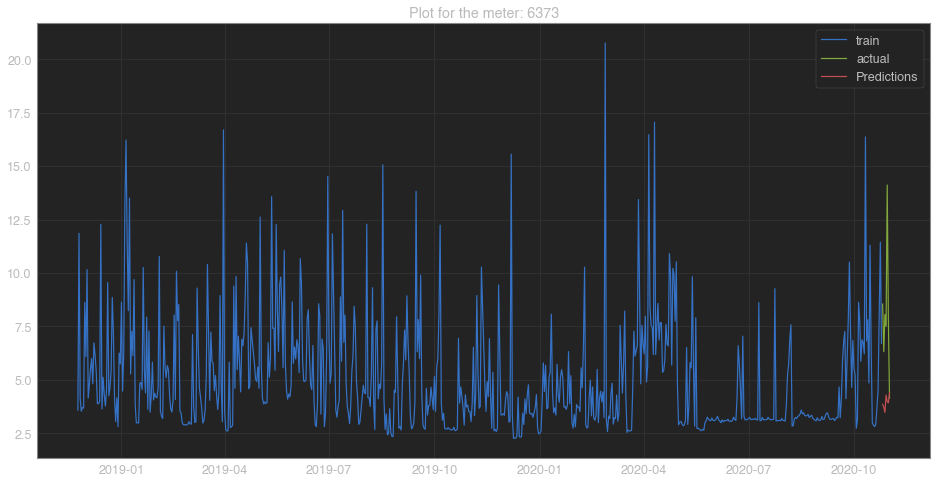

            ds       y
694 2020-10-26   8.548
695 2020-10-27   6.320
696 2020-10-28   8.055
697 2020-10-29   7.502
698 2020-10-30  14.114
699 2020-10-31   7.836
700 2020-11-01   4.145
            ds  Predictions
694 2020-10-26     3.859101
695 2020-10-27     3.717121
696 2020-10-28     3.477517
697 2020-10-29     4.286234
698 2020-10-30     3.981447
699 2020-10-31     3.926274
700 2020-11-01     4.402936
51.07814898256618
Initial log joint probability = -9.09017
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1137.42   3.99808e-06       81.7564           1           1      133   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     144       1137.45   8.09431e-05       80.4214     9.8e-07       0.001      243  LS failed, Hessian reset 
     176       1137.45    5.0041e-08       76.8783      0.5115      0.5115      286   
Optimization terminated normally: 
  Convergence detected: relat

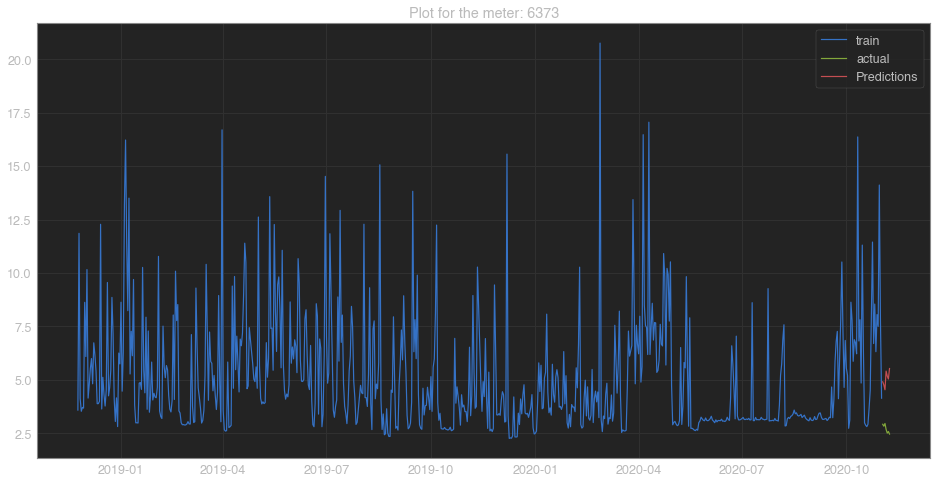

            ds      y
701 2020-11-02  2.925
702 2020-11-03  2.835
703 2020-11-04  2.962
704 2020-11-05  2.683
705 2020-11-06  2.512
706 2020-11-07  2.588
707 2020-11-08  2.466
            ds  Predictions
701 2020-11-02     4.911035
702 2020-11-03     4.764159
703 2020-11-04     4.538964
704 2020-11-05     5.412869
705 2020-11-06     5.179161
706 2020-11-07     5.042515
707 2020-11-08     5.532579
86.50192507184386
Initial log joint probability = -11.0288
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1149.78   1.46269e-05       80.3361      0.4084      0.4084      123   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1151.28   0.000956291       92.1878           1           1      243   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1154.51    0.00413648       70.3368           1           1      359   
    

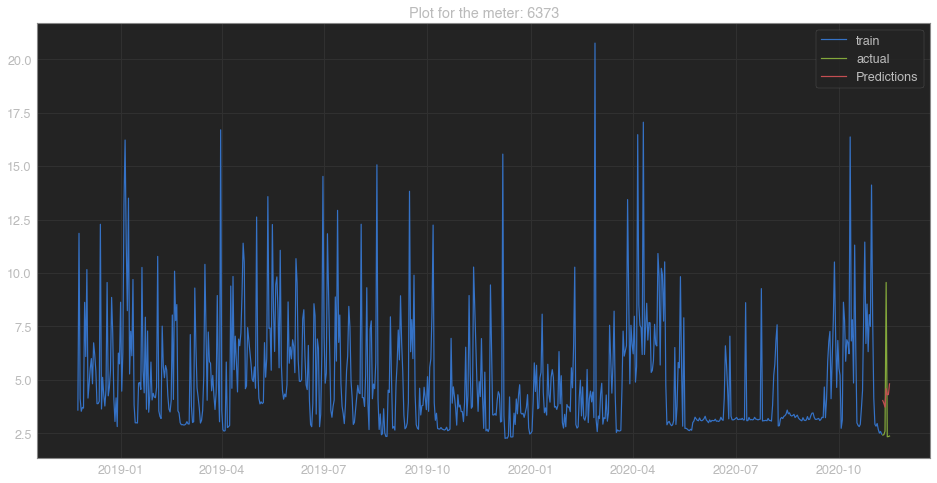

            ds      y
708 2020-11-09  2.420
709 2020-11-10  2.439
710 2020-11-11  2.602
711 2020-11-12  9.559
712 2020-11-13  2.340
713 2020-11-14  2.351
714 2020-11-15  2.375
            ds  Predictions
708 2020-11-09     4.037413
709 2020-11-10     3.899075
710 2020-11-11     3.727575
711 2020-11-12     4.595408
712 2020-11-13     4.307458
713 2020-11-14     4.312315
714 2020-11-15     4.815428
23.286028099545398
Initial log joint probability = -11.2176
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99        1161.2   0.000148827       85.3814      0.3218           1      120   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     137       1161.33   0.000697766       66.4351   9.528e-06       0.001      198  LS failed, Hessian reset 
     199       1161.45   3.16876e-06       78.6831           1           1      274   
    Iter      log prob        ||dx||      ||grad||       alpha      alp

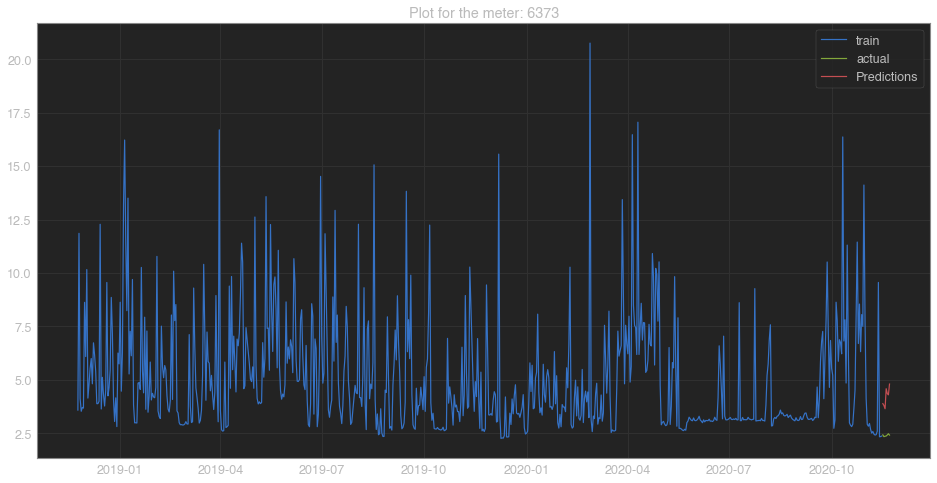

            ds      y
715 2020-11-16  2.429
716 2020-11-17  2.346
717 2020-11-18  2.367
718 2020-11-19  2.376
719 2020-11-20  2.425
720 2020-11-21  2.482
721 2020-11-22  2.419
            ds  Predictions
715 2020-11-16     3.890210
716 2020-11-17     3.802848
717 2020-11-18     3.651150
718 2020-11-19     4.588631
719 2020-11-20     4.360309
720 2020-11-21     4.299676
721 2020-11-22     4.805999
74.53587958441553
   mape_weekly  meterID    type
0       51.078     6373    flag
1       86.502     6373    flag
2       23.286     6373  unflag
3       74.536     6373    flag


In [312]:
account_and_days_billcycle_graphs(6373, checking_data)

Initial log joint probability = -9.05945
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1147.76   5.20534e-05       86.6088           1           1      139   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     168       1147.82   0.000176617       90.3783   2.224e-06       0.001      263  LS failed, Hessian reset 
     199       1147.85   7.00815e-06       83.2217           1           1      302   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     247       1147.86   2.07337e-05       81.2094   2.578e-07       0.001      406  LS failed, Hessian reset 
     299       1147.87   3.09811e-07       79.7012      0.1586           1      464   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     314       1147.87    6.2689e-08       71.9433      0.9009      0.9009      482   
Optimization terminat

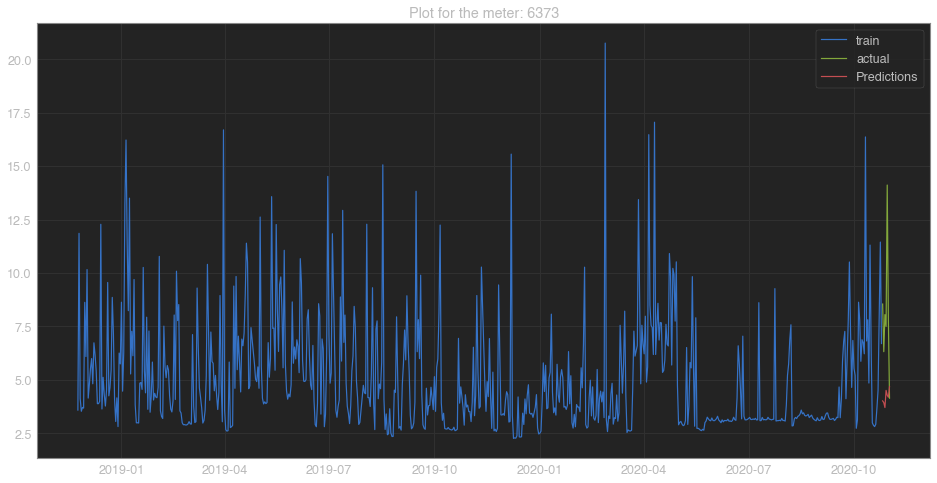

            ds       y
702 2020-10-26   8.548
703 2020-10-27   6.320
704 2020-10-28   8.055
705 2020-10-29   7.502
706 2020-10-30  14.114
707 2020-10-31   7.836
708 2020-11-01   4.145
            ds  Predictions
702 2020-10-26     4.019500
703 2020-10-27     3.939061
704 2020-10-28     3.706671
705 2020-10-29     4.510586
706 2020-10-30     4.282402
707 2020-10-31     4.190710
708 2020-11-01     4.687442
48.09558827575558
Initial log joint probability = -9.19431
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1151.36   3.46355e-06       81.3805      0.3357      0.3357      133   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     139       1151.36   8.81644e-08       75.3773      0.6946      0.6946      183   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance


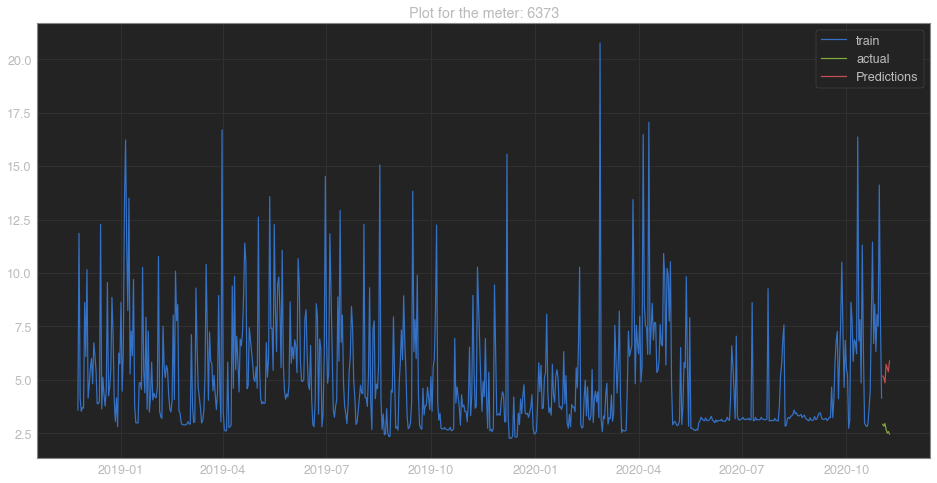

            ds      y
709 2020-11-02  2.925
710 2020-11-03  2.835
711 2020-11-04  2.962
712 2020-11-05  2.683
713 2020-11-06  2.512
714 2020-11-07  2.588
715 2020-11-08  2.466
            ds  Predictions
709 2020-11-02     5.180555
710 2020-11-03     5.089872
711 2020-11-04     4.864496
712 2020-11-05     5.732618
713 2020-11-06     5.561477
714 2020-11-07     5.384811
715 2020-11-08     5.887404
98.73086734227404
Initial log joint probability = -11.1797
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1163.05   5.14745e-05       71.0436      0.8107      0.8107      121   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199        1167.1    0.00432897       121.937      0.9795      0.9795      238   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1168.15    0.00078249       91.8451           1           1      375   
    

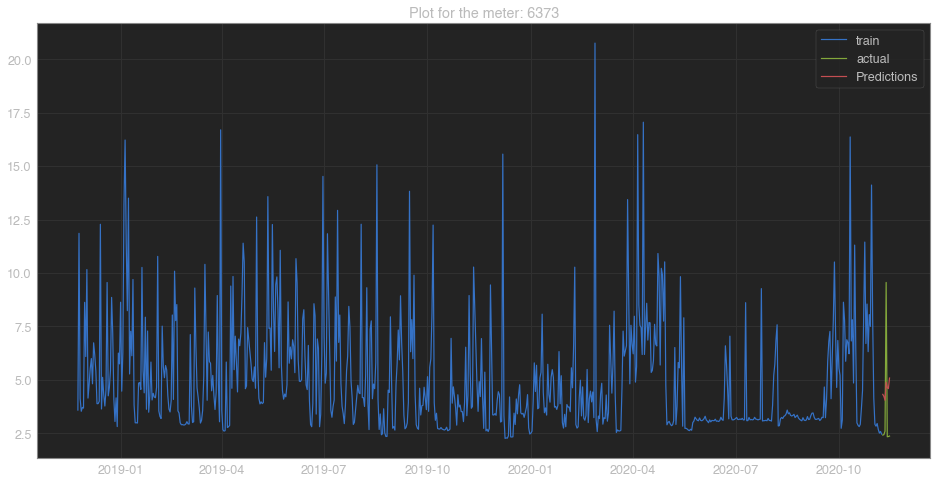

            ds      y
716 2020-11-09  2.420
717 2020-11-10  2.439
718 2020-11-11  2.602
719 2020-11-12  9.559
720 2020-11-13  2.340
721 2020-11-14  2.351
722 2020-11-15  2.375
            ds  Predictions
716 2020-11-09     4.324924
717 2020-11-10     4.228882
718 2020-11-11     4.048554
719 2020-11-12     4.890623
720 2020-11-13     4.632468
721 2020-11-14     4.591919
722 2020-11-15     5.088205
32.05005072574474
Initial log joint probability = -11.371
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1174.24    0.00128087        91.654           1           1      119   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     122       1174.61    0.00308442       132.142   5.374e-05       0.001      175  LS failed, Hessian reset 
     199       1175.13   0.000166144       87.4734           1           1      265   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha

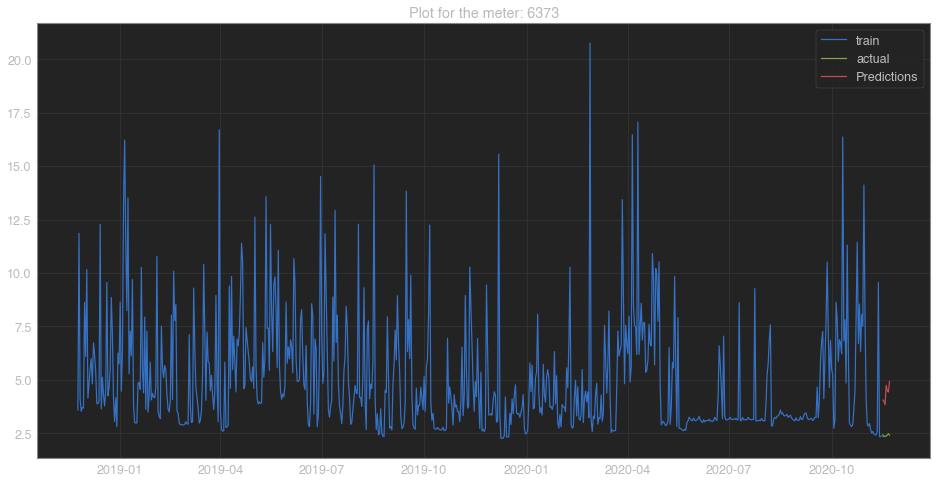

            ds      y
723 2020-11-16  2.429
724 2020-11-17  2.346
725 2020-11-18  2.367
726 2020-11-19  2.376
727 2020-11-20  2.425
728 2020-11-21  2.482
729 2020-11-22  2.419
            ds  Predictions
723 2020-11-16     4.058977
724 2020-11-17     3.999598
725 2020-11-18     3.837151
726 2020-11-19     4.746605
727 2020-11-20     4.489332
728 2020-11-21     4.431486
729 2020-11-22     4.924823
81.00197127825078
   mape_weekly  meterID    type
0       48.096     6373  unflag
1       98.731     6373    flag
2       32.050     6373  unflag
3       81.002     6373    flag


In [313]:
account_and_days_billcycle_graphs(6373, final_df_flat)

Initial log joint probability = -20.6922
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1191.58    0.00588357       71.2411           1           1      119   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     124       1192.29    0.00126844       94.8946   1.701e-05       0.001      194  LS failed, Hessian reset 
     199       1192.62    0.00220183       58.6415      0.9798      0.9798      298   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     213       1193.14     0.0028116       154.686   3.343e-05       0.001      376  LS failed, Hessian reset 
     299       1193.57   8.51051e-07       59.2007       0.308       0.308      494   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     313       1193.57   8.78085e-07       61.0658   1.248e-08       0.001      551  LS failed, Hessian rese

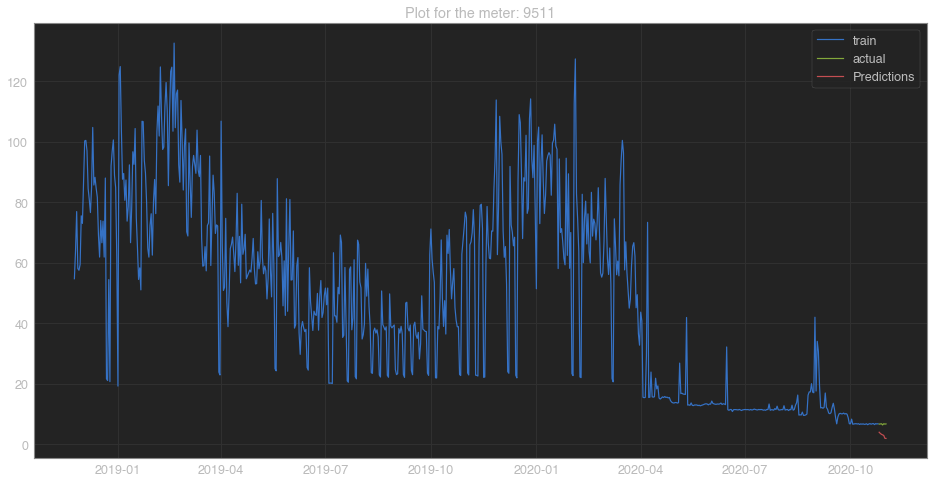

            ds     y
699 2020-10-26  6.72
700 2020-10-27  6.76
701 2020-10-28  6.84
702 2020-10-29  6.44
703 2020-10-30  6.84
704 2020-10-31  6.72
705 2020-11-01  6.78
            ds  Predictions
699 2020-10-26     4.036305
700 2020-10-27     3.644714
701 2020-10-28     3.350500
702 2020-10-29     3.159374
703 2020-10-30     2.979620
704 2020-10-31     2.022481
705 2020-11-01     1.982840
55.040693290164164
Initial log joint probability = -20.5774
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1206.57   0.000801298       51.3945      0.3976           1      126   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1208.23   6.71269e-06       62.6131       0.234       0.234      263   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     293       1208.35   0.000253955       56.3717   5.186e-06       0.001      419  LS failed, He

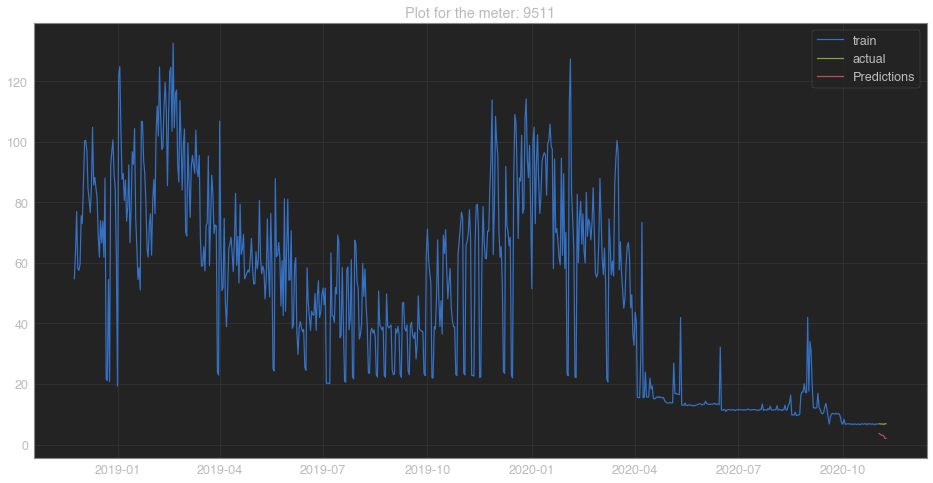

            ds     y
706 2020-11-02  6.84
707 2020-11-03  6.80
708 2020-11-04  6.76
709 2020-11-05  6.80
710 2020-11-06  6.60
711 2020-11-07  6.92
712 2020-11-08  6.84
            ds  Predictions
706 2020-11-02     3.663720
707 2020-11-03     3.326173
708 2020-11-04     3.101483
709 2020-11-05     2.984675
710 2020-11-06     2.874986
711 2020-11-07     2.010212
712 2020-11-08     2.036226
57.95316736626004
Initial log joint probability = -20.4356
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      85       1219.16   0.000862622       89.6228    1.04e-05       0.001      135  LS failed, Hessian reset 
      99       1219.74    0.00558253       69.0953       3.239      0.3239      153   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     147       1222.41    0.00160851       120.014   2.537e-05       0.001      244  LS failed, Hessian reset 
     175       1223.33   0.000393961       62.8224   8.0

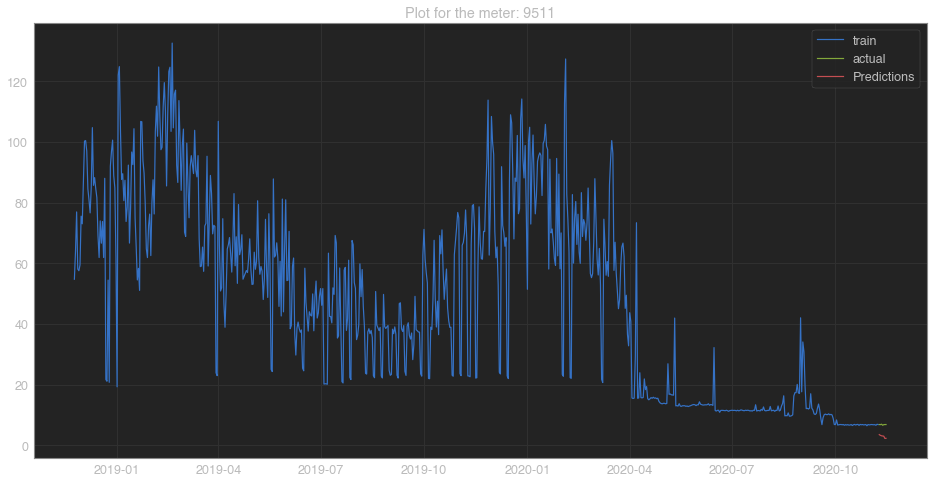

            ds     y
713 2020-11-09  6.84
714 2020-11-10  6.80
715 2020-11-11  6.96
716 2020-11-12  6.60
717 2020-11-13  6.80
718 2020-11-14  6.84
719 2020-11-15  6.84
            ds  Predictions
713 2020-11-09     3.513541
714 2020-11-10     3.269291
715 2020-11-11     3.121897
716 2020-11-12     3.062299
717 2020-11-13     3.001585
718 2020-11-14     2.257168
719 2020-11-15     2.296919
56.95742521606223
Initial log joint probability = -20.3154
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1236.04     0.0148865       80.2963           1           1      124   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     163       1238.13   0.000439945       64.6465   6.696e-06       0.001      270  LS failed, Hessian reset 
     199        1238.2   0.000148456       56.5369           1           1      321   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # ev

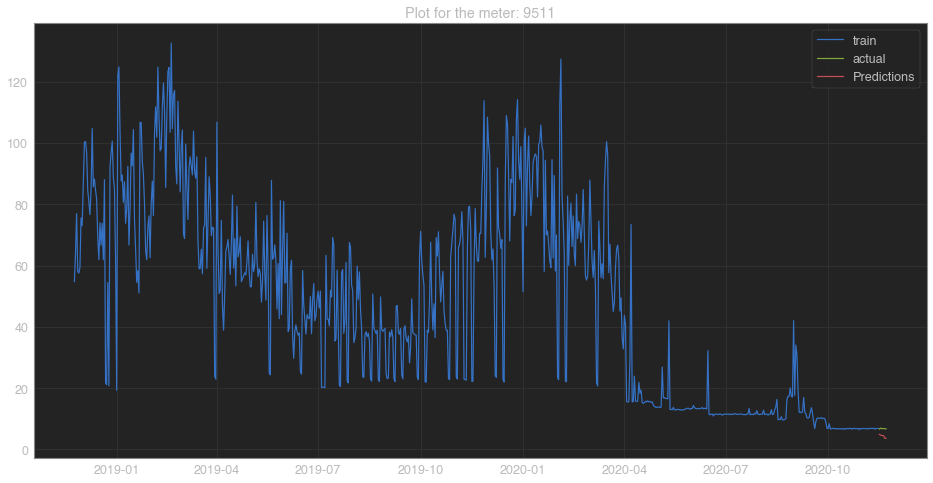

            ds     y
720 2020-11-16  6.64
721 2020-11-17  6.96
722 2020-11-18  6.76
723 2020-11-19  6.84
724 2020-11-20  6.72
725 2020-11-21  6.80
726 2020-11-22  6.68
            ds  Predictions
720 2020-11-16     4.897174
721 2020-11-17     4.677391
722 2020-11-18     4.551903
723 2020-11-19     4.509273
724 2020-11-20     4.452770
725 2020-11-21     3.575334
726 2020-11-22     3.611694
36.12755700174291
   mape_weekly  meterID    type
0       55.041     9511    flag
1       57.953     9511    flag
2       56.957     9511    flag
3       36.128     9511  unflag


In [314]:
account_and_days_billcycle_graphs(9511, checking_data)

Initial log joint probability = -20.7364
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1197.45     0.0275224       61.2812           1           1      111   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1199.27   4.35306e-06       56.1426      0.3705      0.3705      255   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     258       1199.33   0.000369895       67.0457   6.885e-06       0.001      368  LS failed, Hessian reset 
     295       1199.37   6.93528e-08       52.4639     0.07822           1      429   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance


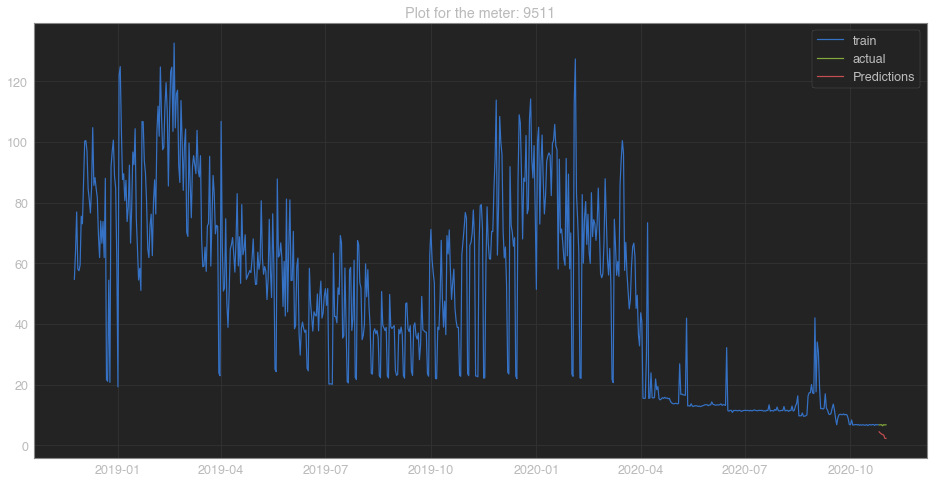

            ds     y
702 2020-10-26  6.72
703 2020-10-27  6.76
704 2020-10-28  6.84
705 2020-10-29  6.44
706 2020-10-30  6.84
707 2020-10-31  6.72
708 2020-11-01  6.78
            ds  Predictions
702 2020-10-26     4.461949
703 2020-10-27     4.066350
704 2020-10-28     3.747430
705 2020-10-29     3.560990
706 2020-10-30     3.380491
707 2020-10-31     2.311615
708 2020-11-01     2.283042
49.44401852590224
Initial log joint probability = -20.6211
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1212.98    0.00348093       46.6402           1           1      116   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     126       1214.21    0.00319007       156.957   4.805e-05       0.001      189  LS failed, Hessian reset 
     199       1214.54   9.21605e-06       57.5136           1           1      289   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # ev

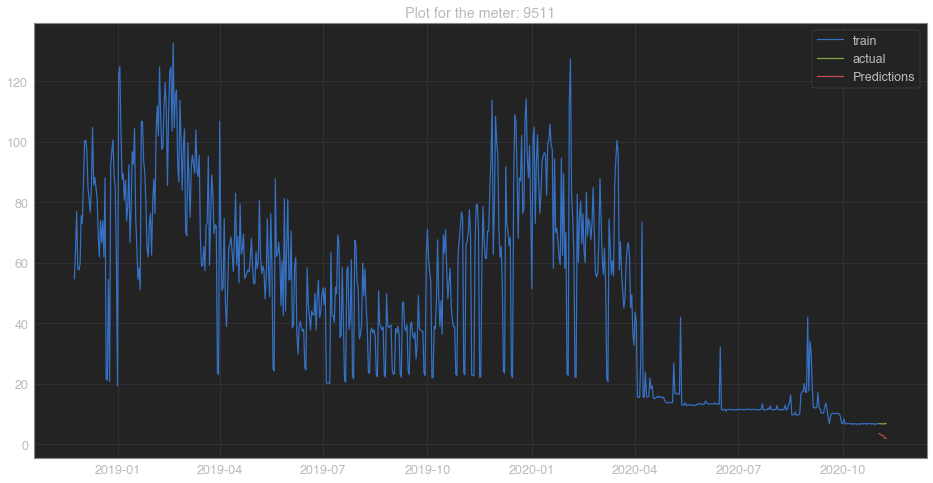

            ds     y
709 2020-11-02  6.84
710 2020-11-03  6.80
711 2020-11-04  6.76
712 2020-11-05  6.80
713 2020-11-06  6.60
714 2020-11-07  6.92
715 2020-11-08  6.84
            ds  Predictions
709 2020-11-02     3.554536
710 2020-11-03     3.236629
711 2020-11-04     2.996460
712 2020-11-05     2.873431
713 2020-11-06     2.756871
714 2020-11-07     1.924189
715 2020-11-08     1.939262
59.45883541486625
Initial log joint probability = -20.4786
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1228.71    0.00196894       85.1905           1           1      127   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     115       1229.16    0.00102731       80.0791   1.696e-05       0.001      193  LS failed, Hessian reset 
     199       1229.44   1.93864e-06       51.5503      0.4347      0.4347      295   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # ev

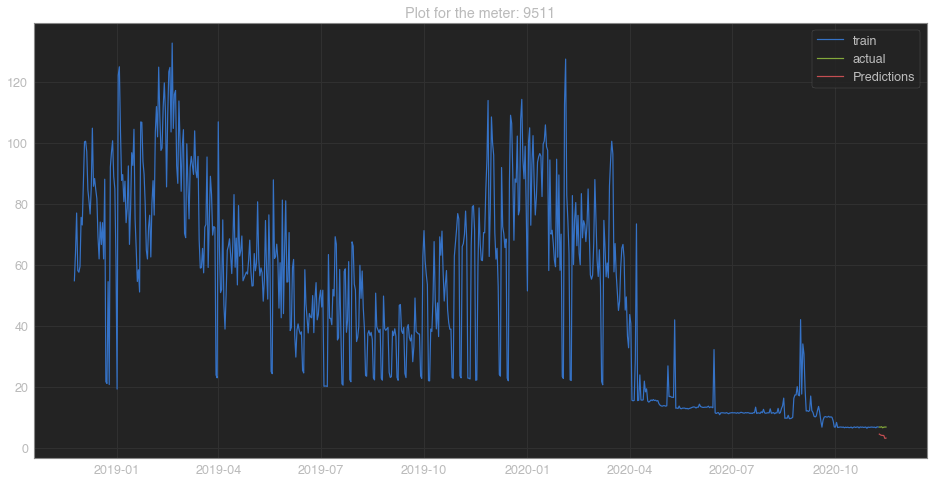

            ds     y
716 2020-11-09  6.84
717 2020-11-10  6.80
718 2020-11-11  6.96
719 2020-11-12  6.60
720 2020-11-13  6.80
721 2020-11-14  6.84
722 2020-11-15  6.84
            ds  Predictions
716 2020-11-09     4.530483
717 2020-11-10     4.279335
718 2020-11-11     4.120672
719 2020-11-12     4.097642
720 2020-11-13     4.074218
721 2020-11-14     3.108391
722 2020-11-15     3.219194
42.47077329833109
Initial log joint probability = -20.3578
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1244.59    0.00554845       75.7749      0.3833           1      117   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     161       1245.02   0.000107271       60.1101   1.578e-06       0.001      233  LS failed, Hessian reset 
     199       1245.14     0.0017288       59.3991      0.3915           1      280   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # ev

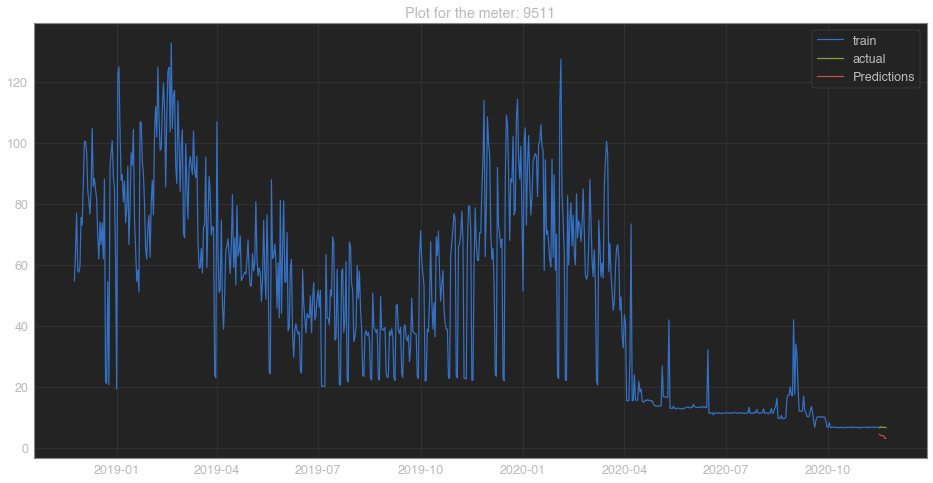

            ds     y
723 2020-11-16  6.64
724 2020-11-17  6.96
725 2020-11-18  6.76
726 2020-11-19  6.84
727 2020-11-20  6.72
728 2020-11-21  6.80
729 2020-11-22  6.68
            ds  Predictions
723 2020-11-16     4.428187
724 2020-11-17     4.221128
725 2020-11-18     4.072984
726 2020-11-19     4.018265
727 2020-11-20     3.948654
728 2020-11-21     3.140790
729 2020-11-22     3.155749
43.06802263636785
   mape_weekly  meterID    type
0       49.444     9511  unflag
1       59.459     9511    flag
2       42.471     9511  unflag
3       43.068     9511  unflag


In [316]:
account_and_days_billcycle_graphs(9511, final_df_flat)

Initial log joint probability = -23.9063
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99        1325.6   0.000387135       72.5468      0.9806      0.9806      123   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     147       1325.68   4.60404e-08       70.0263      0.8397      0.8397      184   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance


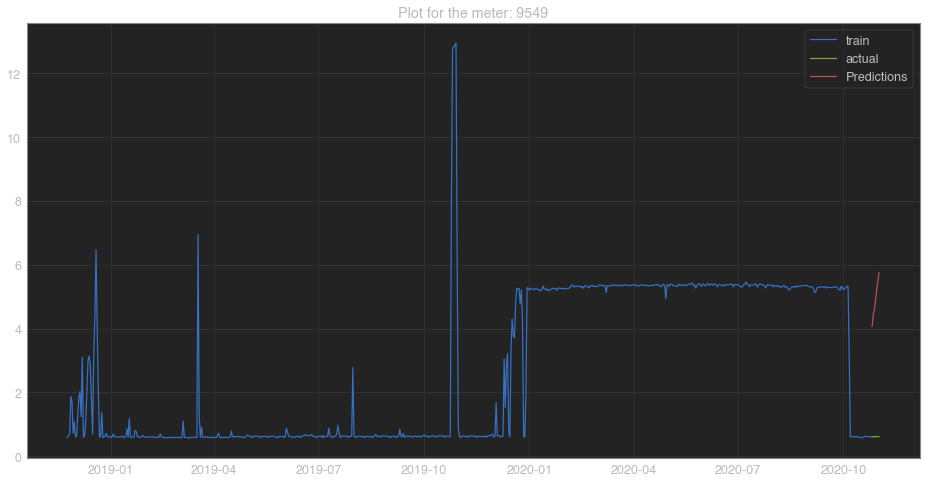

            ds      y
700 2020-10-26  0.609
701 2020-10-27  0.606
702 2020-10-28  0.612
703 2020-10-29  0.605
704 2020-10-30  0.616
705 2020-10-31  0.611
706 2020-11-01  0.604
            ds  Predictions
700 2020-10-26     4.070757
701 2020-10-27     4.446020
702 2020-10-28     4.608229
703 2020-10-29     4.888764
704 2020-10-30     5.243243
705 2020-10-31     5.485976
706 2020-11-01     5.757030
709.2896725527786
Initial log joint probability = -23.8359
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1323.47   0.000493357       83.4024     0.03625           1      140   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     100       1323.48   0.000781649       81.6911   9.372e-06       0.001      191  LS failed, Hessian reset 
     199        1323.6   2.12417e-05       73.9001      0.4422      0.4422      317   
    Iter      log prob        ||dx||      ||grad||       alpha      alph

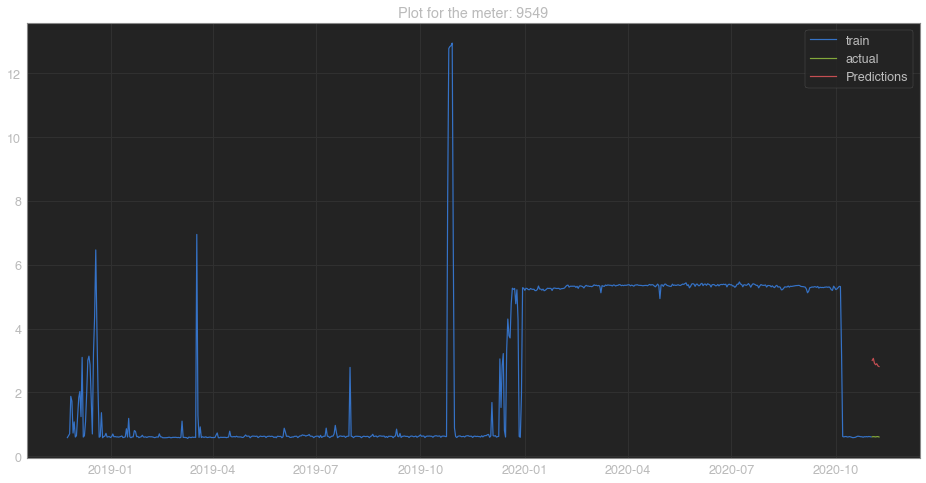

            ds      y
707 2020-11-02  0.606
708 2020-11-03  0.611
709 2020-11-04  0.608
710 2020-11-05  0.602
711 2020-11-06  0.610
712 2020-11-07  0.613
713 2020-11-08  0.600
            ds  Predictions
707 2020-11-02     3.002398
708 2020-11-03     3.065575
709 2020-11-04     2.909572
710 2020-11-05     2.866867
711 2020-11-06     2.898088
712 2020-11-07     2.830395
713 2020-11-08     2.809266
379.58021033077836
Initial log joint probability = -23.8629
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1334.59    2.9536e-05       80.2361           1           1      128   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     115        1334.8   0.000426402       78.1035   5.632e-06       0.001      193  LS failed, Hessian reset 
     199       1334.92   5.60605e-05       76.4445      0.8555      0.8555      294   
    Iter      log prob        ||dx||      ||grad||       alpha      alp

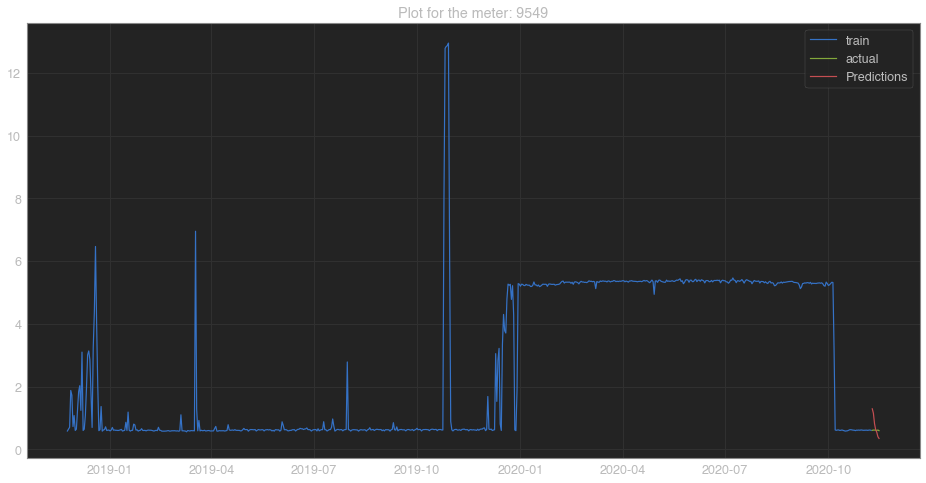

            ds      y
714 2020-11-09  0.603
715 2020-11-10  0.611
716 2020-11-11  0.611
717 2020-11-12  0.606
718 2020-11-13  0.601
719 2020-11-14  0.612
720 2020-11-15  0.592
            ds  Predictions
714 2020-11-09     1.289688
715 2020-11-10     1.148034
716 2020-11-11     0.816444
717 2020-11-12     0.626301
718 2020-11-13     0.541459
719 2020-11-14     0.399838
720 2020-11-15     0.344393
21.958382883682557
Initial log joint probability = -23.9149
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1351.14   4.88127e-05       65.7709      0.3702      0.3702      138   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     145       1351.21   5.79176e-06       74.4138   7.871e-08       0.001      237  LS failed, Hessian reset 
     160       1351.21   4.64785e-09       64.6795    0.006814           1      261   
Optimization terminated normally: 
  Convergence detected: absolute par

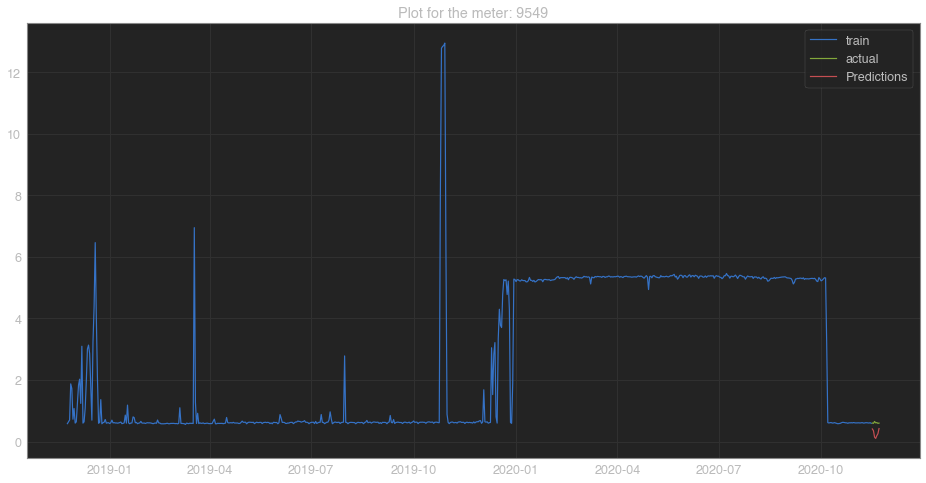

            ds      y
721 2020-11-16  0.600
722 2020-11-17  0.592
723 2020-11-18  0.652
724 2020-11-19  0.607
725 2020-11-20  0.615
726 2020-11-21  0.593
727 2020-11-22  0.598
            ds  Predictions
721 2020-11-16     0.409067
722 2020-11-17     0.351784
723 2020-11-18     0.142590
724 2020-11-19     0.100487
725 2020-11-20     0.189783
726 2020-11-21     0.251631
727 2020-11-22     0.421841
56.13853035724999
   mape_weekly  meterID    type
0      709.290     9549    flag
1      379.580     9549    flag
2       21.958     9549  unflag
3       56.139     9549    flag


In [315]:
account_and_days_billcycle_graphs(9549, checking_data)

Initial log joint probability = -23.9063
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1330.45   9.42516e-08       77.5897           1           1      138   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     101       1330.45   8.67508e-08       65.6183      0.7364      0.7364      140   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance


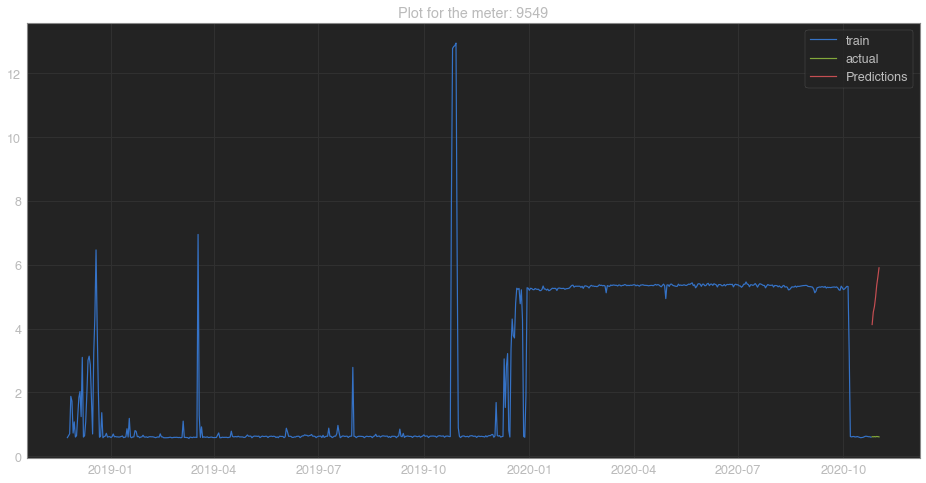

            ds      y
702 2020-10-26  0.609
703 2020-10-27  0.606
704 2020-10-28  0.612
705 2020-10-29  0.605
706 2020-10-30  0.616
707 2020-10-31  0.611
708 2020-11-01  0.604
            ds  Predictions
702 2020-10-26     4.126762
703 2020-10-27     4.515886
704 2020-10-28     4.690785
705 2020-10-29     4.987260
706 2020-10-30     5.358572
707 2020-10-31     5.617035
708 2020-11-01     5.904607
725.7308756948742
Initial log joint probability = -23.8359
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1328.34   2.88134e-05       67.3881      0.4439      0.4439      140   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     123       1328.37   0.000213291       75.2034   3.086e-06       0.001      222  LS failed, Hessian reset 
     158       1328.38   2.77801e-07       69.7001   3.817e-09       0.001      309  LS failed, Hessian reset 
     162       1328.38   5.50108e-08       65.41

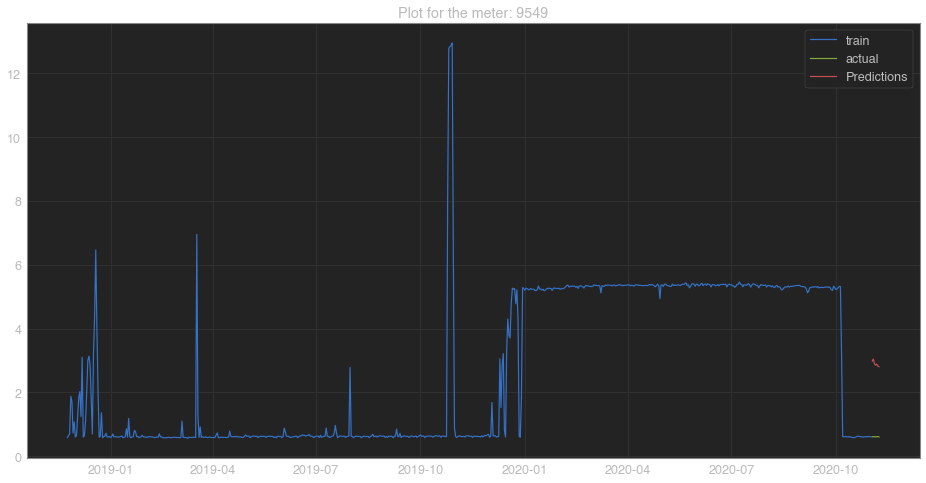

            ds      y
709 2020-11-02  0.606
710 2020-11-03  0.611
711 2020-11-04  0.608
712 2020-11-05  0.602
713 2020-11-06  0.610
714 2020-11-07  0.613
715 2020-11-08  0.600
            ds  Predictions
709 2020-11-02     2.980234
710 2020-11-03     3.044576
711 2020-11-04     2.893492
712 2020-11-05     2.854143
713 2020-11-06     2.886948
714 2020-11-07     2.821724
715 2020-11-08     2.803341
377.2813679772202
Initial log joint probability = -23.8629
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1339.64   0.000118147       73.8104           1           1      133   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1339.74   2.63031e-06       67.9343       0.351       0.351      265   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1339.92   9.62233e-06        65.531           1           1      387   
    

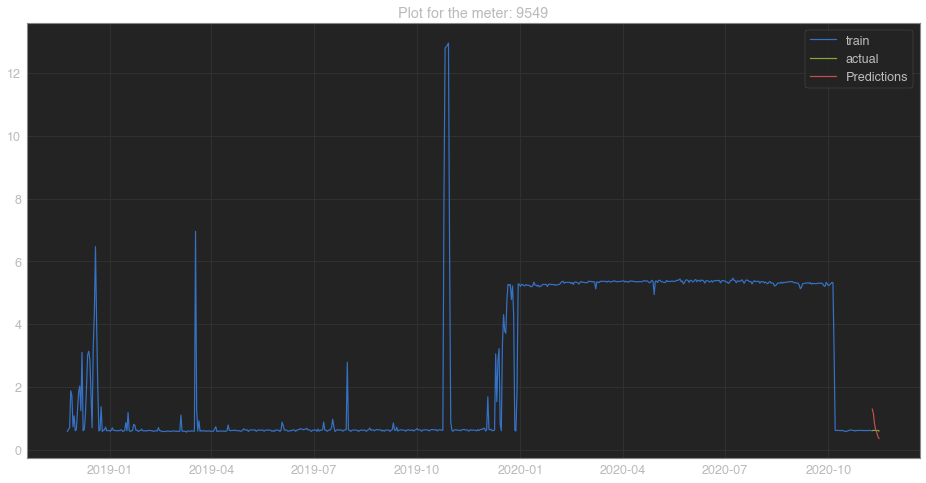

            ds      y
716 2020-11-09  0.603
717 2020-11-10  0.611
718 2020-11-11  0.611
719 2020-11-12  0.606
720 2020-11-13  0.601
721 2020-11-14  0.612
722 2020-11-15  0.592
            ds  Predictions
716 2020-11-09     1.290895
717 2020-11-10     1.150881
718 2020-11-11     0.821081
719 2020-11-12     0.632066
720 2020-11-13     0.548968
721 2020-11-14     0.408887
722 2020-11-15     0.354902
22.938601971353435
Initial log joint probability = -23.9149
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1355.79   0.000559421       85.8849      0.2106      0.2106      133   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     108       1355.95   0.000626384       88.6681   7.404e-06       0.001      179  LS failed, Hessian reset 
     154          1356   1.75325e-07       68.0041           1           1      245   
Optimization terminated normally: 
  Convergence detected: relative gra

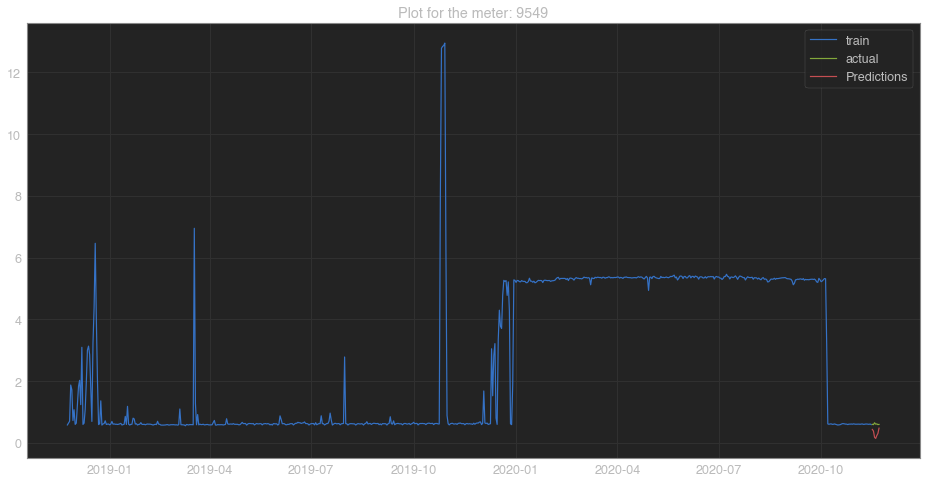

            ds      y
723 2020-11-16  0.600
724 2020-11-17  0.592
725 2020-11-18  0.652
726 2020-11-19  0.607
727 2020-11-20  0.615
728 2020-11-21  0.593
729 2020-11-22  0.598
            ds  Predictions
723 2020-11-16     0.435411
724 2020-11-17     0.383328
725 2020-11-18     0.180852
726 2020-11-19     0.144251
727 2020-11-20     0.237551
728 2020-11-21     0.303668
729 2020-11-22     0.477453
49.20097612049522
   mape_weekly  meterID    type
0      725.731     9549    flag
1      377.281     9549    flag
2       22.939     9549  unflag
3       49.201     9549  unflag


In [317]:
account_and_days_billcycle_graphs(9549, final_df_flat)

In [318]:
#Main function for prediction.
from fbprophet.diagnostics import cross_validation
from fbprophet.diagnostics import performance_metrics
from datetime import datetime
def account_and_days_billcycle_mapes_aftersmoothing(met):
    meterID_df = pd.DataFrame()
    final=pd.DataFrame()
    overall_sum = 0 
    predict_list=[]
    predict_date_list=[]
    mape_list = []
    met_list=[]
    acc_list=[]
    matrix_df=pd.DataFrame()
    met_list.append(met)
    acc=meterIdtoAccountNumber(met)
    #acc=acc_met['AccountNumber'].iloc[0]
    acc_list.append(acc)
    meterID_df = final_df_flat[final_df_flat.MeterId == met]
    meterID_df = meterID_df.drop(['AccountNumber','MeterId','Consumed'],axis=1)
    final = meterID_df.reset_index()[['Usagedate','Value']].rename({'Usagedate':'ds','Value':'y'}, axis='columns')
    #final=final[:len(final)-100]
    for i in range(0,28,7):
        train = final[:len(final)-(28-i)]#Train changes throughout the loops as we should increase 1week for every training session to get the  next week predictions.
        train['y']=mov_avg(train['y'])
        actual=final[len(train):len(train)+7]
        sum_actual=actual['y'].sum()
        test=pd.DataFrame()
        if  (len(train)>=365):
            p = Prophet(daily_seasonality = False, weekly_seasonality = True, yearly_seasonality = True, uncertainty_samples=0,seasonality_mode='multiplicative').add_seasonality(name='quarterly',period=365.4,fourier_order=5)
        else:
            p = Prophet(daily_seasonality = False, weekly_seasonality = True, yearly_seasonality = False,uncertainty_samples=0)
        p.add_country_holidays(country_name='AUS')
        p.fit(train)
        prediction = p.make_future_dataframe(periods=7 , freq='D')
        fore = p.predict(prediction)
        test['Predictions'] = fore['yhat']
        sum_predictions = test['Predictions'][-7:].sum()
        sum_predictions_final = sum_predictions 
        MAPE_val = mape_new(sum_actual, sum_predictions_final)
        MAPE_new = round(MAPE_val, 3)
        mape_list.append(MAPE_new)
        overall_sum = overall_sum + sum_predictions
    matrix_df = pd.DataFrame([mape_list], columns=['1st week','2nd week','3rd week','4th week'])
    larger_elements = [element for element in mape_list if element > 50]
    number_of_elements = len(larger_elements)
    
    matrix_df['meterID'] = met
    matrix_df['type']=['flag' if number_of_elements>=3 else 'unflag']
    return matrix_df

In [319]:
account_and_days_billcycle_mapes_aftersmoothing(9542)

Initial log joint probability = -22.3583
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1441.98    0.00277295       308.842        0.37           1      124   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1478.19     0.0208474       147.897      0.5762      0.5762      244   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1508.88    0.00206016       83.2085           1           1      371   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     333       1511.64     0.0002004       107.517   1.089e-06       0.001      457  LS failed, Hessian reset 
     379       1512.54   0.000270397        156.05   2.527e-06       0.001      553  LS failed, Hessian reset 
     399        1512.6   4.09192e-05       83.2816      0.4078           1      581   
    Iter      log pro

Initial log joint probability = -27.5347
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1671.65      0.233102       272.301           1           1      113   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1808.22    0.00154043       924.308     0.02206      0.5764      230   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1926.26    0.00327599       259.876           1           1      356   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1978.01     0.0355802       349.003           1           1      470   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       2011.97     0.0143392       951.012           1           1      590   
    Iter      log prob        ||dx||      ||grad||       alpha  

,1st week,2nd week,3rd week,4th week,meterID,type
0,42.474,7.217,7.297,2.886,9542,unflag


In [320]:
meters2=[]
z2=[]
for a in flag_uniq:
    b=account_and_days_billcycle_mapes_aftersmoothing(a)
    z2.append(b)
z2=pd.concat(z2)
z2

Initial log joint probability = -64.5921
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1036.32     0.0578434       95.9783      0.2842           1      119   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1041.02   5.46098e-07       70.3306           1           1      251   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     208       1041.02   6.91754e-08       80.8254      0.7923      0.7923      261   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probability = -48.9262
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1139.53     0.0100333       106.302      0.9712      0.9712      128   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
    

Initial log joint probability = -32.4832
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       2021.62     0.0140909        481.27           1           1      117   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       2340.23    0.00505361       1391.54           1           1      225   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299        2489.6     0.0374694        4375.4           1           1      334   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       2709.05    0.00552145       3940.14           1           1      451   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       2960.11    0.00140248        1428.6           1           1      565   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -31.2239
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       2064.46     0.0871268       1963.76           1           1      111   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       2479.69     0.0152352       3024.57      0.2718           1      228   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299        2839.8     0.0133202       6961.76           1           1      341   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       3047.21   0.000420196       1155.52           1           1      461   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       3196.61    0.00830537       5034.34           1           1      582   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -29.6642
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1542.57    0.00652289       399.251      0.7698      0.7698      113   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1659.43     0.0235975       383.644           1           1      226   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1762.54     0.0497365       1764.32      0.7773      0.7773      335   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1862.99     0.0104579       562.546           1           1      441   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1928.87    0.00564313       629.608           1           1      552   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -27.7849
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1721.21    0.00713634       1052.01           1           1      111   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1900.74      0.116942        847.61           1           1      225   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       2133.72     0.0169443       1431.65      0.2181           1      340   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       2189.04   0.000851391        497.76      0.8598      0.8598      454   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       2263.66     0.0337372       2625.94           1           1      563   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -26.3052
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1907.65     0.0100645       717.962           1           1      108   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       2103.89      0.474523       15230.4      0.5443           1      219   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       2380.57    0.00506646       732.552           1           1      328   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       2562.17     0.0187948        2090.8      0.4156           1      436   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       2702.13     0.0133348       1664.25           1           1      545   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -25.0784
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       2005.94    0.00234589       450.579      0.7699      0.7699      110   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199        2179.6     0.0237927       3962.23           1           1      220   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299        2576.7     0.0163173       1474.62           1           1      334   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       2648.91     0.0296047       3561.43           1           1      454   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       2945.17    0.00820989       2637.55           1           1      567   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -106.105
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99        1295.8   0.000254068       70.4372       0.716      0.2153      121   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1301.17     0.0280547       179.734      0.6155      0.6155      239   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     247        1309.4    0.00149105       169.252   1.325e-05       0.001      323  LS failed, Hessian reset 
     299        1309.8    4.7957e-05       73.7919      0.4499      0.4499      389   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     341       1310.05   0.000302389        84.965    4.12e-06       0.001      477  LS failed, Hessian reset 
     385       1310.43   7.02014e-06       54.2764   8.833e-08       0.001      569  LS failed, Hessian rese

Initial log joint probability = -92.1609
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99        1464.7    0.00839345       140.604           1           1      122   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199        1485.7    0.00407065       121.768      0.3818      0.3818      238   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1558.34      0.192799       2129.44      0.4517           1      349   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1753.97     0.0202464        2387.4           1           1      459   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1928.45    0.00871092       597.706           1           1      567   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -92.0177
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99          1522     0.0931109       423.493           1           1      123   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1854.35    0.00685807       531.492           1           1      234   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       2134.21    0.00616804       1662.12           1           1      339   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       2264.63    0.00235646       630.058      0.9816      0.9816      447   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       2353.04    0.00420794       1154.03           1           1      554   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -11.4972
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1572.21      0.015159       184.724           1           1      119   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1590.61    0.00104124       71.6032           1           1      245   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1603.04    0.00813674       166.455      0.2524           1      373   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1610.06     0.0168047       325.444      0.4639           1      488   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     409        1610.3   0.000110023       61.0918   1.467e-06       0.001      545  LS failed, Hessian reset 
     499        1611.3     0.0128384    

Initial log joint probability = -16.8077
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99        1739.3     0.0123717       754.309       0.611       0.611      122   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199        1876.5     0.0041737       367.348           1           1      233   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1925.82    0.00432985        283.56           1           1      346   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1938.06    0.00058306       182.218      0.9264      0.9264      472   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1963.11     0.0117271       726.256      0.5395      0.5395      588   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -16.9137
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99        1872.1     0.0731986       2523.77           1           1      112   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1970.92    0.00212278       147.679           1           1      225   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1995.18     0.0470172       422.644           1           1      344   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       2022.99      0.041568       271.395           1           1      471   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       2031.85   0.000762796       195.327      0.2598           1      579   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -87.1736
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1612.89      0.101264       872.561           1           1      116   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199          1889   0.000976794       258.562           1           1      229   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1983.89    0.00459991       839.193           1           1      337   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       2051.02     0.0623373       3915.01      0.1897           1      454   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       2075.33    0.00801476       2302.33      0.2017           1      570   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -82.9259
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1804.11      0.155638       2168.87           1           1      119   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       2400.34     0.0155554       11135.4      0.4079      0.4079      235   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       2631.63    0.00447787       2868.52      0.4459      0.4459      350   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       2743.72    0.00198738       6281.84     0.03407           1      463   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       2849.84    0.00217564       1195.37           1           1      577   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -81.3807
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1973.47    0.00675867       1113.34       0.535       0.535      124   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       2541.57     0.0597306       5251.85           1           1      237   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       2703.97    0.00241059       2510.15           1           1      350   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       2896.45    0.00300503       4473.66           1           1      467   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       3035.97    0.00634189       2313.39           1           1      580   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -30.2049
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       2129.06     0.0316371       1092.64           1           1      105   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       2210.86    0.00810363       1179.02           1           1      217   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       2228.95    0.00201751       425.589      0.8724      0.8724      331   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       2241.27   0.000177322       224.377      0.5596      0.5596      439   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       2244.94    0.00253849       238.529           1           1      553   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -30.8125
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1757.05     0.0156334        771.73      0.3401      0.3401      108   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1968.61     0.0125514       770.333      0.5745      0.5745      221   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       2228.21    0.00124217       784.503      0.8806      0.8806      332   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       2367.66     0.0101183       2749.34           1           1      445   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       2579.25     0.0589358       5820.25           1           1      556   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -29.108
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1704.57     0.0180145       282.087           1           1      106   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       2177.49     0.0152545       1067.88           1           1      218   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       2781.27    0.00337383       4610.93      0.4846      0.4846      322   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       2950.08     0.0109458       10138.7           1           1      428   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       3102.41   0.000488379       2906.42      0.4999      0.4999      534   
    Iter      log prob        ||dx||      ||grad||       alpha   

Initial log joint probability = -20.0375
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1980.41    0.00565851       1085.16      0.1617           1      126   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       2052.47     0.0107113       692.698           1           1      249   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       2116.76    0.00122814         130.6      0.8191      0.8191      368   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       2175.52    0.00324679       337.068           1           1      492   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       2191.97    0.00465633       450.026           1           1      606   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -23.1409
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       2188.86     0.0338045       1644.36           1           1      126   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       2358.58    0.00999621       1016.06           1           1      241   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299        2595.4     0.0291658       3006.01           1           1      354   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399        2784.8     0.0114219       4605.84           1           1      468   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       2856.44    0.00154826       570.298           1           1      581   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -24.2951
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       2266.64    0.00174764       1111.69           1           1      120   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       2475.95    0.00431309       548.339           1           1      235   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       2591.27     0.0281814       1850.81           1           1      345   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       2906.84     0.0111341        4295.1           1           1      461   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       3090.52    0.00455776       3409.14           1           1      573   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -14.3574
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1844.02     0.0027431       146.686      0.6093      0.6093      114   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1872.04    0.00321145       304.513        0.11      0.2378      235   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     268       1889.88   0.000182545       145.574   1.064e-06       0.001      359  LS failed, Hessian reset 
     299       1897.68     0.0074674       258.313           1           1      397   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1910.57    0.00643814       353.756      0.4253           1      513   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1943.89     0.0275645    

Initial log joint probability = -14.4101
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       2033.39     0.0317318       533.626      0.9989      0.9989      114   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       2075.86     0.0644027       642.631      0.4471           1      227   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       2132.06     0.0377029       188.348           1           1      344   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       2199.31     0.0290028       1509.25           1           1      452   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       2261.38     0.0171425       3328.03           1           1      570   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -14.7079
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       2109.48     0.0128897       648.577           1           1      116   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       2201.08     0.0016805       1000.08      0.5049      0.5049      229   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       2234.99    0.00191425       630.011           1           1      359   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       2265.87     0.0129612        1113.6      0.4188      0.4188      474   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       2342.34    0.00451827       1038.62      0.2979      0.2979      585   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -14.6806
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       2219.42    0.00925056       757.347           1           1      115   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       2320.02    0.00841295       321.777           1           1      238   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       2394.48    0.00809168       395.498           1           1      350   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       2481.01    0.00659404       1148.08       0.253       0.253      465   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       2580.09     0.0164395       2729.47           1           1      571   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -10.997
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1705.99    0.00102978       128.054      0.8195      0.8195      117   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1765.46    0.00849751       344.567      0.7304      0.7304      231   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299        1801.3    0.00232404       141.007      0.7803      0.7803      349   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399        1818.2     0.0107017       332.794           1           1      465   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1831.82    0.00602164       171.784           1           1      574   
    Iter      log prob        ||dx||      ||grad||       alpha   

Initial log joint probability = -15.606
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1905.67      0.177973       2140.95           1           1      113   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       2033.84     0.0010303       360.332           1           1      231   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       2133.27    0.00159871        684.81           1           1      344   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399        2386.4     0.0172605       5192.15      0.7273      0.7273      457   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499        2444.2    0.00175122       567.129           1           1      569   
    Iter      log prob        ||dx||      ||grad||       alpha   

Initial log joint probability = -17.0349
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1947.75     0.0344816       557.419           1           1      115   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       2335.74     0.0508843       4472.35           1           1      228   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       2599.34    0.00280832          9689           1           1      332   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       2697.92    0.00299515        3204.9       0.252           1      445   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       2768.05    0.00164661       1616.74           1           1      561   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -4.2273
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1836.89     0.0944806       983.667      0.4202           1      122   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       2037.15     0.0351113       609.651           1           1      229   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       2346.25    0.00521787       799.728           1           1      339   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       2391.33    0.00266369       616.196           1           1      450   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       2449.55    0.00441778       3807.57      0.5438      0.5438      557   
    Iter      log prob        ||dx||      ||grad||       alpha   

Initial log joint probability = -4.17815
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1980.04    0.00665343       601.638           1           1      118   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       2016.26     0.0023288       450.321      0.5325      0.5325      241   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       2600.14    0.00693622        3268.5           1           1      351   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       2811.89     0.0303103       3097.28           1           1      457   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       3055.16    0.00298083       9165.54      0.5121      0.5121      568   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -3.17346
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       2038.65     0.0179353       624.355           1           1      126   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       2088.42     0.0137286       803.885           1           1      232   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       2375.17     0.0673793       2800.67           1           1      345   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       2589.73    0.00835237       1796.17           1           1      458   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       2906.88     0.0193681       3007.62           1           1      566   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -15.5807
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1859.89    0.00921095       138.304      0.2873           1      117   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       2024.31     0.0248932       264.836           1           1      224   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       2119.44     0.0353273       866.416      0.3781           1      335   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       2192.99    0.00107237        169.33           1           1      445   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       2239.35   0.000953712       192.474           1           1      555   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -37.2352
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1573.99    0.00207451       206.537           1           1      111   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1680.95     0.0248998       726.801      0.9166      0.9166      230   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1788.05      0.030468       552.862           1           1      341   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1838.72     0.0043911       882.195      0.5751      0.5751      449   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1906.18     0.0071363       816.569           1           1      561   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -35.3636
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1760.19    0.00317779       292.482           1           1      115   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1956.54     0.0193975       1057.61           1           1      227   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       2096.39     0.0467749       1963.79      0.3323           1      345   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       2153.88     0.0106474       1174.73           1           1      456   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499        2248.8    0.00840763       1349.29           1           1      566   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -37.049
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1853.69    0.00368301       1326.95      0.6663      0.6663      112   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       2148.51      0.042344       1266.59           1           1      224   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       2351.56    0.00221564       1225.63           1           1      329   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       2387.81    0.00260399       1985.06      0.4898      0.4898      445   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       2427.46     0.0162753       1959.63       0.146      0.9763      560   
    Iter      log prob        ||dx||      ||grad||       alpha   

Initial log joint probability = -39.0159
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1904.01     0.0530972       920.774           1           1      115   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       2282.45     0.0110093       3185.43           1           1      230   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299          2386     0.0119657       1989.02      0.2406           1      343   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       2487.76     0.0421054       2747.67           1           1      454   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       2566.89     0.0115621       990.884      0.6981      0.6981      563   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -19.5293
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1298.81     0.0687476       574.492           1           1      127   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1352.29    0.00736607       143.727      0.6985      0.6985      246   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1376.98    0.00241764       292.954      0.2893           1      368   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     351       1387.73   0.000578189       389.774   1.415e-06       0.001      470  LS failed, Hessian reset 
     399       1398.52    0.00137767       86.4147      0.5637      0.5637      527   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1405.22   0.000475333    

Initial log joint probability = -90.8086
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       2448.08     0.0374017       2412.55      0.4202           1      124   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       2610.69    0.00830142       3207.33      0.9754      0.9754      239   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       2738.76     0.0232078       1303.22           1           1      365   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       2778.93    0.00596623       1370.63           1           1      478   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       2813.31    0.00199072       2068.26           1           1      593   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -32.7001
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1283.11     0.0303947       371.694           1           1      117   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1323.42    0.00233865       175.603      0.4949      0.4949      228   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     244       1336.84   0.000743083       167.276   2.773e-06       0.001      321  LS failed, Hessian reset 
     299       1341.39    0.00240329       78.7083           1           1      387   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1392.17      0.030269        164.64           1           1      505   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499        1413.9     0.0364687    

Initial log joint probability = -34.9085
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1451.09     0.0558364        879.01      0.4707      0.4707      116   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1548.18     0.0376755       415.058      0.2384           1      221   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1611.83     0.0158663       664.871      0.7063      0.7063      335   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1709.91     0.0139416       279.725           1           1      449   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1735.39     0.0107902       495.397           1           1      556   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -36.091
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1567.72      0.292847       1114.84           1           1      114   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1682.82      0.013555       641.766           1           1      230   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1756.72     0.0131164       449.845           1           1      337   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1828.88    0.00200974       372.938      0.4165           1      447   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499        1880.4    0.00402638       222.852           1           1      557   
    Iter      log prob        ||dx||      ||grad||       alpha   

Initial log joint probability = -37.5228
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1671.24     0.0666374          1535      0.3887           1      107   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1749.01      0.125281       548.111      0.7768     0.07768      224   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1898.19      0.138706       4387.87      0.3416           1      331   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       2147.61     0.0139291       2372.29           1           1      436   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499        2204.8    0.00574927        2477.4           1           1      545   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -28.8425
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1475.11    0.00178144       462.354      0.1711      0.1711      112   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1599.96     0.0347944       580.137      0.7233      0.7233      220   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1729.37     0.0030442        1099.3       0.561       0.561      329   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1807.57    0.00538865       652.374           1           1      445   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499        1842.5      0.002642       227.704           1           1      551   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -27.7914
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1551.23    0.00517979        263.95           1           1      106   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1726.35     0.0103954       913.782           1           1      220   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1846.47      0.013881       870.881      0.7025      0.7025      333   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399          2053    0.00115498       993.933      0.5982      0.5982      444   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499          2091     0.0449674       2197.88           1           1      552   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -27.8232
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1648.39    0.00932298       619.242      0.2394           1      113   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1916.35    0.00241555       1131.59      0.7727      0.7727      226   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       2008.16     0.0304785       1275.94       2.235      0.2235      337   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       2304.06    0.00326378       1658.62       0.613       0.613      446   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       2326.24     0.0023524       838.895           1           1      556   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -25.2815
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1767.38     0.0668287       1059.15           1           1      117   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       2097.71     0.0702618       1934.49           1           1      226   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       2346.02    0.00817895       2067.45           1           1      338   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399        2419.1    0.00615998       521.169           1           1      445   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       2556.14     0.0410105       3210.07           1           1      556   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -76.7857
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1639.54     0.0250843       154.704           1           1      122   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     167       1644.18    0.00106531       287.155   7.721e-06       0.001      233  LS failed, Hessian reset 
     199       1645.87     0.0010263       105.793       1.531      0.3483      270   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     235       1647.03   0.000877949       242.014   4.745e-06       0.001      358  LS failed, Hessian reset 
     299       1647.75   8.30627e-05        94.357      0.5277      0.5277      437   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     350        1648.4    0.00649128       363.419   5.268e-05       0.001      527  LS failed, Hessian rese

Initial log joint probability = -48.0277
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1712.99    0.00751312         297.4      0.9517      0.9517      118   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1727.51   0.000617094       89.9655           1           1      241   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     211       1728.28   0.000466092       222.659   1.933e-06       0.001      289  LS failed, Hessian reset 
     299       1734.83     0.0499618        350.37      0.1313      0.5471      395   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     308       1738.12    0.00263045       415.219   1.542e-05       0.001      445  LS failed, Hessian reset 
     345       1744.97   0.000444389       214.914   2.046e-06       0.001      528  LS failed, Hessian rese

Initial log joint probability = -43.8647
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1727.68     0.0623673       775.688           1           1      126   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     138       1736.61    0.00286305       200.679   1.766e-05       0.001      208  LS failed, Hessian reset 
     199       1742.49      0.319098       882.731           1           1      278   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     227       1759.67     0.0004248       223.963    1.88e-06       0.001      347  LS failed, Hessian reset 
     299       1772.51     0.0141435       280.393           1           1      439   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1787.88      0.165764        323.63       4.493      0.9308      561   
    Iter      log pro

Initial log joint probability = -6.20143
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       2209.52    0.00215225       269.741           1           1      121   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       2351.09    0.00510105       2030.15      0.2164           1      231   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       2388.39    0.00102595       446.974           1           1      343   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       2459.11    0.00083412       783.972           1           1      456   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       2485.96    0.00238769       344.578      0.8305      0.8305      570   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -5.8589
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       2457.83    0.00746489       1728.03           1           1      120   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       2649.89     0.0261645       1519.91           1           1      233   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       2913.52    0.00337398       11681.8      0.2753      0.2753      342   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       3052.24     0.0129413       6045.99           1           1      447   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       3173.69    0.00584438       11368.3           1           1      560   
    Iter      log prob        ||dx||      ||grad||       alpha   

Initial log joint probability = -7.82086
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       2441.26     0.0277216       4737.88      0.4066           1      119   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       2688.69    0.00329161       2454.03           1           1      229   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       2884.25     0.0189652       6536.72      0.6957      0.6957      337   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       2955.06    0.00301017       981.556           1           1      448   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       3034.66    0.00109973       493.951           1           1      562   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -20.2402
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       2226.25     0.0157971       1485.65           1           1      119   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       2387.58     0.0315717       738.754           1           1      238   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       2491.64    0.00215823       457.851           1           1      351   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399        2581.8     0.0549024       1138.12           1           1      468   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       2685.01     0.0300634       893.362           1           1      573   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -15.2354
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1686.62     0.0261911       917.532           1           1      122   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1769.91     0.0372666       834.913           1           1      231   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1894.26     0.0073904       243.212           1           1      340   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1966.58     0.0482387       485.404      0.7304     0.07304      453   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       2063.82     0.0105431       984.066      0.7062      0.7062      562   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -13.9112
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1848.22      0.019092       1344.56           1           1      118   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1959.49    0.00254066       563.054      0.6948      0.6948      223   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       2064.27     0.0823626       2509.93           1           1      329   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       2143.59     0.0250196       685.704           1           1      440   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       2421.78    0.00825417       5312.41      0.3123           1      550   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -13.2587
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1975.54     0.0580887       1079.05      0.3075           1      118   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       2146.03    0.00239362       1091.96      0.3641      0.3641      226   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       2202.36     0.0387163       910.728       1.279      0.1279      341   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       2317.77     0.0296037       698.816           1           1      453   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       2352.57     0.0163152       1694.03           1           1      558   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -14.8759
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1999.91     0.0410967       1905.79      0.9778      0.9778      118   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       2091.03     0.0270537       737.561           1           1      226   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       2132.82    0.00868054       830.351           1           1      340   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       2208.66     0.0698219       1226.65           1           1      453   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       2263.43     0.0190087        1215.4           1           1      565   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -12.3043
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1996.92     0.0260432        1951.5      0.8982      0.8982      111   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       2093.31     0.0320813       240.095           1           1      226   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       2136.16    0.00183363        402.77           1           1      342   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399        2156.9    0.00477923       576.349           1           1      463   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499        2204.1    0.00273163       841.265      0.5499      0.5499      580   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -18.6002
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       2176.38     0.0236798       1735.55           1           1      118   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       2396.31     0.0246604       5769.57      0.8941      0.8941      232   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       2491.05     0.0354702       1390.39           1           1      341   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       2612.37    0.00256503       1883.91           1           1      454   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499        2689.8     0.0275984       3011.62           1           1      573   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -25.2423
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       2263.66     0.0111194       474.225           1           1      114   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199        2528.4     0.0137223        1896.7           1           1      224   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       2897.57     0.0100616       2054.72           1           1      339   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       2991.09    0.00445694       1055.23           1           1      453   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       3063.97    0.00346146       2457.47           1           1      570   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -30.3429
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       2335.45    0.00120927       667.205           1           1      115   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       2572.39     0.0445987       3045.28           1           1      232   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       2980.78     0.0022196       2686.64           1           1      342   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       3164.57    0.00611985       2488.61           1           1      453   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       3314.17    0.00170599       2845.67      0.6099      0.6099      566   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -9.76127
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1817.97    0.00758431       169.871           1           1      118   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1860.41     0.0123449       425.804           1           1      228   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1897.26    0.00322778       284.301      0.8526      0.8526      334   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     379       1923.48   0.000482394       302.765   1.402e-06       0.001      470  LS failed, Hessian reset 
     399       1929.34    0.00242055       132.067           1           1      492   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1938.73    0.00109108    

Initial log joint probability = -21.051
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1890.92    0.00382146       309.353           1           1      118   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1926.58     0.0180562       534.097           1           1      230   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       2082.64    0.00648026       751.914           1           1      340   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       2171.27     0.0335066       2052.27           1           1      447   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       2398.97     0.0605527       4644.09           1           1      551   
    Iter      log prob        ||dx||      ||grad||       alpha   

Initial log joint probability = -21.4631
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1962.68     0.0521592        3820.9      0.3156      0.7557      124   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       2124.02    0.00587464       1437.13      0.6258      0.6258      238   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       2200.33    0.00425399       520.061           1           1      350   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399        2452.2    0.00124816       1044.22           1           1      463   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       2615.81    0.00294206       2879.06           1           1      572   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -31.9809
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1582.57    0.00317107       236.784      0.1447      0.7143      115   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1606.67    0.00255345       131.556      0.6822      0.6822      225   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     292       1612.43    0.00359989       398.654   3.981e-05       0.001      391  LS failed, Hessian reset 
     299       1613.06    0.00205301       155.087           1           1      399   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     325       1614.16    0.00262175       307.515    2.94e-05       0.001      462  LS failed, Hessian reset 
     399        1615.5    0.00373613       99.0988      0.6619           1      558   
    Iter      log pro

Initial log joint probability = -33.7249
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1934.85     0.0933917        722.26           1           1      120   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       2012.83     0.0170552       1162.77      0.9963      0.9963      242   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       2057.06      0.100554       938.232           1           1      356   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       2182.13      0.022302       1156.96           1           1      468   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       2294.63     0.0603119       5364.49           1           1      575   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -31.7905
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       2058.33     0.0542982       1080.82           1           1      113   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       2169.51    0.00630104       449.001           1           1      225   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       2295.28     0.0363357       912.009      0.7945      0.7945      343   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       2401.07      0.047207       1359.06           1           1      455   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       2526.59    0.00202198       503.785      0.5474      0.5474      568   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -16.6127
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1299.67    0.00418122       85.1837           1           1      121   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     193       1305.05   0.000741106       98.7883    4.03e-06       0.001      275  LS failed, Hessian reset 
     199       1305.48   0.000873876       57.9293      0.8315      0.8315      281   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299        1305.9    1.3392e-06       86.9125           1           1      433   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1309.42   0.000297932       73.5285      0.2619           1      559   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     453        1309.8   0.000462727    

Initial log joint probability = -20.3442
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99        1379.2     0.0633238        200.74           1           1      123   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     117       1384.78    0.00107419       154.531    2.79e-06       0.001      184  LS failed, Hessian reset 
     199       1401.88     0.0423529       198.409           1           1      284   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299          1443      0.201339       373.119           1           1      406   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1471.47      0.094928       222.999           1           1      526   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     488       1491.35   0.000451977    

Initial log joint probability = -21.9036
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1438.94     0.0210719       611.734           1           1      120   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1484.19    0.00504033       132.562      0.5442      0.5442      235   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1492.66    0.00311704       106.308      0.8104      0.8104      363   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1549.89      0.475069       1047.51      0.9342      0.9342      478   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1699.15     0.0525449       386.268           1           1      588   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -11.8353
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1529.25     0.0375642        273.35      0.4592           1      120   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1558.41     0.0035131       328.452        0.79        0.79      242   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     250       1561.84    0.00048919       164.508   3.768e-06       0.001      343  LS failed, Hessian reset 
     276       1562.72   0.000242103       99.2921   2.055e-06       0.001      419  LS failed, Hessian reset 
     299       1562.86   0.000179353       63.4798      0.3833      0.3833      446   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1585.26     0.0740507       257.312      0.4064           1      563   
    Iter      log pro

Initial log joint probability = -11.4396
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1841.66     0.0321843       908.932      0.9668      0.9668      113   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199        1899.6    0.00356843       389.517      0.6727     0.06727      234   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1939.85    0.00191791       192.699      0.7798      0.7798      350   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       2015.42     0.0195185       547.221           1           1      452   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       2110.88     0.0150736       714.793           1           1      567   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -11.4675
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1897.98      0.310359       3154.17       1.694      0.1694      120   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       2069.09      0.044057       1435.74      0.8232      0.8232      227   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       2155.09     0.0460618       520.129           1           1      342   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       2231.31     0.0184449       463.131           1           1      451   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       2298.95    0.00396169       1941.12           1           1      564   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -29.6985
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1256.76     0.0022519       91.7528      0.3819      0.3819      125   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1276.31     0.0087552       94.8098       0.737       0.737      246   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     233       1283.81    0.00133226       158.379   8.521e-06       0.001      317  LS failed, Hessian reset 
     299        1292.5   0.000892597        80.038      0.6506      0.6506      397   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1337.72      0.140507       570.137      0.2431      0.2431      518   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1477.49     0.0218116    

Initial log joint probability = -17.7909
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1354.15    0.00363442       145.112           1           1      115   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1386.08    0.00291768       142.004       0.818       0.818      235   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1391.02     0.0241021       161.964      0.3898           1      351   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1871.33     0.0860369       384.608           1           1      457   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1936.62     0.0605053       2330.01           1           1      567   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -8.41733
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1443.79     0.0130326       110.645           1           1      117   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1849.77     0.0512051       684.325           1           1      231   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1977.79    0.00555996        317.75      0.4447      0.4447      338   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       2077.91   0.000439458       239.053      0.5179      0.5179      447   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       2139.53    0.00321417       736.366           1           1      554   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -8.02926
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1512.46      0.020737       197.694       2.456      0.2456      129   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1641.54     0.0495235       881.986           1           1      243   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1934.38      0.162308       491.273           1           1      350   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       2024.34     0.0924805       3080.62     0.05905           1      457   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       2083.58       0.14148       1359.04           1           1      563   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -17.8486
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1373.26     0.0131347       210.386           1           1      117   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1440.76     0.0038267       282.526           1           1      239   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1477.31    0.00622481       140.106      0.6259      0.6259      360   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1504.29     0.0109091       291.786           1           1      475   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1518.92   0.000847336       158.096      0.5205      0.5205      595   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -9.30635
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1544.84     0.0247364       1499.22      0.1827           1      116   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1710.67     0.0575068       732.442           1           1      229   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299        1750.8     0.0187204       819.426           1           1      338   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1783.27     0.0141734       959.397       0.529       0.529      452   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     423       1824.09   0.000167823       247.719   9.209e-07       0.001      528  LS failed, Hessian reset 
     499       1851.76   0.000891822    

Initial log joint probability = -7.66368
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1636.75    0.00401565       924.187      0.5645      0.5645      116   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1752.45    0.00532376       260.738           1           1      233   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1826.75     0.0691271       228.459      0.2453           1      345   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1862.94    0.00878638       1144.62      0.9323      0.9323      457   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499        1904.1     0.0640442       589.412           1           1      573   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -27.0672
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1763.99     0.0178856        131.62           1           1      121   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1799.29     0.0143083       311.985       3.394      0.3394      235   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1814.83     0.0287517        247.22           1           1      349   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1873.47     0.0964318       565.323      0.7026      0.7026      467   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     468       1922.15   0.000168119       211.897   5.799e-07       0.001      587  LS failed, Hessian reset 
     499       1950.86     0.0623116    

Initial log joint probability = -27.566
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1979.01     0.0196141       558.655       2.459      0.2459      118   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       2128.75    0.00061502       544.655      0.4414           1      229   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       2416.22     0.0242605       2678.47           1           1      339   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       2566.49   0.000594198       545.475           1           1      448   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       2658.54    0.00392853       3487.25           1           1      557   
    Iter      log prob        ||dx||      ||grad||       alpha   

Initial log joint probability = -28.8322
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1997.46      0.171034       1562.07        0.49           1      114   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       2205.68    0.00521607        1886.7      0.4273           1      226   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       2305.37     0.0096341       1033.42           1           1      338   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399          2436     0.0048918       1574.36           1           1      449   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       2542.47    0.00206542       2062.55           1           1      555   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -14.0718
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1418.67   0.000811064       187.994      0.6834      0.6834      131   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1442.45    0.00105055       119.876     0.05178      0.9187      254   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     233       1446.37   0.000667245       160.321   4.144e-06       0.001      338  LS failed, Hessian reset 
     299       1449.85    0.00859023       70.9666           1           1      420   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1452.39    0.00225658       151.131           1           1      550   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1473.43     0.0208508    

Initial log joint probability = -19.6099
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1589.53      0.066635       407.437           1           1      115   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     192       1616.98   0.000357121       131.998    2.08e-06       0.001      256  LS failed, Hessian reset 
     199        1617.9      0.002772       265.394      0.7373      0.7373      263   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1650.72    0.00131236       206.959      0.1621      0.1621      387   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1668.06    0.00491044       130.359           1           1      511   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499        1864.1     0.0525876    

Initial log joint probability = -23.0026
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1667.38     0.0437121       244.411           1           1      114   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1768.11    0.00384765       395.431      0.6936      0.6936      225   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1818.05     0.0468457       733.052           1           1      342   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       2027.99    0.00574955       7305.87      0.6999      0.6999      453   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       2168.34     0.0150892       4551.66           1           1      562   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -30.6417
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1389.62     0.0208829       684.184      0.2968      0.6087      119   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1443.74      0.023213       202.973           1           1      239   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1457.04    0.00593463       114.562           1           1      364   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1503.59     0.0124406       115.428           1           1      493   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     476       1511.28    0.00076935       317.948   4.207e-06       0.001      629  LS failed, Hessian reset 
     499       1512.51   0.000465917    

Initial log joint probability = -31.9831
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1631.84     0.0329558       1636.95           1           1      114   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1730.65     0.0105819       775.925           1           1      233   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1783.13     0.0319925       245.473           1           1      347   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1888.48     0.0108096       404.853           1           1      461   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1985.97    0.00132003        489.32           1           1      570   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -32.3971
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1737.89     0.0612827       586.175      0.3421           1      120   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1815.33     0.0884153       1205.99           1           1      235   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1928.52    0.00808272       1142.42      0.1793           1      348   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       2084.83    0.00117899       1427.08       0.565       0.565      457   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       2256.35    0.00833425       1432.15           1           1      569   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -13.8822
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1705.34    0.00178896       137.995           1           1      118   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1758.12      0.071254       949.663           1           1      231   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1774.67    0.00169656       72.5889           1           1      351   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1794.61    0.00917745       219.058           1           1      468   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1798.59    0.00193796       124.867      0.1528           1      594   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -11.0381
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1753.67     0.0953141       694.917           1           1      126   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1960.12     0.0532857       4672.73           1           1      242   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       2123.09      0.010074        1229.3       1.668      0.1668      360   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       2261.67    0.00157752       2250.53      0.2636      0.2636      471   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       2311.66     0.0238311       1622.76           1           1      582   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -12.871
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1767.38    0.00457576       1995.07      0.6196      0.6196      114   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       2136.91     0.0188234       1529.98      0.8951      0.8951      227   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       2306.41      0.015057       2051.94      0.9247      0.9247      341   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       2390.06    0.00301048        944.83           1           1      449   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       2470.65    0.00070183       1825.05      0.4389      0.4389      563   
    Iter      log prob        ||dx||      ||grad||       alpha   

Initial log joint probability = -3.18465
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       2438.87      0.032729       1264.31      0.5418      0.5418      115   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       2520.98    0.00193983       258.217           1           1      225   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       2572.06    0.00184391       664.419           1           1      335   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       2615.88    0.00262637       706.154      0.4603      0.8912      449   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       2631.29    0.00185629       680.252           1           1      554   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -2.90558
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       2726.76     0.0108044       978.657           1           1      120   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       2995.16    0.00139275       541.565           1           1      230   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       3064.74    0.00478162        4026.7           1           1      342   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       3120.12    0.00150826       1264.94           1           1      449   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       3134.97    0.00182283       1161.01           1           1      554   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -5.56054
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       2508.84    0.00608122       1736.17           1           1      120   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       2688.97     0.0436347       2228.69           1           1      226   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       2774.93     0.0045922       888.002           1           1      333   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       2871.05       0.25672        3105.6           1           1      441   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       2952.25     0.0126329       990.098           1           1      549   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -8.43362
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       2412.54    0.00467173       445.218      0.7748      0.7748      122   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       2568.89    0.00417298       2161.08     0.09423           1      229   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       2776.54     0.0185518        1442.8           1           1      339   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       2885.77    0.00247444        1745.2           1           1      445   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       2958.86     0.0198035          1924           1           1      553   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -40.3738
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1426.86     0.0200279       121.779      0.2368           1      125   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     125       1451.48   0.000344904       114.039   2.255e-06       0.001      191  LS failed, Hessian reset 
     199       1474.72     0.0178698       378.935      0.9264      0.9264      272   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1544.78      0.007155        270.41           1           1      387   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1563.54      0.026334       1070.15      0.9832      0.9832      502   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1587.88     0.0195896    

Initial log joint probability = -40.6291
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1534.58     0.0964354       1190.99           1           1      115   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     144       1570.24      0.001552       294.622   8.573e-06       0.001      203  LS failed, Hessian reset 
     199          1608     0.0265233       519.721           1           1      268   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1670.14    0.00890153       284.536           1           1      383   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     325       1676.72   0.000134444       118.548   7.789e-07       0.001      456  LS failed, Hessian reset 
     399       1691.64    0.00335453        152.34           1           1      543   
    Iter      log pro

Initial log joint probability = -42.4466
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99        1574.7     0.0235834       1455.67      0.2001           1      116   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1671.67     0.0077637       432.214      0.4332      0.4332      225   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1735.02     0.0236301       169.216           1           1      333   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1788.55     0.0210781       558.278           1           1      448   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1806.08    0.00158952       280.204      0.7881      0.7881      564   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -41.6595
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99        1632.1     0.0249532       301.009       2.515     0.05553      121   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1721.18    0.00396828       272.646      0.5104      0.5104      234   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1779.73     0.0296605         474.4           1           1      349   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1818.98     0.0599959       170.699           1           1      460   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1840.09    0.00656171       316.972           1           1      579   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -27.8189
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1240.71       0.18056       359.776           1           1      112   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1304.91      0.025746       214.936           1           1      225   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1338.85     0.0261826       681.005           1           1      344   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1409.49    0.00344789       786.163   4.742e-06       0.001      495  LS failed, Hessian reset 
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1460.36    0.00748122       214.621           1           1      604   
    Iter      log prob        ||dx||    

Initial log joint probability = -24.9931
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1383.44    0.00562861       218.256           1           1      117   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1471.72     0.0281263       200.278           1           1      238   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1634.32     0.0598735       194.715           1           1      347   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1693.26    0.00208051       192.465      0.1308      0.9721      461   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1794.59      0.360486       2326.89           1           1      569   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -24.5552
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1471.15    0.00977796       467.614           1           1      113   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1616.48     0.0156688       603.622      0.8932      0.8932      228   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1777.13     0.0309733       273.633           1           1      339   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1856.07     0.0306951       601.455           1           1      452   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1965.19     0.0815522       1592.05           1           1      560   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -22.735
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1590.29   0.000523473       497.741      0.2283      0.2283      114   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1798.17    0.00906558       730.086           1           1      229   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1989.62    0.00826298       876.765           1           1      339   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399        2079.9    0.00454273       1071.03           1           1      449   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       2180.31     0.0107213       1834.61           1           1      564   
    Iter      log prob        ||dx||      ||grad||       alpha   

Initial log joint probability = -21.8986
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1457.74    0.00949024       132.061      0.8573      0.8573      115   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1472.39   0.000452295       73.0037           1           1      234   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1479.77     0.0427034       380.717           1           1      358   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     316       1481.75   0.000605328       135.038   2.767e-06       0.001      430  LS failed, Hessian reset 
     399       1483.83   0.000210766       54.2457      0.5285      0.5285      531   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1487.75     0.0288913    

Initial log joint probability = -18.7937
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1694.56    0.00706752       326.898      0.2174           1      118   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1713.91   0.000635191        86.362           1           1      250   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     220       1717.85   0.000650815       206.762   1.154e-06       0.001      317  LS failed, Hessian reset 
     299       1723.99    0.00184416       183.277     0.06573           1      415   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1727.72   0.000131883       78.5355           1           1      531   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1751.35     0.0079733    

Initial log joint probability = -19.8528
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1773.87     0.0304671       215.897           1           1      114   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1793.87     0.0187484       186.585           1           1      235   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     232       1798.14    0.00133431       426.395   7.035e-06       0.001      321  LS failed, Hessian reset 
     299       1804.02      0.286968       536.596           1           1      398   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     308       1806.14   0.000201836       107.573   1.513e-06       0.001      467  LS failed, Hessian reset 
     399        1815.1     0.0826902       319.374           1           1      578   
    Iter      log pro

Initial log joint probability = -38.6135
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      87         890.2     0.0105766       211.905   0.0001333       0.001      145  LS failed, Hessian reset 
      99        891.31   0.000943123       63.4795      0.4604      0.2823      161   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     134       892.984    0.00219683       117.581    2.58e-05       0.001      254  LS failed, Hessian reset 
     199        894.11     0.0012966       60.0293           1           1      354   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       952.515      0.116607       148.743           1           1      473   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1115.17      0.197067       1163.68      0.5185      0.5185      581   
    Iter      log pro

Initial log joint probability = -35.4843
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       926.721    0.00539819       92.8211       0.479       0.479      123   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1028.39        0.1772       210.899           1           1      239   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1194.22     0.0773265       610.793           1           1      351   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1326.89     0.0021912       427.355           1           1      460   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1408.89     0.0014883       326.904      0.5946      0.5946      571   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -34.5091
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1067.16     0.0181877       400.796        3.79       0.379      128   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1289.27       0.42262       1629.01           1           1      241   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1492.17     0.0143159       669.847      0.4311           1      352   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1667.61    0.00239875       890.483      0.9895      0.9895      466   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499        1702.2    0.00672782       772.317           1           1      579   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -34.15
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1080.31       0.14029       1036.63           1           1      121   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1461.32      0.167818       2843.48      0.6763      0.6763      237   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1738.91     0.0285681       1722.43           1           1      347   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1874.51     0.0402551       2576.88      0.4543           1      457   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1913.11    0.00289588        577.26           1           1      566   
    Iter      log prob        ||dx||      ||grad||       alpha    

Initial log joint probability = -20.7498
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1706.54    0.00213419       109.372      0.7444      0.7444      118   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199        1719.1     0.0128563       258.786           1           1      231   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1733.08     0.0041342       82.3868      0.7511      0.7511      360   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     365       1746.55    0.00123271       224.818   1.502e-05       0.001      476  LS failed, Hessian reset 
     399       1749.13     0.0267099       185.104           1           1      514   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499        1765.1     0.0227729    

Initial log joint probability = -18.2457
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1809.59     0.0187078       251.932           1           1      122   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1825.31     0.0802949       382.387      0.9606      0.9606      238   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1850.31     0.0283524       1248.77           1           1      368   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     379       1886.24   0.000921191       297.892    2.88e-06       0.001      501  LS failed, Hessian reset 
     399       1889.73    0.00244315       180.423      0.4296           1      525   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499          2012     0.0559818    

Initial log joint probability = -18.7701
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1862.89    0.00481596       499.775       1.312      0.1312      123   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     179       1892.21    0.00130148       172.718   9.436e-06       0.001      253  LS failed, Hessian reset 
     199       1898.15    0.00735006       372.529           1           1      274   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299        1917.7    0.00656228       205.206           1           1      392   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       2117.17     0.0581199       2015.16           1           1      498   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       2309.09     0.0545858    

Initial log joint probability = -80.2679
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       2603.25    0.00124835       1406.53      0.6595      0.6595      132   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       2663.65    0.00155346       1890.69      0.7823      0.7823      246   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       2694.89     0.0237806       1524.94           1           1      364   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       2708.71    0.00152619       456.304      0.2043           1      487   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       2719.57    0.00686213       722.095           1           1      598   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -79.997
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       2768.23     0.0132902       10741.3           1           1      120   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       3000.73     0.0371837       13173.4           1           1      234   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299        3126.6     0.0122448       3637.19           1           1      354   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399        3156.8    0.00172426       1656.66           1           1      471   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       3260.89    0.00108364       1277.71           1           1      586   
    Iter      log prob        ||dx||      ||grad||       alpha   

Initial log joint probability = -79.3795
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       2805.99     0.0009103       848.995           1           1      122   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       3146.25    0.00302698       1944.68           1           1      242   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       3280.62    0.00127908       1862.78           1           1      364   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       3321.24    0.00520763       3562.58           1           1      476   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       3366.85   0.000543654       2070.33           1           1      592   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -78.3255
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       2874.91    0.00897675       4848.84           1           1      126   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199        3159.1     0.0336425       4923.72           1           1      246   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       3246.39    0.00117144       1971.28      0.3934           1      366   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       3278.92    0.00308615       8039.82      0.3702      0.3702      480   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       3307.27   0.000854046          5404      0.6758      0.6758      597   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -23.1057
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1650.71      0.111065        331.92       1.518      0.1518      120   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1677.55   0.000648469       96.7536      0.3973      0.3973      240   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1686.54    0.00256172       169.843           1           1      366   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1691.74    0.00220488       114.415           1           1      480   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1715.17    0.00436336       150.718      0.6601      0.6601      599   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -21.318
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99          2014     0.0130497        533.64           1           1      117   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       2166.34     0.0530276       1572.77           1           1      237   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       2224.76    0.00255169       635.106           1           1      354   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399        2261.9    0.00953639       590.682       1.043      0.1043      463   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       2281.48   0.000890636       566.574      0.6619      0.6619      575   
    Iter      log prob        ||dx||      ||grad||       alpha   

Initial log joint probability = -20.9979
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       2190.14     0.0266858       861.192           1           1      121   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       2433.13    0.00166492       1320.07      0.2983           1      238   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       2480.31      0.014413       1307.83           1           1      357   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       2528.66     0.0307318       3739.48           1           1      465   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       2563.68   0.000464775       1749.51       0.725       0.725      577   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -10.597
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       2227.33    0.00230358       570.124           1           1      118   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       2296.17     0.0186645       717.019           1           1      228   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       2320.91     0.0136944       481.216           1           1      342   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       2341.07   0.000887433       235.568           1           1      460   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       2351.24   0.000212472       280.931      0.8622      0.8622      581   
    Iter      log prob        ||dx||      ||grad||       alpha   

Initial log joint probability = -12.8233
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       2293.51    0.00400845       1536.54      0.6956      0.6956      119   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       2380.68    0.00522547        969.23           1           1      238   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       2418.57     0.0646118       1530.61      0.8428      0.8428      352   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       2449.55    0.00460569       276.166           1           1      468   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       2473.16     0.0998747       1293.55           1           1      586   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -12.89
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       2340.01     0.0148305       1131.57           1           1      120   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       2520.12    0.00837239       1030.57           1           1      226   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       2629.66    0.00122756        659.66           1           1      333   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399        2665.4    0.00641084       2317.03           1           1      441   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       2725.05     0.0488931       1874.87           1           1      557   
    Iter      log prob        ||dx||      ||grad||       alpha    

Initial log joint probability = -14.9782
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       2356.78     0.0143395       580.743      0.8508     0.08508      122   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       2528.55    0.00437557       318.753           1           1      233   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299        2583.3     0.0229589       3282.14           1           1      341   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       2815.07    0.00135267       1762.97       0.375       0.375      455   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       2931.66    0.00179659       1860.75           1           1      567   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -14.4419
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1556.85    0.00590444       130.098      0.6994      0.6994      117   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     159       1570.31    0.00285474        350.69    1.57e-05       0.001      216  LS failed, Hessian reset 
     199       1580.54    0.00906708       242.724           1           1      258   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     211       1583.22   0.000570778       197.197   2.184e-06       0.001      313  LS failed, Hessian reset 
     299       1588.84    0.00201303       189.274      0.1659      0.1659      422   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     315       1590.77   0.000494491       116.268   1.419e-06       0.001      477  LS failed, Hessian rese

Initial log joint probability = -17.0911
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1663.23     0.0389042       189.232           1           1      110   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1742.44     0.0603397       578.653           1           1      224   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1816.17       0.06856       2357.62           1           1      333   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1917.91   0.000837903       622.211           1           1      442   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       2011.41     0.0037832       772.963      0.7074      0.7074      555   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -16.9816
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1728.71    0.00601281       247.355           1           1      108   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1789.78     0.0641471       531.784           1           1      223   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1900.38    0.00443825       174.618           1           1      333   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       2006.82     0.0406784       565.068           1           1      435   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       2064.66     0.0210977       1148.55           1           1      541   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -2.89041
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       2652.86     0.0175697       1838.78           1           1      121   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       2742.69      0.022132       1810.02           1           1      227   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       2814.24     0.0602029       1693.73           1           1      338   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       2877.12     0.0353247       2777.22           1           1      448   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       2912.13   0.000702989       1163.18           1           1      556   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -2.8657
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       2899.61    0.00588203       988.334           1           1      111   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       2999.43    0.00760235       4754.56           1           1      223   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299          3285    0.00485881        4857.1           1           1      334   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       3359.24   0.000944626       1717.51           1           1      445   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499        3377.2     0.0029842       3669.46           1           1      552   
    Iter      log prob        ||dx||      ||grad||       alpha   

Initial log joint probability = -4.94803
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       2655.99    0.00818164        2021.1      0.3457      0.3457      117   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       2899.12   0.000157006       928.353      0.7342      0.7342      227   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       2931.92    0.00566765       1196.14           1           1      335   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       2966.52    0.00630519       1643.29           1           1      447   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       3032.52    0.00253301       2848.49           1           1      556   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -6.84956
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99        2497.5    0.00555289       567.551           1           1      126   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       2753.42    0.00569491        5688.2       0.595       0.595      234   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       2875.33    0.00162848       1300.24      0.6814      0.6814      340   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       3050.19    0.00273728       2567.36           1           1      449   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       3115.72   0.000847789       1239.55           1           1      564   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -27.9026
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1643.16     0.0395118       947.561           1           1      119   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1706.03     0.0997751       390.534           1           1      234   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     208        1708.3   0.000984727       170.307   6.939e-06       0.001      281  LS failed, Hessian reset 
     274       1721.07   0.000314309       263.756   1.429e-06       0.001      411  LS failed, Hessian reset 
     299       1724.43    0.00109542       170.866      0.5178           1      440   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     385       1731.29   0.000252771       232.577   8.479e-07       0.001      590  LS failed, Hessian rese

Initial log joint probability = -22.8459
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1780.02     0.0328195       401.428           1           1      118   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199        1988.4     0.0361369       525.133           1           1      235   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       2058.72     0.0034251       350.562           1           1      346   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       2084.05    0.00182967       512.038      0.3908      0.3908      462   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       2107.27   0.000554179       425.461      0.4437      0.4437      575   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -34.2015
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1706.02     0.0777983       400.596           1           1      118   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1799.36    0.00501838       284.814           1           1      228   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299        1852.6     0.0350871       727.515           1           1      347   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1897.81     0.0182959       501.263           1           1      471   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1914.02   0.000346801       66.2457           1           1      585   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -56.7877
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1560.67    0.00644896        358.69      0.4214      0.4214      118   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1613.56     0.0338025       262.904           1           1      238   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1725.31     0.0212199        849.55           1           1      347   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1860.89    0.00309974        193.62           1           1      467   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1890.61    0.00818886       487.186           1           1      578   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -25.881
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       2085.86    0.00217488       313.059           1           1      122   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       2119.01       0.00289       572.303           1           1      237   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       2134.01     0.0441448       165.554           1           1      357   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       2142.29   0.000572673        261.03           1           1      485   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     432       2143.27   0.000211244       220.864   1.893e-06       0.001      583  LS failed, Hessian reset 
     499          2144   0.000983054     

Initial log joint probability = -29.3284
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99        2817.3    0.00566439       1314.48           1           1      119   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       3121.15    0.00993516       3431.54           1           1      235   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       3231.04     0.0299865       6825.09           1           1      353   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       3354.57    0.00378824       1610.18           1           1      464   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       3432.54    0.00680381       2964.95           1           1      572   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -27.1256
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       2835.96     0.0184007       4375.98           1           1      118   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       3281.85     0.0148123       14833.3           1           1      233   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       3402.43     0.0173467       6588.75           1           1      345   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       3445.24    0.00104581       3294.68           1           1      470   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       3501.42      0.002157       1335.68      0.8282      0.8282      582   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -67.9753
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1699.35      0.061654       462.202           1           1      115   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1783.79     0.0122355        512.16           1           1      226   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1865.01      0.179746       718.919           1           1      344   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     312       1867.64   0.000223977       283.617   1.034e-06       0.001      407  LS failed, Hessian reset 
     399       1880.55    0.00015152       195.134    0.004243           1      509   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     444       1882.86   0.000111436    

Initial log joint probability = -59.4387
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1804.09    0.00782641       912.686           1           1      118   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1900.97      0.016051       276.685           1           1      238   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       2103.48     0.0245991       2430.33           1           1      349   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       2202.86    0.00479156       307.922      0.8087      0.8087      460   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       2337.66    0.00263759       1484.13      0.4942      0.4942      568   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -57.9529
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99        1883.6     0.0672461        1111.6           1           1      114   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       2058.06     0.0247143       704.869           1           1      219   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       2283.36     0.0181387       2288.61           1           1      327   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       2552.98     0.0223383        2632.9           1           1      442   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       2638.33     0.0200795        3530.2           1           1      552   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -58.0321
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1886.72     0.0122624       861.678           1           1      117   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       2143.43     0.0917416       1052.74           1           1      226   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       2598.98     0.0119051       2423.12           1           1      333   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       2687.35     0.0547217       11384.3           1           1      442   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       2823.46     0.0155126       4772.48           1           1      548   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -17.5234
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1816.54      0.034634       1785.89           1           1      123   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1858.98     0.0159471       140.869      0.8145      0.8145      238   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1865.64    0.00137415       101.342           1           1      359   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     366       1869.75   0.000178461       191.472   1.209e-06       0.001      483  LS failed, Hessian reset 
     399       1870.15    9.5425e-05       86.2684      0.3844           1      523   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1871.55    0.00405906    

Initial log joint probability = -13.218
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       2384.28    0.00391604       1711.14      0.4468      0.4468      128   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       2461.38      0.101013       961.732           1           1      238   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       2587.18    0.00292183       931.914           1           1      348   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       2630.05     0.0136148       1647.76           1           1      470   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       2647.68    0.00244816       271.368           1           1      589   
    Iter      log prob        ||dx||      ||grad||       alpha   

Initial log joint probability = -14.7409
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       2407.81     0.0183859       1611.98           1           1      127   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       2562.29    0.00520925       1226.72           1           1      242   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       2651.46    0.00414498       711.796           1           1      362   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       2720.06     0.0072414       702.855      0.6451      0.6451      486   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499        2735.9     0.0230179       1228.32           1           1      604   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -49.6211
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1358.31     0.0688963       114.294       2.484      0.2484      126   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199        1395.6     0.0146882        92.355           1           1      244   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1423.29     0.0414767       230.754       0.381           1      367   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1483.75      0.147282       328.874           1           1      487   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1550.53     0.0170088        770.85      0.7848      0.7848      599   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -46.2987
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1419.53    0.00333787       162.991      0.2358      0.2358      124   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1526.49     0.0455335       235.915           1           1      241   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1605.17      0.113118       716.992           1           1      351   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1698.14     0.0190525       499.406      0.6235     0.06235      470   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1798.93     0.0257189       1408.62           1           1      585   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -43.108
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1464.21     0.0475582       873.293           1           1      118   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1682.08     0.0173702       553.336           1           1      237   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1742.17    0.00236907       439.318           1           1      352   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399        1854.6     0.0661715        2734.1      0.1819           1      468   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1937.23     0.0110883        2427.8      0.6544      0.6544      584   
    Iter      log prob        ||dx||      ||grad||       alpha   

Initial log joint probability = -51.0171
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1502.39    0.00495596        194.17           1           1      112   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1771.29     0.0563758        619.78      0.8383      0.8383      232   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1916.04     0.0388922       3457.69           1           1      342   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       2005.47      0.021605       870.792           1           1      452   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       2144.83     0.0054226       376.711           1           1      564   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -17.0182
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       2185.01    0.00189726        659.37           1           1      110   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       2225.39       0.01172       1053.51           1           1      220   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       2244.88    0.00150065       214.901      0.9196      0.9196      329   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       2254.95    0.00112203       249.483           1           1      438   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       2261.59    0.00203862       178.299           1           1      545   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -19.4627
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       2150.28     0.0446136       596.033           1           1      117   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       2259.89     0.0126382       695.688           1           1      226   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       2357.48     0.0718939       1273.94           1           1      336   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       2471.42     0.0161869       2325.47           1           1      449   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       2524.48     0.0144975       754.228           1           1      556   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -19.5161
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1928.88     0.0289045       348.703      0.9943      0.9943      113   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       2158.62    0.00880839       563.953           1           1      223   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       2462.74    0.00868902       2609.87           1           1      338   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       2607.01    0.00111616       4203.23      0.3366      0.3366      453   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       3031.74     0.0263319       4966.58           1           1      561   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -13.676
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       2195.74    0.00136138       473.128      0.1359           1      134   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       2206.43   0.000998278       193.721           1           1      246   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       2212.27     0.0218804        419.81           1           1      377   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       2215.42    0.00245895       237.854      0.3085           1      492   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       2220.01    0.00322147       469.396           1           1      605   
    Iter      log prob        ||dx||      ||grad||       alpha   

Initial log joint probability = -16.6327
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       2968.82    0.00248009       2535.92      0.8307      0.8307      125   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       3083.82    0.00118137       2159.77           1           1      244   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       3120.62   0.000858855       609.168           1           1      360   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       3155.69   0.000910229       2034.73      0.2566           1      475   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       3164.44    0.00541389       1830.58           1           1      585   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -18.2156
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1678.52     0.0144384       242.665           1           1      120   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1726.79    0.00777528       236.608      0.5443      0.5443      246   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     248        1740.2   0.000376343       218.819   2.135e-06       0.001      342  LS failed, Hessian reset 
     299       1748.52     0.0126396       133.093           1           1      399   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1773.55    0.00623608       449.451      0.8136      0.8136      518   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1780.18   0.000310525    

Initial log joint probability = -15.7714
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       2150.11     0.0184665       1246.82      0.2462           1      118   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       2353.63     0.0175655       1127.43           1           1      233   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       2421.45    0.00628874       743.132       0.668       0.668      343   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       2520.65     0.0243524       5800.74      0.2322           1      456   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       2637.73    0.00050204       450.776           1           1      568   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -16.7093
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       2350.05     0.0659878       8433.53           1           1      118   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       2538.69    0.00690377       484.203           1           1      228   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       2633.02    0.00923826       2593.22           1           1      341   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       2850.07     0.0453996       2599.81           1           1      451   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       2874.79    0.00552215       2237.62           1           1      563   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -17.9217
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1348.47      0.254541       1587.46           1           1      117   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1447.22    0.00610375       415.303           1           1      240   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1490.41    0.00903187       327.915           1           1      358   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1513.03    0.00128392       911.519      0.1207      0.1207      476   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     460       1523.68   0.000156035       215.555   3.283e-07       0.001      581  LS failed, Hessian reset 
     499       1529.25    0.00127438    

Initial log joint probability = -17.5357
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1658.98     0.0432683       1968.41           1           1      128   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1875.47    0.00259825       2110.21      0.8609      0.8609      247   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1955.53     0.0032604       1027.49      0.4246      0.4246      359   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1992.64    0.00175388       611.447           1           1      473   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       2032.41     0.0289109       2186.75           1           1      585   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -19.1455
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1511.32    0.00616103       696.234           1           1      115   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1881.32     0.0153875       2191.73           1           1      227   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       2006.83   0.000857153       426.942           1           1      332   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       2071.88     0.0199151       1931.83           1           1      445   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       2096.85    0.00239042       1035.15           1           1      558   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -14.8444
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1415.86    0.00262523       102.852           1           1      122   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     109       1417.14    0.00226013       249.355   2.453e-05       0.001      172  LS failed, Hessian reset 
     186       1419.61   0.000651988       143.655   6.021e-06       0.001      303  LS failed, Hessian reset 
     199       1420.76    0.00116836       88.0956      0.6628      0.6628      320   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1422.71    0.00468949       88.5209      0.1055      0.4285      440   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     300       1422.73    0.00124349       137.842   1.405e-05       0.001      481  LS failed, Hessian rese

Initial log joint probability = -10.6455
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1542.45    0.00168922       238.383      0.2727      0.2727      124   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1553.15   0.000473562       91.7308           1           1      232   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     226       1556.19   0.000648365       154.336   1.913e-06       0.001      304  LS failed, Hessian reset 
     299       1561.91     0.0043349       104.196      0.2958           1      398   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1572.94      0.266894       311.831           1           1      521   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       2021.49    0.00834301    

Initial log joint probability = -20.2855
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       2513.62    0.00737823       1179.47      0.7155     0.07155      122   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       2566.88    0.00128848       752.916      0.1803      0.8733      238   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       2586.87     0.0152637       2202.91           1           1      350   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399        2610.3     0.0128917       2644.13           1           1      462   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       2624.46   0.000898021        804.43      0.2634           1      581   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -21.0275
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99        2484.3     0.0438328       1213.86           1           1      123   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       2540.44    0.00109774        376.41           1           1      234   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       2563.92     0.0125069       667.551           1           1      352   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       2578.47    0.00339466       746.622           1           1      475   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       2602.25   0.000997289        355.51           1           1      591   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -20.6552
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       2420.81    0.00724865       1426.46           1           1      131   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       2472.46    0.00222406       564.867           1           1      244   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       2529.89     0.0175134       2201.71           1           1      356   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       2550.18     0.0193738       333.258       2.057      0.2057      471   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       2578.96    0.00231069       584.746       3.996      0.3996      599   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -20.3588
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       2385.98     0.0507427       3744.12           1           1      126   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       2458.51    0.00215777       1214.24      0.5502      0.5502      241   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299          2495    0.00131234       1609.36      0.6306      0.6306      351   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       2522.57   0.000763533       1324.07      0.4378           1      467   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       2543.92   0.000433237       167.309           1           1      582   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -5.7649
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       2598.94    0.00234994       2299.14           1           1      118   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       2814.22     0.0260591       6067.91      0.4896           1      226   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       2861.11    0.00541843       744.864           1           1      342   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       2888.56    0.00493747       673.595           1           1      451   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       2903.34    0.00430294       2173.98           1           1      562   
    Iter      log prob        ||dx||      ||grad||       alpha   

Initial log joint probability = -4.97559
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       2726.29     0.0508645        7213.8      0.9013      0.9013      122   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       3057.59   0.000525376        759.95      0.6624      0.6624      232   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       3288.86   0.000930468       2496.18      0.7888      0.7888      344   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       3369.85    0.00492228       2525.21      0.4071           1      449   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       3468.89     0.0032388        9101.4      0.6297      0.6297      560   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -9.27832
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       2634.05     0.0175084       704.361           1           1      117   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       2805.64    0.00553076       853.005           1           1      226   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       2884.83    0.00127255       792.294           1           1      335   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       2950.97   0.000895535       895.376           1           1      447   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       3092.89       0.00916        1849.7           1           1      561   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -13.0507
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       2508.46     0.0211492       1060.45           1           1      117   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       2789.96     0.0579125       8110.26           1           1      226   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299          2970     0.0103735       6015.69           1           1      332   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399        3059.3    0.00227926       713.971           1           1      443   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       3146.93     0.0118576       6164.49           1           1      550   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -48.1703
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       885.487    0.00521679       94.5569           1           1      123   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       902.396       0.16049        205.31           1           1      245   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     231        923.23     0.0112929       295.638   0.0001051       0.001      321  LS failed, Hessian reset 
     299       925.577   6.70148e-05        68.043      0.3816      0.3816      412   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     393       935.851   0.000401701       77.9033   5.783e-06       0.001      558  LS failed, Hessian reset 
     399       935.886   0.000335395        76.185      0.8877      0.8877      564   
    Iter      log pro

Initial log joint probability = -63.0296
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99        974.87     0.0141019       73.1567      0.9137      0.9137      138   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1039.74     0.0272551       222.692           1           1      262   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     212       1052.46    0.00091468       209.285   4.746e-06       0.001      324  LS failed, Hessian reset 
     299       1069.81   0.000758482       96.0111           1           1      427   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1074.99   0.000264281       71.4949       1.387      0.2456      566   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1129.25     0.0706588    

Initial log joint probability = -71.9802
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1020.53     0.0892399       232.203           1           1      114   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1098.83     0.0286004       299.162      0.8678      0.8678      236   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     209       1112.58   0.000586378         146.5   2.647e-06       0.001      280  LS failed, Hessian reset 
     289       1137.71    0.00384767       461.605   2.464e-05       0.001      418  LS failed, Hessian reset 
     299       1139.94    0.00589257        108.67           1           1      428   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1414.25     0.0265494       1636.99           1           1      546   
    Iter      log pro

Initial log joint probability = -14.5474
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1786.81    0.00750459       565.472      0.4683      0.4683      122   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1824.12     0.0431303       396.175           1           1      238   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     283       1837.66   0.000124827        133.64   2.783e-07       0.001      393  LS failed, Hessian reset 
     299       1839.74    0.00205957       96.7596      0.4764     0.04764      412   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     395       1854.59   5.90296e-05       101.724    3.77e-07       0.001      584  LS failed, Hessian reset 
     399       1854.95    0.00113694       119.836       0.387       0.387      590   
    Iter      log pro

Initial log joint probability = -16.6326
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       2317.31     0.0369833       4277.87      0.2491           1      127   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       2612.57   0.000644623       1154.98      0.1714      0.1714      243   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       2691.92    0.00236935       482.904           1           1      353   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       2706.72   0.000655372       2466.65      0.6413      0.6413      468   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499          2723    0.00222885       2750.49      0.5112           1      591   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -17.4899
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       2355.21     0.0684308       5192.68           1           1      127   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       2573.93   0.000830691       521.033      0.6403      0.6403      247   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       2589.05    0.00146288       202.311           1           1      375   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       2608.42     0.0271704       343.733           1           1      499   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       2724.22    0.00357419        3387.9      0.1698      0.1698      624   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -74.6416
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99        1540.8     0.0186517       433.666      0.8573      0.8573      113   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1663.99     0.0173058       312.715           1           1      226   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1728.02    0.00393424       413.283           1           1      338   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1761.72     0.0122607       954.751           1           1      454   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1780.38    0.00288404       170.615      0.2304      0.2304      563   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -70.5554
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1884.57    0.00902757       877.317           1           1      111   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       2020.97     0.0412478       702.187           1           1      218   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       2175.93     0.0561512       2640.44      0.5824      0.5824      327   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       2311.79    0.00851884       1623.83           1           1      432   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       2527.37   0.000548692       1865.98       0.195       0.195      542   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -68.614
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1834.77     0.0183904         519.4           1           1      114   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       2147.01    0.00389154       1651.43           1           1      219   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       2282.02     0.0252192       1680.35           1           1      328   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       2393.59    0.00506429       2157.71           1           1      440   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       2665.23     0.0185358       2339.51           1           1      551   
    Iter      log prob        ||dx||      ||grad||       alpha   

Initial log joint probability = -23.4711
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       2091.44    0.00698127       398.014           1           1      127   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       2151.53     0.0149206       1455.24           1           1      253   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       2167.68    0.00490128       429.874           1           1      377   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     389       2173.47   5.99264e-05        163.89   1.593e-07       0.001      535  LS failed, Hessian reset 
     399       2174.27    0.00149322       234.204      0.7958      0.7958      547   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     477        2177.1    0.00034103    

Initial log joint probability = -27.1305
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       2636.71    0.00732683       759.047           1           1      119   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       2767.54     0.0375464       2137.75           1           1      234   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       2914.45   0.000324336       404.346      0.7441      0.7441      363   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       2970.98   0.000349142       1231.14      0.7283      0.7283      485   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       3045.46     0.0136452       2165.16           1           1      597   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -24.5881
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       2694.57     0.0111515       2285.48           1           1      125   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       2820.93      0.010979       2550.02           1           1      240   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       3041.34     0.0513533       8717.61           1           1      359   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       3108.89    0.00458037       4514.19      0.3846           1      480   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       3194.43     0.0023001        2161.4      0.4671           1      593   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -20.2956
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1281.14     0.0769108       206.426       9.865      0.9865      118   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1311.42    0.00100978       105.668      0.5011           1      240   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     210       1312.26   0.000613272       98.9743    1.77e-06       0.001      295  LS failed, Hessian reset 
     299       1315.53     0.0151615       176.517           1           1      403   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     302       1315.85   0.000401055       124.185   2.828e-06       0.001      454  LS failed, Hessian reset 
     399       1317.86     0.0241875       151.134           1           1      572   
    Iter      log pro

Initial log joint probability = -25.5812
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1442.65      0.022531       392.784      0.3213      0.3213      117   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1528.05    0.00575183        248.79           1           1      236   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299        1596.1    0.00261525       160.533      0.2943           1      362   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1623.15     0.0222294       324.758           1           1      477   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1656.53    0.00804106       1379.15     0.05345           1      598   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -27.7107
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1447.16     0.0583687       303.809           1           1      123   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1604.39     0.0021607       401.162      0.6136      0.6136      243   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1697.95     0.0257137       1929.15      0.1361           1      358   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1758.34     0.0293406       394.601           1           1      469   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1771.77    0.00154362       180.968      0.1565           1      592   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -23.3679
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       2586.33     0.0270505       6466.55           1           1      117   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       2739.55    0.00332887       2428.32           1           1      232   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       2770.38    0.00790421       1375.11           1           1      338   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       2787.45   0.000467452       853.837           1           1      451   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       2800.59   0.000241816       485.242           1           1      558   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -24.2341
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       2674.76    0.00136616        3217.7      0.3778      0.3778      114   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       2937.65    0.00305658       3357.66           1           1      227   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299        3057.5    0.00255523       6330.72           1           1      341   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       3088.91    0.00264889       3012.73           1           1      456   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       3124.35    0.00105444       3116.61           1           1      565   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -24.6954
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       2649.37     0.0118504       4888.77           1           1      116   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       2917.77   0.000509489       1850.44           1           1      229   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       3115.41     0.0114045       3063.51           1           1      338   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       3199.78    0.00257393       2680.37           1           1      452   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       3264.42     0.0092654       7561.43      0.5222           1      564   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -24.9078
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       2741.76     0.0154674        3857.5           1           1      120   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       3144.98    0.00854404       4083.62           1           1      233   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299        3216.8      0.001481       6762.63           1           1      340   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       3475.04    0.00739577       15048.3      0.5214           1      450   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499          3550     0.0123093       11789.6           1           1      555   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -35.8713
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1502.85     0.0714768       1113.48           1           1      116   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     159       1526.72   0.000380833        162.26   2.264e-06       0.001      219  LS failed, Hessian reset 
     199       1532.37   0.000900546       167.266           1           1      266   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1557.09    0.00957357       162.177      0.6377      0.6377      384   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1584.04    0.00994379       185.916           1           1      497   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1600.62     0.0428924    

Initial log joint probability = -36.3147
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1522.73    0.00920377       216.419      0.7654      0.7654      112   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1609.87    0.00617921       316.216      0.6836      0.6836      229   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1633.08    0.00342083       259.565           1           1      353   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     348       1648.27   0.000297989       206.323   1.348e-06       0.001      453  LS failed, Hessian reset 
     399       1661.52   0.000898501       241.537      0.2013      0.8402      509   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1687.56     0.0170167    

Initial log joint probability = -35.842
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1591.55     0.0440586       724.713           1           1      117   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199        1689.4     0.0779779       1059.57           1           1      234   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1744.51    0.00976298       235.145           1           1      355   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1764.18     0.0253067       141.454           1           1      463   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1808.03     0.0611827       622.968           1           1      569   
    Iter      log prob        ||dx||      ||grad||       alpha   

Initial log joint probability = -35.7088
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1589.75    0.00632222       460.699           1           1      112   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     131       1611.08   0.000409732       193.715   1.659e-06       0.001      190  LS failed, Hessian reset 
     199       1667.81     0.0408262        294.83           1           1      266   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1737.31    0.00824157       512.471      0.6573      0.6573      374   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1805.87      0.025119       330.853           1           1      490   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1838.57    0.00148864    

Initial log joint probability = -18.7565
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      60       1242.11    0.00388165       108.609   3.668e-05       0.001      109  LS failed, Hessian reset 
      99       1242.43   0.000136352       89.1748           1           1      164   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     128       1243.06    0.00720029       282.208   5.744e-05       0.001      233  LS failed, Hessian reset 
     199       1243.62   0.000119609       67.5652      0.5336      0.5336      334   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     216       1243.71   0.000686241       78.0228   7.225e-06       0.001      386  LS failed, Hessian reset 
     274       1243.75   3.51266e-07       71.0507   5.053e-09       0.001      507  LS failed, Hessian reset 
     281       1243.75   6.46509e-08       71.0624      0.2549   

Initial log joint probability = -45.1561
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      62       1367.58    0.00192031       192.019   1.866e-05       0.001      114  LS failed, Hessian reset 
      99       1368.53     0.0054572       76.0473           1           1      158   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1372.59    0.00066848       89.9512       0.543       0.543      277   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1622.67    0.00504986        875.01      0.8175      0.8175      386   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1926.05    0.00308892       1566.73      0.9181      0.9181      496   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       2109.74    0.00372265    

Initial log joint probability = -54.9579
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      53       1365.66   0.000775088       114.139   7.509e-06       0.001      100  LS failed, Hessian reset 
      99       1370.29     0.0197488        84.736           1           1      160   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1412.05      0.538843       228.426           1           1      278   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1799.88    0.00479281       919.411           1           1      393   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1916.41      0.116757       5492.67           1           1      501   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       2042.75     0.0406616    

Initial log joint probability = -53.9524
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1201.81    0.00598418       116.374           1           1      115   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     149       1206.42   0.000400929       68.1678   4.632e-06       0.001      210  LS failed, Hessian reset 
     199       1206.68     0.0045894       90.2688      0.2871           1      275   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     214       1207.55    0.00140807       152.814   1.324e-05       0.001      324  LS failed, Hessian reset 
     279       1208.46   0.000365525       84.7835   4.593e-06       0.001      446  LS failed, Hessian reset 
     299       1208.48   1.87396e-06        70.672      0.2134           1      475   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Note

Initial log joint probability = -43.1976
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99        1265.7    0.00825177       96.1413           1           1      123   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1288.83    0.00453343       88.3893           1           1      258   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1308.06    0.00364731       180.814      0.2558           1      395   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     314       1310.74     0.0051064       171.231   6.088e-05       0.001      444  LS failed, Hessian reset 
     399       1315.09    0.00757253       127.366           1           1      545   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1318.25     0.0142535    

Initial log joint probability = -19.4318
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99          1578     0.0374549       168.346      0.4158           1      119   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1654.04     0.0700706       148.925           1           1      230   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1701.46     0.0349294       570.998           1           1      349   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399          1726     0.0236792       500.561           1           1      470   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1804.27     0.0181032       1170.65           1           1      584   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -22.7449
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1621.33      0.211126       414.337           1           1      118   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1683.55      0.299649        650.47       1.575      0.1575      232   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1881.78        0.0437       626.996           1           1      340   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       2242.68     0.0336757       4444.72           1           1      444   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       2377.57     0.0047969        3802.3           1           1      559   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -24.7771
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1671.15     0.0342395       418.229           1           1      122   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1756.03     0.0114229       548.296     0.08648           1      230   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       2058.04     0.0109635       2790.46           1           1      335   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399        2145.1    0.00543294       1091.17      0.9841      0.9841      447   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       2263.89      0.193944       5412.19           1           1      559   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -23.5927
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1406.09      0.030435       552.688           1           1      120   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1430.15    0.00826208       78.6954           1           1      249   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1453.05     0.0946105       174.661      0.5276      0.5276      378   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1470.82    0.00722792       96.0952      0.5225      0.5225      494   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     423       1484.25   0.000457719       220.999   2.141e-06       0.001      559  LS failed, Hessian reset 
     499       1493.11     0.0145511    

Initial log joint probability = -19.8449
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1579.64     0.0317504       263.958           1           1      115   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1624.32      0.139718       677.874           1           1      231   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1710.66     0.0306627       626.737           1           1      365   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1767.58     0.0121675       420.339           1           1      477   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1907.09     0.0103237       321.598           1           1      590   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -22.535
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1611.91    0.00677224       413.194           1           1      124   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1667.63     0.0256028       131.521           1           1      251   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1748.62     0.0606606       564.545      0.7586      0.7586      371   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1825.74     0.0319595       791.865           1           1      478   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1853.97     0.0413234       659.728           1           1      596   
    Iter      log prob        ||dx||      ||grad||       alpha   

Initial log joint probability = -18.2299
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1930.73     0.0975285       1463.52           1           1      139   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1951.14     0.0196814       349.795           1           1      254   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1968.15    0.00578082       440.486      0.1344      0.4323      379   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1978.45    0.00197246       515.764      0.4799           1      498   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499        1984.4     0.0011984       580.391      0.7014      0.7014      621   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -23.9276
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       2290.87     0.0264162       2224.11      0.4831      0.4831      116   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       2411.21    0.00162316       2460.34      0.3577      0.3577      233   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       2469.45     0.0204504       1293.31           1           1      350   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       2517.27    0.00569247       2768.93           1           1      467   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       2543.17    0.00717324       898.286           1           1      582   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -30.8539
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       2500.99    0.00546084       998.068           1           1      126   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       2562.85    0.00488128       1508.61           1           1      244   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       2644.76    0.00256853       1650.07           1           1      356   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       2790.89    0.00588728       1581.26           1           1      475   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       2841.33    0.00141082       3023.97      0.3323      0.3323      593   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -28.4502
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       2023.35    0.00288203       306.221           1           1      121   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       2038.03     0.0063083       294.178           1           1      242   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     279       2044.38   0.000202365       285.276   4.066e-07       0.001      376  LS failed, Hessian reset 
     299       2047.01    0.00540164       625.388      0.9507      0.9507      398   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       2055.32     0.0037671        341.48      0.2347       0.541      512   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       2112.46      0.169224    

Initial log joint probability = -30.0338
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       2080.51     0.0010301       1703.12      0.2805      0.2805      115   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       2099.28    0.00163551       161.263           1           1      231   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       2114.82    0.00993725       524.667           1           1      356   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       2148.04     0.0440731       828.002           1           1      473   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       2318.82    0.00237257       363.451           1           1      579   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -30.5088
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       2079.25      0.011909       455.281           1           1      111   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       2114.02     0.0107573       349.971      0.3828           1      224   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       2141.16     0.0327006       690.448      0.5259      0.5259      341   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       2401.48     0.0284836       3089.66           1           1      457   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       2488.53    0.00260843       555.535           1           1      566   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -31.4478
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       2121.26     0.0096307       450.647       1.167      0.1167      126   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199          2198     0.0437438        3235.7      0.4854      0.9909      245   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       2457.86    0.00254468        712.97           1           1      357   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       2557.77   0.000691509       758.404           1           1      467   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       2722.14     0.0393293        5982.8           1           1      583   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -42.7332
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1011.91      0.001917       65.9017      0.3497      0.3497      115   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1064.78    0.00899443       128.658      0.9402      0.9402      235   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     225       1069.95    0.00187838       272.989   5.825e-06       0.001      303  LS failed, Hessian reset 
     279       1080.83    0.00114982       168.799   8.031e-06       0.001      412  LS failed, Hessian reset 
     299       1083.39    0.00748802       60.0368       6.492      0.6492      437   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1165.11     0.0271114       570.922      0.3238           1      554   
    Iter      log pro

Initial log joint probability = -34.8916
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1085.87     0.0117232       136.265           1           1      116   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1186.12      0.357423       761.027           1           1      239   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1306.12    0.00217637       811.881      0.5753      0.5753      348   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1510.83     0.0310537       774.497           1           1      460   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1681.74     0.0161186       2435.23      0.3125           1      570   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -34.9556
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1185.04      0.223709       530.358      0.4168           1      114   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1282.86      0.107195       466.873       1.602      0.1602      231   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1446.02     0.0110452       430.977           1           1      348   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1717.96     0.0122811       893.236           1           1      453   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1856.46    0.00323724       795.595      0.1758      0.1758      558   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -33.3544
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1281.31      0.233682       601.555           1           1      113   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     112       1302.17    0.00621766       246.233   2.228e-05       0.001      163  LS failed, Hessian reset 
     199        1455.5     0.0468553       680.032           1           1      260   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1626.66     0.0161023       1398.82       1.465      0.1465      377   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       2045.55    0.00421077       1532.05      0.4723      0.4723      486   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       2186.97    0.00243926    

Initial log joint probability = -6.65571
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       2130.95      0.123441        800.06           1           1      116   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       2348.54     0.0182346       1315.32           1           1      219   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       2598.12     0.0860567       4314.56           1           1      323   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       2644.01    0.00100012       1005.18           1           1      425   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       2707.45    0.00334017       1078.72           1           1      536   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -6.91138
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       2256.83     0.0371617       2076.32           1           1      115   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       2655.25    0.00230749       5210.98      0.5827      0.5827      222   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       2816.66    0.00179245       2594.51      0.9613      0.9613      328   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399        2945.4   0.000908771       983.737           1           1      433   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       3011.82    0.00148931       1261.63           1           1      542   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -11.2117
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       2078.87     0.0617818       2287.01      0.4428           1      116   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       2293.51    0.00916794       1241.35           1           1      222   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       2440.03     0.0408594       2771.15           1           1      332   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       2566.35      0.276721       2835.72           1           1      440   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       2758.97    0.00895869       1160.43           1           1      550   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -13.4853
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       2077.76      0.238079       2543.16           1           1      112   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       2303.53     0.0308372       2140.24           1           1      223   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       2453.79     0.0149098       3183.01      0.9129      0.9129      343   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       2584.86      0.033198        1468.5           1           1      453   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       2859.66     0.0170608       12269.7      0.9855      0.9855      560   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -13.4038
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1227.85    0.00703639       241.952           1           1      118   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1254.71    0.00690688       118.142           1           1      237   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299        1262.2     0.0109902       107.651      0.4439           1      359   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1381.84     0.0328906       828.106           1           1      472   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1439.43     0.0054232       265.822           1           1      586   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -14.0948
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1231.54     0.0359979       145.117           1           1      111   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1255.84     0.0263607       194.153           1           1      219   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1278.64     0.0917493        472.07      0.7199      0.7199      336   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1432.01     0.0282858       1107.81           1           1      448   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1480.99    0.00798977       378.898           1           1      562   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -15.1786
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1238.94     0.0103194       133.551           1           1      113   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1264.68     0.0842899       294.767           1           1      231   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1388.24      0.095189        544.86           1           1      349   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1460.22    0.00126716       188.545           1           1      462   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499        1518.7     0.0649705       857.658           1           1      570   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -13.3651
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1279.69     0.0401391       147.825           1           1      117   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1541.87     0.0157478       920.245           1           1      231   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1602.02     0.0149189       448.816           1           1      339   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1694.94    0.00609644       577.494           1           1      449   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1739.55    0.00562819        974.03      0.2374      0.5335      565   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -36.9784
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1319.15    0.00809243       139.576           1           1      119   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     175       1344.31   0.000871638       159.053   4.951e-06       0.001      244  LS failed, Hessian reset 
     199        1352.3      0.012328        110.74           1           1      276   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1395.12    0.00416954       127.447           1           1      393   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     384       1419.02    0.00112943       179.718   8.789e-06       0.001      528  LS failed, Hessian reset 
     399       1420.39     0.0103942       148.532           1           1      547   
    Iter      log pro

Initial log joint probability = -36.657
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1403.14     0.0537358       208.777           1           1      115   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1484.41     0.0129248       386.932      0.2918      0.2918      232   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1530.55    0.00155484       159.014      0.7492      0.7492      354   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1561.94     0.0301104       1238.79           1           1      475   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1623.14      0.016343       311.894           1           1      580   
    Iter      log prob        ||dx||      ||grad||       alpha   

Initial log joint probability = -35.6553
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1513.04     0.0109633       160.858           1           1      115   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1575.67      0.110356       456.467           1           1      228   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299          1632     0.0168564       280.485      0.1229      0.9306      353   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1703.61      0.102874       283.073      0.7614      0.7614      467   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1762.58    0.00524834       547.362       0.501       0.501      587   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -34.8658
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1635.39     0.0195645       916.383      0.4137           1      116   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1706.51     0.0333246       1215.91      0.4827           1      226   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1756.52     0.0454052       847.769      0.5812      0.5812      340   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     301       1756.92   0.000815522       371.429   4.475e-06       0.001      416  LS failed, Hessian reset 
     399       1832.64    0.00508931       784.837      0.2525      0.2525      532   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1881.12    0.00239077    

,1st week,2nd week,3rd week,4th week,meterID,type
0,7.947,9.594181e+08,6.539577e+08,4.508467e+08,9872,flag
0,89.080,1.937450e+02,9.046900e+01,8.628000e+01,9501,flag
0,119.451,1.884150e+02,1.838190e+02,1.304510e+02,9583,flag
0,539.282,3.550100e+01,3.483500e+01,5.655000e+00,9549,unflag
0,18746.019,2.764320e+02,1.637951e+05,1.591460e+02,9504,flag
...,...,...,...,...,...,...
0,41.337,2.543000e+00,2.142700e+01,1.727800e+01,12903,unflag
0,35.713,6.490400e+01,7.347000e+00,2.401000e+01,6560,unflag
0,15.001,9.115600e+01,3.381000e+01,1.495900e+01,8666,unflag
0,14.751,1.472500e+01,6.928000e+01,8.527200e+01,9202,unflag


In [321]:
flagged_meters2 = z2[z2['type']=='flag']

In [322]:
flagged_meters2

,1st week,2nd week,3rd week,4th week,meterID,type
0,7.947,9.594181e+08,6.539577e+08,4.508467e+08,9872,flag
0,89.080,1.937450e+02,9.046900e+01,8.628000e+01,9501,flag
0,119.451,1.884150e+02,1.838190e+02,1.304510e+02,9583,flag
0,18746.019,2.764320e+02,1.637951e+05,1.591460e+02,9504,flag
0,904.547,2.486180e+02,2.364200e+02,5.714250e+02,9633,flag
0,3.157,5.936500e+01,4.936871e+09,2.625297e+09,6456,flag
0,43.826,7.763400e+01,1.929400e+02,1.147340e+02,6457,flag
0,90.314,6.238100e+01,3.062100e+01,2.631630e+02,9342,flag
0,209.931,1.926620e+02,5.845000e+01,4.699700e+01,6447,flag
0,29.177,2.499078e+05,3.318060e+02,6.147200e+01,6426,flag


In [323]:
flagged_meters2['meterID'].nunique()

26

In [324]:
flag_uniq2 = flagged_meters2['meterID'].unique()
flag_uniq2

array([ 9872,  9501,  9583,  9504,  9633,  6456,  6457,  9342,  6447,
        6426, 12796,  6459,  8789,  6461, 12182,  6427,  6502,  7980,
        8478,  7333,  7913, 11746,  7243,  8684,  7044,  6799])

In [325]:
#Main function for prediction.
from fbprophet.diagnostics import cross_validation
from fbprophet.diagnostics import performance_metrics
from datetime import datetime
def account_and_days_billcycle_mapes_withysoff(met):
    meterID_df = pd.DataFrame()
    final=pd.DataFrame()
    overall_sum = 0 
    predict_list=[]
    predict_date_list=[]
    mape_list = []
    met_list=[]
    acc_list=[]
    matrix_df=pd.DataFrame()
    met_list.append(met)
    acc=meterIdtoAccountNumber(met)
    #acc=acc_met['AccountNumber'].iloc[0]
    acc_list.append(acc)
    meterID_df = final_df_flat[final_df_flat.MeterId == met]
    meterID_df = meterID_df.drop(['AccountNumber','MeterId','Consumed'],axis=1)
    final = meterID_df.reset_index()[['Usagedate','Value']].rename({'Usagedate':'ds','Value':'y'}, axis='columns')
    #final=final[:len(final)-100]
    for i in range(0,28,7):
        train = final[:len(final)-(28-i)]#Train changes throughout the loops as we should increase 1week for every training session to get the  next week predictions.
        actual=final[len(train):len(train)+7]
        sum_actual=actual['y'].sum()
        test=pd.DataFrame()
        if  (len(train)>=365):
            p = Prophet(daily_seasonality = False, weekly_seasonality = True, yearly_seasonality = False, uncertainty_samples=0,seasonality_mode='multiplicative').add_seasonality(name='quarterly',period=365.4,fourier_order=5)
        else:
            p = Prophet(daily_seasonality = False, weekly_seasonality = True, yearly_seasonality = False,uncertainty_samples=0)
        p.add_country_holidays(country_name='AUS')
        p.fit(train)
        prediction = p.make_future_dataframe(periods=7 , freq='D')
        fore = p.predict(prediction)
        test['Predictions'] = fore['yhat']
        sum_predictions = test['Predictions'][-7:].sum()
        sum_predictions_final = sum_predictions 
        MAPE_val = mape_new(sum_actual, sum_predictions_final)
        MAPE_new = round(MAPE_val, 3)
        mape_list.append(MAPE_new)
        overall_sum = overall_sum + sum_predictions
    matrix_df = pd.DataFrame([mape_list], columns=['1st week','2nd week','3rd week','4th week'])
    larger_elements = [element for element in mape_list if element > 50]
    number_of_elements = len(larger_elements)
    
    matrix_df['meterID'] = met
    matrix_df['type']=['flag' if number_of_elements>=3 else 'unflag']
    return matrix_df

In [326]:
meters3=[]
z3=[]
for a in flag_uniq:
    b=account_and_days_billcycle_mapes_withysoff(a)
    z3.append(b)
z3=pd.concat(z3)
z3

Initial log joint probability = -52.6325
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       751.993   2.45677e-05       69.5356      0.8299      0.8299      140   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     104       752.003   9.56992e-05       68.2717   1.381e-06       0.001      185  LS failed, Hessian reset 
     173       752.136   0.000293021       66.9049   3.836e-06       0.001      302  LS failed, Hessian reset 
     199       752.147   5.17761e-07       64.7265        0.57        0.57      338   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     239        752.15   3.29623e-05       76.9007   3.967e-07       0.001      439  LS failed, Hessian reset 
     271       752.153   4.42031e-08       67.1252      0.2969      0.7286      484   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is

Initial log joint probability = -30.4493
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       983.462     0.0107783       118.919      0.1351      0.1351      120   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     141       992.007    0.00317833       227.086   1.806e-05       0.001      203  LS failed, Hessian reset 
     199       998.139     0.0142787       99.4735      0.4884      0.4884      282   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1001.04    0.00148828       55.3587           1           1      403   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     309       1001.09   0.000200928       64.4288   3.213e-06       0.001      448  LS failed, Hessian reset 
     342        1001.2   0.000654297       45.9197   9.455e-06       0.001      534  LS failed, Hessian rese

Initial log joint probability = -23.8629
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1324.93    0.00011493       77.8785      0.5077      0.5077      139   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     124        1325.1   0.000912185       83.7254   1.197e-05       0.001      206  LS failed, Hessian reset 
     186       1325.26   3.11351e-05       77.8747   4.357e-07       0.001      329  LS failed, Hessian reset 
     199       1325.26   3.07066e-07       66.6028      0.3434           1      351   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     218       1325.26   9.75818e-08       60.8017   1.456e-09       0.001      412  LS failed, Hessian reset 
     221       1325.26   4.89822e-08       60.5409      0.7204      0.7204      415   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is

Initial log joint probability = -54.1342
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1265.93   0.000148518       103.645        0.38        0.38      118   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1273.93   1.09921e-05       87.2439      0.3987           1      242   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     229       1273.93   1.35662e-08        89.103      0.1916           1      282   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probability = -54.0737
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1273.38     0.0185138       139.792      0.9016      0.9016      120   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
    

Initial log joint probability = -10.4811
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1463.72    0.00279924       133.757           1           1      126   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1466.24     0.0037949       56.9653      0.8437      0.8437      269   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1467.36   0.000133643       60.1285      0.2355      0.2355      406   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399        1469.1    0.00298888       83.4474           1           1      533   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1469.55   5.31366e-05       50.4763      0.3716      0.3716      668   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -10.9411
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1088.84   8.30182e-05       59.8235           1           1      133   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1100.69     0.0114345       115.513           1           1      255   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1102.33   0.000613323       80.3484           1           1      371   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1102.75   1.51145e-05       74.3252      0.2523      0.9747      486   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     481          1103   1.34069e-05       60.1514   2.231e-07       0.001      630  LS failed, Hessian reset 
     499          1103   1.67095e-07    

Initial log joint probability = -34.6343
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1007.53    0.00115656       49.7091      0.2541      0.6003      130   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     151       1008.18   0.000800925       63.6291   1.423e-05       0.001      241  LS failed, Hessian reset 
     199       1008.71   0.000310963       51.0285           1           1      300   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     216       1008.77   0.000282098       48.5395   6.449e-06       0.001      403  LS failed, Hessian reset 
     248       1008.87   0.000112666       56.0403   1.545e-06       0.001      479  LS failed, Hessian reset 
     299       1008.91   1.84199e-07       58.3828      0.3644      0.3644      554   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Note

Initial log joint probability = -96.3662
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1155.53    0.00284601       64.4383           1           1      123   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1157.16     0.0002151       72.3797      0.3362           1      262   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1158.41   5.87978e-05       64.4235      0.3475           1      382   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1158.64   0.000756569       72.5767           1           1      513   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     445       1158.74   0.000418913       83.9805   4.631e-06       0.001      611  LS failed, Hessian reset 
     499       1158.79   2.75886e-05    

Initial log joint probability = -41.6996
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1260.05     0.0549229       239.602           1           1      118   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199        1285.3    0.00230713        97.858      0.3849      0.3849      237   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     204       1285.79    0.00199894       148.377     3.4e-05       0.001      274  LS failed, Hessian reset 
     299       1287.93   0.000186499       79.4842      0.4911      0.4911      397   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     312       1288.41      0.004372       132.329   5.157e-05       0.001      445  LS failed, Hessian reset 
     399       1289.19     0.0197648       158.993           1           1      560   
    Iter      log pro

Initial log joint probability = -25.6682
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1214.99    0.00180228       58.1976           1           1      128   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     129       1215.36    0.00125123        78.209   1.963e-05       0.001      205  LS failed, Hessian reset 
     199       1215.45   9.84566e-06       58.5817       1.136      0.1136      301   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     232       1215.47   8.43242e-05       77.9747   1.115e-06       0.001      385  LS failed, Hessian reset 
     279       1215.47   3.71179e-06       84.5921   4.394e-08       0.001      493  LS failed, Hessian reset 
     299       1215.47   6.84724e-08       78.9029      0.2031           1      520   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Note

Initial log joint probability = -31.5027
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      85       1318.27   0.000656938       103.261    8.36e-06       0.001      156  LS failed, Hessian reset 
      99        1318.6   0.000859148       63.6093           1           1      177   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     122       1319.45    0.00438383       268.446   4.946e-05       0.001      245  LS failed, Hessian reset 
     193       1320.57   0.000889072       139.902   6.596e-06       0.001      377  LS failed, Hessian reset 
     199        1320.8    0.00131265       58.9527      0.7176      0.7176      383   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     222       1321.15   0.000213385       47.2527   3.002e-06       0.001      443  LS failed, Hessian reset 
     299       1321.61   6.99706e-05       57.8966           1   

Initial log joint probability = -14.5463
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      81       952.057    0.00230805       66.4659   3.414e-05       0.001      135  LS failed, Hessian reset 
      99       952.185   6.90212e-06       64.5455       0.264       0.264      162   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       952.217    2.1181e-05        82.271      0.4899      0.4899      302   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     251       952.849    0.00123977       59.2696   2.234e-05       0.001      404  LS failed, Hessian reset 
     295       952.959   9.36884e-08       61.3987      0.2592           1      473   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probability = -14.5791
    Iter      log prob        ||dx||      ||grad||   

Initial log joint probability = -7.58349
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1287.22   4.18149e-05       61.7594      0.5953      0.5953      125   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1287.32    0.00480619       79.2755           1           1      246   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1287.75    6.8153e-05       59.0567      0.9359      0.9359      368   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     372       1288.04   0.000718303       77.2918   6.837e-06       0.001      484  LS failed, Hessian reset 
     399       1288.07   1.68312e-05       78.4298      0.4455           1      516   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     423       1288.07   1.12798e-07    

Initial log joint probability = -11.371
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1167.97   5.11044e-05       89.0049           1           1      120   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1168.66    0.00135898       72.1737      0.6156      0.6156      237   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     289       1173.08   0.000125928       77.1903   1.393e-06       0.001      375  LS failed, Hessian reset 
     299       1173.08   4.09885e-06       81.5811      0.2336           1      389   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     338       1173.08   9.63447e-07       77.7158   1.266e-08       0.001      472  LS failed, Hessian reset 
     348       1173.08   1.01026e-07       62.2974      0.3779      0.3779      487   
Optimization terminate

Initial log joint probability = -11.5842
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1303.56    0.00176552       82.4974      0.3656      0.9662      121   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     143       1305.76    0.00244218       216.836   1.949e-05       0.001      207  LS failed, Hessian reset 
     199       1306.85    0.00480941        83.342           1           1      271   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1309.85   0.000722096       63.4749      0.7163      0.7163      400   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     319       1309.95   0.000420692       82.3344    5.07e-06       0.001      460  LS failed, Hessian reset 
     399       1310.22   0.000479515       99.3712           1           1      560   
    Iter      log pro

Initial log joint probability = -27.5582
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      85       1023.18   0.000418676       76.6329    4.56e-06       0.001      137  LS failed, Hessian reset 
      99       1023.23   1.76992e-05       83.6531      0.5965      0.5965      157   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     138       1023.23   1.62355e-08       90.5538      0.2307      0.6701      207   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probability = -19.4816
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1620.94     0.0267178       80.0011      0.4043           1      121   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     155       1622.92    8.9576e-05       66.5364   1.025e-06       0.0

Initial log joint probability = -37.6975
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99        1138.6     0.0164481       209.555      0.3117           1      124   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1157.32      0.001387       65.4571      0.5784      0.5784      250   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     265       1158.09   1.14505e-05       71.3213   2.081e-07       0.001      378  LS failed, Hessian reset 
     299       1158.09   1.44701e-07       57.1545      0.4024      0.6548      427   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     307       1158.09   5.02185e-08        49.922      0.3738      0.3738      440   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probabil

Initial log joint probability = -23.9607
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       983.677    0.00575581       65.0512           1           1      120   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       984.133    3.4461e-07       80.9105    0.008888      0.1174      254   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       984.448   0.000495374       89.5223           1           1      386   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     322       984.503   0.000183766       92.4833   2.639e-06       0.001      456  LS failed, Hessian reset 
     399       984.546   4.97789e-05       82.8269           1           1      557   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     456       984.658   8.54076e-06    

Initial log joint probability = -84.4877
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1220.85    0.00218777       74.0032           1           1      120   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1221.13    0.00485213       70.9968           1           1      265   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     236       1221.39    0.00119134       114.766   1.284e-05       0.001      348  LS failed, Hessian reset 
     299        1221.7   1.10016e-05       62.3706      0.5477      0.5477      417   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     348       1221.72   9.49697e-06       73.5347   1.467e-07       0.001      512  LS failed, Hessian reset 
     366       1221.72    1.5962e-08       60.3168     0.05905           1      538   
Optimization terminat

Initial log joint probability = -30.5462
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       943.718     0.0403604       97.2926     0.08658           1      121   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     138        946.01    0.00190587       102.873   2.034e-05       0.001      207  LS failed, Hessian reset 
     197       946.235    3.2836e-08       88.7047      0.4264           1      281   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probability = -11.9594
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1618.21    0.00510356       130.802      0.7076      0.7076      123   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     163        1629.9   0.000238218       120.093   1.598e-06       0.0

Initial log joint probability = -4.15277
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1670.99     0.0046668       99.3853       5.523      0.5523      131   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     114       1671.93   0.000297564       97.5629   2.103e-06       0.001      196  LS failed, Hessian reset 
     180       1672.62   0.000770889       83.5993   1.081e-05       0.001      318  LS failed, Hessian reset 
     199       1672.71   0.000104109       79.7862      0.2888           1      345   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     271        1672.9    0.00197583       69.3597   2.378e-05       0.001      470  LS failed, Hessian reset 
     299       1673.04   0.000255567       78.4807           1           1      504   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Note

Initial log joint probability = -26.382
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1593.87    0.00346732       160.293      0.2147      0.2147      135   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1596.02   3.30141e-07       87.3637      0.4858      0.4858      265   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     242       1596.03   5.32145e-08       80.7507      0.2179           1      322   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probability = -27.7639
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1607.54     0.0012115       99.3036           1           1      132   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     

Initial log joint probability = -20.83
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1205.66     0.0150335       83.0804           1           1      138   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     115       1206.65    0.00147528       79.6705   1.833e-05       0.001      194  LS failed, Hessian reset 
     199       1207.81    0.00122638       73.8434           1           1      290   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1210.12   3.48303e-05       88.8677      0.4355      0.4355      421   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     310       1210.21   0.000418612       69.9818   3.931e-06       0.001      479  LS failed, Hessian reset 
     399       1210.28   0.000483902       78.5494      0.6421      0.6421      596   
    Iter      log prob 

Initial log joint probability = -40.5848
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      90       994.089    0.00177925       104.367   2.014e-05       0.001      156  LS failed, Hessian reset 
      99       994.253   0.000231503       68.0307         0.5         0.5      167   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     189       994.915   0.000815408       49.3828   1.198e-05       0.001      332  LS failed, Hessian reset 
     199        995.03     0.0024026       73.5438           1           1      344   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     236       995.306   1.57133e-06       49.2557   3.634e-08       0.001      434  LS failed, Hessian reset 
     299       995.407   0.000368709       60.4936           1           1      510   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Note

Initial log joint probability = -4.14805
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1639.83    0.00253119       107.298           1           1      125   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1640.68   0.000430452       91.9309      0.2939      0.2939      246   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1640.83    9.0953e-07       84.0455           1           1      371   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     305       1640.83   6.83989e-06       72.0597   7.847e-08       0.001      412  LS failed, Hessian reset 
     315       1640.83   5.68758e-08       62.1585     0.04654           1      427   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probabil

Initial log joint probability = -8.01549
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99        1209.8   0.000769073        83.825      0.4971      0.4971      124   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     178       1211.23   0.000347665       97.0764   3.957e-06       0.001      261  LS failed, Hessian reset 
     199       1211.33   0.000102119       85.9546      0.7991      0.7991      285   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     292       1211.74   3.35379e-05       80.4163   4.846e-07       0.001      429  LS failed, Hessian reset 
     299       1211.74   4.76866e-07       64.4358      0.2119      0.2119      438   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     332       1211.75   8.08996e-06       83.4343    9.48e-08       0.001      519  LS failed, Hessian rese

Initial log joint probability = -11.8918
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1721.28    0.00558286       188.446      0.5682      0.5682      131   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1735.27     0.0015466       100.786      0.5323      0.5323      256   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1738.07    0.00101274       90.9162      0.2193           1      394   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     300       1738.08   0.000135744       75.2467   1.493e-06       0.001      432  LS failed, Hessian reset 
     367       1738.13   1.52383e-07       77.2804      0.3719           1      516   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probabil

Initial log joint probability = -3.94779
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1574.23    0.00412585       102.961           1           1      124   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1579.64   2.89576e-06       82.7946       1.161      0.1161      244   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     218       1579.64   7.33767e-09       87.4327   0.0007626           1      270   
Optimization terminated normally: 
  Convergence detected: absolute parameter change was below tolerance
Initial log joint probability = -3.94771
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1592.87    0.00967367       457.033      0.5872      0.5872      138   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     

Initial log joint probability = -6.24086
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99        1452.5    0.00285932       65.2059           1           1      127   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1454.88   0.000163899       72.0264      0.6194      0.6194      244   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1456.57   5.28751e-06       64.5598      0.2288      0.8251      368   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     319       1456.57   1.59558e-05       75.9355   1.785e-07       0.001      430  LS failed, Hessian reset 
     341       1456.57   5.86207e-08       81.8074      0.3658      0.3658      457   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probabil

Initial log joint probability = -20.9529
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1463.47    0.00211022       160.014           1           1      118   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1479.41     0.0138452       122.397           1           1      239   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     293       1482.76   0.000197323       95.8183   3.947e-06       0.001      398  LS failed, Hessian reset 
     299       1482.77    1.3282e-05       78.3166      0.1589           1      406   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     319       1482.77   3.46649e-08       73.3675      0.2851      0.2851      437   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probabil

Initial log joint probability = -25.4673
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       805.791   0.000149797       96.5149      0.5687      0.5687      120   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     190        806.36   2.74666e-08       89.7515       0.798       0.798      234   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probability = -25.2575
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       813.358   6.06383e-06       91.1284      0.3165      0.3165      123   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     116       813.421   0.000412987       100.736   4.855e-06       0.001      174  LS failed, Hessian reset 
     174       813.594    0.00135729       116.784   1.135e-05       0.0

Initial log joint probability = -25.0314
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      67       940.761    0.00366536       80.4758   4.278e-05       0.001      123  LS failed, Hessian reset 
      99       941.001    0.00154755       74.0752      0.3157           1      163   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     146       941.421   0.000714191       95.1387   1.024e-05       0.001      262  LS failed, Hessian reset 
     199       941.657   0.000604018       88.5551      0.6226      0.6226      335   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     256       941.707   2.39553e-05       77.0128    3.64e-07       0.001      441  LS failed, Hessian reset 
     299        941.71   0.000124032       84.7485           1           1      492   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Note

Initial log joint probability = -24.5549
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1011.12   7.33905e-05       51.5467           1           1      129   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     113       1011.14   0.000118243       58.8482   1.602e-06       0.001      189  LS failed, Hessian reset 
     167       1011.15   1.81779e-05       60.2637   2.158e-07       0.001      304  LS failed, Hessian reset 
     194       1011.15   3.42193e-08       34.3944      0.2281      0.2281      349   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probability = -25.2476
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      90       1019.94   0.000269051       70.3824   5.625e-06       0.001      154  LS failed, Hessian reset 
      99       1019.99    0.0

Initial log joint probability = -18.7016
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1597.52    0.00359098       65.9745      0.2465           1      125   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     127       1598.48   0.000777078       160.104   7.729e-06       0.001      196  LS failed, Hessian reset 
     199        1599.1    4.7257e-07       74.3716      0.6481      0.6481      287   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     212        1599.1    1.8139e-07       76.5647           1           1      303   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probability = -17.9449
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1570.67    0.00183368       107.682      0.4426          

Initial log joint probability = -28.9165
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1059.76   0.000658992       79.8167      0.5384      0.5384      128   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     170       1062.19   0.000678882       62.0461   7.892e-06       0.001      251  LS failed, Hessian reset 
     199       1062.69   0.000402011       62.0341      0.8013      0.8013      283   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     226       1062.78   0.000145182       77.8532   2.069e-06       0.001      356  LS failed, Hessian reset 
     299       1062.87   0.000527885         81.03      0.7062      0.7062      446   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     329       1063.41    0.00146428       105.066   1.522e-05       0.001      534  LS failed, Hessian rese

,1st week,2nd week,3rd week,4th week,meterID,type
0,20.485,8.485238e+08,6.105253e+08,4.689304e+08,9872,flag
0,2592.353,7.476330e+03,4.231350e+02,3.098590e+02,9501,flag
0,13725.287,8.356702e+03,8.444679e+03,7.559544e+03,9583,flag
0,107.115,6.956300e+01,1.234760e+02,2.350590e+02,9549,flag
0,191841.243,2.684190e+02,2.343731e+05,2.253200e+02,9504,flag
...,...,...,...,...,...,...
0,56.135,5.821400e+01,5.594200e+01,5.914300e+01,12903,flag
0,124.236,1.288280e+02,1.153040e+02,1.058080e+02,6560,flag
0,27.045,1.292900e+02,9.051100e+01,7.859000e+01,8666,flag
0,79.886,8.129200e+01,5.963800e+01,4.857600e+01,9202,flag


In [327]:
flagged_meters3=z3[z3['type']=='flag']
flagged_meters3

,1st week,2nd week,3rd week,4th week,meterID,type
0,20.485,8.485238e+08,6.105253e+08,4.689304e+08,9872,flag
0,2592.353,7.476330e+03,4.231350e+02,3.098590e+02,9501,flag
0,13725.287,8.356702e+03,8.444679e+03,7.559544e+03,9583,flag
0,107.115,6.956300e+01,1.234760e+02,2.350590e+02,9549,flag
0,191841.243,2.684190e+02,2.343731e+05,2.253200e+02,9504,flag
...,...,...,...,...,...,...
0,56.135,5.821400e+01,5.594200e+01,5.914300e+01,12903,flag
0,124.236,1.288280e+02,1.153040e+02,1.058080e+02,6560,flag
0,27.045,1.292900e+02,9.051100e+01,7.859000e+01,8666,flag
0,79.886,8.129200e+01,5.963800e+01,4.857600e+01,9202,flag


In [328]:
flagged_meters3['meterID'].nunique()

63

In [329]:
flag_uniq3 = flagged_meters3['meterID'].unique()
flag_uniq3

array([ 9872,  9501,  9583,  9549,  9504,  9633,  9706,  9663,  9511,
        8854,  6456,  6457,  9342, 12794,  6447, 12796,  6459, 11996,
        8796,  8951,  8786,  8789,  6359,  6545,  6607,  9165,  8226,
        6461,  6446,  6561,  6511, 12182,  6783,  6437,  8227,  6427,
        9347,  6374,  6502,  7984,  8043,  6518,  7980,  8477,  8478,
        8101,  8237, 12904,  7333,  7913, 11746,  7291,  7243,  7437,
        8684,  7044,  6434,  8007, 12903,  6560,  8666,  9202,  9180])

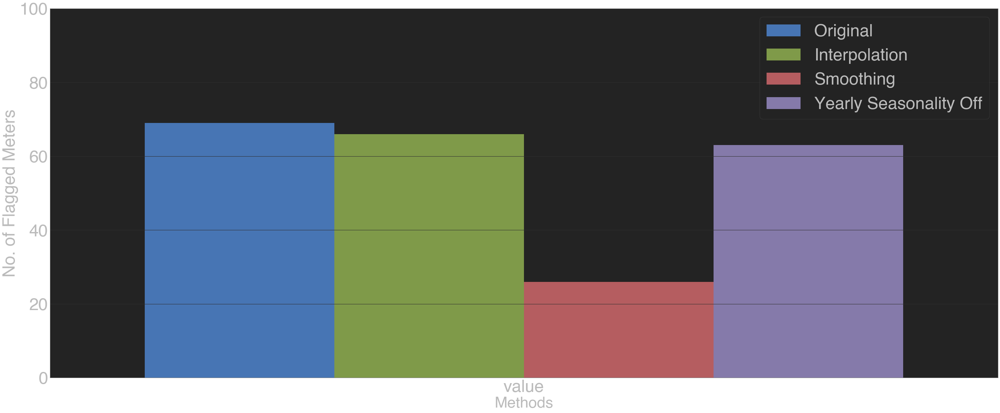

In [333]:
p=pd.DataFrame()
pl=[]
pl.append(len(flag_uniq))
p['value']=pl
p['method']='Original'
q=pd.DataFrame()
ql=[]
ql.append(len(flag_uniq1))
q['value']=ql
q['method']='Interpolation'
r=pd.DataFrame()
rl=[]
rl.append(len(flag_uniq2))
r['value']=rl
r['method']='Smoothing'
s=pd.DataFrame()
sl=[]
sl.append(len(flag_uniq3))
s['value']=sl
s['method']='Yearly Seasonality Off'
frames = [p, q, r,s]
res_df = pd.concat(frames)
from matplotlib import pyplot
import seaborn as sns
from matplotlib.cbook import boxplot_stats
d_main=res_df[['value','method']]
d_main = pd.melt(d_main, "method", var_name="groups", value_name="vals")
a4_dims = (50, 20)
fig, ax = pyplot.subplots(figsize=a4_dims)
ax.set_ylim(0,100)
sns.barplot(ax=ax,x="groups",hue="method", y="vals", data=d_main)
pyplot.xlabel('Methods', fontsize=45)
pyplot.ylabel('No. of Flagged Meters', fontsize=50)
pyplot.xticks(fontsize=50)
pyplot.yticks(fontsize=50)
pyplot.legend(fontsize=50)
pyplot.show()

In [1]:
res_df

NameError: name 'res_df' is not defined

## 1st week

In [87]:
#Main function for prediction.
from fbprophet.diagnostics import cross_validation
from fbprophet.diagnostics import performance_metrics
from datetime import datetime
def week1(met):
                    meterID_df = pd.DataFrame()
                    final=pd.DataFrame()
                    overall_sum = 0 
                    predict_list=[]
                    predict_date_list=[]
                    mape_list = []
                    met_list=[]
                    acc_list=[]
                    #matrix_df=pd.DataFrame()
                    met_list.append(met)
                    acc_met=meterIdtoAccount(met)
                    acc=acc_met['AccountNumber'].iloc[0]
                    acc_list.append(acc)
                    if  (met in meter_list):
                            meterID_df = checking_data[checking_data.MeterId == met]
                            meterID_df = meterID_df.drop(['AccountNumber','MeterId','Consumed'],axis=1)
                            final = meterID_df.reset_index()[['Usagedate','Value']].rename({'Usagedate':'ds','Value':'y'}, axis='columns')
                    for i in range(0,7,7):
                                    train = final[:len(final)-(28-i)]
                                    #Train changes throughout the loops as we should increase 1week for every training session to get the  next week predictions.
                                    actual=final[len(train):len(train)+7]
                                    #print(train)
                                    #print(meterID_df)
                                    sum_actual=actual['y'].sum()
                                    test=pd.DataFrame()
                                    if  (len(train)>=365):
                                             p = Prophet(daily_seasonality = False, weekly_seasonality = True, yearly_seasonality = True, uncertainty_samples=0,seasonality_mode='multiplicative').add_seasonality(name='quarterly',period=365.4,fourier_order=5)
                                    else:
                                             p = Prophet(daily_seasonality = False, weekly_seasonality = True, yearly_seasonality = False,uncertainty_samples=0)
                                    p.add_country_holidays(country_name='AUS') 
                                    p.fit(train)
                                    prediction = p.make_future_dataframe(periods=7 , freq='D')
                                    fore = p.predict(prediction)
                                    test['Predictions'] = fore['yhat']
                                    test['ds']=fore['ds']
                                    pred_df=pd.DataFrame()
                                    pred_df=test['Predictions']
                                    dff=pd.concat([prediction,pred_df],axis=1)
                                    sum_predictions = test['Predictions'][-7:].sum()
                                    sum_predictions_final = sum_predictions 
                                    MAPE_val = mape_new(sum_actual, sum_predictions_final)
                                    MAPE_new = round(MAPE_val, 3)
                                    mape_list.append(MAPE_new)
                                    overall_sum = overall_sum + sum_predictions
                    matrix_df = pd.DataFrame([mape_list], columns=['1st week'])
                    #larger_elements = [element for element in mape_list if element > 50]
                    #number_of_elements = len(larger_elements)
                    
                    matrix_df['meterID'] = met
                    matrix_df['type']=['flag' if matrix_df['1st week'].iloc[0]>=25 else 'unflag']  
                    return(matrix_df)

In [88]:
z_w1=[]
for a in meter_list:
    b_w1=week1(a)
    z_w1.append(b_w1)
z_w1=pd.concat(z_w1)
z_w1

Initial log joint probability = -10.369
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1161.84    0.00225846       86.2902      0.4065      0.4065      115   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     168       1162.51   4.76943e-05       76.6082   6.736e-07       0.001      231  LS failed, Hessian reset 
     199       1162.51    2.7288e-06       72.6014      0.9146      0.9146      277   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     219       1162.51   5.65861e-06       90.0866   7.342e-08       0.001      343  LS failed, Hessian reset 
     233       1162.51     1.121e-07       60.5025           1           1      370   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probability = -52.6325
    Iter      log prob        ||dx||      ||grad||    

Initial log joint probability = -3.30625
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1800.33   6.29933e-06       70.2269      0.5799      0.5799      132   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1800.49   0.000112008       103.804   1.628e-06       0.001      310  LS failed, Hessian reset 
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     292        1800.5   7.16043e-07       84.4171   6.939e-09       0.001      465  LS failed, Hessian reset 
     299        1800.5   4.33128e-08       79.9918      0.3088           1      474   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probability = -5.10368
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      79       1552.48   0.000331668       100.7

Initial log joint probability = -38.5754
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1142.12     0.0045976       307.042      0.1915      0.1915      119   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1177.63     0.0297454       98.7475           1           1      241   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     286       1184.31   0.000482662       125.769   5.656e-06       0.001      392  LS failed, Hessian reset 
     299       1184.52    0.00199986       179.843           1           1      407   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     366       1189.16   0.000396453       121.622   2.918e-06       0.001      531  LS failed, Hessian reset 
     399       1189.57    0.00516253       86.2037           1           1      570   
    Iter      log pro

Initial log joint probability = -45.9812
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1621.03    0.00104054       90.6901      0.5501      0.5501      124   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     140       1623.63   0.000411513       114.762   1.909e-06       0.001      210  LS failed, Hessian reset 
     199       1624.15   1.78406e-06       66.9554      0.3516      0.3516      288   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     285       1624.21   1.06382e-05        89.003   1.173e-07       0.001      449  LS failed, Hessian reset 
     299       1624.21   8.94587e-08       66.5591       0.913       0.913      467   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     308       1624.21   2.13355e-08       58.8303      0.1992      0.5043      481   
Optimization terminat

Initial log joint probability = -15.915
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1327.08    0.00483898       88.3155           1           1      135   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1328.01   2.37829e-06       69.5868      0.2979           1      264   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     214       1328.02   2.49884e-05        85.034   2.831e-07       0.001      336  LS failed, Hessian reset 
     299       1328.05   0.000542364       81.3868           1           1      455   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     310       1328.07   0.000121782       47.4389   1.974e-06       0.001      514  LS failed, Hessian reset 
     343       1328.09   6.07322e-06       74.1442   1.112e-07       0.001      597  LS failed, Hessian reset

Initial log joint probability = -12.4957
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1217.29    0.00875865       114.372           1           1      127   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199        1219.5   6.30425e-05       81.4399      0.3095           1      255   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     256       1219.51   2.66859e-08       60.2387     0.06526           1      333   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probability = -9.36702
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1283.38   0.000122573       77.0859           1           1      126   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
    

Initial log joint probability = -8.27553
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1621.42    0.00784064        252.76           1           1      124   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1632.82   6.21611e-05        56.034      0.4912      0.4912      250   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299        1634.3    0.00107698       87.3656       0.805       0.805      369   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     368       1636.03    0.00193511       125.504   1.448e-05       0.001      503  LS failed, Hessian reset 
     399       1637.24   0.000475379       72.8584      0.6985      0.6985      542   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     496       1637.43   0.000481278    

Initial log joint probability = -4.05439
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1873.43    0.00236859       171.022      0.6107      0.6107      128   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1879.55    0.00360246       83.7765           1           1      251   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1887.82    0.00500385       118.842           1           1      374   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399        1913.2     0.0384849       957.781           1           1      485   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1919.09   0.000184337       74.8443      0.5321      0.5321      613   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -9.1429
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1850.55     0.0042165       101.719      0.7045      0.7045      125   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1855.77    0.00203878       287.609      0.3678      0.3678      246   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1861.86    0.00248087        182.16           1           1      361   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1880.85       0.14553       382.304           1           1      478   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1906.24    0.00291202       288.029      0.2745      0.2745      595   
    Iter      log prob        ||dx||      ||grad||       alpha   

Initial log joint probability = -9.51337
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1405.77   1.83376e-05       58.9758      0.1511      0.1511      126   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     140       1405.87   0.000407928       62.0522   4.866e-06       0.001      205  LS failed, Hessian reset 
     199        1405.9    9.2675e-06       60.4231      0.3778           1      279   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     290       1406.21   0.000645497       136.518    5.81e-06       0.001      447  LS failed, Hessian reset 
     299        1406.3   0.000338085       61.8386           1           1      457   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1406.37   0.000280252       64.7333           1           1      587   
    Iter      log pro

Initial log joint probability = -4.91412
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1533.65   7.94172e-06       68.2233      0.5703      0.5703      133   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     135       1533.65   1.60784e-05       61.5356    2.21e-07       0.001      217  LS failed, Hessian reset 
     174       1533.65    7.3266e-08       62.6407      0.7149      0.7149      270   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probability = -4.28007
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1487.85    0.00209405       79.2796      0.2659           1      116   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     101       1487.87   0.000278949       98.9958   3.533e-06       0.0

Initial log joint probability = -16.7181
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1293.98    0.00461309       81.0522           1           1      122   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1294.55   1.96737e-05       47.2627      0.9712      0.9712      247   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     275       1294.62   2.25935e-05       59.2648   2.303e-07       0.001      376  LS failed, Hessian reset 
     299       1294.62   2.99743e-07        65.898        2.88       0.288      407   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     301       1294.62   2.89976e-08       63.7897     0.08589           1      411   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probabil

Initial log joint probability = -29.7304
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       866.713   8.39492e-08       60.0193      0.2064           1      135   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     100       866.713   9.26338e-08       62.0142   1.543e-09       0.001      176  LS failed, Hessian reset 
     102       866.713   3.96564e-08       59.7162      0.3673           1      179   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probability = -53.9306
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99        1306.9    0.00835161       139.127      0.7994      0.7994      124   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     141       1311.67   0.000889824       102.102   1.212e-05       0.0

Initial log joint probability = -8.69065
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1703.73    0.00137205       202.632      0.9256      0.9256      119   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     124       1705.73   0.000774967        227.85   5.818e-06       0.001      190  LS failed, Hessian reset 
     193       1708.04   0.000398871       108.892   3.916e-06       0.001      312  LS failed, Hessian reset 
     199       1708.12   0.000648007       86.7983           1           1      318   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1708.42   5.22279e-05       72.9085           1           1      440   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1708.44   2.74213e-05       85.5079           1           1      552   
    Iter      log pro

Initial log joint probability = -2.91094
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1804.34   3.78198e-06       75.8086      0.2024           1      133   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1804.47   0.000336986       82.2241      0.3356      0.9585      249   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     263       1805.04   0.000148303       99.1179   1.596e-06       0.001      361  LS failed, Hessian reset 
     295       1805.05   2.22321e-08       91.9494      0.2718      0.2718      406   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probability = -4.56656
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1716.57    0.00134215       114.887      0.8966      0.89

Initial log joint probability = -7.6967
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99        2211.9   0.000901325       243.387           1           1      131   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     161       2212.43   8.69943e-05       149.601   4.949e-07       0.001      259  LS failed, Hessian reset 
     199       2212.68   6.80868e-06       71.1052           1           1      308   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       2213.82    0.00133669       118.466           1           1      429   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       2217.88    0.00420873        153.97           1           1      546   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       2221.89    0.00811731     

Initial log joint probability = -6.42572
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1360.25   3.81082e-05       69.3904           1           1      125   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     154       1360.32   5.17976e-09       103.759   0.0001676      0.0701      206   
Optimization terminated normally: 
  Convergence detected: absolute parameter change was below tolerance
Initial log joint probability = -10.6658
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1280.17    0.00108195       114.435      0.7753      0.7753      133   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1280.71   0.000746726       82.2355      0.5934      0.5934      257   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     

Initial log joint probability = -25.7853
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1232.17   0.000864575       77.6411           1           1      133   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     144       1233.42    0.00102447       141.182   7.827e-06       0.001      221  LS failed, Hessian reset 
     199        1233.9   9.24879e-05       79.7007       1.341      0.3547      288   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1233.97   0.000175981       74.4388           1           1      417   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     345       1233.97   4.82639e-08       82.2936      0.2398           1      478   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probabil

Initial log joint probability = -5.76872
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1372.22   3.61619e-05       70.3651      0.6339      0.6339      130   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     123       1372.54   0.000864632       144.966   1.201e-05       0.001      190  LS failed, Hessian reset 
     199       1373.24    0.00127632       85.5504           1           1      280   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     210       1373.55   0.000697766       102.526   8.153e-06       0.001      339  LS failed, Hessian reset 
     260       1374.11   0.000278686       89.5751   3.409e-06       0.001      428  LS failed, Hessian reset 
     299       1374.15   0.000115946       67.0474      0.2436           1      480   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Note

Initial log joint probability = -30.005
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1175.25     0.0177512        101.81      0.6208      0.6208      114   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     167       1194.83   0.000688462       106.021   3.836e-06       0.001      250  LS failed, Hessian reset 
     199       1195.88   8.61238e-05       60.6889      0.2794      0.2794      291   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1201.94    0.00275831       65.0446      0.5161      0.5161      412   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     337       1204.39    0.00067706         115.3   7.833e-06       0.001      501  LS failed, Hessian reset 
     399       1205.03   0.000127187       74.2518           1           1      580   
    Iter      log prob

Initial log joint probability = -27.1749
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       997.489    0.00122042       74.1744           1           1      123   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1005.06   0.000574355       93.4031           1           1      235   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     221       1005.21   0.000528037       87.9851   5.418e-06       0.001      292  LS failed, Hessian reset 
     293       1005.27   9.50612e-06       92.2724   9.506e-08       0.001      430  LS failed, Hessian reset 
     299       1005.27   9.29949e-07       82.9507      0.6301      0.6301      438   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     332       1005.27   4.74851e-09       87.7002    0.006002           1      481   
Optimization terminat

Initial log joint probability = -7.05663
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1203.89   1.67509e-06       61.3414           1           1      123   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     118       1203.89   1.03722e-06       65.1794   1.311e-08       0.001      186  LS failed, Hessian reset 
     128       1203.89   5.85061e-08       63.8282      0.2093           1      202   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probability = -4.63239
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1544.16   0.000161203       57.5767           1           1      129   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     141       1544.36   0.000214527       92.9613   2.408e-06       0.0

Initial log joint probability = -9.7401
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1254.09   0.000133502        66.948      0.4582      0.6876      128   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     160       1254.11    7.4968e-08       69.4129      0.3952      0.3952      211   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probability = -8.12071
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1481.63    0.00587995       117.597           1           1      125   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     150       1482.34   9.30386e-05       93.6387   1.121e-06       0.001      244  LS failed, Hessian reset 
     199       1482.38   7.05654e-05       97.6346      0.6141      0.614

Initial log joint probability = -15.5769
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      88       1338.43    0.00315866       236.356   3.066e-05       0.001      139  LS failed, Hessian reset 
      99       1340.04     0.0038832       90.2468      0.4987      0.4987      150   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     158       1340.79   0.000753666       146.661   8.368e-06       0.001      271  LS failed, Hessian reset 
     199       1341.24    0.00189759       67.5395      0.2127           1      321   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     254       1341.39   0.000267155       77.6287   2.279e-06       0.001      423  LS failed, Hessian reset 
     299       1341.49   0.000921357       85.2385           1           1      480   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Note

Initial log joint probability = -17.6915
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1425.79     0.0037017       80.5206      0.8628      0.8628      121   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1430.23   8.63535e-07        77.134      0.2341      0.2341      260   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1430.49   8.40855e-05       91.2538      0.5202      0.5202      372   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     312       1430.89    0.00103144       195.079   1.187e-05       0.001      421  LS failed, Hessian reset 
     399       1431.09   1.83902e-07       78.9278       1.526      0.1526      537   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     412       1431.09   6.30547e-08    

Initial log joint probability = -16.2288
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1181.98     0.0123925        72.125           1           1      123   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     149       1182.49    0.00037771       75.7319   5.286e-06       0.001      225  LS failed, Hessian reset 
     199       1182.53   8.06609e-06       58.4919       0.566       0.566      291   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     221       1182.53   8.51999e-09       59.9648     0.06474        0.69      326   
Optimization terminated normally: 
  Convergence detected: absolute parameter change was below tolerance
Initial log joint probability = -9.07626
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1140.52    0.00010707       77.1731      0.3341      0.334

Initial log joint probability = -15.7825
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1037.13   6.17582e-05        63.829      0.6743      0.1483      136   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     172       1037.49   8.33333e-05       73.7008    1.17e-06       0.001      269  LS failed, Hessian reset 
     199       1037.49   1.23872e-07       55.0097      0.4584      0.4584      311   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     210       1037.49   1.14164e-06       68.6985   1.872e-08       0.001      365  LS failed, Hessian reset 
     224       1037.49   1.70108e-08       59.9287      0.3037      0.3037      387   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probability = -26.6874
    Iter      log prob        ||dx||      ||grad||   

Initial log joint probability = -9.87619
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1334.54   0.000242264       100.154      0.4063           1      128   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1336.05   8.02481e-06        93.388       0.814       0.814      243   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     229       1336.05   4.65047e-05       91.2139   4.359e-07       0.001      336  LS failed, Hessian reset 
     265       1336.06   4.47046e-08       77.5311      0.8327      0.8327      381   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probability = -11.8862
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1532.54     0.0208839       131.411           1          

Initial log joint probability = -11.6694
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1037.67   0.000333579       78.1495           1           1      118   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1037.92   2.48446e-05       76.1892      0.7518      0.7518      232   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1038.05   1.83336e-06       76.8184      0.1882           1      359   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1038.06   2.77605e-07       75.6863      0.2704           1      492   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     403       1038.06   2.20362e-07       81.4819      0.2819      0.9412      497   
Optimization terminated normally: 
  Convergence detected: relat

Initial log joint probability = -7.5224
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1359.78   6.05144e-06       70.6119      0.4644      0.4644      142   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1361.57   0.000642005       99.9208           1           1      257   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     202       1361.58   9.94201e-05       97.0763   1.044e-06       0.001      297  LS failed, Hessian reset 
     236       1361.59   3.84818e-08       93.8132      0.3615      0.3615      342   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probability = -20.7361
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1299.23   0.000704619       82.1142           1           

Initial log joint probability = -8.8529
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1189.19    0.00853462       98.2437       0.673       0.673      111   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1191.58   0.000202555       68.6259      0.4512      0.4512      233   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     282       1191.71   6.40594e-05       84.8034    8.05e-07       0.001      381  LS failed, Hessian reset 
     299       1191.71   3.32117e-06       73.5936      0.8194      0.8194      405   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     328       1191.71    3.3827e-08       65.9462     0.07691           1      447   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probabili

Initial log joint probability = -8.50343
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1184.75   0.000369868       71.5062           1           1      131   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     172          1185    0.00011275       74.2125   1.912e-06       0.001      272  LS failed, Hessian reset 
     199       1185.02   9.50843e-07       63.4716      0.3398      0.3398      309   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     228       1185.02   5.88689e-06       86.2615    8.29e-08       0.001      398  LS failed, Hessian reset 
     249       1185.02   7.68648e-09        59.824     0.07018      0.8443      425   
Optimization terminated normally: 
  Convergence detected: absolute parameter change was below tolerance
Initial log joint probability = -9.6963
    Iter      log prob        ||dx||      ||grad||     

Initial log joint probability = -16.3161
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1109.11   1.05213e-05       91.5632       0.979       0.979      120   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     108       1109.13   6.21331e-05       104.769   6.446e-07       0.001      172  LS failed, Hessian reset 
     178       1109.14   2.86412e-08       98.8035      0.3468           1      257   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probability = -11.1148
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       2112.76    0.00200497       144.034      0.9615      0.9615      126   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       2123.24    0.00353593       285.213      0.8679      0.86

Initial log joint probability = -11.2643
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      63       1199.75   0.000370961       60.3394   5.305e-06       0.001      126  LS failed, Hessian reset 
      99        1199.8   5.15016e-05       59.3539     0.04358           1      177   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     100        1199.8   8.70825e-05       78.4737   1.467e-06       0.001      218  LS failed, Hessian reset 
     159       1199.83   9.23019e-05       73.5462   1.036e-06       0.001      330  LS failed, Hessian reset 
     199       1199.84     8.001e-07       70.6333       0.702       0.702      390   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     211       1199.84   7.86189e-09       69.7762      0.1907      0.1907      406   
Optimization terminated normally: 
  Convergence detected: absolute parameter change was 

Initial log joint probability = -7.58107
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1351.93    0.00176082       121.247      0.9794     0.09794      126   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     104       1352.18   0.000574895       111.346   7.347e-06       0.001      165  LS failed, Hessian reset 
     186       1352.78    0.00097842       85.3804   1.455e-05       0.001      309  LS failed, Hessian reset 
     199       1352.84   7.18695e-05       57.5528           1           1      329   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     268       1352.85   1.12672e-07       56.2842      0.3171           1      425   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probability = -14.2416
    Iter      log prob        ||dx||      ||grad||   

Initial log joint probability = -4.73614
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1383.72   0.000143746       78.8372      0.2609      0.2609      125   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199        1383.9   8.92306e-05        90.605      0.4714      0.4714      251   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     296       1383.94   6.62363e-08       80.3279      0.6297      0.6297      383   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probability = -23.7137
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1090.48   0.000449006       45.3091      0.3877           1      119   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
    

Initial log joint probability = -6.76781
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1382.06     0.0189015       141.975           1           1      126   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1383.08   0.000521157       88.6651      0.2504           1      248   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1383.12   3.67702e-06       60.0333           1           1      374   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     301       1383.12   4.60357e-06       72.2276       0.841       0.841      376   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probability = -8.95367
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
    

Initial log joint probability = -10.8202
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1245.43    0.00672676       88.6686      0.4823           1      122   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     100       1245.44   0.000875331       90.8786   9.872e-06       0.001      162  LS failed, Hessian reset 
     193        1245.5   3.19333e-08       72.2271      0.3087      0.3087      288   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probability = -4.20423
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1559.63    0.00014326       64.9822      0.6632      0.6632      129   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1559.76   1.33275e-06       59.8439      0.4904      0.49

Initial log joint probability = -7.70089
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      90       1244.17    0.00420791       94.4447   3.646e-05       0.001      156  LS failed, Hessian reset 
      99       1244.39   0.000417094       94.2374       0.691       0.691      167   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     138       1244.57   3.68012e-05       86.8457   4.078e-07       0.001      247  LS failed, Hessian reset 
     199       1244.58   0.000474345       90.1126           1           1      320   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     205       1244.65   0.000834698        88.511   8.439e-06       0.001      362  LS failed, Hessian reset 
     299       1244.99    0.00546701       83.8593      0.3339           1      470   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Note

Initial log joint probability = -7.78454
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1223.23    2.8564e-05       79.1959      0.1484      0.1484      136   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     143        1223.3   7.32554e-05       68.9082    9.11e-07       0.001      226  LS failed, Hessian reset 
     199       1223.32   9.58126e-05       61.0538           1           1      298   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     209       1223.32   2.98852e-05       66.1415   3.371e-07       0.001      344  LS failed, Hessian reset 
     251       1223.33   1.12686e-06       59.8472   1.543e-08       0.001      441  LS failed, Hessian reset 
     263       1223.33   2.99199e-08       60.9214      0.3296      0.1189      463   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is

Initial log joint probability = -9.12665
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1274.67    0.00398845       135.945      0.3747      0.3747      117   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1278.63   0.000851249       66.5255      0.7367      0.7367      238   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299        1280.1   2.83202e-06       64.4947      0.1923           1      368   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     322        1280.1   1.77478e-07       71.2184           1           1      402   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probability = -3.66864
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
    

Initial log joint probability = -11.4807
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      74       1094.51    0.00214012       92.3952   2.364e-05       0.001      123  LS failed, Hessian reset 
      99       1094.66   1.01749e-05       78.0718      0.6293      0.6293      158   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     144       1094.77    0.00015991       89.4889   1.824e-06       0.001      256  LS failed, Hessian reset 
     189       1094.84   2.72433e-05       92.9984    3.62e-07       0.001      349  LS failed, Hessian reset 
     199       1094.84   5.29528e-07       70.5445      0.6523      0.6523      361   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     239       1094.84   2.28596e-08        86.164      0.3772      0.3772      412   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is

Initial log joint probability = -8.36955
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1207.71    0.00172593       89.8941           1           1      126   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1211.23   0.000436975       72.8764           1           1      246   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     212       1211.29   0.000186843       45.9899    2.48e-06       0.001      310  LS failed, Hessian reset 
     252        1211.3   1.39587e-08       69.8735      0.1332      0.4762      373   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probability = -14.6212
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1071.35    0.00126245       69.9649           1          

Initial log joint probability = -23.0736
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1346.92   0.000553691       65.1811           1           1      121   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     158       1349.39    0.00131998       207.372   1.254e-05       0.001      233  LS failed, Hessian reset 
     199       1349.54   0.000172931       75.5647       0.254           1      289   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1349.63   5.65472e-06        55.998      0.5744      0.5744      416   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1349.64   8.02155e-06       59.4452      0.8431      0.8431      539   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1349.65   5.29961e-05    

Initial log joint probability = -11.5431
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1308.89    0.00186839       169.646      0.4121      0.4121      136   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     125       1310.22   0.000819387       134.215   7.011e-06       0.001      209  LS failed, Hessian reset 
     199       1312.58    0.00637846        179.29      0.6334      0.6334      310   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     204       1313.21   0.000640673       111.223    4.62e-06       0.001      352  LS failed, Hessian reset 
     299       1314.55   0.000241695       81.2806      0.3594           1      472   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1315.58    3.8474e-05       74.2188      0.5489      0.5489      593   
    Iter      log pro

Initial log joint probability = -14.5893
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1060.92   8.02194e-06       94.6945      0.7534      0.7534      120   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     193       1061.08   1.27759e-06       98.7793   1.213e-08       0.001      266  LS failed, Hessian reset 
     199       1061.08   3.42215e-07       99.1947       2.258      0.2258      274   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     209       1061.08   2.79723e-08       92.4299      0.2767      0.6854      287   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probability = -7.97773
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1304.18   0.000332805       75.2947      0.1088      0.10

Initial log joint probability = -27.5858
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1185.34   8.13107e-05       61.6792          10           1      139   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     158        1185.9   0.000871462       102.282   6.516e-06       0.001      270  LS failed, Hessian reset 
     199       1186.24   0.000690389       69.8217      0.1482           1      330   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     201       1186.25   0.000164834       55.4823   2.095e-06       0.001      377  LS failed, Hessian reset 
     241       1186.26   2.32652e-05       60.4998   3.235e-07       0.001      486  LS failed, Hessian reset 
     257       1186.26   2.55708e-08        50.581      0.2098      0.2098      517   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is

Initial log joint probability = -18.8974
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      76       1262.81   0.000886511       95.5195   6.686e-06       0.001      127  LS failed, Hessian reset 
      99       1264.11    0.00679924       96.4236           1           1      154   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     121        1264.7    0.00134282       100.622   1.849e-05       0.001      222  LS failed, Hessian reset 
     199       1267.87    0.00659959       89.4116       2.994      0.7937      316   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1268.65   0.000510162       80.2674           1           1      435   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     363       1268.72   0.000365981       66.1807   3.443e-06       0.001      560  LS failed, Hessian rese

Initial log joint probability = -7.13111
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1308.77     0.0233088       138.845           1           1      116   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1321.85   0.000126057        79.181      0.8946      0.8946      241   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     255       1322.15   0.000210459       69.8514   3.406e-06       0.001      345  LS failed, Hessian reset 
     299       1322.27   2.55695e-05       89.1998      0.3622           1      405   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     354       1322.28   6.68779e-05       82.8568   7.141e-07       0.001      525  LS failed, Hessian reset 
     379       1322.28   1.11172e-07       56.8983           1           1      559   
Optimization terminat

Initial log joint probability = -6.01774
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1393.03     0.0127827        86.142      0.4891           1      123   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1397.43   0.000124758       89.7569      0.3125           1      250   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     290       1397.49   0.000215107       78.0573   3.314e-06       0.001      409  LS failed, Hessian reset 
     299        1397.5   6.66859e-05        57.457           1           1      421   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     328       1397.51   5.61393e-07       63.3072   1.003e-08       0.001      493  LS failed, Hessian reset 
     344       1397.51   3.70198e-08       58.6258       0.324           1      519   
Optimization terminat

Initial log joint probability = -16.8723
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1208.77     0.0310731       142.172           1           1      121   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     139       1226.92    0.00351278       273.267   2.832e-05       0.001      199  LS failed, Hessian reset 
     199       1233.76    0.00391881        137.81       0.674       0.674      271   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     214       1236.71    0.00305136       292.866   2.064e-05       0.001      319  LS failed, Hessian reset 
     299       1243.07     0.0048999        141.54      0.8258      0.8258      420   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     367        1257.5    0.00191106       174.185   1.745e-05       0.001      534  LS failed, Hessian rese

Initial log joint probability = -3.83075
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1609.41   9.21519e-06       83.7781      0.8753      0.8753      123   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     131       1609.41   6.52345e-08       81.6541      0.3885           1      165   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probability = -6.02489
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1553.66     0.0264061       157.625      0.3991           1      127   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1578.06     0.0201008       291.868      0.4869           1      242   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
    

Initial log joint probability = -4.2332
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1711.47   7.40515e-06       85.6745      0.2533      0.2533      127   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1711.57   1.06125e-05       88.7727           1           1      265   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299        1711.6   3.02236e-06        69.401       2.011      0.2011      389   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     319        1711.6   3.25712e-08       101.017    0.005279           1      419   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probability = -7.79127
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     

Initial log joint probability = -7.05504
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1808.45   0.000122545       72.8567      0.7143      0.7143      132   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     122       1808.74   0.000116845       80.0633   1.292e-06       0.001      192  LS failed, Hessian reset 
     199       1808.84   9.16129e-06       90.8834      0.5558      0.5558      289   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     236       1808.87   0.000311025       108.644    2.77e-06       0.001      364  LS failed, Hessian reset 
     299       1808.89   8.05482e-07       88.3574           1           1      455   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     318       1808.89   8.34144e-08       63.5241           1           1      480   
Optimization terminat

Initial log joint probability = -37.2409
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1149.45     0.0484984       298.625      0.8145      0.8145      125   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     152       1160.84    0.00230756       206.368   2.403e-05       0.001      223  LS failed, Hessian reset 
     199       1161.55    0.00941638       89.7767           1           1      295   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     270       1164.64   0.000101862       68.7023   1.378e-06       0.001      428  LS failed, Hessian reset 
     299       1164.66   3.72561e-05       80.2778           1           1      470   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     330       1164.67   0.000196144       75.7946   2.861e-06       0.001      559  LS failed, Hessian rese

Initial log joint probability = -12.3189
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1582.63    0.00785304       152.188           1           1      127   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1587.19    0.00114211       87.0952           1           1      256   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1587.46   0.000108234       92.3756      0.3233      0.3233      376   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     342       1587.47   2.34325e-08       74.4876      0.2023           1      431   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probability = -17.659
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     

Initial log joint probability = -3.53735
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1811.49    0.00560608       245.679      0.3219           1      128   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1818.64     0.0021104       241.589           1           1      254   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     280       1824.48   0.000305876        172.52    2.72e-06       0.001      381  LS failed, Hessian reset 
     299       1824.66   0.000395556        93.161      0.8779      0.8779      402   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1827.12    0.00978005       137.251           1           1      521   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     496       1831.27   0.000436593    

Initial log joint probability = -8.35732
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1226.62    0.00226232        89.723     0.05582           1      137   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     160        1226.8   2.39247e-05       70.5893   3.235e-07       0.001      257  LS failed, Hessian reset 
     199       1226.81   7.00906e-07       61.9686           1           1      311   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     208       1226.81   5.42719e-08       50.6933     0.06079           1      328   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probability = -6.64539
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1210.41   5.55016e-05       85.7395           1          

Initial log joint probability = -8.70078
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1162.58    0.00390947        120.06       0.467           1      115   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199        1165.2   6.99921e-06        63.973       2.132      0.7998      245   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     287       1165.24    1.6807e-05       67.7654   1.783e-07       0.001      407  LS failed, Hessian reset 
     299       1165.24   4.49421e-06       80.7599       1.845      0.1845      428   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     332       1165.24   1.33387e-07       62.3733           1           1      470   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probabil

Initial log joint probability = -7.45461
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       2790.04      0.014979       348.505           1           1      125   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       2800.73   0.000534942       608.063       0.253           1      234   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       2807.04   0.000325105       543.076      0.5754      0.5754      349   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     356       2809.48   2.15942e-05       202.378   7.123e-08       0.001      456  LS failed, Hessian reset 
     399       2812.51    0.00329409       567.896           1           1      508   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       2815.01    0.00106043    

Initial log joint probability = -14.4793
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99        1705.6   6.15858e-05       86.2688           1           1      124   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1705.74   0.000191715       98.8088      0.9275      0.9275      246   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     235       1705.75    1.1039e-07       82.6564      0.8616      0.8616      293   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probability = -9.41267
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1409.62     0.0140998       185.617      0.5362      0.5362      118   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
    

Initial log joint probability = -4.08222
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       2001.09    0.00135868       138.568      0.3588           1      115   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       2008.59    0.00350854       645.318    0.008669           1      231   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       2013.46     0.0012223       278.917           1           1      358   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399        2015.8   6.91688e-05       65.6713           1           1      477   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     430       2016.32   0.000210412       211.142   1.398e-06       0.001      550  LS failed, Hessian reset 
     499       2016.62   0.000610047    

Initial log joint probability = -34.0804
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       817.801    0.00271195        61.747       2.453      0.2453      132   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     137       818.418   0.000474916        60.594   7.437e-06       0.001      207  LS failed, Hessian reset 
     173       818.431   7.73619e-09       54.5501     0.07139     0.07139      268   
Optimization terminated normally: 
  Convergence detected: absolute parameter change was below tolerance
Initial log joint probability = -5.97565
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1416.15     0.0017328       78.7372           1           1      118   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     124        1416.4   0.000383086       79.3252   4.924e-06       0.00

Initial log joint probability = -28.0245
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1262.82   7.71306e-05       66.3388       0.226       0.226      128   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     112       1262.98   0.000447882       101.576    5.88e-06       0.001      199  LS failed, Hessian reset 
     149       1263.02   2.91328e-05       72.0843   3.782e-07       0.001      289  LS failed, Hessian reset 
     177       1263.02   8.51179e-08        65.933      0.3083           1      331   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probability = -24.4255
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      92        1319.9    0.00117572       89.2592   1.704e-05       0.001      151  LS failed, Hessian reset 
      99       1319.99   0.00

Initial log joint probability = -4.5285
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99        1551.7    0.00761107       253.622        6.63       0.663      121   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     103       1551.99   0.000325199       88.7268   2.413e-06       0.001      160  LS failed, Hessian reset 
     144       1552.14   9.54889e-08       63.2941       1.314      0.1314      224   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probability = -19.0257
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1390.46   0.000767727       88.7606      0.7068      0.7068      119   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     131       1390.54   0.000553989       74.4713   7.175e-06       0.00

Initial log joint probability = -32.2752
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1258.12    0.00024388       53.2653      0.6743      0.6743      114   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     191        1258.3    2.2239e-08       58.4333     0.06754           1      262   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probability = -18.3091
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       891.435   0.000186162       102.443           1           1      128   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     198       891.766   0.000109735       75.6876   1.367e-06       0.001      298  LS failed, Hessian reset 
     199       891.768   9.12724e-05       86.0591           1          

Initial log joint probability = -13.4775
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      80       969.567   0.000762171       64.9033   1.057e-05       0.001      145  LS failed, Hessian reset 
      99         969.6   1.32802e-05       69.3324      0.1665           1      176   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       969.951    0.00409328       75.8164           1           1      306   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     262       974.279   0.000408999       65.6409   4.719e-06       0.001      408  LS failed, Hessian reset 
     299         974.3   9.48691e-08       54.1687      0.9561      0.2498      464   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     303         974.3   7.37956e-08        60.163       0.828       0.828      471   
Optimization terminat

Initial log joint probability = -6.52885
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1209.77   7.84243e-06         81.55      0.2541      0.6561      125   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     171       1209.87   3.58935e-06       81.1682   4.756e-08       0.001      253  LS failed, Hessian reset 
     199       1209.87   4.17294e-08       69.8323      0.2149           1      288   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probability = -32.6912
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1001.24   0.000269545       75.5998           1           1      136   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     159       1001.53   8.94551e-06       69.9498   1.298e-07       0.0

Initial log joint probability = -5.90801
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1625.06   0.000134928       74.3917           1           1      136   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     126       1625.17   0.000278517       79.8439   1.503e-06       0.001      209  LS failed, Hessian reset 
     164       1625.24   4.86771e-05       77.3876   6.421e-07       0.001      287  LS failed, Hessian reset 
     191       1625.25   1.32975e-07       65.6437      0.1638           1      330   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probability = -2.87901
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1968.95    0.00569682       244.425      0.8271      0.8271      126   
    Iter      log prob        ||dx||      ||grad||   

Initial log joint probability = -4.40439
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1815.28     0.0040972       254.523      0.5981      0.5981      125   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1833.41     0.0683583       336.307           1           1      234   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1849.52    0.00635708       106.649      0.3948           1      349   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     365       1859.95   0.000174187       113.585   9.389e-07       0.001      474  LS failed, Hessian reset 
     399       1864.73    0.00191498       159.887      0.6521      0.6521      514   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     450       1867.91   0.000171194    

Initial log joint probability = -2.73104
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1973.04   0.000458825       114.098           1           1      121   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1974.07    0.00122927       76.2757      0.8142      0.8142      242   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     290       1974.31   8.65187e-05       82.6563   8.876e-07       0.001      407  LS failed, Hessian reset 
     299       1974.38   0.000800503        124.41           1           1      418   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     382       1974.47   2.37772e-05       61.9196   2.475e-07       0.001      561  LS failed, Hessian reset 
     399       1974.47    2.0598e-06       60.3414     0.06882           1      582   
    Iter      log pro

Initial log joint probability = -19.8918
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1557.68     0.0365189       392.875      0.1775           1      121   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199        1577.4    0.00569394       84.4538       0.375           1      236   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1589.23   0.000957842       73.0736      0.2047      0.8635      356   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1594.44    0.00215525       68.4525      0.8136      0.8136      477   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     445       1597.58    0.00161232       259.208   1.021e-05       0.001      572  LS failed, Hessian reset 
     481       1598.89   0.000372454    

Initial log joint probability = -5.97126
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      67       1529.86   0.000212929       64.8345   2.443e-06       0.001      129  LS failed, Hessian reset 
      94       1529.89   6.24544e-05       75.0124   7.732e-07       0.001      197  LS failed, Hessian reset 
      99       1529.89   2.91865e-05       70.6095      0.2482           1      204   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1529.91   0.000106931       70.6568      0.4964      0.4964      342   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1530.12   8.08934e-06       46.2938      0.3752           1      460   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     326       1530.12   9.48041e-06       84.0968   1.326e-07       0.001      535  LS failed, Hessian rese

Initial log joint probability = -20.4668
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1570.67   0.000625718       42.2504           1           1      131   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     131       1570.89   0.000478223       68.3824   8.392e-06       0.001      212  LS failed, Hessian reset 
     199       1571.47    0.00611062       72.9804      0.2212           1      289   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1572.34    0.00613927       53.2504           1           1      420   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1573.16   0.000211429       65.0363      0.2981           1      547   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     487       1573.31    1.5097e-05    

Initial log joint probability = -24.6886
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1191.36    0.00136892       77.9791           1           1      124   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     155       1191.67   2.66709e-09       78.2629    0.001677      0.6213      203   
Optimization terminated normally: 
  Convergence detected: absolute parameter change was below tolerance
Initial log joint probability = -6.91138
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1301.29     0.0225687       128.647           1           1      130   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1306.17    0.00194249       80.3005           1           1      250   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     

Initial log joint probability = -99.5877
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      73       665.046    0.00570335        72.383   6.572e-05       0.001      126  LS failed, Hessian reset 
      99       665.472   0.000599936       68.0057      0.3767           1      167   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     103       665.498   0.000402355       64.7783   6.753e-06       0.001      201  LS failed, Hessian reset 
     199       668.507   0.000896721       69.7086      0.3337           1      336   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     225       668.625   0.000554466       74.2531   6.496e-06       0.001      409  LS failed, Hessian reset 
     247       668.639   8.55579e-06       61.8479   1.949e-07       0.001      471  LS failed, Hessian reset 
     299        668.64    9.7552e-07        60.191           1   

Initial log joint probability = -37.9392
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      79       1261.42    0.00343893       311.267   1.546e-05       0.001      135  LS failed, Hessian reset 
      99          1263   0.000766844       69.4383           1           1      157   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1266.83    0.00064749       62.3772       1.916      0.4613      287   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     284       1270.19   0.000498617       83.4701   6.393e-06       0.001      433  LS failed, Hessian reset 
     299       1270.31   0.000156209       94.1207           1           1      453   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     395       1270.34   1.49977e-07       68.7092           1           1      580   
Optimization terminat

Initial log joint probability = -6.42833
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1279.53    0.00728216       82.7349           1           1      126   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1279.88   0.000203608       74.8052       2.503      0.2503      261   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     287       1280.02   0.000196565        74.587   2.382e-06       0.001      417  LS failed, Hessian reset 
     299       1280.03   1.37995e-05       69.3503       0.299           1      431   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1280.09   1.84433e-05       90.1943      0.3891      0.3891      553   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     489       1280.28   0.000417894    

Initial log joint probability = -4.44226
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1578.33     0.0012691        91.179      0.3938      0.3938      118   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     120        1579.2    0.00121696       212.227   1.363e-05       0.001      180  LS failed, Hessian reset 
     165       1579.59   0.000417823       59.2882   4.433e-06       0.001      277  LS failed, Hessian reset 
     199       1579.62   5.02215e-06       73.3419           1           1      328   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     208       1579.62   6.94954e-05       85.1093    8.33e-07       0.001      377  LS failed, Hessian reset 
     265       1579.73   0.000971144       94.8102   1.149e-05       0.001      496  LS failed, Hessian reset 
     299       1579.78   2.47758e-06       48.5288      0.5629   

Initial log joint probability = -4.86985
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99        2000.1    0.00187705       709.255      0.4832           1      118   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       2071.48    0.00261161       226.494           1           1      229   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     253       2080.23   0.000122135       171.602   9.586e-07       0.001      330  LS failed, Hessian reset 
     299       2086.38     0.0569958       992.403           1           1      387   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       2110.16    0.00564683       173.036           1           1      515   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       2116.94   0.000935448    

Initial log joint probability = -32.3055
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1166.01   6.62766e-05       67.1216      0.1847      0.1847      134   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     138       1166.19   0.000138848       77.5755   1.818e-06       0.001      234  LS failed, Hessian reset 
     199       1166.23   3.64594e-06       71.9777           1           1      312   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     242       1166.24   1.23526e-07       68.3726           1           1      372   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probability = -3.21779
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1949.42    0.00537332       250.035      0.7688      0.76

Initial log joint probability = -3.03984
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1897.72      0.024202       281.736           1           1      126   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     169        1903.1   0.000230402       107.183   6.931e-07       0.001      247  LS failed, Hessian reset 
     199        1903.3   5.01701e-05       77.3414      0.7666      0.7666      285   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299        1903.8   0.000340511       112.208      0.5315      0.5315      403   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1903.99   0.000111554       62.1341           1           1      527   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     413       1903.99   1.94752e-05    

Initial log joint probability = -7.20481
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1395.35     0.0281135       204.367      0.5191      0.5191      128   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     187       1401.18   0.000597381       105.499   3.444e-06       0.001      274  LS failed, Hessian reset 
     199       1401.46   0.000140661       69.0191      0.5138      0.5138      288   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1403.01    0.00423632       84.2742      0.3345           1      417   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1403.87    0.00101868       63.6444      0.9429      0.9429      536   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     433       1403.96   0.000472942    

Initial log joint probability = -7.82748
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1262.58    0.00672691       81.6092      0.7331      0.7331      124   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1266.89   4.40174e-07       62.0125      0.2423           1      271   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     282       1266.97   0.000150817       60.0704   2.578e-06       0.001      421  LS failed, Hessian reset 
     299       1266.98   2.51704e-05       74.8522           1           1      446   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     317       1266.98   5.41906e-08       45.9208      0.1868           1      475   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probabil

Initial log joint probability = -3.1321
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1782.16    0.00448348       92.1119           1           1      134   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     159       1782.83   7.70063e-05       67.5096    9.75e-07       0.001      244  LS failed, Hessian reset 
     199       1782.85    4.1299e-05       83.7261      0.7594      0.7594      294   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     298       1782.98   0.000246701        77.755   3.298e-06       0.001      458  LS failed, Hessian reset 
     299       1782.98   0.000196932       78.2921           1           1      459   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     365       1783.03   3.81139e-05       89.1503   4.141e-07       0.001      590  LS failed, Hessian reset

Initial log joint probability = -16.7879
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      77       997.898    0.00266979       110.383   2.619e-05       0.001      150  LS failed, Hessian reset 
      99       998.289   0.000454547        105.53      0.8657      0.8657      178   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     165       998.349   2.40849e-05       106.872   2.479e-07       0.001      306  LS failed, Hessian reset 
     198       998.354   2.38808e-08          97.1        0.43           1      348   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probability = -4.49608
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1933.59    0.00181782        263.62      0.2518      0.8053      122   
    Iter      log prob        ||dx||      ||grad||   

Initial log joint probability = -9.18922
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1069.09   0.000541346       90.6554           1           1      125   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     103       1069.21   0.000798477       79.3189    9.07e-06       0.001      160  LS failed, Hessian reset 
     143       1069.31   0.000129801        88.909   1.267e-06       0.001      245  LS failed, Hessian reset 
     199       1069.32   3.14595e-06       83.8674      0.4685      0.4685      312   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     203       1069.32   2.54497e-06       94.2185   2.761e-08       0.001      353  LS failed, Hessian reset 
     224       1069.32   5.01705e-08       90.0678      0.7639      0.7639      378   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is

Initial log joint probability = -2.02174
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      87       3891.13   2.14857e-07       94.9664      0.9672      0.9672      112   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probability = -2.02174
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      87       3891.13   2.14857e-07       94.9664      0.9672      0.9672      112   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probability = -2.02174
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      87       3891.13   2.14857e-07       94.9664      0.9672      0.9672      112   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint prob

Initial log joint probability = -2.02174
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      64       3885.19   1.01123e-07       77.7916      0.2438           1       85   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probability = -2.02174
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      64       3885.19   1.01123e-07       77.7916      0.2438           1       85   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probability = -27.0401
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      93        1196.7   0.000852522       112.235   8.007e-06       0.001      149  LS failed, Hessian reset 
      99       1196.74   0.000201322       51.2782           1           1      156   
    Iter      log

Initial log joint probability = -5.45051
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1549.69     0.0010519       92.3069      0.3477           1      122   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1549.78   0.000168265       88.0456           1           1      249   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     204       1549.79   0.000112755       71.4958   9.566e-07       0.001      338  LS failed, Hessian reset 
     265       1549.82     5.539e-09       80.4537     0.05781     0.05781      416   
Optimization terminated normally: 
  Convergence detected: absolute parameter change was below tolerance
Initial log joint probability = -10.6484
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1223.09    0.00142486       93.3882           1           

Initial log joint probability = -12.3584
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1504.55    0.00404217       94.1509           1           1      126   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     155       1507.27   0.000605873       138.406   3.093e-06       0.001      232  LS failed, Hessian reset 
     198       1508.88   8.33602e-05       77.0874   1.273e-06       0.001      323  LS failed, Hessian reset 
     199       1508.88   7.47417e-05       67.1537           1           1      324   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     241       1508.89   3.86632e-08       63.9881      0.1869           1      379   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probability = -8.91208
    Iter      log prob        ||dx||      ||grad||   

Initial log joint probability = -6.53874
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1439.76   0.000540083       68.2026      0.8267      0.8267      124   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     146       1440.06    6.5078e-05       77.8466   7.265e-07       0.001      218  LS failed, Hessian reset 
     192       1440.06   6.76607e-08       86.0601      0.2752           1      282   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probability = -20.1938
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      84       1292.06   0.000326202        82.457   4.238e-06       0.001      137  LS failed, Hessian reset 
      99       1292.08    6.2224e-06       65.2609      0.2788      0.2788      160   
    Iter      log prob        ||dx||      ||grad||   

Initial log joint probability = -10.1696
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1518.47    0.00194592       103.352      0.3295           1      136   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1520.78   4.54522e-05        83.028      0.6154      0.6154      263   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299        1521.2   0.000967915       71.7962           1           1      381   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     381       1521.27    2.9747e-06        73.277   4.221e-08       0.001      519  LS failed, Hessian reset 
     396       1521.27   1.44067e-07       62.3931           1           1      539   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probabil

Initial log joint probability = -7.08259
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1372.88    0.00033322        91.453      0.7053      0.7053      121   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1374.41   0.000527414        71.257      0.4675           1      238   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1374.44    2.4154e-05       93.6779           1           1      364   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     306       1374.47    0.00031158       86.5941    2.98e-06       0.001      412  LS failed, Hessian reset 
     362        1374.5   9.83807e-08        88.902           1           1      490   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probabil

Initial log joint probability = -9.11356
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1455.29    0.00134542       116.511      0.5292      0.5292      130   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     106       1456.07    0.00405972        121.26   4.339e-05       0.001      177  LS failed, Hessian reset 
     199       1456.92   4.43015e-05       73.6496      0.2737           1      288   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299          1457   0.000194636       59.8357     0.01903      0.8158      416   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     301          1457   5.42861e-05       69.1883   8.179e-07       0.001      493  LS failed, Hessian reset 
     362       1457.03   8.82643e-08        61.752           1           1      580   
Optimization terminat

Initial log joint probability = -2.02174
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      64       3885.19   1.01123e-07       77.7916      0.2438           1       85   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probability = -2.02174
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      64       3885.19   1.01123e-07       77.7916      0.2438           1       85   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probability = -2.02174
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      64       3885.19   1.01123e-07       77.7916      0.2438           1       85   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint prob

Initial log joint probability = -6.34754
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1598.73     0.0134223       343.961           1           1      130   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     180       1604.04   0.000684319       257.186   2.715e-06       0.001      272  LS failed, Hessian reset 
     199       1605.52    0.00211462       83.7555       1.106      0.3586      297   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299        1605.9   0.000236624       91.8881           1           1      429   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     308       1605.99   0.000665523       219.846   5.585e-06       0.001      473  LS failed, Hessian reset 
     356       1606.07   7.55615e-08       63.6482      0.1719           1      538   
Optimization terminat

Initial log joint probability = -7.32389
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      67       1353.01    0.00094026        137.56   1.086e-05       0.001      123  LS failed, Hessian reset 
      87        1353.6   0.000666784        117.72   7.508e-06       0.001      192  LS failed, Hessian reset 
      99       1353.71    0.00010705       59.7081      0.8757      0.8757      208   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     147       1353.87   0.000425807       73.8519   4.873e-06       0.001      301  LS failed, Hessian reset 
     190        1353.9   1.30442e-05       62.5155    1.69e-07       0.001      396  LS failed, Hessian reset 
     199        1353.9   1.19108e-06       63.1636      0.2293           1      409   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     269       1353.91   6.95755e-08       74.6619      0.2096   

Initial log joint probability = -14.0857
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      98       1481.36    7.8735e-06       69.9816   1.295e-07       0.001      154  LS failed, Hessian reset 
      99       1481.36   4.30576e-06        59.429           1           1      155   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     114       1481.36   1.50252e-08       59.9498     0.09597           1      183   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probability = -2.02174
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      64       3885.19   1.01123e-07       77.7916      0.2438           1       85   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probability = -2.02174
    Iter      log

Initial log joint probability = -2.02174
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      64       3885.19   1.01123e-07       77.7916      0.2438           1       85   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probability = -25.0787
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1262.92     0.0159172       226.534           1           1      126   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     106        1263.6    0.00071943        130.93   4.476e-06       0.001      175  LS failed, Hessian reset 
     194       1264.73   2.01258e-05       64.9736   2.629e-07       0.001      341  LS failed, Hessian reset 
     199       1264.73    7.1604e-06          64.9           1           1      348   
    Iter      log prob        ||dx||      ||grad||   

Initial log joint probability = -4.78193
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      96       1518.12   0.000125052       76.0902   1.498e-06       0.001      159  LS failed, Hessian reset 
      99       1518.12   0.000110138       77.7856           1           1      162   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     176       1518.13   1.66368e-05       70.0161   2.372e-07       0.001      319  LS failed, Hessian reset 
     193       1518.13   7.13867e-08        45.027     0.09658           1      345   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probability = -6.26766
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       2239.41    0.00252425       214.483       0.435       0.435      122   
    Iter      log prob        ||dx||      ||grad||   

Initial log joint probability = -4.58143
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1548.81   2.37875e-06       102.701      0.7954      0.7954      126   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1549.02    3.1344e-07       93.1301      0.7558      0.7558      247   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     222       1549.02   4.57365e-08       82.7689      0.4337      0.4337      275   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probability = -40.1479
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      84       1068.42    0.00265806       179.184   2.781e-05       0.001      151  LS failed, Hessian reset 
      99       1069.11   0.000744585       49.6607      0.7912      0.79

Initial log joint probability = -11.0457
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1377.81     0.0264142       227.373      0.1708      0.7517      126   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     189       1382.71   0.000470854       83.2733   3.378e-06       0.001      276  LS failed, Hessian reset 
     199       1383.14   0.000909626       56.9719      0.3918           1      289   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     252       1383.76   0.000284088       94.1652   3.431e-06       0.001      387  LS failed, Hessian reset 
     299       1383.77   1.19625e-05       77.8913       0.362           1      452   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     328       1385.41    0.00253614       274.932   2.315e-05       0.001      531  LS failed, Hessian rese

Initial log joint probability = -18.1224
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1306.66     0.0281941       230.498      0.2019           1      124   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     178       1314.36   0.000728322       117.389   4.284e-06       0.001      262  LS failed, Hessian reset 
     199       1315.51   0.000168996       80.2088      0.3903      0.3903      287   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     230       1315.66   0.000331559       72.9438   5.672e-06       0.001      380  LS failed, Hessian reset 
     299       1316.89     0.0416671       191.957      0.1848           1      465   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     300       1317.22    0.00380611       266.593   1.983e-05       0.001      499  LS failed, Hessian rese

Initial log joint probability = -13.2632
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      53       1022.47    0.00043639       71.7852   5.899e-06       0.001       96  LS failed, Hessian reset 
      99       1022.67    0.00277141       68.8637           1           1      148   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1025.36   0.000193957         81.76           1           1      280   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1025.45   5.48476e-05       88.3186           1           1      411   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     349       1025.46   1.04515e-07       64.2499      0.8833      0.8833      475   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probabil

Initial log joint probability = -27.5099
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1166.76    2.6272e-05       74.8386           1           1      145   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1167.35   1.68667e-05       79.9559      0.9774      0.9774      276   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1167.38   0.000391274       66.6537      0.8116      0.8116      410   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     326       1167.46   0.000270954       75.1702    3.25e-06       0.001      491  LS failed, Hessian reset 
     354       1167.48   3.55802e-08       68.4778      0.4037      0.4037      533   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probabil

Initial log joint probability = -13.6611
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1755.55   0.000126872       65.4089      0.8025      0.8025      125   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     124       1755.71   0.000122009       80.6156   1.782e-06       0.001      189  LS failed, Hessian reset 
     199          1756   0.000210391       70.3054      0.8378      0.8378      276   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1756.12   5.53491e-06       54.7932       0.245           1      409   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     357       1756.17   5.32422e-06       78.0938   8.221e-08       0.001      537  LS failed, Hessian reset 
     384       1756.17   8.76443e-06       89.7233    1.08e-07       0.001      612  LS failed, Hessian rese

Initial log joint probability = -2.30803
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      48       2091.19   6.12722e-05       76.5998   4.837e-07       0.001      113  LS failed, Hessian reset 
      99       2091.39   2.59301e-05       65.5042           1           1      186   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     186       2091.59   6.20934e-06       56.4613   1.023e-07       0.001      327  LS failed, Hessian reset 
     199       2091.59   8.06794e-08       59.8301      0.2978      0.2978      348   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     201       2091.59   8.91214e-09       59.5821     0.05623           1      353   
Optimization terminated normally: 
  Convergence detected: absolute parameter change was below tolerance
Initial log joint probability = -3.59944
    Iter      log prob        ||dx||      ||grad||    

Initial log joint probability = -17.5339
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1433.75   4.00453e-05       88.4797     0.07796    0.007796      139   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     149       1433.88    0.00031111       85.4055   3.354e-06       0.001      236  LS failed, Hessian reset 
     199       1433.92   7.89675e-05       76.9055      0.4173           1      295   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     216       1434.12   0.000641447       140.762   3.587e-06       0.001      361  LS failed, Hessian reset 
     299       1434.27   2.88084e-06       75.8689      0.2199           1      478   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     325       1434.28   4.21616e-05       86.3094   4.977e-07       0.001      565  LS failed, Hessian rese

Initial log joint probability = -24.7899
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1160.01   1.42909e-06       73.0488      0.1802           1      128   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     152       1160.03   0.000100359       67.2699   1.167e-06       0.001      238  LS failed, Hessian reset 
     179       1160.03   8.19153e-08       63.3193           1           1      282   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probability = -19.8743
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      95        1215.7    0.00315459       129.961   7.183e-05       0.001      148  LS failed, Hessian reset 
      99       1215.83    0.00276178       126.529           1           1      152   
    Iter      log prob        ||dx||      ||grad||   

Initial log joint probability = -8.85558
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      85       1285.85     0.0017927       79.6211   1.935e-05       0.001      142  LS failed, Hessian reset 
      99       1285.94   8.49053e-05       83.2732      0.3575           1      159   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     189       1288.01    0.00166666       94.6488   1.401e-05       0.001      308  LS failed, Hessian reset 
     199       1288.13   0.000100714       89.0764      0.3968           1      322   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     234       1288.27    0.00105122       117.387   9.515e-06       0.001      388  LS failed, Hessian reset 
     276       1288.39   4.85671e-08        89.806      0.6584      0.6584      447   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is

Initial log joint probability = -12.062
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1345.28    0.00990953       167.328      0.2778           1      118   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     131       1347.55    0.00199225       248.255   1.678e-05       0.001      192  LS failed, Hessian reset 
     161        1348.4    0.00411348       86.8215   4.686e-05       0.001      263  LS failed, Hessian reset 
     199       1348.67   4.72967e-05       82.5541      0.1852           1      315   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     254       1348.69   1.66331e-07       83.5602           1           1      393   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probability = -23.4719
    Iter      log prob        ||dx||      ||grad||    

Initial log joint probability = -4.73525
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       2077.87     0.0103287       499.434           1           1      113   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       2089.43    0.00335752       400.329           1           1      236   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       2093.19   0.000338542       125.269      0.2418           1      357   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       2095.72   0.000371014       92.6631           1           1      478   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       2097.07   0.000248316       160.693       0.431       0.431      603   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -3.34369
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1711.82   0.000776705       97.7316       1.198      0.1198      128   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     174       1711.88   4.66183e-08        72.276      0.7002      0.7002      219   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probability = -7.91734
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       2937.84   0.000351058         401.2           1           1      123   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       2963.33    0.00039552       498.295      0.4989      0.4989      234   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
    

Initial log joint probability = -4.32092
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1606.28   9.25998e-05       83.5828           1           1      130   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199        1606.9   3.45392e-06       84.0401      0.3727      0.8623      248   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     255        1606.9   9.96899e-08       93.7766      0.3742           1      322   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probability = -24.7086
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       929.573   0.000150525       74.4229       0.395       0.395      124   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
    

Initial log joint probability = -16.2908
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1679.57    0.00748051       120.597           1           1      118   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1694.45   0.000959026       175.973      0.8075      0.8075      235   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299        1701.2   0.000294309       91.6036           1           1      366   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     356       1701.39   0.000553476       76.4571   6.505e-06       0.001      479  LS failed, Hessian reset 
     399       1701.44   4.14609e-05       84.5672           1           1      542   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1701.94   0.000208663    

Initial log joint probability = -24.124
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      98       1009.11   0.000219023       64.4718   3.766e-06       0.001      170  LS failed, Hessian reset 
      99       1009.11   0.000137128       78.5469           1           1      171   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     176       1009.16   2.95702e-05       69.1362   3.713e-07       0.001      306  LS failed, Hessian reset 
     199       1009.16   2.57158e-05       63.9244           1           1      334   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     218       1009.16   6.38785e-08       57.5171      0.4585      0.4585      355   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probability = -5.73558
    Iter      log prob        ||dx||      ||grad||    

Initial log joint probability = -10.0783
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      59       1174.65   0.000205817       79.6969   2.832e-06       0.001      119  LS failed, Hessian reset 
      97       1174.67   7.49659e-08       56.1899      0.6505      0.6505      168   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probability = -7.0388
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1554.94   0.000639411       68.2997      0.2438      0.2438      124   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199        1555.7   4.60331e-05       78.0464           1           1      243   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1555.99    0.00280485        97.685           1           

Initial log joint probability = -3.63063
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       2233.24    0.00742824       543.265           1           1      117   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       2237.39    0.00275182       210.289           1           1      237   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     201        2237.6   0.000111541       215.693   3.272e-07       0.001      281  LS failed, Hessian reset 
     299       2238.72   6.14079e-05       65.3142       0.385       0.385      402   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       2240.97     0.0026718       243.871           1           1      522   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       2241.73   5.85523e-05    

Initial log joint probability = -51.7276
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1491.55    0.00479539       68.3395      0.8055      0.8055      127   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     141       1498.01    0.00369204       133.166   2.481e-05       0.001      209  LS failed, Hessian reset 
     199       1501.69    0.00147859        87.699           1           1      280   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     214       1502.85    0.00521903       268.714   6.105e-05       0.001      344  LS failed, Hessian reset 
     299        1504.4    0.00022922       61.8005      0.4934      0.4934      449   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     342        1506.4    0.00123306       254.159   1.139e-05       0.001      531  LS failed, Hessian rese

Initial log joint probability = -42.0144
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1389.66     0.0042732       96.9464           1           1      123   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1404.32    0.00400894       94.5264      0.2459      0.2459      244   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     263        1404.8   0.000266124       76.0674   3.803e-06       0.001      366  LS failed, Hessian reset 
     299       1404.84   2.89895e-06       66.3925      0.2076           1      410   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     342       1404.85   5.39523e-09       57.6479     0.06006     0.06006      473   
Optimization terminated normally: 
  Convergence detected: absolute parameter change was below tolerance
Initial log joint probabili

Initial log joint probability = -2.02174
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       3866.78   3.28324e-07        91.088      0.7926      0.7926      126   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     110       3866.78   2.83358e-07        83.941   3.202e-09       0.001      184  LS failed, Hessian reset 
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probability = -2.02174
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      74       3860.65   6.17703e-07       78.0687           1           1       97   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probability = -2.02174
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      74    

Initial log joint probability = -2.02174
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      74       3860.65   6.17703e-07       78.0687           1           1       97   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probability = -2.02174
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      74       3860.65   6.17703e-07       78.0687           1           1       97   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probability = -2.02174
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      74       3860.65   6.17703e-07       78.0687           1           1       97   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint prob

Initial log joint probability = -2.02174
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      74       3860.65   6.17703e-07       78.0687           1           1       97   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probability = -2.02174
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      74       3860.65   6.17703e-07       78.0687           1           1       97   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probability = -34.4799
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       900.157   0.000604911       50.5542      0.8716      0.8716      126   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     122       901.594    0.00154719

Initial log joint probability = -2.02174
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      74       3860.65   6.17703e-07       78.0687           1           1       97   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probability = -2.02174
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      74       3860.65   6.17703e-07       78.0687           1           1       97   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probability = -2.02174
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      74       3860.65   6.17703e-07       78.0687           1           1       97   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint prob

Initial log joint probability = -2.02174
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      74       3860.65   6.17703e-07       78.0687           1           1       97   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probability = -2.02174
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      74       3860.65   6.17703e-07       78.0687           1           1       97   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probability = -53.3607
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      89       1608.62   0.000609838       187.899   5.697e-06       0.001      151  LS failed, Hessian reset 
      99       1609.52   0.000656885       73.6813      0.6987      0.6987      164   
    Iter      log

Initial log joint probability = -2.02174
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      74       3860.65   6.17703e-07       78.0687           1           1       97   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probability = -4.97907
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1465.39    0.00273402       136.637           1           1      130   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     188       1466.72    0.00036664       97.0898   4.395e-06       0.001      277  LS failed, Hessian reset 
     199        1466.8   0.000483932       84.8549           1           1      290   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1467.19   1.66606e-05       77.2353      0.3604          

Initial log joint probability = -19.5392
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1273.96   0.000439989       72.6614       1.613      0.4782      127   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     193       1274.52   4.31084e-05       86.7396   5.498e-07       0.001      285  LS failed, Hessian reset 
     199       1274.52   6.57341e-07       64.3071      0.1889      0.1889      293   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     223       1274.52   8.21869e-08       66.2931       0.104      0.6382      325   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probability = -7.40577
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       2089.65    0.00919888       495.661           1          

Initial log joint probability = -4.69922
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99        1480.8   6.65948e-05       79.3322           1           1      141   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     116       1480.88   0.000159622       66.2963     2.5e-06       0.001      198  LS failed, Hessian reset 
     199       1480.91   8.07601e-06       60.9869      0.5594      0.5594      321   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     254       1480.96   3.09223e-05        61.999   4.249e-07       0.001      425  LS failed, Hessian reset 
     299       1480.97   1.81076e-05       58.0907       0.127           1      486   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     341       1480.97   1.41093e-05       66.7161   2.797e-07       0.001      587  LS failed, Hessian rese

Initial log joint probability = -5.41611
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1330.78    0.00210201       97.3439           1           1      126   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1331.01   2.36855e-07       78.9544      0.2962           1      263   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     255       1331.04    5.0406e-05       85.5106   6.068e-07       0.001      383  LS failed, Hessian reset 
     299       1331.06    8.4646e-06       87.2354           1           1      436   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     343       1331.06   1.10567e-06       73.1378      0.2111           1      487   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probabil

Initial log joint probability = -18.4381
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1396.89    0.00311921       57.8608           1           1      130   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     161       1398.28    0.00104696       162.251   1.141e-05       0.001      264  LS failed, Hessian reset 
     190       1398.48   0.000217639       42.1118   3.959e-06       0.001      338  LS failed, Hessian reset 
     199       1398.49   0.000106434       44.8958           1           1      352   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1398.54   2.61085e-05       62.1948      0.3828      0.3828      471   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1398.71   0.000287938       55.3455           1           1      593   
    Iter      log pro

,1st week,meterID,type
0,3.234,6460,unflag
0,12.931,9872,unflag
0,9.891,7719,unflag
0,5.091,7401,unflag
0,22.967,7047,unflag
...,...,...,...
0,16.616,9194,unflag
0,24.764,9206,unflag
0,243.004,9180,flag
0,7.049,9210,unflag


In [89]:
flag_w1=z_w1[z_w1['type']=='flag']
flag_w1

,1st week,meterID,type
0,3269.272,9501,flag
0,37.614,9516,flag
0,5197.035,9583,flag
0,52.524,9715,flag
0,27.896,9662,flag
...,...,...,...
0,64.576,8287,flag
0,35.347,9215,flag
0,29.221,9156,flag
0,75.368,9202,flag


In [91]:
flag_w1['meterID'].nunique()

193

In [94]:
flag_w1_list = flag_w1['meterID'].unique()

In [95]:
flag_w1_list

array([ 9501,  9516,  9583,  9715,  9662,  9585,  9549,  9489,  9487,
        9502,  9504,  9541,  9542,  9633,  9463,  9706,  9663,  9462,
        9548,  9511,  9683,  9352,  8854,  9349,  9509,  6457,  6392,
        9341,  9342,  6572,  8853, 11667,  9791,  9789,  9834, 12794,
       12157,  6447, 12176, 12260, 12462, 12582, 12583,  6426, 12660,
       12762, 11996, 10474, 10477, 10478, 11638, 11644, 12763, 11751,
       11809, 11810,  8835,  8850,  8849,  8796,  8840,  8838,  8833,
        8811,  8813,  6521,  8794,  8952,  8951,  8786,  8982,  8821,
        8789,  8791,  8792,  8901,  9227,  6552,  6554,  6373,  6359,
       12819,  6545,  6607,  9165,  9162,  8582,  8819,  8815,  6577,
        9181,  6633,  6461,  6415,  6481,  6366,  6462,  6438,  6446,
        6448,  6365,  6367,  9153,  6195,  9159,  6098,  9176,  6559,
        6561,  6511, 12759, 12182,  6231,  6783,  6635,  6576,  6437,
        6486,  9182,  8735,  6427,  9347,  6374,  6502,  9343,  6645,
        7984,  7155,

# Week 2

### without any modifications

In [99]:
from fbprophet.diagnostics import cross_validation
from fbprophet.diagnostics import performance_metrics
from datetime import datetime
def week2(met):
                    meterID_df = pd.DataFrame()
                    final=pd.DataFrame()
                    overall_sum = 0 
                    predict_list=[]
                    predict_date_list=[]
                    mape_list = []
                    met_list=[]
                    acc_list=[]
                    #matrix_df=pd.DataFrame()
                    met_list.append(met)
                    acc_met=meterIdtoAccount(met)
                    acc=acc_met['AccountNumber'].iloc[0]
                    acc_list.append(acc)
                    if  (met in meter_list):
                            meterID_df = checking_data[checking_data.MeterId == met]
                            meterID_df = meterID_df.drop(['AccountNumber','MeterId','Consumed'],axis=1)
                            final = meterID_df.reset_index()[['Usagedate','Value']].rename({'Usagedate':'ds','Value':'y'}, axis='columns')
                    for i in range(7,14,7):
                                    train = final[:len(final)-(28-i)]
                                    #Train changes throughout the loops as we should increase 1week for every training session to get the  next week predictions.
                                    actual=final[len(train):len(train)+7]
                                    #print(train)
                                    #print(meterID_df)
                                    sum_actual=actual['y'].sum()
                                    test=pd.DataFrame()
                                    if  (len(train)>=365):
                                             p = Prophet(daily_seasonality = False, weekly_seasonality = True, yearly_seasonality = True, uncertainty_samples=0,seasonality_mode='multiplicative').add_seasonality(name='quarterly',period=365.4,fourier_order=5)
                                    else:
                                             p = Prophet(daily_seasonality = False, weekly_seasonality = True, yearly_seasonality = False,uncertainty_samples=0)
                                    p.add_country_holidays(country_name='AUS') 
                                    p.fit(train)
                                    prediction = p.make_future_dataframe(periods=7 , freq='D')
                                    fore = p.predict(prediction)
                                    test['Predictions'] = fore['yhat']
                                    test['ds']=fore['ds']
                                    pred_df=pd.DataFrame()
                                    pred_df=test['Predictions']
                                    dff=pd.concat([prediction,pred_df],axis=1)
                                    sum_predictions = test['Predictions'][-7:].sum()
                                    sum_predictions_final = sum_predictions 
                                    MAPE_val = mape_new(sum_actual, sum_predictions_final)
                                    MAPE_new = round(MAPE_val, 3)
                                    mape_list.append(MAPE_new)
                                    overall_sum = overall_sum + sum_predictions
                    matrix_df = pd.DataFrame([mape_list], columns=['2nd week'])
                    #larger_elements = [element for element in mape_list if element > 25]
                    #number_of_elements = len(larger_elements)
                    
                    matrix_df['meterID'] = met
                    matrix_df['type']=['flag' if matrix_df['2nd week'].iloc[0]>=25 else 'unflag']  
                    return(matrix_df)

In [100]:
z_w2=[]
for a in flag_w1_list:
    b_w2=week2(a)
    z_w2.append(b_w2)
z_w2=pd.concat(z_w2)
z_w2

Initial log joint probability = -19.5729
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1101.44     0.0150777       151.674           1           1      128   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1107.79    0.00872396       93.8878      0.8276      0.8276      246   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299        1114.9    0.00365752       68.4602      0.7865      0.7865      374   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     375          1115   2.06941e-05       57.1997   4.456e-07       0.001      541  LS failed, Hessian reset 
     399       1115.01   2.03487e-05       72.8109      0.5448      0.5448      571   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     480       1115.03   1.48775e-07    

Initial log joint probability = -9.61653
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1199.23    0.00026403       76.6955           1           1      128   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     192       1203.14   2.73124e-05       94.7096   2.853e-07       0.001      271  LS failed, Hessian reset 
     199       1203.15   1.74747e-06       82.0229           1           1      279   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     216       1203.15   5.42457e-08       87.0518      0.5012      0.5012      302   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probability = -8.36628
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      77       1164.74    0.00105383       75.6618   1.288e-05       0.0

Initial log joint probability = -27.3967
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       980.873    0.00187831        65.093           1           1      132   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       981.047   0.000374146       79.2548           1           1      266   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     210       981.088   0.000300017       62.5945   3.471e-06       0.001      329  LS failed, Hessian reset 
     273       981.105   1.11677e-07       77.0727           1           1      412   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probability = -8.66104
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1170.45   0.000381108       74.6363      0.8601      0.86

Initial log joint probability = -19.141
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       823.903    0.00196474       91.3903           1           1      126   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     170       824.157    0.00103143       106.399   1.221e-05       0.001      301  LS failed, Hessian reset 
     199       824.211   1.28652e-05       105.768           1           1      340   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299        824.71   2.61597e-05       57.7449      0.3523      0.3523      450   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     334       824.713    7.0348e-09       67.1348     0.01418      0.4665      505   
Optimization terminated normally: 
  Convergence detected: absolute parameter change was below tolerance
Initial log joint probabilit

Initial log joint probability = -24.8756
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      92       1127.28   0.000727418        79.068   9.002e-06       0.001      156  LS failed, Hessian reset 
      99       1127.34   9.31455e-05       65.1361      0.5104      0.5104      163   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     130       1127.37   0.000144164       86.6915   2.004e-06       0.001      248  LS failed, Hessian reset 
     199       1127.42   0.000105637        88.753           1           1      337   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1127.46   5.46342e-05       50.1565      0.4335      0.4335      451   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     325       1127.71   0.000482943       105.375   4.709e-06       0.001      534  LS failed, Hessian rese

Initial log joint probability = -5.22151
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1633.02     0.0128274        89.741           1           1      132   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1634.87   2.44496e-06       62.8549           1           1      258   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     214       1634.87   2.14391e-07       57.8928           1           1      279   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probability = -14.6493
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1243.57      0.018373       82.8413           1           1      118   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
    

Initial log joint probability = -31.4199
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1128.45   0.000361749       55.8587      0.4613      0.4613      118   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     105        1128.6    0.00128613        68.462    1.67e-05       0.001      155  LS failed, Hessian reset 
     199       1129.09   3.80524e-06       75.4883           1           1      280   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     225       1129.09   5.72205e-06       71.6369   6.286e-08       0.001      362  LS failed, Hessian reset 
     238       1129.09   7.33467e-08       68.1988      0.2434           1      383   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probability = -30.0459
    Iter      log prob        ||dx||      ||grad||   

Initial log joint probability = -15.4581
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      57        1112.3      0.002251       96.6958   2.268e-05       0.001      101  LS failed, Hessian reset 
      99       1112.58    0.00559336       98.1989           1           1      151   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     112       1112.72   0.000434278       86.5986   4.842e-06       0.001      204  LS failed, Hessian reset 
     199       1113.02    0.00225668       66.9675      0.9266      0.9266      302   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     209       1113.12    0.00033421       92.3501    3.85e-06       0.001      345  LS failed, Hessian reset 
     299       1113.32   0.000214115        85.883      0.9357      0.9357      449   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Note

Initial log joint probability = -12.6915
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1174.32   5.31839e-06       87.1085      0.6248      0.6248      135   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     122       1174.35   0.000382663       91.4819   4.256e-06       0.001      221  LS failed, Hessian reset 
     180       1174.38   2.09494e-06       83.6183   2.308e-08       0.001      335  LS failed, Hessian reset 
     194       1174.38   1.48858e-08       78.9158     0.08861           1      356   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probability = -9.7803
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      36       1250.91    0.00224194       87.6144   3.696e-05       0.001       79  LS failed, Hessian reset 
      99       1254.51    0.00

Initial log joint probability = -27.0606
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      86       923.992    0.00150757       71.8656   2.473e-05       0.001      143  LS failed, Hessian reset 
      99       924.082    0.00123679       79.7559           1           1      158   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       924.582   8.55051e-06       70.6339      0.2739      0.2739      286   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       924.613   2.33075e-05       73.3139       0.336       0.336      414   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     368       925.273     0.0013835       70.6666   1.859e-05       0.001      530  LS failed, Hessian reset 
     399       925.373   1.41667e-05       69.7451      0.3202           1      569   
    Iter      log pro

Initial log joint probability = -15.1835
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1123.32    0.00584028       94.1328           1           1      120   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     133       1124.47    0.00258542       101.732   2.879e-05       0.001      194  LS failed, Hessian reset 
     199       1125.32   0.000234574       67.7865           1           1      267   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1125.39   3.22421e-07       66.2128      0.2639      0.2639      388   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399        1125.4   1.90022e-05       67.3918      0.8946      0.8946      509   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     429        1125.4   2.50828e-08    

Initial log joint probability = -11.1374
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1175.66   0.000455931       78.4971      0.7325      0.7325      117   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     144       1175.79   4.41946e-05       84.8778    5.67e-07       0.001      203  LS failed, Hessian reset 
     195        1175.8   4.56381e-08       82.9459       0.735       0.735      265   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probability = -14.5369
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1632.55    0.00357838       268.911      0.5327      0.5327      120   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1641.98    0.00148325       80.2146           1          

Initial log joint probability = -18.3969
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1293.68     0.0059875       70.4191      0.9206      0.9206      124   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1301.96   0.000649062       57.2173      0.2004      0.6101      247   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     273       1302.73   0.000413345        72.492   3.742e-06       0.001      399  LS failed, Hessian reset 
     299       1302.98   0.000103256       50.0557      0.3152      0.3152      432   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     315       1302.99    9.4699e-06       60.1888   1.634e-07       0.001      487  LS failed, Hessian reset 
     335       1302.99   9.18806e-08       51.4731           1           1      518   
Optimization terminat

Initial log joint probability = -38.8419
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1278.15     0.0324549       148.757           1           1      109   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1307.86     0.0165931       268.518      0.3561      0.8615      238   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1320.96    0.00352318       78.6127      0.7644      0.7644      359   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     319       1325.21    0.00474776       102.264   3.259e-05       0.001      419  LS failed, Hessian reset 
     399       1330.48     0.0053078       159.244           1           1      515   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1338.17     0.0127517    

Initial log joint probability = -19.4158
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      82       981.082    0.00115034         73.53   1.123e-05       0.001      135  LS failed, Hessian reset 
      99       981.725    0.00067518       55.8512      0.7727      0.7727      156   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       982.469   1.95438e-05       64.3564      0.8851      0.8851      285   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     285       983.586   2.04712e-05       52.6482   3.446e-07       0.001      435  LS failed, Hessian reset 
     299       983.588   1.25717e-06       63.7116      0.4434      0.1121      456   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     386       983.623   1.44078e-05       70.5236   1.899e-07       0.001      615  LS failed, Hessian rese

Initial log joint probability = -8.695
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99        1200.7   0.000381975       79.7463      0.5205      0.5205      136   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     127       1200.91   0.000327771       107.278   3.097e-06       0.001      210  LS failed, Hessian reset 
     199       1200.95   7.77595e-06       86.3084           1           1      310   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     226       1201.18   0.000598075       98.4975   8.176e-06       0.001      388  LS failed, Hessian reset 
     299       1201.34   8.46168e-06       75.0539           1           1      496   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     338       1201.34   8.61347e-07        50.671   1.281e-08       0.001      581  LS failed, Hessian reset 

Initial log joint probability = -7.04786
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1321.48   0.000629466       107.781      0.5859      0.5859      132   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     113       1321.64   0.000473568       97.5267   5.564e-06       0.001      182  LS failed, Hessian reset 
     199       1322.43    0.00249132       91.7867      0.2648           1      293   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     220       1322.84    0.00144214       105.375   1.326e-05       0.001      345  LS failed, Hessian reset 
     299       1323.08   3.78191e-05       88.1442      0.2216           1      447   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1323.43   5.32104e-05       77.4932      0.2682           1      574   
    Iter      log pro

Initial log joint probability = -6.12366
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1376.01    1.0523e-05       76.9197      0.3499           1      126   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1376.07    4.6114e-08        78.714      0.2666      0.9861      256   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probability = -4.12127
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1589.31     0.0015537       93.1915           1           1      127   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1590.03   6.83556e-05       77.5492           1           1      256   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
    

Initial log joint probability = -6.66002
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1334.61   0.000188196       88.9995      0.5007      0.5007      129   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1334.69   7.54335e-08        71.427      0.8151      0.8151      248   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1334.71   1.57522e-05       59.3982           1           1      369   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1334.72   2.84635e-05       72.5218      0.2557           1      483   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1334.92   2.02826e-07       81.7184      0.2869           1      606   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -29.6322
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1112.27    0.00201663        87.233      0.9252      0.9252      130   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199        1122.2   0.000871781       68.0927      0.1423      0.3963      247   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     297       1122.31   1.84277e-05       64.7561   2.116e-07       0.001      412  LS failed, Hessian reset 
     299       1122.31   4.17024e-06       61.5791      0.3167           1      415   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     322       1122.31   2.46598e-08       62.8338      0.2496      0.8613      445   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probabil

Initial log joint probability = -14.3042
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1143.17    0.00211972       84.4844      0.4769      0.4769      120   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     186       1144.33    0.00155052       91.1551   1.716e-05       0.001      268  LS failed, Hessian reset 
     199       1144.39   4.00533e-05       73.5186      0.1821           1      287   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     270       1144.48   2.91286e-06       67.5085   4.555e-08       0.001      423  LS failed, Hessian reset 
     289       1144.48   1.47927e-08       62.6801     0.01492      0.4018      448   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probability = -10.0801
    Iter      log prob        ||dx||      ||grad||   

Initial log joint probability = -6.05912
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1460.64     0.0166418       239.319           1           1      120   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1466.19     0.0223786       101.967           1           1      247   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1468.12    0.00157966       101.279           1           1      368   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     376       1468.67   0.000127871       109.548   1.087e-06       0.001      502  LS failed, Hessian reset 
     399       1468.69   2.37234e-06       65.3693           1           1      531   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     446        1468.7   2.56142e-09    

Initial log joint probability = -9.87141
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1207.12   0.000150866       85.4217      0.7849      0.7849      116   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1209.65   4.88486e-06       80.5481           1           1      239   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1209.75   1.12187e-05       94.4328      0.7004      0.7004      365   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     385       1209.84   4.27485e-05       90.5503   4.706e-07       0.001      496  LS failed, Hessian reset 
     399       1209.84   6.53186e-07       82.3949      0.5063      0.5063      513   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     415       1209.84   7.04881e-08    

Initial log joint probability = -22.9527
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1305.71   2.66289e-06       80.8945      0.2476      0.2476      136   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1306.06   0.000114459       82.6336      0.6015      0.6015      254   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1307.22   3.55197e-06       72.8045           1           1      374   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1307.33   1.39547e-05       77.9668      0.5868      0.5868      501   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     456       1307.34   3.56171e-08       75.3477      0.2923      0.7173      573   
Optimization terminated normally: 
  Convergence detected: relat

Initial log joint probability = -24.0401
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1108.78   1.49504e-05       61.7074      0.8717      0.8717      131   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     164       1108.79   3.47226e-08       69.4653      0.3825           1      215   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probability = -23.5044
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1016.03   3.03418e-05       60.6238      0.2623           1      129   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     121       1016.03   2.91585e-05       69.3002   3.769e-07       0.001      219  LS failed, Hessian reset 
     190       1016.04   3.65561e-08       65.5842      0.1237      0.47

Initial log joint probability = -27.0761
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1336.97    0.00236509       91.5325      0.7928      0.7928      132   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     190       1341.06   0.000307656       51.0643   5.215e-06       0.001      294  LS failed, Hessian reset 
     199       1341.09   0.000254993       82.8807        3.18       0.318      306   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1341.31   0.000130477         71.93           1           1      429   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     305       1341.32   8.87394e-05       78.4465    1.09e-06       0.001      475  LS failed, Hessian reset 
     347       1341.33   3.48541e-07        78.129   5.496e-09       0.001      567  LS failed, Hessian rese

Initial log joint probability = -14.7867
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1146.72    0.00190308       98.5466      0.3359      0.3359      128   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     105       1147.49    0.00461409       105.886   5.357e-05       0.001      166  LS failed, Hessian reset 
     182       1149.14   0.000646205       80.1161   5.298e-06       0.001      314  LS failed, Hessian reset 
     199       1149.41   0.000601835       77.9882      0.5764      0.5764      334   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1149.49   1.32462e-05        67.686           1           1      472   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     368       1149.51   2.18056e-05       58.3344   3.276e-07       0.001      598  LS failed, Hessian rese

,2nd week,meterID,type
0,9537.546,9501,flag
0,6.754,9516,unflag
0,2767.248,9583,flag
0,42.748,9715,flag
0,42.321,9662,flag
...,...,...,...
0,5.792,8287,unflag
0,13.243,9215,unflag
0,3.168,9156,unflag
0,77.610,9202,flag


In [101]:
flag_w2 = z_w2[z_w2['type']=='flag']
flag_w2

,2nd week,meterID,type
0,9537.546,9501,flag
0,2767.248,9583,flag
0,42.748,9715,flag
0,42.321,9662,flag
0,36.143,9585,flag
...,...,...,...
0,48.861,8208,flag
0,119.421,6560,flag
0,128.533,8666,flag
0,77.610,9202,flag


In [102]:
flag_w2['meterID'].nunique()

134

In [113]:
flag_w2_list = flag_w2['meterID'].unique()

In [114]:
flag_w2_list

array([ 9501,  9583,  9715,  9662,  9585,  9549,  9489,  9502,  9504,
        9542,  9633,  9463,  9706,  9663,  9462,  9511,  9352,  8854,
        6457,  6392,  9341,  9342,  6572,  8853,  9789,  9834, 12794,
        6447, 12582, 12583,  6426, 11996, 11638, 12763, 11809,  8835,
        8796,  6521,  8951,  8786,  8982,  8821,  8789,  8791,  9227,
        6554,  6373,  6359,  6545,  6607,  9165,  8582,  6577,  9181,
        6633,  6461,  6481,  6366,  6462,  6438,  6446,  6448,  6365,
        6367,  9153,  6195,  9159,  9176,  6561,  6511, 12759, 12182,
        6231,  6783,  6635,  6576,  6437,  8735,  6427,  9347,  6374,
        6502,  9343,  6645,  7984,  7155,  8043,  6518,  8277,  7895,
        8670,  9106,  9135,  9147,  8204, 11678,  8602,  8477,  8478,
        8494,  8101,  8499,  8534,  9081, 12904,  7972,  7333,  7913,
       11746,  9118,  7748,  7624,  7291,  7399,  8523,  7243,  8498,
        8163,  7437,  8684,  7044,  6434,  8007,  6787,  8695,  7160,
       12903,  7701,

In [126]:
unflag_w2 = z_w2[z_w2['type']=='unflag']
unflag_w2

,2nd week,meterID,type
0,6.754,9516,unflag
0,5.739,9487,unflag
0,5.656,9541,unflag
0,0.584,9548,unflag
0,4.564,9683,unflag
0,24.986,9349,unflag
0,3.077,9509,unflag
0,2.193,11667,unflag
0,0.897,9791,unflag
0,0.152,12157,unflag


In [127]:
unflag_w2['meterID'].nunique()

59

In [128]:
unflag_w2_list = unflag_w2['meterID'].unique()

In [129]:
unflag_w2_list

array([ 9516,  9487,  9541,  9548,  9683,  9349,  9509, 11667,  9791,
       12157, 12176, 12260, 12462, 12660, 12762, 10474, 10477, 10478,
       11644, 11751, 11810,  8850,  8849,  8840,  8838,  8833,  8811,
        8813,  8794,  8952,  8792,  8901,  6552, 12819,  9162,  8819,
        8815,  6415,  6098,  6559,  6486,  9182,  9116,  8097, 12687,
       12706,  8089,  7617,  9094,  7755,  8482,  7693,  7151,  6799,
        7265,  8088,  8287,  9215,  9156])

### smoothning

In [107]:
from fbprophet.diagnostics import cross_validation
from fbprophet.diagnostics import performance_metrics
from datetime import datetime
def week2Smooth(met):
                    meterID_df = pd.DataFrame()
                    final=pd.DataFrame()
                    overall_sum = 0 
                    predict_list=[]
                    predict_date_list=[]
                    mape_list = []
                    met_list=[]
                    acc_list=[]
                    #matrix_df=pd.DataFrame()
                    met_list.append(met)
                    acc_met=meterIdtoAccount(met)
                    acc=acc_met['AccountNumber'].iloc[0]
                    acc_list.append(acc)
                    if  (met in meter_list):
                            meterID_df = checking_data[checking_data.MeterId == met]
                            meterID_df = meterID_df.drop(['AccountNumber','MeterId','Consumed'],axis=1)
                            final = meterID_df.reset_index()[['Usagedate','Value']].rename({'Usagedate':'ds','Value':'y'}, axis='columns')
                    for i in range(7,14,7):
                                    train = final[:len(final)-(28-i)]
                                    train['y']=mov_avg(train['y'])
                                    #Train changes throughout the loops as we should increase 1week for every training session to get the  next week predictions.
                                    actual=final[len(train):len(train)+7]
                                    #print(train)
                                    #print(meterID_df)
                                    sum_actual=actual['y'].sum()
                                    test=pd.DataFrame()
                                    if  (len(train)>=365):
                                             p = Prophet(daily_seasonality = False, weekly_seasonality = True, yearly_seasonality = True, uncertainty_samples=0,seasonality_mode='multiplicative').add_seasonality(name='quarterly',period=365.4,fourier_order=5)
                                    else:
                                             p = Prophet(daily_seasonality = False, weekly_seasonality = True, yearly_seasonality = False,uncertainty_samples=0)
                                    p.add_country_holidays(country_name='AUS') 
                                    p.fit(train)
                                    prediction = p.make_future_dataframe(periods=7 , freq='D')
                                    fore = p.predict(prediction)
                                    test['Predictions'] = fore['yhat']
                                    test['ds']=fore['ds']
                                    pred_df=pd.DataFrame()
                                    pred_df=test['Predictions']
                                    dff=pd.concat([prediction,pred_df],axis=1)
                                    sum_predictions = test['Predictions'][-7:].sum()
                                    sum_predictions_final = sum_predictions 
                                    MAPE_val = mape_new(sum_actual, sum_predictions_final)
                                    MAPE_new = round(MAPE_val, 3)
                                    mape_list.append(MAPE_new)
                                    overall_sum = overall_sum + sum_predictions
                    matrix_df = pd.DataFrame([mape_list], columns=['2nd week'])
                    #larger_elements = [element for element in mape_list if element > 25]
                    #number_of_elements = len(larger_elements)
                    
                    matrix_df['meterID'] = met
                    matrix_df['type']=['flag' if matrix_df['2nd week'].iloc[0]>=25 else 'unflag']  
                    return(matrix_df)

In [108]:
z_w2Smooth=[]
for a in flag_w1_list:
    b_w2Smooth=week2Smooth(a)
    z_w2Smooth.append(b_w2Smooth)
z_w2Smooth=pd.concat(z_w2Smooth)
z_w2Smooth

Initial log joint probability = -27.16
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1800.64     0.0201535        236.61           1           1      117   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1899.59     0.0127536        434.79           1           1      237   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1954.87    0.00368861       519.777      0.8229     0.08229      362   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       2004.25    0.00287735       283.847           1           1      478   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       2022.69    0.00390981       173.379      0.9427      0.9427      591   
    Iter      log prob        ||dx||      ||grad||       alpha    

Initial log joint probability = -29.9349
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1540.67    0.00730264       401.809      0.7145      0.7145      113   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1687.63    0.00154598       439.206      0.3588      0.3588      235   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299        1737.8    0.00276406       281.822      0.8153      0.8153      342   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1774.14     0.0181856       342.365           1           1      458   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1941.02     0.0137546       1126.41           1           1      570   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -10.2915
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1884.18     0.0318281       256.156           1           1      119   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1994.13    0.00113728       164.321           1           1      224   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       2035.17    0.00301109       131.685           1           1      338   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       2063.86     0.0109063       161.459           1           1      445   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       2094.51   0.000603204       641.944        0.51        0.51      558   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -11.674
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1488.37     0.0244567       284.782           1           1      120   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199        1558.8     0.0303701        425.74      0.3807           1      239   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1589.72    0.00317445       98.6636      0.7123      0.7123      354   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1599.01    0.00102067       62.4878           1           1      482   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     407       1599.27   0.000201865       96.8957   1.675e-06       0.001      532  LS failed, Hessian reset 
     499       1607.33    0.00651814     

Initial log joint probability = -6.83196
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1800.44    0.00956218       339.775      0.5242      0.5242      119   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1817.36    0.00642475       269.961      0.9608      0.9608      243   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1825.24    0.00123344       142.979           1           1      362   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1842.33    0.00269871       163.858           1           1      466   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1852.96     0.0123047       306.821      0.1135     0.01135      589   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -11.4332
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1586.39    0.00940068       174.156      0.4818      0.4818      117   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1607.13    0.00342192       541.175      0.0742      0.2776      237   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1619.03    0.00384723       129.724      0.8097      0.8097      347   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     360       1626.49    0.00182194       446.959   1.149e-05       0.001      450  LS failed, Hessian reset 
     399       1629.13     0.0187369       377.488       0.745       0.745      492   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1631.92    0.00393011    

Initial log joint probability = -23.2268
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1427.18      0.138029       301.102           1           1      122   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199        1468.6      0.161367       204.188           1           1      244   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     270       1488.06    0.00042257       120.566   9.491e-07       0.001      359  LS failed, Hessian reset 
     299       1489.96    0.00116575       75.7367           1           1      398   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     320       1490.56   0.000327657       166.644   3.108e-06       0.001      460  LS failed, Hessian reset 
     399       1491.87   0.000438992       93.5937      0.7858      0.7858      551   
    Iter      log pro

Initial log joint probability = -30.0211
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      60       760.073    0.00891748       161.458   0.0001006       0.001      100  LS failed, Hessian reset 
      99       761.342    0.00367338       62.9456           1           1      154   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     112       762.468    0.00276928       93.7187   3.887e-05       0.001      199  LS failed, Hessian reset 
     183       764.892    0.00625049       141.247   6.354e-05       0.001      323  LS failed, Hessian reset 
     199       765.864   0.000127637       70.5276           1           1      343   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     272       770.782     0.0075128       127.702   9.052e-05       0.001      461  LS failed, Hessian reset 
     299        772.79     0.0203179        93.636           1   

Initial log joint probability = -20.1229
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1995.19      0.055744       953.199           1           1      122   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       2085.88      0.054608       754.168      0.4729           1      242   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       2150.43    0.00551043        1293.2      0.1355      0.9807      356   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       2188.97    0.00273419       482.312      0.4515      0.4515      478   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       2206.86    0.00287166       343.855           1           1      598   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -10.6196
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1621.31    0.00503441       79.5217           1           1      121   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1631.51    0.00399027       148.356      0.9621      0.9621      244   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     229       1633.25   0.000340629       147.423   3.148e-06       0.001      318  LS failed, Hessian reset 
     299       1635.62   0.000834445       128.447      0.1689      0.1689      400   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399          1637   0.000131784       61.2074           1           1      523   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     456       1641.29   0.000488373    

Initial log joint probability = -13.6196
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1618.72     0.0306507       207.572           1           1      122   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199        1718.3     0.0195225       298.701           1           1      237   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299        1805.4     0.0780816        1347.9           1           1      349   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1861.99    0.00292365       166.481      0.5561      0.5561      462   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1922.24     0.0284217       346.062      0.3809      0.3809      575   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -14.9576
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1729.63     0.0175355       464.653      0.4037      0.4037      122   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1776.87     0.0208306       402.622           1           1      245   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1806.03     0.0727652       165.249           1           1      361   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1850.29    0.00480684       245.126      0.2828      0.9891      479   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1893.62     0.0114029       321.521       0.316           1      595   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -10.411
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99          1722     0.0211145       189.495           1           1      125   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     164       1741.15    0.00108036         284.4   9.285e-06       0.001      236  LS failed, Hessian reset 
     199       1749.95     0.0045801       302.771      0.2235      0.9718      279   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     231       1757.59   0.000224934       145.874   1.274e-06       0.001      359  LS failed, Hessian reset 
     299       1773.43     0.0371439       256.495           1           1      444   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1848.92      0.003633       155.535           1           1      569   
    Iter      log prob

Initial log joint probability = -17.4439
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       998.851     0.0361352       151.795      0.6987      0.6987      123   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     152       1010.25    0.00124663         100.6   8.148e-06       0.001      227  LS failed, Hessian reset 
     199        1014.5   0.000105943       80.5251      0.2437      0.2437      287   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     256       1037.55    0.00104592       92.4162   6.026e-06       0.001      393  LS failed, Hessian reset 
     299       1044.72     0.0160395       237.787      0.5102      0.5102      450   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     384       1059.13    0.00190628       221.942   5.522e-06       0.001      599  LS failed, Hessian rese

Initial log joint probability = -35.4771
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1565.86     0.0402586       803.455           1           1      113   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199        1687.4     0.0140171       2232.83     0.08514      0.8538      225   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1752.66     0.0168433       448.825           1           1      342   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1782.39     0.0149021       639.995           1           1      455   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1820.48    0.00342883       745.467      0.2527      0.2527      571   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -34.8361
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       2023.06    0.00171881       255.064           1           1      115   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199        2036.6    0.00196067       123.309      0.9519      0.9519      237   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       2045.95    0.00857694       213.126      0.2247           1      358   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       2144.41     0.0174853       961.401      0.6154      0.6154      466   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       2217.13     0.0602066       771.598           1           1      580   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -10.1858
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1905.57    0.00268974        103.87           1           1      119   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1928.42   0.000370367       514.115      0.4784      0.4784      240   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1940.12    0.00357988        136.47           1           1      357   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     382       1951.37   0.000205516       212.351   1.682e-06       0.001      505  LS failed, Hessian reset 
     399       1953.68    0.00162489       111.792           1           1      526   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1960.03   0.000285497    

Initial log joint probability = -11.4538
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       2036.39     0.0149245       325.705      0.4492           1      127   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       2077.59     0.0133744       283.349      0.2812           1      241   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       2095.79    0.00823389        188.41      0.8653      0.8653      359   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       2109.08     0.0164024       133.226      0.4892           1      486   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       2115.03    0.00363082       173.055           1           1      614   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -12.4919
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       2224.85     0.0016234        223.72      0.6938      0.6938      122   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       2251.76      0.017763       208.164           1           1      249   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       2264.43    0.00127044       142.095           1           1      374   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399          2327     0.0473812       731.007           1           1      486   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       2368.64     0.0280758       1637.05           1           1      600   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -31.0107
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1739.32     0.0063018        324.28      0.2438           1      118   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1795.27     0.0292833       257.876           1           1      231   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     249       1806.48   0.000163169       117.997    1.02e-06       0.001      338  LS failed, Hessian reset 
     299       1816.63    0.00102886       183.786      0.4955      0.4955      396   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1843.39    0.00597756       192.863      0.5208      0.5208      518   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1857.81     0.0121407    

Initial log joint probability = -4.59215
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       2165.15     0.0897001       740.137           1           1      118   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       2229.39    0.00968776       692.178           1           1      223   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       2267.29    0.00532078       233.324      0.7737      0.7737      336   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       2351.76    0.00276766       468.143           1           1      442   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       2394.07     0.0137063       465.567           1           1      549   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -6.35006
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       2360.96      0.017066       427.978      0.8333      0.8333      123   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       2427.01     0.0114127       758.507           1           1      242   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299        2555.8     0.0431346       859.853           1           1      357   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       2572.53   0.000648029       467.767           1           1      467   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       2591.71      0.028185       1154.85           1           1      572   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -16.3002
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1600.04     0.0105161        534.18      0.5167      0.5167      115   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1670.68     0.0292068       341.119           1           1      231   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1727.55     0.0114682       562.695           1           1      340   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399        1768.3    0.00556805        193.54           1           1      453   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1780.29    0.00641577       191.149           1           1      569   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -10.2063
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       2054.67    0.00308116       131.625      0.3688      0.3688      119   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       2071.56    0.00863837       133.672           1           1      236   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       2085.76   0.000806007       155.052      0.4617      0.4617      360   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       2090.15    0.00203544       228.254           1           1      492   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       2094.56     0.0128196       191.486           1           1      615   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -17.0764
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1353.05    0.00110989       64.2302           1           1      116   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     130       1358.67    0.00126822       197.505   6.972e-06       0.001      186  LS failed, Hessian reset 
     199       1362.76   5.57812e-06       58.6789           1           1      282   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     207       1362.77   6.51783e-05       69.3766    9.58e-07       0.001      332  LS failed, Hessian reset 
     299       1371.56     0.0062277       135.209           1           1      444   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1474.45     0.0590246       484.332           1           1      555   
    Iter      log pro

Initial log joint probability = -80.7859
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1641.88    0.00762863       540.552      0.7032      0.7032      126   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1648.07   0.000967848       81.4316      0.3158           1      253   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1648.79     0.0545123       115.555           1           1      366   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1651.25    0.00125186       84.9688      0.3776           1      487   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     484       1655.52    0.00063845       196.056    1.36e-06       0.001      619  LS failed, Hessian reset 
     499       1659.03   0.000678578    

Initial log joint probability = -14.1032
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1729.37     0.0814148       553.186           1           1      120   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1788.17     0.0893765       239.911      0.6357      0.6357      238   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1908.24     0.0487513       1151.59           1           1      350   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1958.84     0.0495574       314.471           1           1      457   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499        1996.2    0.00725507       979.712           1           1      566   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -32.066
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1929.98      0.020684       642.432           1           1      115   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       2074.34     0.0322573         806.2           1           1      225   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       2119.71    0.00465075       1045.73      0.6422      0.6422      342   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       2165.61    0.00868981       428.367           1           1      465   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       2210.55    0.00672273        802.68           1           1      580   
    Iter      log prob        ||dx||      ||grad||       alpha   

Initial log joint probability = -10.6938
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       2141.91     0.0163483       401.876           1           1      117   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       2192.69     0.0366109       989.563       0.502           1      230   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       2237.53    0.00446348       472.118           1           1      344   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       2276.89     0.0124645       1719.65           1           1      452   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       2298.16    0.00399717       768.024           1           1      563   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -6.12205
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1841.16      0.140026        478.83       2.208      0.2208      123   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1964.31     0.0164614       1157.71           1           1      232   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     256       2006.55   0.000505555       330.415   2.656e-06       0.001      340  LS failed, Hessian reset 
     299       2051.97      0.454387        2043.6           1           1      390   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399        2132.6    0.00145911       102.363           1           1      507   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       2157.82    0.00573923    

Initial log joint probability = -38.2246
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1885.68     0.0150325       231.634           1           1      119   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       2217.61     0.0116667       1540.11      0.9654      0.9654      228   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       2299.65     0.0050713       484.431      0.8611      0.8611      333   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399        2315.7   0.000913238       895.579      0.3454      0.3454      439   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       2356.88    0.00272744       1119.81           1           1      549   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -12.2144
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1493.32       0.10848       128.323      0.6633           1      113   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     101       1493.46   0.000625947       163.087   5.803e-06       0.001      152  LS failed, Hessian reset 
     199       1525.61    0.00272415       95.9548      0.9431      0.9431      267   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1562.05    0.00824316       242.951      0.4372      0.4372      385   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1581.39    0.00212966       120.051      0.8098      0.8098      508   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1622.16     0.0146123    

Initial log joint probability = -9.76249
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1679.72    0.00619249       258.804           1           1      116   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1767.82       0.04193       853.797           1           1      223   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     278       1804.75   0.000404408       239.543   2.735e-06       0.001      358  LS failed, Hessian reset 
     299        1811.5    0.00796699       884.445      0.3545           1      381   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     309       1815.34    0.00036421       260.486   2.163e-06       0.001      430  LS failed, Hessian reset 
     399       1838.55    0.00143563       198.422       2.331      0.2331      530   
    Iter      log pro

Initial log joint probability = -7.31561
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99        1938.5     0.0280812       131.693           1           1      133   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1970.23    0.00295596       173.595      0.5054     0.05054      252   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1990.14     0.0037977       178.712           1           1      374   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     336       1994.22   0.000519687       336.201    5.53e-06       0.001      449  LS failed, Hessian reset 
     399       1998.47     0.0140234       935.676      0.1942      0.1942      523   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       2025.46     0.0780886    

Initial log joint probability = -19.4196
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1407.89    0.00331651       106.846           1           1      126   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1431.35      0.361849       285.851           1           1      245   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1500.32      0.342792       390.853           1           1      355   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1694.53     0.0241602       544.969           1           1      460   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1759.66    0.00339583       297.365      0.5144      0.5144      574   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -25.3982
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1732.59    0.00706196       218.405       0.187           1      114   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1750.18    0.00491644        257.54      0.6976      0.6976      229   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1758.45     0.0014617       98.3435           1           1      347   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1771.95      0.223315       1072.08           1           1      465   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1855.34     0.0308356        1038.7           1           1      578   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -10.0255
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1658.23     0.0411818       318.493           1           1      118   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     194       1719.59    0.00125366       405.393   5.667e-06       0.001      263  LS failed, Hessian reset 
     199       1721.14     0.0101761       446.001           1           1      268   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1747.38    0.00256843       337.374      0.2606      0.2606      393   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1783.25      0.022045       108.504           1           1      510   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1852.51    0.00213196    

Initial log joint probability = -5.64141
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1692.75     0.0304338       480.244      0.2474           1      121   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1799.25    0.00552506       411.487           1           1      232   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1863.71    0.00262976       168.007           1           1      349   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1948.55    0.00824908       356.268           1           1      462   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       2021.42    0.00490903       688.587           1           1      573   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -15.8015
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1431.58    0.00625031       277.369           1           1      121   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1477.78      0.021729       144.982           1           1      249   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1517.56     0.0100878       177.545      0.9255      0.9255      362   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1534.61    0.00812544       122.129           1           1      479   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499        1552.9     0.0121187       152.697           1           1      596   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -16.6334
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1700.15     0.0198202       206.695      0.7962      0.7962      128   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1876.06       0.06008       870.661      0.1689           1      239   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1989.02    0.00883265       1532.88      0.5676      0.5676      357   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       2016.25     0.0217064       227.269       1.671      0.1671      476   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       2031.91    0.00299452       204.352      0.5224      0.5224      591   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -33.0866
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1571.28      0.051531       253.963           1           1      129   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1602.46   0.000437684       180.994      0.3674      0.3674      250   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1606.05     0.0113088       183.213      0.8347      0.8347      374   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1610.12   2.70635e-06       68.5562      0.4368           1      495   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     476       1612.26    0.00400613       232.801   4.312e-05       0.001      632  LS failed, Hessian reset 
     499       1612.92   0.000389935    

Initial log joint probability = -32.8179
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1607.79     0.0192178       528.725           1           1      113   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199        1709.1   0.000962071       359.431           1           1      228   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1842.43    0.00837817       489.618           1           1      341   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1911.03     0.0477693       716.821           1           1      450   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1964.13    0.00793259       947.818           1           1      566   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -12.3054
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1510.67     0.0865842       233.451           1           1      124   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1539.45   0.000510842       98.8888      0.7529      0.7529      246   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1544.86     0.0255757       121.282      0.4123           1      375   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     305        1545.7   0.000383795       135.491   2.586e-06       0.001      413  LS failed, Hessian reset 
     376       1552.81   0.000379524       128.834   2.941e-06       0.001      534  LS failed, Hessian reset 
     399       1553.05      0.001459       100.989           1           1      560   
    Iter      log pro

Initial log joint probability = -38.1201
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1986.34      0.033408       505.374           1           1      116   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       2004.27    0.00617341       230.506           1           1      238   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     268       2005.82   6.81171e-05       88.7007   3.376e-07       0.001      357  LS failed, Hessian reset 
     299       2006.15   0.000355019       80.4907      0.2627           1      393   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399        2009.3    0.00280117       181.396           1           1      516   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     494       2012.21   6.58553e-05    

Initial log joint probability = -6.28252
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       2288.02     0.0398583       2449.56      0.3995           1      117   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       2437.58    0.00197972       411.303           1           1      218   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       2481.01    0.00158648       435.614           1           1      325   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       2534.07     0.0133955       2930.39           1           1      436   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       2583.25    0.00339159       1341.14      0.6983      0.6983      551   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -14.8941
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1667.03     0.0126185       180.805      0.7511      0.7511      115   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1723.41     0.0584604       1016.04           1           1      241   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1750.68    0.00588541       139.219           1           1      361   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     315       1754.82   0.000243522       198.445   7.728e-07       0.001      419  LS failed, Hessian reset 
     399       1775.58    0.00153214       134.867      0.5761      0.5761      518   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499        1792.5    0.00213189    

Initial log joint probability = -28.7694
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1701.14     0.0055552       213.565      0.9682      0.9682      119   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1738.02     0.0230985       276.908           1           1      235   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1751.63    0.00390461       180.612           1           1      354   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1835.77     0.0313238       699.188           1           1      470   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1866.17     0.0109378       239.786           1           1      585   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -8.82801
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1691.18    0.00568557       228.457      0.3062      0.3062      118   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1705.08    0.00300199       156.115           1           1      240   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     236       1708.47    0.00135709       290.462   1.613e-05       0.001      311  LS failed, Hessian reset 
     299       1710.52    0.00202279        185.57      0.5858      0.5858      386   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1725.29     0.0049062       117.823      0.9816      0.9816      508   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1784.93     0.0203173    

Initial log joint probability = -11.6807
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99        1511.2     0.0352068        956.85           1           1      114   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1552.22     0.0198431       248.579           1           1      230   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1566.79       0.01509       443.523           1           1      349   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1579.82     0.0040701       281.779      0.6169      0.6169      466   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1588.78     0.0208994       158.964           1           1      588   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -17.4625
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1898.47     0.0115912        325.92           1           1      113   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1926.76     0.0336984       352.455           1           1      230   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1966.33      0.010002       952.399      0.3177      0.3177      342   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1987.07    0.00335527       742.367      0.2484           1      455   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1998.63    0.00850621        213.11       0.486       0.486      568   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -11.4943
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1721.02     0.0232836       765.144           1           1      117   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1738.52    0.00310268       120.255      0.2421      0.2421      233   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1804.85      0.145758       1212.79           1           1      348   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       2014.55       0.13063       1490.44           1           1      456   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       2066.53     0.0106806       428.464           1           1      567   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -11.7027
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       2072.84    0.00764117         779.8      0.5065      0.5065      114   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       2121.28     0.0386448        617.17           1           1      226   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       2141.12   0.000397962       367.518      0.7075      0.7075      343   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       2186.36     0.0464552       706.203      0.3965      0.3965      459   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       2257.64    0.00570396       614.526           1           1      567   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -4.68278
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1781.97     0.0236707       452.903           1           1      109   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1841.17       0.30189       1349.39           1           1      225   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     208       1846.82   0.000229144       192.187   2.207e-06       0.001      279  LS failed, Hessian reset 
     299       1873.15   0.000698962       113.297      0.6918      0.6918      380   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1890.39    0.00253167       334.476           1           1      499   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1913.01     0.0127611    

Initial log joint probability = -42.6392
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1387.93      0.165233       202.062           1           1      119   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     190        1452.7    0.00135885       361.721   6.897e-06       0.001      264  LS failed, Hessian reset 
     199       1461.01    0.00614253       348.742           1           1      274   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1476.51     0.0084724       470.732      0.1918           1      403   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     306       1479.23    0.00079634       324.076   3.612e-06       0.001      449  LS failed, Hessian reset 
     393       1497.72    0.00103454       399.467    3.41e-06       0.001      583  LS failed, Hessian rese

Initial log joint probability = -13.3643
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1816.71    0.00476492       337.686           1           1      116   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1972.42       0.10775       1047.69           1           1      226   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       2031.35     0.0436144       782.579           1           1      339   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       2076.23     0.0012643       223.551           1           1      448   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       2124.44     0.0168259       2735.29           1           1      562   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -13.5577
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99        1663.6    0.00275731       124.674      0.7241      0.7241      118   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     163       1675.56   0.000300467       115.243   1.146e-06       0.001      226  LS failed, Hessian reset 
     199       1679.08      0.106812       418.215           1           1      268   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299        1696.1    0.00100033       116.038      0.3321      0.3321      389   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     328       1703.16   0.000670968       417.701   1.759e-06       0.001      456  LS failed, Hessian reset 
     399       1726.55    0.00295561       330.031       0.203           1      540   
    Iter      log pro

Initial log joint probability = -20.023
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1802.06     0.0339887       458.879           1           1      119   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1820.32     0.0022033       286.984       1.252      0.1252      235   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1834.27    0.00768379       146.504           1           1      347   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1869.21     0.0196116       836.389      0.4108           1      473   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     411       1891.18   0.000187341       272.258   8.113e-07       0.001      528  LS failed, Hessian reset 
     499       1921.97    0.00377106     

Initial log joint probability = -33.367
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1548.81     0.0104153       908.762      0.2424      0.2424      116   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1794.98    0.00210867       552.909           1           1      225   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1899.09     0.0166674       718.393           1           1      336   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       2001.69    0.00942382       1094.17           1           1      438   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       2135.48      0.137234       3509.08           1           1      544   
    Iter      log prob        ||dx||      ||grad||       alpha   

Initial log joint probability = -26.24
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1548.09      0.011664       690.273           1           1      110   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1655.42       0.12793       3148.24           1           1      223   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1718.94    0.00629775       333.082           1           1      340   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1776.69   0.000700177       250.577           1           1      455   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1810.62    0.00346756       303.491           1           1      559   
    Iter      log prob        ||dx||      ||grad||       alpha    

Initial log joint probability = -26.9512
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1226.61      0.162266        858.55           1           1      115   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1289.73    0.00214802       332.619      0.3597      0.3597      226   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     273        1311.7   0.000801969         242.4   2.576e-06       0.001      353  LS failed, Hessian reset 
     295       1329.38   0.000792805       252.269    3.61e-06       0.001      408  LS failed, Hessian reset 
     299       1330.32    0.00739181        269.05           1           1      412   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1359.51      0.177277       841.354           1           1      531   
    Iter      log pro

Initial log joint probability = -26.3235
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1438.54     0.0150406       302.808           1           1      112   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1547.76    0.00292667       361.945      0.5715      0.5715      222   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1683.95     0.0249216        376.87           1           1      329   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1764.98     0.0132968       990.602           1           1      444   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1807.59    0.00340549        285.29           1           1      553   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -75.6632
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99        1235.3     0.0174053       136.181           1           1      115   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1257.42   0.000121659       72.2639           1           1      237   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     220       1257.62   0.000951811       80.2863   1.415e-05       0.001      299  LS failed, Hessian reset 
     296       1258.58   0.000877689       89.0754    1.11e-05       0.001      437  LS failed, Hessian reset 
     299       1258.61   0.000275173       52.7072           1           1      440   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1259.09   0.000642754       78.3786           1           1      570   
    Iter      log pro

Initial log joint probability = -10.8684
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       2356.61     0.0108486       419.586           1           1      114   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       2381.06     0.0433338       603.197      0.7697      0.7697      226   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299        2395.9    0.00244399       239.366           1           1      343   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399        2417.7    0.00113652        298.73           1           1      461   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       2431.96    0.00125344       302.763      0.4549      0.4549      573   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -9.20742
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1837.55     0.0234504       995.875           1           1      116   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1857.39     0.0344716       529.388           1           1      232   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1937.41     0.0611167       307.067      0.9917      0.9917      355   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1986.96     0.0342312        758.48           1           1      472   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     421       2008.76   0.000431633       572.617   5.932e-07       0.001      538  LS failed, Hessian reset 
     499       2058.32    0.00903195    

Initial log joint probability = -5.35153
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       2162.08    0.00246988       375.246       0.946       0.946      119   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199        2202.3    0.00471211       871.424           1           1      234   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       2223.91   0.000452365       294.399      0.3208      0.3208      352   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       2260.43     0.0027689       267.533           1           1      465   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499        2274.3   0.000805587       565.898      0.5308      0.5308      586   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -20.69
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1468.64     0.0336283       296.111      0.6067      0.6067      119   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     183       1478.07   0.000679187       147.281   7.079e-06       0.001      269  LS failed, Hessian reset 
     199       1478.26   6.78784e-05       75.4918       0.293           1      288   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1478.59   0.000339926        78.444           1           1      413   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     346       1481.21    0.00531298       368.034   3.436e-05       0.001      509  LS failed, Hessian reset 
     399       1483.42    0.00857165       117.278           1           1      575   
    Iter      log prob 

Initial log joint probability = -20.1255
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1665.13     0.0228678        853.65       0.366           1      115   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     107       1666.73   0.000284299       118.036   1.896e-06       0.001      158  LS failed, Hessian reset 
     199       1677.97      0.004246       154.326           1           1      292   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     269       1686.92   0.000568904       191.919   5.384e-06       0.001      410  LS failed, Hessian reset 
     299       1691.31   0.000537205       57.4774      0.4663      0.4663      449   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     364       1696.24   0.000728986       273.172   3.308e-06       0.001      569  LS failed, Hessian rese

Initial log joint probability = -18.7272
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1824.01    0.00669325       1134.71      0.3665      0.3665      118   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1909.52     0.0165598       367.768           1           1      233   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1986.27     0.0353207        337.14           1           1      345   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       2012.85      0.170414        1327.2           1           1      470   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       2067.97    0.00991651       694.858      0.6989      0.6989      583   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -79.4409
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       2534.42    0.00446936       433.234           1           1      126   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       2621.59    0.00492774       1213.25      0.7858      0.7858      242   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       2654.26     0.0166941       904.339      0.8445      0.8445      357   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       2666.14    0.00235211       422.338           1           1      474   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       2674.13   0.000834965       495.378       0.944       0.944      589   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -12.4436
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99        1556.1    0.00862966       133.958      0.1548      0.6214      118   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1582.28    0.00296958        84.287       0.306           1      241   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299        1587.1    0.00350792       80.1699           1           1      363   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1621.33    0.00377561       297.294      0.5737      0.5737      479   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1676.97     0.0237191       473.628           1           1      593   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -17.1559
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1780.68     0.0605362       445.388           1           1      116   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1809.74     0.0034559       111.379       1.317      0.1317      243   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     267       1817.36   0.000754972       525.606    5.13e-06       0.001      366  LS failed, Hessian reset 
     299       1818.58   0.000265634       75.6159           1           1      408   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     317       1818.63   6.57464e-05       101.461   6.802e-07       0.001      467  LS failed, Hessian reset 
     378       1819.13   0.000136336       196.768   6.103e-07       0.001      575  LS failed, Hessian rese

Initial log joint probability = -14.4036
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1538.83    0.00599043       474.551     0.09304      0.7955      118   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1555.91     0.0018712       170.042      0.4964      0.4964      242   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1587.49    0.00236596       158.299      0.8159      0.8159      362   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     315       1589.07    0.00192293        217.13   1.464e-05       0.001      414  LS failed, Hessian reset 
     399       1597.06   0.000674585       114.084      0.1907      0.1907      520   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     461       1605.06   0.000534771    

Initial log joint probability = -9.6618
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       2153.82     0.0119514       1827.32           1           1      116   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       2270.88      0.014495       2667.13      0.4582      0.4582      229   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299        2334.7    0.00970064       700.867      0.7727      0.7727      338   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399        2373.3    0.00719223       1524.85      0.4564           1      450   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       2394.95   0.000686782       255.205           1           1      557   
    Iter      log prob        ||dx||      ||grad||       alpha   

Initial log joint probability = -27.6983
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1670.26     0.0057567       224.246      0.9506      0.9506      112   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1720.03     0.0150251       243.039      0.8855      0.8855      229   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1757.12    0.00136686       161.701           1           1      342   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1766.45     0.0187697       419.736      0.2465           1      469   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1811.85     0.0144416       562.949      0.3604           1      585   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -16.765
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1822.88    0.00811528       413.221           1           1      117   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1891.89    0.00129536       270.735      0.1968      0.5351      246   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299        1900.4     0.0165742       315.203      0.1307      0.8297      372   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1903.31     0.0209364         137.6           1           1      493   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     448       1905.34   9.68231e-05       151.109   5.739e-07       0.001      591  LS failed, Hessian reset 
     499        1906.3   6.26075e-05     

Initial log joint probability = -35.8881
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99        1312.3     0.0176863       268.191           1           1      120   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199        1368.2     0.0365533       500.946           1           1      244   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1381.88    0.00124705       146.271      0.7504      0.7504      375   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1407.72     0.0201649       376.351      0.6682      0.6682      493   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1437.97    0.00433029       107.011           1           1      613   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -48.5997
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1344.38       0.03303       157.546      0.7305      0.7305      131   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1398.82      0.142267       223.491           1           1      249   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1464.27     0.0237099       358.536           1           1      363   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1549.44    0.00454465       503.096      0.8393      0.8393      477   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1612.61     0.0771535       604.871           1           1      588   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -17.7754
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       2167.56    0.00267786       602.691      0.7655      0.7655      111   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       2195.77    0.00330579       379.116           1           1      219   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       2213.83   0.000397737       212.501      0.6474      0.6474      332   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399        2218.9   0.000193069       111.641      0.2274      0.2274      444   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       2224.78   0.000434996       123.724      0.9083      0.9083      555   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -13.4112
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1666.47    0.00284569       769.078       0.555       0.555      119   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1751.51       0.24907       1542.32       1.307      0.1307      230   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1863.84     0.0339329       1146.02           1           1      349   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1920.83     0.0125175       451.424           1           1      453   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1943.09      0.020039       1347.86      0.2984           1      570   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -11.892
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       2064.01     0.0183085       1362.43     0.05865           1      128   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       2202.42   0.000480201       418.666           1           1      247   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       2222.82     0.0275785       3880.39      0.1771           1      368   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       2259.31      0.095702       2853.68           1           1      485   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       2287.86    0.00600856       295.107           1           1      604   
    Iter      log prob        ||dx||      ||grad||       alpha   

Initial log joint probability = -25.5628
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1877.62    0.00216992       727.405           1           1      118   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1990.36     0.0122708       382.661           1           1      228   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       2033.27     0.0124113       895.977      0.2449           1      337   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       2063.25     0.0118143       394.344           1           1      451   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       2085.92    0.00209294       190.967           1           1      561   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -8.48776
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1987.97   0.000995337       308.047      0.1222           1      118   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       2033.42      0.139843       2332.29           1           1      233   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       2059.63   0.000985897       128.712           1           1      356   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     346       2067.62   0.000158052       211.222   1.185e-06       0.001      456  LS failed, Hessian reset 
     399       2079.29   0.000455569         144.4           1           1      520   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       2125.84      0.142937    

Initial log joint probability = -6.63213
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       2037.82     0.0033634       228.027      0.8973      0.8973      118   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       2106.03    0.00783857       360.166           1           1      232   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       2125.61   0.000653104       155.888           1           1      351   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       2137.19    0.00515704       317.014           1           1      478   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       2160.79    0.00054718       286.342           1           1      590   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -5.2841
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1839.96    0.00865705       328.902      0.5777      0.5777      123   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199          2007     0.0923643          1156           1           1      228   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       2080.06     0.0805032       610.812      0.5903      0.5903      339   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       2111.55     0.0255005       1255.14           1           1      463   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     461       2117.09   8.39945e-05       146.798   2.336e-07       0.001      576  LS failed, Hessian reset 
     499       2118.69   0.000197295     

Initial log joint probability = -24.4225
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       2065.48     0.0158811       1042.49           1           1      126   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       2220.96     0.0113611       1632.17      0.3712     0.03712      242   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       2309.15    0.00332144       462.947           1           1      362   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       2358.56   0.000632445       300.132           1           1      474   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       2376.98   0.000659298       302.154           1           1      591   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -10.2393
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1497.09     0.0495841       378.287           1           1      119   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1554.66    0.00869332       126.372           1           1      237   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     235       1561.22   0.000450274       182.439   1.217e-06       0.001      319  LS failed, Hessian reset 
     299       1568.87   0.000980126       154.425           1           1      395   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1619.11   0.000805197       123.173      0.1004      0.1004      508   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1761.87     0.0264949    

Initial log joint probability = -60.4175
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1350.69    0.00719629       296.697           1           1      111   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1568.98     0.0931579       452.727           1           1      213   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1793.01    0.00870203       1007.29           1           1      325   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1843.45     0.0285358       451.613           1           1      433   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1948.17    0.00206176       1448.19      0.4218           1      543   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -43.4149
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1731.75     0.0211942        377.85           1           1      128   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1771.83     0.0416013       269.514           1           1      243   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1798.61    0.00545475       606.062           1           1      363   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399        1809.9     0.0239333       160.271           1           1      491   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     426       1820.66   0.000359696        333.54   7.583e-07       0.001      562  LS failed, Hessian reset 
     475       1836.06   0.000342178    

Initial log joint probability = -13.9833
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1876.92     0.0583028       172.845           1           1      126   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1904.16    0.00627994       406.347      0.1505           1      242   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1919.46    0.00581887       227.026           1           1      357   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1931.34     0.0152249       708.902      0.6729      0.6729      481   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     467       1947.28   0.000332875       380.934   1.277e-06       0.001      639  LS failed, Hessian reset 
     499       1959.06    0.00112408    

Initial log joint probability = -17.5585
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1647.27    0.00562702       249.422      0.4386      0.4386      123   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     150       1666.72    0.00225263       398.564   1.353e-05       0.001      222  LS failed, Hessian reset 
     199       1674.37    0.00837162       153.374           1           1      278   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1683.22     0.0215409       157.813      0.6935      0.6935      404   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     318       1691.29   0.000596825        212.95   1.427e-06       0.001      470  LS failed, Hessian reset 
     399       1710.93    0.00118475       247.648      0.7404      0.7404      563   
    Iter      log pro

Initial log joint probability = -19.9789
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       2336.35     0.0226565       822.557           1           1      123   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       2405.49      0.028014       2546.33      0.9822      0.9822      242   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       2427.36    0.00129853       424.073      0.3391      0.3391      352   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       2437.87     0.0011718       164.645           1           1      469   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       2446.41   0.000610742       505.263      0.5394      0.5394      589   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -5.69336
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       2136.43     0.0374059       1556.45           1           1      121   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       2173.28    0.00142729       174.706           1           1      232   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       2216.48      0.056315       371.657           1           1      346   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       2230.61    0.00365022       248.684           1           1      456   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       2236.58     0.0230649       997.312           1           1      568   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -36.7022
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1657.02     0.0185924       129.536           1           1      119   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199        1682.6    0.00177426       87.6004           1           1      233   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     290       1696.11    0.00350668       175.886   2.215e-05       0.001      388  LS failed, Hessian reset 
     299       1696.93    0.00092598        171.71      0.5985      0.5985      399   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1706.76    0.00186024       227.063      0.5987      0.5987      524   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1742.34     0.0662215    

Initial log joint probability = -49.8964
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       893.437    0.00220143       92.5835      0.6743      0.6743      117   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     106       895.384    0.00332128       258.626    2.74e-05       0.001      155  LS failed, Hessian reset 
     199       914.681    0.00894086       80.3271           1           1      264   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       957.606     0.0032858       159.188     0.01143           1      381   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       968.848    0.00411516       74.0458      0.5075           1      496   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     427       968.895   1.05932e-05    

Initial log joint probability = -8.24823
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      78          1699   0.000634721       212.597   4.341e-06       0.001      131  LS failed, Hessian reset 
      99       1701.48      0.005804       196.802      0.9777     0.09777      156   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     162       1710.48   0.000753312       348.538   1.265e-06       0.001      275  LS failed, Hessian reset 
     199       1715.82   0.000791901       137.263      0.6533      0.6533      317   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     263       1724.26    0.00124162        581.29   2.517e-06       0.001      423  LS failed, Hessian reset 
     299       1730.37    0.00661436       481.164           1           1      465   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Note

Initial log joint probability = -65.6473
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1577.56     0.0512798       740.528      0.6094      0.6094      115   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1691.76    0.00439455       398.568           1           1      223   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1758.34      0.017287       615.904           1           1      334   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399        1796.7    0.00403797       317.147           1           1      443   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1821.88    0.00103296       198.904           1           1      552   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -17.8894
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1564.56     0.0798483       142.372           1           1      112   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1630.34     0.0049347       117.892           1           1      228   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1686.52    0.00344233       277.911      0.4035      0.4035      344   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1723.39    0.00597161       135.447           1           1      461   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1772.08      0.091908       547.144           1           1      571   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -22.2974
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       2013.04     0.0315157       717.298           1           1      121   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       2083.58     0.0074936       533.728           1           1      255   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       2102.51    0.00251255       196.464           1           1      377   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     379       2108.67    0.00115608        620.77   7.625e-06       0.001      512  LS failed, Hessian reset 
     399       2109.54    0.00145108       186.185           1           1      532   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       2111.88    0.00490392    

Initial log joint probability = -8.02567
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1829.56    0.00615654       238.437           1           1      117   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199        1915.7     0.0221687       767.091           1           1      226   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       2077.06     0.0206744       1423.68        0.56        0.56      334   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       2193.62     0.0207512       1022.62           1           1      445   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       2240.59    0.00739947       1278.31      0.2484      0.2484      558   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -19.033
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1005.19   0.000113218       73.2034      0.6065      0.6065      124   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     146       1007.95    0.00453858       254.137   3.937e-05       0.001      215  LS failed, Hessian reset 
     199       1010.53    0.00164964       86.1874           1           1      278   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     246        1011.2    0.00326152       67.9067   5.662e-05       0.001      375  LS failed, Hessian reset 
     299       1012.55   0.000154797         63.41           1           1      440   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1012.74   0.000158013       86.7951           1           1      559   
    Iter      log prob

Initial log joint probability = -9.10804
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1833.04     0.0112534       201.484           1           1      118   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199        1858.8     0.0281761       219.258           1           1      242   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1869.72    0.00275058       172.741      0.2606      0.2606      365   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1902.23     0.0330847       1039.15           1           1      481   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1927.34   0.000945564       145.896           1           1      596   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -13.6158
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1715.39     0.0289025       368.973           1           1      120   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1865.64     0.0292721       941.722      0.2586     0.02586      233   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1965.78    0.00787547       284.271           1           1      343   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       2054.82      0.282828       2817.68           1           1      455   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       2137.76     0.0129895       2155.66      0.3493      0.3493      563   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -18.2575
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1415.59     0.0279696         404.2           1           1      120   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199        1447.7     0.0188257       261.391           1           1      237   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     271       1464.98   0.000385398       129.981   1.665e-06       0.001      355  LS failed, Hessian reset 
     299       1472.12     0.0258815       78.0798           1           1      389   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1480.65     0.0012383       65.9938           1           1      522   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1484.21   0.000728249    

Initial log joint probability = -10.261
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1563.63     0.0249145       186.231           1           1      122   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1600.12    0.00367245        206.51           1           1      229   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1616.22     0.0153944       273.256      0.9167      0.9167      346   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     394        1692.3   0.000648499       310.203   4.051e-06       0.001      494  LS failed, Hessian reset 
     399       1692.88    0.00263436        162.27           1           1      499   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1733.81     0.0130543     

Initial log joint probability = -35.35
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1442.46     0.0632972       458.467           1           1      114   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     183       1471.09   0.000417394       111.038   1.312e-06       0.001      246  LS failed, Hessian reset 
     199       1473.51    0.00101596       66.8015           1           1      265   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1510.18    0.00247725       110.367           1           1      386   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1532.41     0.0172701       294.847           1           1      508   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     421       1536.76   0.000885295      

Initial log joint probability = -34.3149
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      55       1196.41    0.00713861       143.866   6.899e-05       0.001      100  LS failed, Hessian reset 
      98       1197.33   0.000183379       77.4942   2.106e-06       0.001      188  LS failed, Hessian reset 
      99       1197.33   6.08014e-05       73.0152           1           1      189   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     140       1197.34   1.61978e-05       85.9772   2.182e-07       0.001      278  LS failed, Hessian reset 
     169       1197.34   3.72573e-08       66.3939      0.4367           1      315   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probability = -28.0386
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1197.57     0.

Initial log joint probability = -22.6323
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1487.31     0.0655161       146.574           1           1      117   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1538.62     0.0338563       103.474           1           1      236   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     297       1562.47    0.00241755       374.528   8.391e-06       0.001      399  LS failed, Hessian reset 
     299       1562.85    0.00185555       189.364       4.909      0.4909      403   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1578.41    0.00122627       147.783      0.5246      0.5246      517   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1654.76     0.0088153    

Initial log joint probability = -22.8805
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99        1378.8       0.15875       336.757           1           1      116   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1404.38    0.00505565       161.768      0.2411      0.9285      240   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     223       1407.67   0.000390017       126.578   1.884e-06       0.001      335  LS failed, Hessian reset 
     299       1411.42    0.00165293       98.5246           1           1      435   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     364       1415.26   0.000290041       107.997   2.256e-06       0.001      558  LS failed, Hessian reset 
     399        1415.5   0.000821632        72.001       0.274           1      607   
    Iter      log pro

Initial log joint probability = -10.0901
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       2041.98    0.00191168       448.884      0.2635           1      118   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     176       2076.91   0.000920678       556.902   2.546e-06       0.001      250  LS failed, Hessian reset 
     199       2090.85    0.00414163       270.109      0.9344      0.9344      278   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299        2121.7    0.00300767       264.795           1           1      389   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       2163.55     0.0384619        479.35           1           1      501   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       2260.53    0.00203807    

Initial log joint probability = -17.5567
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       2016.99   0.000551206        318.86      0.3476      0.3476      111   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       2081.76     0.0271763       944.439           1           1      229   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       2143.64     0.0166489       496.871      0.7549      0.7549      343   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       2235.09     0.0309784       1718.08        0.77        0.77      450   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       2265.52    0.00606201       782.394       1.701      0.1701      560   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -7.25453
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       2183.74      0.024625        1504.9           1           1      124   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       2369.73    0.00210171       483.012           1           1      242   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       2424.13    0.00672775        1294.5           1           1      359   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       2466.91       0.04241       4148.07           1           1      474   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       2482.35    0.00189666       445.993           1           1      587   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -26.7401
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1896.77    0.00170396       194.284           1           1      123   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1911.58    0.00146188       270.473      0.8659      0.8659      253   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     240       1917.24   0.000321617       289.371   4.907e-07       0.001      345  LS failed, Hessian reset 
     299       1921.43    0.00190785       416.965           1           1      413   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     385       1924.43   0.000171231       205.924   7.204e-07       0.001      559  LS failed, Hessian reset 
     399       1925.11    0.00118504        83.937       1.417      0.1417      578   
    Iter      log pro

Initial log joint probability = -4.83616
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       2678.06     0.0493093       4507.87           1           1      118   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       2852.91     0.0285026       7173.82           1           1      226   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       2983.75     0.0184118        7922.1           1           1      333   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       3038.24   0.000682712       486.879      0.8756      0.8756      443   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       3078.44    0.00162316       840.247           1           1      554   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -33.9201
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1049.11   0.000312077       59.3816      0.4325           1      130   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199        1050.3   0.000622772       91.0839           1           1      250   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1050.35   0.000104863       69.1627      0.4418      0.4418      370   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     303       1050.35   6.43556e-06       78.0143   1.236e-07       0.001      426  LS failed, Hessian reset 
     399       1050.36   1.74467e-05       73.1226           1           1      549   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1050.48   0.000348545    

Initial log joint probability = -24.767
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1622.41     0.0107903       299.204      0.3835      0.3835      132   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     141       1627.44    0.00023223       138.297   8.163e-07       0.001      220  LS failed, Hessian reset 
     199       1632.69    0.00051591       75.4302      0.9401      0.9401      290   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1642.18     0.0035482       106.415       0.406           1      423   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1644.83     0.0226642       144.168           1           1      557   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499        1651.2     0.0032904     

Initial log joint probability = -42.825
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       2041.67    0.00367288       635.623           1           1      115   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       2090.09    0.00477133       312.068           1           1      232   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       2127.93     0.0249501       718.192           1           1      358   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       2140.74     0.0049691       649.539      0.3661           1      480   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       2151.91     0.0038826        201.79      0.8805      0.8805      597   
    Iter      log prob        ||dx||      ||grad||       alpha   

Initial log joint probability = -37.9886
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1005.36     0.0149156       64.6527           1           1      124   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1049.48    0.00228054       227.694      0.0364           1      241   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     237       1072.38    0.00484067       595.878    1.32e-05       0.001      323  LS failed, Hessian reset 
     299       1116.94     0.0104607       214.568           1           1      395   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1204.92      0.285373       843.622           1           1      508   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1375.58    0.00430733    

Initial log joint probability = -7.15809
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       2067.36     0.0298616       565.838           1           1      120   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       2204.91    0.00266739        458.34           1           1      225   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       2276.31     0.0039067       803.596           1           1      336   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       2444.34     0.0277646       2929.96           1           1      443   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       2582.35     0.0059431       3224.34           1           1      555   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -12.8331
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99        1337.5     0.0563519        154.03           1           1      121   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     164       1348.89   0.000451501        85.527   3.465e-06       0.001      240  LS failed, Hessian reset 
     199       1349.94   0.000214147        74.127           1           1      283   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299        1353.9   0.000560316       78.8809      0.5096      0.5096      418   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     311       1354.16    0.00275209       80.2661   3.178e-05       0.001      469  LS failed, Hessian reset 
     399       1354.45   0.000163019       84.1068      0.5707      0.5707      578   
    Iter      log pro

Initial log joint probability = -7.41343
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1607.83    0.00628482       155.154      0.7382      0.7382      123   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1622.82     0.0256511       189.231           1           1      241   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1765.92      0.055075       1033.37           1           1      354   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1864.31     0.0327251       1080.29           1           1      467   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1880.95     0.0063313        170.65           1           1      586   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -35.5142
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1329.25    0.00264419       379.304      0.4313      0.4313      117   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1361.44     0.0055483        418.63      0.5967      0.5967      241   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1393.98     0.0076021       305.172      0.5247      0.5247      358   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     314       1404.74    0.00230956       222.653   1.192e-05       0.001      412  LS failed, Hessian reset 
     399       1432.66     0.0018704       160.775      0.6859      0.6859      509   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     445       1442.73   0.000347329    

,2nd week,meterID,type
0,152.109,9501,flag
0,18.153,9516,unflag
0,34.332,9583,flag
0,21.886,9715,unflag
0,6.958,9662,unflag
...,...,...,...
0,17.333,8287,unflag
0,29.263,9215,flag
0,6.110,9156,unflag
0,9.802,9202,unflag


In [109]:
flag_w2Smooth = z_w2Smooth[z_w2Smooth['type']=='flag']
flag_w2Smooth

,2nd week,meterID,type
0,152.109,9501,flag
0,34.332,9583,flag
0,26.483,9585,flag
0,356.433,9549,flag
0,34.202,9487,flag
...,...,...,...
0,44.113,8088,flag
0,75.354,6560,flag
0,95.257,8666,flag
0,29.263,9215,flag


In [111]:
flag_w2Smooth['meterID'].nunique()

101

In [116]:
flag_w2_listSmooth = flag_w2Smooth['meterID'].unique()

In [117]:
flag_w2_listSmooth

array([ 9501,  9583,  9585,  9549,  9487,  9504,  9542,  9633,  9463,
        9663,  9462,  9548,  9511,  8854,  6457,  9341,  9342,  6572,
        8853, 11667,  9789, 12794,  6447, 12176, 12260, 12462, 12582,
        6426, 12762, 11638, 12763, 11809,  8835,  8796,  8833,  6521,
        8951,  8821,  8789,  6554,  6373,  6359,  6545,  6607,  9165,
        8815,  6633,  6461,  6415,  6448,  9153,  6098,  9176,  6561,
        6511, 12182,  6231,  6783,  6635,  6427,  9347,  6374,  6502,
        6645,  8043,  6518,  8277,  8670,  9106,  9135,  8478,  8494,
        8101,  8534, 12904,  7333,  7913,  7617, 11746,  9094,  7624,
        7291,  7399,  8523,  7243,  8498,  7437,  8684,  7044,  7693,
        6434,  8007,  7151, 12903,  7701,  7740,  8088,  6560,  8666,
        9215,  9180])

### yearly seasonality off

In [118]:
from fbprophet.diagnostics import cross_validation
from fbprophet.diagnostics import performance_metrics
from datetime import datetime
def week2YSOff(met):
                    meterID_df = pd.DataFrame()
                    final=pd.DataFrame()
                    overall_sum = 0 
                    predict_list=[]
                    predict_date_list=[]
                    mape_list = []
                    met_list=[]
                    acc_list=[]
                    #matrix_df=pd.DataFrame()
                    met_list.append(met)
                    acc_met=meterIdtoAccount(met)
                    acc=acc_met['AccountNumber'].iloc[0]
                    acc_list.append(acc)
                    if  (met in meter_list):
                            meterID_df = checking_data[checking_data.MeterId == met]
                            meterID_df = meterID_df.drop(['AccountNumber','MeterId','Consumed'],axis=1)
                            final = meterID_df.reset_index()[['Usagedate','Value']].rename({'Usagedate':'ds','Value':'y'}, axis='columns')
                    for i in range(7,14,7):
                                    train = final[:len(final)-(28-i)]
                                    #Train changes throughout the loops as we should increase 1week for every training session to get the  next week predictions.
                                    actual=final[len(train):len(train)+7]
                                    #print(train)
                                    #print(meterID_df)
                                    sum_actual=actual['y'].sum()
                                    test=pd.DataFrame()
                                    if  (len(train)>=365):
                                             p = Prophet(daily_seasonality = False, weekly_seasonality = True, yearly_seasonality = False, uncertainty_samples=0,seasonality_mode='multiplicative').add_seasonality(name='quarterly',period=365.4,fourier_order=5)
                                    else:
                                             p = Prophet(daily_seasonality = False, weekly_seasonality = True, yearly_seasonality = False,uncertainty_samples=0)
                                    p.add_country_holidays(country_name='AUS') 
                                    p.fit(train)
                                    prediction = p.make_future_dataframe(periods=7 , freq='D')
                                    fore = p.predict(prediction)
                                    test['Predictions'] = fore['yhat']
                                    test['ds']=fore['ds']
                                    pred_df=pd.DataFrame()
                                    pred_df=test['Predictions']
                                    dff=pd.concat([prediction,pred_df],axis=1)
                                    sum_predictions = test['Predictions'][-7:].sum()
                                    sum_predictions_final = sum_predictions 
                                    MAPE_val = mape_new(sum_actual, sum_predictions_final)
                                    MAPE_new = round(MAPE_val, 3)
                                    mape_list.append(MAPE_new)
                                    overall_sum = overall_sum + sum_predictions
                    matrix_df = pd.DataFrame([mape_list], columns=['2nd week'])
                    #larger_elements = [element for element in mape_list if element > 25]
                    #number_of_elements = len(larger_elements)
                    
                    matrix_df['meterID'] = met
                    matrix_df['type']=['flag' if matrix_df['2nd week'].iloc[0]>=25 else 'unflag']  
                    return(matrix_df)

In [119]:
z_w2YSOff=[]
for a in flag_w1_list:
    b_w2YSOff=week2YSOff(a)
    z_w2YSOff.append(b_w2YSOff)
z_w2YSOff=pd.concat(z_w2YSOff)
z_w2YSOff

Initial log joint probability = -19.5729
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1075.59    0.00190069       77.3592           1           1      130   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     104       1076.24     0.0037166       115.069   4.133e-05       0.001      169  LS failed, Hessian reset 
     199       1084.49      0.032502       221.277      0.5208      0.5208      288   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1089.48   5.33024e-06       76.5092      0.3478      0.6033      414   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     357        1089.5   9.43865e-08       85.6914           1           1      486   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probabil

Initial log joint probability = -8.36628
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1148.17   5.65874e-08       60.0878      0.3108      0.7356      143   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     100       1148.17    8.2519e-08       63.9014       1.035      0.2386      146   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probability = -9.60254
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99        1329.1     0.0160734       125.409           1           1      121   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1332.87   5.81379e-08        67.642      0.4861      0.4861      243   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
    

Initial log joint probability = -27.3967
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       951.861   2.40612e-05       80.9814      0.8562      0.8562      128   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     182       952.185   0.000554317        90.845   7.046e-06       0.001      269  LS failed, Hessian reset 
     199       952.228    3.3576e-05       58.3434           1           1      291   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       952.645   0.000278267       56.8388       5.448      0.5448      405   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       953.102   9.98964e-06       73.3806      0.4464      0.4464      535   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     418       953.107    3.4258e-05    

Initial log joint probability = -34.2441
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1008.08    0.00871653       50.7541       3.479           1      126   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     158       1009.29   0.000782735       76.1088   1.182e-05       0.001      254  LS failed, Hessian reset 
     184       1009.41    0.00014316        73.887   2.747e-06       0.001      328  LS failed, Hessian reset 
     199       1009.41    7.8593e-07       58.9166      0.9041      0.9041      355   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     211       1009.41   3.05364e-06       57.2919   4.369e-08       0.001      407  LS failed, Hessian reset 
     226       1009.41    4.0572e-08       58.1157       0.241           1      429   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is

Initial log joint probability = -6.92742
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99        1458.4     0.0462561       189.223           1           1      139   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199        1465.1     0.0115244       97.5565           1           1      255   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     209        1465.6   0.000682663       151.191   6.262e-06       0.001      299  LS failed, Hessian reset 
     299       1466.21   0.000167783       90.0602      0.3513      0.3513      415   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1466.28    0.00017631       73.5783       1.248       0.427      538   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     452       1466.28   5.20566e-08    

Initial log joint probability = -14.6493
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1232.33     0.0153766       112.918           1           1      129   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1236.44   0.000866549       93.6173           1           1      255   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     214       1236.58   0.000477791       87.4213   6.147e-06       0.001      311  LS failed, Hessian reset 
     260       1236.61   1.19621e-05       80.8045   1.897e-07       0.001      404  LS failed, Hessian reset 
     279       1236.61   8.72315e-08       58.9542           1           1      438   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probability = -4.83026
    Iter      log prob        ||dx||      ||grad||   

Initial log joint probability = -8.82403
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1163.07     0.0228204       75.0965           1           1      115   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1168.86    2.4432e-05       91.3347      0.8559      0.8559      232   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1168.89     0.0003004       85.9992       0.398           1      352   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     365       1168.95   0.000117394       96.6769   1.365e-06       0.001      480  LS failed, Hessian reset 
     399       1168.96   4.04659e-06        85.372      0.2425           1      536   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     400       1168.96    1.2376e-06    

Initial log joint probability = -15.4723
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1233.32   1.78344e-05       68.1905           1           1      135   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     114       1233.33   1.35345e-05       58.6375   2.068e-07       0.001      190  LS failed, Hessian reset 
     199       1233.44   0.000323389       88.7372           1           1      298   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     280        1234.7   0.000287064       73.8699   3.225e-06       0.001      435  LS failed, Hessian reset 
     299       1234.72   5.28419e-05       75.4157      0.3439           1      459   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     384       1234.82   1.01546e-06       65.1788      0.6651      0.6651      563   
Optimization terminat

Initial log joint probability = -14.4919
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       955.164   0.000427056       72.0034      0.8862      0.8862      133   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     105       955.218   0.000357968       66.6549   4.852e-06       0.001      178  LS failed, Hessian reset 
     153       955.283   4.90853e-06       57.6972   8.105e-08       0.001      272  LS failed, Hessian reset 
     173       955.283    4.2607e-08       71.4235       0.319           1      299   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probability = -27.0606
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       908.738    0.00230123        80.228           1           1      132   
    Iter      log prob        ||dx||      ||grad||   

Initial log joint probability = -12.4525
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1115.72    0.00493235       79.2781           1           1      122   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     192       1115.81    1.7171e-05       97.8254    1.54e-07       0.001      273  LS failed, Hessian reset 
     199       1115.81   1.84984e-06       64.5622      0.6221      0.6221      283   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     231       1115.81   7.20862e-08       93.7466      0.2862      0.8343      325   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probability = -9.09017
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      88       1131.43   0.000127171       77.5479   1.704e-06       0.0

Initial log joint probability = -6.52528
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1314.17     0.0362759       72.0172           1           1      123   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     175       1322.46   0.000738577       52.2281   9.199e-06       0.001      259  LS failed, Hessian reset 
     199       1322.51   7.44158e-06       64.5523      0.6045     0.06045      294   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1322.52   8.84578e-06       71.1144      0.4711      0.4711      441   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     309       1322.57   0.000335197       68.7061   2.802e-06       0.001      500  LS failed, Hessian reset 
     399       1322.58   1.60656e-06       71.7743       4.571      0.4571      624   
    Iter      log pro

Initial log joint probability = -15.7415
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99          1408    0.00363183       117.154      0.9162      0.9162      123   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1430.63    0.00656905       131.568      0.4326      0.4326      241   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     228       1433.19   0.000333163       109.093   2.734e-06       0.001      321  LS failed, Hessian reset 
     278       1435.28    0.00118942       274.244   7.405e-06       0.001      422  LS failed, Hessian reset 
     299       1435.88   0.000596875       84.9367      0.6106           1      448   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     352       1437.04   0.000268961          92.5    4.63e-06       0.001      561  LS failed, Hessian rese

Initial log joint probability = -6.3159
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      33       1216.75    0.00113626       38.8503   1.845e-05       0.001       83  LS failed, Hessian reset 
      99       1216.94   0.000227768       76.8914           1           1      167   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     109       1216.97   0.000241578       90.4844    2.83e-06       0.001      218  LS failed, Hessian reset 
     154       1216.99   2.69397e-06       74.9908   2.766e-08       0.001      308  LS failed, Hessian reset 
     173       1216.99   3.52315e-08       76.5843      0.6018      0.6018      334   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probability = -7.34643
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1342.35    0.00

Initial log joint probability = -66.8304
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1381.65    0.00292909       106.699      0.3557      0.3557      142   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     144       1387.97    0.00206052       292.982   1.005e-05       0.001      225  LS failed, Hessian reset 
     199       1392.89    0.00109381       72.1989      0.4892           1      292   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     231       1393.19   0.000348388       129.016   2.977e-06       0.001      361  LS failed, Hessian reset 
     299       1393.32   6.65286e-06       103.668      0.3887           1      444   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     339       1393.97   0.000468598       137.758   3.032e-06       0.001      526  LS failed, Hessian rese

Initial log joint probability = -21.9408
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1355.77    0.00224213       62.9243           1           1      122   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     119       1356.01   0.000419136       64.2562   6.221e-06       0.001      196  LS failed, Hessian reset 
     146       1356.05   0.000308574       41.4381   5.864e-06       0.001      262  LS failed, Hessian reset 
     199       1356.08   3.05093e-07       59.9152      0.2005      0.7027      343   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     256       1356.13   0.000110878       55.7282   1.656e-06       0.001      452  LS failed, Hessian reset 
     299       1356.14   1.00129e-06       52.0975           1           1      513   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Note

Initial log joint probability = -10.2062
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1212.37   1.65463e-05       89.8635      0.6494      0.6494      124   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     156       1212.37   1.82206e-05       103.066   2.063e-07       0.001      233  LS failed, Hessian reset 
     194       1212.37   9.11761e-08       90.3615           1           1      278   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probability = -6.12366
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1350.58   0.000591509       69.8593      0.4896      0.4896      132   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     171       1350.69    6.3436e-07       69.6155   8.333e-09       0.0

Initial log joint probability = -23.0572
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      90       1180.01     0.0107513       174.695   0.0001248       0.001      156  LS failed, Hessian reset 
      99       1180.42    0.00174363       99.5834           1           1      166   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1183.74    0.00429464       102.245      0.1621           1      284   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1184.88   3.60198e-06       78.0124      0.5627      0.5627      413   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     317       1184.88   8.35019e-06       63.6699   1.335e-07       0.001      467  LS failed, Hessian reset 
     340       1184.88   6.32122e-08       71.4156      0.2125           1      499   
Optimization terminat

Initial log joint probability = -26.679
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      78       931.084   0.000130586       77.0756   1.421e-06       0.001      136  LS failed, Hessian reset 
      99       931.099   2.80784e-06       80.6032           1           1      160   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     133       931.102   1.38606e-05       90.9973   1.309e-07       0.001      240  LS failed, Hessian reset 
     199       931.278     0.0136606       77.0782           1           1      323   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       931.664   9.58064e-06       92.4451           1           1      449   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       931.682   8.24066e-06       93.5291           1           1      569   
    Iter      log prob

Initial log joint probability = -3.04667
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1703.48     0.0181368       208.908           1           1      123   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     148       1707.13   0.000242706       120.622   8.229e-07       0.001      214  LS failed, Hessian reset 
     199       1707.82   2.94629e-05       83.6142      0.8799      0.8799      280   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     226       1707.83   1.04887e-07       76.1565      0.2456           1      314   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probability = -52.5686
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1033.66   0.000820806       73.5473      0.6733      0.67

Initial log joint probability = -10.0564
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99          1238    0.00387981       72.7835           1           1      120   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     103       1238.73     0.0062818       211.221   6.544e-05       0.001      163  LS failed, Hessian reset 
     152       1239.54   0.000320146       81.6823   3.639e-06       0.001      260  LS failed, Hessian reset 
     199       1239.57   1.62615e-07       74.0308      0.7946      0.7946      326   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     205       1239.57   9.21312e-08       75.2774      0.8025      0.8025      334   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probability = -4.37715
    Iter      log prob        ||dx||      ||grad||   

Initial log joint probability = -7.14125
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99        1435.1     0.0224494       160.195           1           1      116   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1436.97   5.93319e-05       64.1472      0.4849      0.4849      249   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     288       1437.02   4.56373e-08        74.783      0.1957      0.6892      367   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probability = -29.7946
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1188.66     0.0161039       87.9335      0.4466      0.4466      130   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
    

Initial log joint probability = -8.0454
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1436.43    0.00010753       71.5721      0.3913      0.3913      132   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     161        1437.4   0.000624166       126.752   7.389e-06       0.001      248  LS failed, Hessian reset 
     199       1437.64   5.11846e-05       65.7417      0.3792      0.3792      288   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     266       1437.73   8.16135e-05       77.3736   1.026e-06       0.001      414  LS failed, Hessian reset 
     299       1437.74   4.73894e-05       90.0209      0.6205      0.6205      449   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     380       1438.17    0.00045941       115.567   2.976e-06       0.001      593  LS failed, Hessian reset

Initial log joint probability = -14.642
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1429.37    0.00115623       131.597      0.7414      0.7414      120   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1438.44    0.00272142       97.1644           1           1      252   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     208        1439.7   0.000498332       140.469   2.773e-06       0.001      293  LS failed, Hessian reset 
     299       1441.96    0.00156826       87.1658           1           1      417   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     329       1442.16   0.000296911       85.9436   3.286e-06       0.001      488  LS failed, Hessian reset 
     399       1442.19   4.68615e-06       73.5811           1           1      573   
    Iter      log prob

Initial log joint probability = -29.0893
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       995.812   0.000753868       78.1344           1           1      130   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       998.168    7.6898e-05       76.7199      0.9219      0.9219      266   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     240        998.79     0.0013532       69.9178   1.524e-05       0.001      363  LS failed, Hessian reset 
     299       999.215    0.00088111       89.3106      0.3541           1      431   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       999.586   0.000269644       77.6145      0.2089           1      556   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     434       999.605   0.000128926    

,2nd week,meterID,type
0,8517.057,9501,flag
0,19.283,9516,unflag
0,10254.224,9583,flag
0,44.878,9715,flag
0,44.630,9662,flag
...,...,...,...
0,28.011,8287,flag
0,19.861,9215,unflag
0,2.830,9156,unflag
0,79.176,9202,flag


In [120]:
flag_w2YSOff = z_w2YSOff[z_w2YSOff['type']=='flag']
flag_w2YSOff

,2nd week,meterID,type
0,8517.057,9501,flag
0,10254.224,9583,flag
0,44.878,9715,flag
0,44.630,9662,flag
0,35.948,9585,flag
...,...,...,...
0,126.272,6560,flag
0,129.467,8666,flag
0,28.011,8287,flag
0,79.176,9202,flag


In [121]:
flag_w2YSOff['meterID'].nunique()

134

In [122]:
flag_w2_listYSOff = flag_w2YSOff['meterID'].unique()

In [123]:
flag_w2_listYSOff

array([ 9501,  9583,  9715,  9662,  9585,  9549,  9489,  9502,  9504,
        9542,  9633,  9463,  9706,  9663,  9548,  9511,  9352,  8854,
        9349,  6457,  6392,  9341,  9342,  6572,  8853,  9789,  9834,
       12794,  6447, 12176, 12260, 12462, 12582, 12583,  6426, 11996,
       11638, 12763, 11809,  8796,  6521,  8951,  8786,  8982,  8821,
        8789,  8791,  9227,  6552,  6554,  6373,  6359,  6545,  6607,
        9165,  8582,  6577,  9181,  6633,  6461,  6415,  6366,  6462,
        6438,  6446,  6448,  6365,  6367,  9153,  6098,  9176,  6559,
        6561,  6511, 12759, 12182,  6231,  6783,  6576,  6437,  9182,
        6427,  9347,  6374,  6502,  9343,  6645,  7984,  7155,  8043,
        6518,  8277,  7895,  9106,  9135,  9147,  8204, 11678,  8602,
        8477,  8478,  8494,  8101,  8499,  9081, 12904,  7333,  7913,
       11746,  9118,  7748,  7624,  7291,  7399,  8523,  7243,  8498,
        7437,  8684,  7044,  7693,  6434,  8007,  8695,  7160,  6799,
       12903,  7701,

### smoothning + yearly seasonality off

In [124]:
from fbprophet.diagnostics import cross_validation
from fbprophet.diagnostics import performance_metrics
from datetime import datetime
def week2SmoothYSOff(met):
                    meterID_df = pd.DataFrame()
                    final=pd.DataFrame()
                    overall_sum = 0 
                    predict_list=[]
                    predict_date_list=[]
                    mape_list = []
                    met_list=[]
                    acc_list=[]
                    #matrix_df=pd.DataFrame()
                    met_list.append(met)
                    acc_met=meterIdtoAccount(met)
                    acc=acc_met['AccountNumber'].iloc[0]
                    acc_list.append(acc)
                    if  (met in meter_list):
                            meterID_df = checking_data[checking_data.MeterId == met]
                            meterID_df = meterID_df.drop(['AccountNumber','MeterId','Consumed'],axis=1)
                            final = meterID_df.reset_index()[['Usagedate','Value']].rename({'Usagedate':'ds','Value':'y'}, axis='columns')
                    for i in range(7,14,7):
                                    train = final[:len(final)-(28-i)]
                                    train['y']=mov_avg(train['y'])
                                    #Train changes throughout the loops as we should increase 1week for every training session to get the  next week predictions.
                                    actual=final[len(train):len(train)+7]
                                    #print(train)
                                    #print(meterID_df)
                                    sum_actual=actual['y'].sum()
                                    test=pd.DataFrame()
                                    if  (len(train)>=365):
                                             p = Prophet(daily_seasonality = False, weekly_seasonality = True, yearly_seasonality = False, uncertainty_samples=0,seasonality_mode='multiplicative').add_seasonality(name='quarterly',period=365.4,fourier_order=5)
                                    else:
                                             p = Prophet(daily_seasonality = False, weekly_seasonality = True, yearly_seasonality = False,uncertainty_samples=0)
                                    p.add_country_holidays(country_name='AUS') 
                                    p.fit(train)
                                    prediction = p.make_future_dataframe(periods=7 , freq='D')
                                    fore = p.predict(prediction)
                                    test['Predictions'] = fore['yhat']
                                    test['ds']=fore['ds']
                                    pred_df=pd.DataFrame()
                                    pred_df=test['Predictions']
                                    dff=pd.concat([prediction,pred_df],axis=1)
                                    sum_predictions = test['Predictions'][-7:].sum()
                                    sum_predictions_final = sum_predictions 
                                    MAPE_val = mape_new(sum_actual, sum_predictions_final)
                                    MAPE_new = round(MAPE_val, 3)
                                    mape_list.append(MAPE_new)
                                    overall_sum = overall_sum + sum_predictions
                    matrix_df = pd.DataFrame([mape_list], columns=['2nd week'])
                    #larger_elements = [element for element in mape_list if element > 25]
                    #number_of_elements = len(larger_elements)
                    
                    matrix_df['meterID'] = met
                    matrix_df['type']=['flag' if matrix_df['2nd week'].iloc[0]>=25 else 'unflag']  
                    return(matrix_df)

In [125]:
z_w2SmoothYSOff=[]
for a in flag_w1_list:
    b_w2SmoothYSOff=week2SmoothYSOff(a)
    z_w2SmoothYSOff.append(b_w2SmoothYSOff)
z_w2SmoothYSOff=pd.concat(z_w2SmoothYSOff)
z_w2SmoothYSOff

Initial log joint probability = -27.16
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1620.47    0.00301828       80.7464      0.7073      0.7073      118   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1636.31    0.00373846       133.621      0.9642      0.9642      253   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     232       1640.89   0.000938087       399.771   5.506e-06       0.001      337  LS failed, Hessian reset 
     299       1645.82    0.00239205       80.1576      0.5603           1      421   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     363       1650.91   0.000156822        104.44   8.468e-07       0.001      540  LS failed, Hessian reset 
     399        1652.9   0.000143455       59.0688           1           1      589   
    Iter      log prob 

Initial log joint probability = -10.2915
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1849.62      0.213632       1461.13           1           1      121   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1888.85      0.011083       619.668           1           1      242   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299        1921.5     0.0247984       258.229           1           1      361   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     352       1925.71   0.000262756       327.552   5.784e-07       0.001      464  LS failed, Hessian reset 
     372       1927.27   0.000245914       164.522   3.623e-06       0.001      524  LS failed, Hessian reset 
     399       1928.04   0.000469521       80.2342           1           1      557   
    Iter      log pro

Initial log joint probability = -6.83196
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      92          1689   0.000310171       139.695   1.613e-06       0.001      152  LS failed, Hessian reset 
      99        1690.4    0.00386576        209.31           1           1      161   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1696.53    0.00895057       74.1664           1           1      281   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1701.09    0.00138526       96.2243      0.9552      0.9552      409   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     373       1701.59   0.000252941       125.812   2.763e-06       0.001      545  LS failed, Hessian reset 
     399       1701.69   6.33139e-05       71.7088      0.5257           1      577   
    Iter      log pro

Initial log joint probability = -23.2268
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1401.62    0.00416396       125.244      0.7771      0.7771      127   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1428.69      0.305888       376.541           1           1      254   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1441.18   0.000652601       113.961           1           1      389   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     316       1441.75   0.000191847       85.3386   2.403e-06       0.001      446  LS failed, Hessian reset 
     399       1442.21      0.010526       100.484           1           1      549   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     458       1448.25   0.000451921    

Initial log joint probability = -20.1229
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1903.39     0.0109145       824.344           1           1      125   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       2009.98    0.00450104       268.463           1           1      247   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       2067.91      0.010298       441.245           1           1      368   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399        2096.3     0.0102032       983.935           1           1      492   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499        2102.1   0.000113848       179.976      0.7324      0.7324      620   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -13.6196
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1573.77     0.0321901       170.642           1           1      114   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1609.35     0.0037668       167.198      0.6497      0.6497      231   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1634.26     0.0019499       121.465      0.4646      0.4646      350   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     375       1638.59   0.000416978       214.094   2.701e-06       0.001      503  LS failed, Hessian reset 
     399        1640.2    0.00203743       77.2698       0.557       0.557      529   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     443       1641.41   0.000938713    

Initial log joint probability = -8.03456
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       2253.44     0.0132363        446.49      0.1389           1      125   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       2289.63     0.0139669       2907.34           1           1      238   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       2315.53     0.0352215        843.54           1           1      353   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       2338.78     0.0051689       480.442           1           1      465   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     470       2350.33   3.60774e-05       147.307   2.279e-07       0.001      588  LS failed, Hessian reset 
     499        2352.6    0.00568617    

Initial log joint probability = -17.4439
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       981.967    0.00642286       83.1336      0.5153      0.5153      135   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       991.209    0.00317296       87.1223           1           1      261   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     208       993.958    0.00162459       104.631   7.419e-06       0.001      321  LS failed, Hessian reset 
     299       996.875     0.0040884       81.5489           1           1      434   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       997.231    0.00109072       82.1492      0.8705      0.8705      560   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       998.273    0.00737049    

Initial log joint probability = -34.8361
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1893.58    0.00389464       98.0113        0.36           1      128   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1902.41   0.000514646       124.371      0.2497      0.2497      258   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     217       1903.06   0.000147247       109.223    9.93e-07       0.001      339  LS failed, Hessian reset 
     299       1903.55    0.00395926       165.072      0.7277           1      443   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1904.08   0.000892541       102.216       0.576       0.576      556   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     481       1904.24   1.60807e-06    

Initial log joint probability = -27.7048
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1787.28     0.0367592       198.852           1           1      123   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1821.88    0.00744575       264.242      0.5884      0.5884      236   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1855.91    0.00877922       356.246      0.2222      0.2222      357   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     374       1865.47   0.000163665       125.447   1.717e-06       0.001      499  LS failed, Hessian reset 
     399       1865.63   0.000615717       108.267           1           1      528   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499        1870.7   0.000260622    

Initial log joint probability = -4.59215
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99        2076.9    0.00296813       144.681      0.2311           1      124   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       2085.34     0.0146533       299.569           1           1      248   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       2091.82    0.00225209       443.429           1           1      360   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       2092.82   1.38049e-05       76.3721       0.494       0.494      486   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     448       2095.12   9.67304e-05       133.403   5.048e-07       0.001      601  LS failed, Hessian reset 
     465       2096.02   0.000191674    

Initial log joint probability = -6.35006
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       2218.51     0.0460194        875.93           1           1      126   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       2247.71    0.00340191        277.91      0.9048      0.9048      246   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       2265.56    0.00120626       108.038        2.26       0.226      367   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       2281.74     0.0122834       816.377           1           1      485   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       2286.77    0.00133884        236.85      0.3778           1      610   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -8.50829
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1261.95   7.31944e-06       75.9419      0.5045      0.5045      121   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1262.35   1.22542e-05       74.5705       1.135      0.2986      251   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     233       1262.35   7.42463e-07       69.6982      0.2968      0.8271      292   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probability = -17.0764
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1341.15   0.000102815       58.4575      0.6654      0.6654      135   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
    

Initial log joint probability = -10.6938
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       2044.32     0.0186965       1146.35      0.8839      0.8839      128   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       2057.84   0.000646736       124.951           1           1      259   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       2059.46    0.00030137       75.0352      0.4095           1      391   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     328       2059.55    0.00038617       66.6258   4.523e-06       0.001      456  LS failed, Hessian reset 
     378       2060.04   0.000120207       129.126   4.666e-07       0.001      560  LS failed, Hessian reset 
     399       2060.38   0.000186745       81.9804      0.2797           1      587   
    Iter      log pro

Initial log joint probability = -13.5878
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1708.51     0.0162176       113.331       2.292      0.2292      125   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     128       1719.24   0.000655836       258.528   4.993e-06       0.001      199  LS failed, Hessian reset 
     199       1731.35    0.00382874       127.946           1           1      286   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1744.74   0.000770478       123.854      0.4697      0.4697      408   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1746.59    0.00128017       77.1753           1           1      527   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499        1747.4   0.000191116    

Initial log joint probability = -9.76249
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1562.98    0.00206857       62.7176       0.443           1      131   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1581.75    0.00203353       70.7187      0.5995      0.5995      250   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     280       1585.28   0.000678842       234.961   2.289e-06       0.001      391  LS failed, Hessian reset 
     299       1586.98    0.00105759       65.9017      0.7054      0.7054      412   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     344       1587.49   0.000912715       183.874   7.825e-06       0.001      507  LS failed, Hessian reset 
     399       1587.74   0.000194929       70.0807      0.1915           1      576   
    Iter      log pro

Initial log joint probability = -13.3812
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1487.62    0.00822185       105.348           1           1      120   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1503.28   0.000637669       60.3981       0.254           1      252   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     256       1510.51    0.00062693       220.367   2.541e-06       0.001      373  LS failed, Hessian reset 
     299       1513.74     0.0009623       60.8981           1           1      426   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1526.27     0.0398756       116.372       1.554      0.1554      545   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1528.93    0.00629373    

Initial log joint probability = -9.99774
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1593.09     0.0045367       66.0284       1.671       0.391      133   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     116       1593.99    0.00043637       130.142   5.405e-06       0.001      196  LS failed, Hessian reset 
     199       1595.36   0.000614305       63.4191      0.3065           1      299   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     224       1596.47   0.000867159       217.819   7.586e-06       0.001      362  LS failed, Hessian reset 
     281       1597.35    0.00017778       74.2262   2.384e-06       0.001      469  LS failed, Hessian reset 
     299       1597.35   9.20991e-06       78.9487           1           1      496   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Note

Initial log joint probability = -16.6334
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1646.47     0.0293215       168.322           1           1      130   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1647.33   0.000297725       79.1297      0.6897      0.6897      248   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1647.53    0.00296912       89.9628      0.7251      0.7251      362   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     307       1647.71   0.000926308       94.5624    1.02e-05       0.001      438  LS failed, Hessian reset 
     399       1648.33   5.08188e-07       81.7854      0.5251           1      556   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     405       1648.33   4.30712e-08    

Initial log joint probability = -12.3054
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99        1403.7    0.00136049       78.1044      0.3205      0.3205      128   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     110       1405.42   0.000627085       94.0113   3.708e-06       0.001      173  LS failed, Hessian reset 
     188       1409.58    0.00157989       182.813    1.73e-05       0.001      312  LS failed, Hessian reset 
     199       1410.26    0.00207425       61.4975           1           1      327   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     249       1411.21   0.000571503       104.257   4.886e-06       0.001      425  LS failed, Hessian reset 
     299       1412.22   0.000936515       87.8336           1           1      489   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Note

Initial log joint probability = -11.0175
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99        1420.4    0.00894335        217.94      0.2072           1      122   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1426.24   0.000625512       84.0653           1           1      248   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     210       1426.31   0.000397795       87.2207   4.169e-06       0.001      310  LS failed, Hessian reset 
     263       1426.35   5.97518e-08       81.6751      0.2908           1      380   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probability = -14.8941
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1562.94     0.0122411       179.368       0.872       0.8

Initial log joint probability = -12.9274
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      89       1392.61   0.000475895       72.8511   3.733e-06       0.001      149  LS failed, Hessian reset 
      99       1392.98    0.00156995       82.2821       2.016      0.5103      163   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     152       1394.48    0.00572754       90.1592   7.093e-05       0.001      276  LS failed, Hessian reset 
     199       1394.89   0.000508196       72.7421      0.9323      0.9323      336   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1397.52   2.22457e-05       66.2427      0.2479      0.2479      466   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     312       1397.71   0.000924913       94.9068   1.231e-05       0.001      514  LS failed, Hessian rese

Initial log joint probability = -17.4625
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1845.54     0.0171224       177.789           1           1      121   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199        1871.8    0.00971124       450.274       0.718       0.718      242   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     268       1876.36   0.000115032       122.972   7.397e-07       0.001      367  LS failed, Hessian reset 
     299       1878.48    0.00180293       158.659      0.1746           1      407   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     346       1881.56   0.000172449       164.016    6.05e-07       0.001      518  LS failed, Hessian reset 
     399       1885.92    0.00100113       99.7761        3.03       0.303      582   
    Iter      log pro

Initial log joint probability = -4.68278
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99        1675.2     0.0587477       388.216           1           1      121   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1693.74     0.0008134       90.6061      0.8742      0.8742      239   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     250       1696.25   0.000391813       185.816   2.571e-06       0.001      337  LS failed, Hessian reset 
     299       1697.95   0.000295605       83.8763           1           1      394   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     309       1698.03   0.000244919       102.585   2.635e-06       0.001      434  LS failed, Hessian reset 
     357       1698.05   9.52021e-08       59.4185      0.2896      0.7026      495   
Optimization terminat

Initial log joint probability = -13.5577
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1644.42    0.00297815       167.717           1           1      133   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199        1658.5     0.0116878       140.201      0.3951           1      250   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1663.52   0.000698736       100.168           1           1      371   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1683.36    0.00768968       143.172      0.5977           1      484   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1686.07   0.000194447       74.0724      0.3302           1      626   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -26.24
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1518.96      0.015998       139.342           1           1      109   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1606.81     0.0036804       134.913      0.4096           1      231   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299        1642.4     0.0017384       144.417           1           1      345   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1676.57     0.0112273       377.361      0.1206      0.8823      467   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1700.74     0.0132086       446.515      0.2942      0.2942      589   
    Iter      log prob        ||dx||      ||grad||       alpha    

Initial log joint probability = -26.3235
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1435.63     0.0169715       325.944           1           1      117   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199          1501     0.0826891       1176.24      0.4788           1      241   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     280       1596.01   0.000146653       118.504     8.9e-07       0.001      381  LS failed, Hessian reset 
     299       1601.78     0.0309906       250.323           1           1      403   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     358       1625.46    0.00018203       155.298   1.734e-06       0.001      519  LS failed, Hessian reset 
     399       1634.97    0.00976589       491.097      0.6073      0.6073      568   
    Iter      log pro

Initial log joint probability = -9.20742
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1770.99    0.00065195       101.042      0.6569      0.6569      135   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199        1776.2    0.00030846       102.107           1           1      259   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     232       1776.73   0.000798366       227.852   7.347e-06       0.001      338  LS failed, Hessian reset 
     299       1777.19   0.000984469       79.6798           1           1      415   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     324       1777.23   6.95679e-05       79.4327   9.077e-07       0.001      486  LS failed, Hessian reset 
     394        1777.3   0.000455131       80.5235   4.158e-06       0.001      604  LS failed, Hessian rese

Initial log joint probability = -30.3745
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      59       901.456    0.00916964       195.994   0.0001262       0.001      112  LS failed, Hessian reset 
      99       903.506     0.0019237       46.2497           1           1      170   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     198       908.583    0.00131805       69.9399    1.84e-05       0.001      330  LS failed, Hessian reset 
     199       908.601   0.000600951        68.749      0.9105      0.9105      331   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     209       908.697   0.000165709       52.8513   3.968e-06       0.001      385  LS failed, Hessian reset 
     260        908.81   0.000553157       59.3662   1.097e-05       0.001      509  LS failed, Hessian reset 
     290       908.845   6.72971e-05        64.236   8.275e-07   

Initial log joint probability = -12.4436
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1446.29     0.0270536       187.846           1           1      125   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1457.73   0.000627182       67.4106      0.4124           1      257   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1458.25   0.000201682       80.9785      0.3053           1      385   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1458.48   0.000587001       85.0401           1           1      508   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     431       1458.52   8.63024e-05         81.19    8.34e-07       0.001      588  LS failed, Hessian reset 
     490       1458.52   8.08967e-08    

Initial log joint probability = -14.4036
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      47       1503.46   0.000491023       108.492    2.49e-06       0.001       95  LS failed, Hessian reset 
      99        1520.1     0.0043047       136.821      0.6427      0.6427      165   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1526.85    0.00119636       55.0159      0.4436           1      296   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     245        1535.4    0.00075049       261.208   4.048e-06       0.001      386  LS failed, Hessian reset 
     299       1544.52   0.000615014       79.5339      0.7956      0.7956      452   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     307       1544.67   0.000568261       103.323   7.561e-06       0.001      498  LS failed, Hessian rese

Initial log joint probability = -8.98497
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1909.31    0.00816725       306.818           1           1      118   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1920.51   0.000470114       127.272      0.2689           1      246   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     225       1923.01   0.000422079       265.027   7.169e-07       0.001      336  LS failed, Hessian reset 
     275       1927.98    0.00034107       214.714   3.642e-06       0.001      438  LS failed, Hessian reset 
     299       1928.17   1.71765e-05       65.8805      0.2695           1      471   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     307       1928.19   0.000169723       145.825   1.613e-06       0.001      518  LS failed, Hessian rese

Initial log joint probability = -16.765
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1399.19     0.0258154       86.9197      0.2659           1      119   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199        1436.7      0.001737         84.67     0.04611           1      248   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1437.54   0.000744713       84.3404           1           1      384   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     329       1438.05    0.00107487       146.325   1.743e-05       0.001      490  LS failed, Hessian reset 
     399       1438.38   3.93278e-06       62.2037      0.5357      0.5357      578   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1438.42   7.43163e-06     

Initial log joint probability = -10.4518
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1709.48     0.0313654       650.624           1           1      115   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1782.21     0.0179971       311.278      0.4629      0.4629      232   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     257       1799.44   0.000378222       287.031   1.468e-06       0.001      345  LS failed, Hessian reset 
     299        1806.7    0.00193469       298.366           1           1      396   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1808.58    0.00140494       111.823      0.7122      0.7122      520   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1811.19    0.00100073    

Initial log joint probability = -13.4112
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1629.86    0.00474084       383.868           1           1      117   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1745.61   0.000282155       135.531      0.3422      0.3422      243   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1804.56     0.0380201       958.543           1           1      355   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399        1841.6     0.0121705       1068.59      0.8996      0.8996      466   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1860.69    0.00284121       323.296      0.9926      0.9926      586   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -8.48776
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1875.02     0.0109512       156.317           1           1      123   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1891.74    0.00192635       240.942           1           1      253   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     279       1895.99   0.000157524       134.991   1.044e-06       0.001      392  LS failed, Hessian reset 
     299       1896.38   0.000914309       170.227      0.9171      0.9171      414   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     368       1896.48   3.65542e-08       81.0611      0.5394      0.5394      506   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probabil

Initial log joint probability = -8.12682
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       2176.56     0.0128551       1350.61           1           1      124   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       2187.74    0.00366996       698.025           1           1      240   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       2191.81   0.000989585       110.847       0.874       0.874      363   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       2195.26     0.0109972       441.858       5.659      0.5659      496   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     419       2201.59   0.000517837       606.424   3.176e-06       0.001      552  LS failed, Hessian reset 
     499       2220.64     0.0218147    

Initial log joint probability = -43.4149
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1702.67     0.0847223       867.342      0.8053      0.8053      119   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1722.06     0.0115708       254.967      0.8955      0.8955      238   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1744.62    0.00382455       139.532      0.3644      0.7439      356   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     347       1746.78    0.00135599       167.036   8.301e-06       0.001      448  LS failed, Hessian reset 
     373       1747.01   9.81699e-05       81.8637   9.699e-07       0.001      512  LS failed, Hessian reset 
     399       1747.03   3.07262e-06       83.4401      0.3276           1      544   
    Iter      log pro

Initial log joint probability = -5.69336
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1987.39     0.0153844       259.933           1           1      123   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       2010.71     0.0186693       408.641       0.389           1      242   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       2020.98     0.0145122       358.402           1           1      367   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     329       2024.73   0.000116677       111.611   2.669e-07       0.001      444  LS failed, Hessian reset 
     399       2030.91      0.001049       153.092           1           1      549   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499        2036.4     0.0616985    

Initial log joint probability = -49.8964
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       879.047    0.00270255       75.6497           1           1      112   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       884.305    0.00149721       86.2252           1           1      258   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     258       891.921    0.00170274        121.44   6.946e-06       0.001      376  LS failed, Hessian reset 
     299       897.448    0.00797477       75.0066      0.3611      0.3611      428   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       922.657     0.0241506        336.65       0.387       0.387      542   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     425       928.993    0.00264346    

Initial log joint probability = -17.8894
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1544.96     0.0179231       349.835           1           1      121   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     136       1582.99   0.000274774       147.074   1.998e-06       0.001      207  LS failed, Hessian reset 
     199       1611.97      0.104573       465.103       0.506           1      283   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     201       1612.23   0.000453953       248.275   1.182e-06       0.001      325  LS failed, Hessian reset 
     299       1630.51    0.00912906       211.736      0.7401      0.7401      456   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1646.58    0.00592674       682.094      0.7467      0.7467      576   
    Iter      log pro

Initial log joint probability = -8.02567
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1812.71    0.00992009       702.107           1           1      123   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1888.86     0.0462295       393.038           1           1      235   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1938.85   0.000712895       357.248      0.1464      0.1464      346   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1988.35      0.179028       1736.56           1           1      462   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       2005.37    0.00140829       225.751      0.4108      0.4108      580   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -9.10804
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1731.39    0.00370481       158.116      0.1794           1      130   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     125       1736.82   0.000253882       145.303   2.185e-06       0.001      206  LS failed, Hessian reset 
     190       1741.18   0.000238141       124.117   3.174e-06       0.001      329  LS failed, Hessian reset 
     199       1741.42   0.000355659       64.2341           1           1      342   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     204       1741.46   0.000272494       87.5401   4.722e-06       0.001      390  LS failed, Hessian reset 
     243       1741.98     0.0024578       131.998    3.19e-05       0.001      483  LS failed, Hessian reset 
     270       1742.14   0.000126519       81.9624    1.56e-06   

Initial log joint probability = -22.5516
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1816.99     0.0131314       340.017           1           1      117   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1850.08    0.00261219       338.904           1           1      235   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     218       1855.84    0.00012293       185.628   5.545e-07       0.001      294  LS failed, Hessian reset 
     299       1872.81    0.00831437       326.666           1           1      392   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1883.52    0.00156544       159.238           1           1      511   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     427       1884.82   0.000394274    

Initial log joint probability = -10.261
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1505.05      0.021139       202.552      0.2738           1      135   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1530.43   0.000501878       82.8621           1           1      264   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     289        1533.3    0.00032446       109.075   2.764e-06       0.001      405  LS failed, Hessian reset 
     299       1533.61    0.00196858        73.386           1           1      415   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1550.93    0.00894639        118.28           1           1      531   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1560.68   0.000240544     

Initial log joint probability = -8.50181
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1508.43     0.0011363       72.4665           1           1      125   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1515.21   0.000561739       60.8331      0.6661      0.6661      241   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     250       1518.09   0.000969927       209.247   9.038e-06       0.001      333  LS failed, Hessian reset 
     299       1518.91     5.188e-05       88.9977      0.5291      0.5291      393   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     349          1519   0.000191528       66.3104   2.197e-06       0.001      496  LS failed, Hessian reset 
     399       1519.03   6.56897e-05        80.029      0.5424      0.5424      563   
    Iter      log pro

Initial log joint probability = -17.5567
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1960.19    0.00317166        323.29           1           1      116   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1995.71      0.021881       840.054           1           1      227   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299        2020.3     0.0199593       295.872      0.2934           1      347   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       2068.05      0.252612       1117.15           1           1      466   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       2103.62    0.00599905       446.632           1           1      581   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -21.4199
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1825.45   0.000422553       212.707      0.6748      0.6748      119   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1831.67   0.000637414       74.1379      0.8936      0.8936      251   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1835.06    0.00104067       274.512       0.575       0.575      377   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1839.39   5.47817e-05       83.9406      0.4818      0.4818      497   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     429        1839.7     0.0001212       175.574   4.793e-07       0.001      574  LS failed, Hessian reset 
     473       1839.89   3.60348e-05    

Initial log joint probability = -33.9201
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      94       1024.25    0.00317821       133.707   3.736e-05       0.001      178  LS failed, Hessian reset 
      99       1024.35   0.000152417        46.071           1           1      183   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     179       1024.61   0.000282723       74.9866   3.834e-06       0.001      322  LS failed, Hessian reset 
     199       1024.66   0.000475922       72.1779        0.92        0.92      346   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1024.78   3.57043e-06       58.8379     0.04628           1      480   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1025.21   0.000269984       80.6591     0.08109           1      612   
    Iter      log pro

Initial log joint probability = -37.9886
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       983.301    0.00462587       56.0277      0.5075      0.5075      124   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     179       1006.19     0.0016939       57.1829   2.806e-05       0.001      263  LS failed, Hessian reset 
     199       1006.47   0.000360393       54.4779      0.3085      0.3085      287   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     205       1007.12   0.000966088       104.248   7.585e-06       0.001      332  LS failed, Hessian reset 
     237       1007.52   0.000142579       57.8188    3.66e-06       0.001      403  LS failed, Hessian reset 
     295       1008.56   0.000930693       89.5601   5.793e-06       0.001      521  LS failed, Hessian reset 
     299       1008.77    0.00187552       78.2153           1   

Initial log joint probability = -12.8331
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1214.68     0.0254934       114.365           1           1      126   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     119          1217   0.000787579       112.569   6.981e-06       0.001      199  LS failed, Hessian reset 
     199        1218.3    0.00841705       70.6975      0.2813           1      300   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1222.19   0.000635906       91.1203      0.8051      0.8051      418   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1222.66    0.00200154       94.0524           1           1      545   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     405       1222.75   0.000317827    

Initial log joint probability = -35.5142
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1313.29      0.123983       593.654           1           1      124   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199        1361.8    0.00353912       101.613       0.636       0.636      255   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1376.98     0.0144167        104.04           1           1      375   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399        1395.4   0.000634922       84.0873           1           1      507   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     409       1395.52   0.000228257       86.5205   3.004e-06       0.001      555  LS failed, Hessian reset 
     499       1396.04     0.0011348    

,2nd week,meterID,type
0,243.177,9501,flag
0,28.887,9516,flag
0,2204.273,9583,flag
0,33.146,9715,flag
0,5.925,9662,unflag
...,...,...,...
0,10.002,8287,unflag
0,29.694,9215,flag
0,8.265,9156,unflag
0,47.462,9202,flag


In [130]:
flag_w2SmoothYSOff = z_w2SmoothYSOff[z_w2SmoothYSOff['type']=='flag']
flag_w2SmoothYSOff

,2nd week,meterID,type
0,243.177,9501,flag
0,28.887,9516,flag
0,2204.273,9583,flag
0,33.146,9715,flag
0,156.731,9549,flag
...,...,...,...
0,60.696,6560,flag
0,115.718,8666,flag
0,29.694,9215,flag
0,47.462,9202,flag


In [131]:
flag_w2SmoothYSOff['meterID'].nunique()

111

In [132]:
flag_w2_listSmoothYSOff = flag_w2SmoothYSOff['meterID'].unique()

In [133]:
flag_w2_listSmoothYSOff

array([ 9501,  9516,  9583,  9715,  9549,  9487,  9504,  9541,  9542,
        9633,  9463,  9663,  9548,  9511,  8854,  9341,  9342,  6572,
        8853, 11667,  9789,  9834,  6447, 12176, 12260, 12462, 12582,
        6426, 11996, 10478, 11638,  8835,  8796,  8833,  6521,  8951,
        8786,  8821,  8789,  8791,  6552,  6554,  6373,  6359,  6545,
        6607,  9165,  8582,  8815,  6633,  6461,  6415,  6366,  6438,
        6446,  6448,  6365,  9153,  6098,  6561,  6511, 12182,  6231,
        6783,  6635,  6576,  6437,  8735,  6427,  9347,  6374,  6502,
        9343,  6645,  7984,  8043,  6518,  8277,  9135,  8477,  8478,
        8101,  8534, 12904,  7333,  7913, 11746,  9094,  7748,  7624,
        7291,  7399,  8523,  7243,  7437,  8684,  7044,  7693,  6434,
        8007,  6799, 12903,  7701,  7740,  8208,  8088,  6560,  8666,
        9215,  9202,  9180])

# Week 3

### without any modifications 

In [136]:
from fbprophet.diagnostics import cross_validation
from fbprophet.diagnostics import performance_metrics
from datetime import datetime
def week3(met):
                    meterID_df = pd.DataFrame()
                    final=pd.DataFrame()
                    overall_sum = 0 
                    predict_list=[]
                    predict_date_list=[]
                    mape_list = []
                    met_list=[]
                    acc_list=[]
                    #matrix_df=pd.DataFrame()
                    met_list.append(met)
                    acc_met=meterIdtoAccount(met)
                    acc=acc_met['AccountNumber'].iloc[0]
                    acc_list.append(acc)
                    if  (met in meter_list):
                            meterID_df = checking_data[checking_data.MeterId == met]
                            meterID_df = meterID_df.drop(['AccountNumber','MeterId','Consumed'],axis=1)
                            final = meterID_df.reset_index()[['Usagedate','Value']].rename({'Usagedate':'ds','Value':'y'}, axis='columns')
                    for i in range(14,21,7):
                                    train = final[:len(final)-(28-i)]
                                    #Train changes throughout the loops as we should increase 1week for every training session to get the  next week predictions.
                                    actual=final[len(train):len(train)+7]
                                    #print(train)
                                    #print(meterID_df)
                                    sum_actual=actual['y'].sum()
                                    test=pd.DataFrame()
                                    if  (len(train)>=365):
                                             p = Prophet(daily_seasonality = False, weekly_seasonality = True, yearly_seasonality = True, uncertainty_samples=0,seasonality_mode='multiplicative').add_seasonality(name='quarterly',period=365.4,fourier_order=5)
                                    else:
                                             p = Prophet(daily_seasonality = False, weekly_seasonality = True, yearly_seasonality = False,uncertainty_samples=0)
                                    p.add_country_holidays(country_name='AUS') 
                                    p.fit(train)
                                    prediction = p.make_future_dataframe(periods=7 , freq='D')
                                    fore = p.predict(prediction)
                                    test['Predictions'] = fore['yhat']
                                    test['ds']=fore['ds']
                                    pred_df=pd.DataFrame()
                                    pred_df=test['Predictions']
                                    dff=pd.concat([prediction,pred_df],axis=1)
                                    sum_predictions = test['Predictions'][-7:].sum()
                                    sum_predictions_final = sum_predictions 
                                    MAPE_val = mape_new(sum_actual, sum_predictions_final)
                                    MAPE_new = round(MAPE_val, 3)
                                    mape_list.append(MAPE_new)
                                    overall_sum = overall_sum + sum_predictions
                    matrix_df = pd.DataFrame([mape_list], columns=['3rd week'])
                    #larger_elements = [element for element in mape_list if element > 25]
                    #number_of_elements = len(larger_elements)
                    
                    matrix_df['meterID'] = met
                    matrix_df['type']=['flag' if matrix_df['3rd week'].iloc[0]>=25 else 'unflag']  
                    return(matrix_df)

In [137]:
z_w3=[]
for a in flag_w1_list:
    b_w3=week3(a)
    z_w3.append(b_w3)
z_w3=pd.concat(z_w3)
z_w3

Initial log joint probability = -19.6569
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1115.23    0.00526877        72.542      0.4809           1      124   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1123.18     0.0107097         135.1           1           1      253   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1127.41    0.00273911       84.9568      0.9155      0.9155      371   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     375       1128.12   0.000261355       93.6935   3.125e-06       0.001      493  LS failed, Hessian reset 
     399       1128.16   3.17893e-06       73.0995      0.3423           1      526   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     425       1128.16   4.39998e-07    

Initial log joint probability = -9.35604
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      93       1215.88    0.00118492       182.285   1.161e-05       0.001      143  LS failed, Hessian reset 
      99       1216.13    0.00141452       117.436           1           1      150   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1217.82    0.00315492       86.3258           1           1      278   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     297        1219.3     5.253e-08       81.0988      0.7606      0.7606      402   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probability = -8.05612
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1179.62   0.000194447       74.9854           1          

Initial log joint probability = -10.476
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1475.63    0.00231351       102.107      0.2938      0.6263      121   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199        1477.4   1.08733e-05       47.4299      0.5376      0.5376      267   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1480.18    0.00143635       73.0468           1           1      389   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     359       1480.23   1.51108e-05        62.613   2.713e-07       0.001      525  LS failed, Hessian reset 
     374       1480.23   9.13387e-09       62.8448     0.02373     0.02373      546   
Optimization terminated normally: 
  Convergence detected: absolute parameter change was below tolerance
Initial log joint probabilit

Initial log joint probability = -15.3675
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99          1889    0.00299036       162.184       0.979       0.979      130   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1902.48     0.0580346        231.37           1           1      255   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299        1914.1       0.22325       803.015           1           1      367   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1949.31     0.0038828       149.862      0.7743      0.7743      499   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     482       1953.15   0.000184334       156.528   9.573e-07       0.001      651  LS failed, Hessian reset 
     499       1953.78   0.000174507    

Initial log joint probability = -29.9345
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1173.51     0.0753967       108.733           1           1      121   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     178       1196.45   0.000616322       89.1032   4.457e-06       0.001      253  LS failed, Hessian reset 
     199       1197.15    0.00097474       77.9582           1           1      283   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1204.45     0.0024056       135.512       0.335       0.335      400   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1207.81    0.00438726       90.4292           1           1      530   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1239.07     0.0233961    

Initial log joint probability = -13.3723
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1225.47     0.0021829       78.5633      0.4021           1      119   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     190       1228.64   3.65592e-07       57.9697   5.441e-09       0.001      284  LS failed, Hessian reset 
     194       1228.64    1.7887e-08       58.3567     0.05045      0.7767      291   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probability = -21.448
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1499.38    0.00167625        197.39      0.8516      0.8516      128   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1503.22   2.80451e-06        82.939           1           

Initial log joint probability = -14.4702
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1258.76     0.0161091       76.7497       1.709      0.1709      127   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     176       1260.96   0.000298037       81.0649   4.893e-06       0.001      277  LS failed, Hessian reset 
     199       1261.09   1.76065e-05       68.0315      0.3565      0.3565      306   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     269       1261.13   7.11825e-06       56.3612   1.124e-07       0.001      433  LS failed, Hessian reset 
     299       1261.14   3.05372e-05       66.6708       2.333      0.2333      479   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     335       1261.15   3.28023e-05       81.9838   3.949e-07       0.001      568  LS failed, Hessian rese

Initial log joint probability = -6.33045
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99          1389   1.04699e-07       98.2415      0.4758      0.4758      129   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     109          1389   3.41749e-08       95.8879      0.3398      0.3398      144   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probability = -32.4112
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1139.49    0.00842994        106.11      0.6251      0.6251      125   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     137       1139.72   3.14897e-05       53.4072   4.585e-07       0.001      203  LS failed, Hessian reset 
     177       1139.72   8.99482e-06       66.8096   1.157e-07       0.0

Initial log joint probability = -20.215
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      47       1109.18    0.00196847       138.606   1.916e-05       0.001       89  LS failed, Hessian reset 
      99       1110.91     0.0119007       69.5617      0.3405           1      155   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     101       1110.96    0.00149213       74.8756    1.88e-05       0.001      200  LS failed, Hessian reset 
     191       1111.27   4.16849e-05       72.0118    7.55e-07       0.001      359  LS failed, Hessian reset 
     199       1111.28   0.000137251       91.7296           1           1      369   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     263       1111.32    4.2527e-08       73.6921      0.2542           1      460   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is 

Initial log joint probability = -15.106
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      84       1188.74   0.000936127       87.2778   1.041e-05       0.001      148  LS failed, Hessian reset 
      99       1188.86   0.000390236       90.0792      0.3047           1      166   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     147          1189   0.000313231       102.227   3.536e-06       0.001      267  LS failed, Hessian reset 
     184       1189.02   1.87031e-05       88.7569   2.149e-07       0.001      352  LS failed, Hessian reset 
     199       1189.02   1.25272e-07       70.7802      0.3627      0.3627      372   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     211       1189.02   5.24925e-08       86.3722      0.3852           1      391   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is 

Initial log joint probability = -29.0677
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       934.487   7.61992e-06       68.5422      0.4677      0.4677      125   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     156       934.519   6.75169e-08       66.0796      0.7481      0.7481      204   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probability = -30.6676
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1355.06     0.0199225       132.587           1           1      123   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199        1368.3     0.0127624       70.6577           1           1      243   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
    

Initial log joint probability = -8.36739
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1298.08    0.00129778       65.0486           1           1      122   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1301.58   1.33006e-05       89.0697      0.2628           1      242   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     277       1301.89   0.000360552       72.5719   4.474e-06       0.001      373  LS failed, Hessian reset 
     299       1301.92   2.77443e-06       59.7778      0.4228           1      402   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     319       1301.92   1.82633e-08       63.5581     0.06584           1      437   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probabil

Initial log joint probability = -13.4728
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1638.67     0.0056404       129.476           1           1      118   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1645.21    0.00566323       82.6557           1           1      241   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     220       1646.56    0.00628365       302.704   6.747e-05       0.001      304  LS failed, Hessian reset 
     299       1648.31    0.00101502       111.518      0.4899      0.4899      399   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     313       1649.37    0.00324199       483.602    2.72e-05       0.001      447  LS failed, Hessian reset 
     399        1650.4     0.0124139       131.782           1           1      553   
    Iter      log pro

Initial log joint probability = -34.1365
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1230.53     0.0160519       123.852      0.2059           1      125   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1235.97     0.0609843       126.327      0.3084           1      276   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     202       1236.46    0.00541736       289.282   5.159e-05       0.001      315  LS failed, Hessian reset 
     238       1237.37   0.000580563        97.343   7.522e-06       0.001      397  LS failed, Hessian reset 
     299       1238.55    0.00523589       55.4507           1           1      476   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     311        1238.8   0.000325607       62.6719   5.688e-06       0.001      531  LS failed, Hessian rese

Initial log joint probability = -38.9762
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1286.83    0.00469321       416.344      0.4043      0.4043      116   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1310.66   0.000695787       87.2542       0.626       0.626      229   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     237       1317.74   0.000678968        153.31   6.055e-06       0.001      316  LS failed, Hessian reset 
     299       1323.51     0.0249704       169.311       4.278      0.4278      396   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1342.19     0.0147134       160.347           1           1      524   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     481       1353.92   0.000541924    

Initial log joint probability = -2.8754
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1797.27   0.000379438       91.7868      0.3489           1      124   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     131       1797.55   0.000543845       225.387   5.573e-06       0.001      199  LS failed, Hessian reset 
     199       1797.77     0.0008452       102.632           1           1      290   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     264       1797.91   3.21454e-05       87.9381   3.903e-07       0.001      407  LS failed, Hessian reset 
     299       1797.93   8.05418e-06       66.7651      0.9434      0.9434      449   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399          1798   7.72694e-05       77.8668           1           1      572   
    Iter      log prob

Initial log joint probability = -20.6098
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      80       907.844    0.00224593       100.035   2.308e-05       0.001      137  LS failed, Hessian reset 
      99       907.945   1.69902e-05       75.9375      0.2993           1      163   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199        907.98   0.000726593       87.1729           1           1      289   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     207       908.008   0.000282117        60.987   3.411e-06       0.001      343  LS failed, Hessian reset 
     279       908.035   4.47365e-06       85.7108   4.824e-08       0.001      474  LS failed, Hessian reset 
     298       908.035   4.56636e-08       75.4205      0.4325           1      500   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is

Initial log joint probability = -25.9475
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1602.42    0.00144427       64.9297           1           1      128   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     191       1603.75   0.000157834        57.523   2.382e-06       0.001      292  LS failed, Hessian reset 
     199       1603.79   0.000441964       80.7408           1           1      301   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     276       1603.98   2.55348e-06       47.0797   5.116e-08       0.001      457  LS failed, Hessian reset 
     294       1603.98   5.69264e-08        58.468      0.2419           1      488   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probability = -7.03812
    Iter      log prob        ||dx||      ||grad||   

Initial log joint probability = -23.1575
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1231.06    0.00166138       82.6806           1           1      124   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1231.48   0.000297168       91.3758      0.3695           1      250   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1234.42    0.00376149        84.168      0.1774      0.4585      373   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     398       1234.77   1.24223e-08       70.6764      0.1037      0.3709      503   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probability = -6.60443
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
    

Initial log joint probability = -7.39587
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1331.17    3.3915e-05       86.0262      0.3105           1      124   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     153       1331.18   8.93803e-05        83.422   1.033e-06       0.001      240  LS failed, Hessian reset 
     199       1331.19   2.18693e-05        85.905           1           1      295   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     203       1331.19   9.19367e-06       82.9203     1.2e-07       0.001      337  LS failed, Hessian reset 
     227       1331.19   2.26215e-08       59.1361      0.2068           1      374   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probability = -19.2807
    Iter      log prob        ||dx||      ||grad||   

Initial log joint probability = -5.89406
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1462.67   6.12045e-05       89.8949           1           1      129   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     168       1463.09   0.000539096       94.5596   5.442e-06       0.001      253  LS failed, Hessian reset 
     199       1463.15   1.49612e-06       94.2782      0.2626           1      293   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299        1463.3   1.37342e-08       82.6276      0.1717      0.1717      422   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     303        1463.3   3.69243e-08       85.8581      0.3896           1      427   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probabil

Initial log joint probability = -17.7677
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1108.32   0.000385983       63.8064      0.2071       0.597      113   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     176       1108.34   1.31569e-05       61.0028   1.882e-07       0.001      250  LS failed, Hessian reset 
     199       1108.34   1.19846e-06        69.493        0.66        0.66      283   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     214       1108.34   4.74225e-08       59.3043      0.2302           1      310   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probability = -3.04662
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1730.48    0.00179402       142.714      0.5363      0.53

Initial log joint probability = -11.5263
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1034.54   0.000460704       59.7415           1           1      129   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1035.24   1.08222e-06       79.3765      0.5601     0.05601      254   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     229       1035.25   8.66972e-05       83.0031   9.403e-07       0.001      345  LS failed, Hessian reset 
     299       1035.26   1.29891e-07       66.9547      0.3224           1      444   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     330       1035.26   6.96896e-08       67.8327           1           1      480   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probabil

Initial log joint probability = -13.1698
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1113.62    0.00202773       81.2615      0.5279      0.5279      121   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     104        1113.8   0.000948136       79.5679   1.235e-05       0.001      177  LS failed, Hessian reset 
     199       1114.21   0.000515579       71.4877        0.57        0.57      304   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     213       1114.51   0.000553885       97.6485   5.814e-06       0.001      357  LS failed, Hessian reset 
     245        1114.6   4.61134e-05       77.2771   5.687e-07       0.001      429  LS failed, Hessian reset 
     275        1114.6   7.69437e-08       69.3087        0.87        0.87      470   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is

Initial log joint probability = -25.3664
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      83       945.637    0.00206793       84.9824   2.581e-05       0.001      155  LS failed, Hessian reset 
      99       945.711    4.1055e-05       63.9217      0.3537           1      179   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       945.898   8.28336e-05       75.4574      0.3413      0.3413      320   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       946.175    0.00033455       82.0119           1           1      447   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     340       946.483    0.00107527       94.5976   1.091e-05       0.001      554  LS failed, Hessian reset 
     399       946.913    2.8586e-05       66.7937      0.3667           1      635   
    Iter      log pro

Initial log joint probability = -5.68374
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       2126.52    0.00300132       162.765           1           1      128   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       2136.57    0.00531237       158.224           1           1      250   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       2156.31    0.00211759       178.524      0.3384      0.3384      368   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       2161.14   0.000307947       156.734           1           1      493   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       2165.27    0.00191707       83.9851      0.9515      0.9515      612   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -13.9336
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1509.93    0.00190677       121.494      0.5764      0.5764      116   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     153       1513.42    0.00059784       160.335   1.804e-06       0.001      225  LS failed, Hessian reset 
     199       1515.71   0.000256175       53.3777           1           1      284   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     259       1518.98   0.000138941       66.8642   2.694e-06       0.001      392  LS failed, Hessian reset 
     299       1519.14   1.20509e-05       84.5305      0.2369      0.2369      442   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     308       1519.16   0.000287302       74.6455   3.853e-06       0.001      491  LS failed, Hessian rese

Initial log joint probability = -29.0619
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1024.76    0.00371244       71.1127       1.799      0.3573      127   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     168       1028.82    0.00322317       85.5247   3.603e-05       0.001      234  LS failed, Hessian reset 
     199        1029.4   0.000948141       60.7122      0.4417      0.4417      273   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1029.63   0.000782473       58.6372           1           1      398   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     370       1029.76   4.76984e-05       63.9534   7.453e-07       0.001      526  LS failed, Hessian reset 
     399       1029.77   9.27607e-06       67.6574      0.3063      0.9955      567   
    Iter      log pro

,3rd week,meterID,type
0,368.602,9501,flag
0,28.415,9516,flag
0,1963.767,9583,flag
0,34.731,9715,flag
0,47.350,9662,flag
...,...,...,...
0,69.160,8287,flag
0,2.876,9215,unflag
0,21.966,9156,unflag
0,65.975,9202,flag


In [138]:
flag_w3 = z_w3[z_w3['type']=='flag']
flag_w3

,3rd week,meterID,type
0,368.602,9501,flag
0,28.415,9516,flag
0,1963.767,9583,flag
0,34.731,9715,flag
0,47.350,9662,flag
...,...,...,...
0,108.901,6560,flag
0,92.831,8666,flag
0,69.160,8287,flag
0,65.975,9202,flag


In [142]:
flag_w3['meterID'].nunique()

128

In [139]:
flag_w3_list = flag_w3['meterID'].unique()

In [140]:
flag_w3_list

array([ 9501,  9516,  9583,  9715,  9662,  9502,  9504,  9541,  9542,
        9633,  9463,  9706,  9663,  9511,  9352,  8854,  9349,  6457,
        9341,  8853, 11667,  9789, 12794,  6447, 12176, 12260, 12583,
        6426, 12660, 11996, 11638, 11644,  8835,  8796,  8840,  8838,
        8813,  6521,  8951,  8786,  8982,  8821,  8789,  8791,  8792,
        6552,  6554,  6359,  6545,  6607,  9165,  8582,  8819,  6577,
        6461,  6415,  6481,  6366,  6462,  6438,  6446,  6448,  6367,
        9153,  9176,  6559,  6561,  6511, 12182,  6231,  6783,  6635,
        6576,  6437,  6427,  9347,  6374,  6502,  9343,  7984,  8043,
        6518,  7895,  8670,  9106,  9116,  9147,  8204, 11678,  8602,
       12706,  8477,  8478,  8494,  8101,  8534, 12904,  7972,  7333,
        7913, 11746,  9094,  9118,  7624,  7291,  7399,  8523,  7243,
        8498,  8163,  7437,  8684,  7044,  7693,  6434,  8007,  8695,
        7151,  6799, 12903,  7701,  7740,  8208,  6560,  8666,  8287,
        9202,  9180]

In [143]:
unflag_w3 = z_w3[z_w3['type']=='unflag']
unflag_w3

,3rd week,meterID,type
0,12.815,9585,unflag
0,21.958,9549,unflag
0,17.428,9489,unflag
0,19.039,9487,unflag
0,6.512,9462,unflag
...,...,...,...
0,18.819,7160,unflag
0,2.374,7265,unflag
0,3.484,8088,unflag
0,2.876,9215,unflag


In [144]:
unflag_w3['meterID'].nunique()

65

In [145]:
unflag_w3_list = unflag_w3['meterID'].unique()

In [146]:
unflag_w3_list

array([ 9585,  9549,  9489,  9487,  9462,  9548,  9683,  9509,  6392,
        9342,  6572,  9791,  9834, 12157, 12462, 12582, 12762, 10474,
       10477, 10478, 12763, 11751, 11809, 11810,  8850,  8849,  8833,
        8811,  8794,  8952,  8901,  9227,  6373, 12819,  9162,  8815,
        9181,  6633,  6365,  6195,  9159,  6098, 12759,  6486,  9182,
        8735,  6645,  7155,  8277,  9135,  8097, 12687,  8499,  9081,
        8089,  7617,  7748,  7755,  8482,  6787,  7160,  7265,  8088,
        9215,  9156])

### smoothning

In [147]:
from fbprophet.diagnostics import cross_validation
from fbprophet.diagnostics import performance_metrics
from datetime import datetime
def week3Smooth(met):
                    meterID_df = pd.DataFrame()
                    final=pd.DataFrame()
                    overall_sum = 0 
                    predict_list=[]
                    predict_date_list=[]
                    mape_list = []
                    met_list=[]
                    acc_list=[]
                    #matrix_df=pd.DataFrame()
                    met_list.append(met)
                    acc_met=meterIdtoAccount(met)
                    acc=acc_met['AccountNumber'].iloc[0]
                    acc_list.append(acc)
                    if  (met in meter_list):
                            meterID_df = checking_data[checking_data.MeterId == met]
                            meterID_df = meterID_df.drop(['AccountNumber','MeterId','Consumed'],axis=1)
                            final = meterID_df.reset_index()[['Usagedate','Value']].rename({'Usagedate':'ds','Value':'y'}, axis='columns')
                    for i in range(14,21,7):
                                    train = final[:len(final)-(28-i)]
                                    train['y']=mov_avg(train['y'])
                                    #Train changes throughout the loops as we should increase 1week for every training session to get the  next week predictions.
                                    actual=final[len(train):len(train)+7]
                                    #print(train)
                                    #print(meterID_df)
                                    sum_actual=actual['y'].sum()
                                    test=pd.DataFrame()
                                    if  (len(train)>=365):
                                             p = Prophet(daily_seasonality = False, weekly_seasonality = True, yearly_seasonality = True, uncertainty_samples=0,seasonality_mode='multiplicative').add_seasonality(name='quarterly',period=365.4,fourier_order=5)
                                    else:
                                             p = Prophet(daily_seasonality = False, weekly_seasonality = True, yearly_seasonality = False,uncertainty_samples=0)
                                    p.add_country_holidays(country_name='AUS') 
                                    p.fit(train)
                                    prediction = p.make_future_dataframe(periods=7 , freq='D')
                                    fore = p.predict(prediction)
                                    test['Predictions'] = fore['yhat']
                                    test['ds']=fore['ds']
                                    pred_df=pd.DataFrame()
                                    pred_df=test['Predictions']
                                    dff=pd.concat([prediction,pred_df],axis=1)
                                    sum_predictions = test['Predictions'][-7:].sum()
                                    sum_predictions_final = sum_predictions 
                                    MAPE_val = mape_new(sum_actual, sum_predictions_final)
                                    MAPE_new = round(MAPE_val, 3)
                                    mape_list.append(MAPE_new)
                                    overall_sum = overall_sum + sum_predictions
                    matrix_df = pd.DataFrame([mape_list], columns=['3rd week'])
                    #larger_elements = [element for element in mape_list if element > 25]
                    #number_of_elements = len(larger_elements)
                    
                    matrix_df['meterID'] = met
                    matrix_df['type']=['flag' if matrix_df['3rd week'].iloc[0]>=25 else 'unflag']  
                    return(matrix_df)

In [148]:
z_w3Smooth=[]
for a in flag_w1_list:
    b_w3Smooth=week3Smooth(a)
    z_w3Smooth.append(b_w3Smooth)
z_w3Smooth=pd.concat(z_w3Smooth)
z_w3Smooth

Initial log joint probability = -27.0513
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1810.59    0.00932347       758.564           1           1      120   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1902.99       0.03394       1140.85      0.4637           1      239   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1934.78     0.0213636        200.56           1           1      353   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1995.79    0.00950559       397.152           1           1      465   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       2008.35     0.0037285       290.946      0.3757      0.3757      593   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -30.2895
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1549.04     0.0361567       823.776           1           1      114   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199        1668.8     0.0227802       216.521           1           1      227   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1788.11    0.00940923       375.558           1           1      347   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1848.58     0.0098989       556.937           1           1      456   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1975.68     0.0327322       821.051           1           1      570   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -11.923
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1744.64    0.00581842       823.816           1           1      114   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199        1816.7    0.00576443        1826.9      0.2295      0.2295      224   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1893.49     0.0495713       1226.67           1           1      336   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399          1927    0.00637001       698.036           1           1      441   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1960.81     0.0218414       319.593           1           1      564   
    Iter      log prob        ||dx||      ||grad||       alpha   

Initial log joint probability = -11.3428
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1639.31     0.0865942       721.124           1           1      114   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1724.25     0.0033101       135.065           1           1      228   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1812.79     0.0525857        505.88           1           1      343   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1856.03     0.0444519       459.762           1           1      457   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     442          1882   0.000917593        939.44   1.438e-06       0.001      543  LS failed, Hessian reset 
     499       1908.31    0.00764751    

Initial log joint probability = -105.504
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1239.41    0.00100936        74.925           1           1      120   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     115       1240.34    0.00174169       177.255   1.465e-05       0.001      182  LS failed, Hessian reset 
     199       1241.52   0.000391114        74.685      0.8602      0.8602      286   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     239       1245.73    0.00152172       171.391   7.204e-06       0.001      357  LS failed, Hessian reset 
     299       1248.45   0.000265533        73.372      0.2393           1      430   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     372       1248.47   3.89985e-06       67.1485   5.135e-08       0.001      558  LS failed, Hessian rese

Initial log joint probability = -11.3314
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1605.51     0.0494371       372.397           1           1      122   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199        1624.6    0.00619609       102.293           1           1      247   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1637.92    0.00143495       136.582      0.5457      0.5457      364   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     330       1641.93   0.000216668       122.886   1.485e-06       0.001      456  LS failed, Hessian reset 
     362       1644.48   0.000161675       90.9591   1.712e-06       0.001      536  LS failed, Hessian reset 
     399       1644.79    0.00154816       118.347           1           1      595   
    Iter      log pro

Initial log joint probability = -28.1886
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1441.07    0.00704669       277.834      0.1085           1      122   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1498.23     0.0109424        160.59           1           1      239   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1512.57     0.0197391        419.56           1           1      375   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1514.25    0.00110375       78.0675      0.2995           1      495   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     455        1519.5   0.000665855       305.873   3.445e-06       0.001      614  LS failed, Hessian reset 
     499       1522.68   0.000886686    

Initial log joint probability = -30.6391
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      94       761.521    0.00395573       104.758   4.025e-05       0.001      162  LS failed, Hessian reset 
      99       762.092   0.000979829       77.5446      0.7319      0.7319      167   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       762.495   0.000131672       79.8965      0.6976      0.6976      289   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     214        763.28    0.00610955       129.623   6.619e-05       0.001      338  LS failed, Hessian reset 
     299       763.899   0.000882461       72.9519       7.482      0.7482      453   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     364       765.828     0.0018424       88.7123   2.417e-05       0.001      565  LS failed, Hessian rese

Initial log joint probability = -20.0574
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1997.59       0.01019       1039.97           1           1      127   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       2097.63     0.0109007       486.149           1           1      245   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       2173.65      0.032117       2172.57      0.6156     0.06156      362   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       2200.04    0.00575185       254.313     0.08802           1      496   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     492       2208.75    0.00245829       934.964   1.248e-05       0.001      635  LS failed, Hessian reset 
     499       2209.23   0.000416791    

Initial log joint probability = -14.0471
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1863.15     0.0081279       438.237           1           1      118   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1914.92     0.0286096       1628.54           1           1      228   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1930.31    0.00222627       153.406           1           1      343   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1975.83     0.0373995       1634.59           1           1      467   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       2092.74    0.00148446       314.273           1           1      576   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -14.8125
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1746.55    0.00549542       170.328           1           1      116   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     198        1834.6   0.000513151        411.25   2.162e-06       0.001      269  LS failed, Hessian reset 
     199       1834.68    0.00044498       339.815           1           1      270   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1877.08     0.0163287       232.068      0.3237           1      389   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1912.24    0.00478073       379.933      0.2963      0.2963      518   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1966.06     0.0167285    

Initial log joint probability = -10.281
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1707.91     0.0112009       150.218      0.4333      0.4333      117   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1731.65    0.00319077       158.275           1           1      227   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     254       1763.99   0.000983128       323.501   4.917e-06       0.001      326  LS failed, Hessian reset 
     299       1782.09    0.00985434       165.986      0.9096      0.9096      381   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     389       1790.08   0.000187389        138.35   9.369e-07       0.001      527  LS failed, Hessian reset 
     399       1791.47    0.00262326       114.944           1           1      539   
    Iter      log prob

Initial log joint probability = -11.5865
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       2203.47     0.0330538       1331.73           1           1      113   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199        2401.4      0.139715       6487.54           1           1      219   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       2518.12     0.0353211       1883.91           1           1      331   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       2643.69    0.00306875       3729.21      0.6123      0.6123      437   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       2817.55    0.00574817       1110.72           1           1      542   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -20.325
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1009.99    0.00250199       107.276      0.6933      0.6933      123   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     133       1016.79    0.00148862       145.219   1.001e-05       0.001      191  LS failed, Hessian reset 
     199       1025.15     0.0570637       96.1464           1           1      269   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1076.99     0.0118585       106.607           1           1      381   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     363        1083.6    0.00213167       124.183    2.18e-05       0.001      502  LS failed, Hessian reset 
     399       1085.21    0.00391598        101.26      0.4901           1      547   
    Iter      log prob

Initial log joint probability = -22.231
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1383.83     0.0189336       437.034      0.4876           1      115   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199        1451.5     0.0125409       164.268      0.6439      0.6439      225   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1554.58       0.31356       702.452           1           1      331   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1671.46    0.00807666       431.113      0.3825           1      448   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499        1750.4      0.389241       1619.49           1           1      555   
    Iter      log prob        ||dx||      ||grad||       alpha   

Initial log joint probability = -42.6659
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       2000.59    0.00098203       178.442           1           1      138   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       2012.59     0.0100966       205.846           1           1      263   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       2133.06   0.000914928       1112.66      0.4541      0.4541      379   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       2187.29    0.00851923       425.971           1           1      496   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       2208.57    0.00157984        542.69      0.3034      0.3034      615   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -6.83496
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1864.52     0.0439815       118.404           1           1      120   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1888.42    0.00454398       181.507      0.7812      0.7812      237   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299        1899.2    0.00397833       412.594           1           1      354   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1924.73     0.0122044       275.986           1           1      472   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1940.88    0.00304091        108.14           1           1      587   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -8.77861
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1993.92    0.00156899       335.877           1           1      124   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       2029.07     0.0247354        684.59      0.1352           1      241   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       2041.99     0.0113547       435.939           1           1      361   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       2051.69   0.000278674       109.695           1           1      499   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       2057.29     0.0089392       184.342           1           1      611   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -14.2481
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       2296.76     0.0132292       686.346           1           1      121   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       2324.22    0.00332003       376.174           1           1      235   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       2359.51     0.0095053        338.01           1           1      359   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       2380.84    0.00120562        435.97           1           1      474   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       2418.48     0.0188646       803.706           1           1      585   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -41.4279
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1728.41      0.018332       544.554           1           1      115   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1763.27     0.0679099       607.669           1           1      231   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1805.81    0.00756451       199.258           1           1      342   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1819.97     0.0170261        115.23           1           1      469   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1827.36     0.0512877       564.488           1           1      595   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -5.92757
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       2143.36    0.00943738        664.17           1           1      121   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       2240.24     0.0709812        5875.1           1           1      234   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       2354.38    0.00169749       250.803           1           1      342   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       2383.89    0.00299571        538.85           1           1      457   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       2404.28    0.00154193       373.741      0.8668      0.8668      571   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -29.4484
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1420.99    0.00843163       378.577      0.5165           1      109   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1524.65     0.0523089       388.963           1           1      217   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     214       1539.34    0.00137457       312.915   6.343e-06       0.001      276  LS failed, Hessian reset 
     299       1603.38     0.0131822       229.523      0.8252      0.8252      370   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1661.97     0.0101413       683.084           1           1      484   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1730.76      0.009479    

Initial log joint probability = -6.26255
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       2218.32     0.0092592       365.309      0.5639      0.5639      126   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       2284.04     0.0410024       1245.11           1           1      237   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       2432.45     0.0212631       1481.82           1           1      349   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       2503.71     0.0419819       2790.75      0.1267           1      462   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       2581.78   0.000862515       1055.46           1           1      570   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -14.8905
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1594.32       0.01398       532.881      0.9736      0.9736      120   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1663.55    0.00951111       266.811           1           1      234   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1689.94    0.00132221       199.879      0.5268      0.5268      361   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1715.98      0.123636       1049.99           1           1      479   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1755.64     0.0126924       245.334      0.9109      0.9109      595   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -6.36919
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       2000.12    0.00777365       534.693           1           1      122   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199        2032.9    0.00414035       178.513           1           1      241   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299        2044.1    0.00137145       104.391      0.9271      0.9271      372   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       2047.56    0.00127992       116.619      0.7953      0.7953      499   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499        2054.2     0.0007546       101.401           1           1      614   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -17.2058
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1376.84    0.00218893       88.6311           1           1      120   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     152       1383.61    0.00174656       244.388   1.329e-05       0.001      214  LS failed, Hessian reset 
     199       1386.42   0.000130459       72.1691      0.3043      0.3043      272   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     278       1395.95    0.00141529       187.477   1.588e-05       0.001      408  LS failed, Hessian reset 
     299       1397.62   0.000846929       79.6388           1           1      433   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1402.13   0.000902221        76.783           1           1      563   
    Iter      log pro

Initial log joint probability = -14.1737
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1704.84     0.0491427       362.565           1           1      120   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1823.82    0.00712077       418.813           1           1      237   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1898.67     0.0133524       641.745           1           1      353   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1925.87     0.0179385       295.478           1           1      468   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     412       1939.03    0.00097071       640.262   2.014e-06       0.001      518  LS failed, Hessian reset 
     475       1959.25   0.000362459    

Initial log joint probability = -34.7593
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1922.04    0.00594063       1209.38      0.3572      0.3572      117   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199        2079.3     0.0656088       2160.04       0.243      0.9024      237   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       2118.81     0.0044853       1132.07           1           1      354   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       2147.16     0.0121774       462.092           1           1      467   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       2195.61    0.00711398       1645.93           1           1      583   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -9.91708
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       2167.31     0.0203725        347.24           1           1      123   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       2200.64     0.0020989       451.784      0.5363      0.5363      235   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     247       2214.74   0.000527711       374.452   2.367e-06       0.001      334  LS failed, Hessian reset 
     299       2226.68    0.00562565       242.273           1           1      394   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       2306.86      0.540756       3098.11           1           1      502   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       2389.59      0.180487    

Initial log joint probability = -6.45046
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1813.51     0.0506455       582.758      0.3044           1      125   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1931.77    0.00802527       330.167           1           1      238   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       2023.43     0.0132395       354.931           1           1      344   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       2114.62    0.00983858       231.025       0.959       0.959      458   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       2148.57    0.00427121       279.221           1           1      574   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -28.1955
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1886.15     0.0103413       315.009           1           1      116   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199          2151     0.0105433       1502.85       0.837       0.837      220   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       2234.72    0.00229099       449.557           1           1      330   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       2317.69      0.236837       2198.08           1           1      437   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       2364.71    0.00186966       293.696      0.6398      0.6398      544   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -11.7245
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1526.26     0.0746935       395.622           1           1      121   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1562.09    0.00645498       89.1403           1           1      237   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1580.55    0.00582348       121.087           1           1      360   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     333       1587.06   0.000628429       275.925   1.381e-06       0.001      441  LS failed, Hessian reset 
     388       1597.07   0.000480192       230.576   1.886e-06       0.001      542  LS failed, Hessian reset 
     399       1598.85    0.00432908       90.2039           1           1      554   
    Iter      log pro

Initial log joint probability = -8.66288
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1737.06       0.17605       698.431       1.653      0.1653      120   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1811.45     0.0133697       1002.01      0.8288      0.8288      230   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1849.09    0.00055116       237.803      0.5758      0.5758      338   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1904.28      0.032426       1489.05           1           1      448   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1964.65   0.000945638       266.616      0.7072      0.7072      558   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -7.25486
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99        1970.5     0.0319926       717.086           1           1      117   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       2009.92    0.00969179       1036.76      0.6843      0.6843      233   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       2045.78     0.0301871       1335.54           1           1      347   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       2069.78     0.0100399       260.707           1           1      464   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       2090.97    0.00648272       474.275           1           1      576   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -18.3222
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1418.13    0.00502191       64.7198           1           1      124   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1477.94     0.0414747       623.891           1           1      241   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1556.87      0.239688       488.969           1           1      352   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1740.28     0.0168015        638.37           1           1      462   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499        1773.3    0.00411489       204.354           1           1      573   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -34.9326
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1626.47    0.00406548       138.198           1           1      117   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1643.72     0.0206714       191.555           1           1      240   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1660.47     0.0225051       235.265      0.1213           1      357   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1678.88     0.0481721       234.294       0.862       0.862      467   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499        1739.8       0.14917       542.014           1           1      579   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -9.5906
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1661.87     0.0260338       180.956           1           1      122   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1728.48     0.0136429        100.29      0.5967      0.5967      240   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1763.11      0.015722       858.453      0.4512           1      362   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1804.95     0.0255262       346.851           1           1      477   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1820.36    0.00873515       174.335      0.9447      0.9447      593   
    Iter      log prob        ||dx||      ||grad||       alpha   

Initial log joint probability = -5.54234
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1694.92    0.00987974       382.059      0.5688      0.5688      116   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1780.13     0.0112757       509.587      0.8628      0.8628      229   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1867.13    0.00614908       2482.65      0.7586      0.7586      343   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1960.35     0.0032619       263.008           1           1      450   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       2048.55     0.0236623        1691.8      0.9764      0.9764      557   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -15.9851
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1460.63      0.128651       120.352           1           1      121   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199          1517     0.0219097       255.362           1           1      236   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1550.18      0.062756       276.611      0.4251           1      354   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1562.98    0.00159591       151.982           1           1      496   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1576.95      0.016625       180.936           1           1      608   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -22.6596
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1707.14    0.00146735       124.256      0.7688      0.7688      114   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1844.65      0.222628       1936.74           1           1      224   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1936.42     0.0323036       402.091       0.664       0.664      332   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1994.18     0.0363587       770.452      0.1889           1      448   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       2051.48    0.00967663         317.4      0.3652           1      565   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -5.28641
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       2061.23     0.0309648       744.378           1           1      117   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199        2168.1     0.0102985       1166.37           1           1      225   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       2203.87      0.021052       602.511           1           1      336   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399        2258.9      0.030766       412.118           1           1      444   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       2280.48    0.00398369       155.471           1           1      563   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -32.5053
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1611.83     0.0276945       233.835           1           1      115   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199        1815.6     0.0255505       869.996      0.7082      0.7082      223   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1908.48     0.0058797       1011.03           1           1      333   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399        1963.6    0.00922311       522.346           1           1      440   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       2009.61    0.00388603       277.809           1           1      551   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -10.1894
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99        1277.4   0.000591878       81.4608       0.488       0.488      121   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1419.39       1.48022       1420.92           1           1      235   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1652.34      0.111382       773.248           1           1      350   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     396       1674.43    0.00339391       227.025   1.503e-05       0.001      511  LS failed, Hessian reset 
     399       1674.62    0.00220554       87.5966           1           1      516   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1685.18   0.000382851    

Initial log joint probability = -13.7771
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1775.66     0.0392683       290.983           1           1      116   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1841.88     0.0294705        1348.3           1           1      229   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1903.99     0.0252962       506.736           1           1      340   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       2001.11     0.0166961        564.99           1           1      449   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       2027.32      0.014123       498.044           1           1      559   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -12.1376
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1512.94    0.00711255       113.878      0.9675      0.9675      126   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1521.83    0.00228004       204.473   1.656e-05       0.001      293  LS failed, Hessian reset 
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1522.72    0.00143647       90.1146           1           1      424   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1537.61     0.0105152       174.183           1           1      541   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     466       1544.28   0.000493212       138.627   4.286e-06       0.001      689  LS failed, Hessian reset 
     499       1

Initial log joint probability = -7.79975
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1789.93     0.0130531       153.019           1           1      116   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     151       1792.07   0.000722529        193.82   5.588e-06       0.001      228  LS failed, Hessian reset 
     199       1793.67   0.000149595       73.7072           1           1      285   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1794.74     0.0247493       106.492           1           1      400   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     302       1794.92   0.000924076       299.347   7.703e-06       0.001      441  LS failed, Hessian reset 
     399       1795.53   1.80733e-07       67.3906      0.5141      0.5141      565   
    Iter      log pro

Initial log joint probability = -8.32703
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1716.71    0.00287862       90.4754       0.775       0.775      128   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     143        1723.9   0.000376557       121.057   1.343e-06       0.001      215  LS failed, Hessian reset 
     199       1725.16   0.000172203       83.2977           1           1      282   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299          1763    0.00717985       224.403           1           1      398   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1775.29   0.000525153       91.5458       0.875       0.875      518   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     429       1776.02   0.000249207    

Initial log joint probability = -24.5671
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1320.74   0.000342226       82.0231      0.4466           1      123   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     113       1322.02    0.00401228       218.287   5.243e-05       0.001      174  LS failed, Hessian reset 
     199       1358.34    0.00661483       137.843           1           1      271   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1404.05     0.0104539       137.853           1           1      390   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1415.73     0.0066853       117.889      0.7122      0.7122      510   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1453.87     0.0314115    

Initial log joint probability = -8.5222
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1805.46    0.00839867       538.544           1           1      119   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1890.28     0.0434846       217.359       2.566      0.2566      233   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299          1936      0.119722       1118.25           1           1      353   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399        1983.4     0.0246301       471.985           1           1      469   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     482       2032.31   0.000346406        608.17    4.73e-07       0.001      604  LS failed, Hessian reset 
     499        2041.8    0.00164155     

Initial log joint probability = -11.5559
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1743.39     0.0118974       270.922           1           1      124   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1757.56    0.00265776       225.203      0.2753      0.2753      243   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299        1846.2    0.00369051       164.475           1           1      362   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1860.82    0.00145134       121.568           1           1      474   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1925.46     0.0656614       1860.07           1           1      584   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -6.1951
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99        1786.8      0.179931       1548.19           1           1      114   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1841.19    0.00335062        483.15      0.5845      0.5845      227   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     209       1845.19   0.000189809       110.656   5.979e-07       0.001      274  LS failed, Hessian reset 
     299       1866.02    0.00528207       482.368           1           1      380   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1908.26    0.00533938       828.067      0.6214      0.6214      503   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1939.89    0.00253795     

Initial log joint probability = -44.796
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1378.76     0.0202856       356.246      0.7935      0.7935      116   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1446.46     0.0235039       217.221           1           1      235   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299        1469.6     0.0010692        65.993      0.6654      0.6654      364   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     386       1503.36    0.00251884        300.55   2.423e-05       0.001      504  LS failed, Hessian reset 
     399       1508.06     0.0103987       190.247           1           1      518   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1522.19     0.0168356     

Initial log joint probability = -16.4723
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1690.73     0.0127154       269.028      0.8127      0.8127      124   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1747.69    0.00417928        695.03      0.2938      0.2938      236   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1848.91     0.0430468       395.413      0.8876      0.8876      345   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1900.93     0.0198445       438.359      0.7811      0.7811      465   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1935.62     0.0192846       956.882           1           1      584   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -20.4039
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99        1783.2      0.171079       1324.31           1           1      115   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1818.59    0.00799882       475.081      0.7235      0.7235      231   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1831.96     0.0044738       279.035      0.4281      0.4281      350   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399        1859.9     0.0124735       190.793      0.3774           1      475   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1878.55   0.000472159       176.808      0.1404      0.1404      594   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -32.8982
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1561.58      0.025735       271.556           1           1      110   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1799.17    0.00523084       1310.12       0.455       0.455      226   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1904.07    0.00314855       307.835           1           1      335   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1982.69    0.00766561       1376.86           1           1      439   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       2122.98    0.00199578       511.606        0.66        0.66      546   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -31.2543
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1508.25     0.0349563       600.222           1           1      113   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199        1602.2     0.0624436       600.793           1           1      228   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1665.05     0.0355636       622.451           1           1      347   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1702.11    0.00424414       130.923           1           1      458   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1725.93     0.0152519       337.962      0.2516      0.9719      571   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -26.5435
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99        1229.6     0.0191935        381.14           1           1      116   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1305.22     0.0029523       212.052      0.2286           1      236   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1335.46     0.0140014       102.102           1           1      350   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1413.76     0.0102131       331.954      0.5032           1      464   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     492       1430.56   0.000272898         117.2   1.352e-06       0.001      614  LS failed, Hessian reset 
     499       1431.16   0.000435808    

Initial log joint probability = -26.8074
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1441.93    0.00950935       272.012           1           1      113   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1559.52     0.0225618       299.703           1           1      224   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1637.93     0.0427866        242.69           1           1      334   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1714.41    0.00844073       424.597           1           1      446   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499        1787.5    0.00591165       978.246      0.2438      0.7116      558   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -75.6347
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1234.48     0.0130363       100.834           1           1      113   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1255.76   0.000815903       86.7741      0.5755      0.5755      227   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     260       1255.81   9.65887e-07       77.4352   1.224e-08       0.001      357  LS failed, Hessian reset 
     266       1255.81   3.97875e-08        70.238     0.04075      0.8424      365   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probability = -11.1103
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       2251.89    0.00330165       356.002           1          

Initial log joint probability = -4.26756
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1887.01    0.00333745       563.234      0.2964      0.2964      122   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1949.46      0.135871       371.294           1           1      240   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       2004.79     0.0175225       821.129      0.2627           1      352   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     332       2028.57   0.000930318       571.849   2.512e-06       0.001      426  LS failed, Hessian reset 
     376       2059.28   0.000240341       150.127    4.58e-07       0.001      513  LS failed, Hessian reset 
     399       2065.55     0.0154799       346.324       1.813      0.1813      541   
    Iter      log pro

Initial log joint probability = -7.49323
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1703.79    0.00293609       98.5627       3.061      0.3061      135   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1707.11     0.0902699       203.213           1           1      256   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1767.79      0.270589        433.05      0.1878           1      379   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1829.46     0.0147353       327.808       2.487      0.2487      505   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1850.57    0.00557884       208.795           1           1      649   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -19.8429
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1666.34    0.00224417       232.367           1           1      119   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1675.82     0.0338814       384.476      0.5195           1      236   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     247       1681.97   0.000481352       173.734   1.944e-06       0.001      331  LS failed, Hessian reset 
     299       1685.94     0.0142895       131.671           1           1      395   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     313       1686.27   0.000205759       81.9435   1.719e-06       0.001      455  LS failed, Hessian reset 
     360       1688.18   0.000521976       184.594   1.408e-06       0.001      539  LS failed, Hessian rese

Initial log joint probability = -80.6919
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       2584.37     0.0119148       2148.61       0.244           1      132   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       2668.28     0.0297702       925.524           1           1      251   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       2694.54    0.00147184       592.203      0.2431           1      374   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399        2704.1   0.000902857       245.086           1           1      494   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       2716.23    0.00125927        421.21     0.05403           1      628   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -23.4707
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1659.27     0.0198782       117.847           1           1      113   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1682.18      0.031282       323.082           1           1      239   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     293       1695.45    0.00051889        100.81   8.206e-06       0.001      389  LS failed, Hessian reset 
     299       1695.54   0.000780452       90.9275      0.1687           1      396   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1704.82      0.118949       451.633           1           1      517   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1714.01   0.000417532    

Initial log joint probability = -14.1788
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1546.29    0.00737762       223.441           1           1      122   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1574.25     0.0973026        333.44           1           1      245   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1615.17    0.00430479        137.99       0.621       0.621      358   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     372       1623.62   0.000643039       235.696   1.242e-06       0.001      477  LS failed, Hessian reset 
     399       1626.72    0.00730679       129.593           1           1      508   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     484       1632.71    0.00122429    

Initial log joint probability = -13.6682
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1582.27    0.00169855       125.731      0.5083      0.5083      123   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1687.78    0.00399694       325.774           1           1      230   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1769.95     0.0200655       602.581           1           1      345   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1826.74    0.00829089       435.576      0.1751           1      455   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1864.87     0.0390143        1214.6      0.4617           1      573   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -12.3188
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       2133.97    0.00638233       636.958           1           1      112   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       2306.62    0.00250529       472.935      0.5126      0.5126      224   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       2355.25     0.0192068       2182.91           1           1      338   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     368       2377.85   0.000171215        596.26   6.947e-07       0.001      459  LS failed, Hessian reset 
     399        2393.8    0.00613563       2234.32      0.8856      0.8856      492   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       2413.16   0.000748335    

Initial log joint probability = -8.97554
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1956.18    0.00841446       253.947      0.6032      0.6032      121   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1978.95    0.00242696       370.589      0.1236      0.8601      235   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1986.54     0.0174666       156.447           1           1      358   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       2038.28    0.00891708       462.662           1           1      475   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       2058.79    0.00162339        295.48      0.5969      0.5969      598   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -25.8587
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       2101.54    0.00340741       235.687       1.529     0.01529      126   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       2133.27     0.0119323       532.328       1.639      0.1639      253   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     279       2144.01    0.00030139       365.668   1.792e-06       0.001      386  LS failed, Hessian reset 
     299       2144.53   0.000560432       121.567           1           1      408   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399        2145.1     0.0035197        129.13       0.238           1      537   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       2145.61   0.000920613    

Initial log joint probability = -16.6878
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1837.03     0.0270863       1404.86      0.8866      0.8866      118   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1901.27    0.00601345       446.315      0.4985      0.4985      235   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1916.15     0.0026318       196.883           1           1      356   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1918.49    0.00199544       125.572           1           1      480   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     416       1919.67    0.00148286       617.577   1.347e-05       0.001      540  LS failed, Hessian reset 
     499       1920.59   1.21364e-05    

Initial log joint probability = -71.3292
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1231.64     0.0144825        1007.9      0.1237           1      118   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1298.74    0.00384888       221.696           1           1      234   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1317.23    0.00156783         86.12           1           1      359   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     355        1321.3   0.000690901        275.26   7.161e-06       0.001      466  LS failed, Hessian reset 
     395       1322.12   7.57761e-05       60.8679   1.111e-06       0.001      554  LS failed, Hessian reset 
     399       1322.12   3.58894e-05       66.7031           1           1      562   
    Iter      log pro

Initial log joint probability = -17.8512
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1832.44     0.0272468        1438.1      0.6113      0.6113      115   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1926.77    0.00298788       685.018      0.6331      0.6331      234   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1979.09    0.00982949       603.784           1           1      346   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     375       2008.96   0.000530887       510.144   1.498e-06       0.001      479  LS failed, Hessian reset 
     399       2015.61     0.0058036       157.881      0.4342      0.4342      505   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       2027.95     0.0216137    

Initial log joint probability = -13.5164
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       2210.34    0.00488022       519.733           1           1      125   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       2222.48    0.00324454       212.813       1.146      0.1146      247   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       2229.82    0.00344313       283.309           1           1      367   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       2234.07    0.00102289       129.963      0.3162           1      495   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     468       2236.01   6.71936e-05       150.216   1.839e-07       0.001      611  LS failed, Hessian reset 
     499       2236.87    0.00117559    

Initial log joint probability = -12.0014
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       2122.19     0.0356825       1183.44           1           1      130   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       2208.07     0.0145693       297.253           1           1      262   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       2232.05   0.000614921       345.352      0.0313           1      382   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       2253.94    0.00041868       552.641      0.2941      0.2941      499   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       2278.98    0.00289122       435.806           1           1      622   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -29.7436
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99        2070.4     0.0110081       1702.94           1           1      115   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       2187.92      0.010616       2711.98      0.2218      0.2218      225   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       2256.13    0.00017215       189.704      0.8316      0.8316      331   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       2284.96     0.0104879       776.936           1           1      448   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       2298.67    0.00587708       588.508           1           1      561   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -5.18845
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1904.85    0.00236151       499.277      0.2027           1      125   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1923.38     0.0390463       1384.18       0.147      0.3191      240   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1946.22    0.00320374       245.936       3.336      0.3336      359   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1990.41    0.00920066        427.91           1           1      472   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       2016.14    0.00993569       522.901           1           1      592   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -6.00078
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1781.86    0.00396031        112.37           1           1      118   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1828.93     0.0923489       495.297           1           1      228   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299        2014.8    0.00815647       359.502           1           1      341   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       2035.84    0.00230586       132.629           1           1      451   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       2048.25      0.019378       577.303           1           1      569   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -26.848
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99          2020     0.0940175       2576.67           1           1      118   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199        2165.5     0.0025408       915.808      0.8962      0.8962      229   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       2283.95     0.0236638       1188.76      0.3074           1      343   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       2352.21    0.00557848       355.738      0.2692           1      458   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       2381.12     0.0225964       1585.46           1           1      568   
    Iter      log prob        ||dx||      ||grad||       alpha   

Initial log joint probability = -9.91098
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1489.49     0.0934913       616.188           1           1      121   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199        1559.2    0.00897993       134.245           1           1      247   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1595.99     0.0254173       299.974           1           1      356   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1676.07     0.0230621        1070.1           1           1      475   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1736.26   0.000417617       285.003   1.946e-06       0.001      636  LS failed, Hessian reset 
    Iter      log prob        ||dx||    

Initial log joint probability = -45.7117
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1814.66     0.0142748       462.463      0.1415           1      118   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1880.61     0.0239754       315.655           1           1      235   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1899.64     0.0039531       208.252           1           1      354   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1940.28    0.00035814       512.719   5.918e-07       0.001      499  LS failed, Hessian reset 
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1965.84    0.00194259       175.244      0.1956           1      610   
    Iter      log prob        ||dx||    

Initial log joint probability = -14.0686
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1900.45     0.0149786       530.359      0.8683      0.8683      125   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1932.97    0.00647537       637.384      0.8122      0.8122      252   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1949.77     0.0723568       544.264      0.4245           1      369   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       2022.63     0.0185391       416.543      0.9322      0.9322      481   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       2048.28   0.000601785       429.981     0.06293     0.06293      596   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -12.2584
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1690.86     0.0615721       285.926           1           1      121   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1714.46   0.000754638       561.514      0.3531      0.3531      241   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     262        1719.2   0.000316445       140.459   2.535e-06       0.001      370  LS failed, Hessian reset 
     299       1720.02     0.0009646       80.5027      0.7594      0.7594      413   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1781.83      0.263058       896.709           1           1      521   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1851.52     0.0178538    

Initial log joint probability = -5.1054
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       2134.36    0.00181839       414.149      0.7351      0.7351      122   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       2196.25    0.00470855       363.786           1           1      233   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       2228.29     0.0164871       497.669           1           1      348   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       2238.86     0.0378928       332.861           1           1      458   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     477       2243.53   0.000312094       227.743   1.366e-06       0.001      595  LS failed, Hessian reset 
     499       2245.28     0.0121599     

Initial log joint probability = -18.0389
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1365.31     0.0934881       1029.79           1           1      118   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1456.43     0.0722197        402.47           1           1      235   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1533.47    0.00511108       176.502           1           1      347   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1571.38    0.00958023        260.65           1           1      463   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499        1625.2      0.108749       370.583           1           1      573   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -65.0822
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       899.081     0.0137059       147.328      0.1203           1      118   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     140       905.221    0.00163054       148.493   1.219e-05       0.001      203  LS failed, Hessian reset 
     199       910.584   0.000487462       84.7639      0.3178           1      277   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299        956.57      0.156642       299.208       0.692       0.692      400   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     386       980.985    0.00188736       252.187   1.162e-05       0.001      550  LS failed, Hessian reset 
     399       985.042    0.00495562       134.696           1           1      566   
    Iter      log pro

Initial log joint probability = -8.45262
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1704.62    0.00419064       224.567      0.3024      0.3024      125   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1729.02     0.0259178       474.223           1           1      236   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1750.39    0.00924039        254.28           1           1      349   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1784.67      0.037713       359.861       0.952       0.952      470   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1818.76    0.00161679       108.992           1           1      583   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -15.5122
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99        1635.7    0.00999575       556.352      0.4421      0.4421      112   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1700.68     0.0174898       267.422           1           1      227   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1760.38     0.0550071       593.323           1           1      338   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     380       1781.18   0.000108876       122.803   6.339e-07       0.001      481  LS failed, Hessian reset 
     399          1787     0.0286507       327.518           1           1      503   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499        1804.9      0.002165    

Initial log joint probability = -22.2961
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       2045.63     0.0159894       621.629           1           1      122   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       2103.84     0.0046298       231.412      0.2609           1      239   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       2124.44    0.00536246       419.945           1           1      362   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       2132.27    0.00462799       248.667           1           1      474   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     417        2133.9   0.000150523       357.238   5.216e-07       0.001      530  LS failed, Hessian reset 
     499       2135.84    0.00102244    

Initial log joint probability = -9.00566
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1823.64     0.0947086       1347.29           1           1      117   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1921.45    0.00643334       282.623           1           1      227   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299        1988.2     0.0154456       403.261           1           1      346   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       2036.33       0.01563       862.991      0.2222      0.2222      459   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       2085.86   0.000656291       230.004           1           1      568   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -18.434
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1016.22   0.000419409       66.5018      0.3514      0.3514      127   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     188       1017.83    0.00177205       120.947   8.907e-06       0.001      284  LS failed, Hessian reset 
     199       1019.04     0.0033872       78.8389           1           1      296   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1024.53     0.0053259       97.7124           1           1      413   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399        1055.3    0.00719498       99.5444           1           1      532   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     443       1057.32   0.000524525     

Initial log joint probability = -7.42615
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1764.28    0.00606608       424.325      0.2116           1      111   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     187       1779.29   0.000353616       229.996   1.486e-06       0.001      249  LS failed, Hessian reset 
     199       1780.43    0.00235723       105.308      0.6596      0.6596      264   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1796.91    0.00578486       1043.46      0.5925      0.5925      389   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     367       1810.15   7.38763e-05       59.2933   1.085e-06       0.001      515  LS failed, Hessian reset 
     399       1812.76    0.00494488       156.238           1           1      551   
    Iter      log pro

Initial log joint probability = -20.6145
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1247.62    0.00423605       232.462      0.1462      0.1462      117   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199        1289.6     0.0044678       150.969           1           1      256   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1300.86   0.000584402       127.123     0.04453           1      394   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     369       1301.56   0.000433506       119.012   2.427e-06       0.001      517  LS failed, Hessian reset 
     399       1301.89   1.00283e-05       80.2888    0.003867      0.4859      555   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     451       1301.92   2.97384e-05    

Initial log joint probability = -12.828
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1275.91    0.00429133       91.7321           1           1      120   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     140       1277.83   0.000644893       76.3565   7.413e-06       0.001      233  LS failed, Hessian reset 
     199       1278.57   0.000202668       74.8072           1           1      299   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1278.73   0.000295251       81.5504           1           1      422   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1279.21    0.00036715       90.5948      0.3898           1      543   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     442       1279.22   5.66361e-06     

Initial log joint probability = -18.0057
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1427.45      0.110598       338.759           1           1      112   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     157       1449.71   0.000518532        186.46    1.87e-06       0.001      211  LS failed, Hessian reset 
     199       1456.69    0.00448024       59.9134           1           1      266   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     242       1468.02   0.000792036       218.313   7.727e-06       0.001      363  LS failed, Hessian reset 
     299       1471.51   0.000343474       174.998      0.5463      0.5463      433   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1491.76    0.00250851       110.906       5.638      0.5638      559   
    Iter      log pro

Initial log joint probability = -10.285
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1575.99    0.00472801       370.055      0.4723      0.4723      121   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1649.99     0.0369227       213.885      0.7398      0.7398      254   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1713.44   0.000467605       244.111   4.316e-06       0.001      397  LS failed, Hessian reset 
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     358       1745.74   0.000340685        293.33   1.098e-06       0.001      498  LS failed, Hessian reset 
     374       1750.54   0.000165293       139.266   9.379e-07       0.001      564  LS failed, Hessian reset 
     399       1753.41   0.000816601       172.111      0.4611      0.4611      599  

Initial log joint probability = -39.721
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1181.95   0.000197289       68.1435      0.2822           1      122   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     189       1183.34    0.00257641       93.1074   2.808e-05       0.001      268  LS failed, Hessian reset 
     199       1183.49   0.000601349       68.9881           1           1      279   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     288       1184.17   0.000339377       66.7216   4.601e-06       0.001      425  LS failed, Hessian reset 
     299       1184.21   4.68366e-05       85.3329        0.34        0.34      437   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1184.77   0.000331561       78.6117      0.8974      0.8974      559   
    Iter      log prob

Initial log joint probability = -31.262
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1436.06     0.0234419       199.862           1           1      114   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1466.62     0.0548684        110.89           1           1      236   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1494.12     0.0647227       695.537           1           1      353   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1545.81    0.00833193        723.65      0.2951      0.7302      464   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     498        1562.1   0.000327697        186.62   2.134e-06       0.001      617  LS failed, Hessian reset 
     499       1562.12    0.00025424     

Initial log joint probability = -22.9497
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1378.11     0.0205541       240.394           1           1      119   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1403.35    0.00191266       197.593      0.2347           1      243   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     226       1406.21   0.000399207       144.877   2.252e-06       0.001      319  LS failed, Hessian reset 
     270       1408.27   0.000416747       146.799   2.029e-06       0.001      425  LS failed, Hessian reset 
     299       1409.16     0.0013324       75.6755      0.3376           1      463   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     359       1411.35   0.000550617       155.864   1.554e-06       0.001      581  LS failed, Hessian rese

Initial log joint probability = -10.6808
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1611.16     0.0528307       1123.24      0.6548      0.6548      119   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1701.54     0.0514569       465.227           1           1      229   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1742.57     0.0482196       1121.13           1           1      339   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399          1835    0.00954887       469.382           1           1      451   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1908.68   0.000577427       266.211      0.2927      0.2927      563   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -10.2015
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       2005.02     0.0111051       318.009           1           1      118   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       2059.53     0.0695595       716.694           1           1      235   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       2117.49    0.00472664       150.469           1           1      342   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       2145.48      0.343482       1386.43           1           1      450   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       2231.19      0.093425       2458.24           1           1      565   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -16.3454
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       2029.01    0.00604171       615.088      0.8795      0.8795      114   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       2111.84    0.00524749       407.599      0.8289      0.8289      228   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       2156.19    0.00658237       1089.13      0.7448      0.7448      337   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       2212.01     0.0174694        512.57      0.3122           1      447   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       2246.99     0.0250629       1101.37           1           1      557   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -7.28823
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       2227.59     0.0160703       1177.66      0.3654      0.9039      120   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       2316.55     0.0278621       760.594       1.198      0.1198      235   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       2371.63    0.00276147       557.953           1           1      350   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       2403.23    0.00989776       593.898           1           1      470   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       2420.72    0.00645196       2132.51      0.2954           1      583   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -27.5748
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1863.39    0.00038261       126.098      0.8517      0.8517      126   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1874.98    0.00479023       119.513           1           1      252   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1881.32    0.00129669       147.109      0.7305      0.7305      383   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     342       1883.92   0.000165779       157.169   6.907e-07       0.001      476  LS failed, Hessian reset 
     399       1886.15     0.0018447       115.103           1           1      550   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     448       1889.87   0.000167787    

Initial log joint probability = -6.92548
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       2685.13     0.0316215       3100.45           1           1      118   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       2826.72     0.0119878        2274.3      0.9616      0.9616      228   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       2924.86     0.0138343       6331.25      0.7044      0.7044      343   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399        2967.5    0.00334611       1722.77      0.9387      0.9387      450   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       3003.37    0.00250167       1073.02      0.6886      0.6886      565   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -32.3085
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      75       1046.19    0.00234448       165.334   1.536e-05       0.001      126  LS failed, Hessian reset 
      99       1046.68   7.28601e-05       71.3976           1           1      161   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     149       1046.93    0.00146062       92.9143    1.39e-05       0.001      260  LS failed, Hessian reset 
     199       1047.07   3.02785e-05       68.4922      0.5693      0.5693      332   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     225       1047.42    0.00132756        108.73   1.529e-05       0.001      401  LS failed, Hessian reset 
     299       1047.81    0.00061489       65.4517       2.125      0.4511      502   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Note

Initial log joint probability = -24.7669
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99        1631.2      0.033352       285.262       1.164      0.4255      127   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     170       1638.06   0.000158402       118.995   1.207e-06       0.001      260  LS failed, Hessian reset 
     199       1639.63   0.000663559        198.21      0.3416      0.3416      297   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1648.81     0.0780353       539.837           1           1      416   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1658.31    0.00345206       126.933      0.4097           1      544   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     446       1661.24   0.000609797    

Initial log joint probability = -38.5146
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1014.13    0.00397289       84.6773      0.5445      0.5445      113   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1062.85     0.0212524       135.362       0.915       0.915      233   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     219       1082.12    0.00690364       665.435   1.592e-05       0.001      300  LS failed, Hessian reset 
     263       1099.96    0.00146284       216.715   8.199e-06       0.001      380  LS failed, Hessian reset 
     276       1102.51   0.000820245       114.974   1.065e-05       0.001      434  LS failed, Hessian reset 
     299       1104.14     0.0259452       118.592           1           1      458   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Note

Initial log joint probability = -12.3594
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1904.34      0.140167       527.752           1           1      112   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199        1976.2    0.00311495       185.208           1           1      226   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     230       2002.72   0.000261261       346.876   6.504e-07       0.001      302  LS failed, Hessian reset 
     299       2056.57    0.00412672       235.635           1           1      381   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       2166.28     0.0104459       723.166           1           1      498   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       2274.75     0.0115685    

Initial log joint probability = -12.7106
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1358.66    0.00335492       96.0052      0.4615      0.4615      118   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1368.32    0.00743463       191.419           1           1      236   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     263       1372.55   0.000694012       165.056   4.854e-06       0.001      349  LS failed, Hessian reset 
     299       1373.74    0.00235007       120.662           1           1      393   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1374.39     0.0026703       73.3412           1           1      517   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     433       1374.75   6.59404e-05    

Initial log joint probability = -5.75256
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1628.12    0.00305999       204.823      0.8238      0.8238      123   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1654.49    0.00339588       229.263     0.06043      0.5321      235   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1667.96     0.0641106       337.288           1           1      355   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1709.11    0.00625089       142.604      0.9206      0.9206      473   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1727.35    0.00577291       111.334           1           1      588   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -35.4568
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1331.57      0.137639       336.665           1           1      113   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1399.44    0.00483916       259.588      0.4434      0.4434      237   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1438.89    0.00342394       260.002      0.8579      0.8579      363   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     371        1452.4   0.000980693       349.915   2.449e-06       0.001      486  LS failed, Hessian reset 
     399       1459.76    0.00755875       277.812      0.2068           1      521   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1469.58    0.00465142    

,3rd week,meterID,type
0,90.471,9501,flag
0,24.690,9516,unflag
0,177.360,9583,flag
0,6.118,9715,unflag
0,12.641,9662,unflag
...,...,...,...
0,61.620,8287,flag
0,7.596,9215,unflag
0,20.937,9156,unflag
0,52.113,9202,flag


In [149]:
flag_w3Smooth = z_w3Smooth[z_w3Smooth['type']=='flag']
flag_w3Smooth

,3rd week,meterID,type
0,90.471,9501,flag
0,177.360,9583,flag
0,30.777,9585,flag
0,210.627,9549,flag
0,105753.065,9504,flag
...,...,...,...
0,27.451,8208,flag
0,29.716,8666,flag
0,61.620,8287,flag
0,52.113,9202,flag


In [150]:
flag_w3Smooth['meterID'].nunique()

96

In [151]:
flag_w3_listSmooth = flag_w3Smooth['meterID'].unique()

In [152]:
flag_w3_listSmooth

array([ 9501,  9583,  9585,  9549,  9504,  9542,  9633,  9463,  9663,
        9511,  8854,  6457,  6392,  9341,  9834,  6447, 12462,  6426,
       11644, 12763,  8835,  8850,  8849,  8796,  8840,  8838,  8811,
        8813,  8794,  8951,  8789,  8792,  6552,  6554,  6373,  6545,
        6607,  8819,  6633,  6461,  6415,  6438,  6446,  6448,  9153,
        6098,  6559,  6561, 12182,  6783,  6635,  6427,  9347,  6374,
        6502,  9343,  6645,  7984,  8043,  6518,  8670,  9116,  8097,
        8602, 12706,  8478,  8494,  8101,  8499,  9081, 12904,  7972,
        7333,  7913, 11746,  9094,  7291,  8523,  7243,  8498,  8163,
        7437,  8684,  7044,  7693,  6434,  8007,  7151,  6799,  7701,
        7740,  8208,  8666,  8287,  9202,  9180])

### yearly seasonality off

In [153]:
from fbprophet.diagnostics import cross_validation
from fbprophet.diagnostics import performance_metrics
from datetime import datetime
def week3YSOff(met):
                    meterID_df = pd.DataFrame()
                    final=pd.DataFrame()
                    overall_sum = 0 
                    predict_list=[]
                    predict_date_list=[]
                    mape_list = []
                    met_list=[]
                    acc_list=[]
                    #matrix_df=pd.DataFrame()
                    met_list.append(met)
                    acc_met=meterIdtoAccount(met)
                    acc=acc_met['AccountNumber'].iloc[0]
                    acc_list.append(acc)
                    if  (met in meter_list):
                            meterID_df = checking_data[checking_data.MeterId == met]
                            meterID_df = meterID_df.drop(['AccountNumber','MeterId','Consumed'],axis=1)
                            final = meterID_df.reset_index()[['Usagedate','Value']].rename({'Usagedate':'ds','Value':'y'}, axis='columns')
                    for i in range(14,21,7):
                                    train = final[:len(final)-(28-i)]
                                    #Train changes throughout the loops as we should increase 1week for every training session to get the  next week predictions.
                                    actual=final[len(train):len(train)+7]
                                    #print(train)
                                    #print(meterID_df)
                                    sum_actual=actual['y'].sum()
                                    test=pd.DataFrame()
                                    if  (len(train)>=365):
                                             p = Prophet(daily_seasonality = False, weekly_seasonality = True, yearly_seasonality = False, uncertainty_samples=0,seasonality_mode='multiplicative').add_seasonality(name='quarterly',period=365.4,fourier_order=5)
                                    else:
                                             p = Prophet(daily_seasonality = False, weekly_seasonality = True, yearly_seasonality = False,uncertainty_samples=0)
                                    p.add_country_holidays(country_name='AUS') 
                                    p.fit(train)
                                    prediction = p.make_future_dataframe(periods=7 , freq='D')
                                    fore = p.predict(prediction)
                                    test['Predictions'] = fore['yhat']
                                    test['ds']=fore['ds']
                                    pred_df=pd.DataFrame()
                                    pred_df=test['Predictions']
                                    dff=pd.concat([prediction,pred_df],axis=1)
                                    sum_predictions = test['Predictions'][-7:].sum()
                                    sum_predictions_final = sum_predictions 
                                    MAPE_val = mape_new(sum_actual, sum_predictions_final)
                                    MAPE_new = round(MAPE_val, 3)
                                    mape_list.append(MAPE_new)
                                    overall_sum = overall_sum + sum_predictions
                    matrix_df = pd.DataFrame([mape_list], columns=['3rd week'])
                    #larger_elements = [element for element in mape_list if element > 25]
                    #number_of_elements = len(larger_elements)
                    
                    matrix_df['meterID'] = met
                    matrix_df['type']=['flag' if matrix_df['3rd week'].iloc[0]>=25 else 'unflag']  
                    return(matrix_df)

In [154]:
z_w3YSOff=[]
for a in flag_w1_list:
    b_w3YSOff=week3YSOff(a)
    z_w3YSOff.append(b_w3YSOff)
z_w3YSOff=pd.concat(z_w3YSOff)
z_w3YSOff

Initial log joint probability = -19.6569
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1089.12   0.000860528       88.9103     0.06629           1      137   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     108       1089.54    0.00193443        184.95   2.121e-05       0.001      178  LS failed, Hessian reset 
     199       1099.42      0.111003       142.057           1           1      287   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1104.16    2.3043e-06       68.6916      0.5605      0.5605      428   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     357       1104.19   9.84831e-05        87.746   1.304e-06       0.001      548  LS failed, Hessian reset 
     388       1104.19   1.71868e-08       68.7854      0.1279      0.3905      591   
Optimization terminat

Initial log joint probability = -9.35604
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1195.69   0.000402446       82.2631           1           1      129   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1197.85   8.14707e-05       103.682      0.7556      0.7556      247   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     272       1197.99   4.39095e-05       92.7856    5.06e-07       0.001      366  LS failed, Hessian reset 
     299       1197.99   1.81958e-08       91.2608      0.1796      0.1796      402   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     301       1197.99   4.33103e-08       88.3989      0.2405           1      405   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probabil

Initial log joint probability = -28.4497
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       965.156    0.00193664        98.488           1           1      132   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     108       965.263   0.000630223       70.8279    7.46e-06       0.001      183  LS failed, Hessian reset 
     199       965.313   3.02563e-05       59.6939      0.3767           1      296   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     208       965.394    0.00170771       80.5262   2.536e-05       0.001      363  LS failed, Hessian reset 
     299        965.47   1.98185e-06       89.1966           1           1      488   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     305        965.47   4.81943e-06        73.402   6.341e-08       0.001      531  LS failed, Hessian rese

Initial log joint probability = -29.9345
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99        1165.3     0.0100098       166.523      0.3554      0.3554      120   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     195       1185.31    0.00115411       172.505   7.686e-06       0.001      266  LS failed, Hessian reset 
     199       1185.72     0.0025025       77.9977      0.2455           1      271   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     242       1186.35   0.000286128       69.3607   5.314e-06       0.001      354  LS failed, Hessian reset 
     270        1186.4   0.000178779        68.059   3.268e-06       0.001      437  LS failed, Hessian reset 
     299       1186.41   4.86477e-07       62.1953       1.678      0.1678      484   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Note

Initial log joint probability = -12.3742
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1346.38    0.00310072       138.889      0.4719      0.4719      121   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1348.41   3.41652e-05       90.6154           1           1      244   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     207       1348.42   5.77062e-05       50.8372   6.004e-07       0.001      304  LS failed, Hessian reset 
     272       1348.43   3.36918e-06       83.3155   4.608e-08       0.001      425  LS failed, Hessian reset 
     286       1348.43    4.6344e-08       51.6856      0.1867           1      443   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probability = -18.6127
    Iter      log prob        ||dx||      ||grad||   

Initial log joint probability = -5.13228
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1499.21   1.39885e-05        73.869      0.5707      0.5707      132   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     185       1499.53   7.88562e-05       73.7208   1.136e-06       0.001      274  LS failed, Hessian reset 
     199       1499.58    0.00151804       67.6167           1           1      290   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     251       1499.65   5.51015e-08       63.2431      0.3577           1      367   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probability = -21.9491
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1018.79   0.000756513       102.808      0.7955      0.79

Initial log joint probability = -9.05903
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1173.21    0.00130832       93.4664           1           1      124   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1180.28   2.98907e-05       75.0086           1           1      240   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     276       1180.34   1.51653e-07       75.5093      0.5467      0.5467      335   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probability = -16.5554
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99        1211.8    0.00120945       82.1018      0.7865      0.7865      121   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
    

Initial log joint probability = -19.4118
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1189.17   0.000457698       80.3047      0.6438      0.6438      123   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     160       1189.57   0.000429286       68.9358   4.798e-06       0.001      235  LS failed, Hessian reset 
     199       1189.58   1.57735e-05        85.492      0.3405      0.7279      286   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     213       1189.58    9.7858e-06       79.3353   1.213e-07       0.001      343  LS failed, Hessian reset 
     239       1189.58   4.46659e-08       62.5669      0.5107      0.5107      377   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probability = -15.106
    Iter      log prob        ||dx||      ||grad||    

Initial log joint probability = -15.1363
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       967.707   0.000218666        80.945           1           1      128   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     164       968.006   4.67103e-05       73.0928   7.243e-07       0.001      241  LS failed, Hessian reset 
     199       968.017   6.90604e-05       73.7116      0.7644      0.7644      286   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     270       968.243    0.00033095        70.401   4.427e-06       0.001      402  LS failed, Hessian reset 
     299       968.257   2.29493e-06       81.5778      0.1568           1      443   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     311       968.257    3.1395e-08       67.2849      0.1763      0.1763      462   
Optimization terminat

Initial log joint probability = -8.36739
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1281.66   0.000303109       67.4735           1           1      127   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1286.56   0.000303022       84.1192           1           1      257   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1286.74   1.09293e-05       77.4747           1           1      384   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     341       1286.74   1.28264e-05        82.022   1.288e-07       0.001      474  LS failed, Hessian reset 
     361       1286.74   7.42391e-09       77.7007      0.1221      0.1221      500   
Optimization terminated normally: 
  Convergence detected: absolute parameter change was below tolerance
Initial log joint probabili

Initial log joint probability = -13.4728
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1578.64     0.0225819       223.187           1           1      126   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1585.03   0.000514729       74.4118           1           1      243   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     249       1586.06    0.00161186       167.999   2.069e-05       0.001      332  LS failed, Hessian reset 
     299       1586.34   0.000559334       70.6284      0.4488           1      406   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     314       1586.54    0.00112288       142.459   1.146e-05       0.001      465  LS failed, Hessian reset 
     399       1586.77   8.19564e-05       88.7651           1           1      578   
    Iter      log pro

Initial log joint probability = -18.7012
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      96       1180.33    0.00265166        185.16   2.625e-05       0.001      149  LS failed, Hessian reset 
      99       1180.73    0.00448003       98.9218           1           1      152   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     142       1181.88    0.00110016       85.5832   1.564e-05       0.001      255  LS failed, Hessian reset 
     199       1181.99   4.06979e-05       72.8749           1           1      334   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1184.22   6.13185e-05       70.9249      0.4355      0.4355      463   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1184.75   0.000251373       56.4644       1.803      0.4956      598   
    Iter      log pro

Initial log joint probability = -12.1036
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1580.77     0.0194339       452.163       2.738      0.2738      127   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     189       1587.11   0.000178911       67.3074   2.968e-06       0.001      289  LS failed, Hessian reset 
     199       1587.12   5.15961e-05       68.6192           1           1      302   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1588.07     0.0172822       351.674           1           1      431   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     388       1589.21   5.59447e-05       88.8673    5.82e-07       0.001      593  LS failed, Hessian reset 
     399       1589.21   1.73237e-06       68.2714           1           1      608   
    Iter      log pro

Initial log joint probability = -40.1278
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       798.604      0.100269       159.064           1           1      127   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     133       799.704   0.000957858       59.7635   1.534e-05       0.001      212  LS failed, Hessian reset 
     165       799.815   6.71372e-05        80.439   1.161e-06       0.001      289  LS failed, Hessian reset 
     199       799.818   5.04173e-08       56.2906      0.4267     0.04267      346   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     204       799.818   2.00661e-08       65.6961      0.3434           1      354   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probability = -80.4546
    Iter      log prob        ||dx||      ||grad||   

Initial log joint probability = -24.9283
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1050.26    5.6241e-06       81.2056      0.1771      0.1771      116   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     136       1050.63   0.000818754       96.7297   8.167e-06       0.001      212  LS failed, Hessian reset 
     164       1050.76   0.000270585        90.621   3.317e-06       0.001      280  LS failed, Hessian reset 
     199       1050.77   7.54688e-08       87.9366      0.4087      0.4087      327   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     204       1050.77   5.23196e-08       72.2456      0.6776      0.6776      332   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probability = -7.37497
    Iter      log prob        ||dx||      ||grad||   

Initial log joint probability = -56.1872
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      68       986.386   0.000469276       42.2537   6.165e-06       0.001      114  LS failed, Hessian reset 
      99       986.963   0.000457393       56.4257      0.3154           1      153   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     131       987.255   0.000104385       51.1852   1.617e-06       0.001      229  LS failed, Hessian reset 
     199       987.589   5.09155e-05       58.9368     0.05411           1      318   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     261       987.657   5.19102e-06       54.7856   7.654e-08       0.001      459  LS failed, Hessian reset 
     299       987.659    1.3707e-05       81.2058   1.496e-07       0.001      545  LS failed, Hessian reset 
    Iter      log prob        ||dx||      ||grad||       alpha   

Initial log joint probability = -19.2807
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1197.75    0.00220665       92.9966      0.7219      0.7219      128   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1201.22    0.00110732       85.1365        0.54        0.54      264   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1201.79   0.000326948       76.3386      0.2068      0.7766      390   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     354        1201.8   1.84957e-05       74.0433    1.74e-07       0.001      509  LS failed, Hessian reset 
     376        1201.8   7.98443e-08       68.2337       0.317           1      539   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probabil

Initial log joint probability = -11.7072
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1677.97     0.0151097       392.547           1           1      131   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199        1686.8     0.0203372       281.604      0.6417           1      263   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     296       1689.64   0.000379868       118.706   4.782e-06       0.001      426  LS failed, Hessian reset 
     299       1689.65   0.000256904       66.9234           1           1      429   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     359       1689.69   0.000105103       91.9087   1.164e-06       0.001      541  LS failed, Hessian reset 
     399        1689.7   2.29084e-06       74.8702      0.8696      0.8696      587   
    Iter      log pro

Initial log joint probability = -14.8167
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1236.62    0.00172628       79.4082           1           1      124   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1238.63    0.00527218       81.0317           1           1      254   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     204       1238.99     0.0018255       107.162    2.12e-05       0.001      298  LS failed, Hessian reset 
     299       1239.19    0.00207523       73.1033      0.9465      0.9465      433   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     351       1239.51    0.00103759        123.28   1.763e-05       0.001      527  LS failed, Hessian reset 
     399       1239.69   0.000907622       53.7074      0.3118           1      591   
    Iter      log pro

Initial log joint probability = -4.37959
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1469.23    0.00292803       95.9898           1           1      126   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     103       1469.35    0.00289619       79.1378   5.478e-05       0.001      175  LS failed, Hessian reset 
     199       1469.87   0.000121132       77.1216      0.3138           1      308   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     249       1470.14     0.0003155       104.863   3.731e-06       0.001      407  LS failed, Hessian reset 
     299       1470.18   4.88654e-07       95.5537           1           1      473   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     309       1470.18   6.62281e-08       91.8891      0.6673      0.6673      485   
Optimization terminat

Initial log joint probability = -25.13
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       791.779    0.00156494       102.061      0.2798           1      120   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     132         792.3   0.000497633       98.3199   6.198e-06       0.001      206  LS failed, Hessian reset 
     199        792.41   0.000321398       114.077           1           1      286   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     233       792.516   3.50248e-05       97.7857   3.305e-07       0.001      362  LS failed, Hessian reset 
     267       792.519   1.55635e-08       106.253      0.4091           1      400   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probability = -62.2009
    Iter      log prob        ||dx||      ||grad||     

Initial log joint probability = -8.17058
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99        1452.8     0.0220122       299.556       0.887       0.887      131   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     197       1455.14   0.000426031       103.603   2.223e-06       0.001      303  LS failed, Hessian reset 
     199        1455.4    0.00353502       106.651           1           1      306   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     238       1455.87   7.55382e-05       81.2678   1.106e-06       0.001      389  LS failed, Hessian reset 
     282       1455.88   1.09015e-07       66.9755      0.1889           1      445   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probability = -23.3595
    Iter      log prob        ||dx||      ||grad||   

Initial log joint probability = -13.9336
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1444.13    0.00539936       107.795      0.2912           1      128   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1451.83   0.000195029       85.9936      0.4536      0.4536      272   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     207          1452    0.00291836       229.409   3.166e-05       0.001      326  LS failed, Hessian reset 
     276       1454.19    0.00399537       472.093   3.517e-05       0.001      458  LS failed, Hessian reset 
     299       1455.78   0.000407885        90.079      0.6071      0.6071      489   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     386       1456.37   0.000361697       83.4544   5.463e-06       0.001      635  LS failed, Hessian rese

,3rd week,meterID,type
0,408.042,9501,flag
0,24.984,9516,unflag
0,9154.974,9583,flag
0,34.532,9715,flag
0,39.659,9662,flag
...,...,...,...
0,38.793,8287,flag
0,9.966,9215,unflag
0,17.167,9156,unflag
0,61.481,9202,flag


In [155]:
flag_w3YSOff = z_w3YSOff[z_w3YSOff['type']=='flag']
flag_w3YSOff

,3rd week,meterID,type
0,408.042,9501,flag
0,9154.974,9583,flag
0,34.532,9715,flag
0,39.659,9662,flag
0,127.664,9549,flag
...,...,...,...
0,111.515,6560,flag
0,90.958,8666,flag
0,38.793,8287,flag
0,61.481,9202,flag


In [156]:
flag_w3YSOff['meterID'].nunique()

128

In [157]:
flag_w3_listYSOff = flag_w3YSOff['meterID'].unique()

In [158]:
flag_w3_listYSOff

array([ 9501,  9583,  9715,  9662,  9549,  9489,  9502,  9504,  9542,
        9633,  9706,  9663,  9511,  9352,  8854,  9349,  6457,  9341,
        9342, 11667,  9789,  9834, 12794,  6447, 12176, 12260, 12462,
       12583,  6426, 11996, 11638, 11644,  8835,  8850,  8796,  8840,
        8838,  8813,  6521,  8794,  8951,  8786,  8982,  8821,  8789,
        8791,  8792,  6552,  6554,  6359,  6545,  6607,  9165,  8582,
        8819,  8815,  6577,  6461,  6415,  6366,  6462,  6438,  6446,
        6448,  6367,  9153,  6098,  9176,  6559,  6561,  6511, 12759,
       12182,  6783,  6576,  6437,  6486,  6427,  9347,  6374,  6502,
        9343,  7984,  8043,  6518,  7895,  8670,  9106,  9116,  8097,
        8204, 11678,  8602,  8477,  8478,  8494,  8101,  8534, 12904,
        7972,  7333,  7913, 11746,  9094,  9118,  7624,  7291,  7399,
        8523,  7243,  8498,  8163,  7437,  8684,  7044,  6434,  8007,
        8695,  6799, 12903,  7701,  7740,  8208,  6560,  8666,  8287,
        9202,  9180]

### smoothing + yearly seasonality off

In [159]:
from fbprophet.diagnostics import cross_validation
from fbprophet.diagnostics import performance_metrics
from datetime import datetime
def week3SmoothYSOff(met):
                    meterID_df = pd.DataFrame()
                    final=pd.DataFrame()
                    overall_sum = 0 
                    predict_list=[]
                    predict_date_list=[]
                    mape_list = []
                    met_list=[]
                    acc_list=[]
                    #matrix_df=pd.DataFrame()
                    met_list.append(met)
                    acc_met=meterIdtoAccount(met)
                    acc=acc_met['AccountNumber'].iloc[0]
                    acc_list.append(acc)
                    if  (met in meter_list):
                            meterID_df = checking_data[checking_data.MeterId == met]
                            meterID_df = meterID_df.drop(['AccountNumber','MeterId','Consumed'],axis=1)
                            final = meterID_df.reset_index()[['Usagedate','Value']].rename({'Usagedate':'ds','Value':'y'}, axis='columns')
                    for i in range(14,21,7):
                                    train = final[:len(final)-(28-i)]
                                    train['y']=mov_avg(train['y'])
                                    #Train changes throughout the loops as we should increase 1week for every training session to get the  next week predictions.
                                    actual=final[len(train):len(train)+7]
                                    #print(train)
                                    #print(meterID_df)
                                    sum_actual=actual['y'].sum()
                                    test=pd.DataFrame()
                                    if  (len(train)>=365):
                                             p = Prophet(daily_seasonality = False, weekly_seasonality = True, yearly_seasonality = False, uncertainty_samples=0,seasonality_mode='multiplicative').add_seasonality(name='quarterly',period=365.4,fourier_order=5)
                                    else:
                                             p = Prophet(daily_seasonality = False, weekly_seasonality = True, yearly_seasonality = False,uncertainty_samples=0)
                                    p.add_country_holidays(country_name='AUS') 
                                    p.fit(train)
                                    prediction = p.make_future_dataframe(periods=7 , freq='D')
                                    fore = p.predict(prediction)
                                    test['Predictions'] = fore['yhat']
                                    test['ds']=fore['ds']
                                    pred_df=pd.DataFrame()
                                    pred_df=test['Predictions']
                                    dff=pd.concat([prediction,pred_df],axis=1)
                                    sum_predictions = test['Predictions'][-7:].sum()
                                    sum_predictions_final = sum_predictions 
                                    MAPE_val = mape_new(sum_actual, sum_predictions_final)
                                    MAPE_new = round(MAPE_val, 3)
                                    mape_list.append(MAPE_new)
                                    overall_sum = overall_sum + sum_predictions
                    matrix_df = pd.DataFrame([mape_list], columns=['3rd week'])
                    #larger_elements = [element for element in mape_list if element > 25]
                    #number_of_elements = len(larger_elements)
                    
                    matrix_df['meterID'] = met
                    matrix_df['type']=['flag' if matrix_df['3rd week'].iloc[0]>=25 else 'unflag']  
                    return(matrix_df)

In [160]:
z_w3SmoothYSOff=[]
for a in flag_w1_list:
    b_w3SmoothYSOff=week3SmoothYSOff(a)
    z_w3SmoothYSOff.append(b_w3SmoothYSOff)
z_w3SmoothYSOff=pd.concat(z_w3SmoothYSOff)
z_w3SmoothYSOff

Initial log joint probability = -27.0513
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99        1633.2    0.00258087       316.546      0.2633      0.2633      116   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1653.23    0.00172654       89.7618      0.5159      0.5159      236   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1663.26     0.0086253       140.984           1           1      362   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1669.76    0.00103975       66.8695      0.6273      0.6273      489   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1674.42     0.0234726       167.054           1           1      611   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -11.923
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1694.94    0.00404165       496.338      0.5851      0.5851      118   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1743.47     0.0142119       402.085      0.9218      0.9218      243   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1765.16    0.00980203       503.449           1           1      374   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     393       1776.31   0.000162215       130.105   8.108e-07       0.001      541  LS failed, Hessian reset 
     399       1776.62    0.00242954       243.162           1           1      548   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1779.62    0.00424019     

Initial log joint probability = -105.504
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      87       1233.05   0.000844621        99.646   8.982e-06       0.001      138  LS failed, Hessian reset 
      99       1233.16   0.000109826       74.7042      0.2201           1      154   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     115       1233.22   0.000360778       75.3114   4.567e-06       0.001      210  LS failed, Hessian reset 
     141       1233.25   8.62503e-06       70.7752   1.306e-07       0.001      283  LS failed, Hessian reset 
     160       1233.25   4.76209e-06       60.8192   6.423e-08       0.001      339  LS failed, Hessian reset 
     178       1233.25   9.52595e-08        66.702        2.11      0.5057      364   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probability = -17.6596
    Iter  

Initial log joint probability = -14.0159
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1795.23    0.00332518       285.657      0.1537           1      128   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1819.85    0.00638449       132.973           1           1      260   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     208       1820.26   9.35111e-05       75.8585    5.82e-07       0.001      307  LS failed, Hessian reset 
     299       1826.78   0.000596895       124.936           1           1      420   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     313        1827.7   0.000204175       167.382   6.078e-07       0.001      475  LS failed, Hessian reset 
     399       1829.15   3.33305e-06       69.7355      0.4362      0.4362      594   
    Iter      log pro

Initial log joint probability = -20.0574
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1922.87     0.0137598       410.931           1           1      117   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       2017.25    0.00294148       146.293      0.8755      0.8755      234   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299        2062.5      0.161121       1258.48           1           1      353   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       2084.58    0.00903277       405.175           1           1      470   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     402       2085.02   0.000112666       193.336    7.95e-07       0.001      517  LS failed, Hessian reset 
     425       2085.86   4.79808e-05    

Initial log joint probability = -14.7572
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1587.84    0.00417915       147.571      0.6924      0.6924      115   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1616.37    0.00340541        160.61      0.1851      0.1851      235   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1633.32    0.00999783       96.3735      0.3859           1      359   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     313       1634.95   0.000309492       164.193   1.832e-06       0.001      419  LS failed, Hessian reset 
     383       1640.06   0.000466585       137.859   8.659e-06       0.001      538  LS failed, Hessian reset 
     399       1640.48     0.0010114       71.9828      0.4298           1      557   
    Iter      log pro

Initial log joint probability = -11.5865
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       2104.58      0.243395       557.998           1           1      121   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       2182.33     0.0122842       423.013           1           1      247   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       2217.95   0.000474873       317.044     0.07594           1      368   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       2239.86    0.00252199       271.673      0.9337      0.9337      480   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       2287.63     0.0484685       805.377           1           1      598   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -20.325
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99         996.4   0.000160073       59.2252      0.4593      0.4593      128   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     120       998.389    0.00213548       86.2757   6.876e-06       0.001      182  LS failed, Hessian reset 
     175       1000.18    0.00187241       92.5436   2.162e-05       0.001      288  LS failed, Hessian reset 
     199       1000.34   7.77948e-06       60.4725       0.747       0.747      319   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     260       1001.94     0.0170456       195.929   0.0001939       0.001      439  LS failed, Hessian reset 
     299       1003.99   0.000198882       76.9818           1           1      492   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes

Initial log joint probability = -42.6659
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1887.08     0.0103398       283.829      0.7152      0.7152      128   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199        1890.6   0.000190247       108.141      0.8578      0.8578      255   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     207       1890.85    0.00018024       139.682   1.477e-06       0.001      302  LS failed, Hessian reset 
     299       1891.05   2.47438e-05         67.25      0.3101           1      426   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1892.05     0.0015298        88.243           1           1      547   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     442       1892.17   0.000415025    

Initial log joint probability = -21.0574
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99        1805.3     0.0533734        525.96           1           1      110   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     125       1815.62    0.00161611         366.2   1.153e-05       0.001      172  LS failed, Hessian reset 
     199       1841.67    0.00943544       128.882           1           1      253   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1868.24     0.0636619       234.672      0.5263           1      376   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1889.19     0.0252187       259.928      0.1522           1      492   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     483       1893.54   0.000173386    

Initial log joint probability = -5.92757
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       2090.62    0.00208815       114.408       1.554      0.1554      126   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199        2102.8    0.00752697       176.172      0.3211           1      254   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     283       2110.23   7.76884e-05       85.1902   3.823e-07       0.001      403  LS failed, Hessian reset 
     299          2111    0.00200617       99.1596           1           1      423   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     347       2111.78   6.71008e-05       97.4781    4.76e-07       0.001      527  LS failed, Hessian reset 
     399        2112.2   0.000456687       129.969      0.4081      0.4081      588   
    Iter      log pro

Initial log joint probability = -14.8905
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1539.96     0.0453633       240.996           1           1      119   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199        1561.6     0.0115738       186.152      0.3006      0.8291      235   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     221       1572.54    0.00408045       232.888   1.867e-05       0.001      299  LS failed, Hessian reset 
     299        1583.7    0.00115147       95.8017           1           1      399   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1591.39    0.00648985       219.051      0.5114      0.9017      532   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1606.58    0.00455625    

Initial log joint probability = -14.1737
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1669.71   0.000531419       147.333       0.543       0.543      123   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199        1678.3    0.00428316       260.794           1           1      241   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1692.25     0.0281629       135.691           1           1      361   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1700.39      0.104327       318.802           1           1      473   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     403       1701.28   0.000631242       278.297   3.178e-06       0.001      515  LS failed, Hessian reset 
     497       1707.98    0.00179396    

Initial log joint probability = -8.38644
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       2151.44     0.0141251        1183.7           1           1      124   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199        2207.8    0.00936692       438.106      0.1262      0.5569      245   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       2233.87   0.000897036       973.085      0.6106      0.6106      373   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       2244.15   0.000751577       283.821      0.7365      0.7365      483   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       2251.88     0.0184095       1192.24           1           1      601   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -28.1955
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1824.58     0.0515356       1424.81           1           1      123   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1958.58     0.0012188       177.531           1           1      239   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     249       1983.54   0.000401788        231.87   2.844e-06       0.001      346  LS failed, Hessian reset 
     299       1997.47      0.047076        2359.5           1           1      402   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       2026.69     0.0220504       407.721           1           1      518   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       2043.78    0.00743481    

Initial log joint probability = -12.8826
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       2137.88       0.15657       2584.96           1           1      120   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       2177.69   0.000730113       181.909      0.3348      0.3348      244   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299        2183.2   0.000798416       394.177      0.3044           1      368   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       2194.09   0.000698578       70.8039      0.5398      0.5398      495   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     431        2194.8   8.70692e-05       139.094   3.288e-07       0.001      584  LS failed, Hessian reset 
     499       2196.73   0.000125328    

Initial log joint probability = -9.5906
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1589.04     0.0271028       230.553           1           1      124   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199        1628.4     0.0131817       395.905           1           1      240   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     251       1638.11     0.0022449       245.433   1.515e-05       0.001      366  LS failed, Hessian reset 
     299       1641.49   0.000183172       79.5709      0.3584      0.3584      429   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     333       1642.03   0.000155369       63.0235   2.021e-06       0.001      513  LS failed, Hessian reset 
     364       1642.14   0.000339669       108.821   4.397e-06       0.001      591  LS failed, Hessian reset

Initial log joint probability = -15.9851
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1375.05      0.140003       371.218           1           1      115   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1402.52     0.0230556       93.9957           1           1      247   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1421.28     0.0179613       205.148           1           1      367   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1430.16    0.00809902       125.986      0.3071           1      500   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1431.95   1.11163e-06       59.6522      0.2997           1      641   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -34.2038
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1504.58     0.0271749       199.418           1           1      117   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     144       1528.39    0.00213252       204.037    4.19e-05       0.001      217  LS failed, Hessian reset 
     199       1530.44   0.000732194        171.47      0.5022      0.5022      290   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     205       1530.77   0.000541036       144.078   5.429e-06       0.001      341  LS failed, Hessian reset 
     273       1530.92   3.79289e-08       66.4006      0.2773           1      436   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probability = -15.9632
    Iter      log prob        ||dx||      ||grad||   

Initial log joint probability = -10.1894
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      64       1260.19   0.000845131       95.4063    9.79e-06       0.001      133  LS failed, Hessian reset 
      99       1260.28   1.82826e-06       79.2906       0.727      0.0727      183   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1260.89   0.000896828       69.1689           1           1      294   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1260.97   1.10067e-05       63.2372      0.3016           1      418   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     308       1260.98   6.45984e-05       88.1227   7.592e-07       0.001      484  LS failed, Hessian reset 
     384       1261.01   7.43218e-07       76.7859   1.188e-08       0.001      637  LS failed, Hessian rese

Initial log joint probability = -12.1376
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1435.02    0.00407767       116.275      0.3425           1      134   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     107       1436.27   0.000843381       155.502   7.625e-06       0.001      178  LS failed, Hessian reset 
     199       1438.55   0.000188801       77.6179      0.2983      0.2983      298   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     255       1438.99    0.00197081       122.642   1.884e-05       0.001      400  LS failed, Hessian reset 
     299       1439.48   6.89998e-05       80.9692           1           1      457   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     345        1439.5   6.96929e-08       75.1549      0.4681      0.4681      520   
Optimization terminat

Initial log joint probability = -15.1226
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      88       1402.93    0.00221614       204.279   2.338e-05       0.001      155  LS failed, Hessian reset 
      99       1403.47   0.000482295       84.5516      0.4428      0.4428      167   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1404.01   3.64815e-07       56.7496      0.4831      0.4831      295   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     205       1404.01   1.92745e-07       46.1632           1           1      304   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probability = -30.2176
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1338.96    0.00479941       304.845       0.755       0.7

Initial log joint probability = -11.5559
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1706.56     0.0605355       147.784           1           1      120   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1712.89   0.000363065       69.1934       0.369           1      248   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     248       1713.11   0.000358757       77.8332   4.989e-06       0.001      342  LS failed, Hessian reset 
     299       1713.28   2.59018e-06       64.1864      0.2019      0.2019      406   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     314       1713.28   2.20668e-05       86.5498   2.974e-07       0.001      460  LS failed, Hessian reset 
     333       1713.28    1.4433e-07       58.7246           1           1      490   
Optimization terminat

Initial log joint probability = -27.2001
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1401.54    0.00745453       112.862      0.2742           1      125   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     126       1402.16    0.00037899        87.296   7.775e-06       0.001      194  LS failed, Hessian reset 
     199       1405.54    0.00108814       245.459      0.5188      0.5188      283   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1407.97   0.000358024       44.0498      0.3361           1      427   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     326       1410.36   0.000599687       151.152   4.104e-06       0.001      505  LS failed, Hessian reset 
     399       1411.37    0.00154463       87.0576      0.1257           1      606   
    Iter      log pro

Initial log joint probability = -20.4039
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1687.89     0.0104139       528.776           1           1      117   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1709.61    0.00316933        97.151      0.4369           1      243   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1712.49    0.00416093       133.747           1           1      375   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399        1713.3   5.06746e-06       66.4531      0.4938      0.4938      507   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     468       1713.78    5.0076e-08       61.9962      0.1119      0.7616      597   
Optimization terminated normally: 
  Convergence detected: relat

Initial log joint probability = -26.5435
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1225.91     0.0528263       322.527           1           1      115   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1262.01     0.0456137       91.0292      0.4092           1      233   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     229       1280.56    0.00185186       397.206   8.164e-06       0.001      332  LS failed, Hessian reset 
     299       1295.52    0.00425087       110.734           1           1      432   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399        1312.5    0.00574303       189.931      0.7984      0.7984      553   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1319.14   0.000456914    

Initial log joint probability = -75.6347
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1211.47     0.0435577       97.0855       2.107      0.2107      123   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     173       1220.22   0.000368221       70.9656   4.739e-06       0.001      261  LS failed, Hessian reset 
     199       1220.24   1.24171e-05       68.7536           1           1      296   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     218       1220.27   0.000232511       78.7886   3.045e-06       0.001      370  LS failed, Hessian reset 
     251       1220.29   1.23641e-05        60.482   1.869e-07       0.001      451  LS failed, Hessian reset 
     284        1220.3   9.06774e-08       76.0953      0.2459      0.7445      493   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is

Initial log joint probability = -4.26756
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1817.27    0.00297504       90.1772       1.118      0.1118      132   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     186       1819.46   0.000336977       180.711   2.891e-06       0.001      304  LS failed, Hessian reset 
     199       1819.56   3.55367e-05       63.3351      0.2859           1      323   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1819.67   2.74131e-05       69.1362      0.5539      0.5539      444   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     368        1819.7   7.98577e-08       64.4267      0.3585           1      531   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probabil

Initial log joint probability = -37.2316
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       849.834      0.000744       51.2705       2.374      0.2374      134   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     111       850.019    0.00088429       51.2002   1.643e-05       0.001      180  LS failed, Hessian reset 
     183       851.584    0.00327844       142.417   3.286e-05       0.001      340  LS failed, Hessian reset 
     199       852.562   0.000816515       37.5755      0.8633      0.1873      362   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     224       852.708    0.00108843       56.4274   2.037e-05       0.001      426  LS failed, Hessian reset 
     299       852.903   0.000225209       59.6375           1           1      533   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Note

Initial log joint probability = -17.063
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1704.35     0.0215122       144.113           1           1      124   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1727.69    0.00182569       274.507      0.5344      0.5344      245   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     262       1730.52   0.000133471       115.723   1.313e-06       0.001      379  LS failed, Hessian reset 
     299       1732.33   0.000431833       99.4984      0.2852           1      424   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     382       1735.59   0.000494485       193.327   6.032e-07       0.001      572  LS failed, Hessian reset 
     399       1739.59    0.00295164       208.655      0.1753           1      595   
    Iter      log prob

Initial log joint probability = -12.3188
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1977.22      0.108359        2835.1           1           1      112   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       2053.24     0.0039713       298.891      0.9501      0.9501      227   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       2080.94    0.00121039       182.471           1           1      348   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     328       2086.66   0.000114697       162.841   2.163e-07       0.001      423  LS failed, Hessian reset 
     392       2094.15   0.000267374       254.514   1.956e-06       0.001      533  LS failed, Hessian reset 
     399       2094.74     0.0115481       632.755           1           1      541   
    Iter      log pro

Initial log joint probability = -25.8587
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1947.21    0.00402565       222.956           1           1      118   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       2000.79    0.00202385       415.759      0.6255     0.06255      235   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       2011.48     0.0048825       116.828           1           1      358   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       2015.05   0.000159832       149.879           1           1      495   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       2016.41    0.00128461       204.497           1           1      618   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -24.1254
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1754.73    0.00174064       154.355      0.3242      0.3242      131   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     149       1755.68   0.000648525       118.492   5.714e-06       0.001      225  LS failed, Hessian reset 
     191       1755.76   8.63343e-06       78.4733   1.163e-07       0.001      308  LS failed, Hessian reset 
     199       1755.76   1.35999e-06       73.0673           1           1      317   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     248       1755.92   0.000341615       153.828   2.028e-06       0.001      405  LS failed, Hessian reset 
     299       1756.12   0.000143409       85.1581           1           1      471   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Note

Initial log joint probability = -50.4029
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1301.16     0.0168843         113.5      0.8588      0.8588      122   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1328.24    0.00299286       63.6121      0.5137      0.5137      247   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     261       1342.15   0.000828859       193.518   4.281e-06       0.001      364  LS failed, Hessian reset 
     299       1345.63   0.000629439       75.3671      0.5938      0.5938      412   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1346.65   0.000159217       86.0729      0.7805      0.7805      536   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1357.34     0.0206389    

Initial log joint probability = -19.5881
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1577.41     0.0274834       134.131           1           1      116   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1594.88    0.00230173       159.877           1           1      228   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     267        1598.9   0.000687963       216.348   2.221e-06       0.001      368  LS failed, Hessian reset 
     299       1603.33    0.00275901       68.3903       0.493           1      403   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1604.98    0.00654228       136.606           1           1      520   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1611.01     0.0164655    

Initial log joint probability = -12.0014
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1586.07     0.0149802       217.482           1           1      125   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1616.14     0.0437124       252.375      0.2811           1      252   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1626.38     0.0111783       64.9978           1           1      379   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1632.23    0.00842474       314.897      0.3468      0.3468      506   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1635.68   0.000154847       75.6802      0.9234      0.9234      640   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -6.00078
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1738.86   0.000536046       76.9537           1           1      120   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     196       1740.16   0.000237515       108.864   1.524e-06       0.001      291  LS failed, Hessian reset 
     199        1740.3    0.00439369       129.376           1           1      294   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     287       1740.66   1.67455e-05        61.565   1.767e-07       0.001      443  LS failed, Hessian reset 
     299       1740.66   1.98126e-06       71.1882           1           1      457   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     347       1740.67   1.84203e-07       81.8512      0.5943      0.5943      520   
Optimization terminat

Initial log joint probability = -9.91098
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      97       1455.52   0.000302085       114.292   1.848e-06       0.001      155  LS failed, Hessian reset 
      99       1455.74    0.00208664       124.063           1           1      158   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1500.58     0.0256959       784.122      0.3761           1      276   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1520.05    0.00506123       188.057           1           1      403   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     338       1521.89   0.000288673       96.8415   1.402e-06       0.001      490  LS failed, Hessian reset 
     399       1524.48    0.00174505       75.9172           1           1      573   
    Iter      log pro

Initial log joint probability = -14.0686
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1812.13    0.00465317       146.867           1           1      144   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1814.89    0.00263023       143.591           1           1      277   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1816.56   7.48574e-05       85.0371           1           1      417   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     341       1816.85   0.000163928        135.66   1.362e-06       0.001      547  LS failed, Hessian reset 
     399       1817.11   8.27475e-05       74.2175           1           1      612   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     453       1817.12   8.62146e-08    

Initial log joint probability = -46.689
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1598.75     0.0114744        136.22      0.3343           1      131   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1603.96    0.00692586       144.163      0.9129      0.9129      247   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     208       1604.22   0.000667191       148.542   8.323e-06       0.001      287  LS failed, Hessian reset 
     256       1605.44   0.000521998       160.691   3.758e-06       0.001      369  LS failed, Hessian reset 
     299       1606.14   7.26892e-06       69.8571      0.7632      0.7632      425   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1606.14   2.48582e-06       80.7039           1           1      560   
    Iter      log prob

Initial log joint probability = -8.45262
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99        1605.6    0.00492335       265.957           1           1      132   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     155        1607.5   0.000244623       101.057   2.628e-06       0.001      239  LS failed, Hessian reset 
     199       1607.54   3.11196e-06       76.5908           1           1      295   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     228       1608.16   0.000391184       140.512   3.948e-06       0.001      423  LS failed, Hessian reset 
     299       1608.78   1.33491e-05       71.2769           1           1      512   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     304       1608.78   1.10382e-05       66.5929   1.255e-07       0.001      558  LS failed, Hessian rese

Initial log joint probability = -22.2961
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1773.55    0.00230981       218.818           1           1      116   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1823.69    0.00800222       1144.51       0.333       0.333      236   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1835.89    0.00164434       98.7718           1           1      354   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1842.15     0.0400709       325.695       1.685      0.1685      478   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     402       1842.86    0.00589738       448.214   3.434e-05       0.001      513  LS failed, Hessian reset 
     499        1846.4    0.00495793    

Initial log joint probability = -18.434
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99        1000.4   1.40292e-05       73.4407      0.5526      0.5526      130   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     114       1000.41   4.75664e-05       95.0149   6.721e-07       0.001      179  LS failed, Hessian reset 
     142       1000.41   6.25086e-08       66.1987           1           1      215   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probability = -13.2103
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1689.85    0.00347294       781.335      0.2561      0.2561      124   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1772.65       0.13561       629.444           1           

Initial log joint probability = -13.9452
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1645.17     0.0672314       298.332       1.883      0.1883      114   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199        1731.2     0.0633008       452.771      0.4681           1      236   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1773.13     0.0173481       137.283           1           1      360   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     373       1785.66    0.00024562       225.804   1.201e-06       0.001      490  LS failed, Hessian reset 
     399       1792.47    0.00367841       269.249     0.07893           1      524   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1799.14    0.00324333    

Initial log joint probability = -18.0057
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1368.48    0.00562509       71.0935           1           1      121   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     141       1381.69    0.00166242        271.72   1.463e-05       0.001      241  LS failed, Hessian reset 
     199       1387.86    0.00511173       269.349      0.5301           1      316   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     295       1397.24   0.000349639       99.3964   3.392e-06       0.001      477  LS failed, Hessian reset 
     299       1397.93    0.00337888       66.3835           1           1      483   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1398.66    0.00010372         63.86       0.738       0.738      624   
    Iter      log pro

Initial log joint probability = -34.8003
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1439.59    0.00282293       254.491      0.1982     0.01982      126   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1475.07     0.0103197       211.675      0.4919      0.4919      239   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     283       1484.48   0.000724991        225.85   6.129e-06       0.001      382  LS failed, Hessian reset 
     299       1484.79    0.00125362       75.4948      0.1309           1      402   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     365       1492.34   0.000713417       269.355   1.149e-06       0.001      510  LS failed, Hessian reset 
     399       1495.29    0.00262279       110.057           1           1      554   
    Iter      log pro

Initial log joint probability = -10.6808
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1530.91     0.0162265       186.691      0.4411           1      122   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     145       1542.06   0.000697913       203.548   2.262e-06       0.001      212  LS failed, Hessian reset 
     199       1552.46    0.00798159       252.833           1           1      279   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1607.13     0.0411453       830.617      0.2316      0.7166      397   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1634.03     0.0081339       282.079           1           1      529   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     413       1637.75    0.00028142    

Initial log joint probability = -16.3454
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1985.15     0.0156894       653.198           1           1      114   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       2039.96     0.0047526        444.64           1           1      230   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       2056.48   0.000400669       239.772      0.7283      0.7283      347   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       2082.93    0.00863775       556.168           1           1      457   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499        2115.1     0.0127071       616.765           1           1      566   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -7.28823
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1744.08    0.00250138       190.893      0.2924           1      128   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1758.24     0.0514988       135.257           1           1      246   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1776.18     0.0239609       195.953           1           1      369   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1779.57    0.00429648       81.4064           1           1      499   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1794.75    0.00208121       186.245           1           1      624   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -6.92548
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99        2617.6   0.000744302       357.968           1           1      126   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       2683.49    0.00407055       1323.93           1           1      239   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       2721.21    0.00338552       3400.33      0.4526           1      357   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       2761.22     0.0001678       599.712           1           1      468   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       2769.63    0.00314209        241.04           1           1      585   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -24.7669
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1551.65     0.0291581       180.498           1           1      135   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     112       1552.47   0.000225382       132.751   1.631e-06       0.001      183  LS failed, Hessian reset 
     178        1554.9   0.000237206       92.8476   9.132e-07       0.001      315  LS failed, Hessian reset 
     199       1555.49   0.000308723       66.1778      0.5488      0.5488      344   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1558.22   0.000987485       110.741      0.5015      0.5015      469   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     348       1559.25   0.000266839        128.52   3.381e-06       0.001      569  LS failed, Hessian rese

Initial log joint probability = -12.3594
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99        1836.2    0.00165023       347.974           1           1      121   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1873.52     0.0376879        424.56           1           1      235   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1884.12     0.0044551       157.889           1           1      353   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1910.86     0.0055241       140.967           1           1      475   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1914.67    0.00146813       84.8565           1           1      605   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -5.75256
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1601.66   0.000880006       102.196           1           1      130   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1604.57      0.086329       281.287      0.6117           1      253   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     200       1604.65   0.000717441        245.52   2.551e-06       0.001      295  LS failed, Hessian reset 
     272       1605.86    7.4931e-05       93.1171    9.12e-07       0.001      419  LS failed, Hessian reset 
     299       1605.86   4.18276e-07        72.915      0.3018           1      453   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     309       1605.86   4.89148e-08       70.1144      0.2621           1      467   
Optimization terminat

,3rd week,meterID,type
0,108.291,9501,flag
0,18.528,9516,unflag
0,878.940,9583,flag
0,18.484,9715,unflag
0,6.309,9662,unflag
...,...,...,...
0,48.492,8287,flag
0,16.864,9215,unflag
0,27.898,9156,flag
0,12.785,9202,unflag


In [161]:
flag_w3SmoothYSOff = z_w3SmoothYSOff[z_w3SmoothYSOff['type']=='flag']
flag_w3SmoothYSOff

,3rd week,meterID,type
0,108.291,9501,flag
0,878.940,9583,flag
0,186.005,9549,flag
0,47734.852,9504,flag
0,51.774,9542,flag
...,...,...,...
0,48.600,8208,flag
0,62.647,8666,flag
0,48.492,8287,flag
0,27.898,9156,flag


In [162]:
flag_w3SmoothYSOff['meterID'].nunique()

104

In [163]:
flag_w3_listSmoothYSOff = flag_w3SmoothYSOff['meterID'].unique()

In [164]:
flag_w3_listSmoothYSOff

array([ 9501,  9583,  9549,  9504,  9542,  9633,  9663,  9511,  8854,
        6457,  9341,  8853, 11667,  9789,  9834,  6447, 12462, 12582,
        6426, 11638, 11644, 12763,  8835,  8850,  8796,  8840,  8838,
        8811,  8813,  6521,  8794,  8951,  8789,  8791,  8792,  6552,
        6554,  6373,  6359,  6545,  6607,  9165,  8582,  8819,  6633,
        6461,  6366,  6462,  6438,  6446,  6448,  9153,  9159,  6098,
        6559,  6561,  6511, 12182,  6783,  6576,  6437,  6486,  8735,
        6427,  9347,  6374,  6502,  9343,  7984,  8043,  6518,  8670,
        8097,  8602,  8477,  8478,  8101,  8499,  9081, 12904,  7972,
        7333,  7913, 11746,  9094,  7624,  7291,  8523,  7243,  8498,
        7437,  8684,  7044,  6434,  8007,  6799, 12903,  7701,  7740,
        8208,  8666,  8287,  9156,  9180])

# Week 4

### without any modifications

In [165]:
from fbprophet.diagnostics import cross_validation
from fbprophet.diagnostics import performance_metrics
from datetime import datetime
def week4(met):
                    meterID_df = pd.DataFrame()
                    final=pd.DataFrame()
                    overall_sum = 0 
                    predict_list=[]
                    predict_date_list=[]
                    mape_list = []
                    met_list=[]
                    acc_list=[]
                    #matrix_df=pd.DataFrame()
                    met_list.append(met)
                    acc_met=meterIdtoAccount(met)
                    acc=acc_met['AccountNumber'].iloc[0]
                    acc_list.append(acc)
                    if  (met in meter_list):
                            meterID_df = checking_data[checking_data.MeterId == met]
                            meterID_df = meterID_df.drop(['AccountNumber','MeterId','Consumed'],axis=1)
                            final = meterID_df.reset_index()[['Usagedate','Value']].rename({'Usagedate':'ds','Value':'y'}, axis='columns')
                    for i in range(21,28,7):
                                    train = final[:len(final)-(28-i)]
                                    #Train changes throughout the loops as we should increase 1week for every training session to get the  next week predictions.
                                    actual=final[len(train):len(train)+7]
                                    #print(train)
                                    #print(meterID_df)
                                    sum_actual=actual['y'].sum()
                                    test=pd.DataFrame()
                                    if  (len(train)>=365):
                                             p = Prophet(daily_seasonality = False, weekly_seasonality = True, yearly_seasonality = True, uncertainty_samples=0,seasonality_mode='multiplicative').add_seasonality(name='quarterly',period=365.4,fourier_order=5)
                                    else:
                                             p = Prophet(daily_seasonality = False, weekly_seasonality = True, yearly_seasonality = False,uncertainty_samples=0)
                                    p.add_country_holidays(country_name='AUS') 
                                    p.fit(train)
                                    prediction = p.make_future_dataframe(periods=7 , freq='D')
                                    fore = p.predict(prediction)
                                    test['Predictions'] = fore['yhat']
                                    test['ds']=fore['ds']
                                    pred_df=pd.DataFrame()
                                    pred_df=test['Predictions']
                                    dff=pd.concat([prediction,pred_df],axis=1)
                                    sum_predictions = test['Predictions'][-7:].sum()
                                    sum_predictions_final = sum_predictions 
                                    MAPE_val = mape_new(sum_actual, sum_predictions_final)
                                    MAPE_new = round(MAPE_val, 3)
                                    mape_list.append(MAPE_new)
                                    overall_sum = overall_sum + sum_predictions
                    matrix_df = pd.DataFrame([mape_list], columns=['4th week'])
                    #larger_elements = [element for element in mape_list if element > 25]
                    #number_of_elements = len(larger_elements)
                    
                    matrix_df['meterID'] = met
                    matrix_df['type']=['flag' if matrix_df['4th week'].iloc[0]>=25 else 'unflag']  
                    return(matrix_df)

In [166]:
z_w4=[]
for a in flag_w1_list:
    b_w4=week4(a)
    z_w4.append(b_w4)
z_w4=pd.concat(z_w4)
z_w4

Initial log joint probability = -20.053
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1128.79     0.0043629       74.6713      0.8622      0.8622      129   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     110       1129.59   0.000700987       107.901   8.089e-06       0.001      190  LS failed, Hessian reset 
     199       1133.53     0.0545423       130.635           1           1      293   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1141.69     0.0116308       85.3574           1           1      407   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1142.85   0.000153231       71.4903           1           1      521   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1142.93   2.90124e-07     

Initial log joint probability = -23.9149
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1351.14   4.88127e-05       65.7709      0.3702      0.3702      138   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     145       1351.21   5.79176e-06       74.4138   7.871e-08       0.001      237  LS failed, Hessian reset 
     160       1351.21   4.64785e-09       64.6795    0.006814           1      261   
Optimization terminated normally: 
  Convergence detected: absolute parameter change was below tolerance
Initial log joint probability = -9.92843
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1234.31   0.000568957       86.1506      0.3784      0.3784      119   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     169       1235.87    0.00255637       249.899   2.243e-05       0.00

Initial log joint probability = -9.02915
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1598.67     0.0131041       207.614           1           1      123   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1605.87     0.0731997       145.966           1           1      250   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     206       1607.08   0.000600311       147.979   7.515e-06       0.001      298  LS failed, Hessian reset 
     296       1611.41    0.00730511       251.571   9.168e-05       0.001      449  LS failed, Hessian reset 
     299       1611.51    0.00101341       61.6103           1           1      454   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     392       1614.31   0.000524752       160.502   4.722e-06       0.001      604  LS failed, Hessian rese

Initial log joint probability = -55.2806
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1075.11   0.000113876       76.6503      0.3006      0.7702      124   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     151        1076.2    0.00403434        73.723   5.127e-05       0.001      236  LS failed, Hessian reset 
     199       1076.76   0.000150626       65.1065      0.2183           1      305   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     218       1076.79   5.80791e-05       68.5539   8.331e-07       0.001      362  LS failed, Hessian reset 
     293        1076.8   1.53607e-07       64.5133      0.2455       0.643      463   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probability = -10.97
    Iter      log prob        ||dx||      ||grad||     

Initial log joint probability = -36.7001
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      58        1100.7    0.00167125       135.702   1.943e-05       0.001      107  LS failed, Hessian reset 
      99       1112.03     0.0022604       57.5193      0.6902      0.6902      171   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     106       1112.75    0.00933488       63.7047   0.0001234       0.001      211  LS failed, Hessian reset 
     199       1118.97    0.00112543       79.8781           1           1      333   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299        1120.6   1.76865e-05       53.2018   3.212e-07       0.001      511  LS failed, Hessian reset 
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     327        1120.6   3.85498e-07        60.759   7.371e-09       0.001      595 

Initial log joint probability = -10.3583
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1242.96    0.00189866       94.9915      0.3656           1      120   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1243.46   0.000594508       83.1934           1           1      246   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     214       1243.95    0.00227273       177.507   1.782e-05       0.001      306  LS failed, Hessian reset 
     245       1244.33   7.85736e-05       73.6596   9.329e-07       0.001      380  LS failed, Hessian reset 
     299       1244.35   6.98749e-05       81.3108      0.3913           1      449   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     312       1244.38   0.000129127       87.4184   1.605e-06       0.001      503  LS failed, Hessian rese

Initial log joint probability = -4.75291
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1667.27    0.00154221       171.393       0.879       0.879      126   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1669.05    0.00130571       90.8687           1           1      250   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     253       1669.27   0.000111321       63.7191   2.304e-06       0.001      397  LS failed, Hessian reset 
     299       1669.33   7.86496e-07       74.2689      0.3299           1      461   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     353       1669.36   5.26968e-06       69.0203   7.519e-08       0.001      569  LS failed, Hessian reset 
     389       1669.36   1.19167e-07       71.5611      0.1872           1      616   
Optimization terminat

Initial log joint probability = -5.72374
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1405.43    1.7726e-06       93.1483           1           1      124   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     109       1405.43    5.0656e-06       100.599   5.207e-08       0.001      170  LS failed, Hessian reset 
     133       1405.43   9.64234e-08       94.4964      0.2015      0.4882      201   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probability = -32.375
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1151.01     0.0164564       98.5345      0.6969           1      119   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     100       1151.14    0.00258409       118.578   2.623e-05       0.00

Initial log joint probability = -12.0169
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1314.89   6.39954e-05       71.3919      0.5677     0.05677      120   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     175       1314.95   2.91399e-05       93.3401   3.063e-07       0.001      257  LS failed, Hessian reset 
     199       1314.95   2.81272e-08       76.3181      0.5774      0.5774      287   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     202       1314.95   7.80533e-08       82.2447      0.2532       0.957      291   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probability = -12.7227
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      74       1106.11   0.000301979       87.1522   3.487e-06       0.0

Initial log joint probability = -6.34881
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1368.48   0.000328336       74.7211           1           1      127   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     155       1368.54   5.12723e-05       93.2195   6.273e-07       0.001      237  LS failed, Hessian reset 
     199       1368.55   4.28488e-07       79.2978           1           1      295   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     264       1368.55   3.12459e-06       104.791   3.447e-08       0.001      416  LS failed, Hessian reset 
     288       1368.55   2.89947e-08       83.6045      0.2449           1      449   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probability = -13.1937
    Iter      log prob        ||dx||      ||grad||   

Initial log joint probability = -6.84909
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      52       1331.08   6.37219e-09        84.888   2.408e-07      0.1914       86   
Optimization terminated normally: 
  Convergence detected: absolute parameter change was below tolerance
Initial log joint probability = -15.8407
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1029.09   2.92757e-06       73.6328       3.141      0.3141      128   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     148       1029.09   7.78135e-08       59.7062      0.4947      0.4947      191   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probability = -29.7577
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1181.63    0.00559633 

Initial log joint probability = -21.425
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      89        1051.6    0.00155287       94.6944   1.967e-05       0.001      150  LS failed, Hessian reset 
      99       1051.69     0.0001623       66.2858           1           1      163   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     176       1051.82   2.19094e-05       61.5006   2.767e-07       0.001      308  LS failed, Hessian reset 
     199       1051.82   1.50407e-07       63.1767      0.3757           1      341   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     203       1051.82   6.37375e-08       60.1273           1           1      347   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probability = -12.7578
    Iter      log prob        ||dx||      ||grad||    

Initial log joint probability = -12.6618
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      63       1085.79    0.00172417       78.1325    1.68e-05       0.001      114  LS failed, Hessian reset 
      99       1086.17   2.99227e-05       75.4567      0.6112      0.6112      157   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     119       1086.19   6.82206e-05       92.5469   7.352e-07       0.001      213  LS failed, Hessian reset 
     199       1086.21   5.09418e-05       63.1477      0.3396           1      309   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1087.44    0.00130832       84.6233           1           1      425   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1088.01   4.57363e-05       88.9012           1           1      545   
    Iter      log pro

Initial log joint probability = -23.2811
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1427.66     0.0379911       258.087           1           1      119   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     194       1432.38    0.00148821        99.276   2.304e-05       0.001      293  LS failed, Hessian reset 
     199       1432.46    0.00254414       125.484           1           1      298   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     264        1432.9   0.000110769       67.3578   1.523e-06       0.001      413  LS failed, Hessian reset 
     299       1432.92   4.25109e-06       74.9856      0.6059      0.6059      461   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1432.96    0.00123738       73.9914           1           1      588   
    Iter      log pro

Initial log joint probability = -32.8015
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1309.21     0.0247039        105.16      0.9898      0.9898      116   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     186       1329.64   0.000490037       125.853   3.876e-06       0.001      262  LS failed, Hessian reset 
     199       1335.62    0.00302832       232.079      0.5598      0.5598      280   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1345.07     0.0782791       111.853           1           1      409   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1366.44     0.0380004       121.268           1           1      542   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     403       1366.85    0.00088935    

Initial log joint probability = -18.0068
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1005.76    0.00204957       58.3885           1           1      127   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     127       1006.48   0.000431429       53.8708   7.747e-06       0.001      201  LS failed, Hessian reset 
     199       1006.62   0.000422446       42.3307       0.687       0.687      287   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     223       1006.95    0.00175395       130.813   1.906e-05       0.001      356  LS failed, Hessian reset 
     299       1007.29   2.36311e-05       72.2201      0.3478      0.3478      452   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     316       1007.29   9.08197e-07       59.5715    1.33e-08       0.001      516  LS failed, Hessian rese

Initial log joint probability = -30.2257
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1066.16   0.000674936       97.4513      0.4917      0.4917      126   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1067.53   0.000537364       101.436      0.5474      0.5474      251   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     204       1067.89    0.00138891       110.599   1.302e-05       0.001      290  LS failed, Hessian reset 
     299       1068.58    0.00107789       92.1892           1           1      405   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1069.05    0.00265915       80.9646           1           1      519   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     411       1069.17   0.000540425    

Initial log joint probability = -7.04736
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1355.49    0.00395742       84.2151           1           1      128   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1356.45   7.86569e-05       73.9058       0.205           1      261   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1356.63   0.000134865        83.872           1           1      388   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1356.69   6.61883e-05       73.4162     0.06234           1      517   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1356.72   3.56817e-05       80.6914      0.2165      0.6361      646   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -6.59359
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      83       1405.23    0.00206488       122.023   2.373e-05       0.001      134  LS failed, Hessian reset 
      99       1405.45   0.000276101       81.3392           1           1      152   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     173       1405.61   6.21751e-08       86.8941      0.2279           1      245   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probability = -4.12405
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1628.57    0.00152476       131.855      0.4358      0.9746      131   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     194       1629.21   0.000347468       180.101    2.79e-06       0.0

Initial log joint probability = -9.59199
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      92        1330.9   0.000358006       80.2199   3.478e-06       0.001      152  LS failed, Hessian reset 
      99       1330.92   1.05272e-05       62.0256      0.3411           1      162   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     176       1330.93   1.33697e-07       61.3277      0.3001           1      271   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probability = -23.5569
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      41       1261.22   0.000676831       59.4866   4.448e-06       0.001       86  LS failed, Hessian reset 
      99       1265.84    0.00165692       78.1588           1           1      166   
    Iter      log prob        ||dx||      ||grad||   

Initial log joint probability = -22.2131
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99        1120.4    0.00998715       85.8824           1           1      119   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     185       1120.86   0.000230525       84.5812   3.108e-06       0.001      260  LS failed, Hessian reset 
     199       1120.92   0.000155053       72.3689       1.902      0.5457      277   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     256       1120.93   2.08128e-08       50.5817      0.2577           1      357   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probability = -7.81358
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1317.41     0.0035693       115.158      0.4926      0.49

Initial log joint probability = -22.4444
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1107.44    0.00914123       75.3451      0.5975      0.5975      118   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     197       1107.73   4.68676e-05       70.8053   7.709e-07       0.001      296  LS failed, Hessian reset 
     199       1107.74   2.64398e-05       57.3015           1           1      298   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     215       1107.74    2.3472e-05       71.3606    3.32e-07       0.001      354  LS failed, Hessian reset 
     299       1107.76   5.91896e-07       63.4803       1.193      0.1193      468   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     303       1107.76   3.92199e-08       65.5702      0.3494           1      478   
Optimization terminat

Initial log joint probability = -12.1993
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1369.37    0.00425232       89.7981           1           1      124   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     148       1369.89   0.000630797       127.153   4.688e-06       0.001      222  LS failed, Hessian reset 
     199       1369.94   9.37447e-07       79.6006           1           1      289   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     217       1369.94   1.65095e-05       82.1158   2.005e-07       0.001      363  LS failed, Hessian reset 
     245       1369.94   2.74885e-08       68.5916      0.4606      0.4606      404   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probability = -8.25989
    Iter      log prob        ||dx||      ||grad||   

Initial log joint probability = -11.7076
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1357.53    0.00823175       103.652           1           1      120   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     107       1359.02   0.000772031       104.662   4.011e-06       0.001      163  LS failed, Hessian reset 
     199       1363.87     0.0489482        201.69           1           1      278   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     216       1370.41    0.00101813        170.56   7.158e-06       0.001      334  LS failed, Hessian reset 
     299        1375.4    0.00610306       164.779      0.9305      0.9305      433   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     313       1376.55    0.00443537       164.457   5.813e-05       0.001      483  LS failed, Hessian rese

Initial log joint probability = -7.31714
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1498.34    0.00382448       97.5727           1           1      122   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     190       1499.99   0.000162701       78.2923   1.888e-06       0.001      261  LS failed, Hessian reset 
     199       1499.99   3.62284e-05       81.4749           1           1      272   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     244          1500   3.29449e-06       82.7347   4.157e-08       0.001      366  LS failed, Hessian reset 
     281          1500   8.29566e-08       71.7681       1.301      0.1301      414   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probability = -29.2575
    Iter      log prob        ||dx||      ||grad||   

Initial log joint probability = -15.3915
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99        1604.3    0.00274981       170.456           1           1      122   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1612.27    0.00251454       94.7918           1           1      251   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1612.61   3.56777e-06       81.2005      0.7681      0.7681      375   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     315       1612.61   1.21504e-07       81.4656           1           1      401   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probability = -16.6489
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
    

Initial log joint probability = -41.1599
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      80       714.964    0.00346441        101.25   3.764e-05       0.001      131  LS failed, Hessian reset 
      99        715.24   3.84982e-05       86.7805      0.5057      0.5057      154   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       715.322   5.42719e-08       90.3852      0.6062      0.6062      294   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     217       715.322   1.91779e-08       87.5527      0.3106           1      314   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probability = -7.10992
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1403.46     0.0590804       191.603           1          

Initial log joint probability = -17.8333
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1564.29    0.00202136       113.457      0.3124           1      131   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     119       1565.01    0.00370033        315.08   4.408e-05       0.001      197  LS failed, Hessian reset 
     199       1565.54   2.36044e-05       84.7175      0.3683      0.3683      302   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     214       1565.62   0.000329322       81.3546   3.862e-06       0.001      358  LS failed, Hessian reset 
     299       1565.68   1.88444e-05       87.4834      0.7348      0.7348      462   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     369       1565.68   1.06702e-06       76.5302   1.293e-08       0.001      590  LS failed, Hessian rese

,4th week,meterID,type
0,274.869,9501,flag
0,9.665,9516,unflag
0,5761.867,9583,flag
0,28.026,9715,flag
0,47.960,9662,flag
...,...,...,...
0,47.730,8287,flag
0,1.379,9215,unflag
0,0.512,9156,unflag
0,62.399,9202,flag


In [167]:
flag_w4 = z_w4[z_w4['type']=='flag']
flag_w4

,4th week,meterID,type
0,274.869,9501,flag
0,5761.867,9583,flag
0,28.026,9715,flag
0,47.960,9662,flag
0,50.753,9585,flag
...,...,...,...
0,102.399,6560,flag
0,86.071,8666,flag
0,47.730,8287,flag
0,62.399,9202,flag


In [168]:
flag_w4['meterID'].nunique()

119

In [169]:
flag_w4_list = flag_w4['meterID'].unique()

In [170]:
flag_w4_list

array([ 9501,  9583,  9715,  9662,  9585,  9549,  9489,  9504,  9541,
        9542,  9633,  9706,  9663,  9462,  9511,  9683,  9352,  8854,
        6457,  9342,  8853, 11667,  9791,  9834, 12794,  6447, 12176,
       12260, 12462, 12660, 12762, 11996, 11638, 12763, 11809, 11810,
        8850,  8849,  8840,  8838,  8951,  8786,  8982,  8789,  8791,
        6373,  6359,  6545,  6607,  9165,  8582,  8815,  6577,  6633,
        6461,  6415,  6481,  6366,  6462,  6446,  6448,  6367,  6098,
        6559,  6561,  6511, 12182,  6783,  6635,  6576,  6437,  6427,
        9347,  6374,  6502,  9343,  6645,  8043,  6518,  8277,  7895,
        8670,  9135,  9147,  8204, 11678,  8477,  8478,  8101,  8534,
       12904,  7972,  7333,  7913,  7617, 11746,  9118,  7624,  7291,
        7243,  8498,  8163,  7437,  8684,  7044,  7693,  6434,  8007,
        8695,  7151,  6799, 12903,  7701,  8208,  6560,  8666,  8287,
        9202,  9180])

In [171]:
unflag_w4 = z_w4[z_w4['type']=='unflag']
unflag_w4

,4th week,meterID,type
0,9.665,9516,unflag
0,13.371,9487,unflag
0,21.683,9502,unflag
0,16.500,9463,unflag
0,12.715,9548,unflag
...,...,...,...
0,16.380,7265,unflag
0,12.989,7740,unflag
0,3.920,8088,unflag
0,1.379,9215,unflag


In [172]:
unflag_w4['meterID'].nunique()

74

In [173]:
unflag_w4_list = unflag_w4['meterID'].unique()

In [174]:
unflag_w4_list

array([ 9516,  9487,  9502,  9463,  9548,  9349,  9509,  6392,  9341,
        6572,  9789, 12157, 12582, 12583,  6426, 10474, 10477, 10478,
       11644, 11751,  8835,  8796,  8833,  8811,  8813,  6521,  8794,
        8952,  8821,  8792,  8901,  9227,  6552,  6554, 12819,  9162,
        8819,  9181,  6438,  6365,  9153,  6195,  9159,  9176, 12759,
        6231,  6486,  9182,  8735,  7984,  7155,  9106,  9116,  8097,
       12687,  8602, 12706,  8494,  8499,  9081,  8089,  9094,  7748,
        7755,  7399,  8523,  8482,  6787,  7160,  7265,  7740,  8088,
        9215,  9156])

### smoothing

In [175]:
from fbprophet.diagnostics import cross_validation
from fbprophet.diagnostics import performance_metrics
from datetime import datetime
def week4Smooth(met):
                    meterID_df = pd.DataFrame()
                    final=pd.DataFrame()
                    overall_sum = 0 
                    predict_list=[]
                    predict_date_list=[]
                    mape_list = []
                    met_list=[]
                    acc_list=[]
                    #matrix_df=pd.DataFrame()
                    met_list.append(met)
                    acc_met=meterIdtoAccount(met)
                    acc=acc_met['AccountNumber'].iloc[0]
                    acc_list.append(acc)
                    if  (met in meter_list):
                            meterID_df = checking_data[checking_data.MeterId == met]
                            meterID_df = meterID_df.drop(['AccountNumber','MeterId','Consumed'],axis=1)
                            final = meterID_df.reset_index()[['Usagedate','Value']].rename({'Usagedate':'ds','Value':'y'}, axis='columns')
                    for i in range(21,28,7):
                                    train = final[:len(final)-(28-i)]
                                    train['y']=mov_avg(train['y'])
                                    #Train changes throughout the loops as we should increase 1week for every training session to get the  next week predictions.
                                    actual=final[len(train):len(train)+7]
                                    #print(train)
                                    #print(meterID_df)
                                    sum_actual=actual['y'].sum()
                                    test=pd.DataFrame()
                                    if  (len(train)>=365):
                                             p = Prophet(daily_seasonality = False, weekly_seasonality = True, yearly_seasonality = True, uncertainty_samples=0,seasonality_mode='multiplicative').add_seasonality(name='quarterly',period=365.4,fourier_order=5)
                                    else:
                                             p = Prophet(daily_seasonality = False, weekly_seasonality = True, yearly_seasonality = False,uncertainty_samples=0)
                                    p.add_country_holidays(country_name='AUS') 
                                    p.fit(train)
                                    prediction = p.make_future_dataframe(periods=7 , freq='D')
                                    fore = p.predict(prediction)
                                    test['Predictions'] = fore['yhat']
                                    test['ds']=fore['ds']
                                    pred_df=pd.DataFrame()
                                    pred_df=test['Predictions']
                                    dff=pd.concat([prediction,pred_df],axis=1)
                                    sum_predictions = test['Predictions'][-7:].sum()
                                    sum_predictions_final = sum_predictions 
                                    MAPE_val = mape_new(sum_actual, sum_predictions_final)
                                    MAPE_new = round(MAPE_val, 3)
                                    mape_list.append(MAPE_new)
                                    overall_sum = overall_sum + sum_predictions
                    matrix_df = pd.DataFrame([mape_list], columns=['4th week'])
                    #larger_elements = [element for element in mape_list if element > 25]
                    #number_of_elements = len(larger_elements)
                    
                    matrix_df['meterID'] = met
                    matrix_df['type']=['flag' if matrix_df['4th week'].iloc[0]>=25 else 'unflag']  
                    return(matrix_df)

In [176]:
z_w4Smooth=[]
for a in flag_w1_list:
    b_w4Smooth=week4Smooth(a)
    z_w4Smooth.append(b_w4Smooth)
z_w4Smooth=pd.concat(z_w4Smooth)
z_w4Smooth

Initial log joint probability = -26.7558
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1835.41      0.016053       313.908           1           1      130   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1929.33    0.00161965       877.558      0.4199      0.4199      250   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1991.41      0.049537        997.88      0.8491      0.8491      365   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       2018.26     0.0248797       756.079      0.6602      0.6602      479   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       2061.23    0.00387066       550.312      0.1316           1      598   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -30.6594
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1565.16     0.0806917       994.592           1           1      112   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1681.47     0.0387689       261.551           1           1      223   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299        1744.4     0.0016282       189.088       1.319      0.1319      344   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1830.33    0.00183665       294.537           1           1      454   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1877.29    0.00857463       1093.72      0.4112      0.4112      564   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -11.7332
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1732.27     0.0447327       922.726           1           1      110   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1796.08    0.00768026        378.17           1           1      215   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1871.97     0.0578654        757.42           1           1      327   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1934.72    0.00215506       297.295           1           1      441   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1955.68    0.00480715       369.391       2.525      0.2525      555   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -10.953
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1646.66    0.00349483       201.372           1           1      113   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1754.22    0.00210942       281.444      0.9628      0.9628      224   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1816.38     0.0054746        634.71      0.5302      0.5302      336   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1860.17    0.00657138       191.344           1           1      451   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1895.84     0.0139708       194.762           1           1      572   
    Iter      log prob        ||dx||      ||grad||       alpha   

Initial log joint probability = -105.33
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1247.11   4.99184e-05       61.9354           1           1      123   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     123        1248.1    0.00127156       139.743   8.007e-06       0.001      189  LS failed, Hessian reset 
     199       1248.97    0.00178936       79.4957      0.4628      0.4628      276   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     238       1251.77    0.00869551       280.299   5.169e-05       0.001      349  LS failed, Hessian reset 
     299       1253.61    0.00126052       76.8921           1           1      423   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1253.71   4.82119e-07       84.8128           1           1      555   
    Iter      log prob

Initial log joint probability = -9.00941
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1996.69     0.0042307       284.488           1           1      120   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       2050.02     0.0058854       559.248      0.2707      0.2707      231   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       2075.27     0.0152433       366.379      0.8944      0.8944      346   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     304       2076.47    0.00014537       270.417   5.023e-07       0.001      390  LS failed, Hessian reset 
     399       2096.32   0.000347219       179.967      0.5262      0.5262      500   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499          2108    0.00386278    

Initial log joint probability = -13.9972
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1916.17     0.0341161       366.336           1           1      129   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199          1947     0.0186847       376.988           1           1      260   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1975.17     0.0123391       394.386           1           1      382   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     367       1979.77   7.26573e-05       112.849    5.29e-07       0.001      507  LS failed, Hessian reset 
     399       1981.12     0.0148539       306.907           1           1      548   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     446       1988.78   0.000247653    

Initial log joint probability = -31.1941
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      56       765.001    0.00220497       94.5135   2.589e-05       0.001      109  LS failed, Hessian reset 
      99       765.372   0.000409059       72.6149      0.2591           1      163   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       767.931    0.00130675       82.9102      0.8304      0.8304      284   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       768.087   7.18493e-08       72.5764       0.304       0.304      412   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       768.131    5.9528e-05       85.1634      0.4253      0.4253      528   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       768.257   3.23029e-06    

Initial log joint probability = -19.9995
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       2025.09     0.0617457       267.219       1.162      0.1162      115   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199        2125.3     0.0501356       758.033           1           1      232   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       2214.87    0.00221715       811.757           1           1      352   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       2226.58   0.000608798       352.884      0.3996      0.3996      468   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       2235.88   0.000906308       410.133      0.2178      0.2178      587   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -12.9803
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1642.98     0.0155918       635.738           1           1      120   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1653.53    0.00304112       150.932      0.7542      0.7542      245   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     249        1657.6   0.000304735       113.335   1.374e-06       0.001      343  LS failed, Hessian reset 
     299       1658.44    0.00182066       64.2093           1           1      406   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     311       1659.31   0.000425831       185.078   2.729e-06       0.001      451  LS failed, Hessian reset 
     399       1662.77     0.0966525       265.287           1           1      555   
    Iter      log pro

Initial log joint probability = -12.7293
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1651.71    0.00234736       238.826           1           1      126   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1699.18     0.0667233       515.861           1           1      246   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1797.93    0.00844439       360.111      0.8022      0.8022      360   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1879.81     0.0319042       540.722           1           1      472   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1933.13     0.0282974       1106.05           1           1      586   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -14.8837
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1753.48    0.00976382       419.086           1           1      116   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1805.45      0.016269        386.99           1           1      236   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1873.06     0.0100409       177.362           1           1      354   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1949.09     0.0657051       412.987           1           1      459   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       2002.27     0.0119683       590.977           1           1      570   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -10.3215
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1686.97     0.0221196       140.092           1           1      119   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1709.04    0.00230636       115.964      0.9331      0.9331      246   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     277       1718.23    0.00172495       481.516   6.094e-06       0.001      380  LS failed, Hessian reset 
     299       1722.51    0.00114404       244.832      0.7587      0.7587      402   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1726.56   0.000821196       119.464           1           1      529   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1734.82      0.121755    

Initial log joint probability = -18.0216
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      82       1022.14    0.00159826       111.046   8.062e-06       0.001      132  LS failed, Hessian reset 
      99       1023.91    0.00373516       65.6804      0.7062      0.7062      152   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     143        1025.5    0.00235716       143.703   2.331e-05       0.001      255  LS failed, Hessian reset 
     199       1026.54   0.000884166       78.8089           1           1      332   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     228       1034.55    0.00841194       363.854   5.787e-05       0.001      393  LS failed, Hessian reset 
     299       1044.62     0.0498191       291.461           1           1      476   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Note

Initial log joint probability = -21.0027
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1408.17     0.0537881       256.584           1           1      118   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1477.64    0.00666372       637.463      0.7581      0.7581      231   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1585.23    0.00614836       714.298      0.3833      0.7879      342   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1672.67     0.0437662       294.432           1           1      450   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1738.45      0.120387       1196.96           1           1      560   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -59.2897
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1950.24    0.00587601       118.864      0.6604      0.6604      126   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199        1960.6     0.0215377       206.054       3.085      0.3085      251   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299        2064.9      0.112413       2305.21      0.1595      0.1595      365   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       2150.12     0.0145077       161.105           1           1      476   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       2173.26    0.00960661       584.522       1.529      0.1529      596   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -6.91363
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1868.06     0.0191166       293.702       1.766      0.1766      118   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1899.42   0.000732137       170.804           1           1      245   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     225       1903.21   0.000381635       395.584   9.663e-07       0.001      316  LS failed, Hessian reset 
     299       1910.16    0.00995134       221.039        6.15           1      403   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     300       1910.17   0.000109722       96.5998   4.964e-07       0.001      443  LS failed, Hessian reset 
     340       1912.16   0.000227625       139.201   4.459e-07       0.001      535  LS failed, Hessian rese

Initial log joint probability = -8.72981
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1990.43    0.00386197       834.763       0.243           1      129   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       2042.57     0.0446692       678.643           1           1      244   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       2060.89     0.0048349       210.728           1           1      367   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       2065.17   0.000182846        130.73     0.03554      0.8164      497   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     461       2072.46   0.000297501       472.822   1.236e-06       0.001      606  LS failed, Hessian reset 
     499       2078.38   0.000261566    

Initial log joint probability = -17.0159
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       2328.81    0.00895987       479.551           1           1      118   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       2348.67    0.00204119       353.793           1           1      247   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       2364.65    0.00167644       613.013      0.8677      0.8677      367   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       2371.77    0.00150409       143.514           1           1      482   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     421       2372.75   4.67463e-05       133.009   3.228e-07       0.001      553  LS failed, Hessian reset 
     497       2376.28   0.000328336    

Initial log joint probability = -20.7485
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1784.53     0.0091782       404.607           1           1      112   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199        1833.3      0.029332       430.589           1           1      221   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1851.14     0.0109764       289.223      0.7817      0.7817      338   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1883.61     0.0175514       444.388           1           1      454   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1937.44      0.138449        1589.7      0.7462      0.7462      570   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -3.61375
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       2178.48   0.000460825       142.894           1           1      129   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       2250.04     0.0302919       792.931      0.2992           1      235   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       2353.45      0.182526       3264.82           1           1      345   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       2412.14    0.00276703        1098.5      0.9292      0.9292      457   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       2452.46     0.0110913       527.941           1           1      568   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -6.89797
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       2251.14      0.158628       1492.13           1           1      122   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       2425.65   0.000279593       756.147           1           1      234   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       2485.78    0.00145533        1204.2      0.3532           1      348   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       2557.32    0.00121598       1038.14           1           1      461   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       2575.96    0.00626142       1538.04           1           1      581   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -15.9033
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1607.12     0.0140226       125.658      0.9407      0.9407      117   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1669.08    0.00834117       326.106      0.9633      0.9633      223   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1695.87   0.000846884       190.738      0.8255      0.8255      341   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1748.13     0.0047864       276.836           1           1      463   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1774.31    0.00413532       181.238           1           1      584   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -6.40091
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       2002.42     0.0278563       245.109           1           1      123   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     180       2026.64   0.000201184       252.673   8.186e-07       0.001      260  LS failed, Hessian reset 
     199       2032.37    0.00839187       210.608      0.4732           1      282   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       2039.89    0.00346176       170.855      0.3381           1      399   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       2053.22    0.00360264         871.6      0.4896      0.4896      518   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       2060.74   0.000477836    

Initial log joint probability = -17.2801
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1395.79     0.0126641        143.57           1           1      120   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1414.79   0.000682952       125.397       0.508       0.508      234   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     218       1416.84    0.00416497       258.549   5.043e-05       0.001      285  LS failed, Hessian reset 
     299       1422.24      0.116283       91.2559           1           1      383   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1476.74    0.00643599       556.652      0.4177      0.4177      499   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1591.75    0.00659924    

Initial log joint probability = -55.8716
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1611.57    0.00310528       83.7332           1           1      116   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     176       1615.32   0.000463957       161.683   2.451e-06       0.001      244  LS failed, Hessian reset 
     199       1616.39   3.77842e-05       70.7115      0.2718      0.2718      272   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     291       1619.72   0.000445982       150.259   3.336e-06       0.001      425  LS failed, Hessian reset 
     299       1621.51    0.00773225       140.503       1.503      0.3105      437   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     384       1622.91   0.000125793       82.6054   1.417e-06       0.001      588  LS failed, Hessian rese

Initial log joint probability = -5.33664
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1879.81    0.00441349       296.161           1           1      122   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1915.85      0.186618       1550.31           1           1      238   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       2002.89     0.0311641       1088.13           1           1      350   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       2033.57     0.0121653       517.442      0.3576      0.3576      462   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       2059.76    0.00226319       294.265      0.2955           1      579   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -12.4057
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       2203.73    0.00293421       183.897      0.9634      0.9634      125   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       2275.58     0.0306783       325.867      0.2305           1      242   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       2337.27    0.00895895       457.965           1           1      352   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       2400.82    0.00215918       379.731           1           1      469   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       2431.62    0.00295844       311.967           1           1      582   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -8.50252
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       2230.93    0.00162115       819.003      0.3053      0.3053      119   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       2302.34    0.00185698       492.194           1           1      234   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       2348.54    0.00246827       403.727      0.4827      0.4827      349   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       2389.95    0.00622897       1204.22      0.3708           1      463   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       2400.62     0.0036457       610.072           1           1      579   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -6.32546
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1845.23    0.00398975       155.801      0.8764      0.8764      123   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1880.37    0.00222422       291.443      0.9619      0.9619      240   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1993.35       0.20189       1824.08      0.7419     0.07419      360   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       2128.36     0.0251977       2502.37           1           1      474   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499        2189.4     0.0217912        1020.3      0.2937           1      586   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -38.0813
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99        1921.1      0.104241       2593.06           1           1      112   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       2053.95     0.0169652        406.66           1           1      218   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       2149.67    0.00579705       595.211      0.7554     0.07554      326   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       2243.28     0.0033297       429.492           1           1      431   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       2377.69     0.0129367       1656.46           1           1      541   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -18.5926
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1559.16     0.0256868       237.407           1           1      115   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1605.91     0.0109823       367.933      0.2626      0.2626      239   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1639.26      0.035433       1019.54           1           1      352   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1660.56     0.0384572        340.23      0.5017           1      473   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1713.11      0.146784       386.806           1           1      591   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -7.72793
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1741.56     0.0734339       1696.91           1           1      117   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1809.19     0.0163579       553.473           1           1      223   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1875.41    0.00702489       242.565           1           1      340   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1940.49      0.018695       343.276           1           1      456   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1976.11    0.00200165       327.412      0.7878      0.7878      569   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -7.18534
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1978.89     0.0837185       402.404           1           1      120   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199        2021.9      0.101498       650.327         5.4        0.54      236   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       2057.24      0.050013       260.575           1           1      354   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       2081.35    0.00163233       1474.87     0.07123      0.7603      474   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       2094.45   0.000549619       226.334      0.8683     0.08683      594   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -23.7792
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1449.27     0.0047652       93.2941           1           1      120   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     149       1451.73   0.000798427       120.296   3.919e-06       0.001      214  LS failed, Hessian reset 
     199       1454.56    0.00149586       119.832      0.9121      0.9121      275   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1514.91    0.00851649       101.518           1           1      389   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1572.94    0.00328321       185.152      0.4802      0.4802      508   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499        1586.5     0.0362458    

Initial log joint probability = -35.7922
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99        1593.6      0.017044       197.288      0.8692      0.8692      114   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1623.55     0.0114195       226.247           1           1      229   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1635.61    0.00193781       83.4802           1           1      345   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1654.03     0.0155225       338.416           1           1      470   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1680.18    0.00206932       87.5549      0.4016           1      589   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -16.4018
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1687.48      0.107709       319.676           1           1      120   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1740.85     0.0152749       221.184           1           1      235   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1769.27     0.0012252       144.266           1           1      350   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1800.25     0.0187354       271.358           1           1      471   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1811.03     0.0166374       179.519           1           1      596   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -10.3528
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1670.29    0.00297327       82.9468           1           1      129   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199        1688.3     0.0138148       151.728           1           1      249   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1705.59     0.0118216       238.572           1           1      367   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399        1718.9     0.0043957       139.682      0.9881      0.9881      484   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1731.97    0.00986948         137.8           1           1      591   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -20.9908
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1472.67     0.0206431       653.627      0.3176      0.7312      118   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1517.99     0.0100125       219.288      0.7195      0.7195      229   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1552.52     0.0227083       126.133           1           1      347   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1562.09    0.00057128       73.0806      0.6725      0.6725      467   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     455        1577.7   0.000753169       223.261   1.823e-06       0.001      577  LS failed, Hessian reset 
     499        1586.3   0.000311987    

Initial log joint probability = -35.5863
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1715.64    0.00508329       165.412      0.1606           1      115   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1837.58     0.0802885       1266.72           1           1      227   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1935.85      0.120215       1193.28           1           1      337   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1984.06     0.0120787        425.41      0.4211           1      449   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       2008.61     0.0012046       542.377      0.1151      0.1151      563   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -33.3185
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1629.85     0.0083762       798.966      0.4821      0.4821      119   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1661.33   0.000469529       69.7389      0.5932      0.5932      244   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     219       1662.17    0.00210148       148.702   2.177e-05       0.001      300  LS failed, Hessian reset 
     299       1663.64   9.15533e-05       62.8466      0.3816           1      405   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1665.63     0.0141684       282.252       1.266      0.1266      533   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499        1667.9   0.000409085    

Initial log joint probability = -32.2103
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1611.87     0.0756318       521.239           1           1      112   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1837.98     0.0298142       961.572      0.7917      0.7917      222   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1919.35     0.0011751        631.61      0.2977      0.2977      333   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1961.68      0.014013       400.917           1           1      440   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499        2002.1     0.0276517       728.872           1           1      554   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -12.1058
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1511.02    0.00553844       89.7674           1           1      113   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1555.45    0.00443771       131.179           1           1      235   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1561.42    0.00303757       194.048           1           1      349   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     373       1567.43   0.000447789       150.942   4.759e-06       0.001      464  LS failed, Hessian reset 
     399        1568.4    0.00079674       79.6709      0.4794      0.4794      494   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1570.61   0.000746738    

Initial log joint probability = -3.49236
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       2283.99    0.00550815       475.948           1           1      113   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       2426.83      0.048848       3333.85           1           1      219   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       2550.33      0.013263       1179.56           1           1      323   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399        2604.3     0.0433636       1348.59           1           1      430   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       2627.98     0.0016635       407.727           1           1      540   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -14.7509
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1712.25    0.00598412       313.628      0.1983      0.4799      120   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     194        1752.1   0.000164221       112.511   1.272e-06       0.001      277  LS failed, Hessian reset 
     199       1753.19     0.0267255       175.025           1           1      283   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1770.53    0.00869399       127.349           1           1      404   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399        1789.2    0.00068321       95.7378       0.441           1      529   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1795.35      0.018959    

Initial log joint probability = -7.72423
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1802.36    0.00273349       247.851     0.09824      0.2069      130   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     139       1804.18   0.000222109       118.181    1.31e-06       0.001      221  LS failed, Hessian reset 
     199       1805.69     0.0021883       130.215           1           1      294   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     246       1806.61    0.00065811       192.559    7.02e-06       0.001      394  LS failed, Hessian reset 
     299       1806.81   0.000376187       82.8209       0.811       0.811      466   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     347       1807.59    0.00017888       86.2393   1.066e-06       0.001      581  LS failed, Hessian rese

Initial log joint probability = -8.31221
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1732.04   0.000685169       137.167      0.2001      0.2001      121   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1749.97     0.0134211       186.808      0.7865      0.7865      245   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1759.67    0.00103549       103.189      0.5043      0.5043      363   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1779.33    0.00400128       262.061           1           1      478   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1788.62    0.00045359       100.523           1           1      604   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -24.4701
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      96       1257.97   0.000903734       136.086   9.167e-06       0.001      161  LS failed, Hessian reset 
      99          1258   0.000109202        62.419      0.6402      0.6402      164   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1291.67     0.0130994       104.995           1           1      284   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1333.98      0.120855       253.912           1           1      393   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     382       1368.23    0.00391894       224.233   1.615e-05       0.001      530  LS failed, Hessian reset 
     399       1372.14    0.00341812       75.2994           1           1      554   
    Iter      log pro

Initial log joint probability = -7.18114
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1837.76      0.120619       2442.47           1           1      123   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1942.67     0.0320549       994.302      0.8985      0.8985      237   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       2027.26     0.0270261       777.673           1           1      345   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       2093.85       0.03404       1141.74        1.62       0.162      456   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       2132.38   0.000878101       224.506      0.7242      0.7242      570   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -17.5311
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1890.35     0.0195019       864.792           1           1      119   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1920.08    0.00163012       169.343           1           1      236   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1936.58    0.00702407       216.924      0.2987      0.2987      355   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     383       1942.63    0.00049464       453.058   1.715e-06       0.001      495  LS failed, Hessian reset 
     399       1943.74   0.000860928       75.5637      0.4203           1      517   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499        1953.1      0.043042    

Initial log joint probability = -14.0067
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1762.25     0.0179176       240.072           1           1      123   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1782.26     0.0209514       361.589           1           1      239   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1941.79     0.0156651       310.552           1           1      349   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       2117.05     0.0136778       1211.65           1           1      462   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       2156.83     0.0108508       515.543           1           1      583   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -11.438
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       2034.57     0.0143212       432.916           1           1      114   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       2088.96     0.0100032       985.925      0.2195           1      231   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       2193.38     0.0198486       693.051           1           1      345   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       2276.88     0.0320567       1981.37           1           1      455   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       2342.82    0.00967036       1104.99           1           1      564   
    Iter      log prob        ||dx||      ||grad||       alpha   

Initial log joint probability = -5.01242
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1796.62     0.0546247        706.16           1           1      120   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1860.48     0.0309819         178.8           1           1      239   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     276       1887.37   0.000305656       197.836   2.449e-06       0.001      369  LS failed, Hessian reset 
     299       1890.85    0.00853264       375.405           1           1      398   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     378       1909.03   0.000652918       293.276   2.646e-06       0.001      532  LS failed, Hessian reset 
     399       1914.63     0.0245938       459.242           1           1      554   
    Iter      log pro

Initial log joint probability = -44.3824
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99        1384.9     0.0262984       318.987       0.734       0.734      118   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1435.79    0.00664278       116.158           1           1      233   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1472.52     0.0607537       280.587       1.716      0.1716      353   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1500.39    0.00655394       130.579        0.64        0.64      476   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1510.92      0.087339       296.212           1           1      602   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -13.2864
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1840.63      0.023978       386.046      0.8149      0.8149      114   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1944.86     0.0253181       439.407           1           1      226   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       2046.11    0.00552144        387.02           1           1      335   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       2094.24   0.000484014        587.28      0.4338      0.4338      446   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       2150.55     0.0145392       985.485       0.895       0.895      561   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -20.7635
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1801.48     0.0307439       641.528       1.358     0.01358      127   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1836.29    0.00379477       213.671       2.746      0.2746      252   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1860.51     0.0333809       305.853           1           1      369   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399          1873    0.00296937       210.401           1           1      488   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     463       1876.67   0.000575908       372.408   2.724e-06       0.001      607  LS failed, Hessian reset 
     499       1878.64    0.00550498    

Initial log joint probability = -32.8424
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1546.13     0.0212209       539.284           1           1      111   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1781.98     0.0445651       1455.05           1           1      217   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1927.88    0.00804194       1113.81      0.3415           1      323   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       2050.54    0.00779953       1575.12           1           1      432   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499          2128    0.00552134       968.269           1           1      540   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -39.4949
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1459.02     0.0117832       520.699      0.6547      0.6547      113   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1578.22     0.0368413       1074.77           1           1      232   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1658.86    0.00489889       499.807      0.7344      0.7344      344   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1687.95    0.00448032        773.89      0.7306      0.7306      451   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1730.09     0.0995536       963.165      0.3726           1      571   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -24.716
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1245.22     0.0596703       860.387           1           1      116   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1312.83     0.0375084       132.035      0.3667           1      234   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1347.53      0.015118       195.111           1           1      344   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1443.12    0.00468871       146.613           1           1      456   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1461.16     0.0080411       150.856           1           1      573   
    Iter      log prob        ||dx||      ||grad||       alpha   

Initial log joint probability = -24.506
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1457.31     0.0771431       1498.68           1           1      113   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1549.11    0.00816901       403.613           1           1      227   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1678.43     0.0107531       238.721      0.5497           1      340   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1763.36     0.0199548        1309.2           1           1      445   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1802.51      0.059694       2039.87           1           1      559   
    Iter      log prob        ||dx||      ||grad||       alpha   

Initial log joint probability = -63.7144
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1223.06     0.0199311       173.747           1           1      113   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     178       1239.64   0.000485576       74.1021    3.89e-06       0.001      247  LS failed, Hessian reset 
     199       1239.72   2.61834e-05       89.7979       2.315      0.5496      278   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     246       1240.02    0.00205357        98.698   2.064e-05       0.001      366  LS failed, Hessian reset 
     299       1240.19   1.74892e-06       89.4827           1           1      431   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     319       1240.19   8.79867e-06       77.7299   1.032e-07       0.001      491  LS failed, Hessian rese

Initial log joint probability = -26.681
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1916.11     0.0045746       217.376           1           1      111   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199        1943.7     0.0378037       238.887           1           1      224   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1952.69   0.000660833        231.37      0.5715      0.5715      338   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     382       1959.13   0.000181232       169.778    7.88e-07       0.001      480  LS failed, Hessian reset 
     399       1962.87    0.00151012       165.378           1           1      499   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1970.14    0.00566394     

Initial log joint probability = -5.62724
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       2182.66    0.00478816        279.08           1           1      118   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       2227.64    0.00503642       341.539           1           1      231   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       2243.48      0.010108       254.949      0.5377      0.5377      350   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       2339.43     0.0558826       735.798      0.7879      0.7879      467   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       2364.02    0.00181503       676.831      0.2558           1      577   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -20.8502
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1499.96     0.0160598       201.734      0.3238      0.3238      124   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     192       1507.58    0.00034844       88.8045   4.075e-06       0.001      274  LS failed, Hessian reset 
     199       1507.63   0.000516625       61.0386           1           1      282   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     261       1509.74    0.00197057        226.94   1.808e-05       0.001      403  LS failed, Hessian reset 
     299       1512.12   0.000571183       80.9801      0.7963      0.7963      452   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     302       1512.18   0.000462436       100.268   6.229e-06       0.001      489  LS failed, Hessian rese

Initial log joint probability = -28.7592
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       942.712    0.00266077       84.7718      0.6929      0.6929      125   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     153       946.224   0.000823094       52.1363   1.009e-05       0.001      230  LS failed, Hessian reset 
     199       946.385   0.000290214       62.4968      0.5725      0.5725      295   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     220       947.441     0.0022671       120.736   2.477e-05       0.001      354  LS failed, Hessian reset 
     299       948.483    0.00157927       62.2844      0.6683      0.6683      457   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     306       948.644   0.000895619       70.4997   1.794e-05       0.001      498  LS failed, Hessian rese

Initial log joint probability = -19.8119
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      79       1673.82    0.00170698       231.524    2.29e-05       0.001      134  LS failed, Hessian reset 
      99       1678.48    0.00558148       72.2397      0.4476           1      157   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1689.92    0.00381645       137.059           1           1      280   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1704.13     0.0477678       354.204      0.9103      0.9103      397   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1746.63    0.00153147       183.563      0.3385           1      517   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1751.58    0.00282475    

Initial log joint probability = -17.1638
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1833.04    0.00343866       408.355      0.9232      0.9232      113   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1921.66     0.0688971       288.512           1           1      220   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       2023.93     0.0235521       403.866           1           1      330   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       2059.94    0.00904585       384.103           1           1      445   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       2084.62    0.00134815       677.867      0.6256      0.6256      564   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -81.3295
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       2558.57    0.00530712       651.006           1           1      128   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       2661.42    0.00571893       1312.94           1           1      247   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       2700.63    0.00599133       1953.15           1           1      362   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       2719.71   0.000751585       695.728           1           1      479   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       2724.78    0.00116608       884.498      0.6314      0.6314      592   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -8.93108
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1588.66    0.00714315       137.493      0.8749      0.8749      133   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     183       1605.96   0.000776455        205.01   5.453e-06       0.001      277  LS failed, Hessian reset 
     199       1607.94    0.00503473       93.8953       1.474      0.1474      297   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1614.55    0.00150025        138.39      0.8759      0.8759      413   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1745.11     0.0206429       448.139      0.1225      0.8743      532   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1782.91     0.0256353    

Initial log joint probability = -13.5303
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       2015.19    0.00843668       437.384      0.9181      0.9181      114   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       2077.28    0.00670578       737.499           1           1      218   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       2102.47     0.0114858       322.897           1           1      335   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       2151.53     0.0142021        615.25           1           1      449   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       2194.39   0.000738199       212.791           1           1      565   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -13.8485
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1557.59     0.0107371       352.352           1           1      116   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199        1588.9     0.0204772       230.106           1           1      230   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     230       1593.95      0.003291       209.002   4.293e-05       0.001      300  LS failed, Hessian reset 
     299       1600.65    0.00114275        235.45     0.08816     0.08816      396   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1668.77    0.00389561        193.13     0.03148      0.3969      508   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     469       1714.38   0.000205403    

Initial log joint probability = -7.94926
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       2176.48     0.0195762       738.687           1           1      115   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       2284.32    0.00715606       733.096           1           1      224   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       2354.53   0.000525966       227.114           1           1      337   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       2408.12     0.0437014       494.841           1           1      447   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       2431.48    0.00122815        388.64           1           1      561   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -75.5852
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99        1523.9     0.0122424       158.533      0.5779      0.5779      116   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1547.17     0.0374453       127.743           1           1      237   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     207       1548.66   0.000848176       244.146   4.874e-06       0.001      279  LS failed, Hessian reset 
     264       1551.18    0.00029786       111.866   2.953e-06       0.001      382  LS failed, Hessian reset 
     299       1551.24   3.88026e-05       69.0963           1           1      430   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1559.93    0.00476759       72.3621      0.5396           1      551   
    Iter      log pro

Initial log joint probability = -25.823
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       2112.25     0.0042522       378.269           1           1      120   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       2147.05     0.0216553       593.329           1           1      236   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       2163.17   0.000374145       180.578      0.5009      0.5009      353   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     336       2163.75   2.98544e-05       50.1134   2.077e-07       0.001      445  LS failed, Hessian reset 
     399       2164.84   0.000563828       127.313      0.3202      0.3202      526   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     439        2165.1   0.000136199     

Initial log joint probability = -58.8252
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1717.51    0.00340431       174.949           1           1      124   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1746.28     0.0058148       196.129           1           1      244   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1763.18    0.00261681       108.141           1           1      366   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1772.85    0.00405044         346.3      0.5374      0.5374      480   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1909.96     0.0227664       669.746           1           1      592   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -76.6662
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1242.81     0.0142889       359.159           1           1      124   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1310.31     0.0719666        495.23       0.386           1      257   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299        1323.2     0.0267249        196.81           1           1      387   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1362.22     0.0366384       693.035      0.3975           1      508   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1378.46    0.00396648        94.015           1           1      631   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -21.9564
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1780.61     0.0112993        308.36      0.5084      0.5084      116   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1938.46     0.0308983       644.192           1           1      231   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1990.87    0.00103401       365.229      0.6835      0.6835      346   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       2018.22    0.00698034       327.005           1           1      463   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       2047.12     0.0123229        596.89      0.3273           1      577   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -13.6235
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99        2240.9    0.00886035       569.864      0.5616      0.5616      121   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       2250.29    0.00571741       238.317           1           1      248   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       2254.68    0.00363279       396.968           1           1      362   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399        2259.4    0.00277703       138.673           1           1      482   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       2264.07    0.00308045       119.559           1           1      603   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -11.9395
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       2093.01    0.00561795       1204.43           1           1      129   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       2133.07    0.00239311       365.176      0.2587      0.2587      252   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       2191.18    0.00362788       421.096           1           1      373   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       2209.92    0.00179073       580.228           1           1      495   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       2231.93    0.00514001       325.992       0.212           1      618   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -5.95561
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99        2033.3    0.00626465       254.444       0.893       0.893      118   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       2074.44   0.000781226       272.994      0.6107      0.6107      240   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       2121.25     0.0191197       285.103           1           1      361   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399          2134    0.00281372       188.091           1           1      475   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       2192.83     0.0501013       602.735      0.9755      0.9755      595   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -5.70539
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1762.45    0.00339149       189.366      0.8214      0.8214      123   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1798.18       1.17007        1095.2           1           1      239   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     286       1911.15   0.000269158       288.534   7.699e-07       0.001      371  LS failed, Hessian reset 
     299       1919.85     0.0120831       600.894           1           1      385   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     394       1946.68    0.00057714       214.004    5.82e-06       0.001      529  LS failed, Hessian reset 
     399       1946.96    0.00395625       488.715           1           1      534   
    Iter      log pro

Initial log joint probability = -26.5469
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99        2095.6    0.00150467        636.28           1           1      121   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       2226.23    0.00279604       396.397           1           1      236   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       2334.15    0.00725044       799.881           1           1      358   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399        2362.8    0.00157049       243.914      0.7166      0.7166      477   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499        2373.8    0.00346153       438.563           1           1      590   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -9.94073
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1528.76    0.00145506        453.62      0.0684      0.6782      118   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1615.27    0.00308859         264.5      0.1788      0.1788      232   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1701.77     0.0582991       419.279           1           1      345   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1745.22     0.0253595       1030.09           1           1      457   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1789.75    0.00143999       276.882           1           1      570   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -65.0389
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1991.09     0.0385416       1438.67      0.3284           1      122   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199        2125.4    0.00582645       485.466           1           1      236   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       2168.06      0.006493       422.486           1           1      349   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       2201.04     0.0135984       359.148           1           1      468   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       2232.58    0.00918342       428.832           1           1      579   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -14.2639
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99          1915    0.00262838       138.247      0.7739      0.7739      121   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1934.92    0.00120108       257.787      0.4981      0.4981      243   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     293       1959.85   0.000148084       173.815   5.328e-07       0.001      394  LS failed, Hessian reset 
     299       1966.25     0.0353709       814.974           1           1      401   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1985.96   0.000340077       180.702      0.8021      0.8021      520   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     426       1987.28   0.000988383    

Initial log joint probability = -19.9889
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       2207.54    0.00359508       343.856           1           1      127   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199        2245.3    0.00687638       1163.93      0.8112      0.8112      244   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299        2253.8    0.00119911       262.011      0.3997      0.3997      360   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       2261.56    0.00128711       200.522           1           1      487   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       2265.94   0.000360622       157.182       1.159      0.1159      612   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -53.6933
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1703.07     0.0202229       378.753      0.3839      0.3839      129   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1726.86    0.00559068       275.194           1           1      247   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     242       1735.92   0.000535076       230.788   2.031e-06       0.001      338  LS failed, Hessian reset 
     299       1745.81    0.00356943       133.895           1           1      407   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1753.87    0.00110344       101.204      0.7936      0.7936      528   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1781.77    0.00412717    

Initial log joint probability = -24.1656
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1399.58    0.00479361       230.275      0.9618      0.9618      111   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199        1480.6     0.0166171       256.568      0.7002      0.7002      235   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1532.16      0.036141       589.453           1           1      344   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1594.51     0.0163881        242.59           1           1      457   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1623.06     0.0182621       521.898           1           1      565   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -4.70534
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       2103.24    0.00897146       1175.69      0.5299      0.5299      115   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       2243.31    0.00306865       658.712           1           1      220   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       2273.47     0.0124878       797.094      0.9026      0.9026      333   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       2309.97     0.0165698       814.882           1           1      465   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       2378.85      0.262441       792.209           1           1      575   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -7.89457
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1633.96    0.00733828       380.319      0.7638      0.7638      129   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1658.32      0.032558        291.75           1           1      241   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1689.39     0.0287075       342.193           1           1      355   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399        1711.6    0.00952421       153.022      0.3799           1      474   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     480        1731.6   0.000338032        188.71   1.112e-06       0.001      623  LS failed, Hessian reset 
     499       1736.93     0.0148566    

Initial log joint probability = -14.3428
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99        1627.4     0.0461816       354.487           1           1      111   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1706.92     0.0107434       354.483           1           1      224   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1787.26     0.0212646       311.567           1           1      338   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1829.66    0.00907988       893.168      0.5007      0.5007      449   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1845.15    0.00261272       520.819           1           1      569   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -22.296
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99        2092.7     0.0034409       757.658           1           1      124   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       2141.91    0.00564812       1351.83           1           1      241   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       2152.14     0.0032969       669.644      0.2454           1      356   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       2157.65    0.00183836       206.068      0.1642           1      475   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       2164.39   0.000195554       95.3787           1           1      606   
    Iter      log prob        ||dx||      ||grad||       alpha   

Initial log joint probability = -9.27017
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1838.19     0.0214389       199.745      0.8958      0.8958      122   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1925.92      0.042161       1071.88           1           1      236   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       2011.12     0.0410507       339.658           1           1      348   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       2155.74      0.027568       1301.85           1           1      456   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       2248.82    0.00296538       628.853           1           1      571   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -17.9008
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1028.79    0.00134767       69.5735           1           1      130   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     107       1030.03    0.00301533       162.431   2.897e-05       0.001      168  LS failed, Hessian reset 
     165       1031.48    5.8562e-06       76.9333   7.751e-08       0.001      283  LS failed, Hessian reset 
     192       1031.48   2.82805e-08       72.9791      0.2016           1      317   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probability = -13.9733
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1733.46     0.0365642       825.795           1           1      114   
    Iter      log prob        ||dx||      ||grad||   

Initial log joint probability = -7.37079
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1728.34     0.0329764       312.093           1           1      121   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1745.41    0.00128969       297.626     0.06439      0.6011      240   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     221       1749.44     0.0016549        391.14   9.747e-06       0.001      304  LS failed, Hessian reset 
     299       1754.59    0.00233616       177.116           1           1      398   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     319       1763.34   0.000485186        302.07    1.27e-06       0.001      468  LS failed, Hessian reset 
     399       1778.39    0.00150585       176.785           1           1      565   
    Iter      log pro

Initial log joint probability = -20.182
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1265.24     0.0229695       282.774           1           1      121   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1300.91     0.0369067       507.212           1           1      248   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     254       1311.26   0.000970746        187.31   9.166e-06       0.001      357  LS failed, Hessian reset 
     288       1312.26   0.000551671       72.3811    8.33e-06       0.001      443  LS failed, Hessian reset 
     299       1312.28   0.000153208        83.835      0.9295      0.9295      457   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1314.39     0.0180021       128.524           1           1      566   
    Iter      log prob

Initial log joint probability = -20.0485
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1271.26    0.00327572       84.5086      0.8755      0.8755      127   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     118       1272.06    0.00239007        216.73   2.381e-05       0.001      188  LS failed, Hessian reset 
     166       1273.33    0.00874775       330.976   7.302e-05       0.001      276  LS failed, Hessian reset 
     199       1273.88   2.15472e-06       60.2157      0.3239      0.3239      320   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     205       1273.88   4.00073e-05       70.5432   4.334e-07       0.001      363  LS failed, Hessian reset 
     271       1273.93   0.000294604        84.041   3.006e-06       0.001      494  LS failed, Hessian reset 
     299       1273.98    1.1178e-06       71.4461       0.413   

Initial log joint probability = -15.9166
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1414.64     0.0178178       253.902           1           1      129   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1443.27    0.00620808       127.793           1           1      257   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299        1475.7     0.0193611       124.426      0.5707      0.5707      388   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1482.36   0.000226504        70.496      0.7326      0.7326      513   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     414       1483.54   0.000641027       172.551   8.387e-06       0.001      569  LS failed, Hessian reset 
     499       1484.76     0.0031395    

Initial log joint probability = -10.6243
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1590.42     0.0326561       247.678      0.3417           1      122   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     109       1593.89    0.00104753       354.635    4.12e-06       0.001      167  LS failed, Hessian reset 
     199       1619.85     0.0109499       369.231       0.242           1      283   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1679.41     0.0908486       494.996           1           1      404   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1734.95    0.00817765       380.749           1           1      520   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1758.92     0.0104769    

Initial log joint probability = -51.2172
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      67       1163.04    0.00502373       219.394   6.085e-05       0.001      126  LS failed, Hessian reset 
      99       1164.09   0.000198373       62.7305      0.6865      0.6865      165   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     121       1164.58     0.0027708       94.5294   3.543e-05       0.001      246  LS failed, Hessian reset 
     199       1165.82   0.000144544       70.3761      0.3057      0.3057      346   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1166.57   0.000109022       65.8495      0.4892      0.4892      474   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     373       1167.98    0.00127971       119.274   8.148e-06       0.001      594  LS failed, Hessian rese

Initial log joint probability = -6.32958
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1582.56    0.00800259       143.144           1           1      123   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1610.39   0.000709616       118.584      0.7115      0.7115      243   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     281       1618.15   0.000659571       276.565    2.48e-06       0.001      378  LS failed, Hessian reset 
     299       1620.42   0.000627729       83.5281      0.4236      0.4236      400   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     351       1623.13   0.000436648       194.634   1.847e-06       0.001      501  LS failed, Hessian reset 
     399       1625.65   9.58236e-05       83.9137      0.4615      0.4615      558   
    Iter      log pro

Initial log joint probability = -24.9789
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1354.76    0.00632923       248.363      0.8697      0.8697      117   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1381.08    0.00130431       50.3461           1           1      234   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     261       1383.56   0.000304435       62.8233   1.716e-06       0.001      348  LS failed, Hessian reset 
     299       1383.98    0.00117978       90.8314      0.7876      0.7876      399   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     377       1388.34   0.000922372       248.388   6.906e-06       0.001      534  LS failed, Hessian reset 
     399       1390.56    0.00054948       57.6027      0.8033      0.8033      560   
    Iter      log pro

Initial log joint probability = -13.2904
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1588.94     0.0292003       403.614      0.8044      0.8044      119   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199        1661.5     0.0243352       312.249           1           1      225   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1724.81    0.00172939       224.213           1           1      337   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1771.64     0.0031222       230.356           1           1      452   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1817.05    0.00465408       215.043      0.9781      0.9781      567   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -10.4873
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1973.82      0.005416       168.888      0.8935      0.8935      116   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       2038.81      0.215258       1118.74           1           1      226   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       2151.72    0.00830919       1031.09       0.793       0.793      337   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       2217.85    0.00415073       743.968           1           1      443   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499        2291.4    0.00888991       729.662           1           1      553   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -16.2354
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99        2096.2    0.00298578       683.047      0.2058      0.2058      114   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       2150.93     0.0167632       340.176           1           1      225   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       2211.35     0.0330086       1278.02      0.4217      0.4217      336   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       2255.32     0.0287095       1377.24     0.08828           1      446   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       2329.09     0.0509781       3340.89           1           1      560   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -7.3268
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       2169.14     0.0859496       2648.33       0.489       0.489      119   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       2215.04    0.00321436       344.638           1           1      237   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       2252.88    0.00325685       147.954      0.2708           1      366   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       2262.19    0.00236965       135.437           1           1      484   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       2271.03    0.00558892       373.996           1           1      606   
    Iter      log prob        ||dx||      ||grad||       alpha   

Initial log joint probability = -28.4953
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1856.15    0.00935464       185.617      0.2417           1      119   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1871.34    0.00763703       108.659      0.3584           1      246   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1876.22     0.0121726       397.086           1           1      381   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1919.89      0.066661       322.679           1           1      497   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       2036.26      0.023433       347.728           1           1      611   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -32.2587
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1052.37    0.00119409       82.8215      0.7341      0.7341      124   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1059.45   7.38014e-06       76.3618      0.5458      0.5458      243   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     251       1059.46   2.16926e-05       70.4827   3.137e-07       0.001      346  LS failed, Hessian reset 
     299       1059.47   1.23693e-06       85.1493      0.8957      0.8957      410   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     321       1059.47   4.12992e-08       70.6768           1           1      452   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probabil

Initial log joint probability = -21.2757
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       2100.89     0.0843551       732.085           1           1      123   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       2148.05    0.00677379       346.222           1           1      239   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       2168.45   0.000351643       370.988      0.2811      0.2811      361   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       2177.89    0.00504557       207.027      0.1591           1      479   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     401       2177.98   0.000541079       463.035   2.756e-06       0.001      522  LS failed, Hessian reset 
     499       2185.05    0.00146972    

Initial log joint probability = -40.0256
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      47       999.902    0.00177568       145.835   1.622e-05       0.001       85  LS failed, Hessian reset 
      99       1033.14     0.0162808       105.478           1           1      160   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1079.98    0.00240765       76.6426      0.1761      0.1761      288   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1196.78      0.193907        2057.5           1           1      405   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1261.72    0.00543364       500.847      0.7314      0.7314      522   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499        1401.1     0.0425508    

Initial log joint probability = -20.7939
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1764.86     0.0299752       398.134     0.08246           1      124   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1853.86     0.0459209       1283.31           1           1      236   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1920.66     0.0119746       1542.06      0.3585      0.3585      341   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       2062.94    0.00448632       809.064      0.4985           1      452   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       2215.95    0.00247128       1923.93      0.3058           1      568   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -11.6642
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1361.33     0.0073681       139.148      0.5099      0.5099      122   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1372.19    0.00810959       103.946           1           1      247   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     217        1373.5   0.000582311       116.176   5.805e-06       0.001      316  LS failed, Hessian reset 
     299       1375.28    0.00119514       80.1487           1           1      420   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     338       1375.58    0.00139154       123.601   1.424e-05       0.001      506  LS failed, Hessian reset 
     399        1375.8    0.00181284       81.1964           1           1      581   
    Iter      log pro

Initial log joint probability = -5.49564
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99        1640.7     0.0178522       178.869           1           1      125   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199          1659      0.159852       304.932      0.3349           1      243   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     292       1730.66    0.00307358       508.626   1.296e-05       0.001      373  LS failed, Hessian reset 
     299       1734.18     0.0219765       1155.49           1           1      380   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1758.06      0.126493       684.496           1           1      497   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499        1777.4    0.00848006    

Initial log joint probability = -35.2364
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1364.59      0.042386       821.789       0.372      0.7571      121   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1422.82    0.00940771        226.08      0.8404      0.8404      233   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1455.05     0.0107253       120.851      0.7025      0.7025      351   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1475.37    0.00220146       116.938           1           1      480   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1496.68    0.00239775       102.076           1           1      594   
    Iter      log prob        ||dx||      ||grad||       alpha  

,4th week,meterID,type
0,92.266,9501,flag
0,7.675,9516,unflag
0,10.809,9583,unflag
0,5.816,9715,unflag
0,19.644,9662,unflag
...,...,...,...
0,17.417,8287,unflag
0,5.276,9215,unflag
0,1.607,9156,unflag
0,67.082,9202,flag


In [177]:
flag_w4Smooth = z_w4Smooth[z_w4Smooth['type']=='flag']
flag_w4Smooth

,4th week,meterID,type
0,92.266,9501,flag
0,34.424,9585,flag
0,178.135,9549,flag
0,42.316,9489,flag
0,165.232,9504,flag
...,...,...,...
0,34.462,8007,flag
0,42.786,7151,flag
0,2194.872,6799,flag
0,67.082,9202,flag


In [178]:
flag_w4Smooth['meterID'].nunique()

69

In [179]:
flag_w4_listSmooth = flag_w4Smooth['meterID'].unique()

In [180]:
flag_w4_listSmooth

array([ 9501,  9585,  9549,  9489,  9504,  9542,  9633,  9462,  9511,
        9352,  8854,  6457,  6392,  9342,  9789,  6447, 12260, 12462,
       12582, 12762, 11638, 11751, 11809,  8849,  8796,  8838,  8813,
        8786,  8821,  8789,  6373,  6545,  9165,  8815,  6461,  6415,
        6446,  6448,  9153,  6098,  6561, 12182,  6635,  6427,  6374,
        6502,  9343,  7984,  7155,  6518,  8277,  8670,  8478,  8101,
        8534,  7333,  7913,  7617, 11746,  7291,  7243,  8498,  7437,
        6434,  8007,  7151,  6799,  9202,  9180])

### yearly seasonality off

In [181]:
from fbprophet.diagnostics import cross_validation
from fbprophet.diagnostics import performance_metrics
from datetime import datetime
def week4YSOff(met):
                    meterID_df = pd.DataFrame()
                    final=pd.DataFrame()
                    overall_sum = 0 
                    predict_list=[]
                    predict_date_list=[]
                    mape_list = []
                    met_list=[]
                    acc_list=[]
                    #matrix_df=pd.DataFrame()
                    met_list.append(met)
                    acc_met=meterIdtoAccount(met)
                    acc=acc_met['AccountNumber'].iloc[0]
                    acc_list.append(acc)
                    if  (met in meter_list):
                            meterID_df = checking_data[checking_data.MeterId == met]
                            meterID_df = meterID_df.drop(['AccountNumber','MeterId','Consumed'],axis=1)
                            final = meterID_df.reset_index()[['Usagedate','Value']].rename({'Usagedate':'ds','Value':'y'}, axis='columns')
                    for i in range(21,28,7):
                                    train = final[:len(final)-(28-i)]
                                    #Train changes throughout the loops as we should increase 1week for every training session to get the  next week predictions.
                                    actual=final[len(train):len(train)+7]
                                    #print(train)
                                    #print(meterID_df)
                                    sum_actual=actual['y'].sum()
                                    test=pd.DataFrame()
                                    if  (len(train)>=365):
                                             p = Prophet(daily_seasonality = False, weekly_seasonality = True, yearly_seasonality = False, uncertainty_samples=0,seasonality_mode='multiplicative').add_seasonality(name='quarterly',period=365.4,fourier_order=5)
                                    else:
                                             p = Prophet(daily_seasonality = False, weekly_seasonality = True, yearly_seasonality = False,uncertainty_samples=0)
                                    p.add_country_holidays(country_name='AUS') 
                                    p.fit(train)
                                    prediction = p.make_future_dataframe(periods=7 , freq='D')
                                    fore = p.predict(prediction)
                                    test['Predictions'] = fore['yhat']
                                    test['ds']=fore['ds']
                                    pred_df=pd.DataFrame()
                                    pred_df=test['Predictions']
                                    dff=pd.concat([prediction,pred_df],axis=1)
                                    sum_predictions = test['Predictions'][-7:].sum()
                                    sum_predictions_final = sum_predictions 
                                    MAPE_val = mape_new(sum_actual, sum_predictions_final)
                                    MAPE_new = round(MAPE_val, 3)
                                    mape_list.append(MAPE_new)
                                    overall_sum = overall_sum + sum_predictions
                    matrix_df = pd.DataFrame([mape_list], columns=['4th week'])
                    #larger_elements = [element for element in mape_list if element > 25]
                    #number_of_elements = len(larger_elements)
                    
                    matrix_df['meterID'] = met
                    matrix_df['type']=['flag' if matrix_df['4th week'].iloc[0]>=25 else 'unflag']  
                    return(matrix_df)

In [182]:
z_w4YSOff=[]
for a in flag_w1_list:
    b_w4YSOff=week4YSOff(a)
    z_w4YSOff.append(b_w4YSOff)
z_w4YSOff=pd.concat(z_w4YSOff)
z_w4YSOff

Initial log joint probability = -20.053
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1103.37    0.00257701       80.7895     0.05269           1      131   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1107.79    0.00307366       81.8065      0.5038      0.5038      249   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1115.14   7.33649e-05       83.5972           1           1      371   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     371       1115.48   3.57641e-06       61.2516   5.119e-08       0.001      488  LS failed, Hessian reset 
     393       1115.48   1.68881e-08       81.2058      0.1702           1      518   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probabili

Initial log joint probability = -8.05249
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1177.84   2.01859e-05       68.5389           1           1      149   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     158       1177.84   1.05198e-07       72.1499           1           1      229   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probability = -9.71613
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1358.87    0.00199062       73.8579       2.901      0.6419      122   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1364.49    0.00378219       77.3989           1           1      253   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
    

Initial log joint probability = -9.02915
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      88       1565.63   0.000380364       99.9082   4.208e-06       0.001      143  LS failed, Hessian reset 
      99       1566.79     0.0038297       73.1749      0.4146           1      157   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1572.12    0.00148019       56.1623      0.1913      0.8316      284   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     285       1575.59   0.000897166       193.391     9.6e-06       0.001      440  LS failed, Hessian reset 
     299        1576.5    0.00282567       97.2365           1           1      454   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     340       1576.62   2.33444e-05       68.0221   3.385e-07       0.001      545  LS failed, Hessian rese

Initial log joint probability = -10.97
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      51       1106.87    0.00144518       51.5682    2.76e-05       0.001      103  LS failed, Hessian reset 
      99       1107.36   0.000663664       65.8072           1           1      169   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1119.64    0.00488065       92.7776           1           1      285   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     270       1120.66   0.000148229         60.01   2.149e-06       0.001      432  LS failed, Hessian reset 
     291       1120.66   8.75502e-06       59.1002    1.15e-07       0.001      495  LS failed, Hessian reset 
     299       1120.66   3.01643e-07       58.3402     0.04337           1      507   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 

Initial log joint probability = -7.45019
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1301.19   9.88056e-06       66.1429      0.2955      0.2955      149   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     130       1301.28   0.000418692       66.4489   5.237e-06       0.001      219  LS failed, Hessian reset 
     181       1301.31   1.30399e-05       73.6094   1.841e-07       0.001      319  LS failed, Hessian reset 
     199       1301.31    1.1243e-07       64.2999       0.379           1      347   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     202       1301.31   3.08748e-08       57.8022      0.3461      0.3461      350   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probability = -11.8174
    Iter      log prob        ||dx||      ||grad||   

Initial log joint probability = -5.7556
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1515.22   6.22058e-05        86.097      0.2403      0.2403      128   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     153       1515.28    0.00025045       81.0652   3.902e-06       0.001      244  LS failed, Hessian reset 
     199       1515.31   2.25744e-05       66.2185      0.3622           1      303   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1515.74   0.000116456       71.4705      0.2026      0.2026      437   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     326       1515.75   4.43944e-08       65.1035      0.3458      0.3458      475   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probabili

Initial log joint probability = -16.634
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1184.75    0.00264702       81.9277      0.4672      0.4672      113   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     145       1185.71   0.000444183       86.7309   4.951e-06       0.001      217  LS failed, Hessian reset 
     162       1185.77   1.74925e-05       49.8772   3.315e-07       0.001      276  LS failed, Hessian reset 
     199       1185.77    7.1918e-06       77.0749       1.581      0.4001      328   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     248       1185.84   0.000293471       104.908    3.75e-06       0.001      424  LS failed, Hessian reset 
     299       1185.87   5.26833e-06       84.1928      0.6462      0.6462      485   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes

Initial log joint probability = -14.1267
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99          1251   3.80632e-08       74.1823     0.08617     0.08617      131   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     191       1251.39    0.00313178       140.585   3.781e-05       0.001      285  LS failed, Hessian reset 
     199       1251.54   0.000124005       63.4174      0.3029      0.3029      294   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1251.63   0.000123805       79.5444      0.5401      0.5401      438   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     354       1251.77   0.000437132       62.2475   4.726e-06       0.001      543  LS failed, Hessian reset 
     399       1251.99   3.56548e-05       78.3152           1           1      602   
    Iter      log pro

Initial log joint probability = -15.4282
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1148.01   0.000450728       70.1345           1           1      128   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     182       1155.05    0.00167968        100.71   1.583e-05       0.001      263  LS failed, Hessian reset 
     199       1155.16   9.35108e-05       48.7163       2.089      0.2089      285   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     287       1155.27   6.33097e-05       100.945   8.029e-07       0.001      442  LS failed, Hessian reset 
     299       1155.27   6.60391e-07       55.9335       0.441       0.441      456   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     355       1155.27   9.63608e-06       65.5172   1.074e-07       0.001      578  LS failed, Hessian rese

Initial log joint probability = -14.137
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1077.69     0.0124345       164.885       0.929       0.929      121   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1080.18    0.00176389       86.1375           1           1      248   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     286       1080.22   2.12717e-06       88.2619   2.266e-08       0.001      396  LS failed, Hessian reset 
     299       1080.22   6.29767e-08        58.779      0.9216      0.9216      413   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probability = -9.20607
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1298.29    0.00184497       131.682     0.04767      0.681

Initial log joint probability = -27.535
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1010.93   4.69059e-05       86.8573      0.1776      0.1776      130   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     132       1011.22    0.00210813       115.334   2.565e-05       0.001      220  LS failed, Hessian reset 
     178        1011.5   2.46738e-06       86.8491   2.589e-08       0.001      317  LS failed, Hessian reset 
     197        1011.5   5.45059e-08       88.0774      0.3802           1      344   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probability = -9.56702
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1195.44    0.00231243       73.6712      0.2225           1      121   
    Iter      log prob        ||dx||      ||grad||    

Initial log joint probability = -26.5172
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1381.36    0.00367462       64.9942           1           1      124   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     131        1381.9   0.000768116       93.2036   1.131e-05       0.001      231  LS failed, Hessian reset 
     199       1382.29   9.89905e-07       65.2225      0.4379      0.4379      326   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     224       1382.29    1.6241e-07       77.8086      0.3917           1      356   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probability = -23.2811
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1289.89     0.0150495       204.306      0.2719          

Initial log joint probability = -9.54776
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1747.65    0.00397077        165.61           1           1      113   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1759.82    0.00399791       135.705       0.625       0.625      234   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     221       1760.02   0.000109236       85.5993   1.184e-06       0.001      298  LS failed, Hessian reset 
     299       1760.03   2.05713e-05       64.1267           1           1      391   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     353       1760.07   4.44904e-08       75.3143      0.2981      0.2981      466   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probabil

Initial log joint probability = -67.831
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1412.52      0.028094        107.38           1           1      115   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1425.23    0.00526759       105.773           1           1      243   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1428.79   0.000376644       97.5851      0.6749      0.6749      357   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1432.33    0.00193376       85.6498           1           1      476   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1434.26    0.00066198       80.7702           1           1      593   
    Iter      log prob        ||dx||      ||grad||       alpha   

Initial log joint probability = -6.26588
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1361.06   1.02889e-06       83.8565      0.6479      0.6479      130   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1361.09   3.61036e-06       69.2016       1.096       0.329      255   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     240        1361.1   3.79207e-08       72.0153      0.3077           1      307   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probability = -21.9123
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1388.47       0.15418       90.8791           1           1      119   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
    

Initial log joint probability = -9.03073
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1223.99    0.00549536       90.7412           1           1      133   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     104       1224.25    0.00121376       98.8706   1.504e-05       0.001      177  LS failed, Hessian reset 
     199        1224.6    0.00052244       65.4291           1           1      290   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     290       1225.05   0.000162606       102.254    1.84e-06       0.001      439  LS failed, Hessian reset 
     299       1225.06   1.28277e-05       69.1912           1           1      451   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     381       1225.07   7.91941e-09        81.003     0.05228           1      568   
Optimization terminat

Initial log joint probability = -9.59199
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      92       1306.48   0.000158519       60.6784   2.395e-06       0.001      151  LS failed, Hessian reset 
      99       1306.49   3.36241e-05       60.8356      0.5369     0.05369      161   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1306.58   5.32109e-07       71.0122     0.05524           1      290   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1306.59   1.98876e-05       66.9902           1           1      413   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     378       1306.61   2.05695e-08       65.9609      0.0324           1      522   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probabil

Initial log joint probability = -22.2131
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1103.77     0.0234187       78.4489      0.3769           1      125   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1104.28   0.000460881       86.7738      0.6757           1      255   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     201       1104.28   8.46136e-05       61.2478   9.286e-07       0.001      294  LS failed, Hessian reset 
     299       1104.33   0.000993325       64.8087      0.2661           1      411   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     302       1104.33    0.00028222       64.5786   4.266e-06       0.001      461  LS failed, Hessian reset 
     372       1104.38   8.89131e-06       68.7112   1.071e-07       0.001      586  LS failed, Hessian rese

Initial log joint probability = -12.315
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1374.24    0.00818617       81.4639           1           1      132   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     164       1374.58   1.73726e-07       58.5495       0.198           1      225   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probability = -22.4444
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1089.93   9.30213e-05       65.4046      0.3838           1      132   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     128       1090.16    0.00175701       79.8919   1.957e-05       0.001      234  LS failed, Hessian reset 
     170       1090.24   4.52127e-05       69.9415   6.028e-07       0.00

Initial log joint probability = -9.41948
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1509.96    0.00261453       83.5651           1           1      125   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1510.55   2.67077e-05       68.1369      0.1765           1      258   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     253       1510.67   0.000431318       97.4493   4.849e-06       0.001      376  LS failed, Hessian reset 
     299       1510.92   1.09452e-05       75.8002      0.2495           1      432   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     345       1510.93   5.62067e-08       70.6904      0.3272      0.3272      490   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probabil

Initial log joint probability = -7.31714
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1469.29     0.0177732       104.092           1           1      119   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1471.56   5.18102e-06       72.4057      0.9734      0.9734      252   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     251       1471.58   1.18475e-05       97.0191   1.285e-07       0.001      352  LS failed, Hessian reset 
     285       1471.59   4.89238e-08       82.9767      0.3943           1      396   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probability = -29.2575
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      98       1197.43    0.00239247       190.927   3.155e-05       0.0

Initial log joint probability = -15.3915
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1583.68    0.00986077       236.285      0.6343      0.6343      136   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     109       1584.28   0.000301785       103.907   2.701e-06       0.001      183  LS failed, Hessian reset 
     199       1587.11   0.000726517       61.0582      0.6682      0.6682      311   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     252       1587.23   3.02232e-05       78.8633   3.974e-07       0.001      420  LS failed, Hessian reset 
     281       1587.23   5.63499e-08        59.663       0.444           1      459   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probability = -16.6489
    Iter      log prob        ||dx||      ||grad||   

Initial log joint probability = -7.10992
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1387.42    0.00904848       157.266           1           1      122   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1401.23   0.000773245       101.256      0.9403      0.9403      245   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1408.54     0.0106128        105.04      0.4729      0.4729      361   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     358       1410.38   0.000575483       109.824   6.133e-06       0.001      478  LS failed, Hessian reset 
     399       1410.54   9.13983e-05       71.3203           1           1      523   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1410.64   0.000234939    

Initial log joint probability = -10.8518
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1190.28   6.14951e-05       89.3568           1           1      119   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1194.21    2.4978e-06       81.1142           1           1      237   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     214       1194.21   5.90457e-07       83.9934   7.976e-09       0.001      292  LS failed, Hessian reset 
     226       1194.21   3.28229e-08       85.5004      0.2577           1      307   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probability = -16.9725
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      98        1159.3    0.00207135       183.786   2.225e-05       0.0

,4th week,meterID,type
0,255.134,9501,flag
0,1.991,9516,unflag
0,6589.687,9583,flag
0,25.792,9715,flag
0,42.301,9662,flag
...,...,...,...
0,3.049,8287,unflag
0,2.789,9215,unflag
0,0.906,9156,unflag
0,46.788,9202,flag


In [183]:
flag_w4YSOff = z_w4YSOff[z_w4YSOff['type']=='flag']
flag_w4YSOff

,4th week,meterID,type
0,255.134,9501,flag
0,6589.687,9583,flag
0,25.792,9715,flag
0,42.301,9662,flag
0,235.534,9549,flag
...,...,...,...
0,49.846,8208,flag
0,99.065,6560,flag
0,78.168,8666,flag
0,46.788,9202,flag


In [184]:
flag_w4YSOff['meterID'].nunique()

107

In [185]:
flag_w4_listYSOff = flag_w4YSOff['meterID'].unique()

In [186]:
flag_w4_listYSOff

array([ 9501,  9583,  9715,  9662,  9549,  9502,  9504,  9542,  9633,
        9706,  9663,  9462,  9511,  9683,  9352,  8854,  6457,  9342,
        8853,  9789, 12794,  6447, 12260, 12462, 12583, 12762, 11996,
       11638, 11809, 11810,  8849,  8796,  6521,  8951,  8786,  8982,
        8789,  8791,  6552,  6373,  6359,  6545,  6607,  9165,  8582,
        8815,  6577,  6633,  6415,  6462,  6446,  6448,  6367,  9153,
        6098,  6559,  6561,  6511, 12182,  6783,  6635,  6576,  6437,
        6486,  6427,  9347,  6374,  6502,  9343,  8043,  6518,  8277,
        7895,  8670,  9147,  8204, 11678,  8477,  8478,  8494,  8101,
        8534, 12904,  7972,  7333,  7913,  7617, 11746,  7624,  7291,
        7399,  7243,  8498,  7437,  8684,  7044,  6434,  8007,  8695,
        6799, 12903,  7701,  8208,  6560,  8666,  9202,  9180])

### smoothing + yearly seasonality off

In [187]:
from fbprophet.diagnostics import cross_validation
from fbprophet.diagnostics import performance_metrics
from datetime import datetime
def week4SmoothYSOff(met):
                    meterID_df = pd.DataFrame()
                    final=pd.DataFrame()
                    overall_sum = 0 
                    predict_list=[]
                    predict_date_list=[]
                    mape_list = []
                    met_list=[]
                    acc_list=[]
                    #matrix_df=pd.DataFrame()
                    met_list.append(met)
                    acc_met=meterIdtoAccount(met)
                    acc=acc_met['AccountNumber'].iloc[0]
                    acc_list.append(acc)
                    if  (met in meter_list):
                            meterID_df = checking_data[checking_data.MeterId == met]
                            meterID_df = meterID_df.drop(['AccountNumber','MeterId','Consumed'],axis=1)
                            final = meterID_df.reset_index()[['Usagedate','Value']].rename({'Usagedate':'ds','Value':'y'}, axis='columns')
                    for i in range(21,28,7):
                                    train = final[:len(final)-(28-i)]
                                    train['y']=mov_avg(train['y'])
                                    #Train changes throughout the loops as we should increase 1week for every training session to get the  next week predictions.
                                    actual=final[len(train):len(train)+7]
                                    #print(train)
                                    #print(meterID_df)
                                    sum_actual=actual['y'].sum()
                                    test=pd.DataFrame()
                                    if  (len(train)>=365):
                                             p = Prophet(daily_seasonality = False, weekly_seasonality = True, yearly_seasonality = False, uncertainty_samples=0,seasonality_mode='multiplicative').add_seasonality(name='quarterly',period=365.4,fourier_order=5)
                                    else:
                                             p = Prophet(daily_seasonality = False, weekly_seasonality = True, yearly_seasonality = False,uncertainty_samples=0)
                                    p.add_country_holidays(country_name='AUS') 
                                    p.fit(train)
                                    prediction = p.make_future_dataframe(periods=7 , freq='D')
                                    fore = p.predict(prediction)
                                    test['Predictions'] = fore['yhat']
                                    test['ds']=fore['ds']
                                    pred_df=pd.DataFrame()
                                    pred_df=test['Predictions']
                                    dff=pd.concat([prediction,pred_df],axis=1)
                                    sum_predictions = test['Predictions'][-7:].sum()
                                    sum_predictions_final = sum_predictions 
                                    MAPE_val = mape_new(sum_actual, sum_predictions_final)
                                    MAPE_new = round(MAPE_val, 3)
                                    mape_list.append(MAPE_new)
                                    overall_sum = overall_sum + sum_predictions
                    matrix_df = pd.DataFrame([mape_list], columns=['4th week'])
                    #larger_elements = [element for element in mape_list if element > 25]
                    #number_of_elements = len(larger_elements)
                    
                    matrix_df['meterID'] = met
                    matrix_df['type']=['flag' if matrix_df['4th week'].iloc[0]>=25 else 'unflag']  
                    return(matrix_df)

In [188]:
z_w4SmoothYSOff=[]
for a in flag_w1_list:
    b_w4SmoothYSOff=week4SmoothYSOff(a)
    z_w4SmoothYSOff.append(b_w4SmoothYSOff)
z_w4SmoothYSOff=pd.concat(z_w4SmoothYSOff)
z_w4SmoothYSOff

Initial log joint probability = -26.7558
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1651.58     0.0075505       134.114           1           1      127   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     141       1660.58   0.000228131       145.799   1.721e-06       0.001      219  LS failed, Hessian reset 
     199       1672.76     0.0159512       244.423      0.2769           1      289   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1679.73    0.00578125       72.1778        0.86        0.86      424   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1687.87   0.000469168       60.5133           1           1      551   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     407       1687.89   0.000142098    

Initial log joint probability = -11.7332
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1661.82     0.0619222       313.186           1           1      113   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199        1728.7     0.0104694       711.118      0.4541      0.4541      229   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     293          1749   0.000760195       414.787   3.572e-06       0.001      388  LS failed, Hessian reset 
     299        1750.5    0.00911746       396.722           1           1      394   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1760.19   0.000653711       83.0885      0.7924      0.7924      512   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1767.89     0.0125381    

Initial log joint probability = -11.9542
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1480.98     0.0713128       305.266           1           1      122   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199        1514.5     0.0200296       124.265           1           1      240   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1526.15    0.00383063       165.051      0.3778      0.3778      365   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     338        1530.4   0.000850325       288.221   3.801e-06       0.001      451  LS failed, Hessian reset 
     399       1533.11    0.00749405       92.9205           1           1      531   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     494       1536.44   0.000353868    

Initial log joint probability = -11.3112
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1538.54    0.00949105       704.148      0.1464      0.4736      127   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1554.47     0.0437132       349.415           1           1      251   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     247       1565.54    0.00107622       131.747   7.561e-06       0.001      351  LS failed, Hessian reset 
     255       1565.64   0.000540425       49.4037   1.459e-05       0.001      399  LS failed, Hessian reset 
     299       1567.28     0.0860638       303.108      0.5308           1      456   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     301       1567.56   0.000459836       155.717   1.406e-06       0.001      503  LS failed, Hessian rese

Initial log joint probability = -31.1941
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      65       760.485    0.00216531       90.1264   2.381e-05       0.001      122  LS failed, Hessian reset 
      99       760.958    0.00092696       84.3818      0.7737      0.7737      165   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     132       761.774    0.00721251       152.338   6.635e-05       0.001      235  LS failed, Hessian reset 
     199       762.543    0.00191417       72.3624           1           1      316   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     220       762.963    0.00360136       137.771   3.634e-05       0.001      387  LS failed, Hessian reset 
     276       763.275   1.23448e-06       79.0086   1.403e-08       0.001      502  LS failed, Hessian reset 
     289       763.275   5.06893e-08       69.3496           1   

Initial log joint probability = -73.0808
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      74       1425.17    0.00196952       122.459   2.409e-05       0.001      130  LS failed, Hessian reset 
      99       1425.42   0.000138856       82.8072      0.4211      0.4211      165   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     142       1426.45    0.00346327       99.3293   3.211e-05       0.001      261  LS failed, Hessian reset 
     199       1426.72   4.47489e-07       70.1496      0.3906           1      340   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     217       1426.72   1.40895e-07       69.2772      0.3356      0.7742      367   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probability = -12.9803
    Iter      log prob        ||dx||      ||grad||   

Initial log joint probability = -14.8837
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1663.71     0.0748757       790.866           1           1      120   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     192       1705.14   0.000498915       239.042   3.509e-06       0.001      276  LS failed, Hessian reset 
     199       1707.34    0.00127603       158.843      0.1096      0.3197      285   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     272       1716.84    0.00307537       180.248   1.026e-05       0.001      425  LS failed, Hessian reset 
     299       1721.52   0.000420443       66.8353      0.7785      0.7785      456   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1725.44    0.00096565       100.422           1           1      583   
    Iter      log pro

Initial log joint probability = -18.0216
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1007.28   0.000380435       51.1438      0.4445      0.4445      117   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     156       1011.03    0.00329122       122.755     4.3e-05       0.001      231  LS failed, Hessian reset 
     199       1011.88   9.14095e-05       83.8198      0.8096      0.8096      287   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1022.59     0.0126387       105.176      0.2601           1      406   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     336       1027.87   0.000895053        82.982   1.206e-05       0.001      535  LS failed, Hessian reset 
     399       1033.76    0.00521899       87.7054      0.2408           1      609   
    Iter      log pro

Initial log joint probability = -59.2897
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1852.23   0.000646247       85.3153      0.4551      0.4551      131   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     153       1852.47   1.16932e-05       83.6529   1.523e-07       0.001      246  LS failed, Hessian reset 
     172       1852.47    1.0042e-07       59.3074      0.1524      0.7424      267   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probability = -98.9707
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1911.83    0.00605646       868.892      0.3734           1      120   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1955.96      0.015584       182.759        0.88        0.

Initial log joint probability = -8.72981
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1886.49     0.0157106       369.988      0.9582     0.09582      134   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     177       1891.66   0.000137592       142.738   1.087e-06       0.001      291  LS failed, Hessian reset 
     199        1892.1   0.000538063       68.6627      0.3219           1      320   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1898.26    0.00374451       177.049           1           1      451   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     398       1900.46   0.000148945       120.793   1.743e-06       0.001      612  LS failed, Hessian reset 
     399       1900.47   0.000121635       71.5662           1           1      613   
    Iter      log pro

Initial log joint probability = -38.9256
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1322.99     0.0307505        295.65           1           1      117   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1339.75     0.0219183       128.656           1           1      235   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     203       1340.45    0.00100197        199.85   6.905e-06       0.001      279  LS failed, Hessian reset 
     299       1347.35    0.00321002        129.96       0.884       0.884      388   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     307       1348.67   0.000858391       187.095   6.682e-06       0.001      463  LS failed, Hessian reset 
     399       1358.16     0.0114498       158.575           1           1      570   
    Iter      log pro

Initial log joint probability = -6.89797
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       2030.64    0.00782106       242.181           1           1      125   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199        2061.8     0.0159275       224.632           1           1      252   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       2104.98     0.0179875       242.293           1           1      377   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       2124.02     0.0208632       388.272       2.299      0.2299      498   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       2131.99    0.00693946       376.963           1           1      612   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -17.2801
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      87       1383.26    0.00110904       111.904   2.997e-06       0.001      145  LS failed, Hessian reset 
      99       1384.58    0.00710317       85.8667           1           1      159   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     124       1385.79   0.000731412       116.753   3.296e-06       0.001      226  LS failed, Hessian reset 
     189       1391.14    0.00122015       196.796   1.026e-05       0.001      341  LS failed, Hessian reset 
     199       1394.13    0.00112377        76.671      0.4905      0.4905      355   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299        1394.4   0.000162669       74.6057           1           1      483   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Note

Initial log joint probability = -12.4057
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       2080.62     0.0109525       342.953           1           1      114   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     177       2099.55   6.70594e-05       97.1801   7.063e-07       0.001      246  LS failed, Hessian reset 
     199       2099.99   0.000709152       60.8107      0.7336      0.7336      273   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     253       2101.43   6.10848e-05       91.6092   5.183e-07       0.001      386  LS failed, Hessian reset 
     299       2101.88   0.000116977       69.1124      0.4193      0.4193      447   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     384       2105.21    0.00113319       158.385   5.989e-06       0.001      603  LS failed, Hessian rese

Initial log joint probability = -10.3936
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1679.98      0.007817       112.573           1           1      120   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1701.76    0.00259458       77.1338      0.8609      0.8609      251   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299        1708.1    0.00689542        127.81           1           1      376   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     377        1714.9   0.000205921       142.707   9.471e-07       0.001      505  LS failed, Hessian reset 
     399       1718.22   0.000249639       225.722      0.1086      0.1086      534   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1719.92      0.003995    

Initial log joint probability = -18.5926
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99        1495.7     0.0426642       576.955      0.6761      0.6761      119   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     178       1513.73    0.00268613       323.561   2.719e-05       0.001      243  LS failed, Hessian reset 
     199        1514.7   0.000383727       59.1226      0.6072      0.6072      270   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     246       1516.26    0.00349595       227.358   3.638e-05       0.001      363  LS failed, Hessian reset 
     299       1518.28    0.00790555       120.325           1           1      432   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1518.72    0.00187538       74.0508           1           1      558   
    Iter      log pro

Initial log joint probability = -23.7792
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1418.72    0.00211114       65.1435      0.3253           1      140   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     105       1418.79   0.000941553       64.0399   1.529e-05       0.001      183  LS failed, Hessian reset 
     136       1418.83   0.000123334       58.6731   1.662e-06       0.001      275  LS failed, Hessian reset 
     161       1418.84   2.10499e-07        56.324           1           1      321   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probability = -15.0848
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1507.62    0.00770174       130.396      0.6779      0.6779      128   
    Iter      log prob        ||dx||      ||grad||   

Initial log joint probability = -10.3528
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1609.23    0.00740422       104.205           1           1      114   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1612.65    0.00735412       123.809           1           1      236   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     242       1614.26    0.00133762       202.703   1.831e-05       0.001      339  LS failed, Hessian reset 
     299       1615.07   0.000612723       74.0968           1           1      408   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     360        1615.3   3.80747e-05       72.4999   5.138e-07       0.001      525  LS failed, Hessian reset 
     399        1615.3   6.53217e-07       65.9804           1           1      575   
    Iter      log pro

Initial log joint probability = -35.5863
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99        1677.1   0.000998402       87.2366           1           1      129   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     188       1677.35   4.21196e-05       77.8406   4.542e-07       0.001      279  LS failed, Hessian reset 
     199       1677.35   1.08079e-06       75.3553      0.5295      0.5295      294   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     221       1677.36   7.48366e-08       79.4108      0.2488      0.7169      324   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probability = -5.44235
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       2008.27     0.0466575       1303.18      0.4792          

Initial log joint probability = -12.1058
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      85       1425.02   0.000564424        112.51   5.992e-06       0.001      148  LS failed, Hessian reset 
      99       1425.69   0.000748844       61.1371           1           1      164   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     135       1427.23   0.000736265       130.591   6.729e-06       0.001      243  LS failed, Hessian reset 
     199       1430.79      0.102512       643.407           1           1      320   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1441.85   0.000701128       89.2979           1           1      441   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1444.54   0.000833364       66.2193           1           1      562   
    Iter      log pro

Initial log joint probability = -16.0642
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1450.15    0.00158973       91.4889      0.5895      0.5895      137   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     191       1453.07    5.9137e-05       85.0877    6.79e-07       0.001      292  LS failed, Hessian reset 
     199       1453.07    5.4723e-06       70.4448      0.1842      0.5058      302   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1455.84   1.77946e-05       71.7681       0.221       0.221      427   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     310       1455.85   3.83577e-05       90.4832   4.258e-07       0.001      479  LS failed, Hessian reset 
     347       1455.85   3.83205e-08        93.884      0.3292           1      527   
Optimization terminat

Initial log joint probability = -30.1757
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1348.06     0.0110031       293.885           1           1      118   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1380.16     0.0367362       208.932          10           1      240   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     275       1387.28    0.00133894        214.53   1.517e-05       0.001      365  LS failed, Hessian reset 
     299       1387.41   9.71391e-05       64.7077      0.5322      0.5322      399   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     341       1390.06    0.00908497       138.191   8.123e-05       0.001      488  LS failed, Hessian reset 
     399       1391.39   1.03233e-05       66.0845      0.4604      0.4604      562   
    Iter      log pro

Initial log joint probability = -7.18114
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99        1795.3     0.0161712       218.311           1           1      122   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1828.91     0.0463519       283.122           1           1      231   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1854.01    0.00438589       186.498           1           1      345   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399        1866.7   0.000695743       162.767      0.6751      0.6751      469   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     475       1869.04   0.000129252       127.492   1.235e-06       0.001      599  LS failed, Hessian reset 
     499        1869.3   9.49502e-06    

Initial log joint probability = -11.438
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1999.28     0.0304246       467.748           1           1      118   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       2030.96    0.00119983       184.585           1           1      230   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       2063.54    0.00145767       235.727           1           1      349   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       2107.85      0.040764       633.291           1           1      464   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     491       2136.01   7.88431e-05       185.345   2.623e-07       0.001      611  LS failed, Hessian reset 
     499       2138.99     0.0147938     

Initial log joint probability = -26.7198
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1437.01    0.00460095        257.82      0.4293      0.4293      129   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     111        1439.1   0.000698108       170.994   4.607e-06       0.001      175  LS failed, Hessian reset 
     182       1445.95   0.000490544        135.74   2.422e-06       0.001      300  LS failed, Hessian reset 
     199       1447.87    0.00069497       59.9513           1           1      322   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1449.69    0.00827374       78.9526           1           1      455   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     334        1451.8   0.000383006       96.6265   2.734e-06       0.001      557  LS failed, Hessian rese

Initial log joint probability = -20.7635
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1700.56    0.00791488       429.031       0.297           1      116   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     177       1719.43    0.00238141       283.937    2.31e-05       0.001      239  LS failed, Hessian reset 
     199        1720.6    0.00204787       75.8823           1           1      269   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     291       1722.57   0.000193197       118.054   1.149e-06       0.001      428  LS failed, Hessian reset 
     299       1722.93    0.00059352        190.06      0.3486           1      441   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1723.93   0.000346097       89.6812      0.6969      0.6969      560   
    Iter      log pro

Initial log joint probability = -39.4949
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1410.98     0.0159795       949.257      0.1764           1      113   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1528.31    0.00887702       229.058           1           1      222   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1558.41    0.00794234       252.184           1           1      343   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1601.22    0.00887875       196.302           1           1      469   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1615.42     0.0108024       166.219           1           1      603   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -24.506
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1475.16     0.0231168       1545.51       0.169      0.7386      122   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1580.59      0.195477        2312.9           1           1      237   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1670.53    0.00350482       514.976      0.1296      0.6417      359   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     370       1701.76   0.000540092       597.526   6.611e-07       0.001      484  LS failed, Hessian reset 
     399       1716.72     0.0123686       355.649      0.3429           1      519   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1736.19     0.0245244     

Initial log joint probability = -26.681
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1846.43    0.00989926       233.832           1           1      125   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     166       1852.13   0.000280318       135.239   9.063e-07       0.001      239  LS failed, Hessian reset 
     199       1854.74   0.000219211       92.8901      0.3846           1      276   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1859.11   0.000162173       68.9422      0.7704      0.7704      404   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1859.46    0.00469981       104.958           1           1      531   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     464       1863.72   0.000354016     

Initial log joint probability = -19.8119
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1638.63    0.00413192       84.0063           1           1      118   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1645.27     0.0042462       97.1828      0.1852           1      250   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     227       1645.88   0.000271195       95.4829   2.818e-06       0.001      323  LS failed, Hessian reset 
     299       1645.99     0.0011968       71.9609      0.4098           1      413   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     303          1646   0.000130018       58.7419   1.982e-06       0.001      460  LS failed, Hessian reset 
     399        1646.1   0.000111344       81.7217           1           1      583   
    Iter      log pro

Initial log joint probability = -17.292
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1725.23    0.00174852       255.063     0.01023      0.6584      123   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1748.69    0.00244691       137.706           1           1      247   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     283       1754.09   0.000176296       136.177   1.543e-06       0.001      384  LS failed, Hessian reset 
     299       1754.23   0.000124371       82.9086           1           1      402   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1755.24   5.90433e-06       78.2844      0.5288      0.5288      525   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     491       1760.01   0.000167586     

Initial log joint probability = -7.94926
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       2016.64    0.00620401       1174.02      0.4225      0.4225      117   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       2079.95    0.00818561       1819.72      0.5816      0.5816      229   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       2116.82    0.00681587       257.709           1           1      351   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       2133.93    0.00240133       132.592           1           1      476   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       2140.64    0.00361987         169.7           1           1      595   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -68.7708
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1538.79     0.0334168       246.621           1           1      130   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1609.32    0.00726502       214.506      0.9021      0.9021      243   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     295       1655.17   8.47537e-05       64.7958   5.795e-07       0.001      418  LS failed, Hessian reset 
     299       1655.72    0.00997687       363.129           1           1      424   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     358       1665.48   0.000170713       162.168   1.594e-06       0.001      547  LS failed, Hessian reset 
     399       1671.08    0.00199233        300.61           1           1      596   
    Iter      log pro

Initial log joint probability = -61.4444
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1314.12    0.00687747       98.1413      0.7854      0.7854      120   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1341.36   0.000537671       71.4993      0.3091      0.3091      248   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     222       1350.41   0.000556843       136.287   4.035e-06       0.001      322  LS failed, Hessian reset 
     292       1358.28    0.00199555       249.148    2.53e-05       0.001      436  LS failed, Hessian reset 
     299       1358.77    0.00335483       121.639           1           1      444   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1362.26    0.00383387       101.723           1           1      563   
    Iter      log pro

Initial log joint probability = -13.6235
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       2119.15    0.00383737       595.043      0.4862           1      135   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       2129.22    0.00520385       489.082      0.7607      0.7607      253   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       2134.64    0.00128089        320.92       0.366           1      386   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       2140.15   0.000747527       146.571           1           1      504   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     428       2141.27    0.00115854       570.609   1.215e-05       0.001      565  LS failed, Hessian reset 
     473       2142.18   0.000980147    

Initial log joint probability = -11.9395
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1604.33   0.000834329       74.9231      0.3722      0.3722      133   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1625.07    0.00872518       161.694      0.7053      0.7053      254   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1630.24    0.00321143       300.725      0.8605      0.8605      387   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1636.68   0.000771383        77.138      0.9878      0.9878      517   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     461        1637.9   0.000123821       102.219   1.661e-06       0.001      632  LS failed, Hessian reset 
     499       1638.05   6.62999e-05    

Initial log joint probability = -4.74733
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1756.11    0.00982301       239.107           1           1      127   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     166       1759.43   0.000647973       250.067   4.465e-06       0.001      245  LS failed, Hessian reset 
     199       1762.15   0.000549034       68.1636      0.7822      0.7822      284   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     248       1764.34   0.000340419        165.38   1.653e-06       0.001      380  LS failed, Hessian reset 
     299       1766.64   0.000155329       72.5411      0.8601      0.8601      441   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     325       1771.85   0.000509713        256.93   1.361e-06       0.001      506  LS failed, Hessian rese

Initial log joint probability = -9.94073
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1469.27     0.0810342       242.966           1           1      115   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1530.92    0.00520005       121.905      0.7456      0.7456      233   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     214        1532.4   0.000241303       97.9874    2.08e-06       0.001      292  LS failed, Hessian reset 
     260       1539.67   0.000314826       143.028   1.918e-06       0.001      379  LS failed, Hessian reset 
     299       1548.22    0.00327554       279.205       0.293           1      429   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1560.88    0.00479908        510.57      0.5497      0.5497      546   
    Iter      log pro

Initial log joint probability = -65.0389
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1976.28     0.0191156       854.911           1           1      123   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       2057.82    0.00469307       219.106           1           1      241   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       2079.79    0.00823909       262.988           1           1      360   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       2090.42    0.00125989       100.118           1           1      485   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       2097.86    0.00357414       671.639      0.9689      0.9689      602   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -19.9889
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       2012.58      0.057709       490.528           1           1      124   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       2039.46     0.0195363       398.749           1           1      238   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       2052.39    0.00106006       220.521      0.8911      0.8911      351   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       2058.68    0.00406637       103.952           1           1      470   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     410       2060.11   0.000135469       220.726   3.117e-07       0.001      521  LS failed, Hessian reset 
     436        2062.2   8.30683e-05    

Initial log joint probability = -81.4598
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       895.807      0.215159       198.517          10           1      119   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       910.161   0.000527175       52.5012      0.7055      0.7055      252   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     236       911.316    0.00749065       211.626   8.576e-05       0.001      337  LS failed, Hessian reset 
     299           912    0.00283776       68.0794           1           1      420   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       965.059    0.00732907       94.8956       1.614      0.1614      549   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     415       967.893   0.000795885    

Initial log joint probability = -66.5121
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99        1367.1     0.0281973       303.951           1           1      119   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1443.27    0.00779851        624.32      0.2647      0.2647      234   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1513.18     0.0385345       291.305           1           1      351   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1584.51     0.0107933       187.769           1           1      465   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1601.96      0.011473       210.819      0.2387           1      585   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -16.7813
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       2095.64    0.00517465       565.996      0.1751           1      125   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       2129.47    0.00033573       234.109      0.2423      0.2423      247   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       2144.77    0.00781698       185.572           1           1      366   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       2149.32    0.00123308       245.136       0.885       0.885      489   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     461       2150.54   6.15548e-05       148.699    2.85e-07       0.001      606  LS failed, Hessian reset 
     499       2151.36   2.52344e-05    

Initial log joint probability = -17.9008
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1012.48   0.000315439       83.5603      0.1463      0.1463      119   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     148       1012.97     0.0016546       94.7842   1.659e-05       0.001      246  LS failed, Hessian reset 
     199       1013.42   3.05718e-05       72.4904      0.3274      0.3274      301   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1015.86   0.000892904       63.5549       0.633       0.633      427   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     378       1017.02   0.000717555       82.2198   7.601e-06       0.001      569  LS failed, Hessian reset 
     399       1017.38   0.000361202        89.636       0.647       0.197      598   
    Iter      log pro

Initial log joint probability = -7.37079
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1649.58    0.00306654        205.37           1           1      126   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1658.42    0.00241063       263.352           1           1      244   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     240       1660.62   0.000318232       120.283   1.517e-06       0.001      333  LS failed, Hessian reset 
     289       1661.93   8.75741e-05       94.4003   1.434e-06       0.001      436  LS failed, Hessian reset 
     299       1661.94   4.78928e-06       59.0092       0.277           1      452   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     342       1661.95   2.49968e-05       82.8482   3.803e-07       0.001      559  LS failed, Hessian rese

Initial log joint probability = -15.9166
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1332.96    0.00722423       151.568      0.1749      0.1749      126   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1357.06     0.0159124       281.284       2.628      0.2628      253   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1361.76    0.00087637       82.3305      0.5465      0.5465      378   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     318       1361.96   0.000315298        86.176   3.356e-06       0.001      442  LS failed, Hessian reset 
     399       1362.11    0.00156776       60.9504           1           1      555   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     430       1366.61   0.000645169    

Initial log joint probability = -34.4348
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1407.36    0.00484296       698.357      0.4584      0.4584      118   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1434.67    0.00273019       203.462           1           1      241   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1472.21     0.0148232       104.906           1           1      364   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     351       1480.52   0.000341401       155.453   1.676e-06       0.001      462  LS failed, Hessian reset 
     399       1484.59      0.012538       219.419      0.2923           1      524   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     410        1485.5   0.000324567    

Initial log joint probability = -24.9789
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      63       1304.57   0.000612102       123.764   6.832e-06       0.001      105  LS failed, Hessian reset 
      99       1316.56     0.0118867       197.385           1           1      152   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1329.29     0.0050249       152.446           1           1      290   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     206       1329.57   0.000532581         117.7   6.037e-06       0.001      333  LS failed, Hessian reset 
     247       1329.69   0.000643245       91.4337   9.981e-06       0.001      437  LS failed, Hessian reset 
     299       1329.74   0.000350685       66.2341      0.9668      0.9668      507   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Note

Initial log joint probability = -16.2354
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       2006.81    0.00454486       404.095           1           1      117   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       2054.74    0.00904276        373.07           1           1      235   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299        2080.2    0.00868518        511.16           1           1      347   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       2107.85      0.050771        871.29           1           1      462   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     422       2112.72   0.000297839       451.383   1.444e-06       0.001      542  LS failed, Hessian reset 
     499       2124.77    0.00513631    

Initial log joint probability = -7.3268
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1765.76     0.0187018       524.724      0.8788      0.8788      129   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1779.88    0.00397821       94.7043      0.7172      0.7172      261   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     265       1788.49    0.00621586       614.971   3.618e-05       0.001      374  LS failed, Hessian reset 
     299        1791.5   0.000152743        143.99      0.8044      0.8044      416   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1793.44     0.0131716       102.186           1           1      539   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1798.06   0.000207464     

Initial log joint probability = -32.2587
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1023.84   0.000482777       66.5169           1           1      123   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     180       1023.92   0.000193081       71.7714   3.068e-06       0.001      258  LS failed, Hessian reset 
     199       1023.96    5.9624e-05        87.096      0.1562           1      284   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     246       1023.97   5.70128e-06       79.0978   8.208e-08       0.001      389  LS failed, Hessian reset 
     284       1023.97   1.06256e-07       76.0869      0.7942     0.07942      442   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance
Initial log joint probability = -13.8118
    Iter      log prob        ||dx||      ||grad||   

Initial log joint probability = -40.0256
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1009.07     0.0442398        239.66       5.873      0.5873      125   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     121        1017.5    0.00356275       197.762   4.086e-05       0.001      198  LS failed, Hessian reset 
     144       1019.24    0.00023121       53.2794   4.326e-06       0.001      270  LS failed, Hessian reset 
     199        1026.6     0.0434103       288.382           1           1      341   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     206       1028.52    0.00099353       110.193   7.961e-06       0.001      387  LS failed, Hessian reset 
     249       1030.18   0.000614974       61.0201   1.206e-05       0.001      488  LS failed, Hessian reset 
     299        1030.5    0.00117706       78.5506      0.5522   

Initial log joint probability = -11.6642
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1249.12    0.00184891       89.2986      0.3384      0.3384      119   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     134       1251.69    0.00629451       276.926   4.258e-05       0.001      199  LS failed, Hessian reset 
     199        1252.8   3.21012e-06       83.6012      0.4497      0.4497      279   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     219       1252.84    0.00105919       73.0902   9.884e-06       0.001      336  LS failed, Hessian reset 
     260       1252.88   1.22252e-05       68.3669   1.573e-07       0.001      425  LS failed, Hessian reset 
     288       1252.88   4.30008e-08        71.954      0.1162      0.1162      468   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is

Initial log joint probability = -35.2364
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1364.88    0.00362703        101.47      0.5483      0.5483      122   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     153       1397.58   0.000943654       230.595   4.635e-06       0.001      227  LS failed, Hessian reset 
     199       1407.65    0.00398546        222.02      0.4547      0.4547      281   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     203       1408.51   0.000718252       182.258   4.433e-06       0.001      333  LS failed, Hessian reset 
     284       1418.19   0.000544704       135.333   5.936e-06       0.001      460  LS failed, Hessian reset 
     299       1418.77    0.00365196       85.8224           1           1      476   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Note

,4th week,meterID,type
0,99.395,9501,flag
0,0.631,9516,unflag
0,125.825,9583,flag
0,2.367,9715,unflag
0,9.521,9662,unflag
...,...,...,...
0,7.478,8287,unflag
0,5.986,9215,unflag
0,11.627,9156,unflag
0,78.543,9202,flag


In [189]:
flag_w4SmoothYSOff = z_w4SmoothYSOff[z_w4SmoothYSOff['type']=='flag']
flag_w4SmoothYSOff

,4th week,meterID,type
0,99.395,9501,flag
0,125.825,9583,flag
0,26.280,9585,flag
0,266.437,9549,flag
0,27.804,9489,flag
...,...,...,...
0,28.734,7701,flag
0,49.343,8208,flag
0,30.674,8666,flag
0,78.543,9202,flag


In [190]:
flag_w4SmoothYSOff['meterID'].nunique()

87

In [191]:
flag_w4_listSmoothYSOff = flag_w4SmoothYSOff['meterID'].unique()

In [192]:
flag_w4_listSmoothYSOff

array([ 9501,  9583,  9585,  9549,  9489,  9504,  9542,  9633,  9663,
        9462,  9511,  9683,  8854,  6457,  9342,  8853,  9789, 12794,
        6447, 12260, 12462,  6426, 12762, 11638, 11751, 11809,  8849,
        8796,  8840,  8821,  8789,  8792,  6552,  6373,  6359,  6545,
        6607,  8582,  8815,  6461,  6415,  6366,  6446,  6448,  9153,
        6098,  6559,  6561,  6511, 12182,  6635,  6437,  8735,  6427,
        9347,  6374,  6502,  9343,  7984,  8043,  6518,  8277,  8670,
        8477,  8478,  8101,  8534,  7972,  7333,  7913, 11746,  7624,
        7291,  7243,  8498,  7437,  8684,  7044,  6434,  8007,  6799,
       12903,  7701,  8208,  8666,  9202,  9180])

In [193]:
! pip3 install plotly

     |████████████████████████████████| 25.3 MB 15.7 MB/s eta 0:00:01     |█████████████████████████████   | 22.9 MB 11.6 MB/s eta 0:00:01     |██████████████████████████████▌ | 24.1 MB 11.6 MB/s eta 0:00:01


In [194]:
import plotly.graph_objects as go

In [196]:
# colors for links in Sankey
color_link = [
    '#EBBAB5', '#FEF3C7', '#A6E3D7', '#CBB4D5',
    '#EBBAB5', '#FEF3C7', '#A6E3D7', '#CBB4D5',
    '#EBBAB5', '#FEF3C7', '#A6E3D7', '#CBB4D5'
]

In [211]:
#data
label = ['1st Week --> 2nd Week', '1st Week --> 3rd Week', '1st Week --> 4th Week', 'No modification', 'Smoothing', 'Yearly Seasonality Off', 'Both']
source = [0, 0, 0, 0, 1, 1, 1, 1, 2, 2, 2, 2]
target = [3, 4, 5, 6, 3, 4, 5, 6, 3, 4, 5, 6]
value = [134, 101, 134, 111, 128, 96, 128, 104, 119, 69, 107, 87]
#data to dict, dict to sankey
link = dict(source = source, target = target, value = value, color = color_link)
node = dict(label = label, pad = 35, thickness = 10)
data = go.Sankey(link = link, node = node)

In [212]:
# graph the Sankey
fig = go.Figure(data)
fig.update_layout(
    hovermode = 'x',
    title = 'Possible Solutions of Outliers and Anomalies',
    font = dict(size = 10, color = 'white'),
    paper_bgcolor = '#51504F'
)
fig.show()